# Image Generations using GAN

- Problem Statement
- Work Flow
- Technolgies used

In [9]:
# Load Libraries
from keras.datasets import mnist
from keras.layers import LeakyReLU
from keras.layers import *
from keras.models import Sequential, Model
from keras.optimizers import Adam
import keras

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')


In [5]:
(xtrain,_),(_,_)=mnist.load_data()

11490434/11490434 [==============================] - 1s 0us/step


In [6]:
xtrain.shape

(60000, 28, 28)

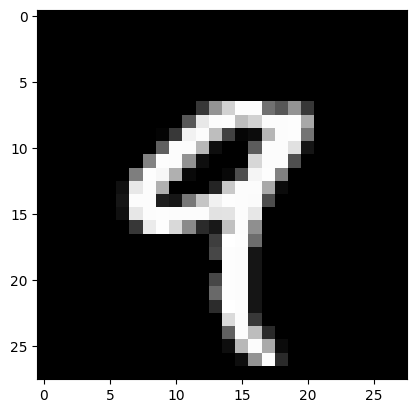

In [21]:
plt.imshow(xtrain[4], cmap='gray')
plt.show()

In [7]:
xtrain=(xtrain-127.5)/127.5

print(xtrain.min(),xtrain.max())

-1.0 1.0


In [8]:
total_epochs = 50
batch_size=256
half_batch=128
no_of_batches=int(xtrain.shape[0]/batch_size)
noise_dim=100
adam=Adam(lr=2e-4,beta_1=0.5)

In [10]:
# Generator

generator = Sequential(name='generator')
generator.add(Dense(units=7*7*128, input_shape=(noise_dim,)))
generator.add(Reshape((7,7,128)))
generator.add(LeakyReLU(0.2))
generator.add(BatchNormalization())

# (7,7,128) ----> (14,14,64)
generator.add(Conv2DTranspose(filters=64, kernel_size=(3,3), strides=(2,2), padding='same'))
generator.add(LeakyReLU(0.2))
generator.add(BatchNormalization())

# (14,14,64) ----> (28,28,1)
generator.add(Conv2DTranspose(filters=1, kernel_size=(3,3), strides=(2,2), padding='same'))
generator.add(Activation('tanh'))

generator.compile(loss=keras.losses.binary_crossentropy, optimizer=adam)

generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 6272)              633472    
                                                                 
 reshape (Reshape)           (None, 7, 7, 128)         0         
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 7, 7, 128)         0         
                                                                 
 batch_normalization (Batch  (None, 7, 7, 128)         512       
 Normalization)                                                  
                                                                 
 conv2d_transpose (Conv2DTr  (None, 14, 14, 64)        73792     
 anspose)                                                        
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 14, 14, 64)        0 

In [27]:
# Discriminator

#(28,28,1) ----> (14,14,64)
discriminator = Sequential()
discriminator.add(Conv2D(filters=64, kernel_size=(3,3), strides=(2,2), padding='same', input_shape=(28,28,1)))
discriminator.add(LeakyReLU(0.2))

#(14,14,64) ----> (7,7,128)
discriminator.add(Conv2D(filters=128, kernel_size=(3,3), strides=(2,2), padding='same'))
discriminator.add(LeakyReLU(0.2))

#(7,7,128) ----> 6272
discriminator.add(Flatten())
discriminator.add(Dense(100))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dense(1, activation='sigmoid'))
discriminator_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)
discriminator.compile(loss=keras.losses.binary_crossentropy, optimizer=discriminator_optimizer)

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 14, 14, 64)        640       
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 14, 14, 64)        0         
                                                                 
 conv2d_3 (Conv2D)           (None, 7, 7, 128)         73856     
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 7, 7, 128)         0         
                                                                 
 flatten_1 (Flatten)         (None, 6272)              0         
                                                                 
 dense_3 (Dense)             (None, 100)               627300    
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 100)              

In [28]:
# Combine Models

discriminator.trainable = False

gan_input = Input(shape=(noise_dim,))

generated_img = generator(gan_input)

gan_output = discriminator(generated_img)

gan = Model(gan_input, gan_output)
gan_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)
gan.compile(loss=keras.losses.binary_crossentropy, optimizer=gan_optimizer)

In [29]:
gan.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 100)]             0         
                                                                 
 generator (Sequential)      (None, 28, 28, 1)         708609    
                                                                 
 sequential_1 (Sequential)   (None, 1)                 701897    
                                                                 
Total params: 1410506 (5.38 MB)
Trainable params: 708225 (2.70 MB)
Non-trainable params: 702281 (2.68 MB)
_________________________________________________________________


In [16]:
xtrain=xtrain.reshape(-1,28,28,1)

In [18]:
xtrain.shape

(60000, 28, 28, 1)

In [19]:
def display_images(samples=25):
  noise=np.random.normal(0,1,size=(samples,noise_dim))
  generated_images=generator.predict(noise)

  plt.figure(figsize=(10,10))
  for i in range(generated_images.shape[0]):
    plt.subplot(5,5,i+1)
    plt.imshow(generated_images[i].reshape(28,28),cmap='binary')
    plt.axis('off')

  plt.show()

4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.0028680495472035855, Generator Loss 0.0026633780226748213
4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.005300004258115067, Generator Loss 0.005121482233715872
4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.007530349187361889, Generator Loss 0.0074818371198116206
4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.009699527588155534, Generator Loss 0.009873238638934925
4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.011847347148463257, Generator Loss 0.01237279227656177
4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.013973274164729647, Generator Loss 0.01508633295694987
4/4 [==============================] - 0s 2ms/step
Epoch 1, Disc loss 0.016072452259369385, Generator Loss 0.018062015883942954
4/4 [==============================] - 0s 3ms/step
Epoch 1, Disc loss 0.01813434096228363, Generator Lo

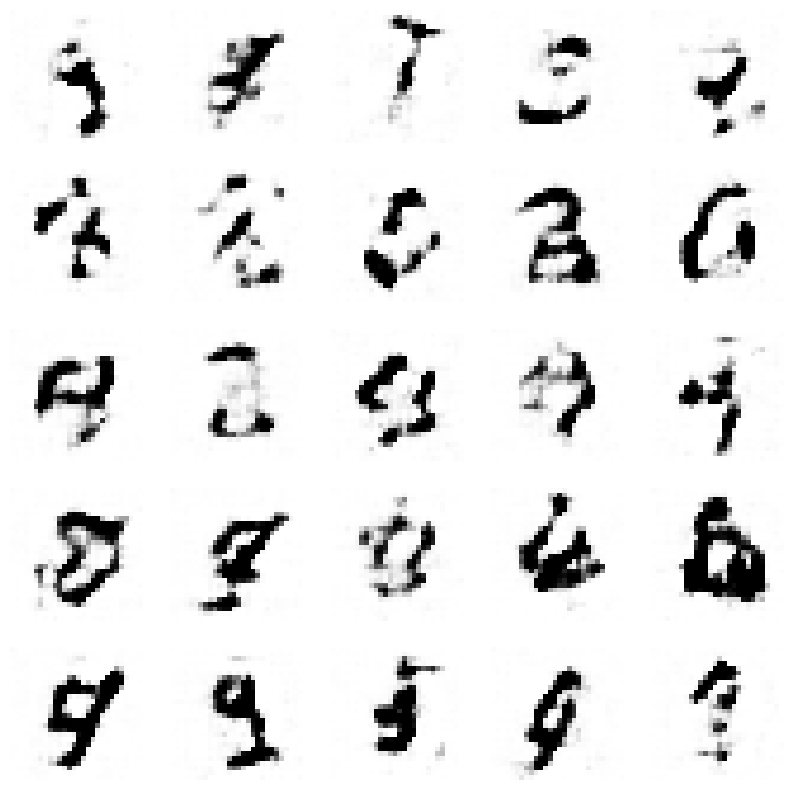

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.0049215054664856345, Generator Loss 0.014956336755018968
1/1 [==============================] - 0s 18ms/step


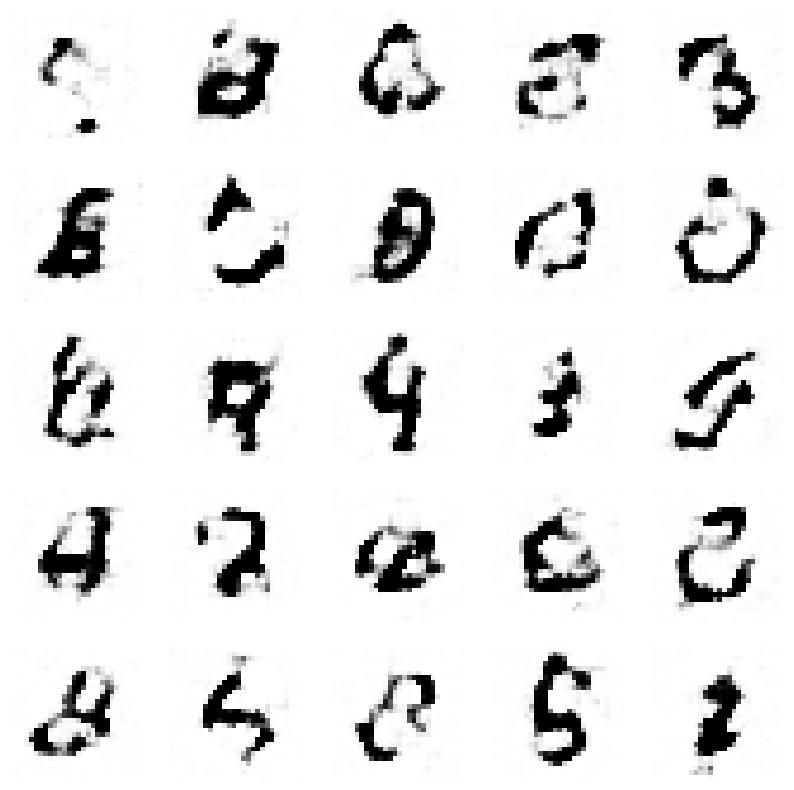

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.007345698200739347, Generator Loss 0.022337597659510426
1/1 [==============================] - 0s 18ms/step


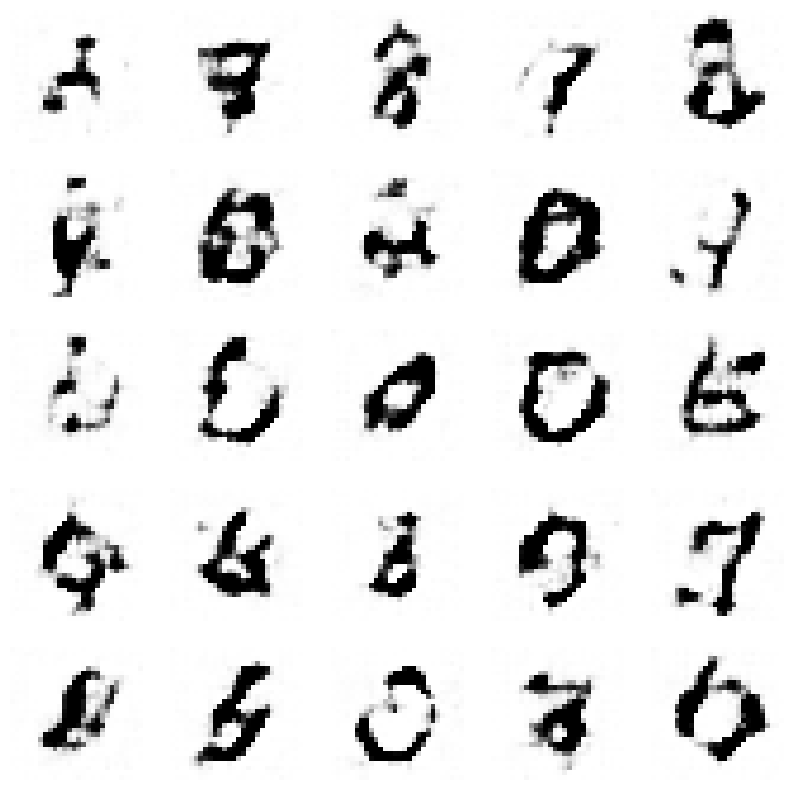

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.009798230141656011, Generator Loss 0.029678609636094835
1/1 [==============================] - 0s 25ms/step


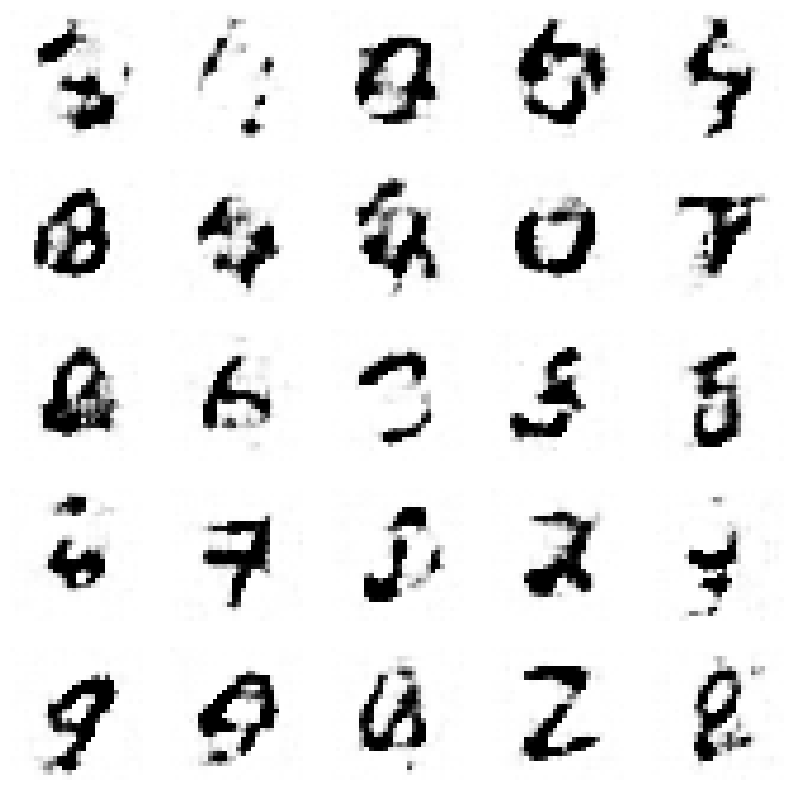

4/4 [==============================] - 0s 7ms/step
Epoch 5, Disc loss 0.012176176485342857, Generator Loss 0.037484065080300354
1/1 [==============================] - 0s 34ms/step


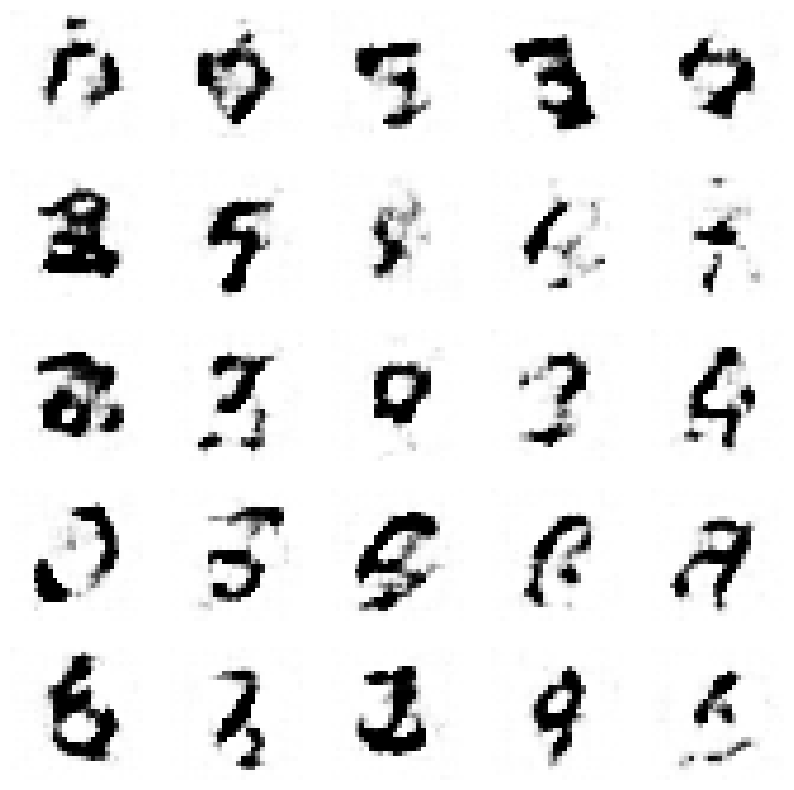

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.014523556790290734, Generator Loss 0.045142060671097196
1/1 [==============================] - 0s 19ms/step


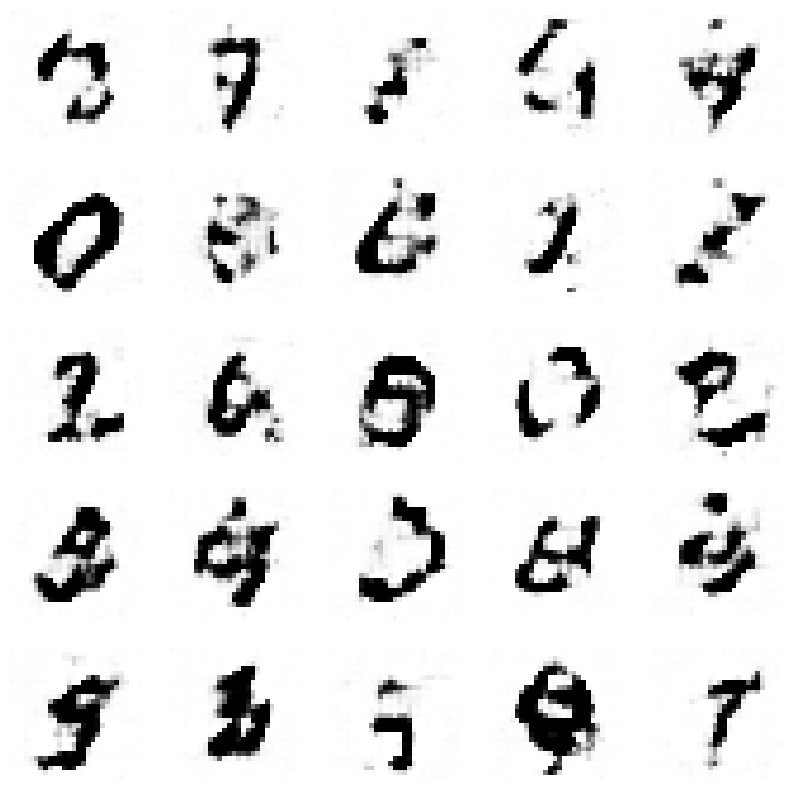

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.01709036701000654, Generator Loss 0.052528207118694596
1/1 [==============================] - 0s 19ms/step


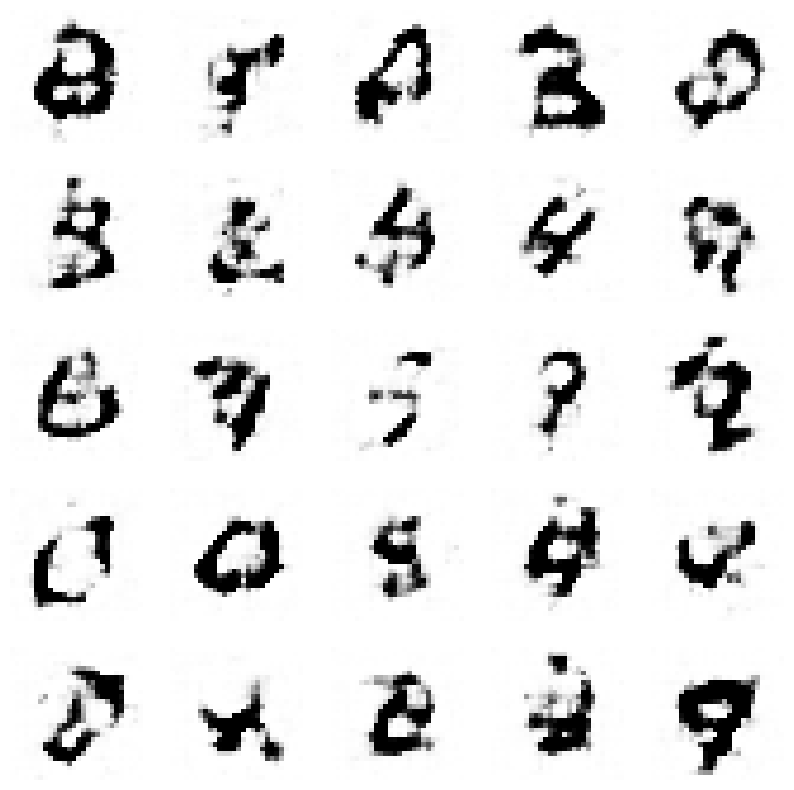

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.019482128958926242, Generator Loss 0.060058262613084584
1/1 [==============================] - 0s 21ms/step


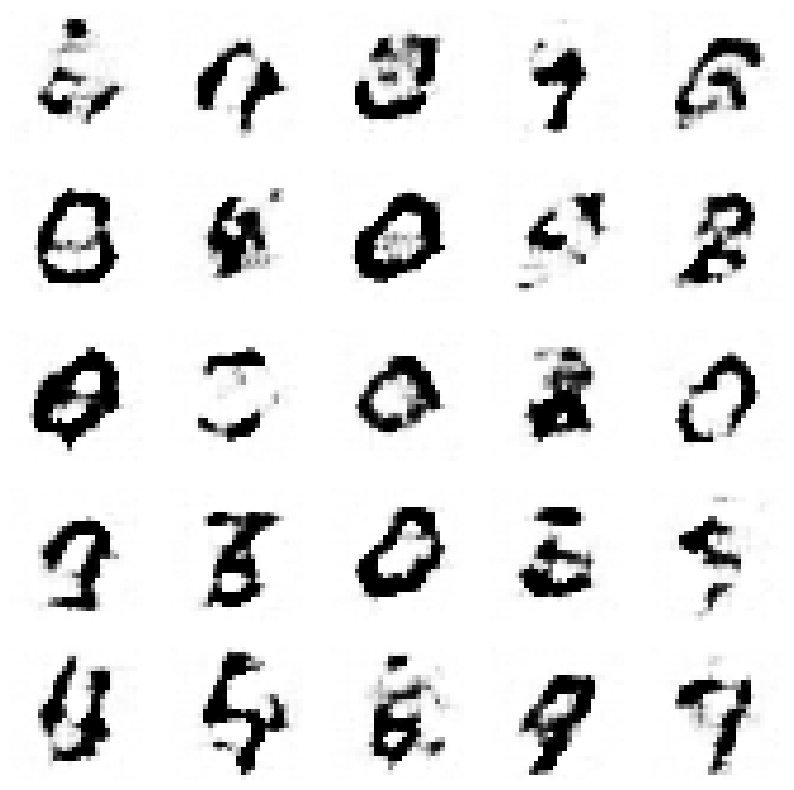

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.021905741948857266, Generator Loss 0.06734957807084434
1/1 [==============================] - 0s 19ms/step


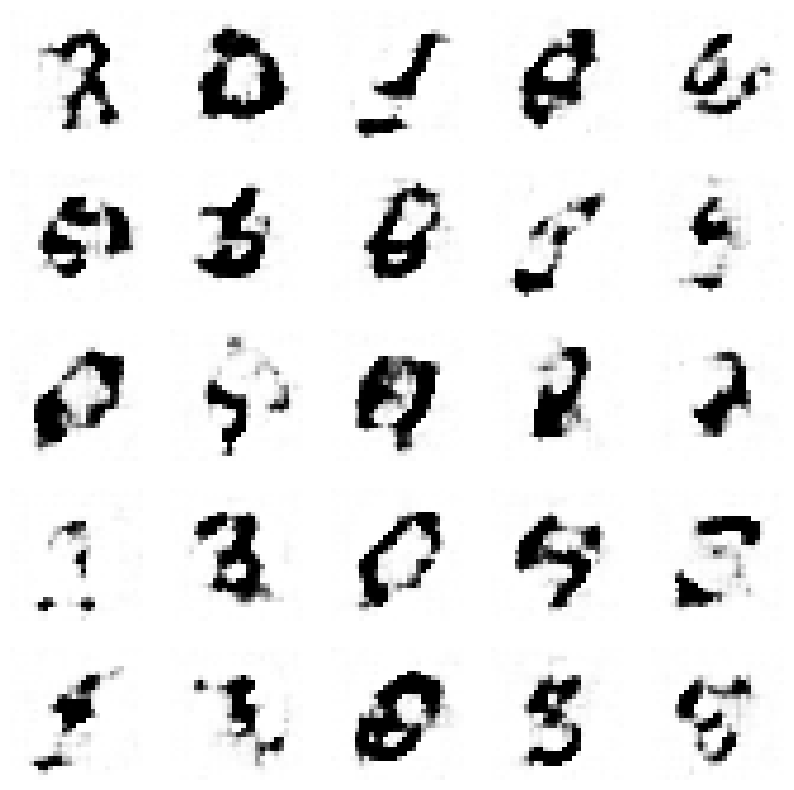

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.024241774255393915, Generator Loss 0.0748077748168228
1/1 [==============================] - 0s 19ms/step


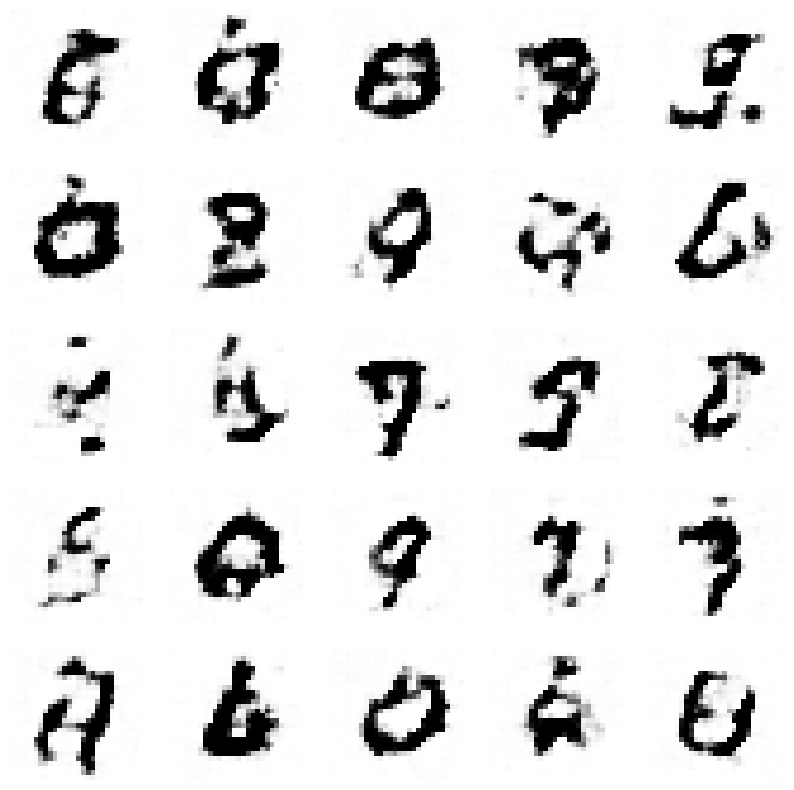

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.02665114440979102, Generator Loss 0.08232658286379953
1/1 [==============================] - 0s 18ms/step


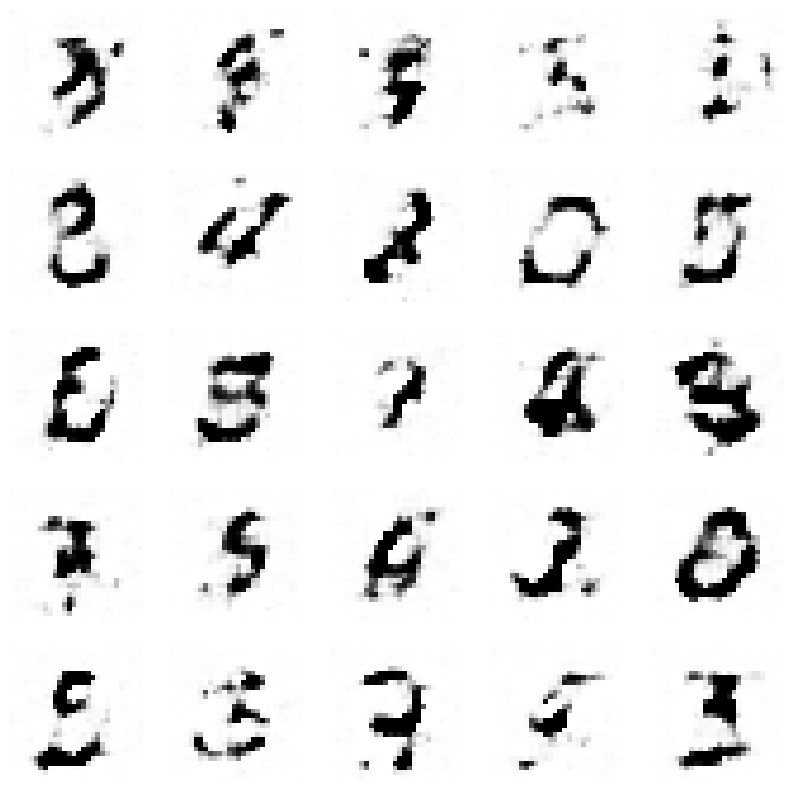

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.029057347239592135, Generator Loss 0.08992188099103096
1/1 [==============================] - 0s 18ms/step


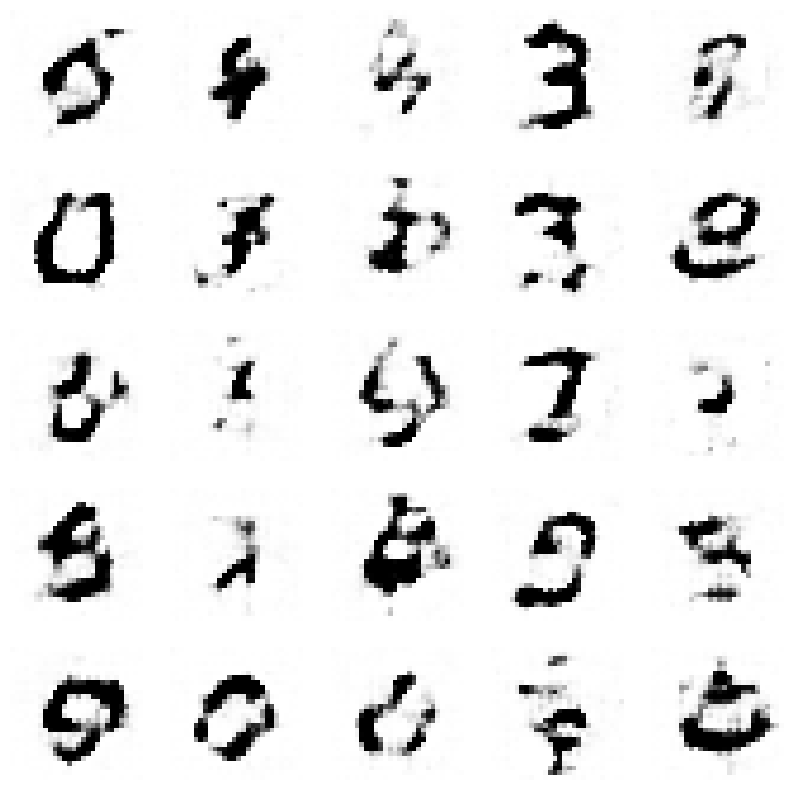

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.031688542956979864, Generator Loss 0.09725088441473806
1/1 [==============================] - 0s 17ms/step


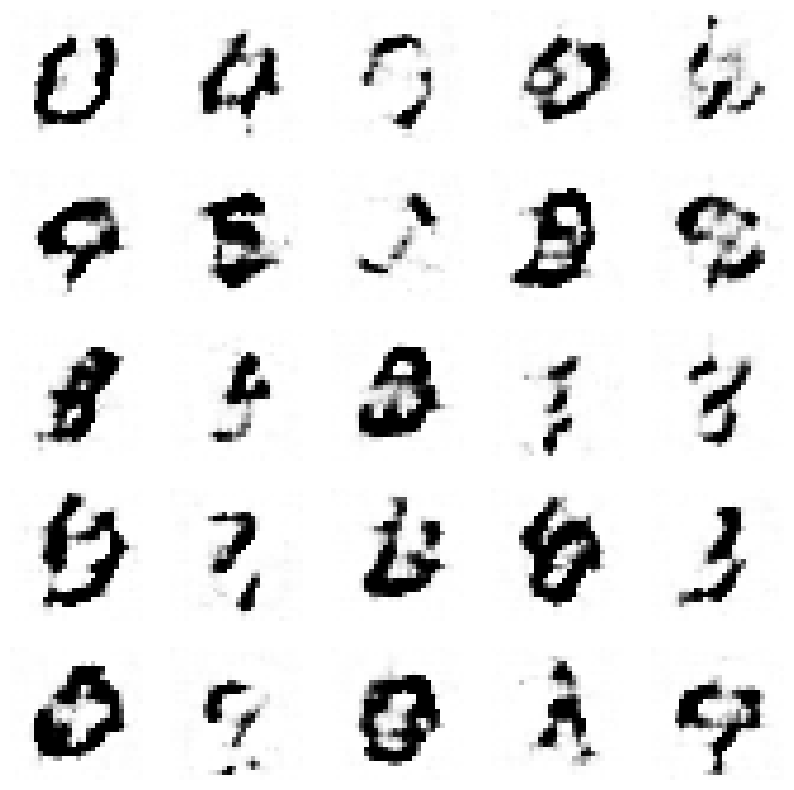

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.03395973604459029, Generator Loss 0.10537090566423205
1/1 [==============================] - 0s 20ms/step


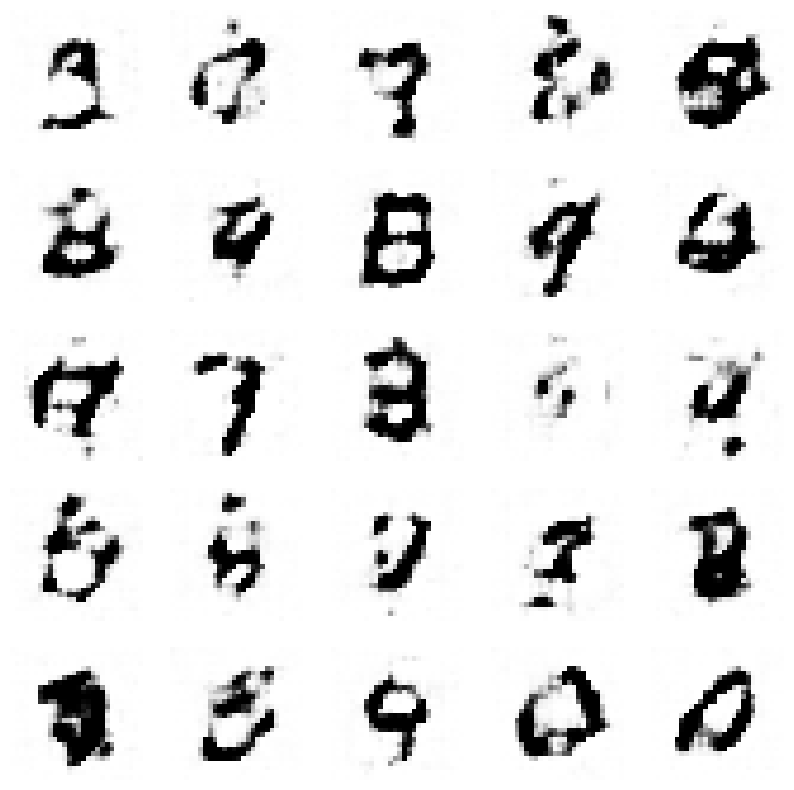

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.036586342777451895, Generator Loss 0.11209087137483124
1/1 [==============================] - 0s 20ms/step


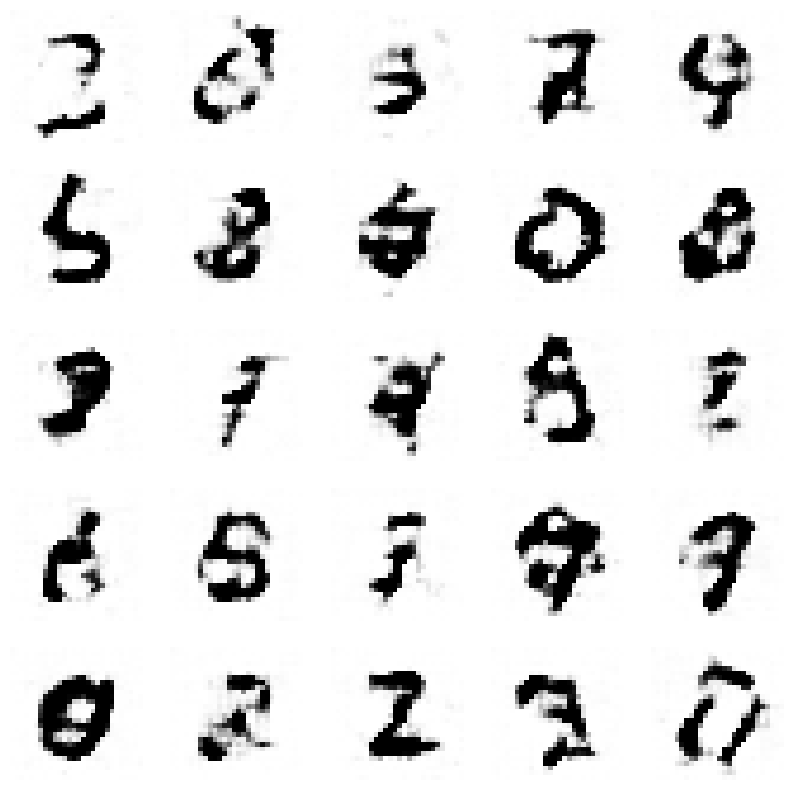

4/4 [==============================] - 0s 6ms/step
Epoch 5, Disc loss 0.038995289840759374, Generator Loss 0.11957826013239022
1/1 [==============================] - 0s 34ms/step


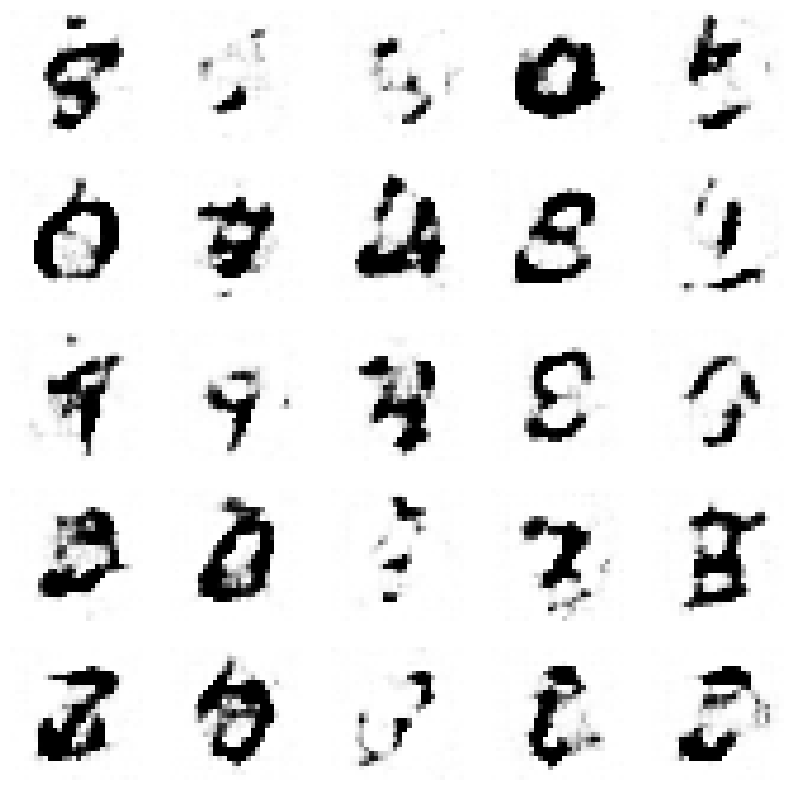

4/4 [==============================] - 0s 6ms/step
Epoch 5, Disc loss 0.04146303293796686, Generator Loss 0.12706357087844458
1/1 [==============================] - 0s 28ms/step


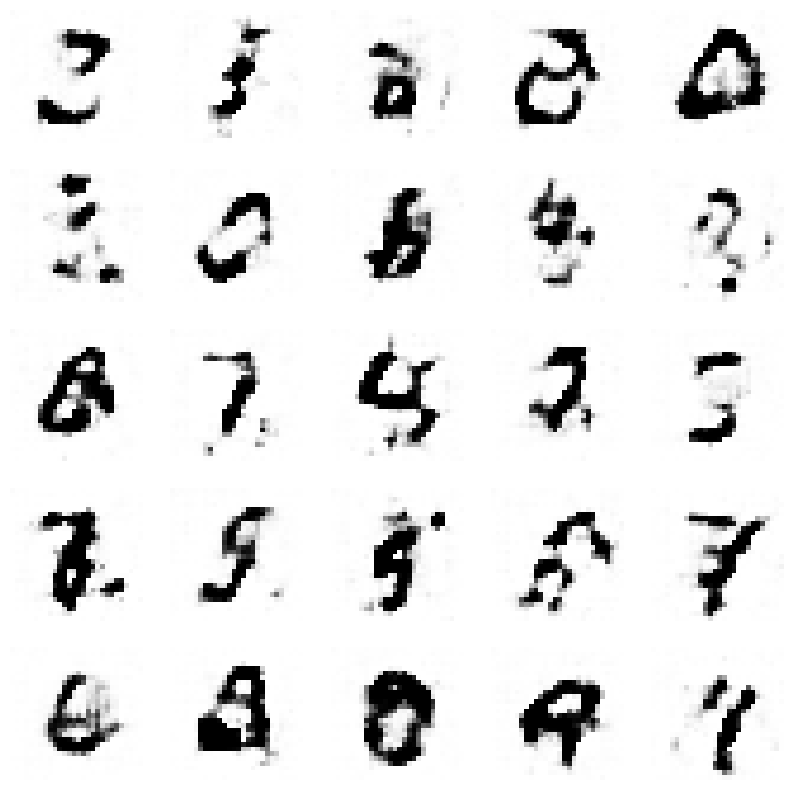

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.044018849475770935, Generator Loss 0.13464744681985968
1/1 [==============================] - 0s 18ms/step


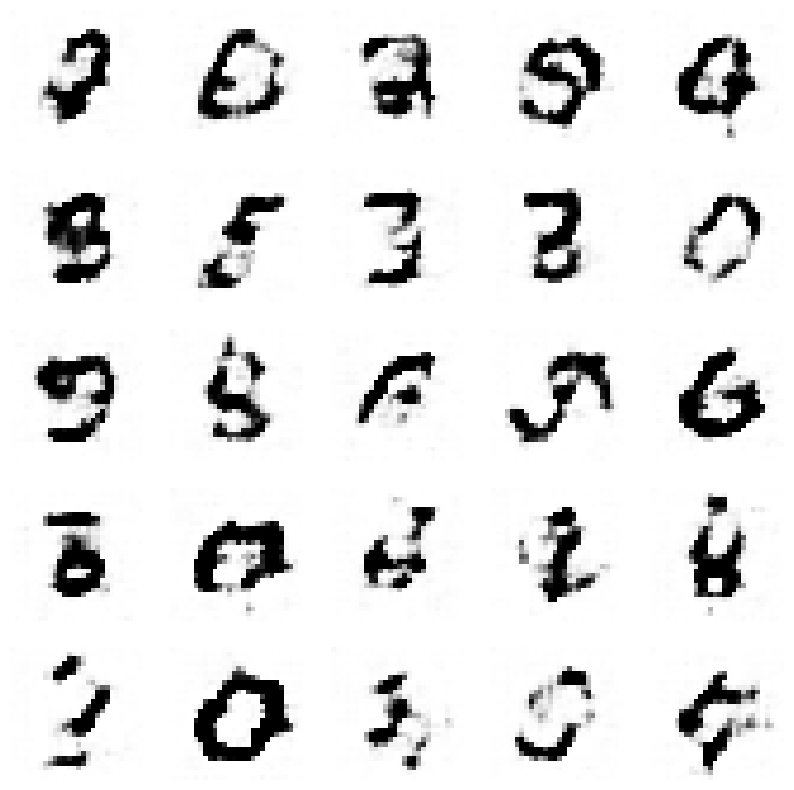

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.04664254863547464, Generator Loss 0.14148891379690579
1/1 [==============================] - 0s 20ms/step


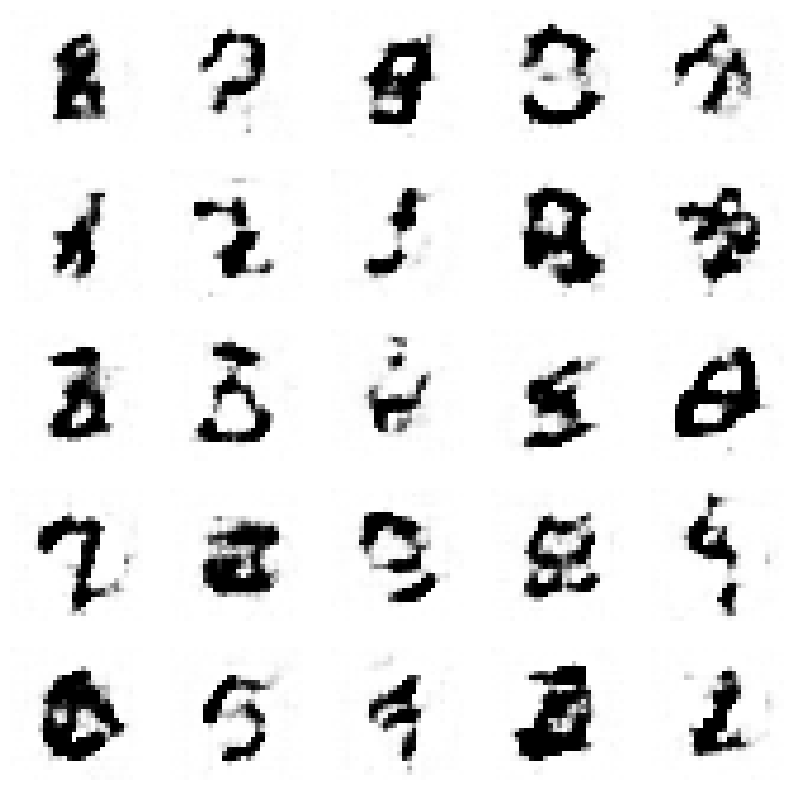

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.04900585860013962, Generator Loss 0.14868987625480717
1/1 [==============================] - 0s 20ms/step


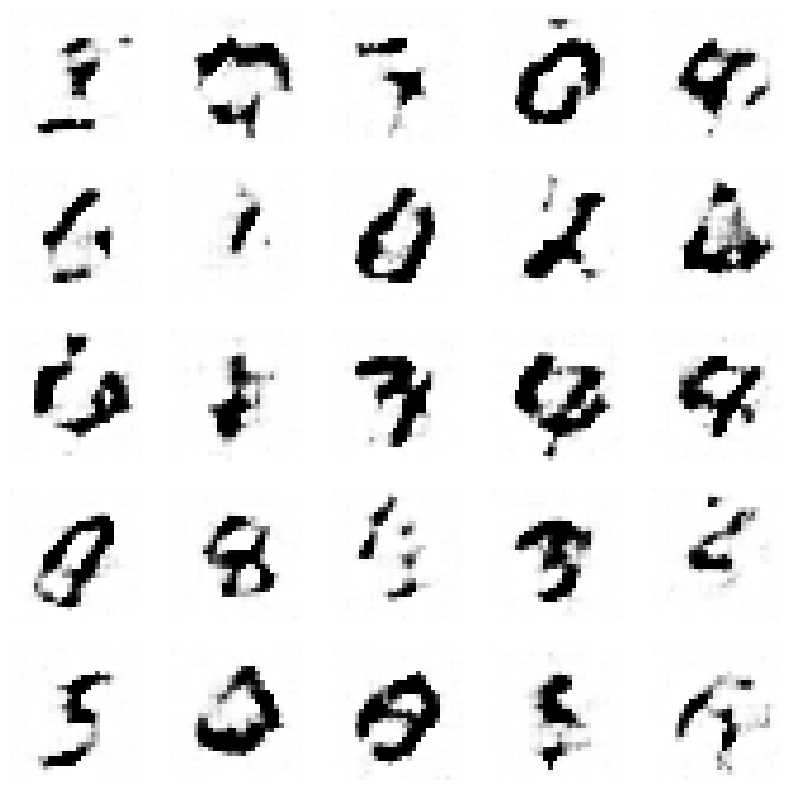

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.05150576878307212, Generator Loss 0.15604814454021618
1/1 [==============================] - 0s 17ms/step


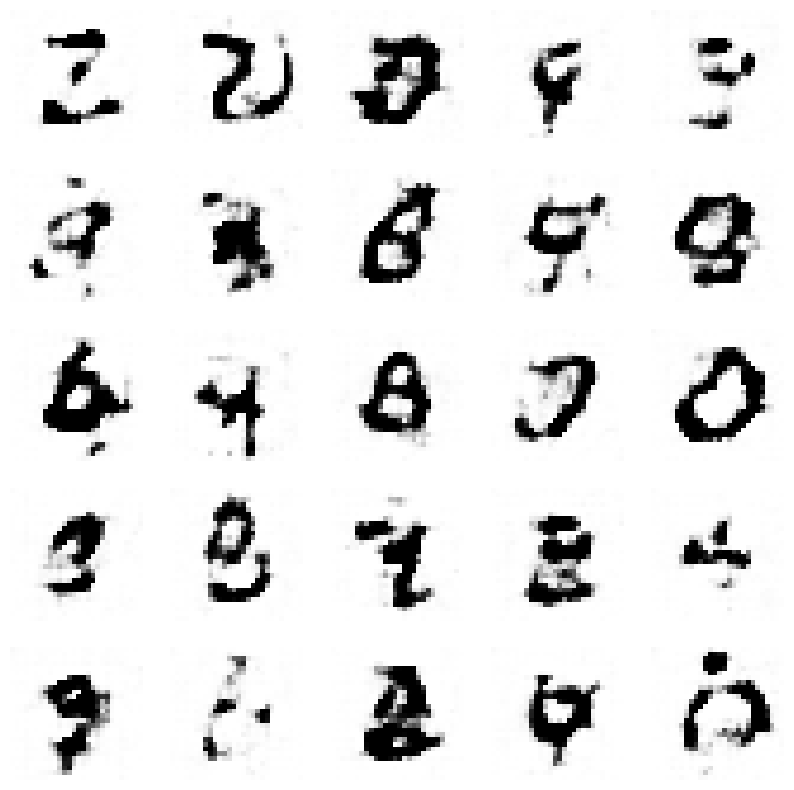

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.05428217249548333, Generator Loss 0.16271724914893126
1/1 [==============================] - 0s 19ms/step


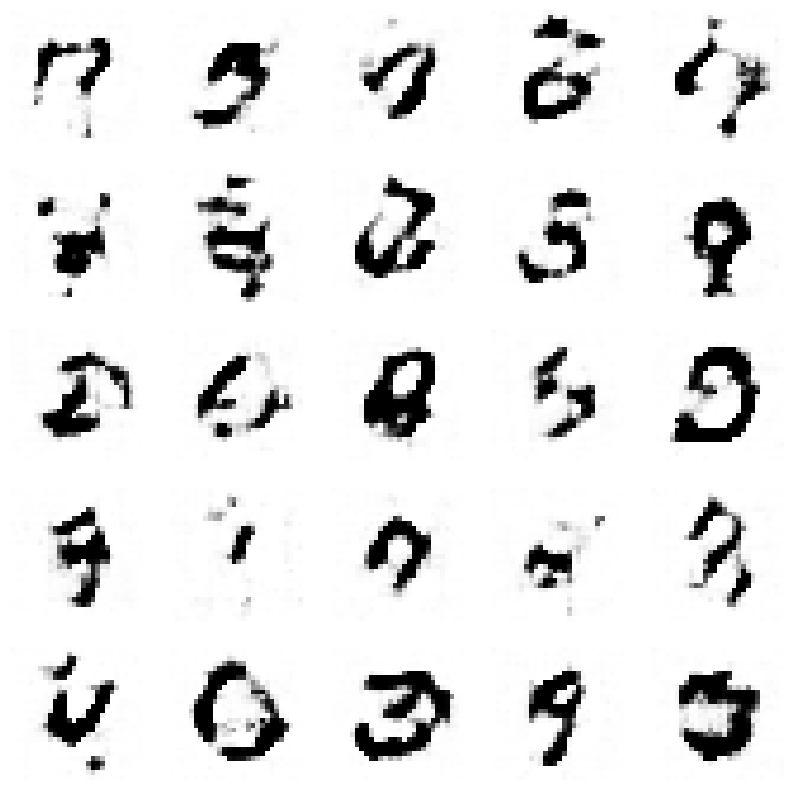

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.0566994205244586, Generator Loss 0.17036655417874327
1/1 [==============================] - 0s 18ms/step


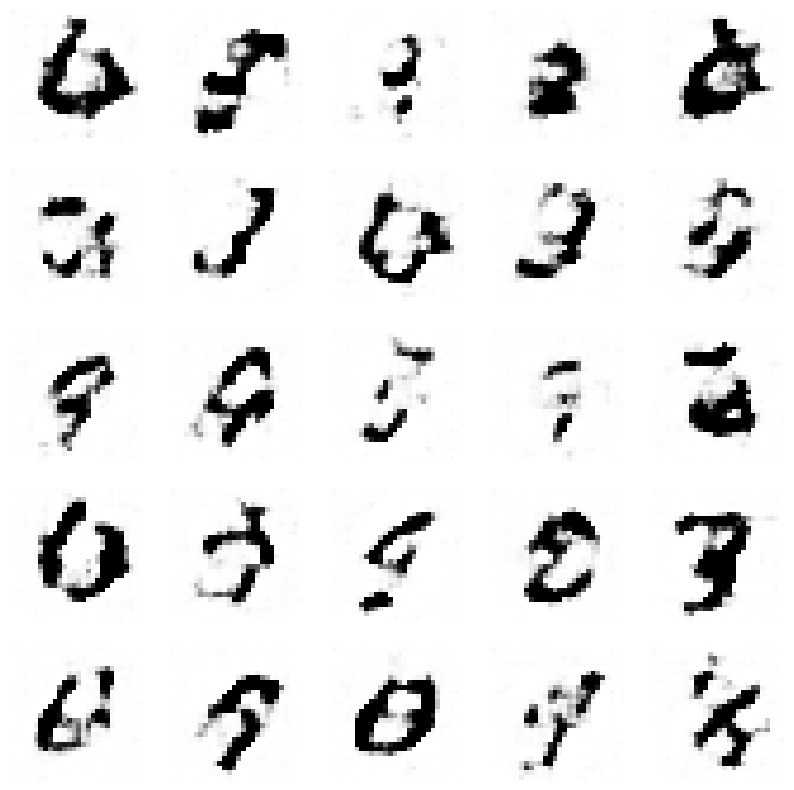

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.05907776053899374, Generator Loss 0.17809221836236808
1/1 [==============================] - 0s 18ms/step


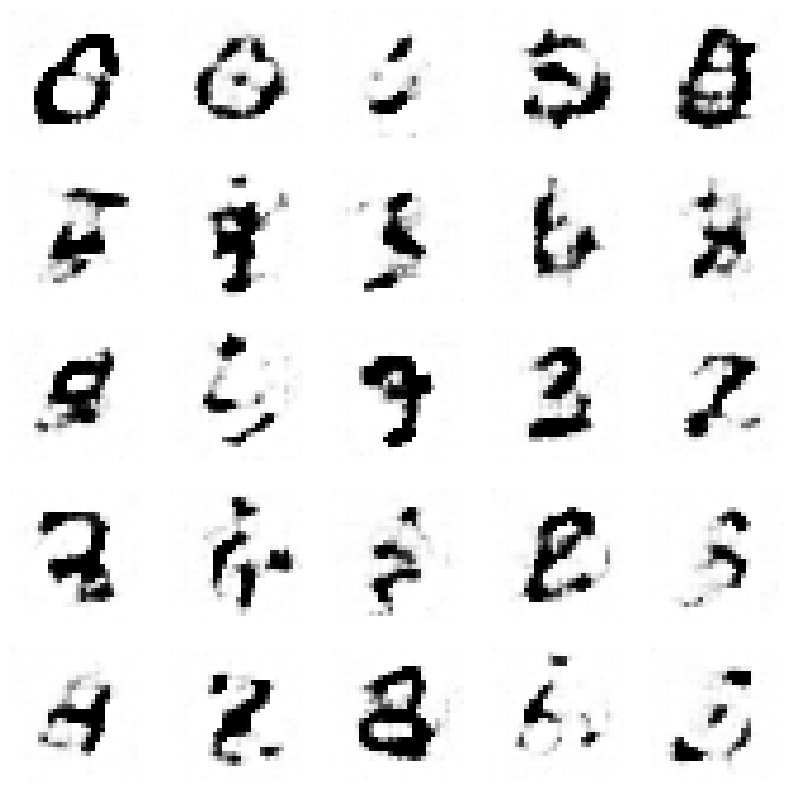

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.061269347038533956, Generator Loss 0.18559274102887538
1/1 [==============================] - 0s 22ms/step


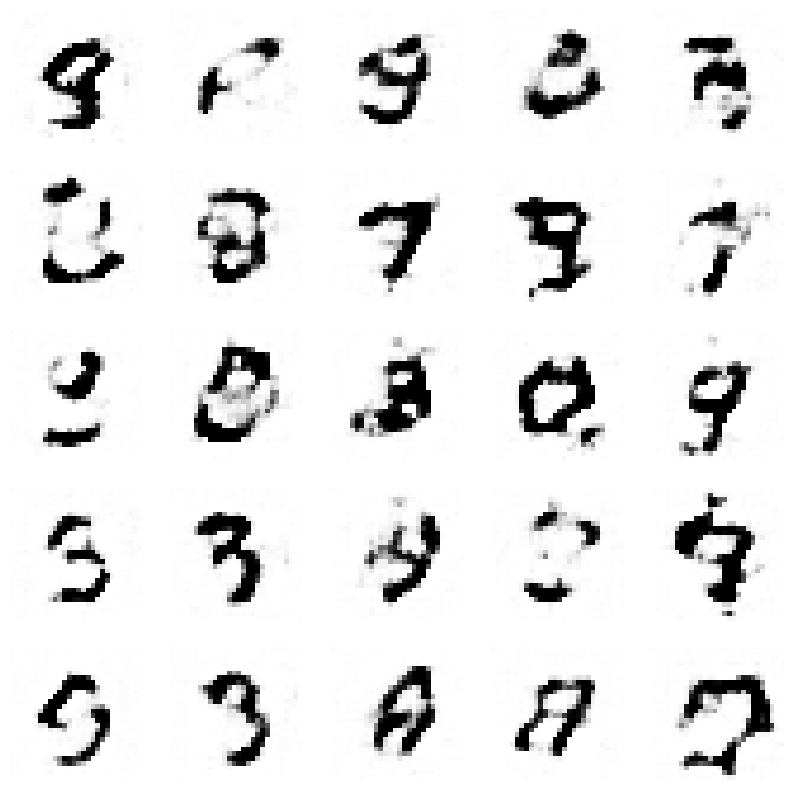

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.06367793863909876, Generator Loss 0.19271987320011497
1/1 [==============================] - 0s 18ms/step


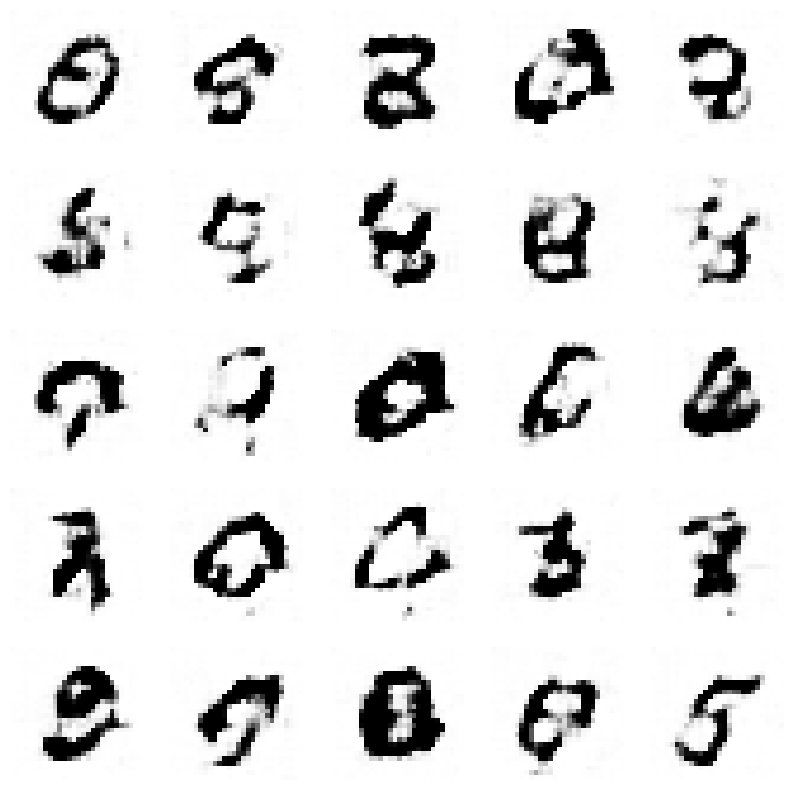

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.06614045715994304, Generator Loss 0.19989759545040947
1/1 [==============================] - 0s 20ms/step


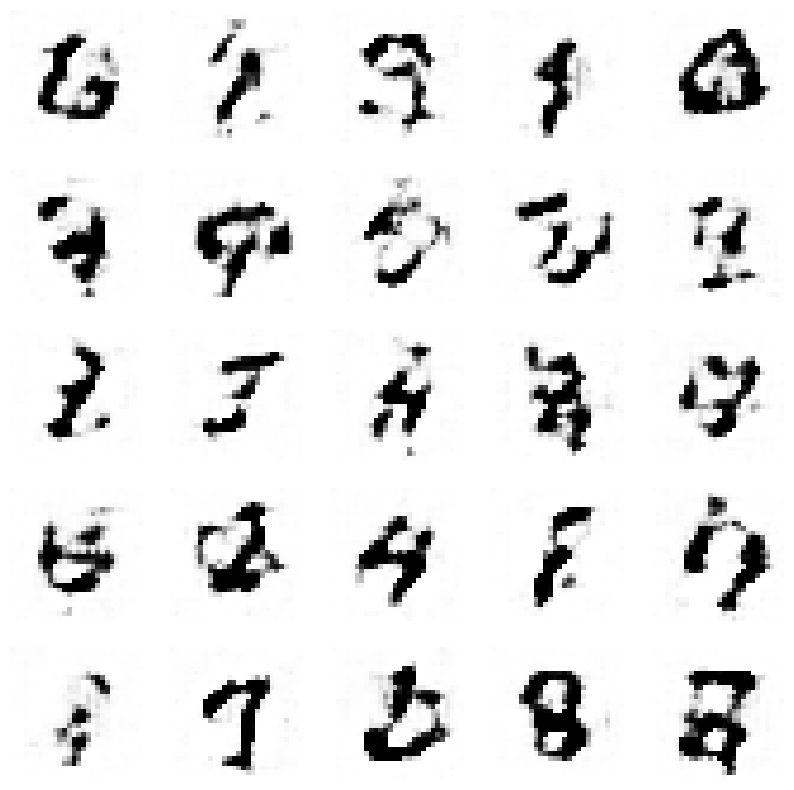

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.06865753902074619, Generator Loss 0.20711750607205254
1/1 [==============================] - 0s 32ms/step


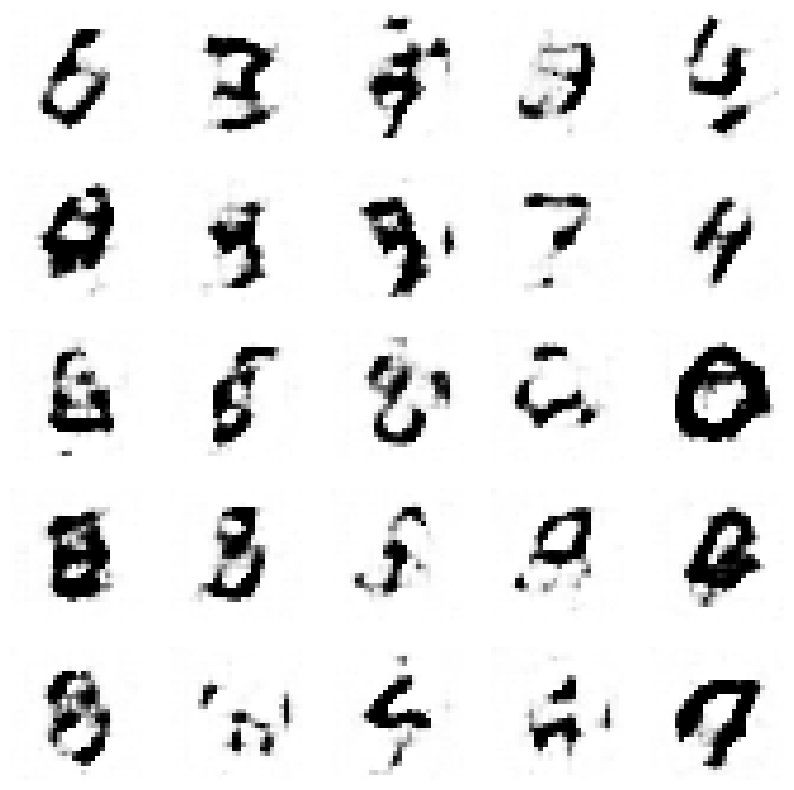

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.07117382628031266, Generator Loss 0.21420167144547161
1/1 [==============================] - 0s 32ms/step


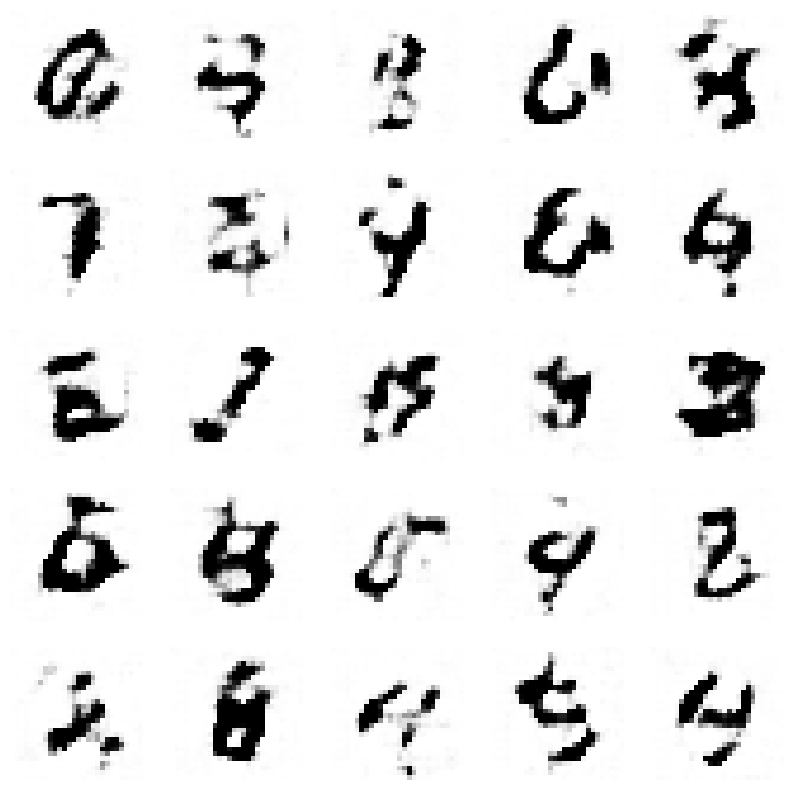

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.07367023972109851, Generator Loss 0.22106629610061646
1/1 [==============================] - 0s 20ms/step


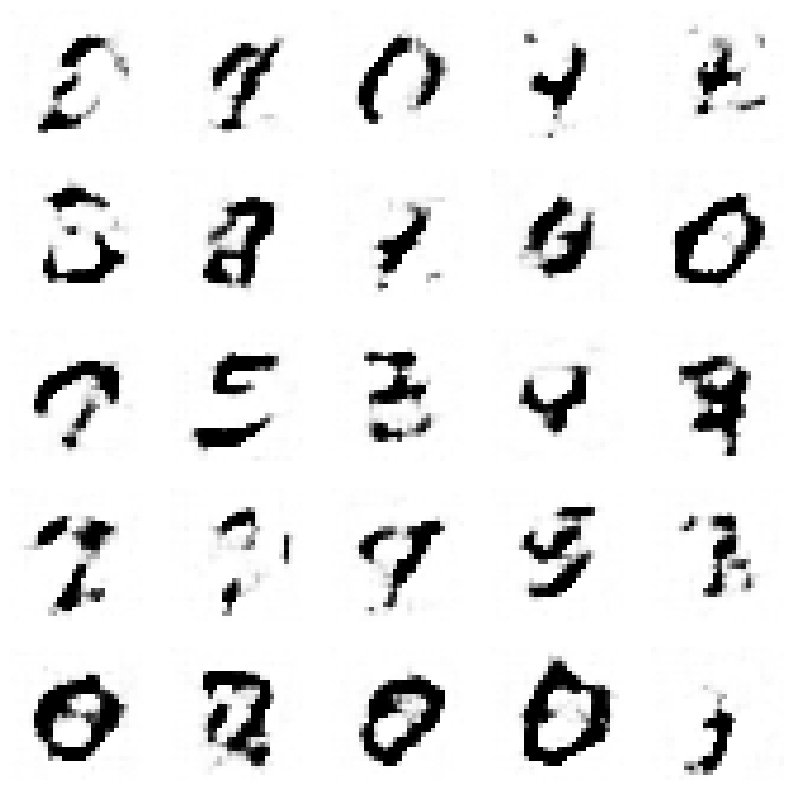

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.07599168818475854, Generator Loss 0.2283190453154409
1/1 [==============================] - 0s 18ms/step


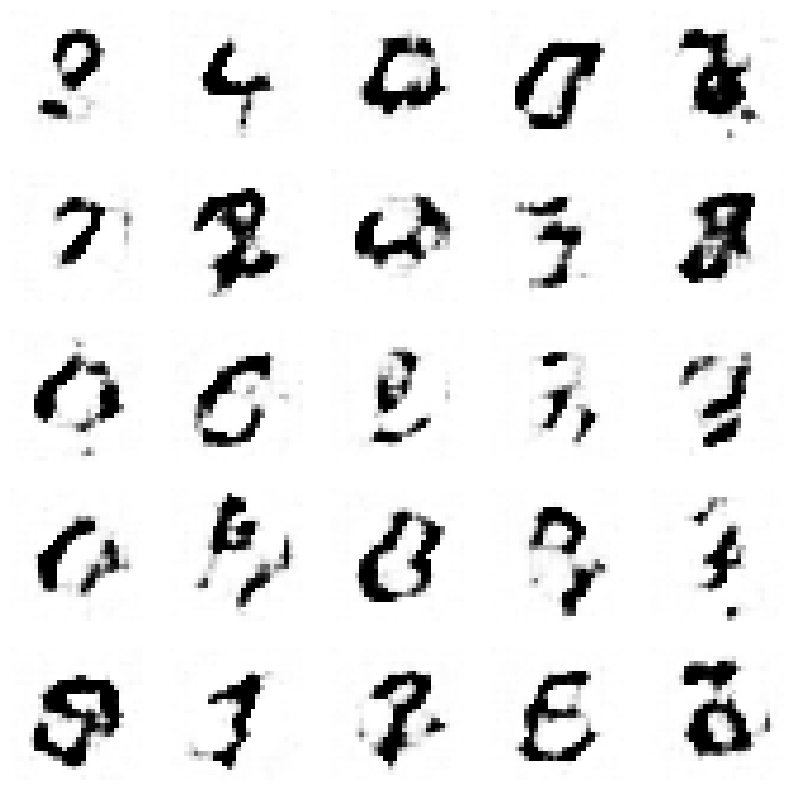

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.07840211033566385, Generator Loss 0.2361163242250426
1/1 [==============================] - 0s 23ms/step


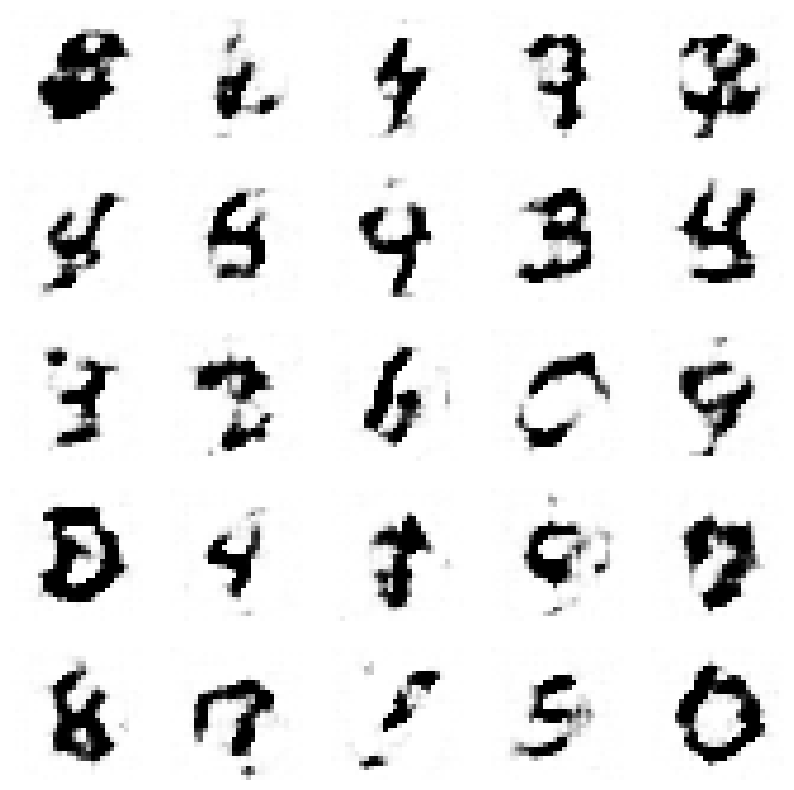

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.08089868928122725, Generator Loss 0.24336595667733085
1/1 [==============================] - 0s 22ms/step


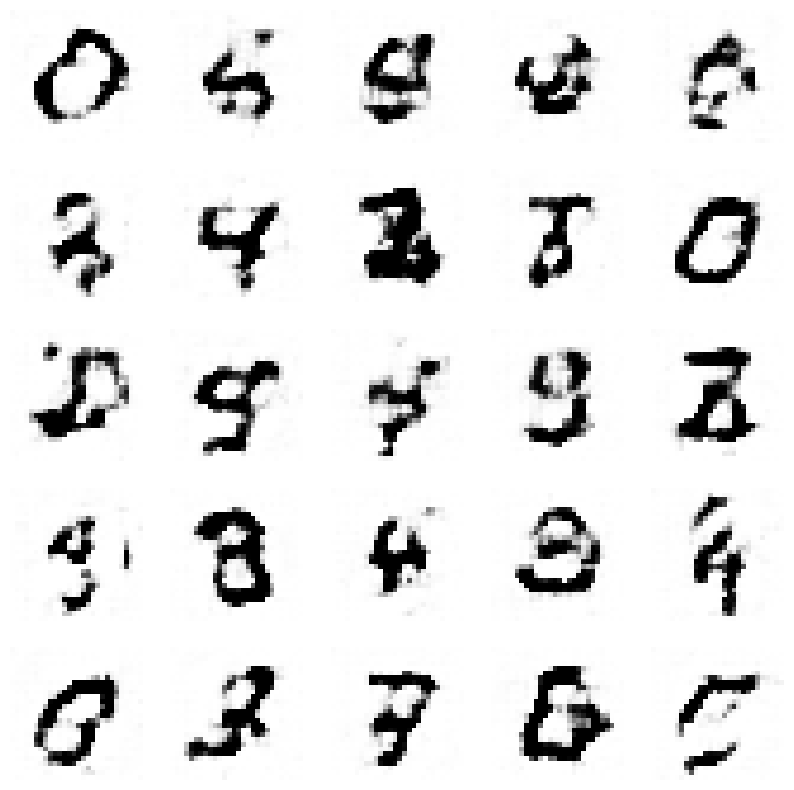

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.08365371976143275, Generator Loss 0.25033994821401745
1/1 [==============================] - 0s 24ms/step


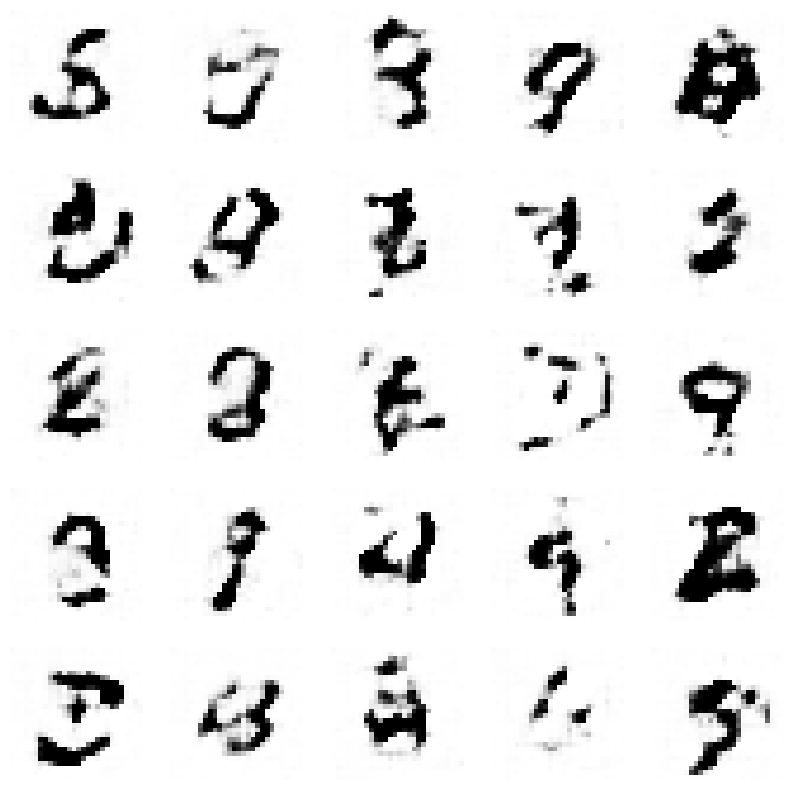

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.0861134227269735, Generator Loss 0.25774438055152565
1/1 [==============================] - 0s 18ms/step


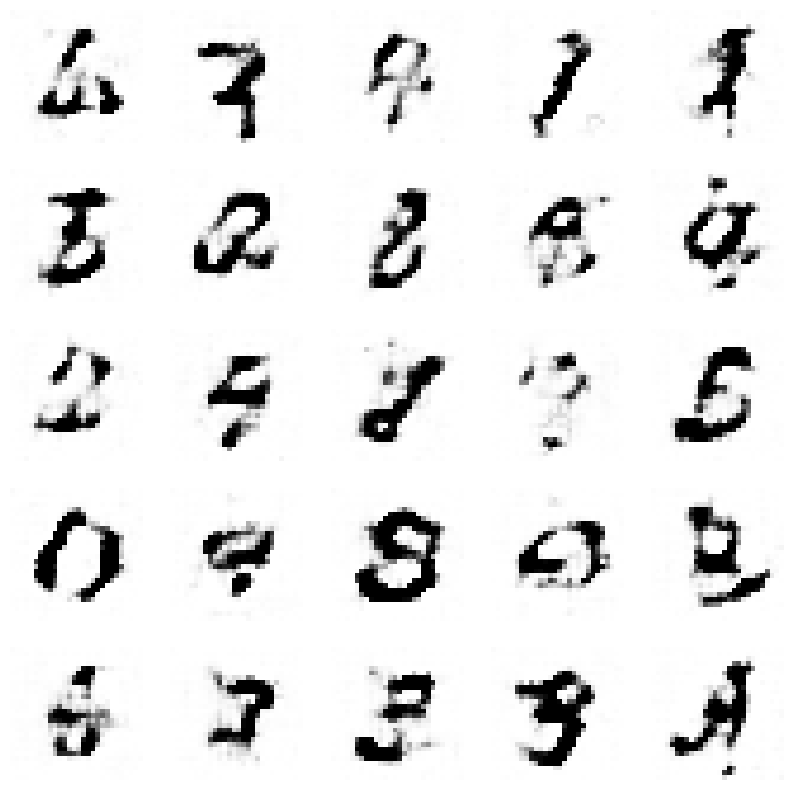

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.08865549065108992, Generator Loss 0.26471415085670275
1/1 [==============================] - 0s 28ms/step


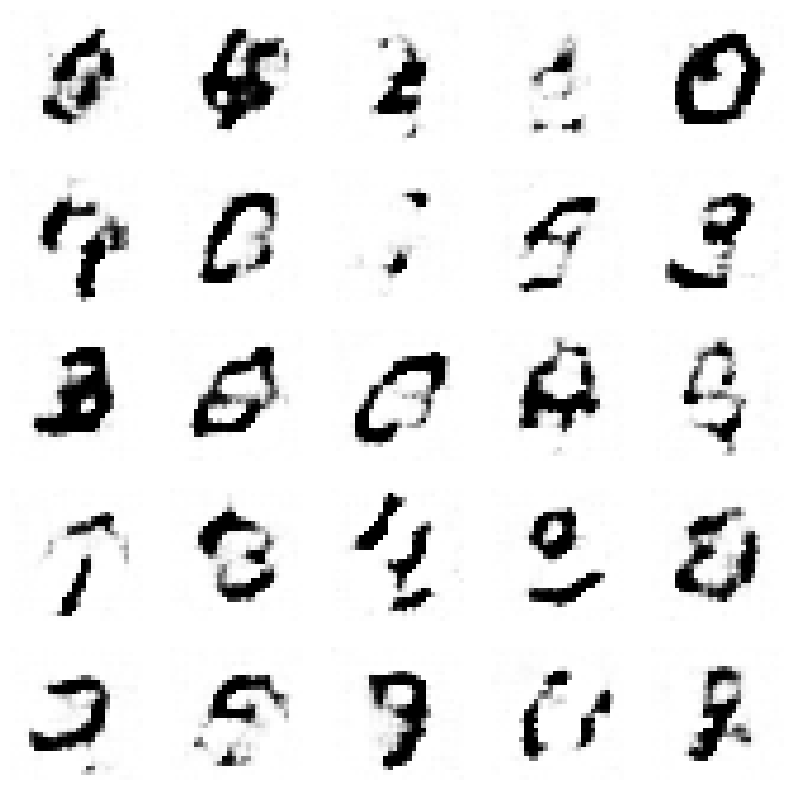

4/4 [==============================] - 0s 8ms/step
Epoch 5, Disc loss 0.09113669185302196, Generator Loss 0.2718563054361914
1/1 [==============================] - 0s 18ms/step


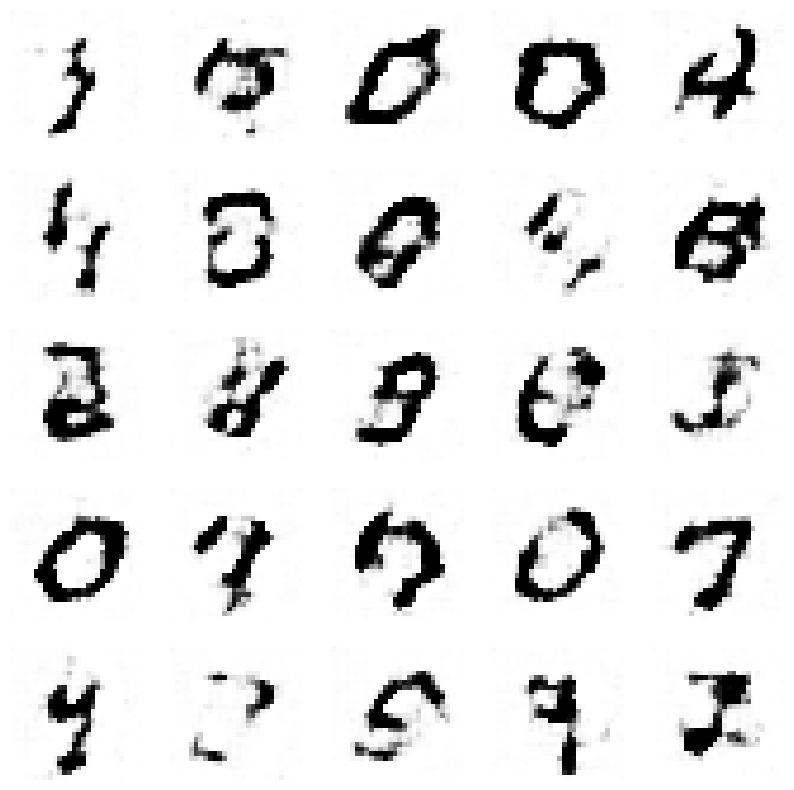

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.09365094255687845, Generator Loss 0.27899421993483847
1/1 [==============================] - 0s 25ms/step


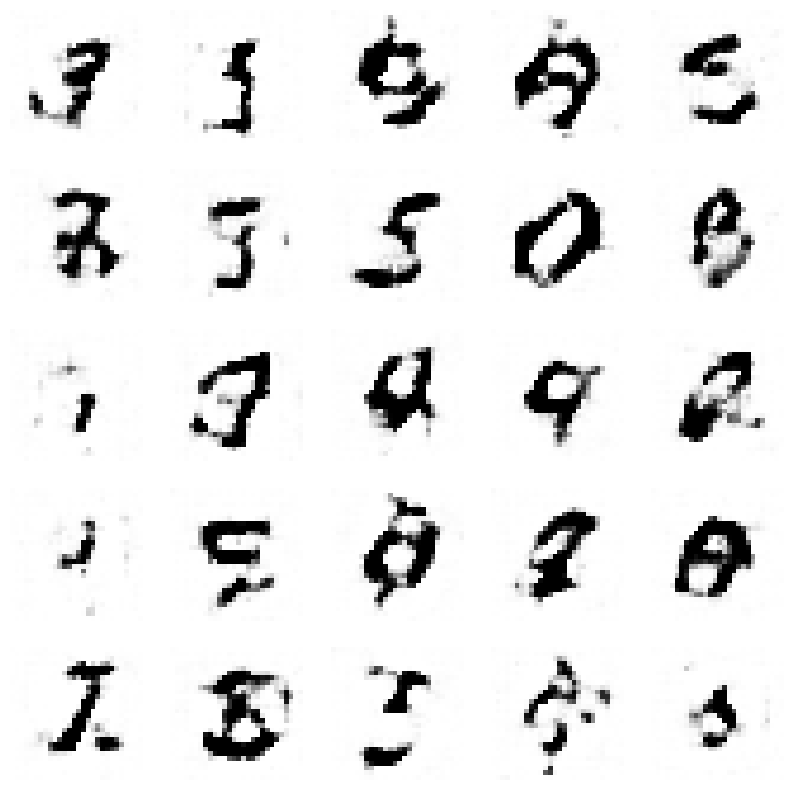

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.09600268138779534, Generator Loss 0.2862600699449197
1/1 [==============================] - 0s 32ms/step


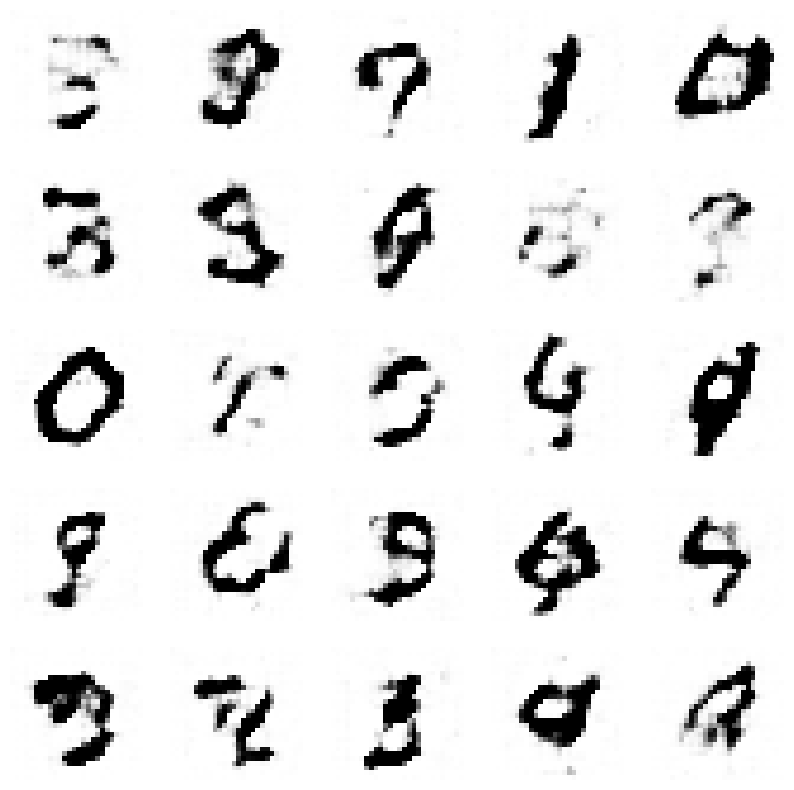

4/4 [==============================] - 0s 6ms/step
Epoch 5, Disc loss 0.09857936101591486, Generator Loss 0.293636810575795
1/1 [==============================] - 0s 29ms/step


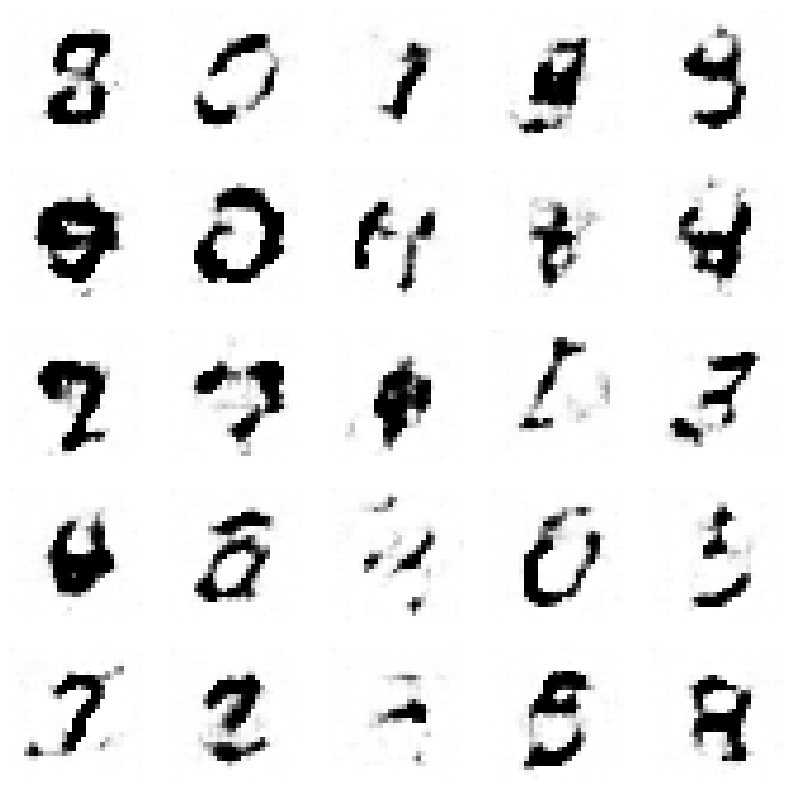

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1010447858999937, Generator Loss 0.3012800170825078
1/1 [==============================] - 0s 18ms/step


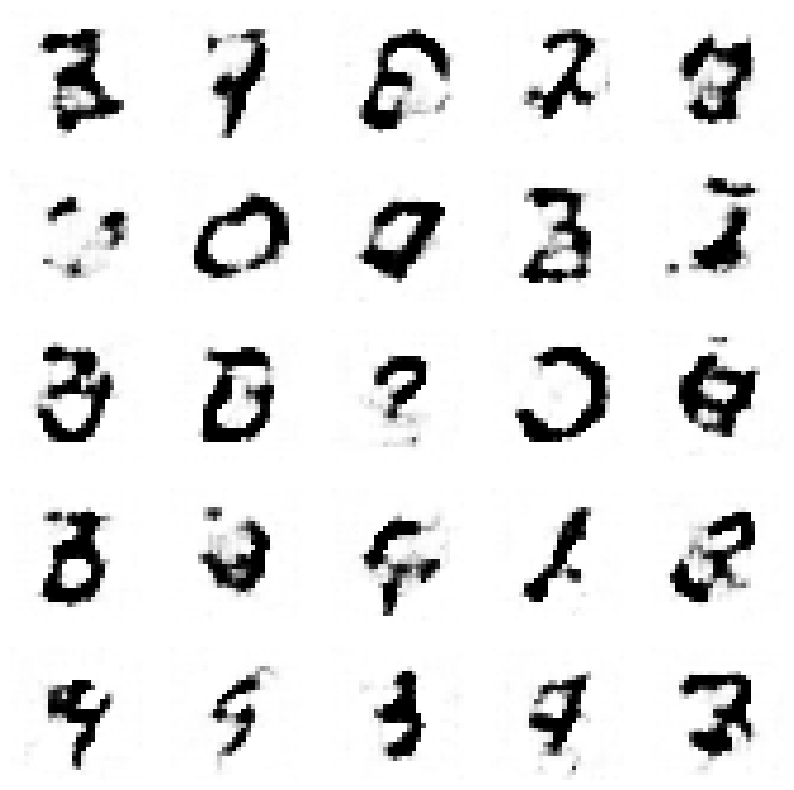

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.10372426048812704, Generator Loss 0.3081103145566761
1/1 [==============================] - 0s 20ms/step


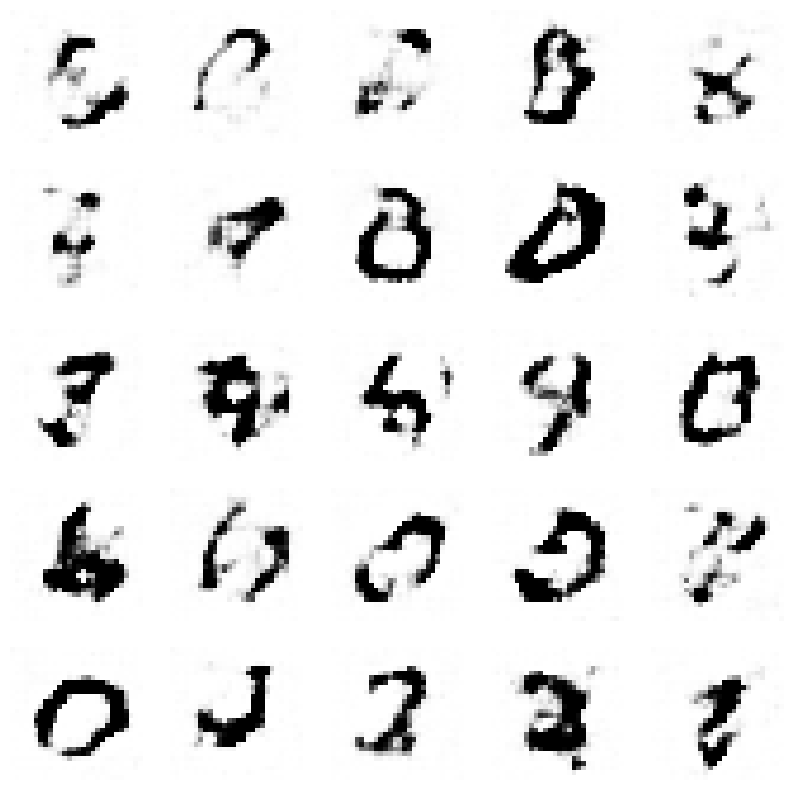

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.10610450186535843, Generator Loss 0.3155754014977023
1/1 [==============================] - 0s 21ms/step


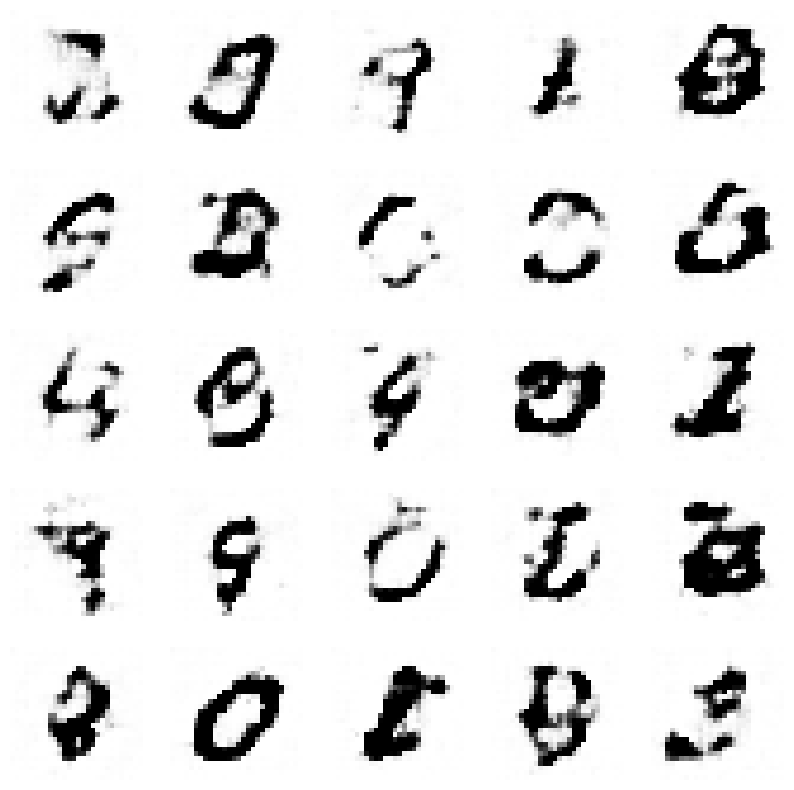

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.10890191252160276, Generator Loss 0.32288334868912005
1/1 [==============================] - 0s 18ms/step


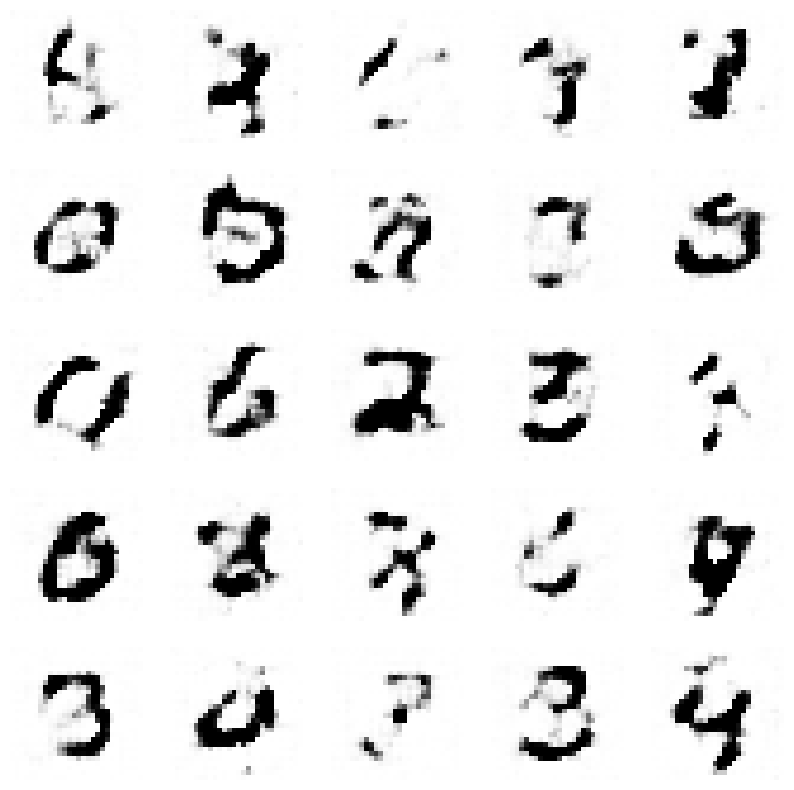

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.11128222757679784, Generator Loss 0.33008148884161925
1/1 [==============================] - 0s 18ms/step


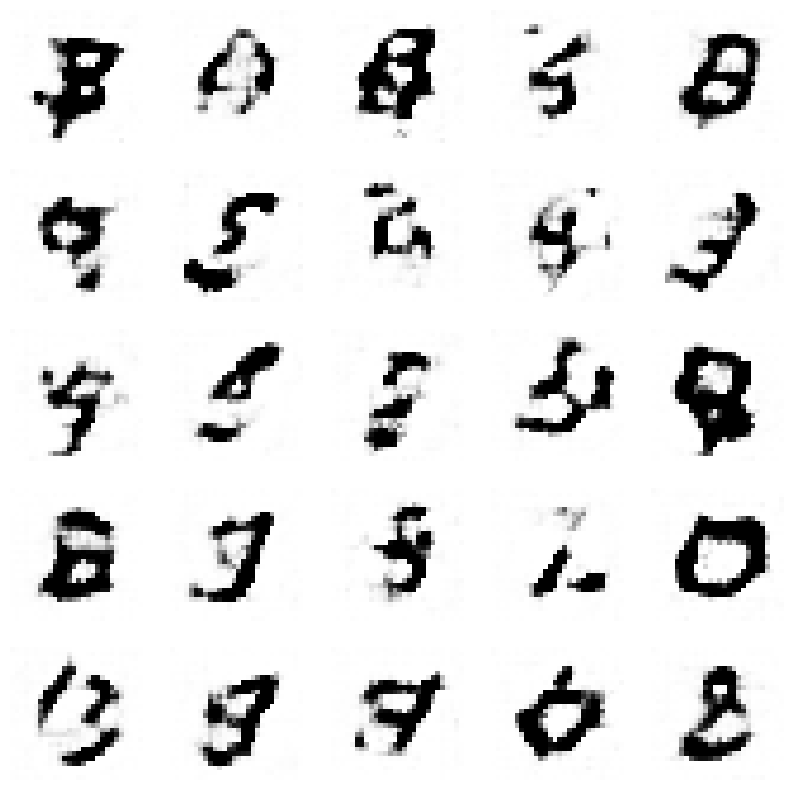

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.11364644753117846, Generator Loss 0.3376979445799803
1/1 [==============================] - 0s 19ms/step


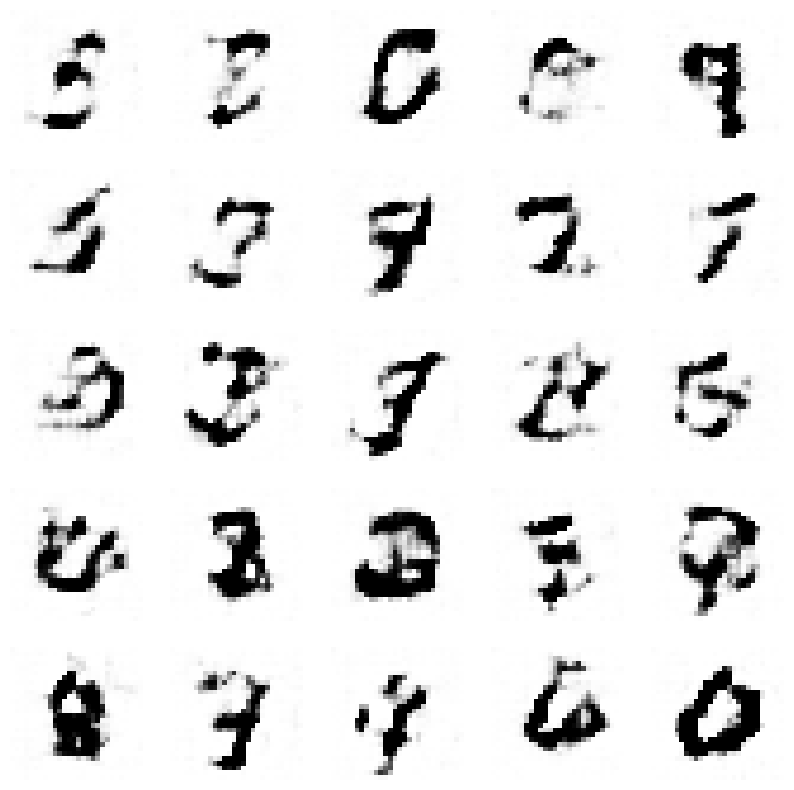

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.11622161641080156, Generator Loss 0.3453108158885923
1/1 [==============================] - 0s 19ms/step


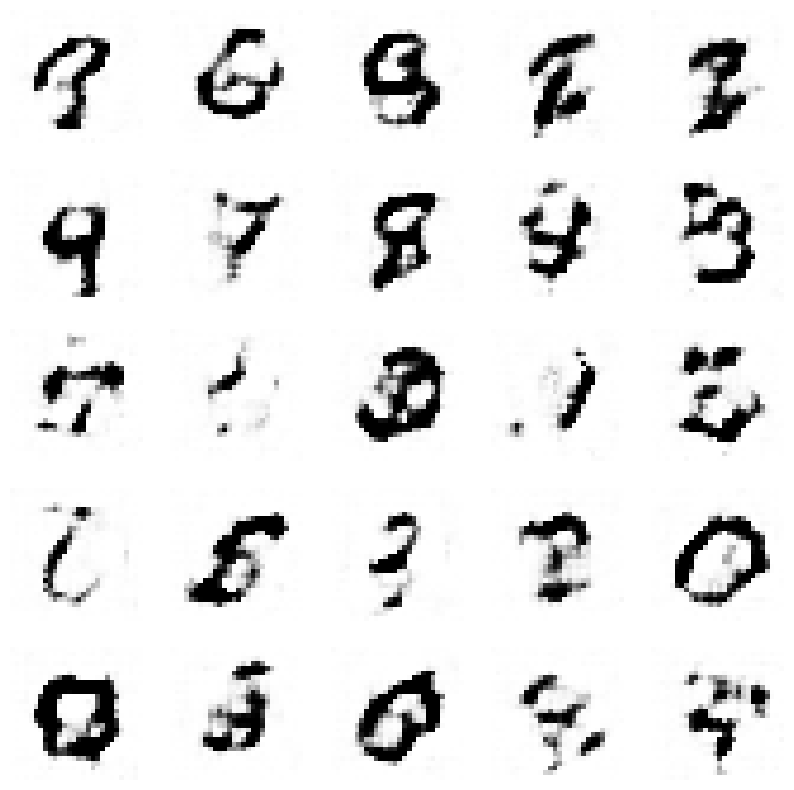

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.11866951893028031, Generator Loss 0.3524782479318798
1/1 [==============================] - 0s 18ms/step


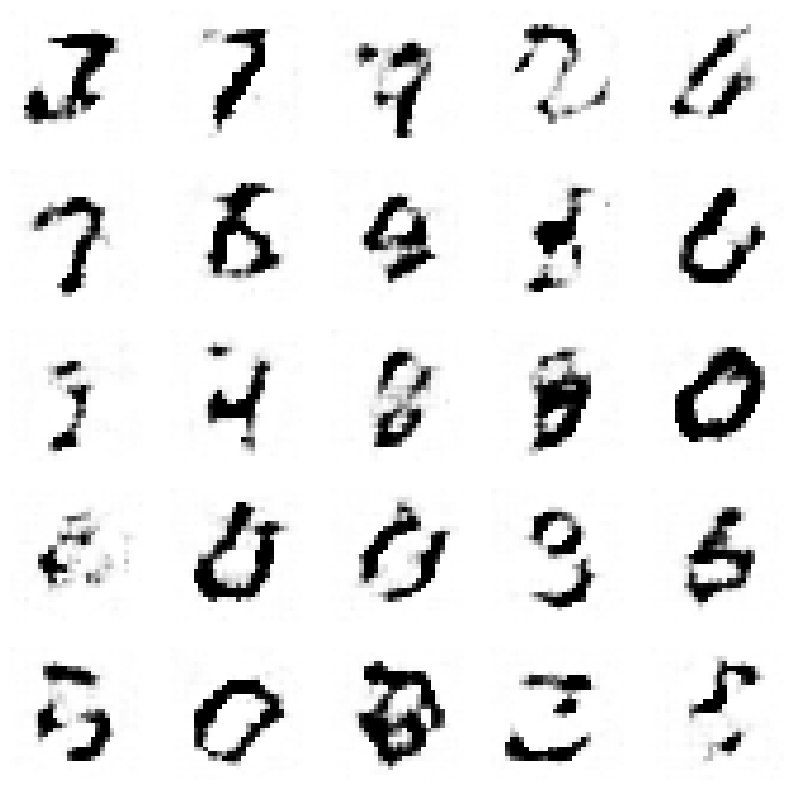

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.12141348625350203, Generator Loss 0.35945371277311927
1/1 [==============================] - 0s 19ms/step


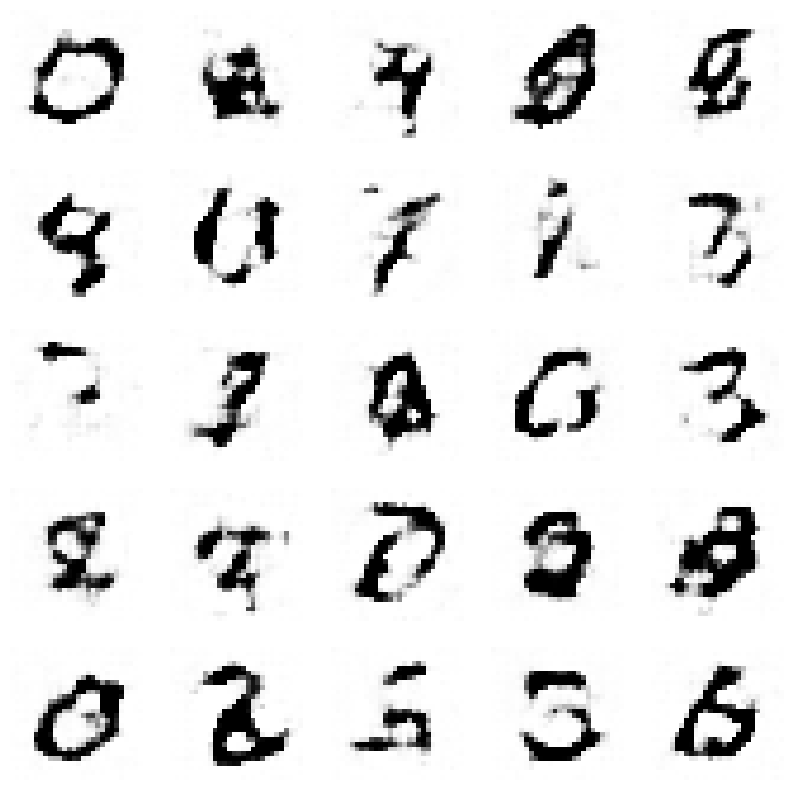

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.12380361824463575, Generator Loss 0.36669509533124095
1/1 [==============================] - 0s 29ms/step


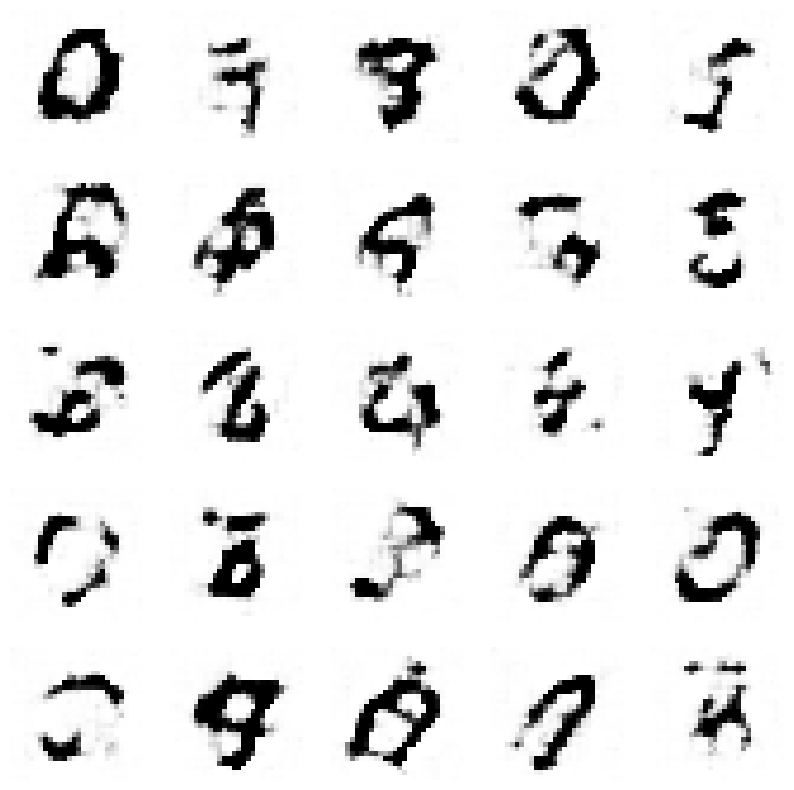

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.12627572126877615, Generator Loss 0.37359874880211985
1/1 [==============================] - 0s 39ms/step


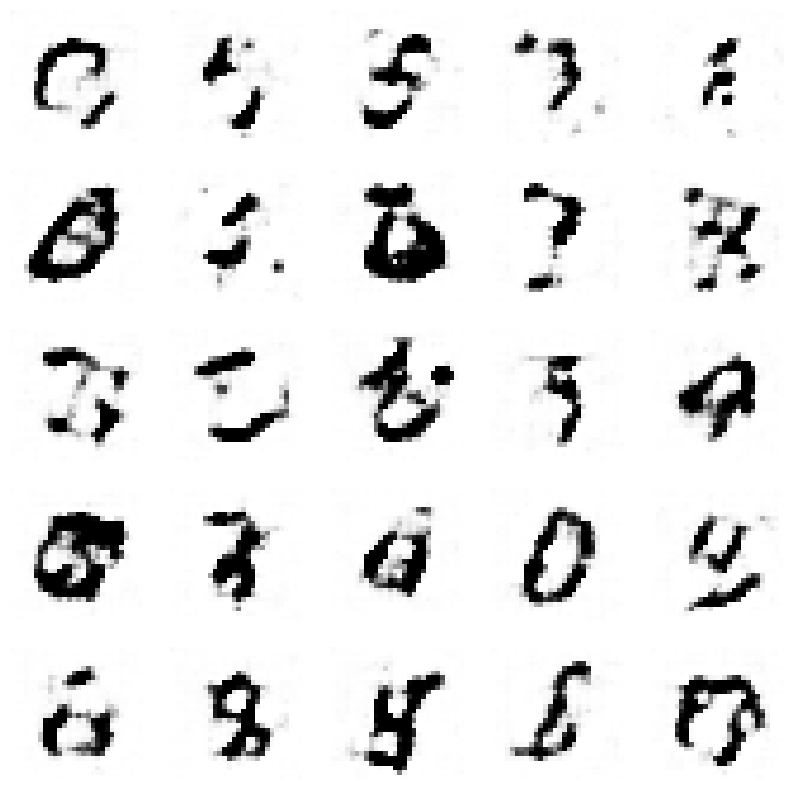

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1288823939414106, Generator Loss 0.38052853763612926
1/1 [==============================] - 0s 24ms/step


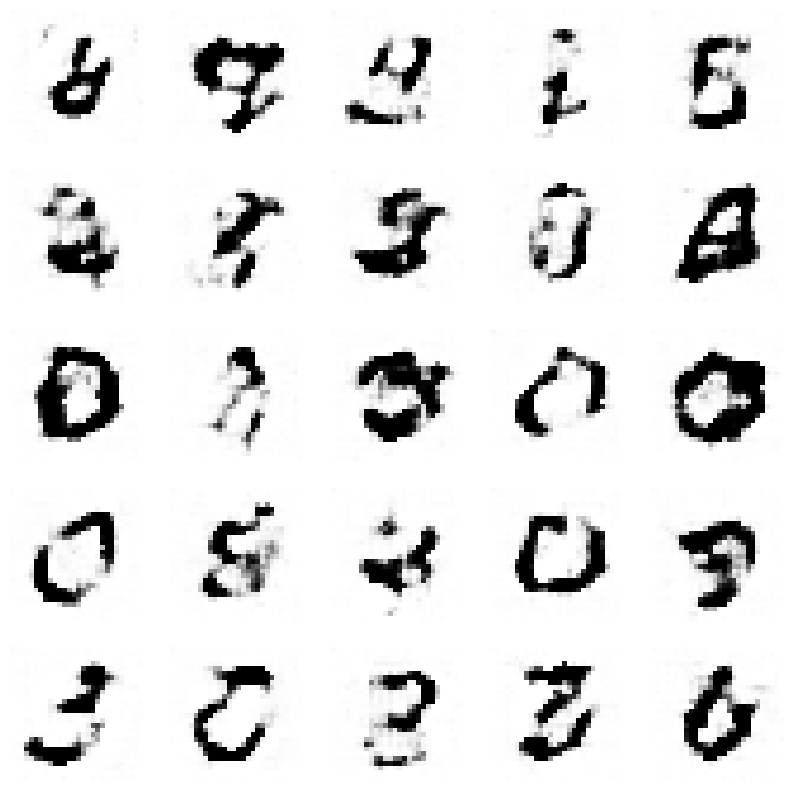

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.13131927214881295, Generator Loss 0.3879434573344695
1/1 [==============================] - 0s 20ms/step


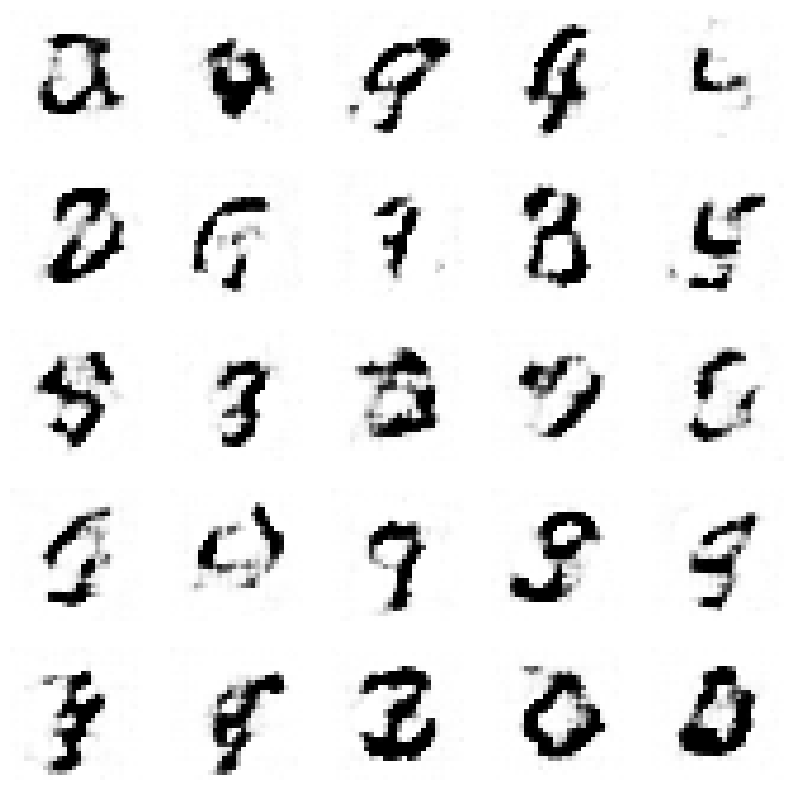

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.13376257173780703, Generator Loss 0.3955918805212037
1/1 [==============================] - 0s 17ms/step


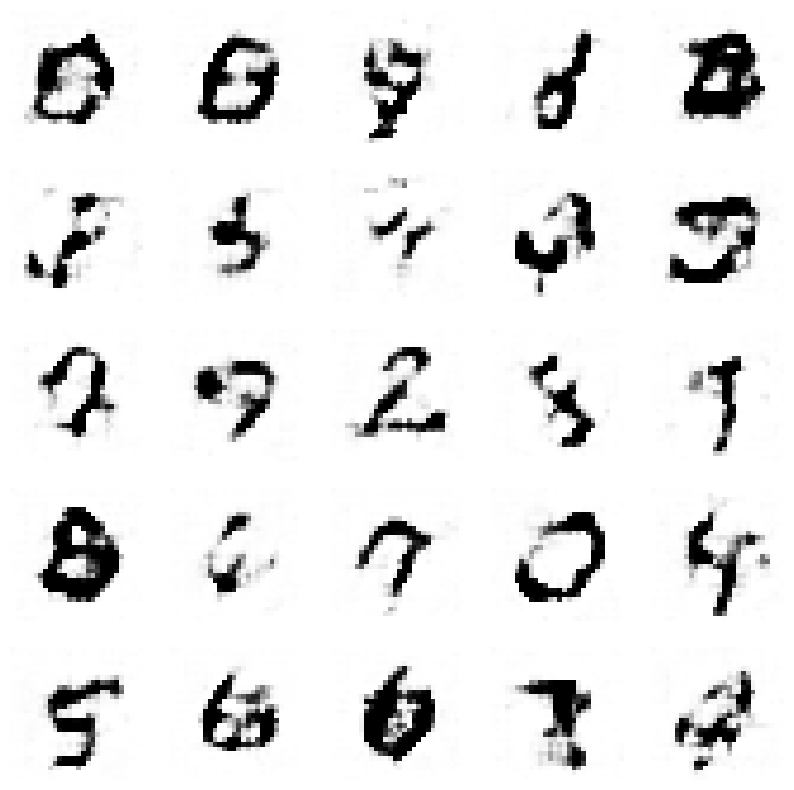

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.13641609830988777, Generator Loss 0.402518729878287
1/1 [==============================] - 0s 19ms/step


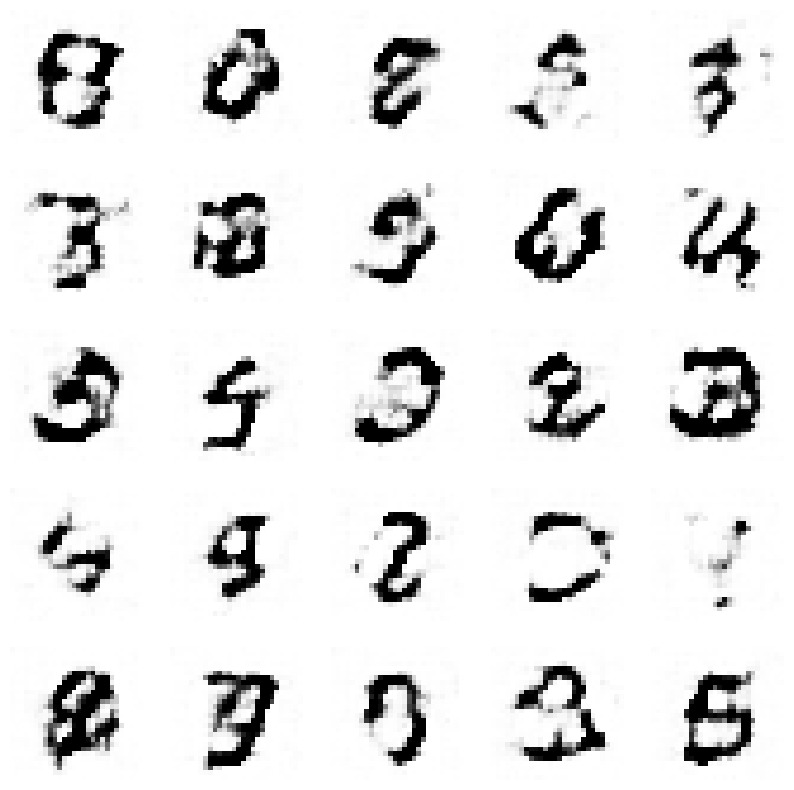

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1389122409825651, Generator Loss 0.4100798832045661
1/1 [==============================] - 0s 22ms/step


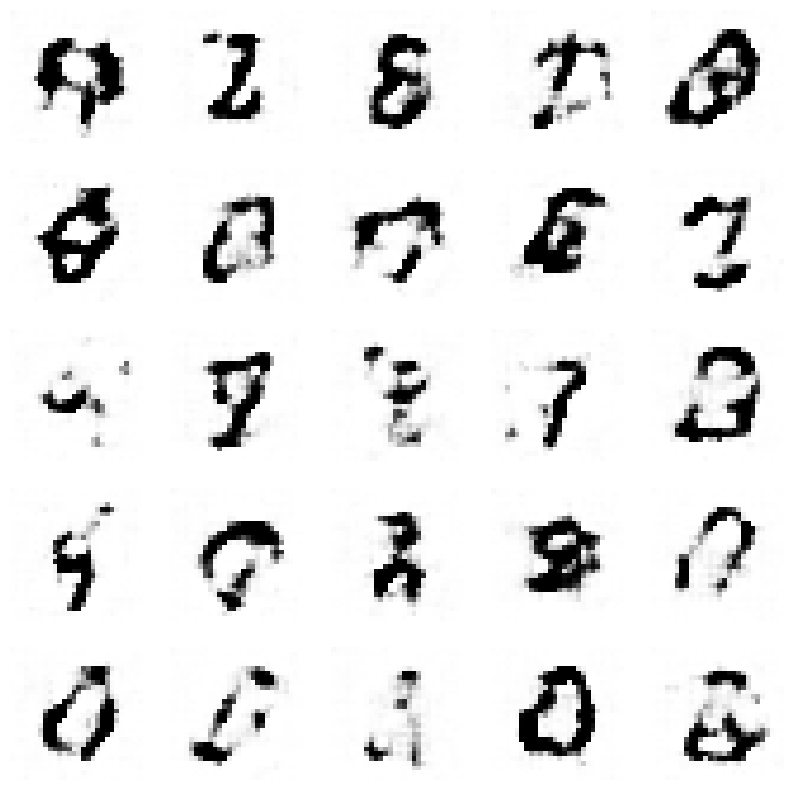

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1415726001191343, Generator Loss 0.4173604830717429
1/1 [==============================] - 0s 17ms/step


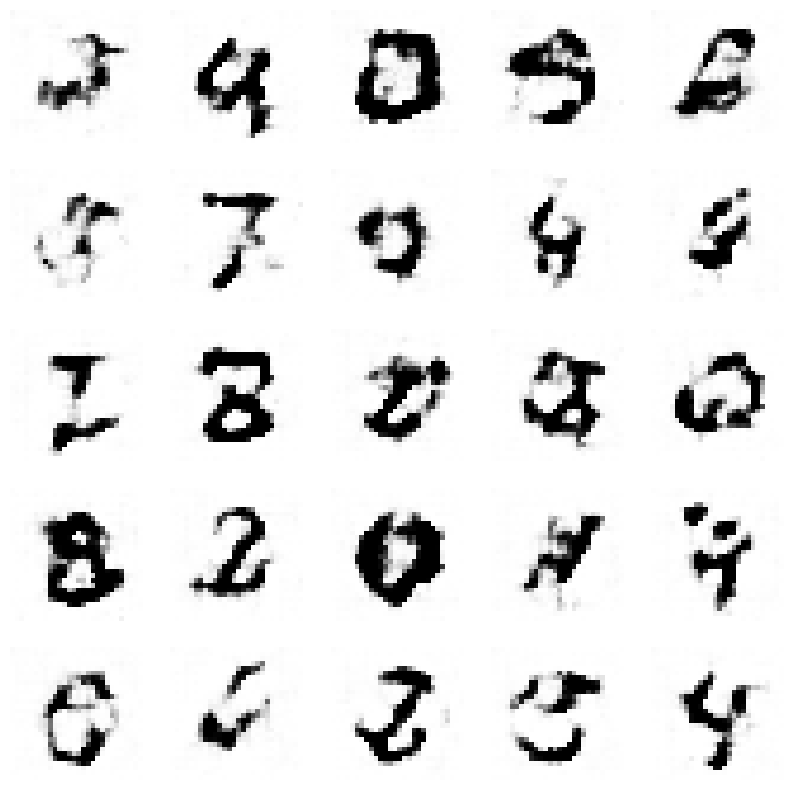

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1439951076848894, Generator Loss 0.4246799691110595
1/1 [==============================] - 0s 19ms/step


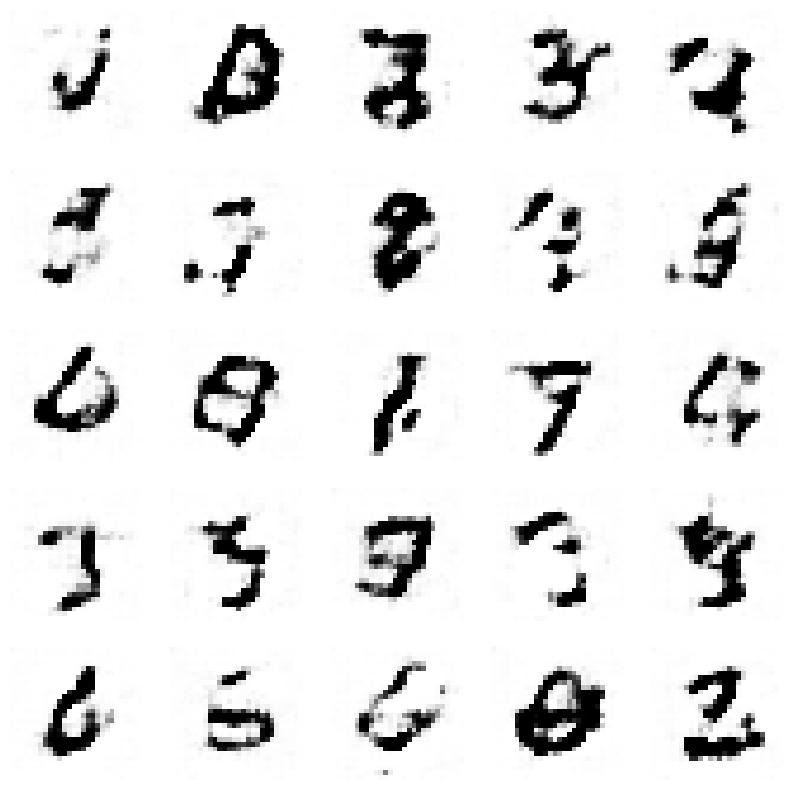

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.14691240531511796, Generator Loss 0.4317043968754956
1/1 [==============================] - 0s 18ms/step


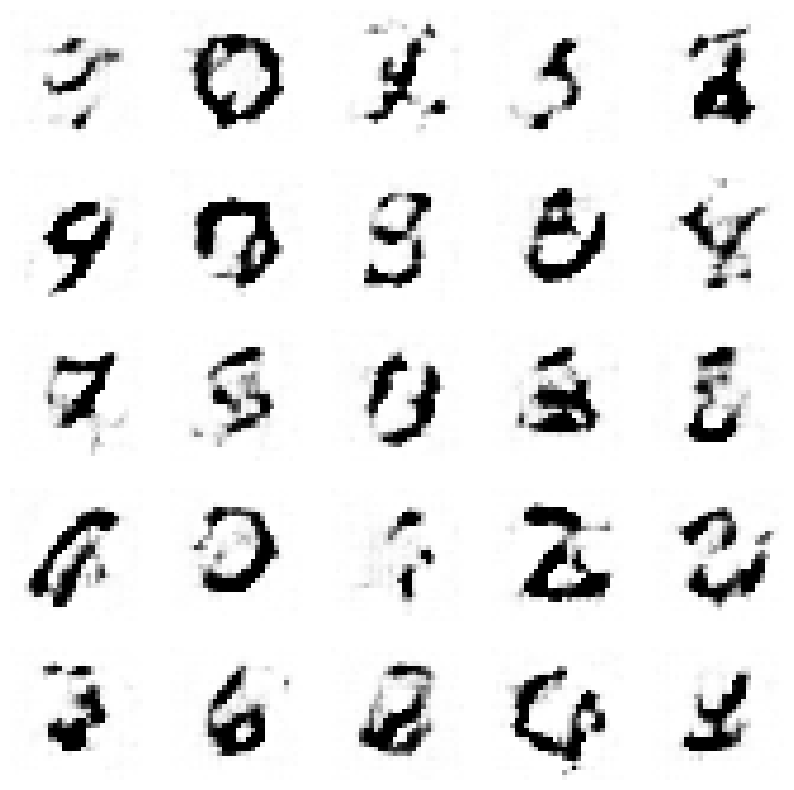

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.14923398808026925, Generator Loss 0.43910737628610724
1/1 [==============================] - 0s 18ms/step


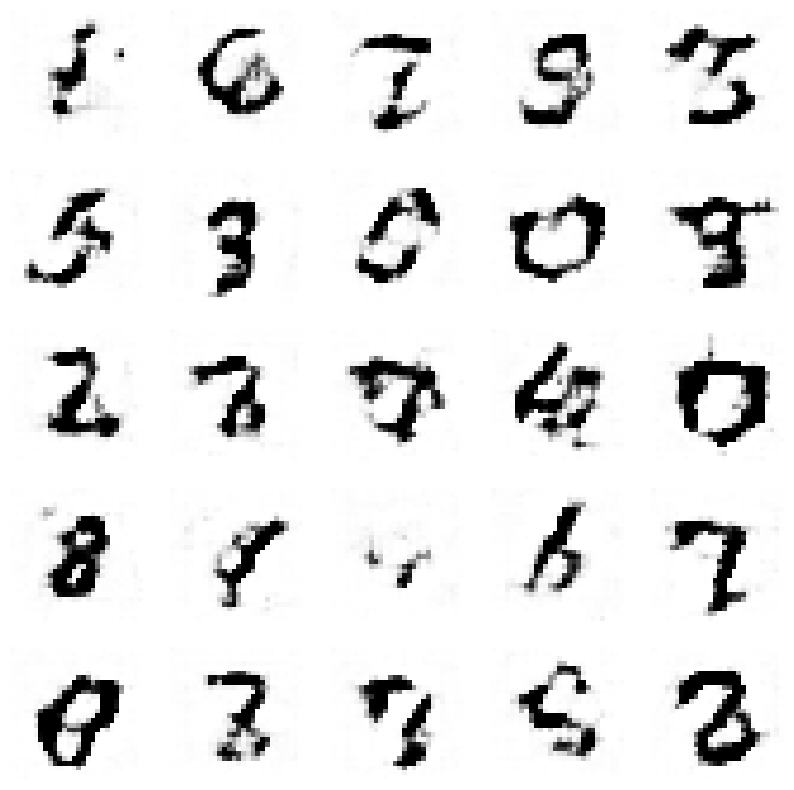

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.15173428104473993, Generator Loss 0.4459535958420517
1/1 [==============================] - 0s 18ms/step


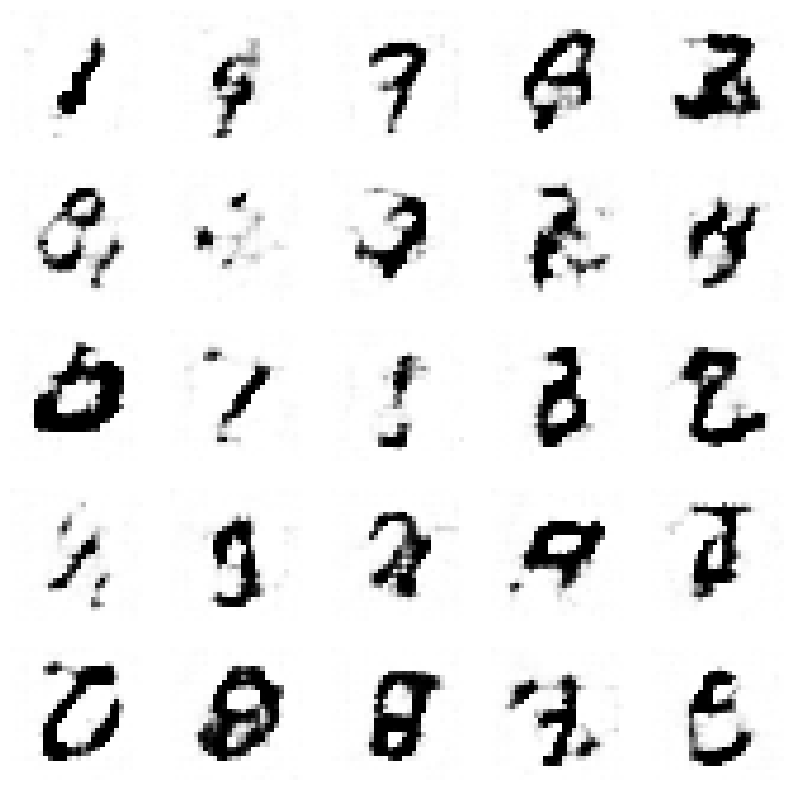

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.15424178559810686, Generator Loss 0.4529375423732986
1/1 [==============================] - 0s 27ms/step


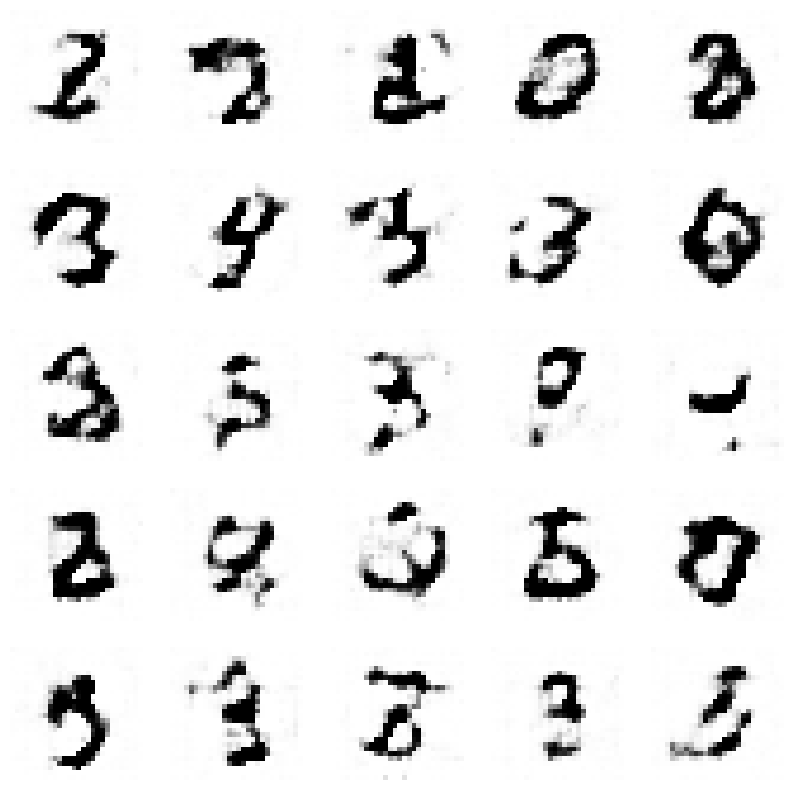

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.15691976395682392, Generator Loss 0.4598672333945576
1/1 [==============================] - 0s 34ms/step


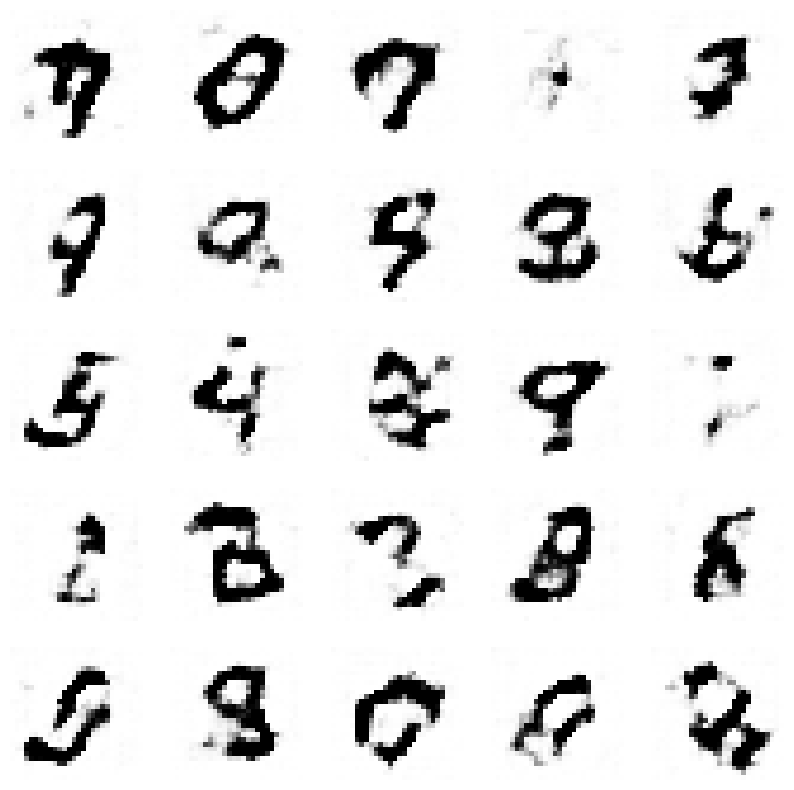

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.15950068277426255, Generator Loss 0.4669127428633535
1/1 [==============================] - 0s 29ms/step


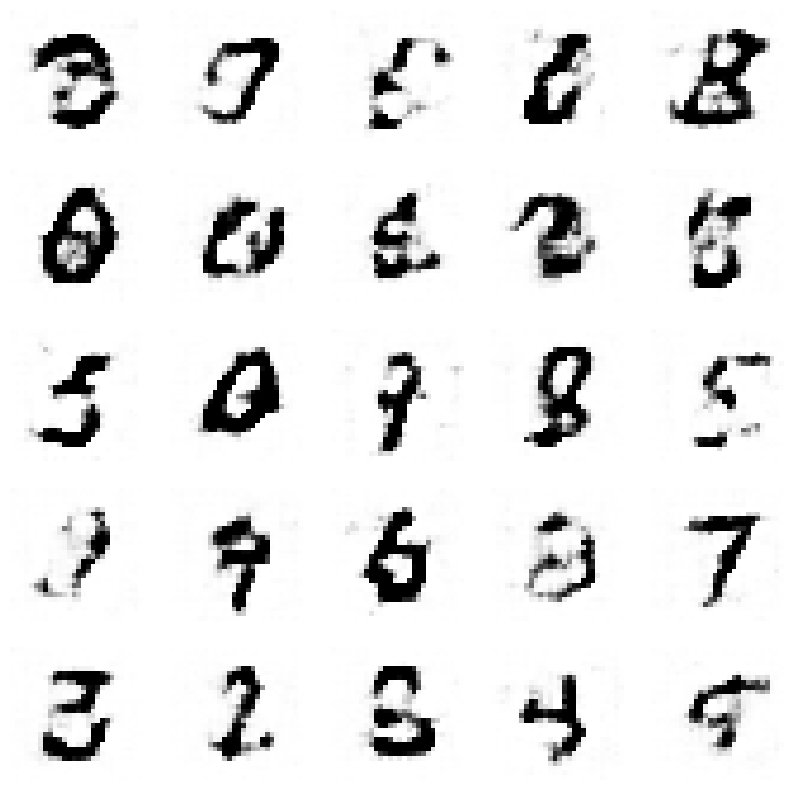

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1618987049302484, Generator Loss 0.47431853999439466
1/1 [==============================] - 0s 18ms/step


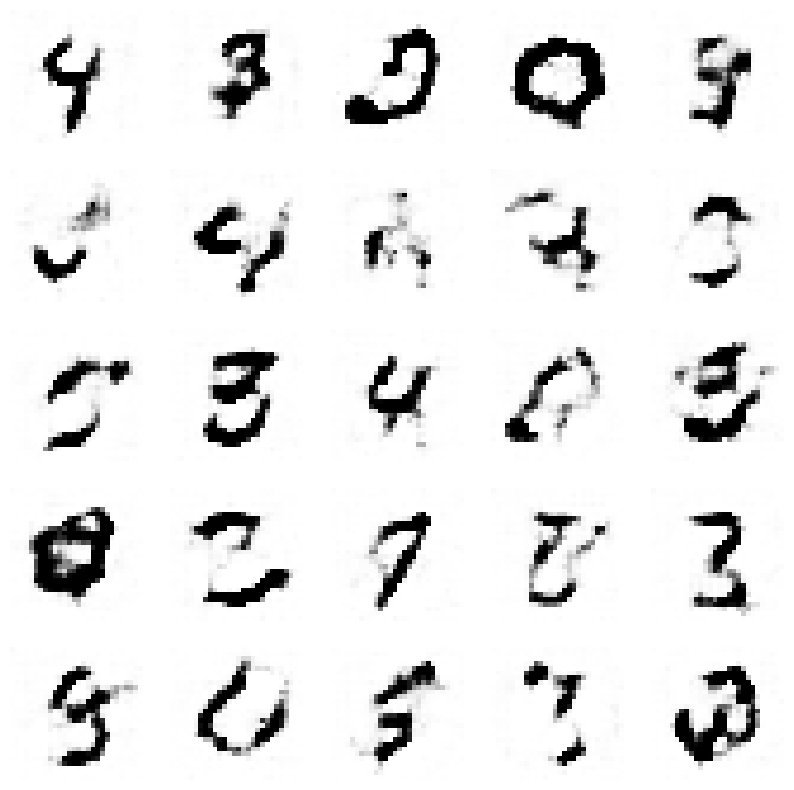

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.16450512549306592, Generator Loss 0.48124591458557
1/1 [==============================] - 0s 18ms/step


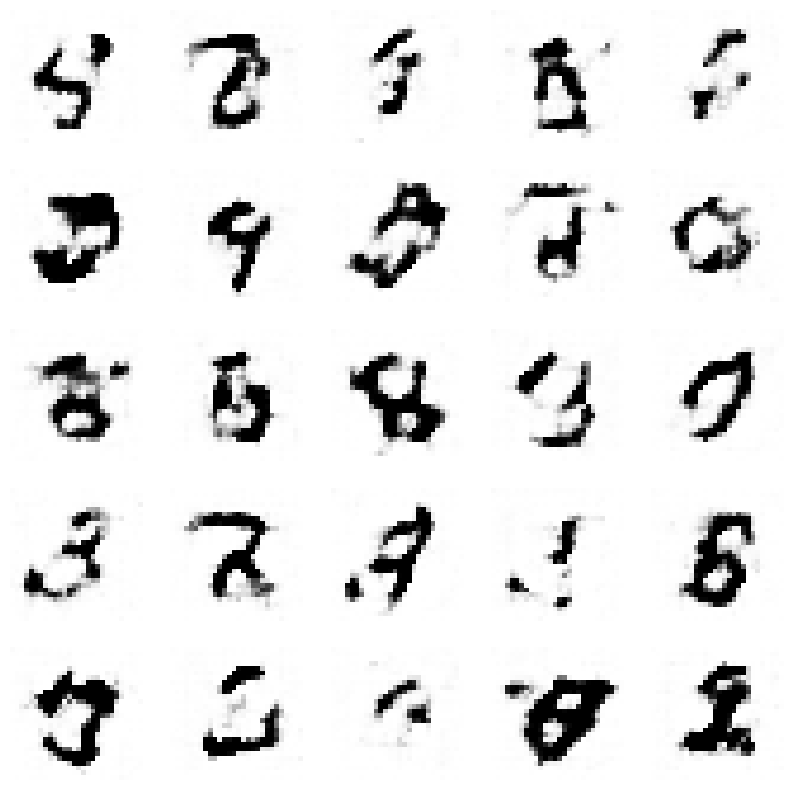

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.16679183298196548, Generator Loss 0.4883378423177279
1/1 [==============================] - 0s 19ms/step


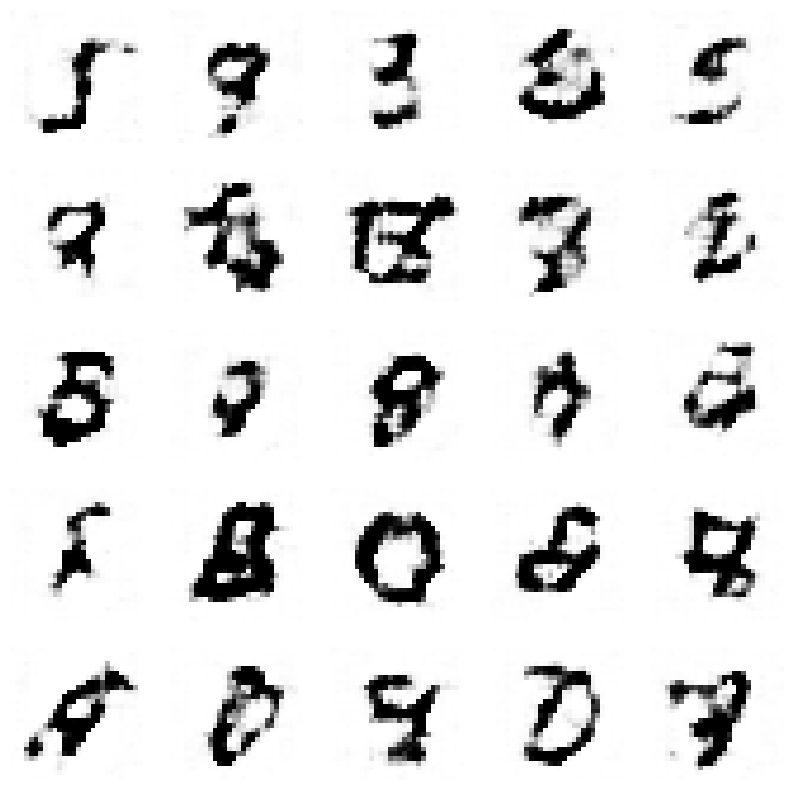

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.16927241629514939, Generator Loss 0.49583763750190407
1/1 [==============================] - 0s 18ms/step


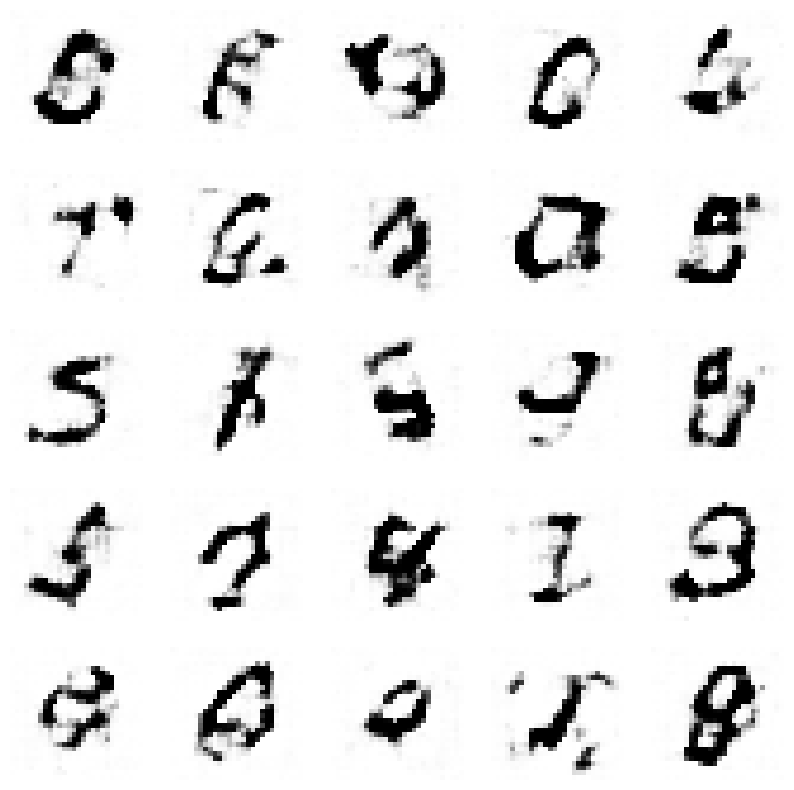

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1717857531247995, Generator Loss 0.5030435721079508
1/1 [==============================] - 0s 18ms/step


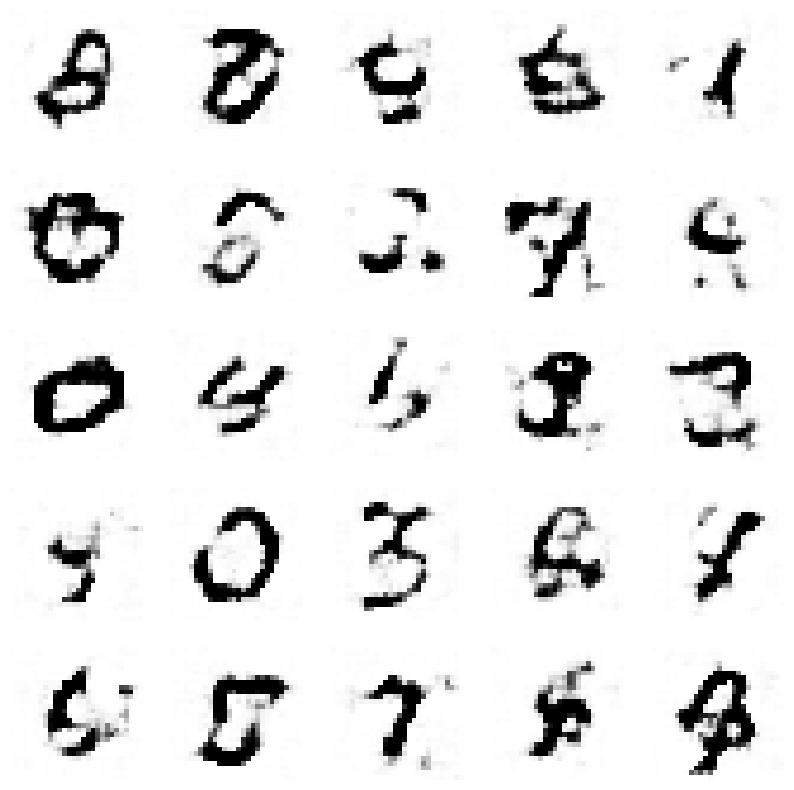

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.17445595906330988, Generator Loss 0.5098606551814283
1/1 [==============================] - 0s 19ms/step


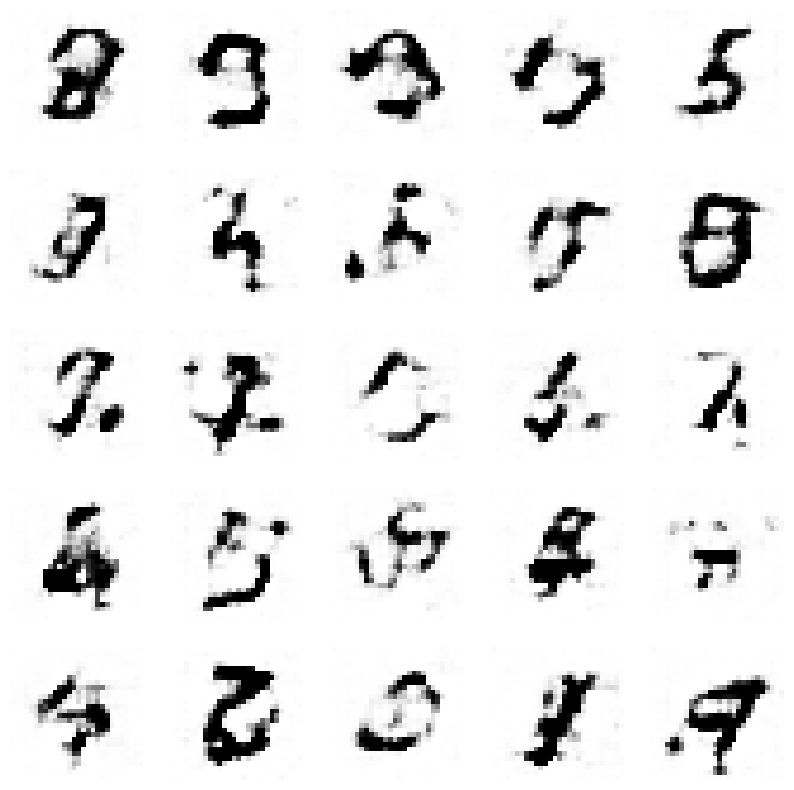

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.17685403254551765, Generator Loss 0.5171116315401517
1/1 [==============================] - 0s 18ms/step


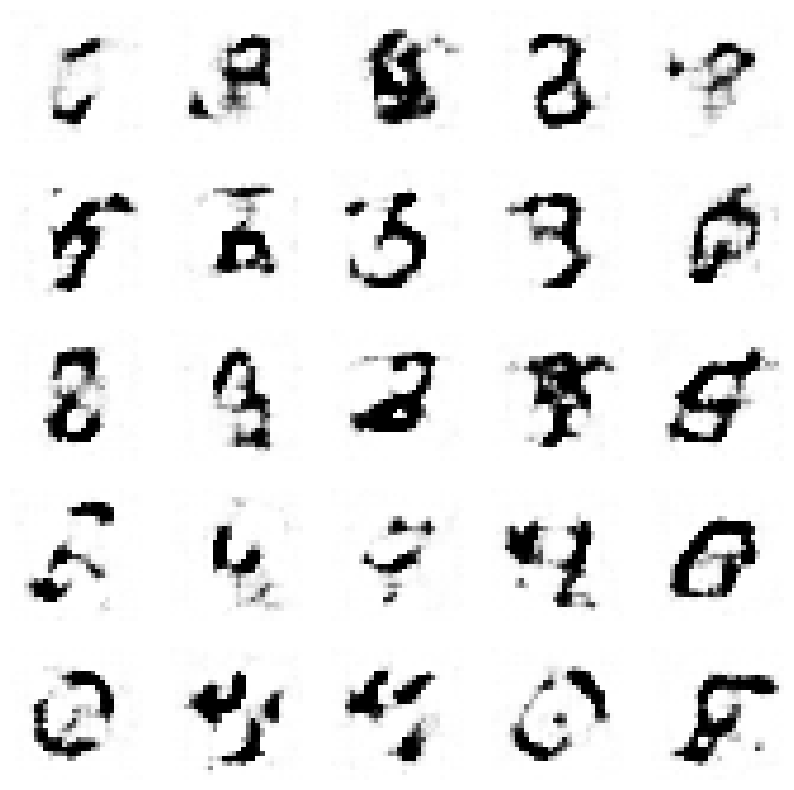

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1794564229173538, Generator Loss 0.5240324124311789
1/1 [==============================] - 0s 17ms/step


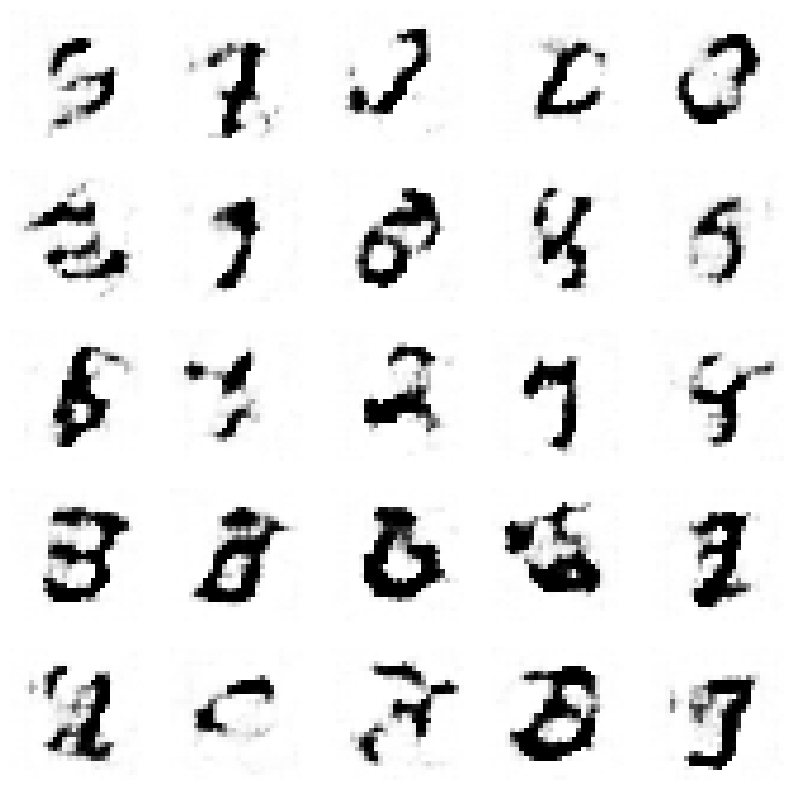

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.18190502929381835, Generator Loss 0.5313408868944544
1/1 [==============================] - 0s 21ms/step


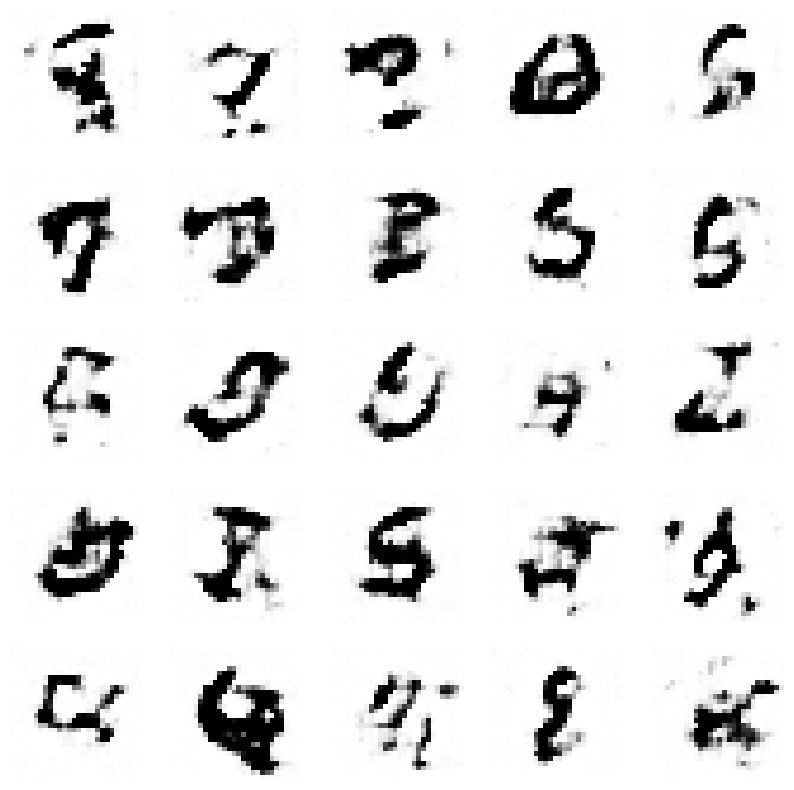

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.18463706575397754, Generator Loss 0.5383950273195902
1/1 [==============================] - 0s 35ms/step


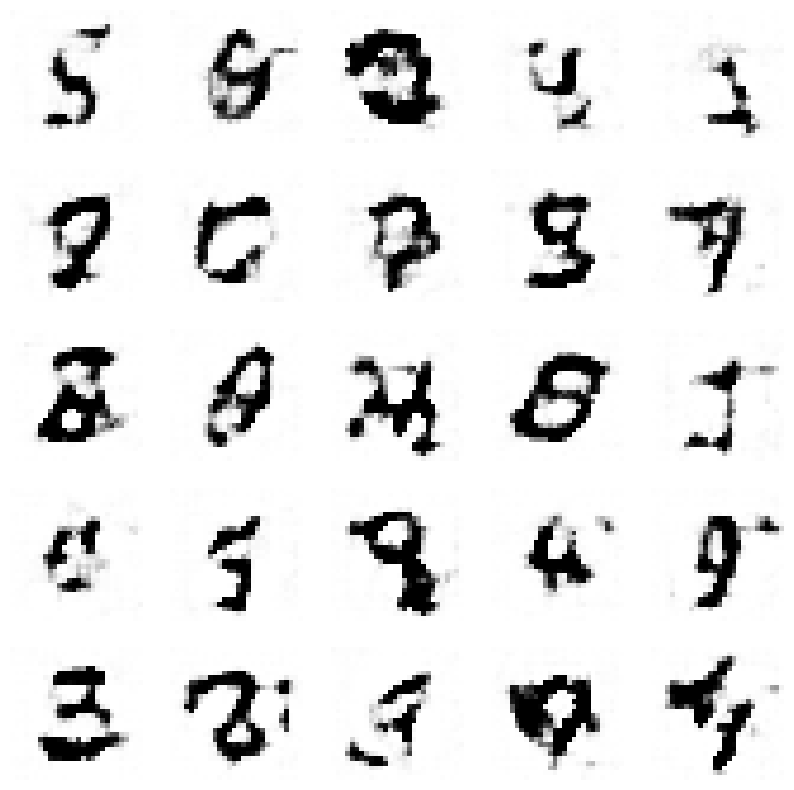

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.18732169614388391, Generator Loss 0.5452992452515496
1/1 [==============================] - 0s 35ms/step


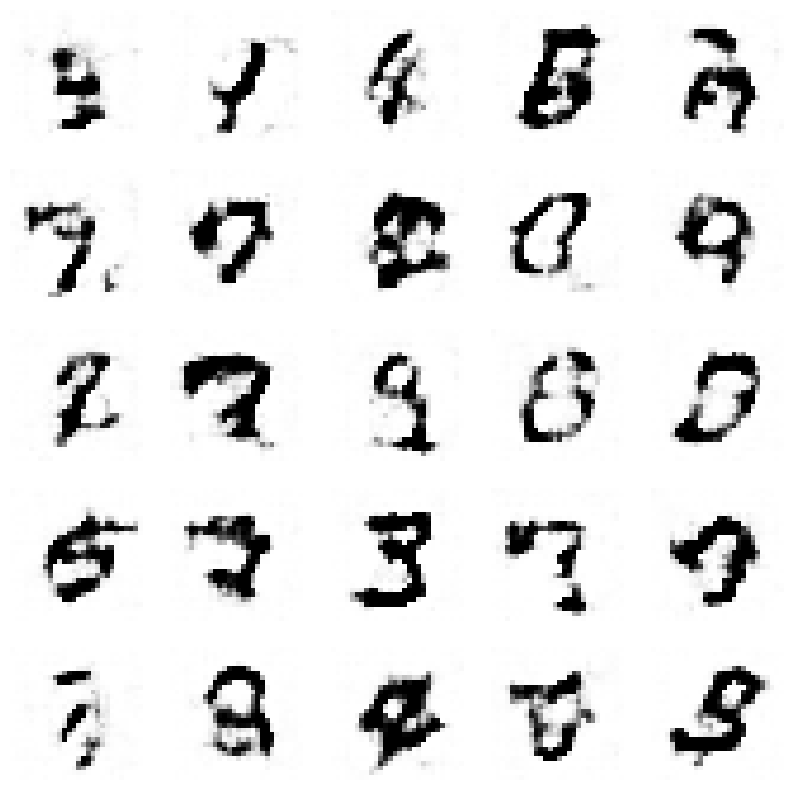

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.18998286752109853, Generator Loss 0.5523064987272279
1/1 [==============================] - 0s 29ms/step


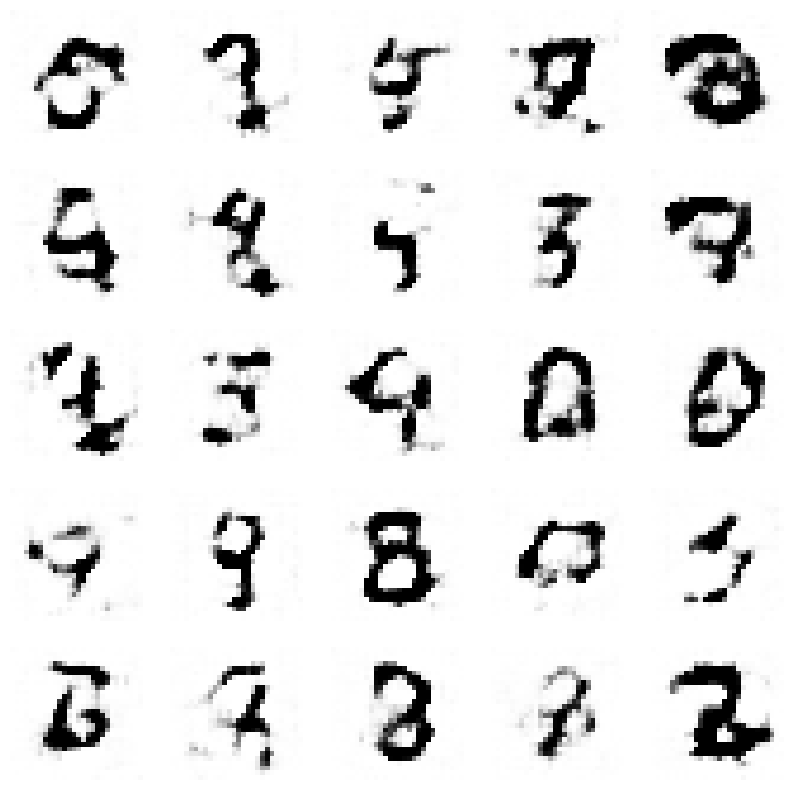

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.19254330985057047, Generator Loss 0.5592573096609523
1/1 [==============================] - 0s 21ms/step


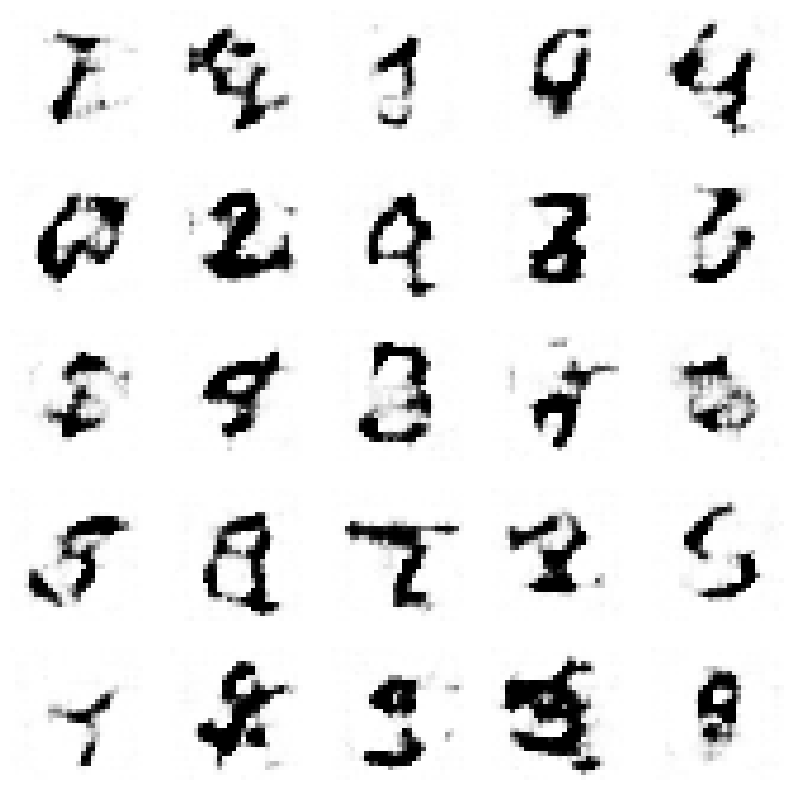

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.19514478692132184, Generator Loss 0.5659173818734976
1/1 [==============================] - 0s 18ms/step


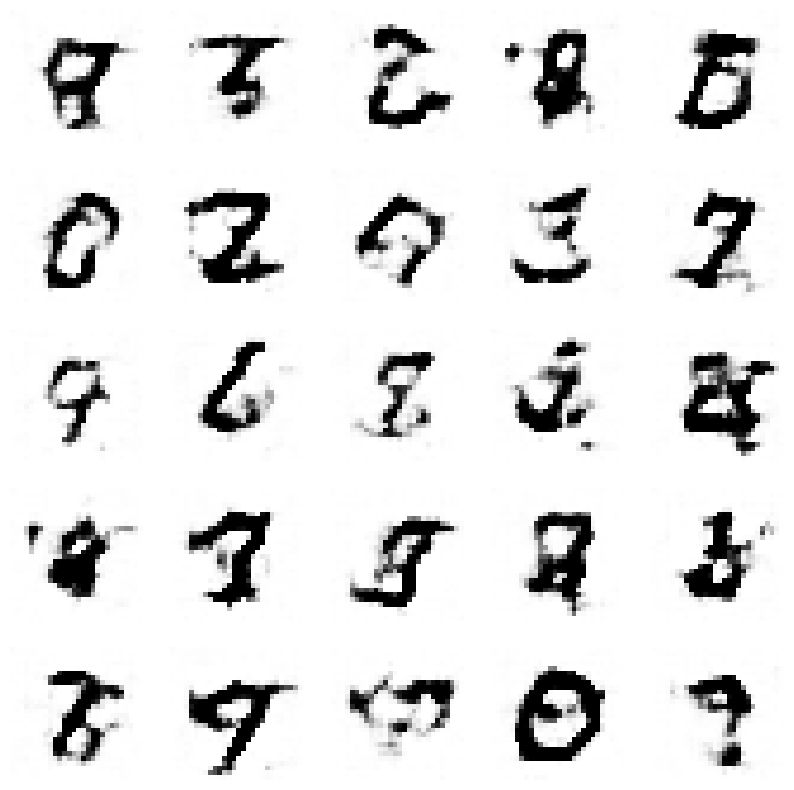

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1974893800723247, Generator Loss 0.5731317110550709
1/1 [==============================] - 0s 18ms/step


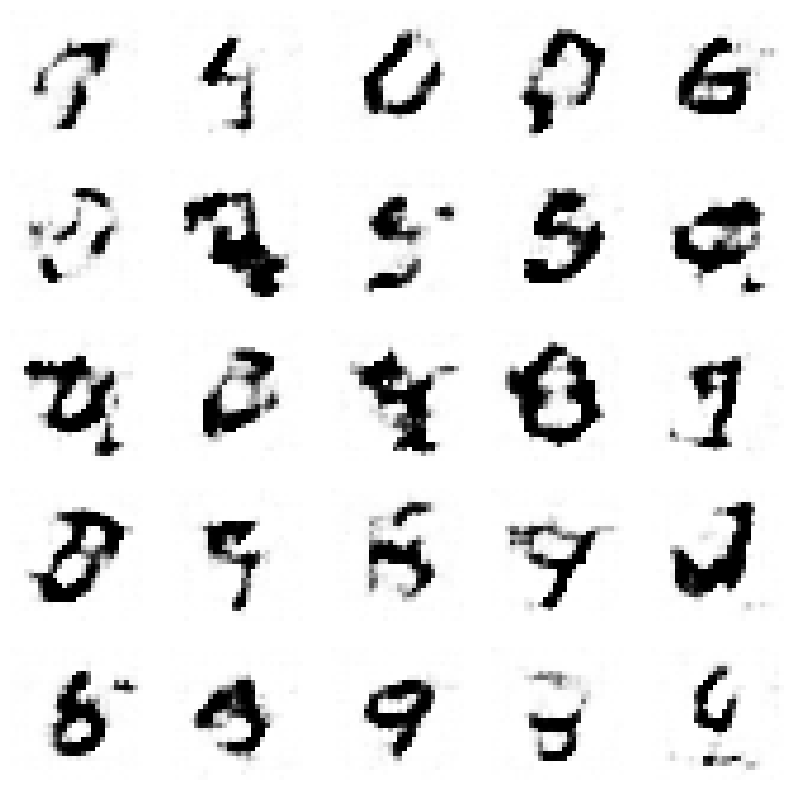

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.1999805570922346, Generator Loss 0.5801233358872242
1/1 [==============================] - 0s 19ms/step


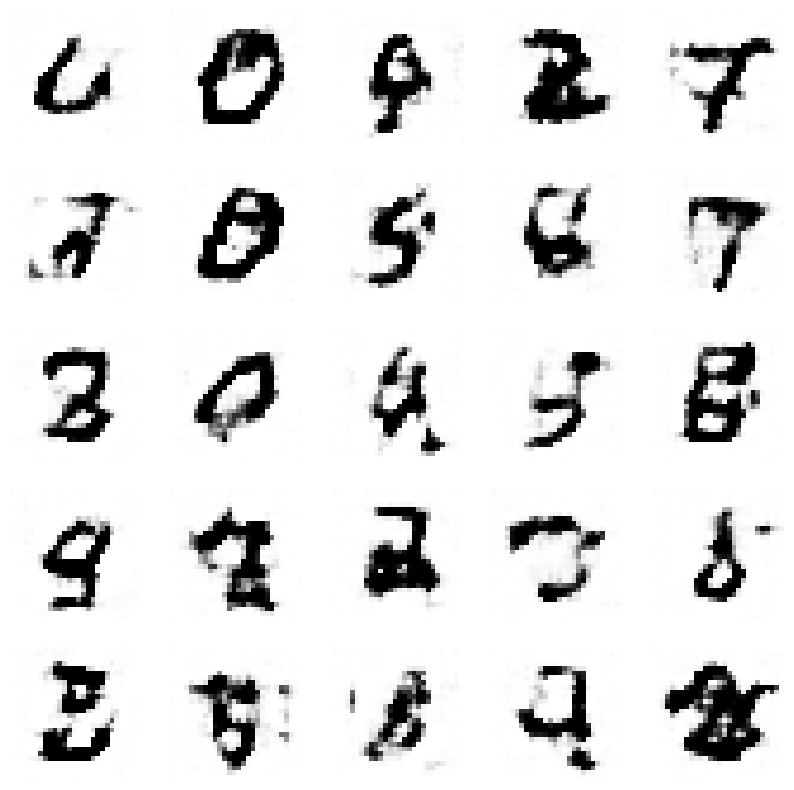

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.20248226770478436, Generator Loss 0.587118054047609
1/1 [==============================] - 0s 18ms/step


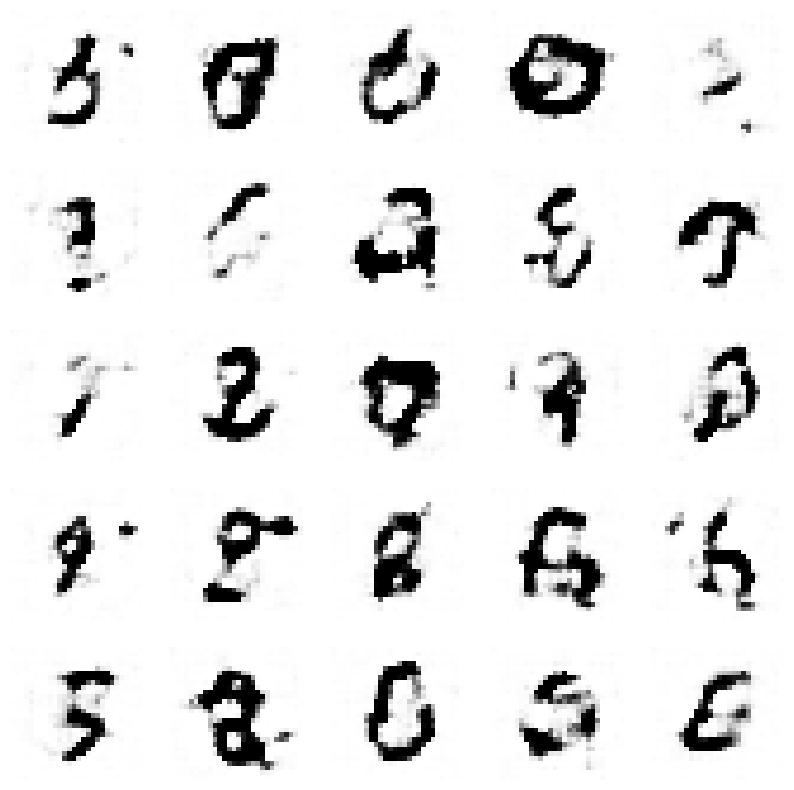

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.20493078970501566, Generator Loss 0.5946214790018196
1/1 [==============================] - 0s 30ms/step


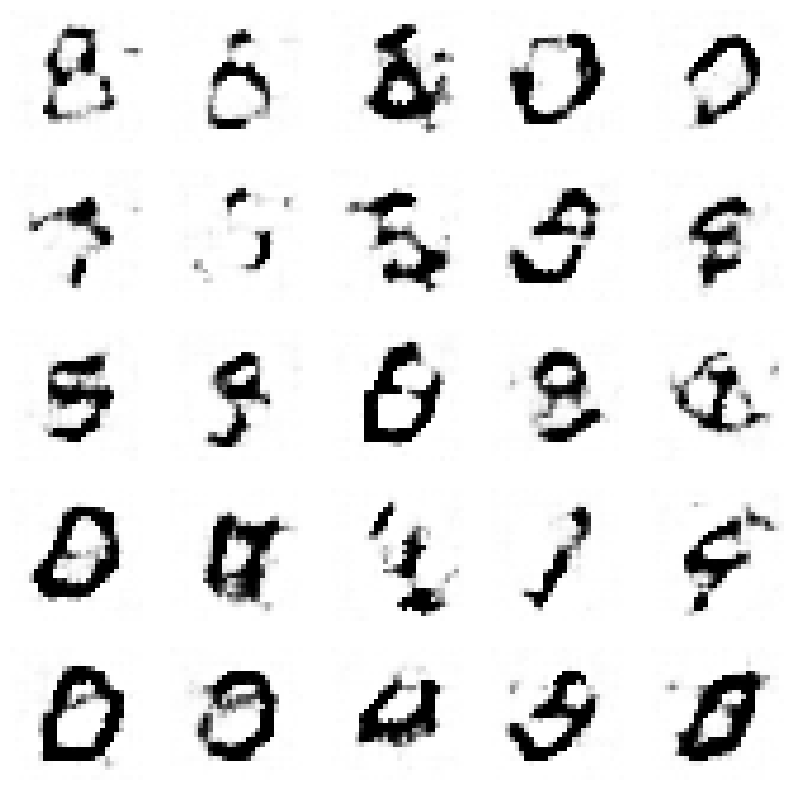

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.20748054172493455, Generator Loss 0.6018723646799723
1/1 [==============================] - 0s 18ms/step


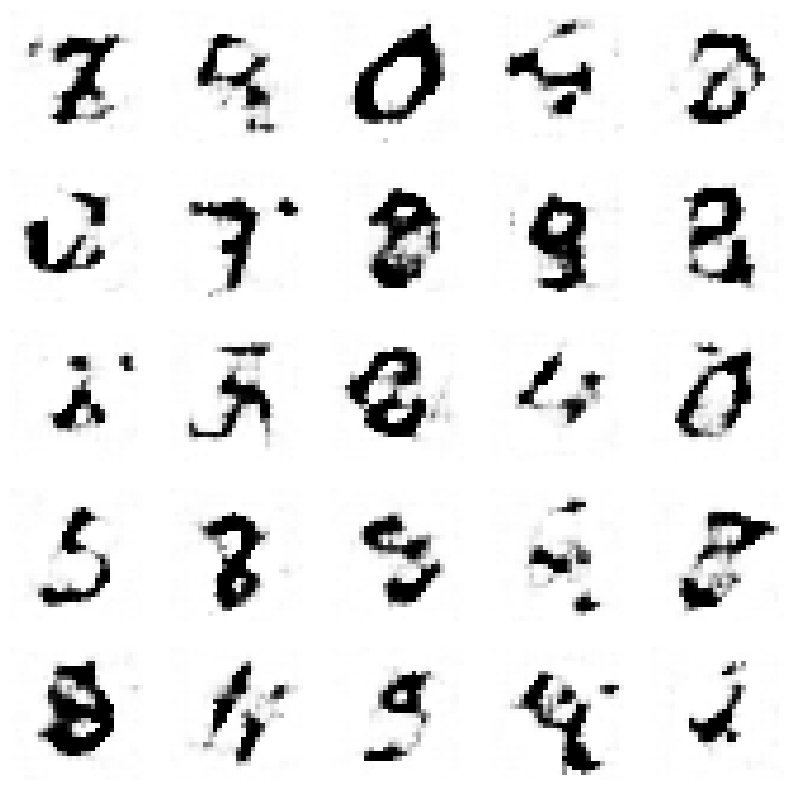

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.20984900061391357, Generator Loss 0.6092921561665006
1/1 [==============================] - 0s 18ms/step


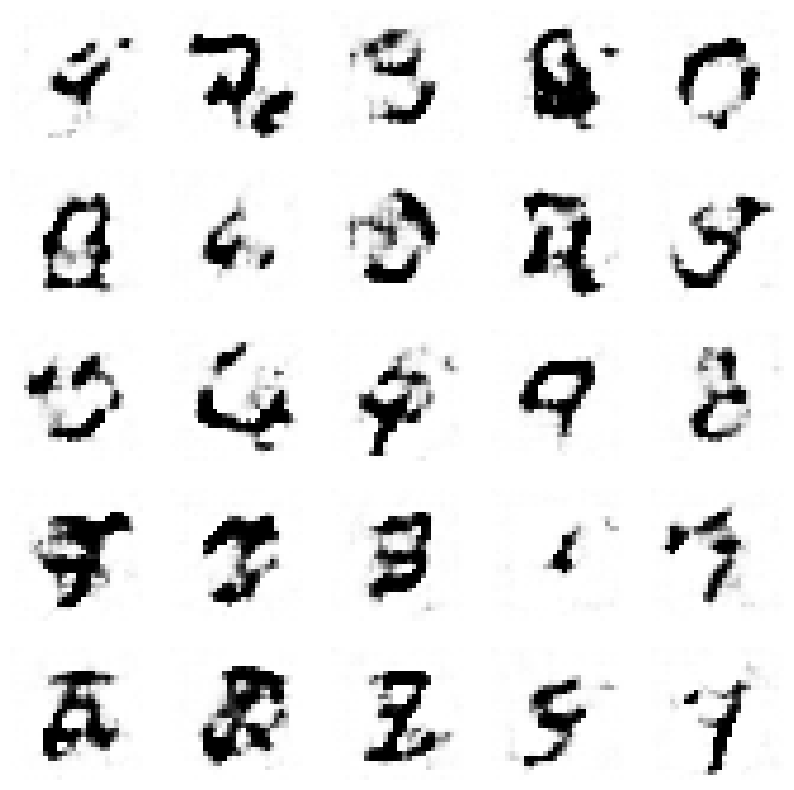

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.21242755524113646, Generator Loss 0.6163638656974858
1/1 [==============================] - 0s 18ms/step


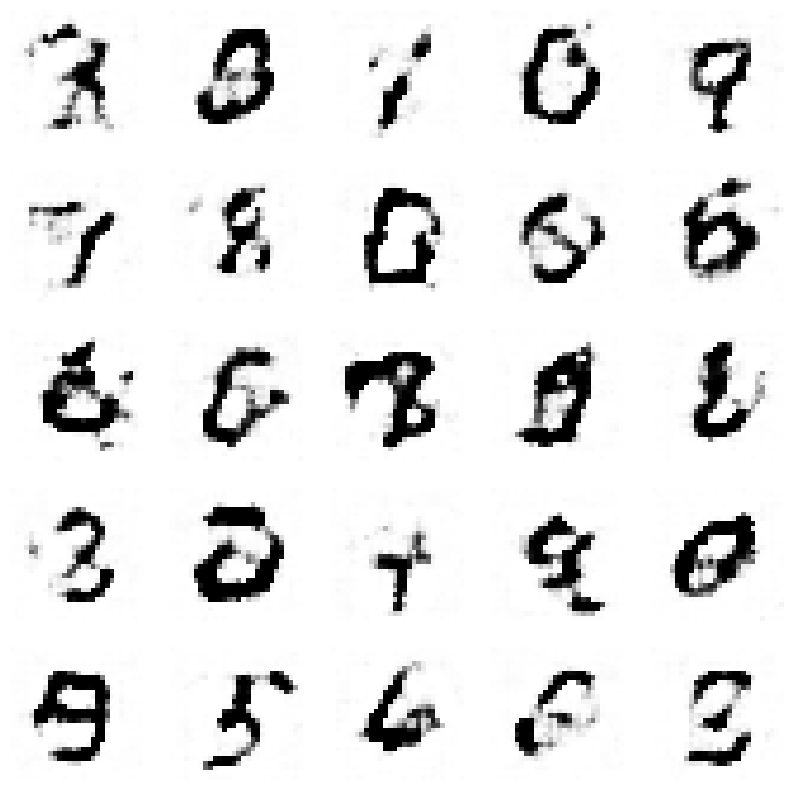

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2150364150094171, Generator Loss 0.6234170723165202
1/1 [==============================] - 0s 41ms/step


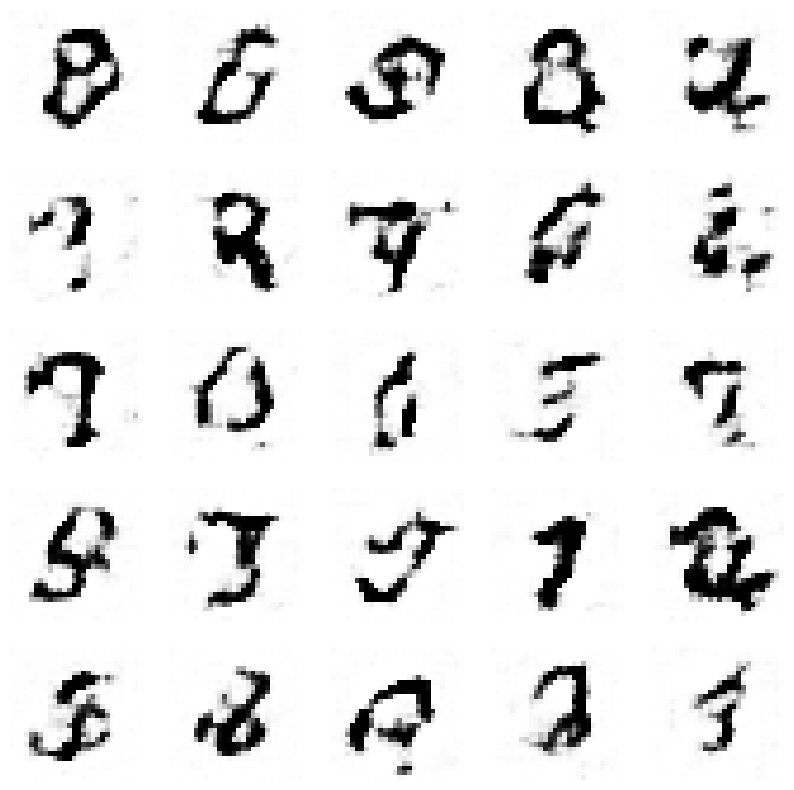

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.21751352896293005, Generator Loss 0.6310288473072215
1/1 [==============================] - 0s 43ms/step


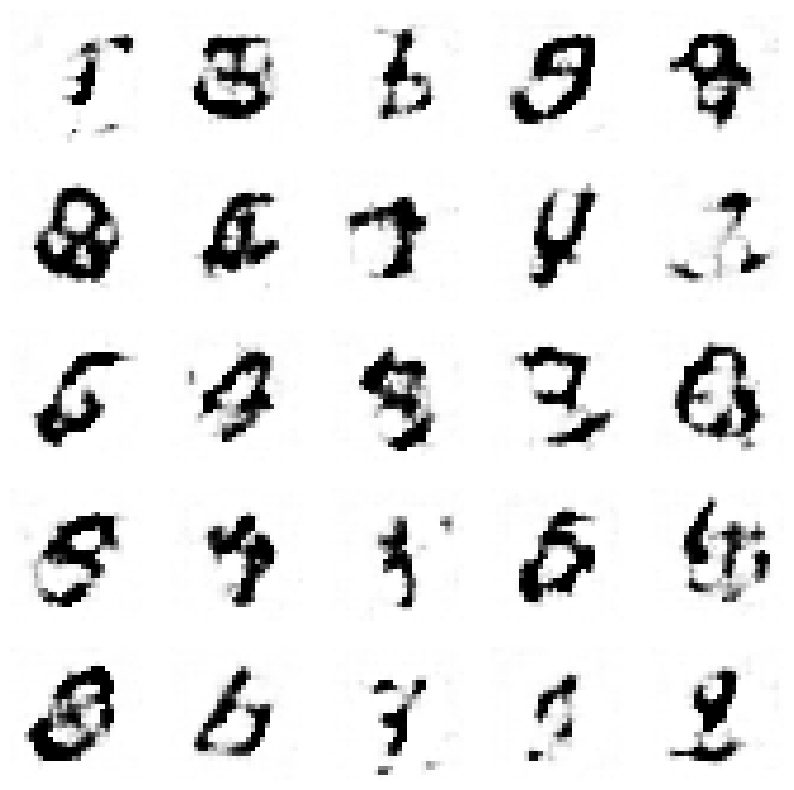

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2200065510522606, Generator Loss 0.6381746775064713
1/1 [==============================] - 0s 18ms/step


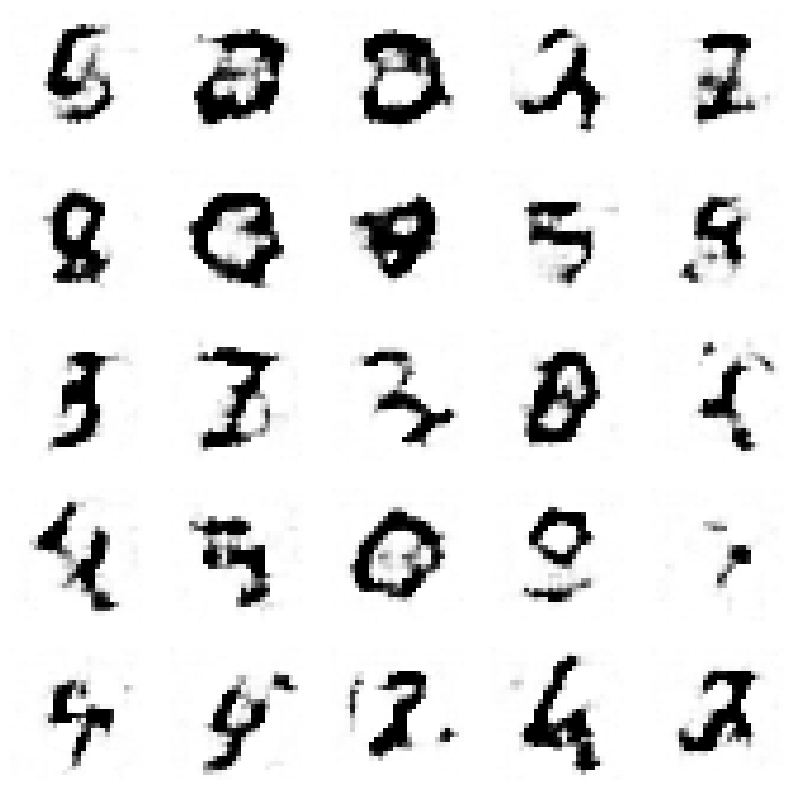

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2225024867643658, Generator Loss 0.6452818874619964
1/1 [==============================] - 0s 18ms/step


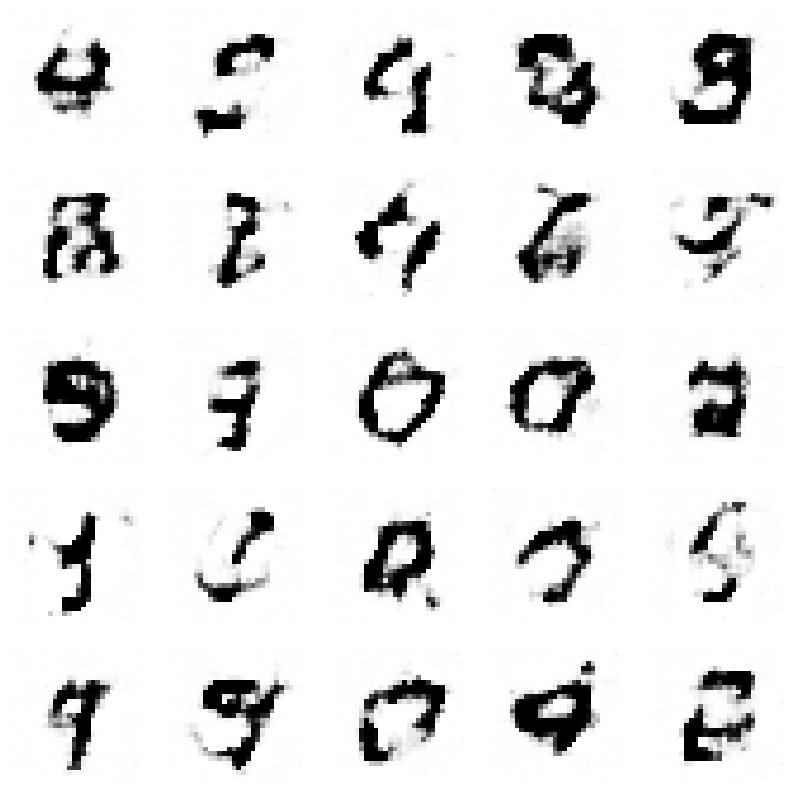

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.22504515079861012, Generator Loss 0.6526540772527711
1/1 [==============================] - 0s 26ms/step


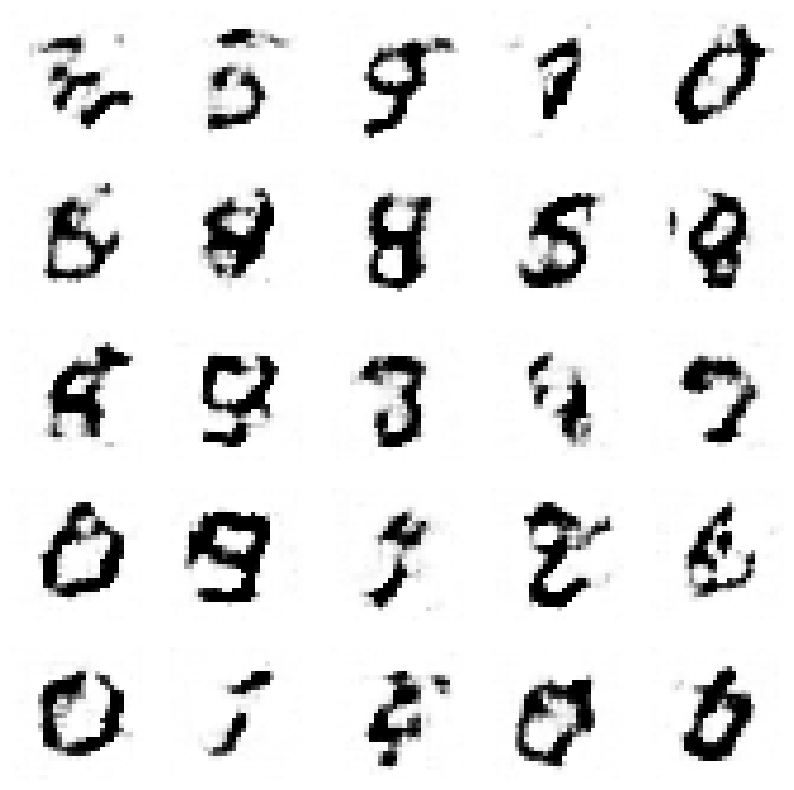

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.22759021500236967, Generator Loss 0.659842404544863
1/1 [==============================] - 0s 18ms/step


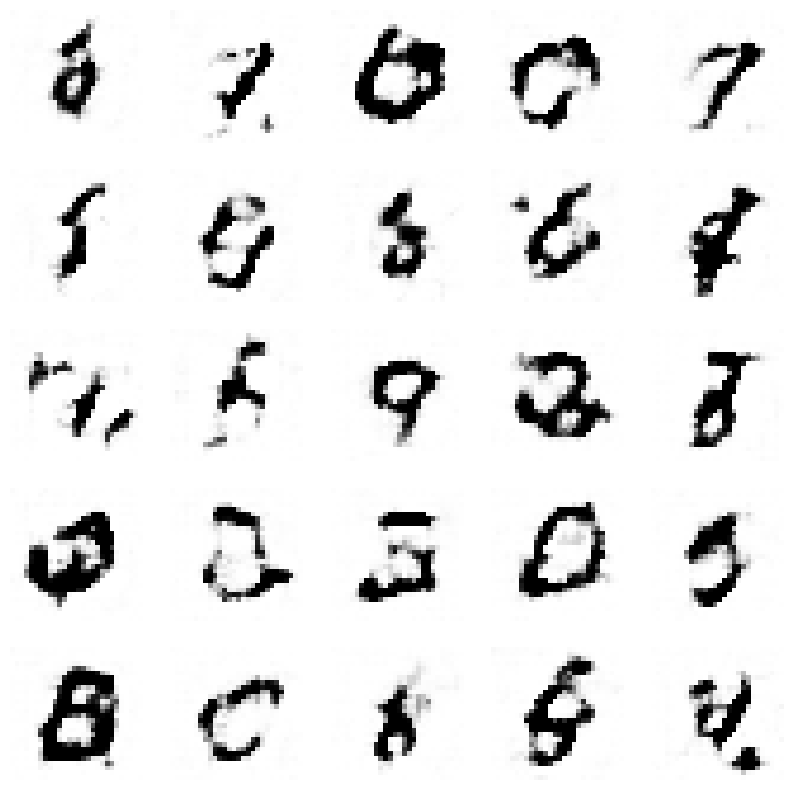

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.23014274303220275, Generator Loss 0.6666148075690637
1/1 [==============================] - 0s 18ms/step


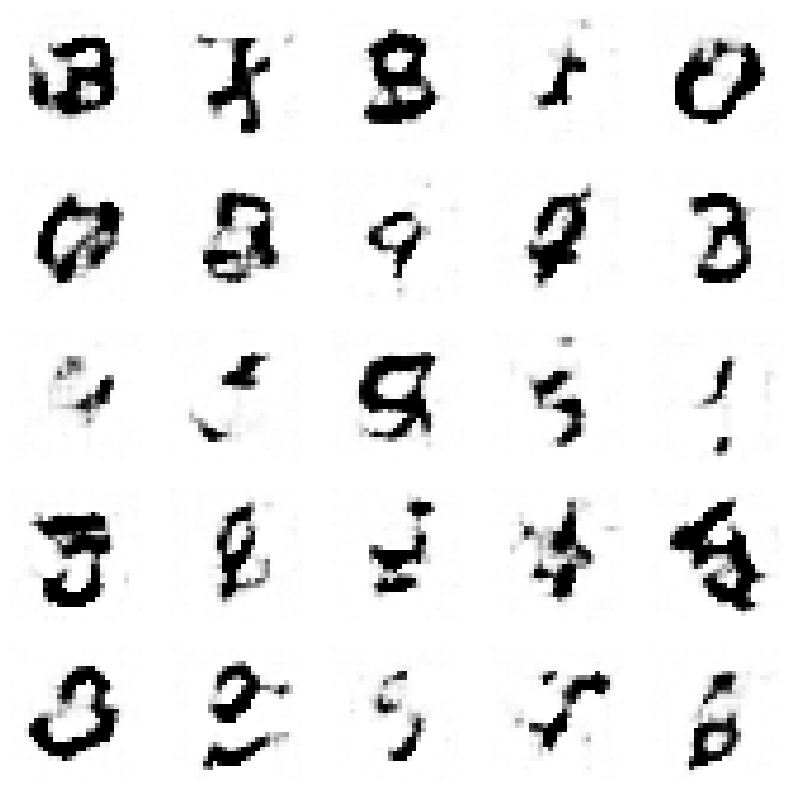

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.23271693964289802, Generator Loss 0.6735670622597393
1/1 [==============================] - 0s 18ms/step


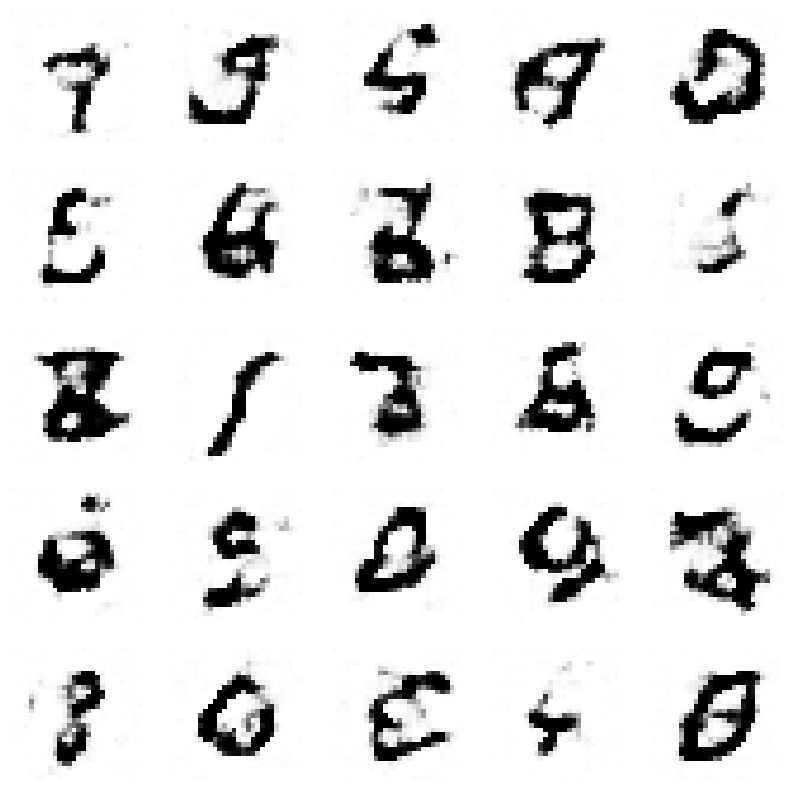

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.23520188078156903, Generator Loss 0.6810645247117068
1/1 [==============================] - 0s 42ms/step


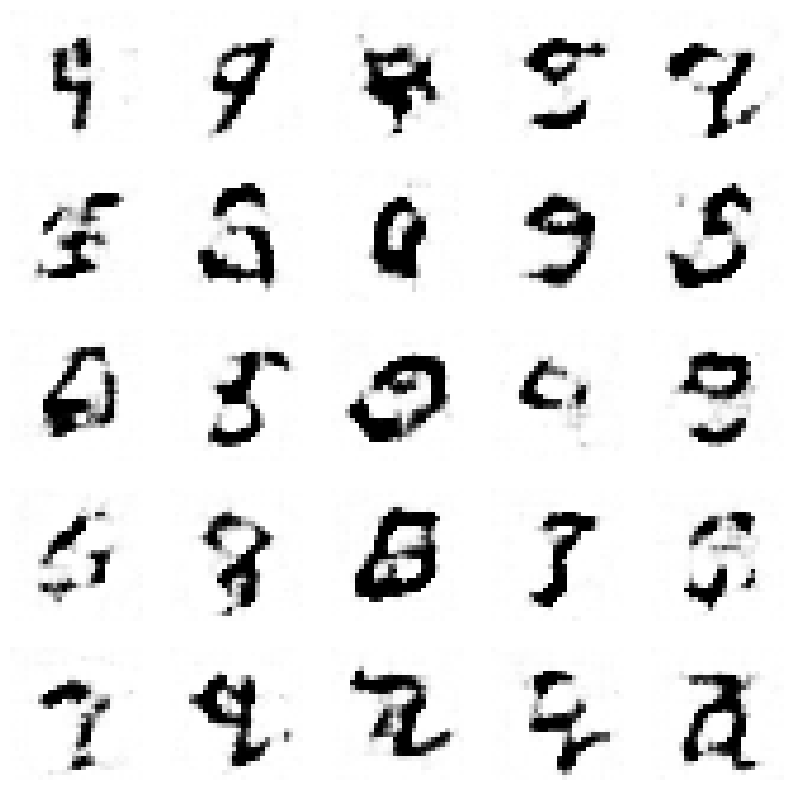

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.23787871098671204, Generator Loss 0.6878086654548972
1/1 [==============================] - 0s 17ms/step


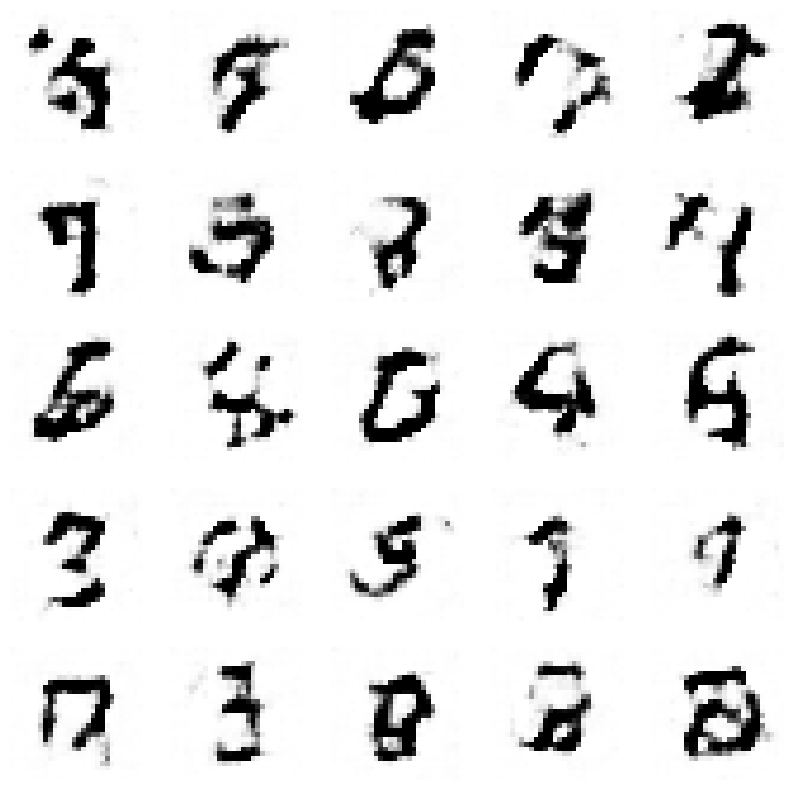

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.2402702479535698, Generator Loss 0.6942741595781766
1/1 [==============================] - 0s 18ms/step


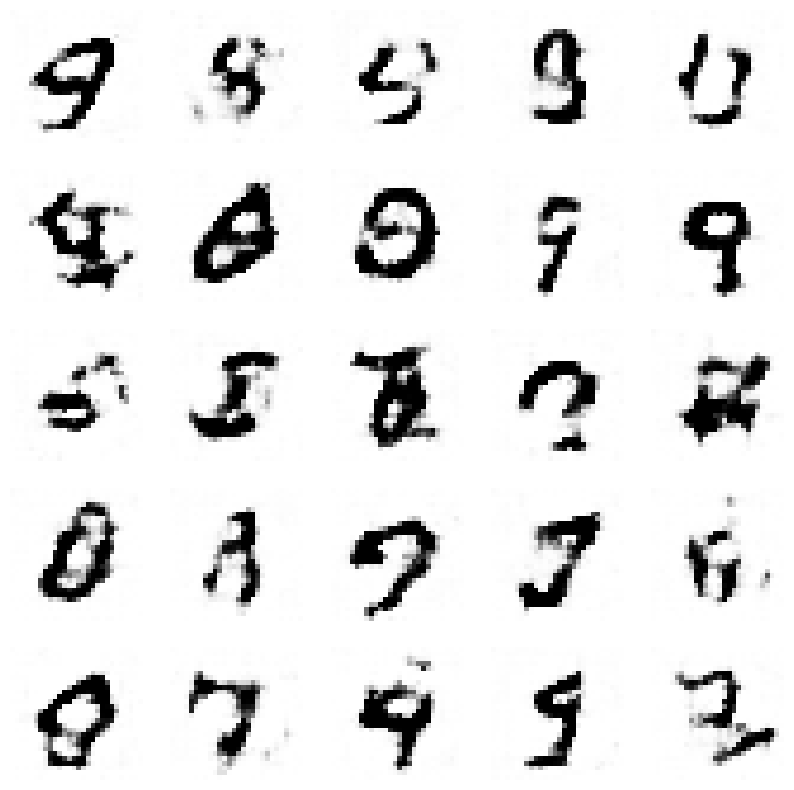

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.2429666144725604, Generator Loss 0.700807033950447
1/1 [==============================] - 0s 36ms/step


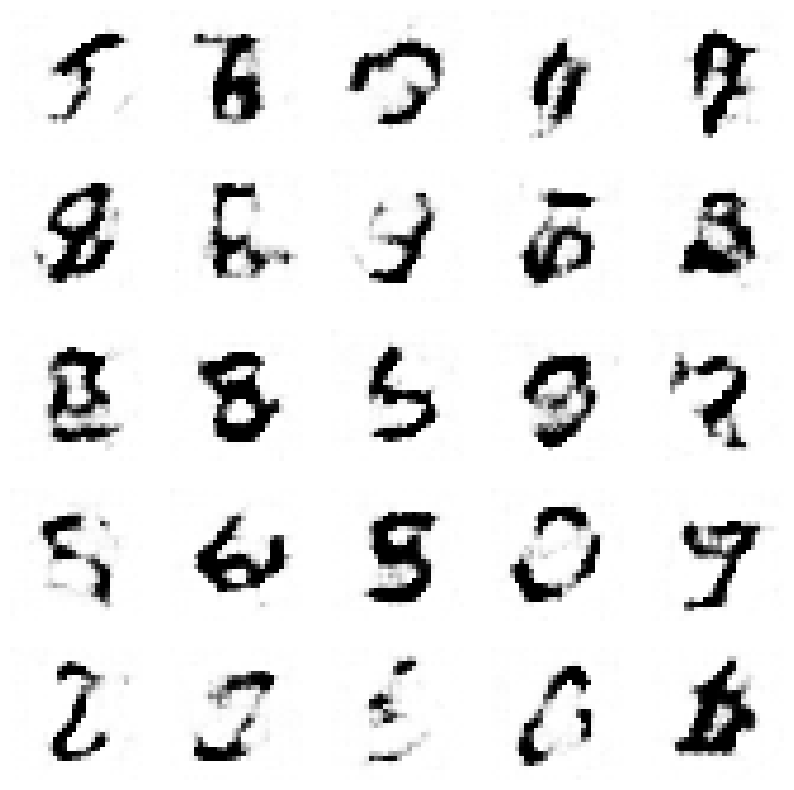

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.24566551915600768, Generator Loss 0.7080878559340779
1/1 [==============================] - 0s 31ms/step


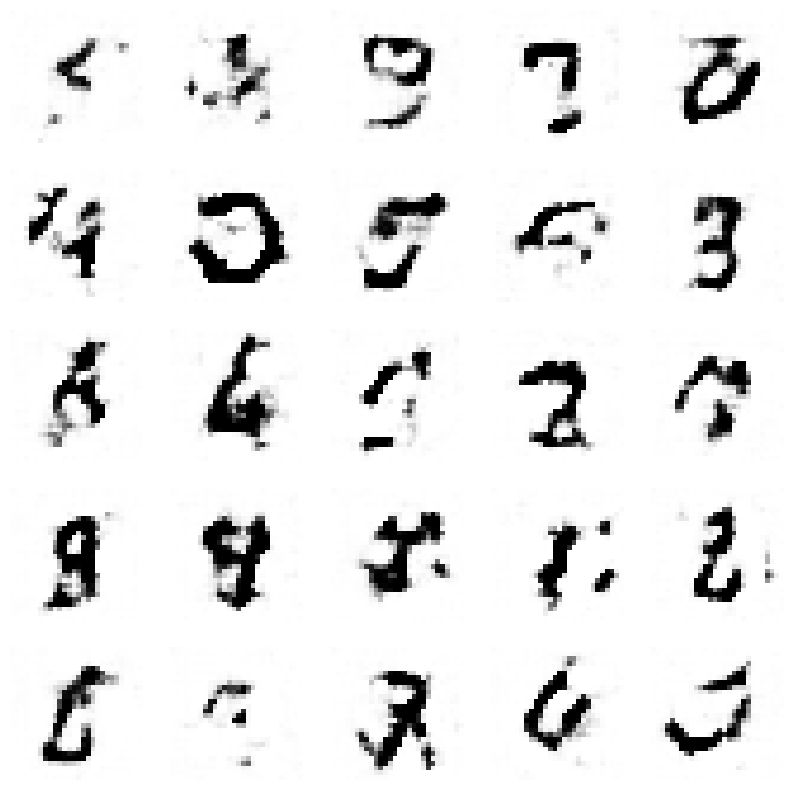

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.24833449644920152, Generator Loss 0.7151543452189519
1/1 [==============================] - 0s 34ms/step


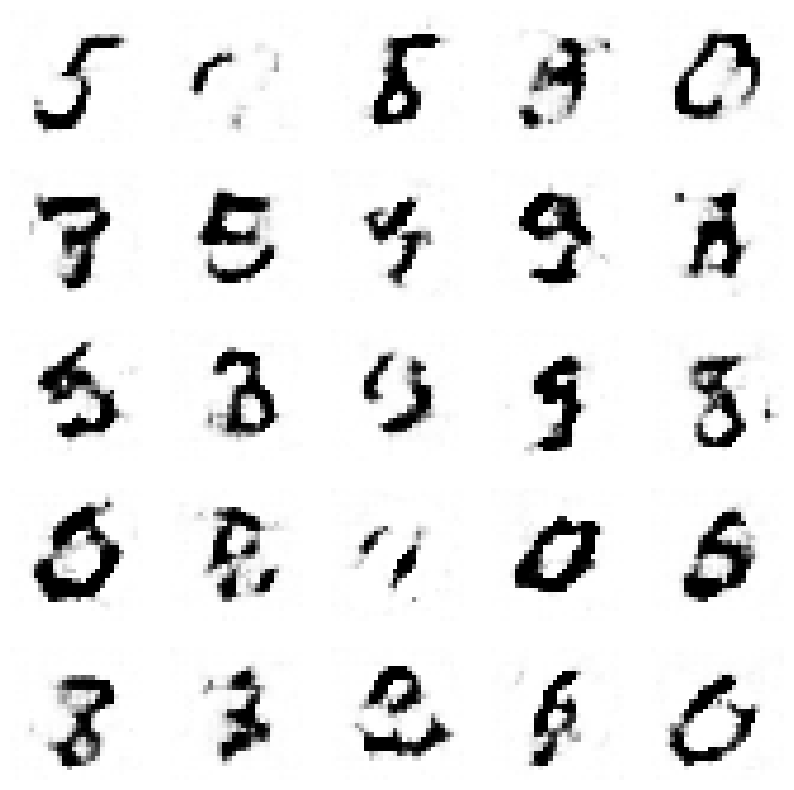

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2509876450157573, Generator Loss 0.7218996485074362
1/1 [==============================] - 0s 29ms/step


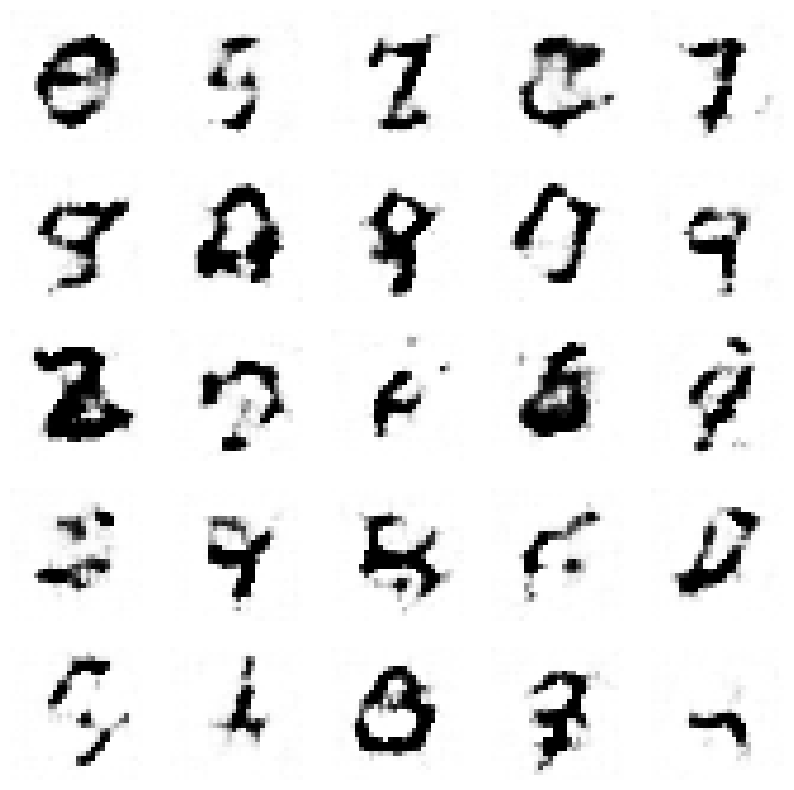

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2535536113457802, Generator Loss 0.7288596793117686
1/1 [==============================] - 0s 18ms/step


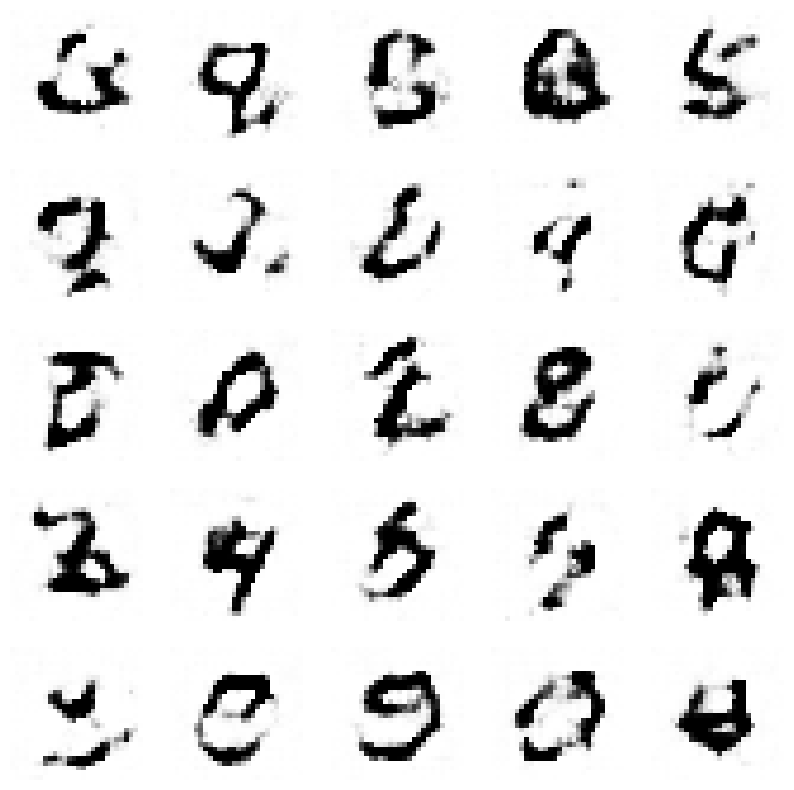

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2561716229105607, Generator Loss 0.7357550563975277
1/1 [==============================] - 0s 18ms/step


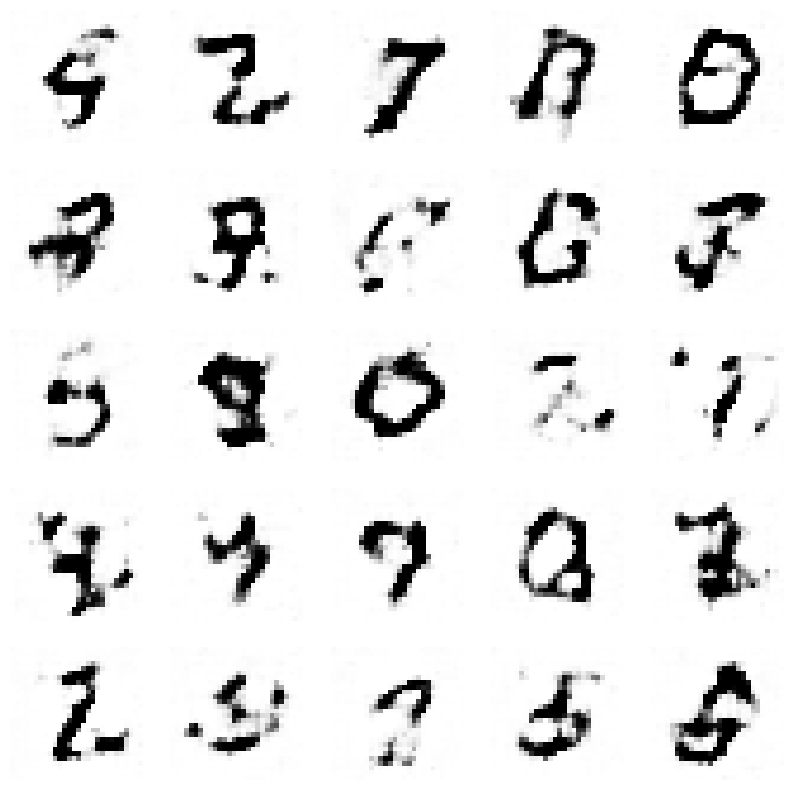

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2587733627257184, Generator Loss 0.7431481623242044
1/1 [==============================] - 0s 30ms/step


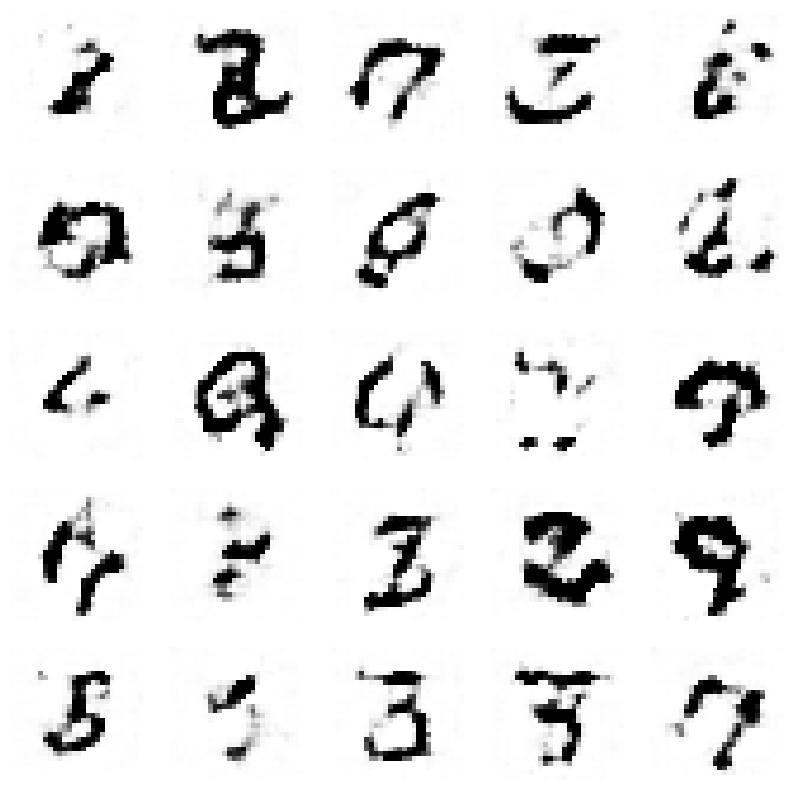

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.26131813692995626, Generator Loss 0.7502342431973188
1/1 [==============================] - 0s 33ms/step


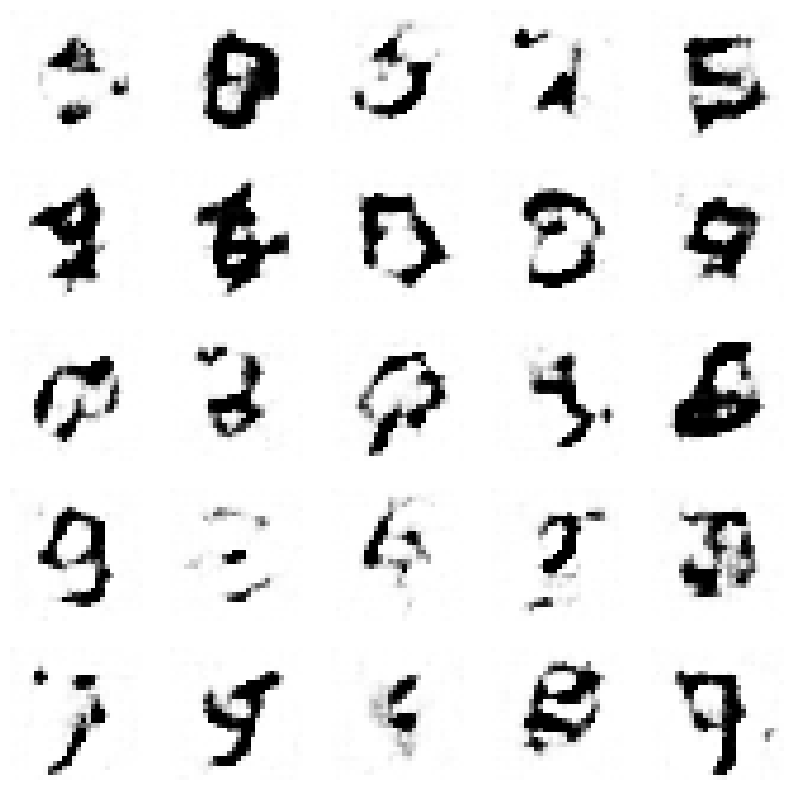

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2639167561617672, Generator Loss 0.7570852229737828
1/1 [==============================] - 0s 18ms/step


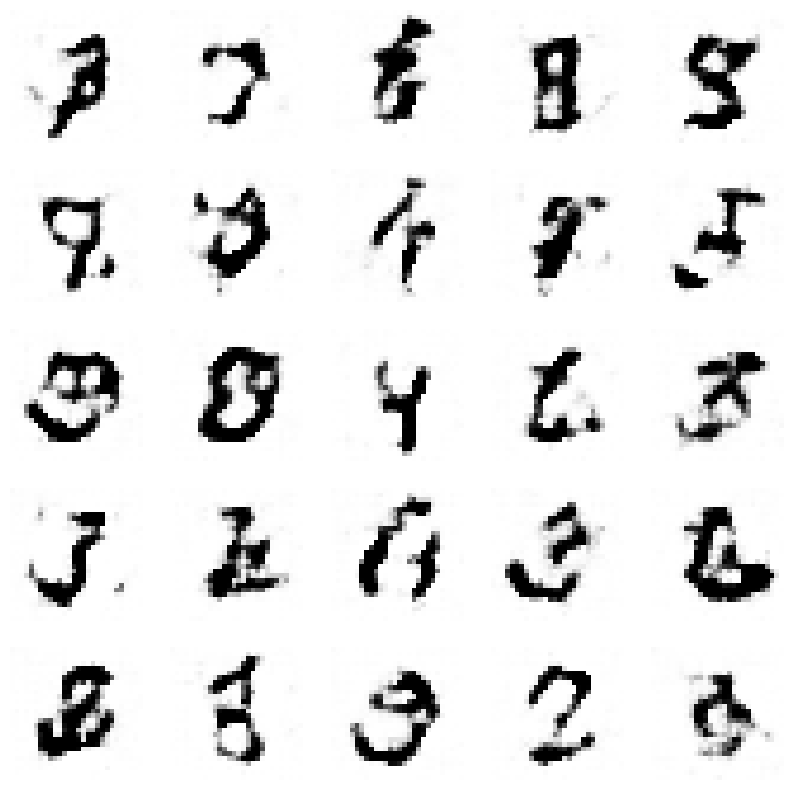

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2665753594448424, Generator Loss 0.7638741645038637
1/1 [==============================] - 0s 22ms/step


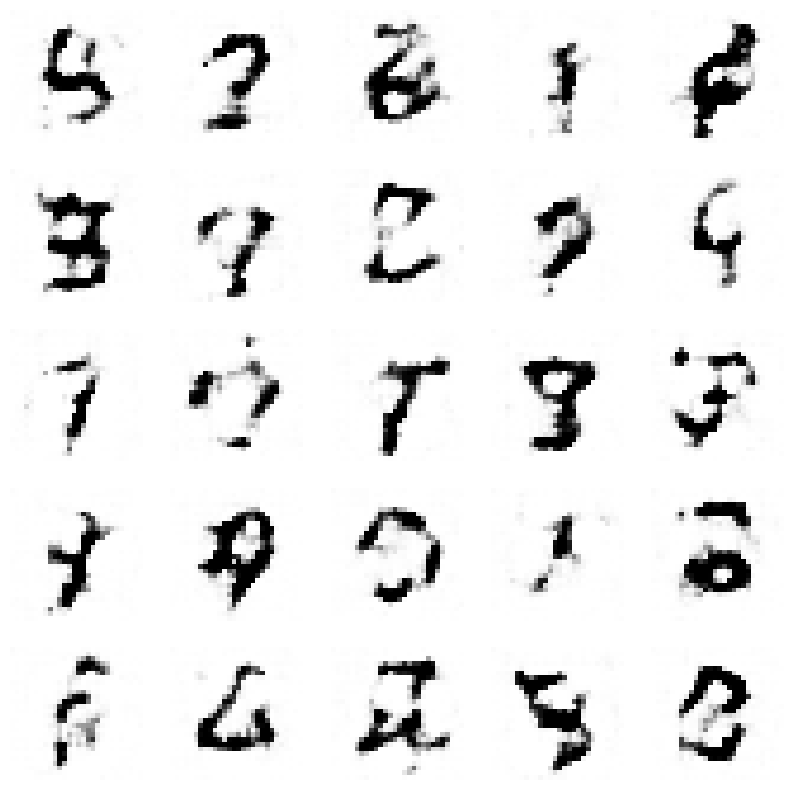

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.26918654672355735, Generator Loss 0.7706771299370334
1/1 [==============================] - 0s 28ms/step


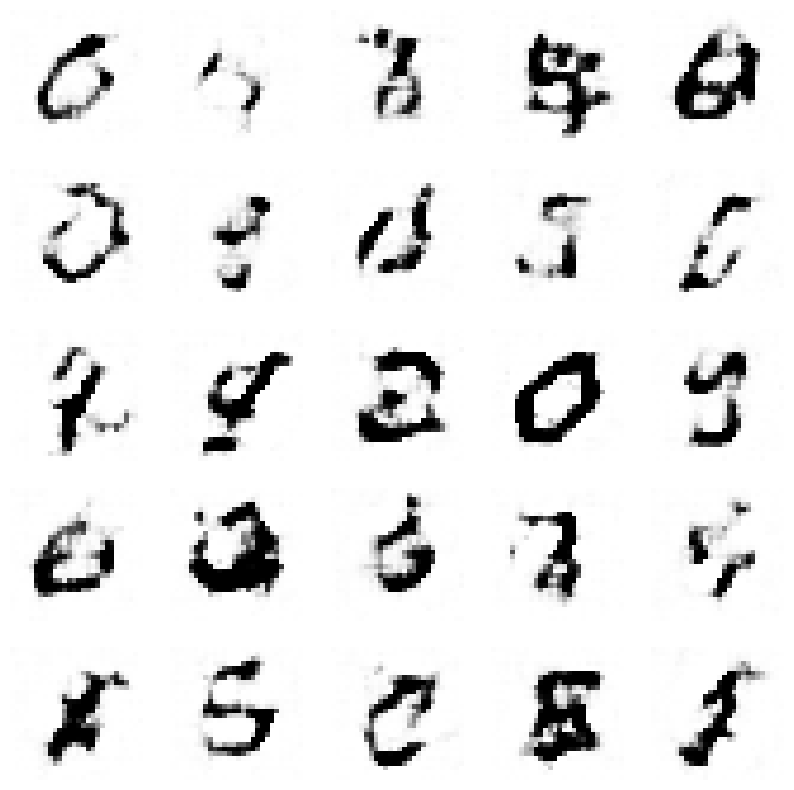

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.27209612886365664, Generator Loss 0.7773067721953759
1/1 [==============================] - 0s 20ms/step


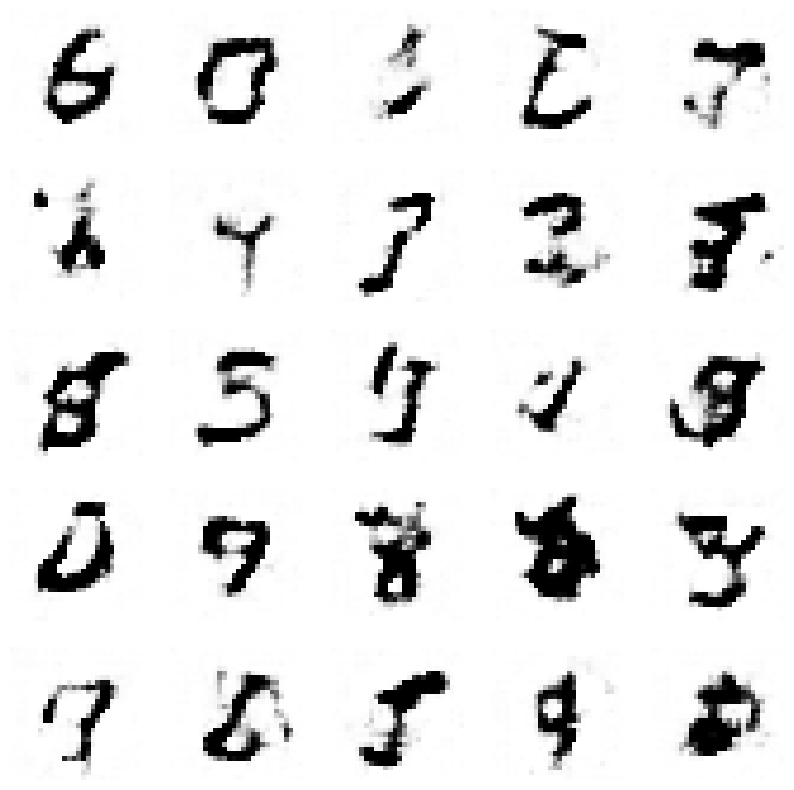

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.2746547573269942, Generator Loss 0.7842965905482953
1/1 [==============================] - 0s 49ms/step


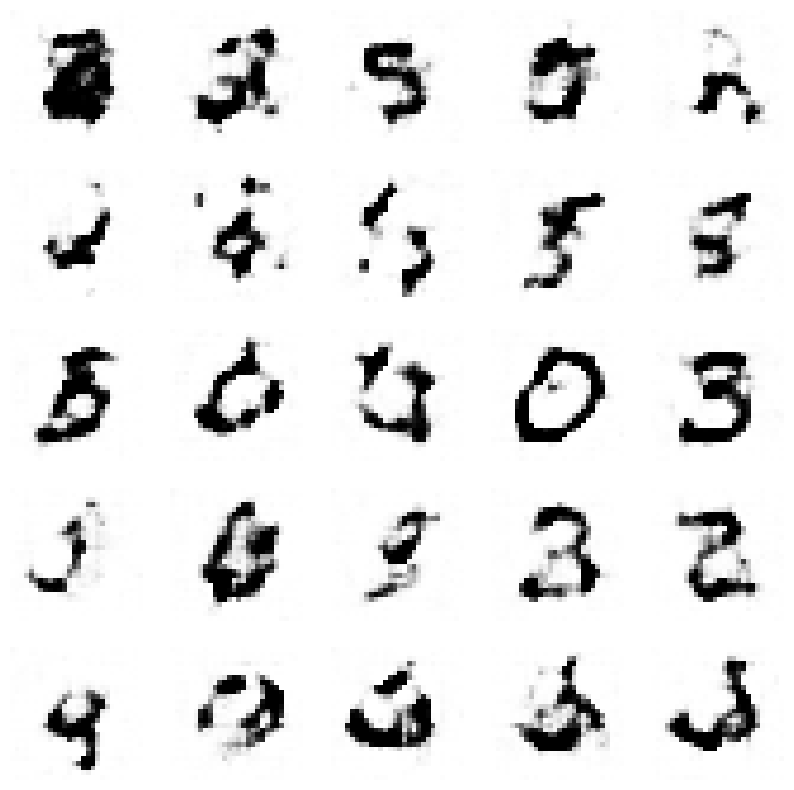

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2773428617252244, Generator Loss 0.7909067950697026
1/1 [==============================] - 0s 45ms/step


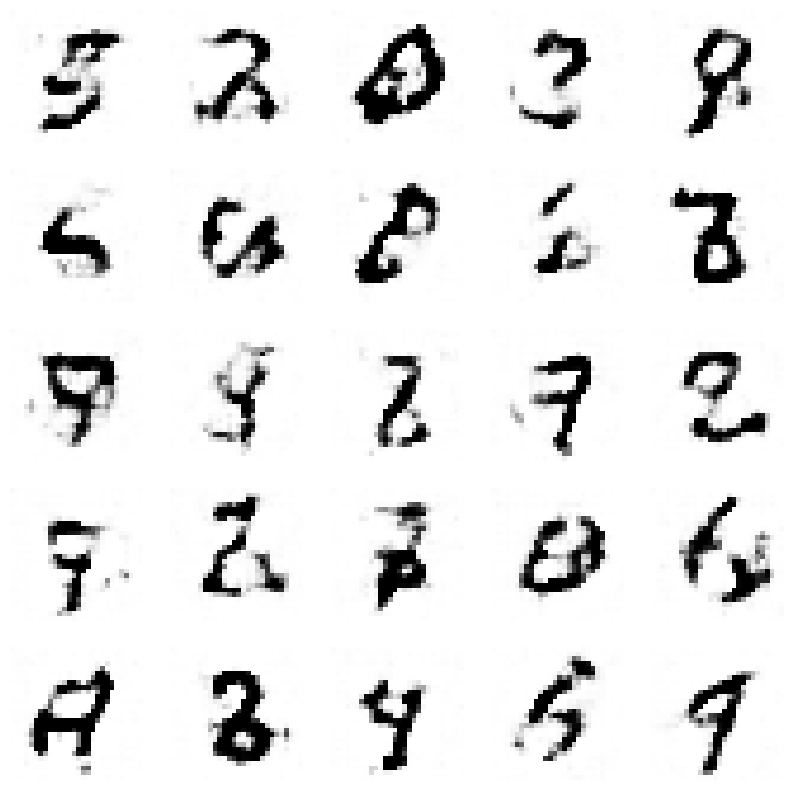

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.27996081260279715, Generator Loss 0.7975995622129521
1/1 [==============================] - 0s 29ms/step


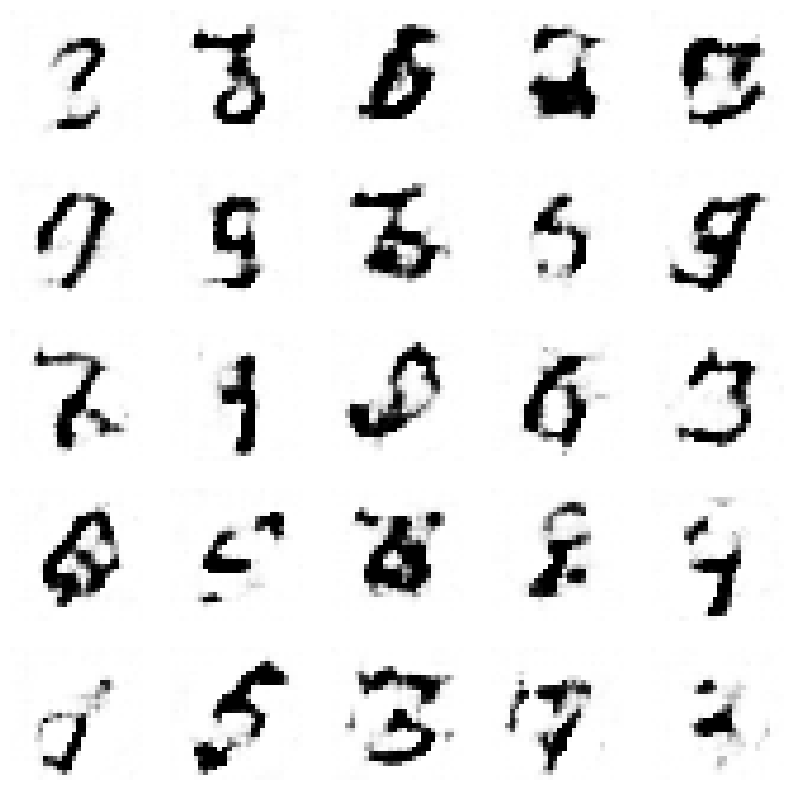

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.2824071883263751, Generator Loss 0.8044127684373122
1/1 [==============================] - 0s 18ms/step


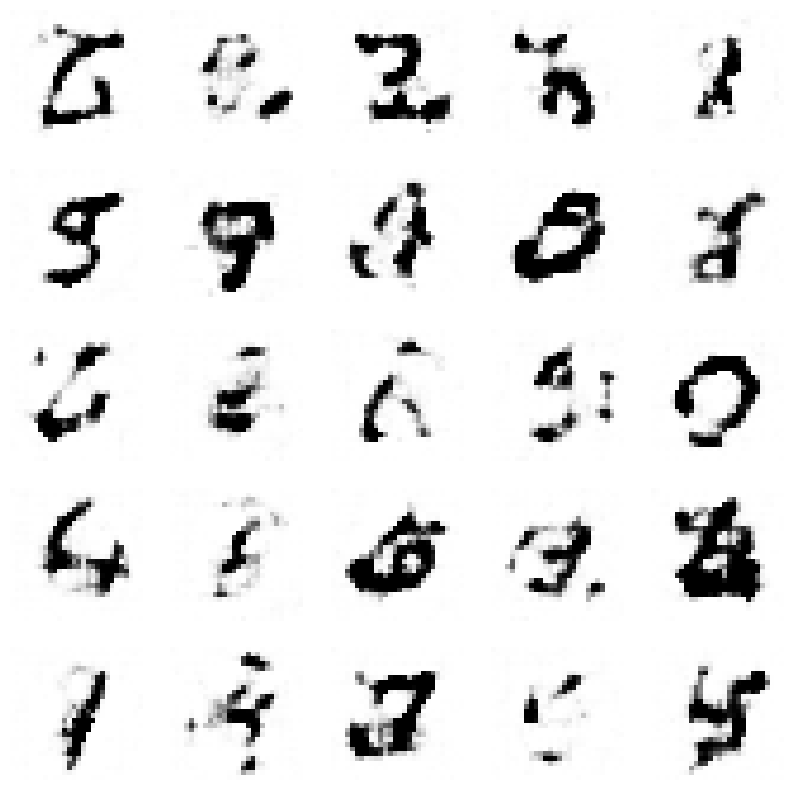

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.2849707425786899, Generator Loss 0.8110163201633681
1/1 [==============================] - 0s 18ms/step


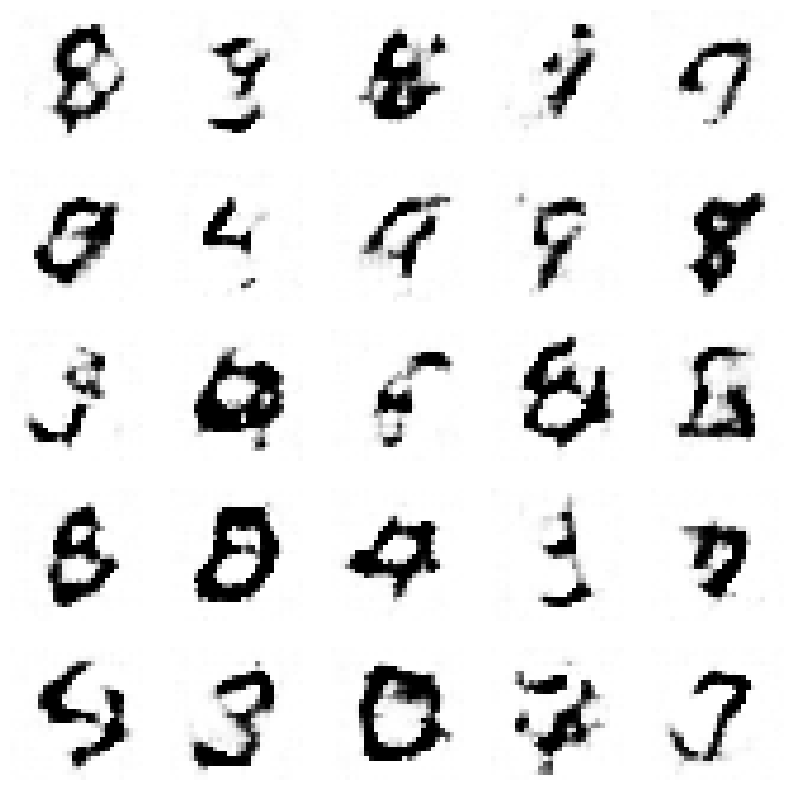

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.28751669448410344, Generator Loss 0.8175227102051433
1/1 [==============================] - 0s 28ms/step


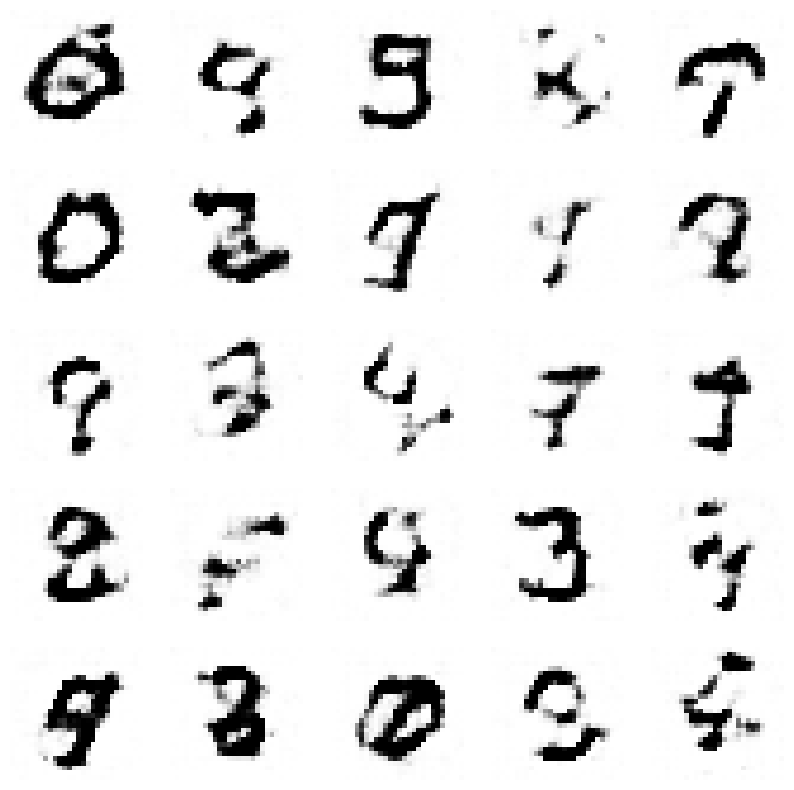

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.28997781458828187, Generator Loss 0.8247672008652972
1/1 [==============================] - 0s 19ms/step


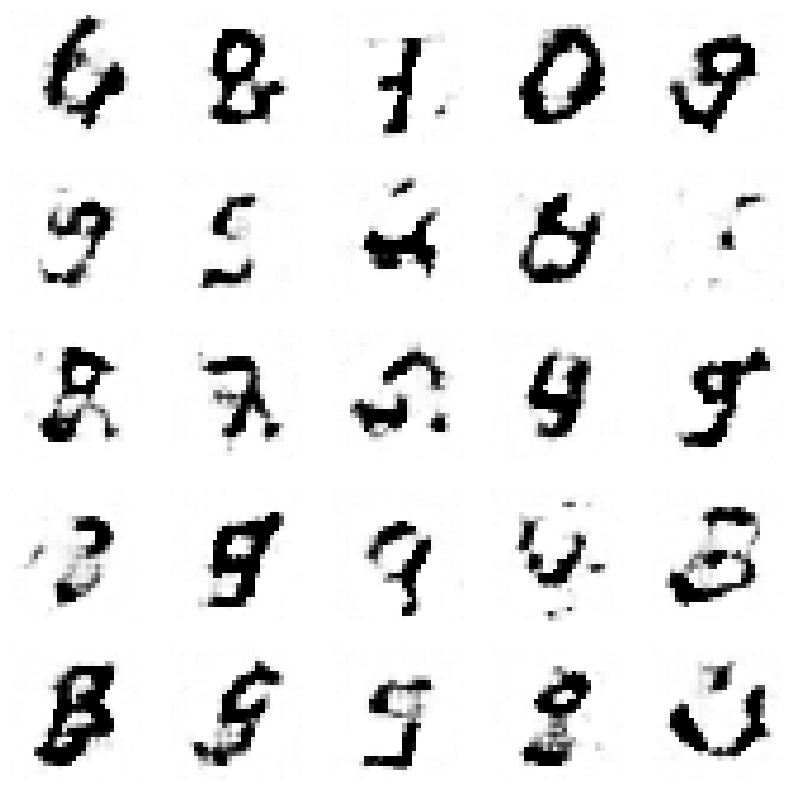

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.29249692243388575, Generator Loss 0.8318504166399312
1/1 [==============================] - 0s 26ms/step


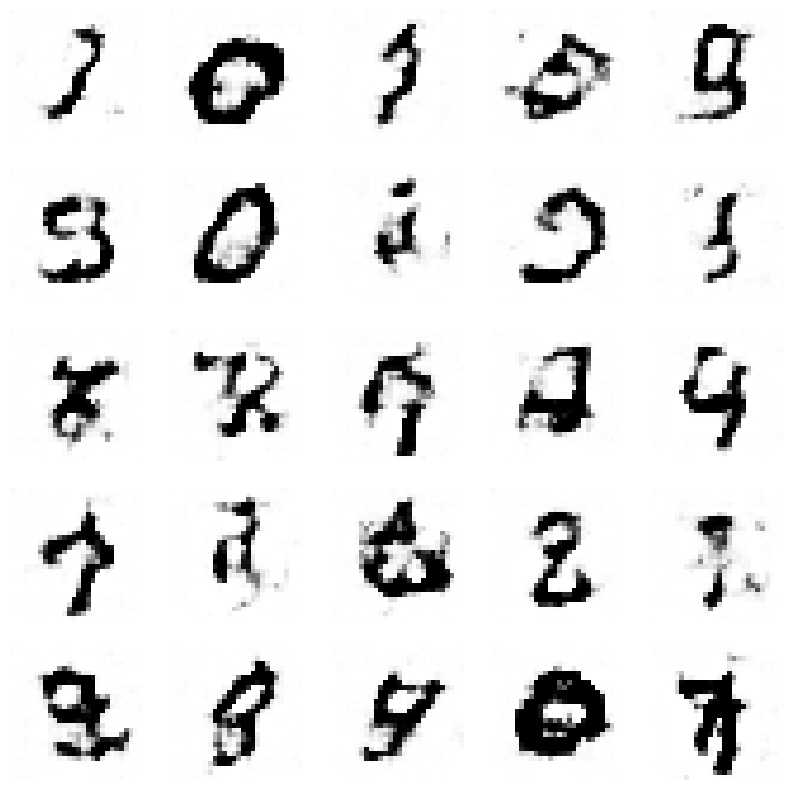

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.2951903265510869, Generator Loss 0.8391228883694379
1/1 [==============================] - 0s 30ms/step


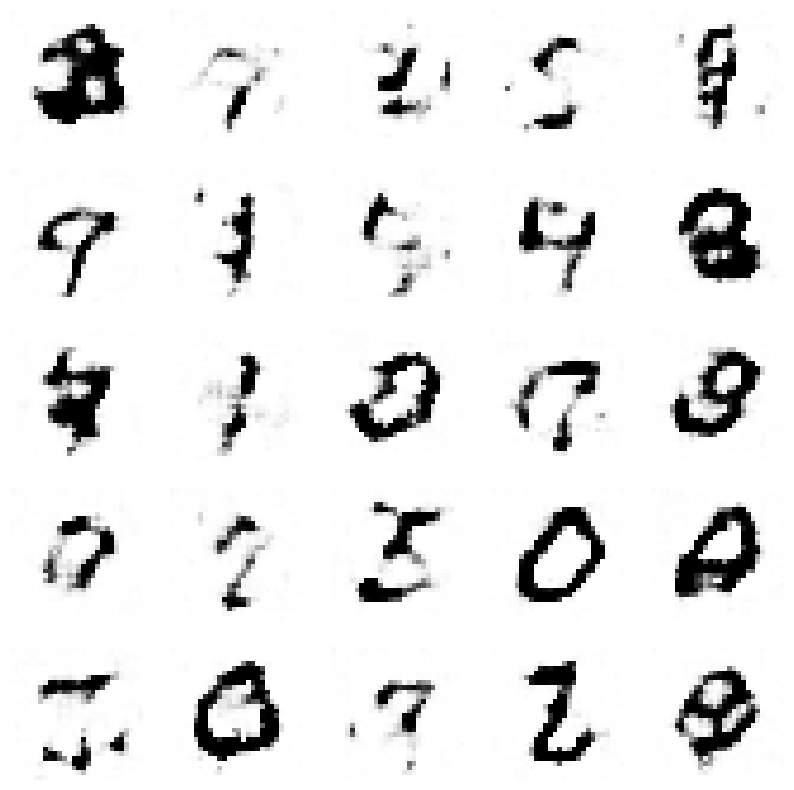

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.2979759785354647, Generator Loss 0.8461130460103353
1/1 [==============================] - 0s 27ms/step


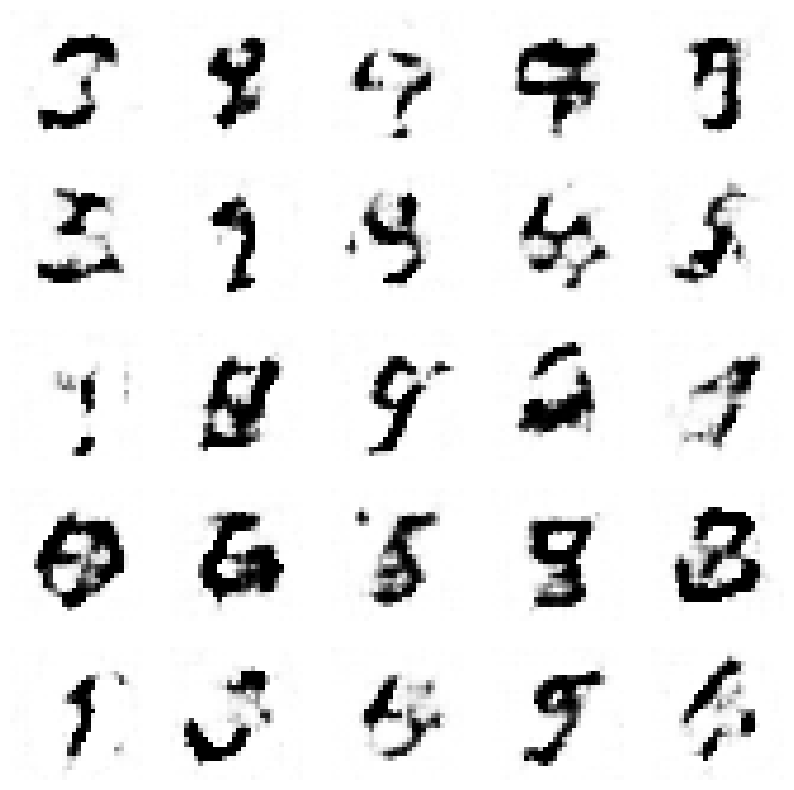

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3004582214813966, Generator Loss 0.8531624715552371
1/1 [==============================] - 0s 26ms/step


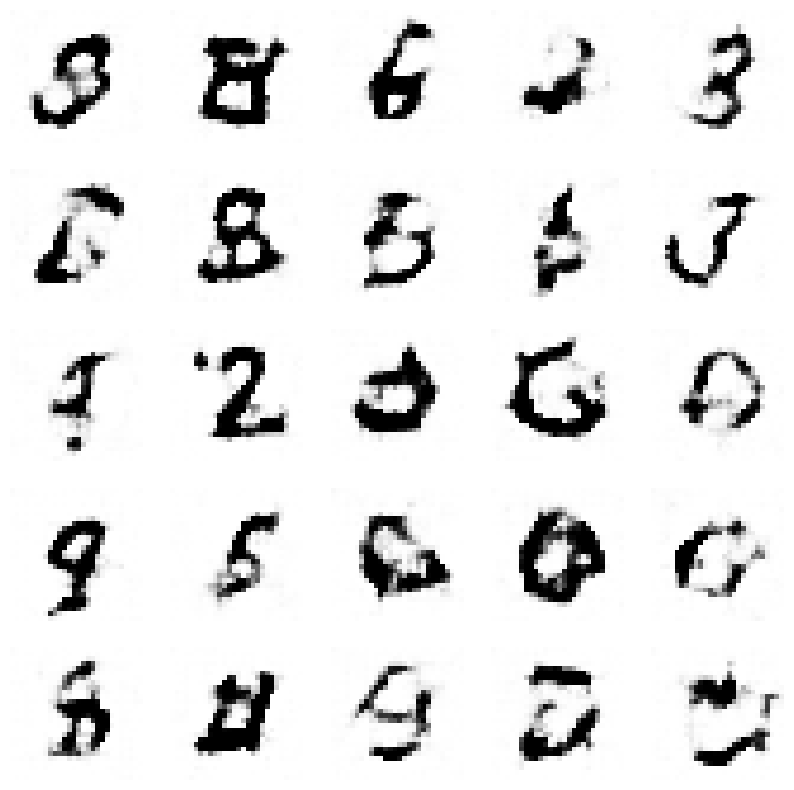

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3030798724319181, Generator Loss 0.859816840571216
1/1 [==============================] - 0s 36ms/step


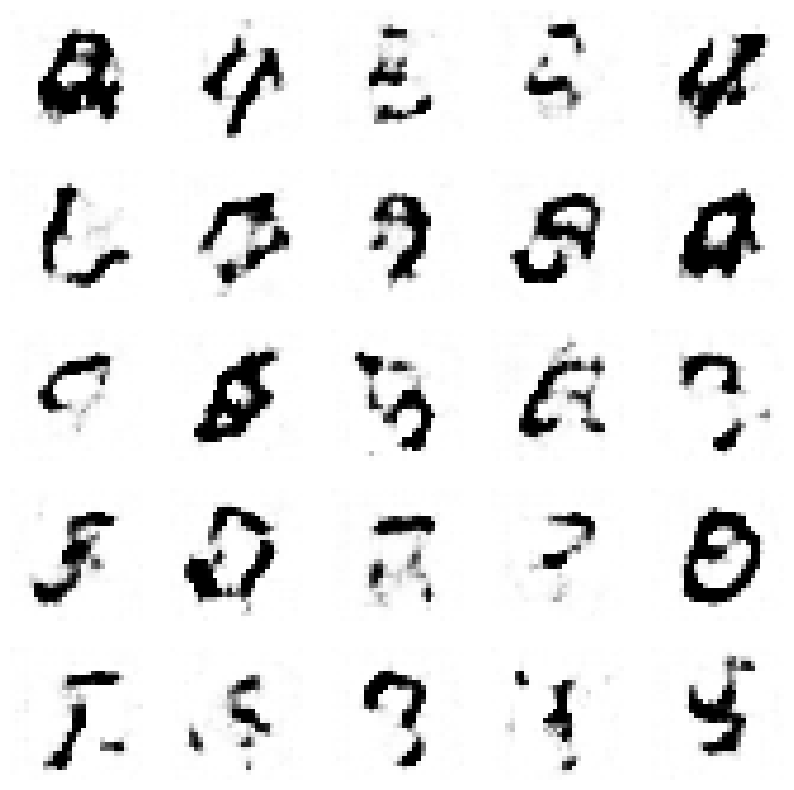

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.30566115664620686, Generator Loss 0.8666662517775837
1/1 [==============================] - 0s 40ms/step


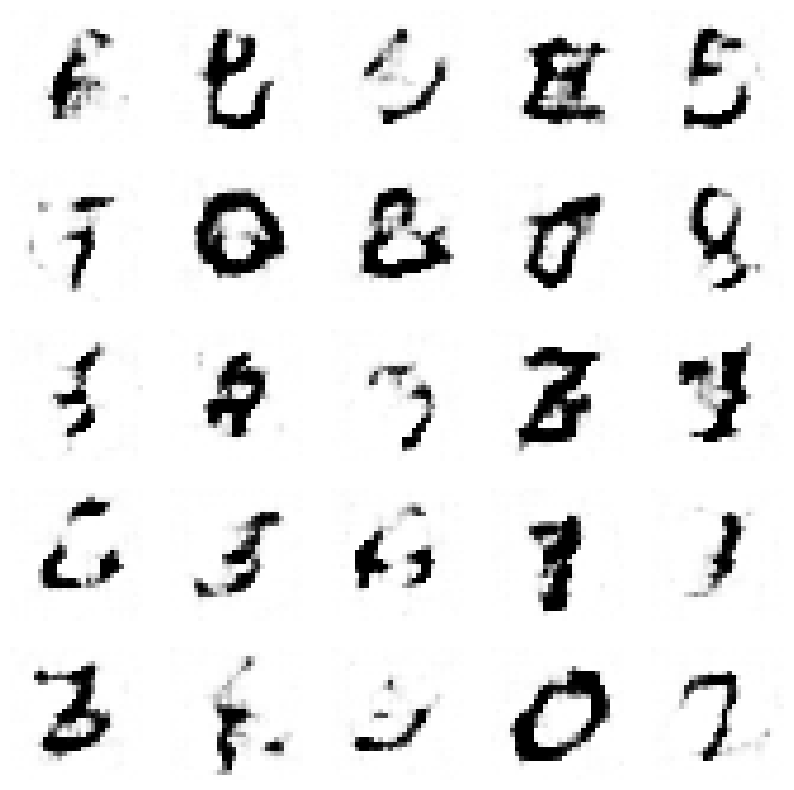

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.30830411065338004, Generator Loss 0.8736393757355518
1/1 [==============================] - 0s 56ms/step


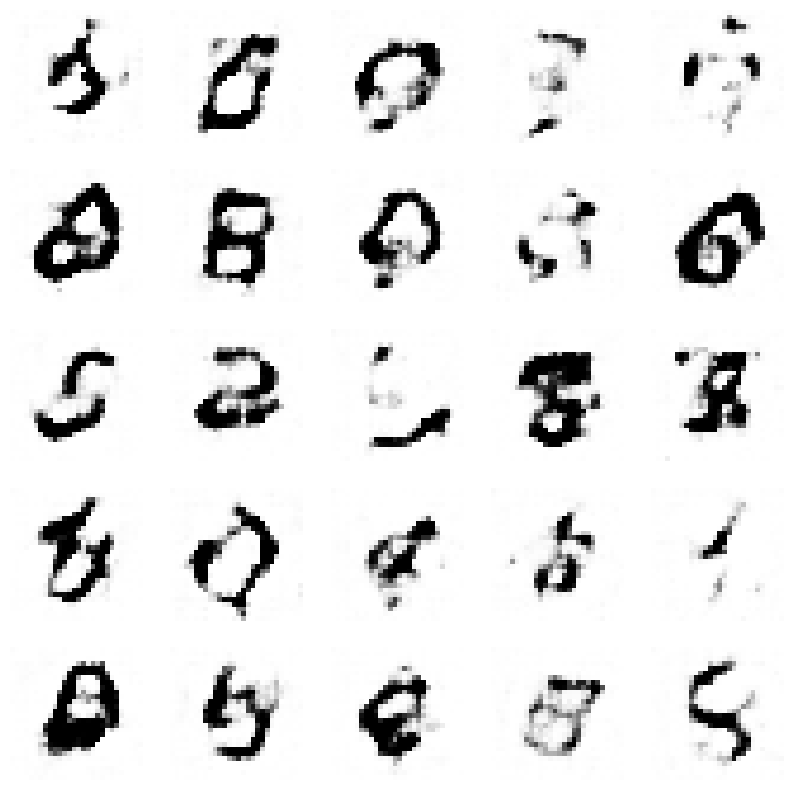

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.31080971244308686, Generator Loss 0.8810510441788242
1/1 [==============================] - 0s 27ms/step


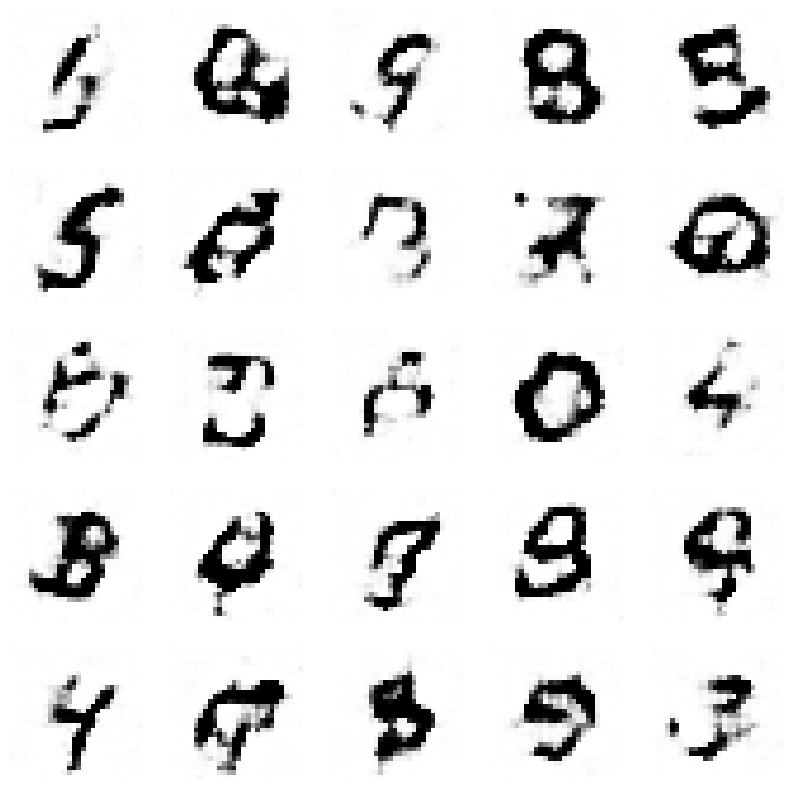

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.31358994155103326, Generator Loss 0.8877245992676824
1/1 [==============================] - 0s 18ms/step


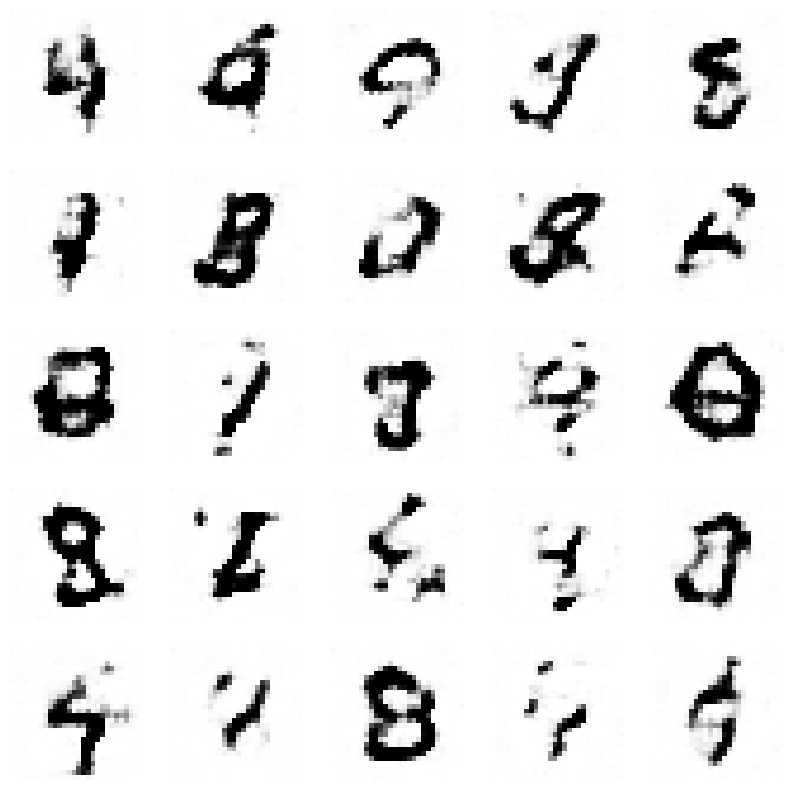

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.31624964752003676, Generator Loss 0.8942520256735321
1/1 [==============================] - 0s 18ms/step


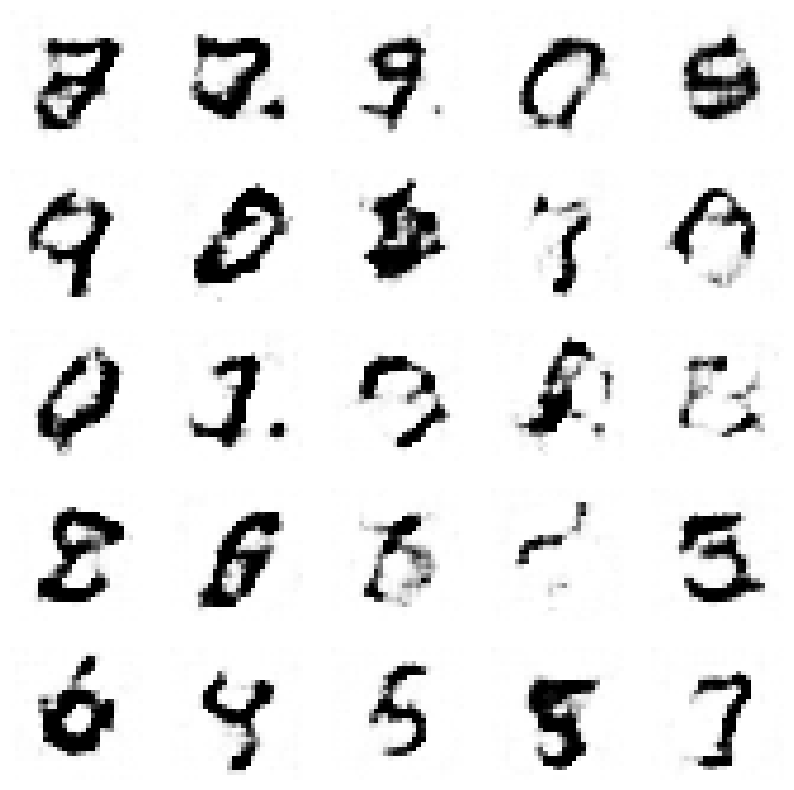

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3187881578874384, Generator Loss 0.9013628648896502
1/1 [==============================] - 0s 32ms/step


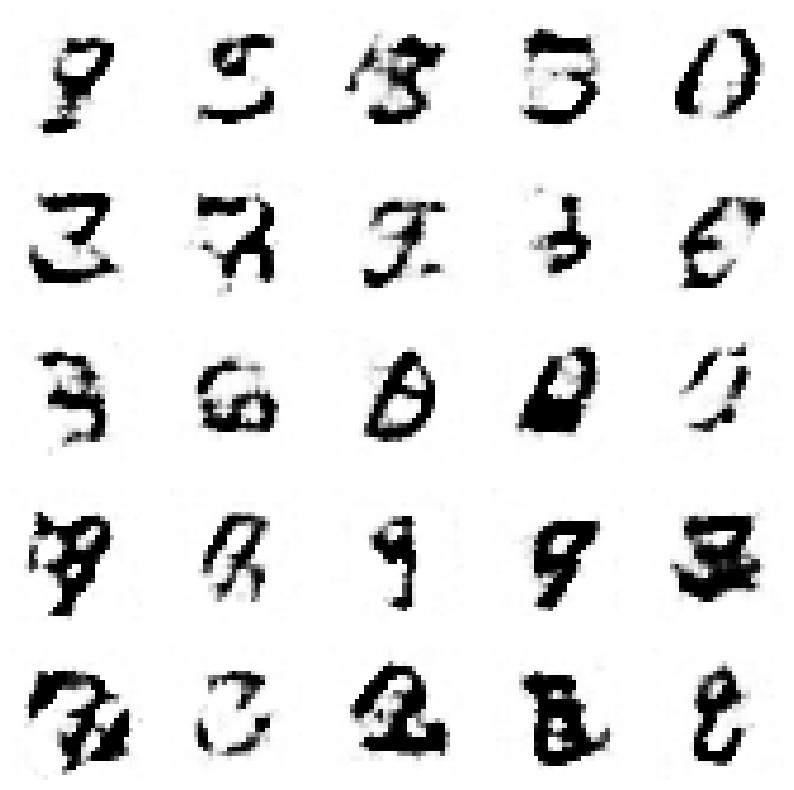

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3214709072286247, Generator Loss 0.908128822970594
1/1 [==============================] - 0s 29ms/step


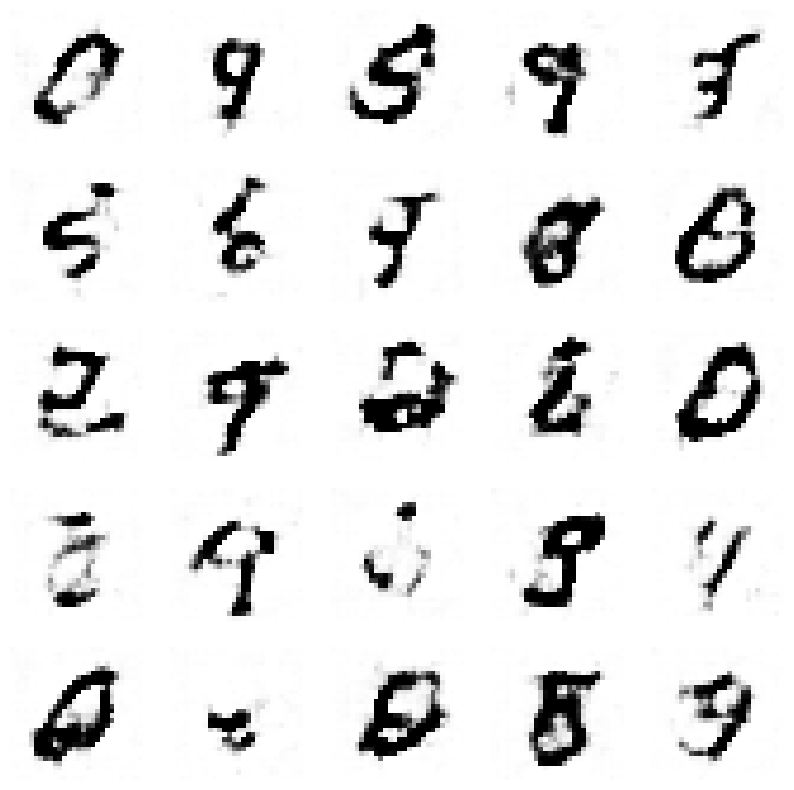

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.32413171944964647, Generator Loss 0.9149242583503071
1/1 [==============================] - 0s 29ms/step


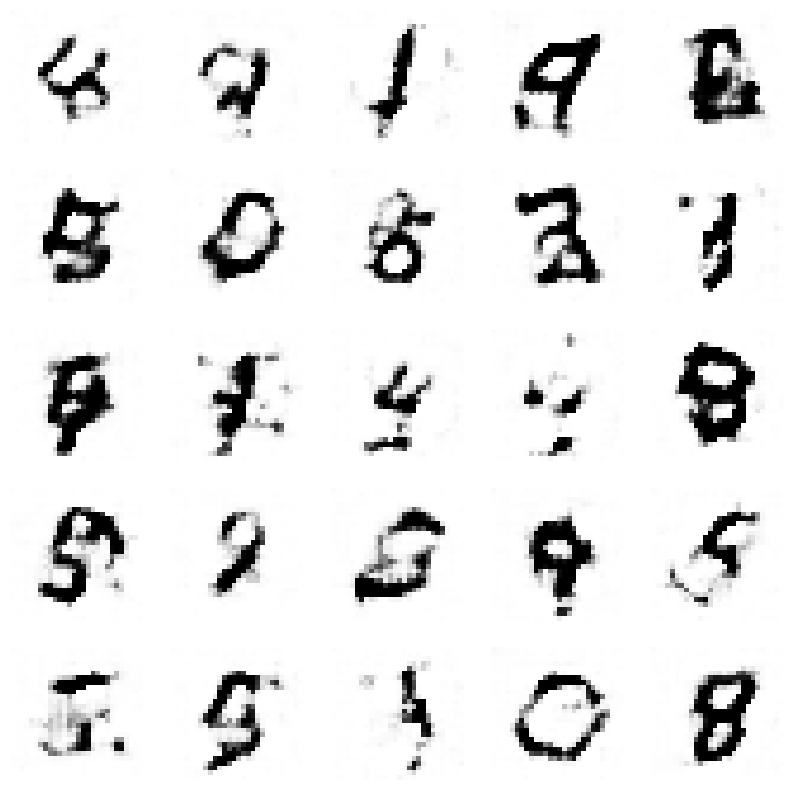

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.32658415357781273, Generator Loss 0.9220532887002342
1/1 [==============================] - 0s 36ms/step


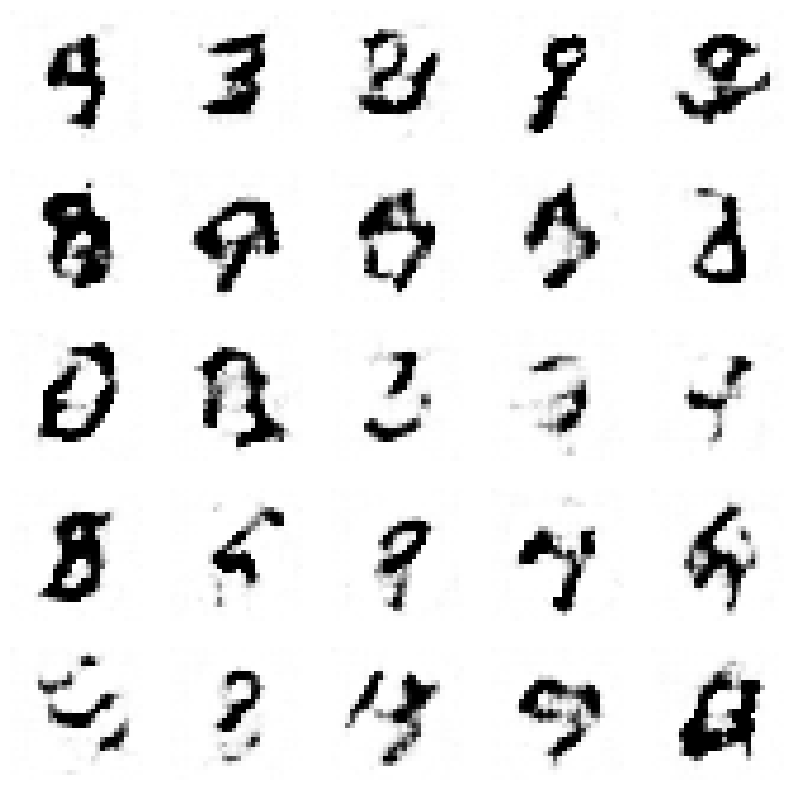

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3292910726661356, Generator Loss 0.9290324887658796
1/1 [==============================] - 0s 26ms/step


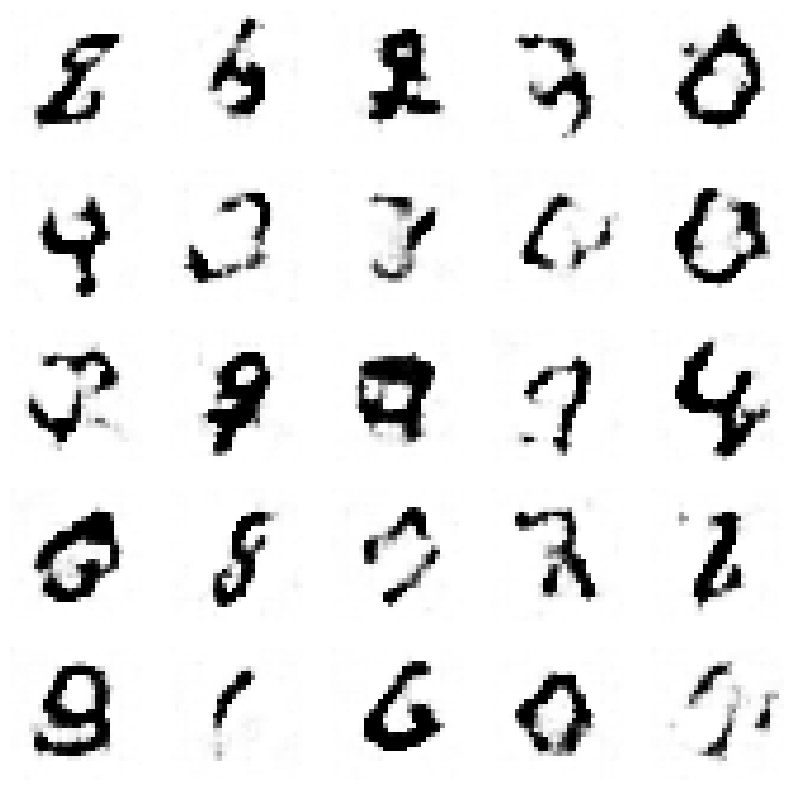

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.33176583701219314, Generator Loss 0.9360900944114751
1/1 [==============================] - 0s 49ms/step


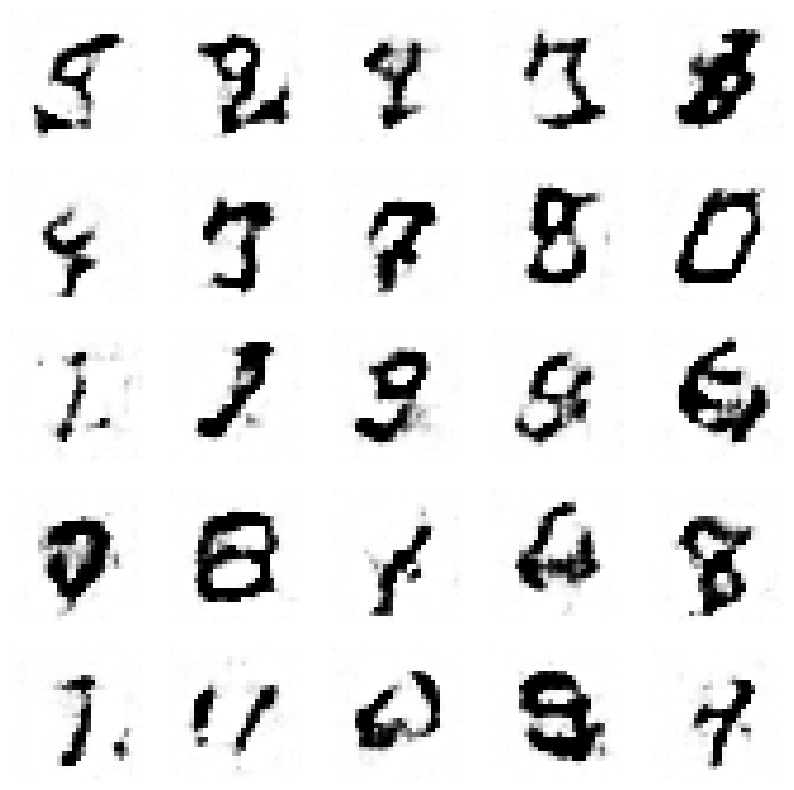

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.33450746803711623, Generator Loss 0.9425116522699339
1/1 [==============================] - 0s 27ms/step


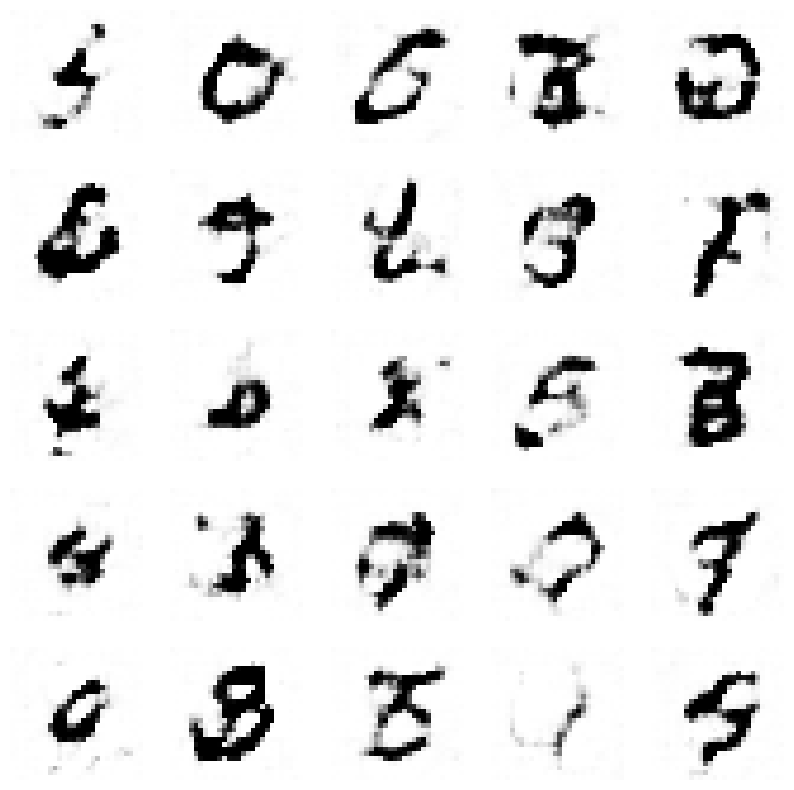

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.3371222573213088, Generator Loss 0.9492193857828776
1/1 [==============================] - 0s 33ms/step


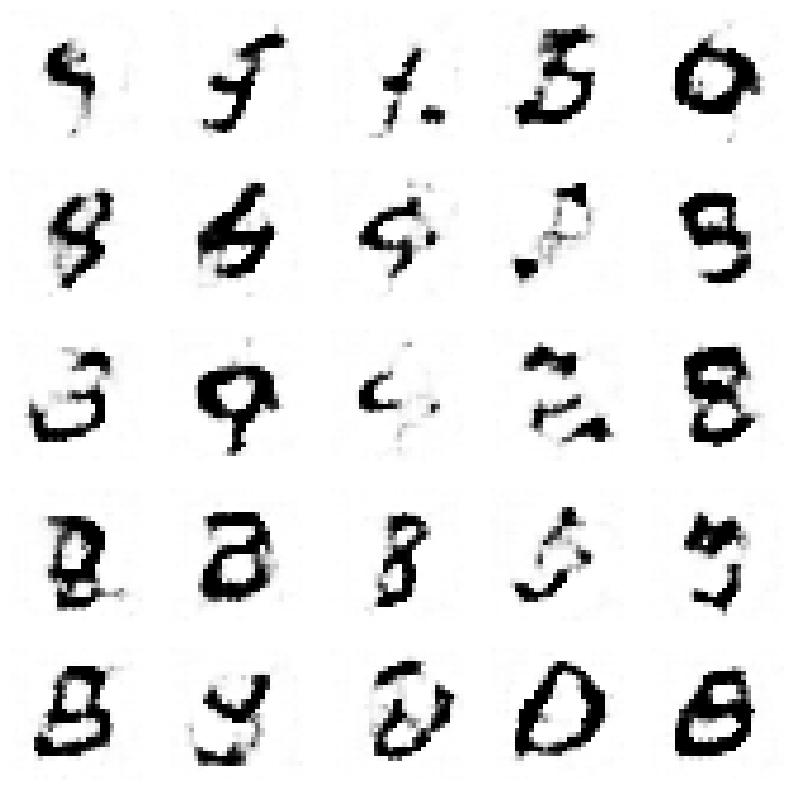

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.33960869449835557, Generator Loss 0.9563834050781707
1/1 [==============================] - 0s 26ms/step


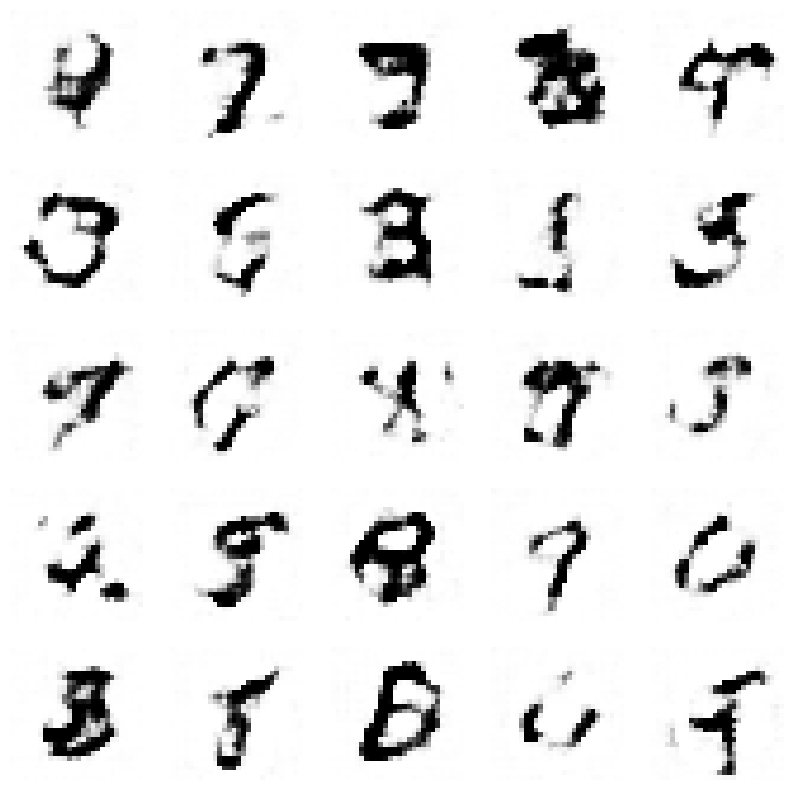

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.3422785728660404, Generator Loss 0.9635695020357767
1/1 [==============================] - 0s 29ms/step


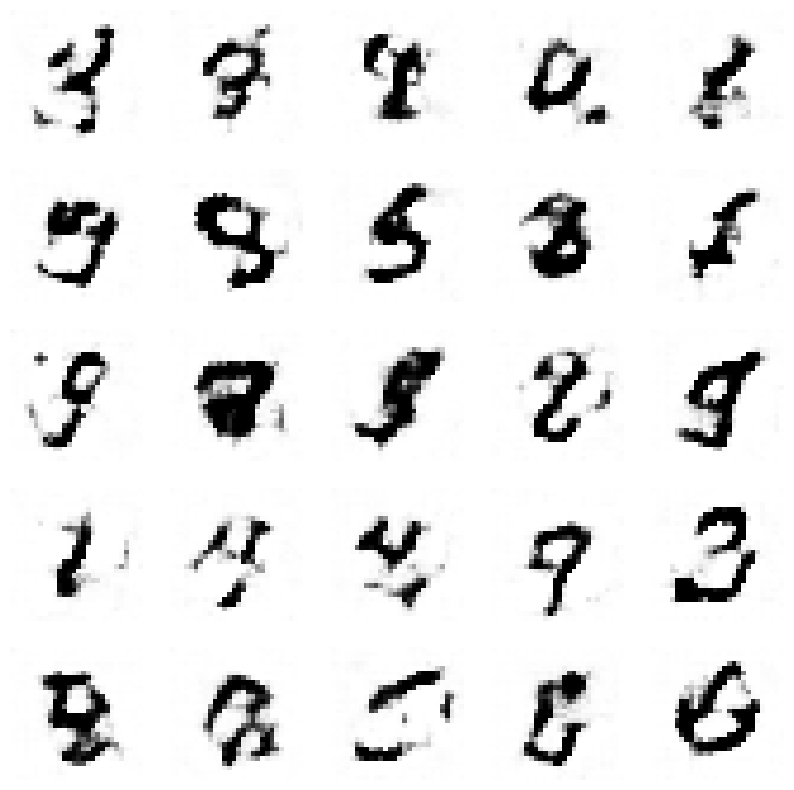

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.34496929375534385, Generator Loss 0.9705669187073015
1/1 [==============================] - 0s 28ms/step


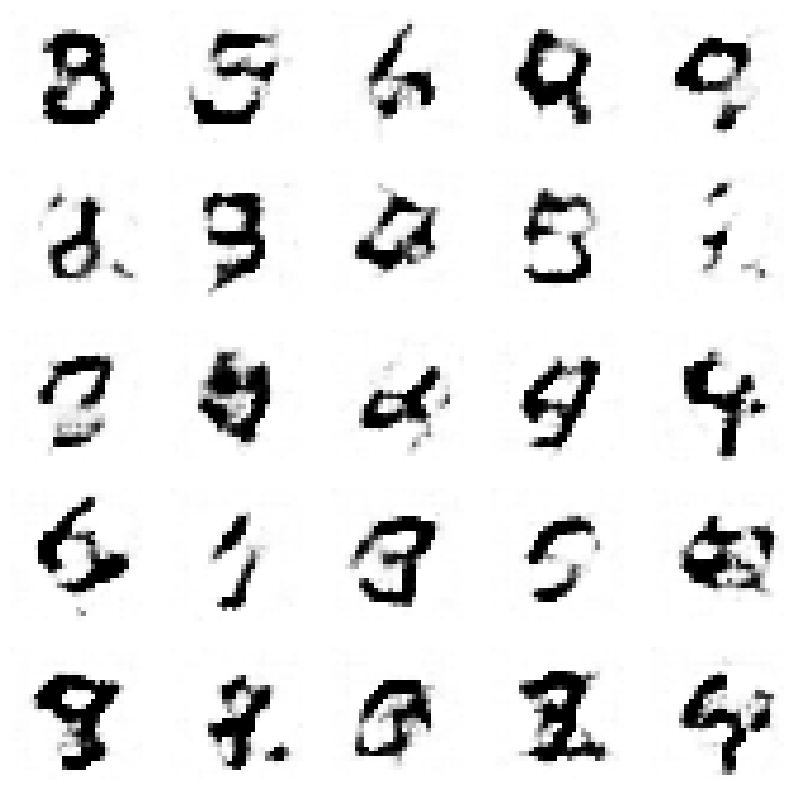

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.34766741377166194, Generator Loss 0.9775475426616832
1/1 [==============================] - 0s 26ms/step


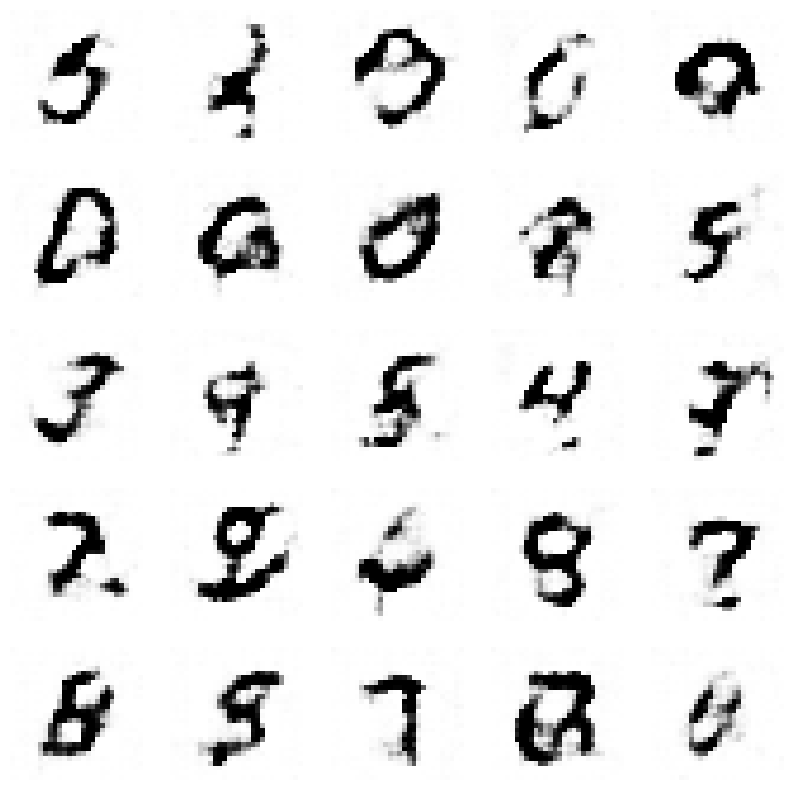

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.35015030230721855, Generator Loss 0.9844557108023227
1/1 [==============================] - 0s 26ms/step


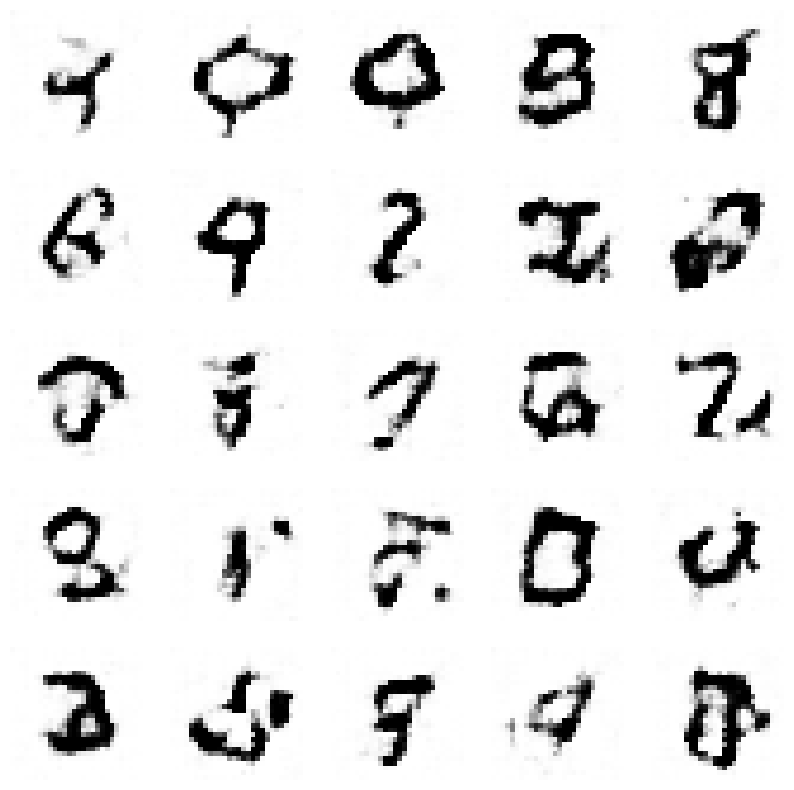

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3527941827335928, Generator Loss 0.9913028641643687
1/1 [==============================] - 0s 26ms/step


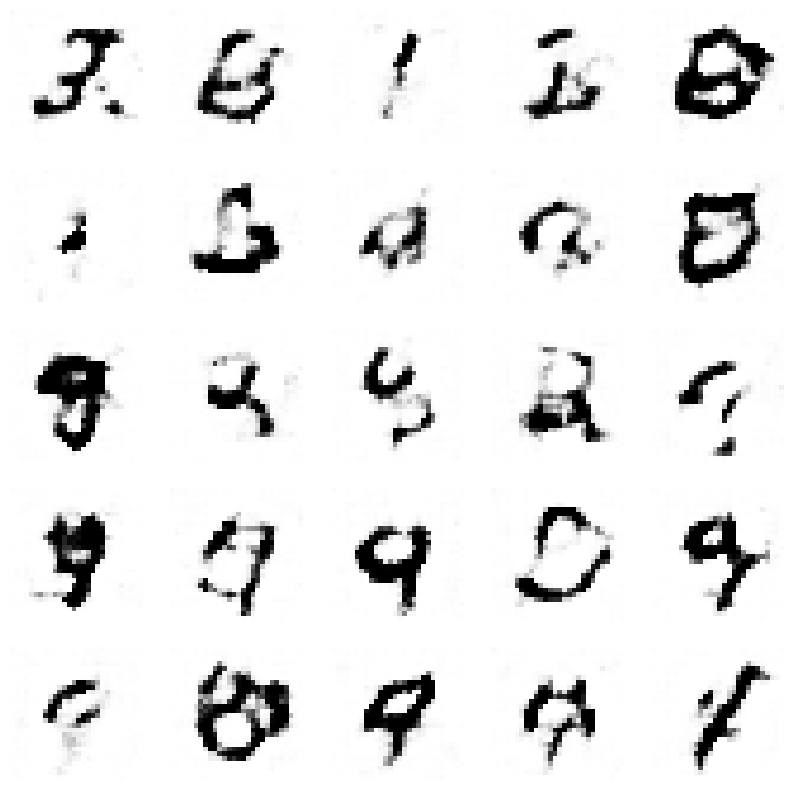

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.35552118158238566, Generator Loss 0.9979977949052794
1/1 [==============================] - 0s 25ms/step


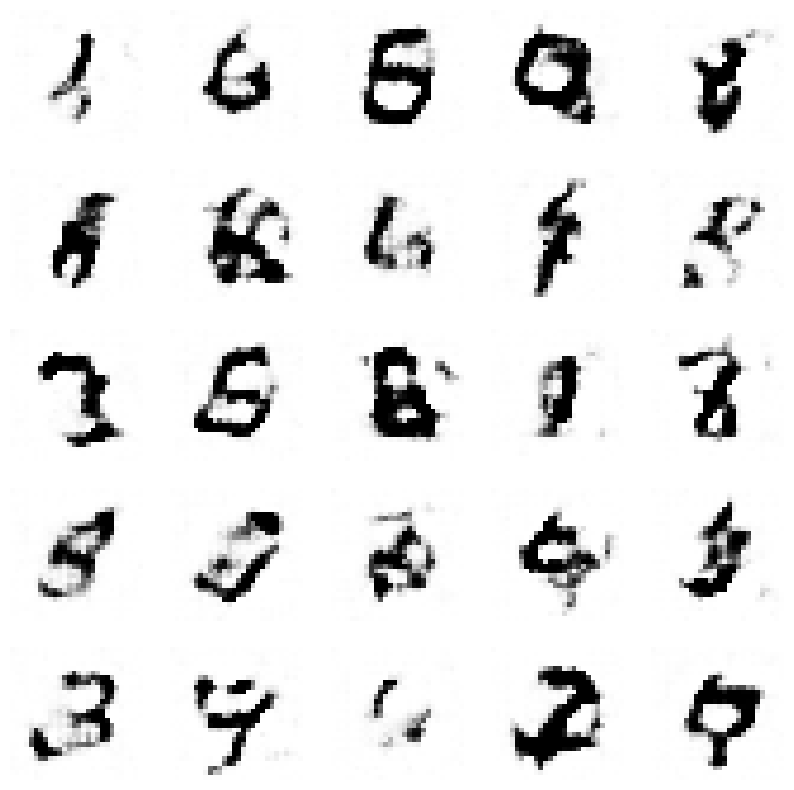

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3580168137310917, Generator Loss 1.0051562582325733
1/1 [==============================] - 0s 30ms/step


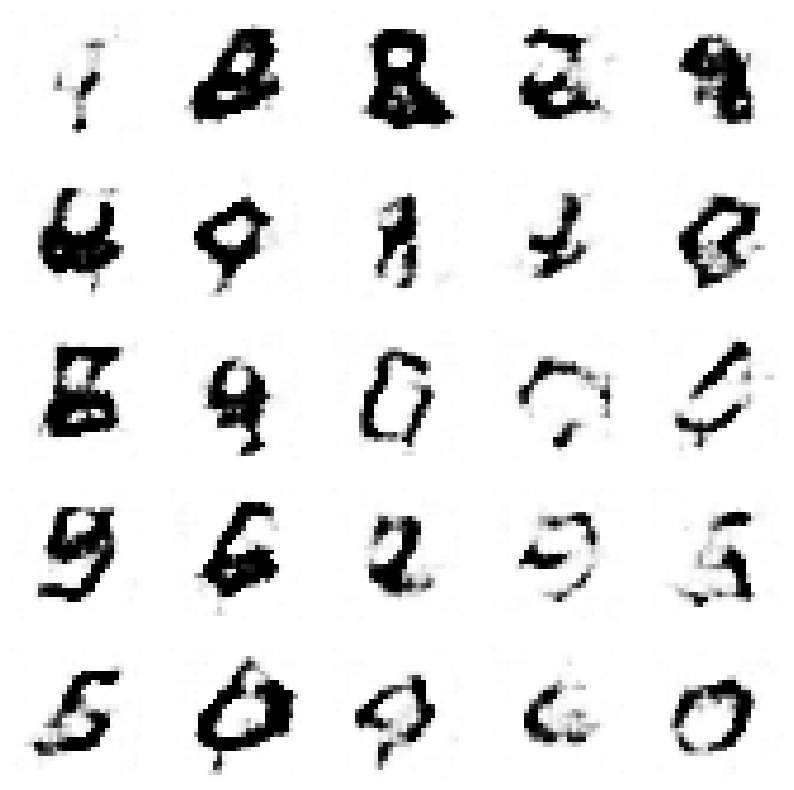

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3605213182476851, Generator Loss 1.0122327412295544
1/1 [==============================] - 0s 30ms/step


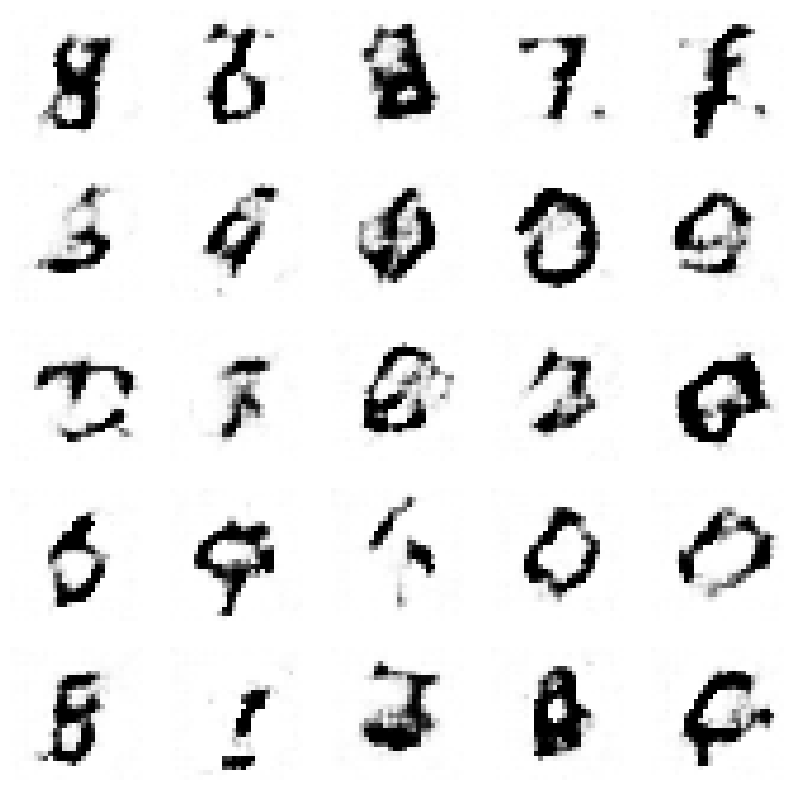

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.3630808960550871, Generator Loss 1.0188712584666717
1/1 [==============================] - 0s 29ms/step


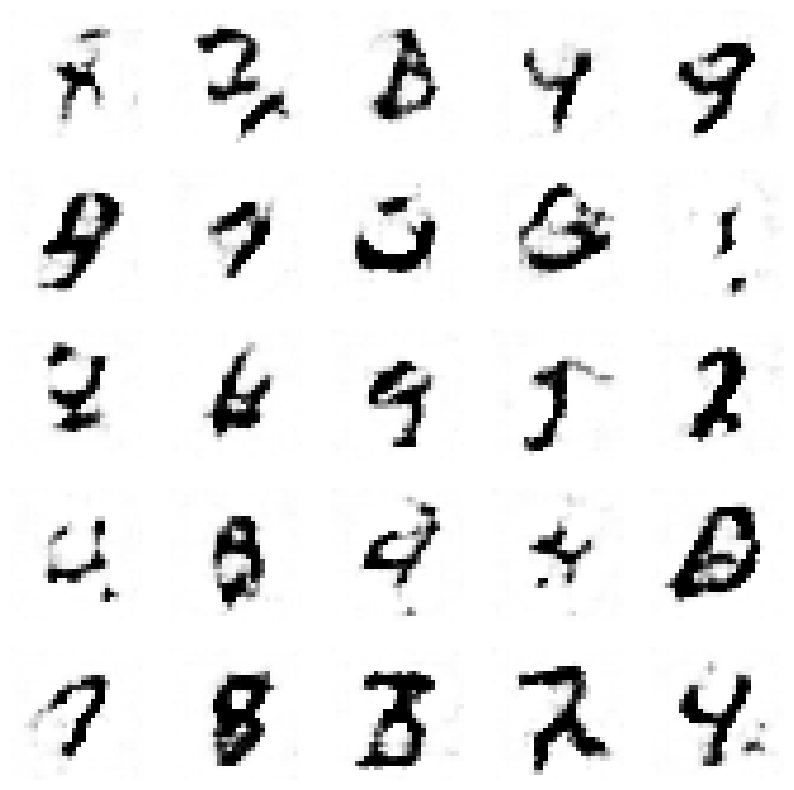

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.36572917219665313, Generator Loss 1.0256672195899181
1/1 [==============================] - 0s 37ms/step


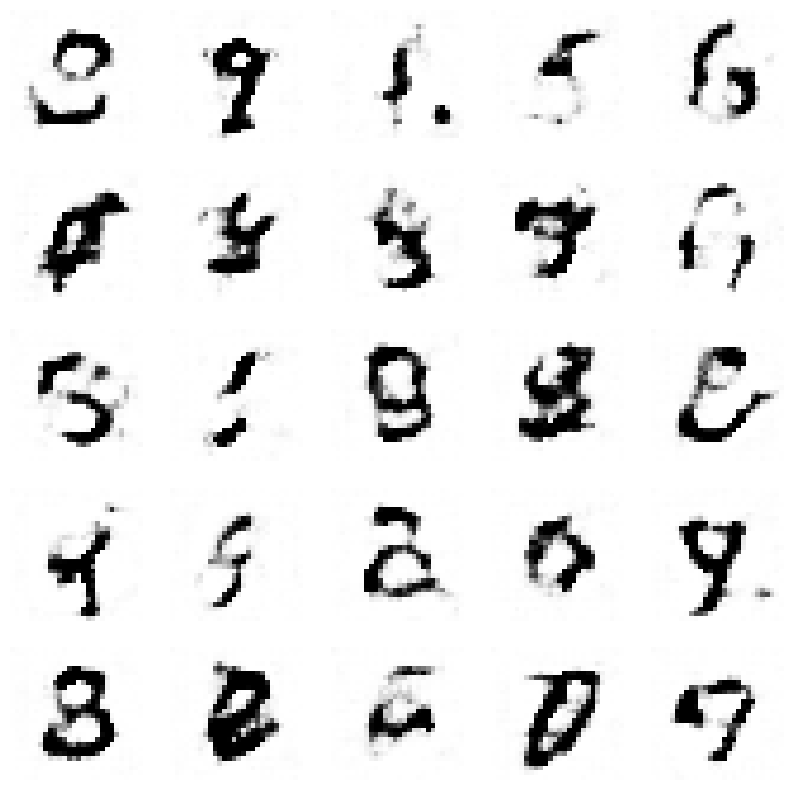

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.36830614768287057, Generator Loss 1.0325235072364154
1/1 [==============================] - 0s 26ms/step


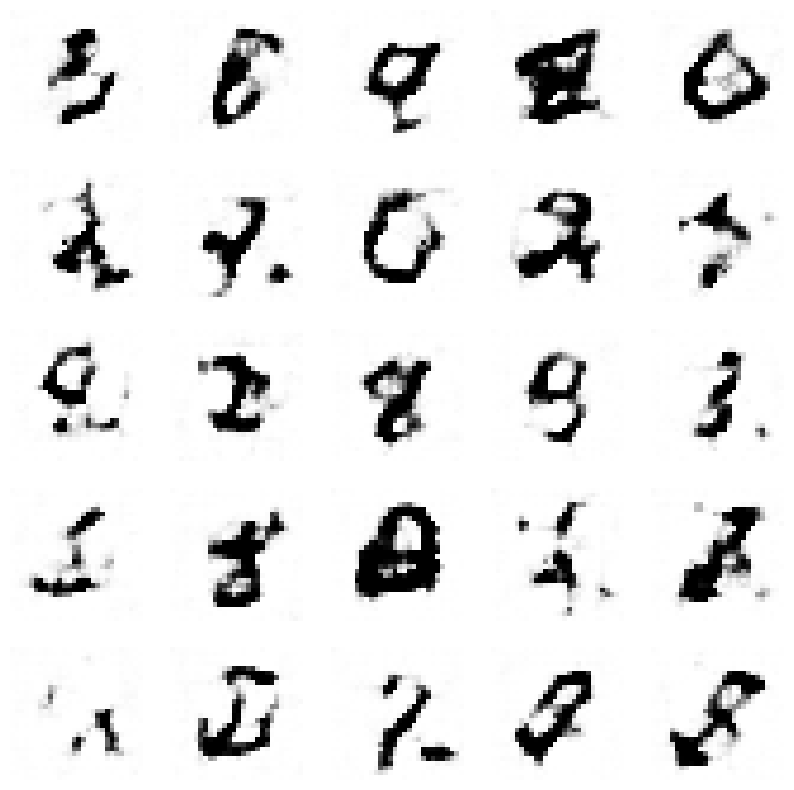

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3707566635094137, Generator Loss 1.0394369491145141
1/1 [==============================] - 0s 26ms/step


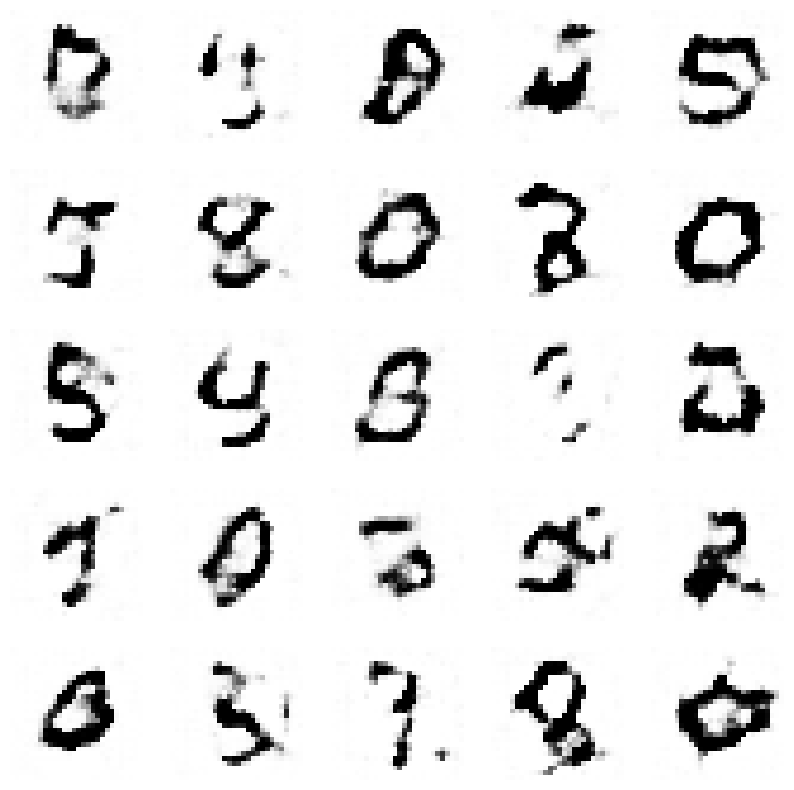

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.37348956258123756, Generator Loss 1.0458656768513541
1/1 [==============================] - 0s 29ms/step


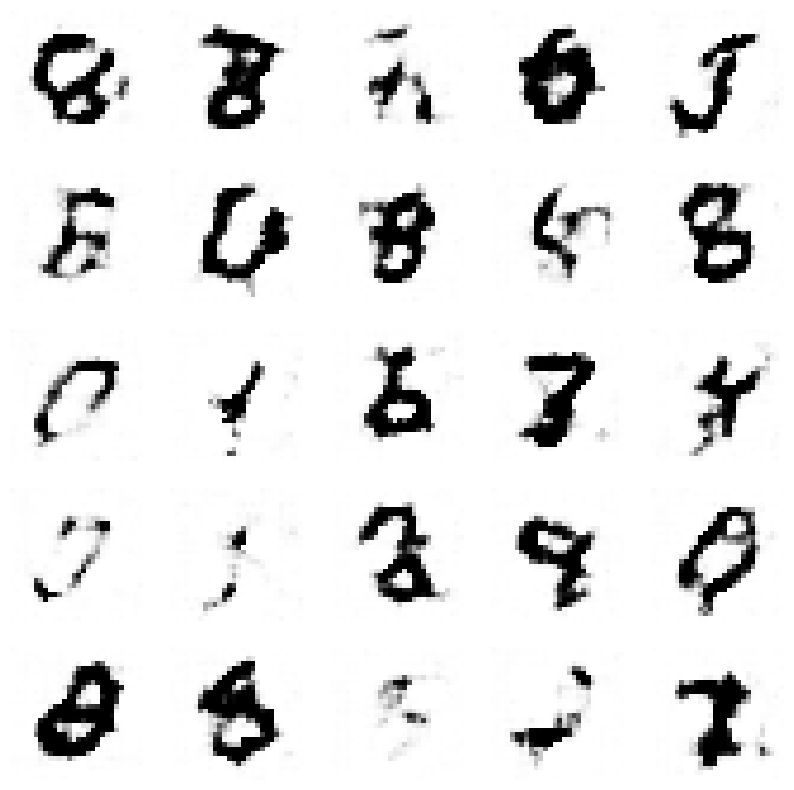

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.37614136431207007, Generator Loss 1.0526307958822985
1/1 [==============================] - 0s 28ms/step


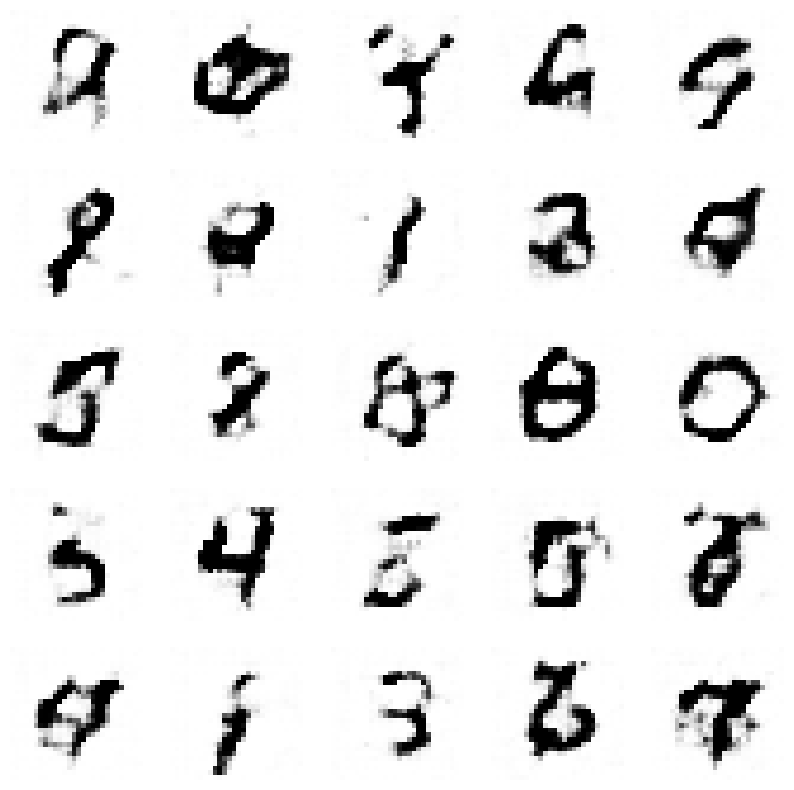

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.3785513373903739, Generator Loss 1.0597448924667814
1/1 [==============================] - 0s 33ms/step


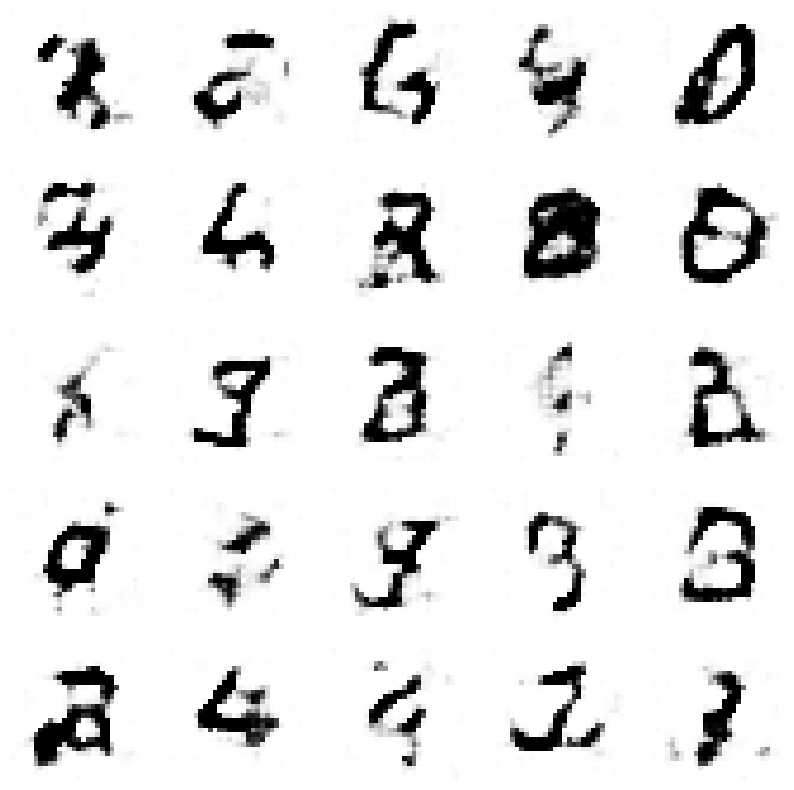

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.38135791035034716, Generator Loss 1.0661863007097163
1/1 [==============================] - 0s 27ms/step


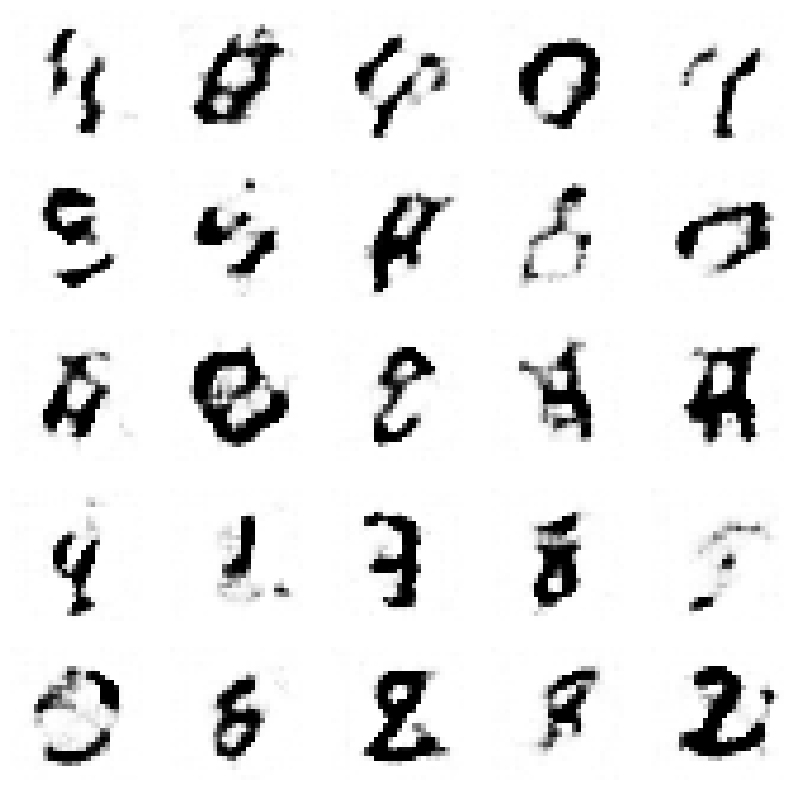

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.3839741822363984, Generator Loss 1.0728584843823032
1/1 [==============================] - 0s 27ms/step


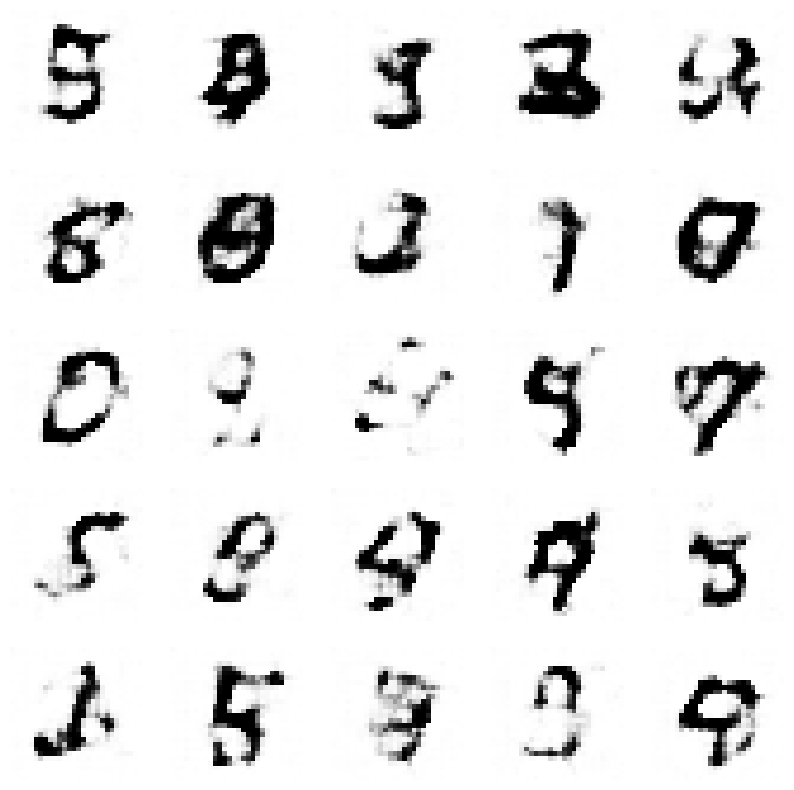

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.38652225017038166, Generator Loss 1.0796188574570875
1/1 [==============================] - 0s 29ms/step


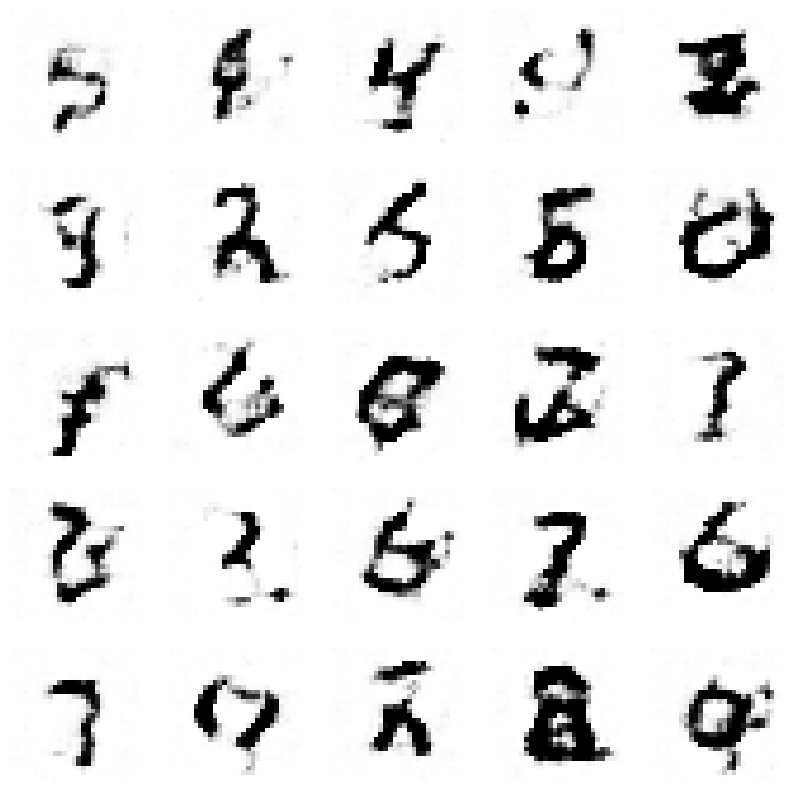

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.38903894211746687, Generator Loss 1.0866205585308564
1/1 [==============================] - 0s 27ms/step


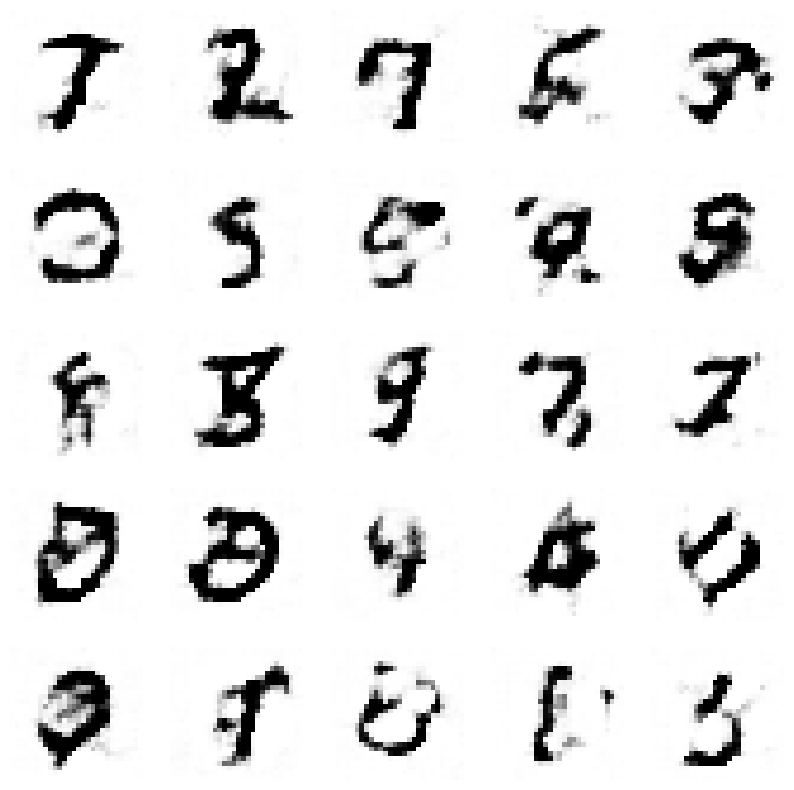

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.39196329321871454, Generator Loss 1.092791627614926
1/1 [==============================] - 0s 28ms/step


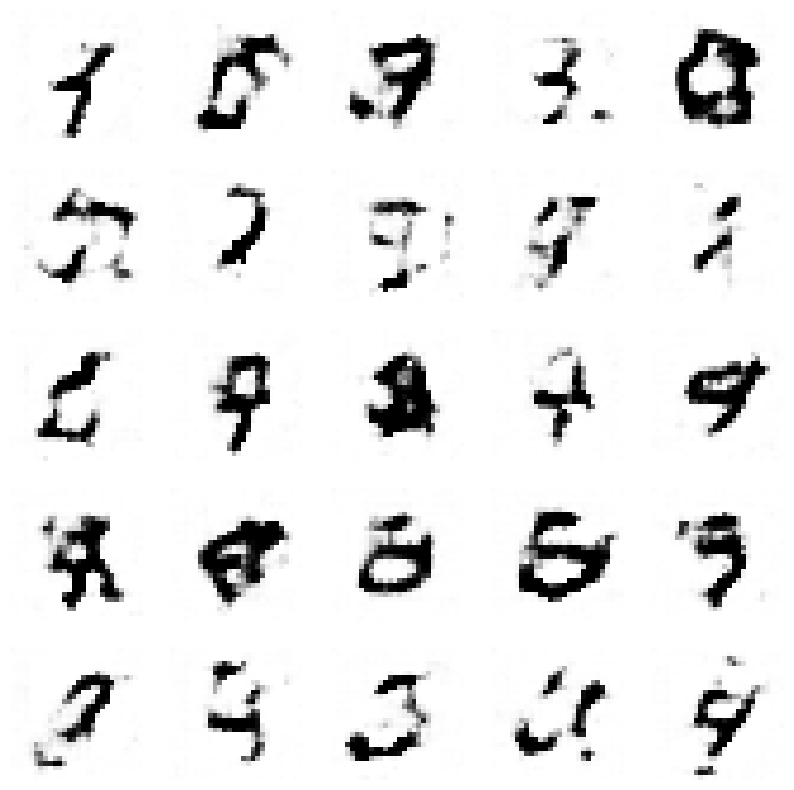

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.3944366428459811, Generator Loss 1.0995830771250603
1/1 [==============================] - 0s 51ms/step


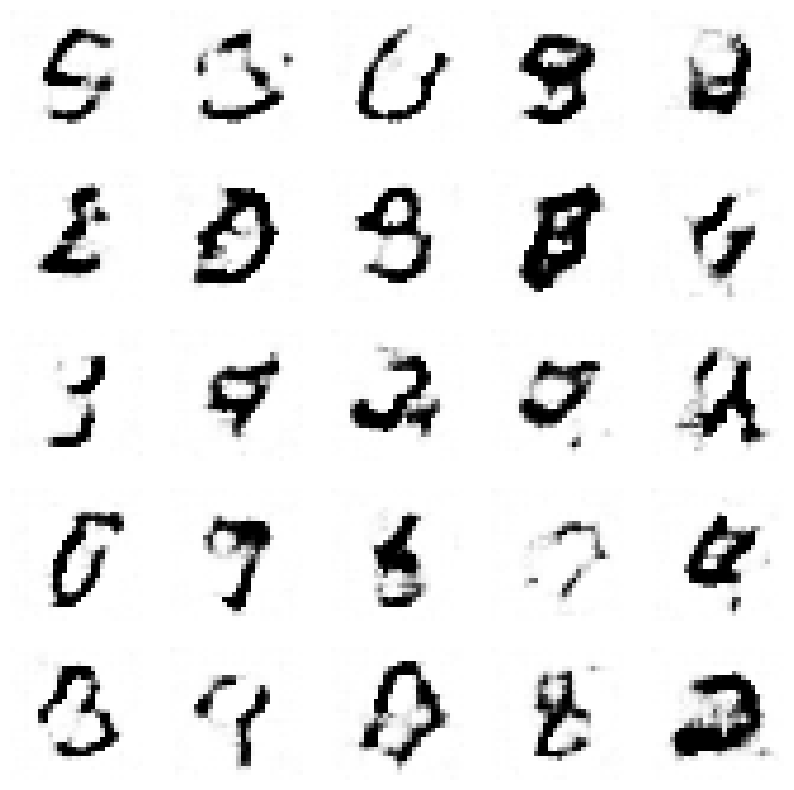

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.3971943194922219, Generator Loss 1.1063765037773001
1/1 [==============================] - 0s 30ms/step


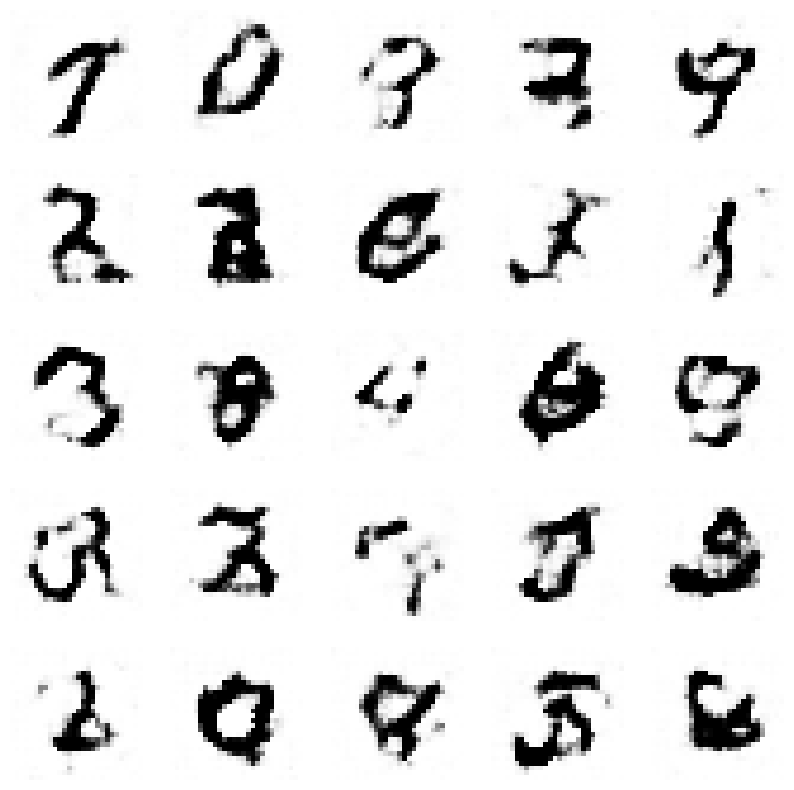

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.39998922624394423, Generator Loss 1.1128577844709413
1/1 [==============================] - 0s 35ms/step


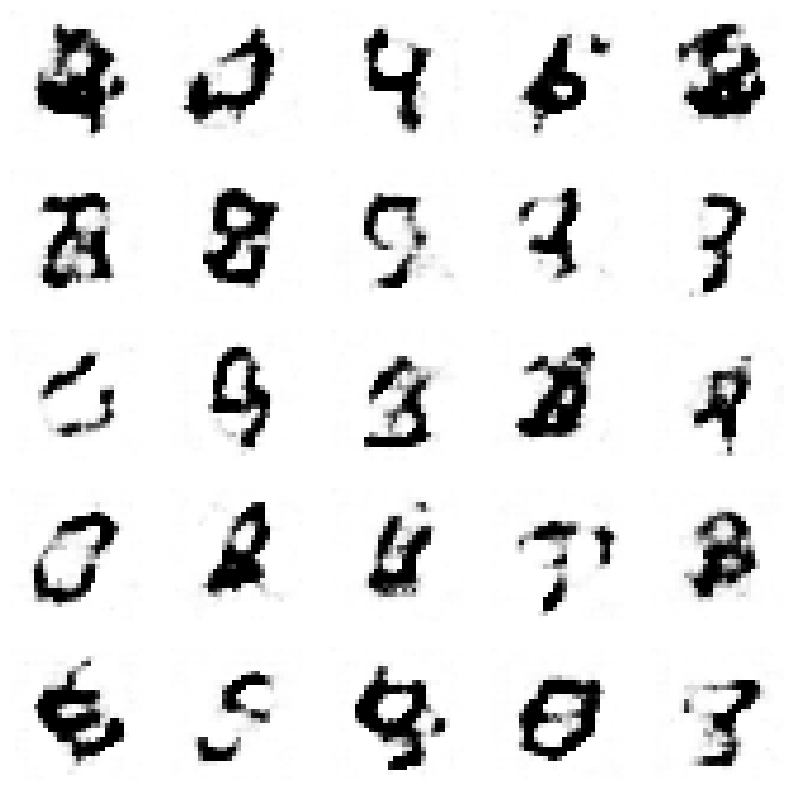

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4026197303946202, Generator Loss 1.1191650562816196
1/1 [==============================] - 0s 27ms/step


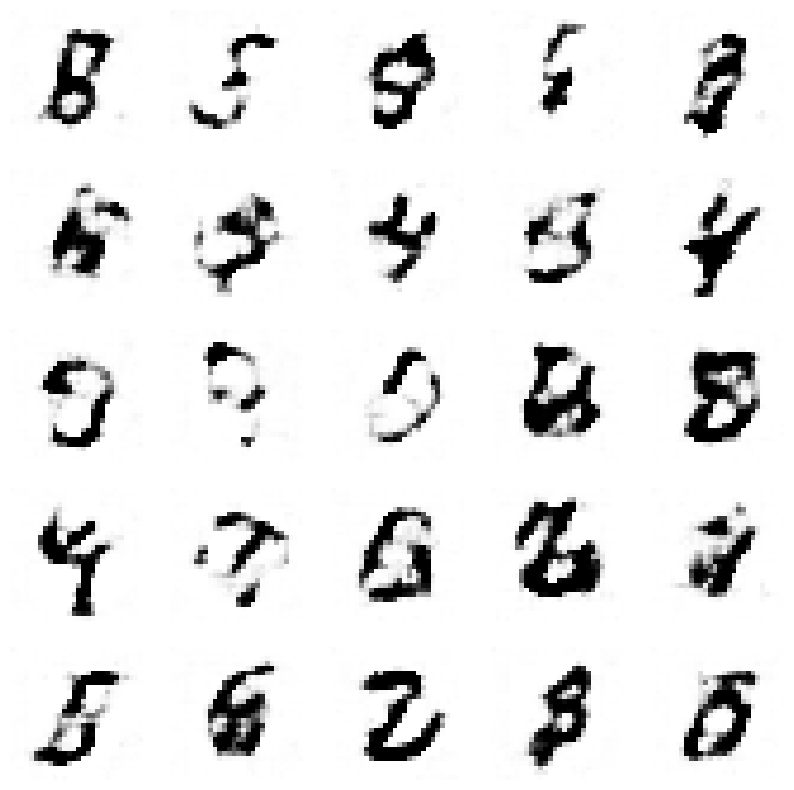

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.40525998818313974, Generator Loss 1.12579770016874
1/1 [==============================] - 0s 26ms/step


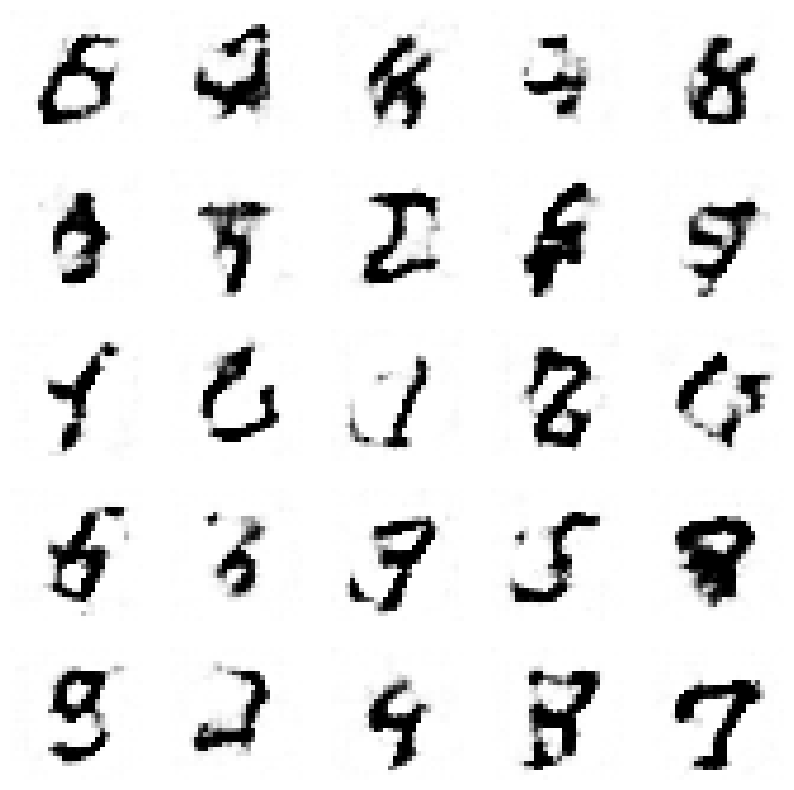

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4076643088816578, Generator Loss 1.1327166440140488
1/1 [==============================] - 0s 29ms/step


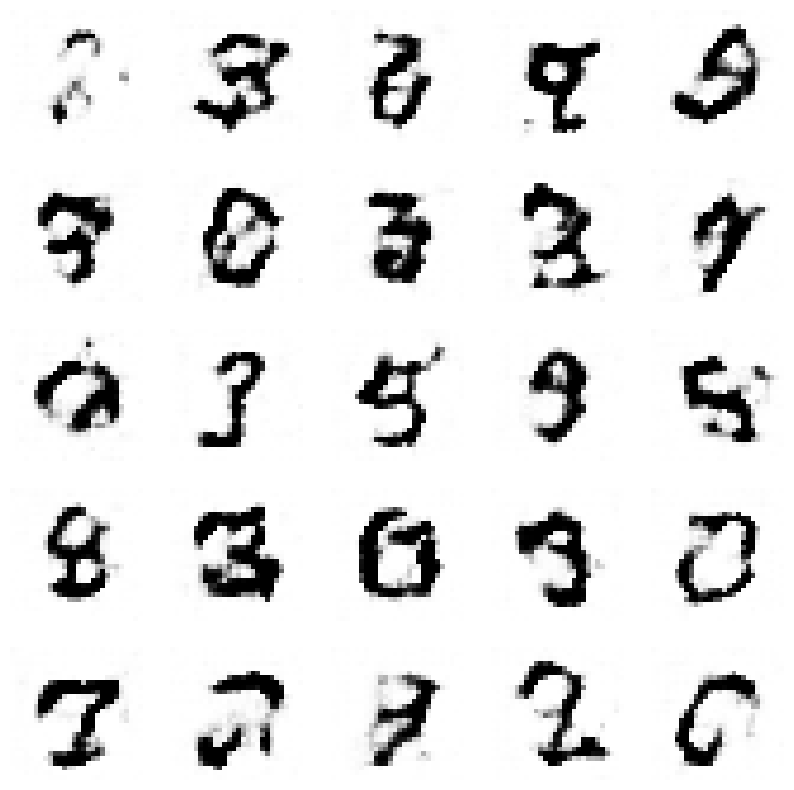

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.41034639550325197, Generator Loss 1.1394855971010323
1/1 [==============================] - 0s 26ms/step


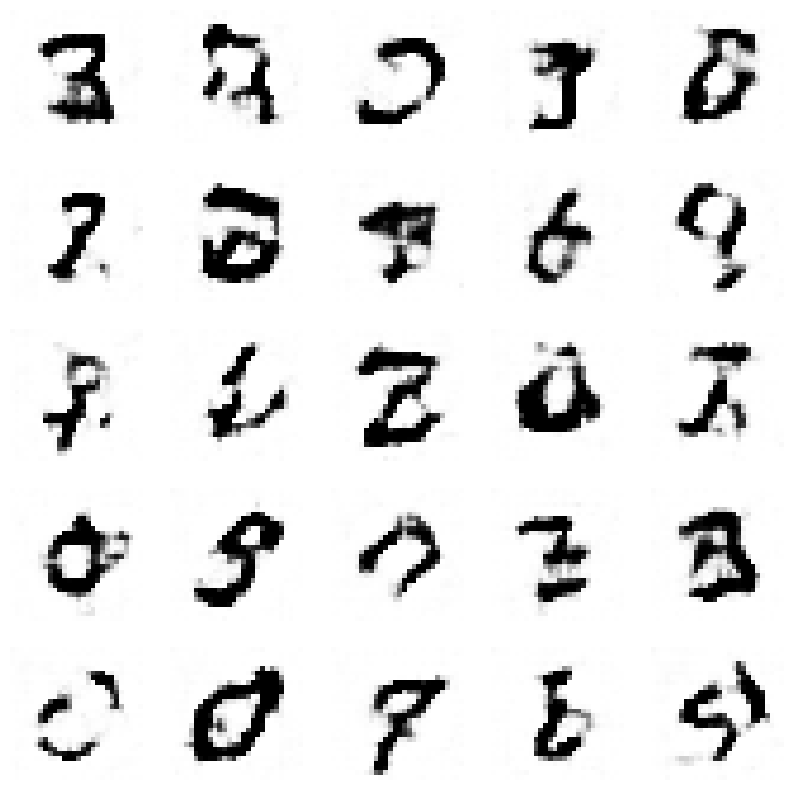

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.41292227836500883, Generator Loss 1.1461186515979278
1/1 [==============================] - 0s 28ms/step


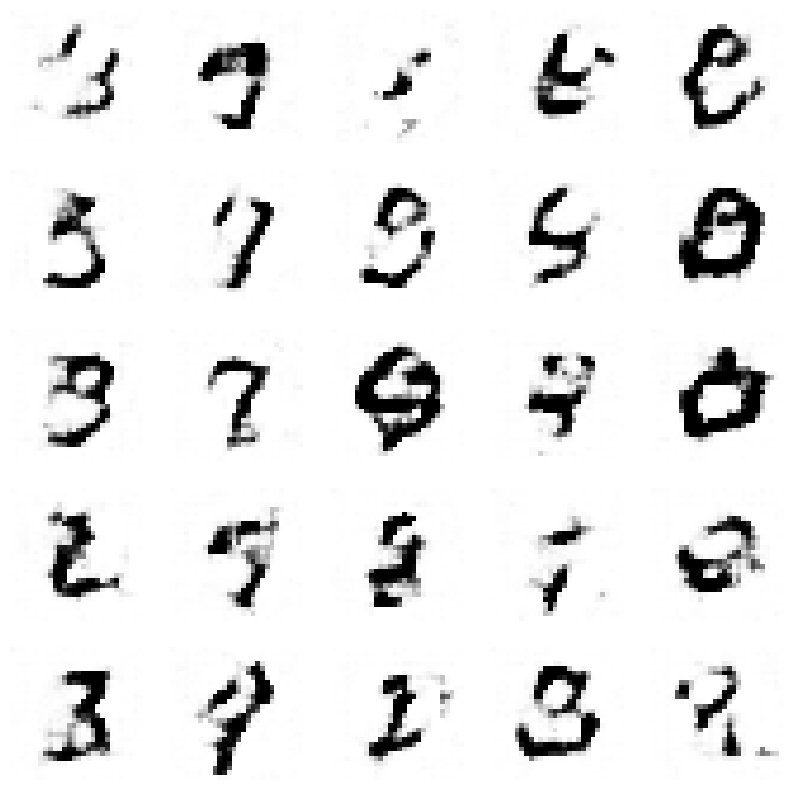

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.4156316207387509, Generator Loss 1.1526023541760242
1/1 [==============================] - 0s 26ms/step


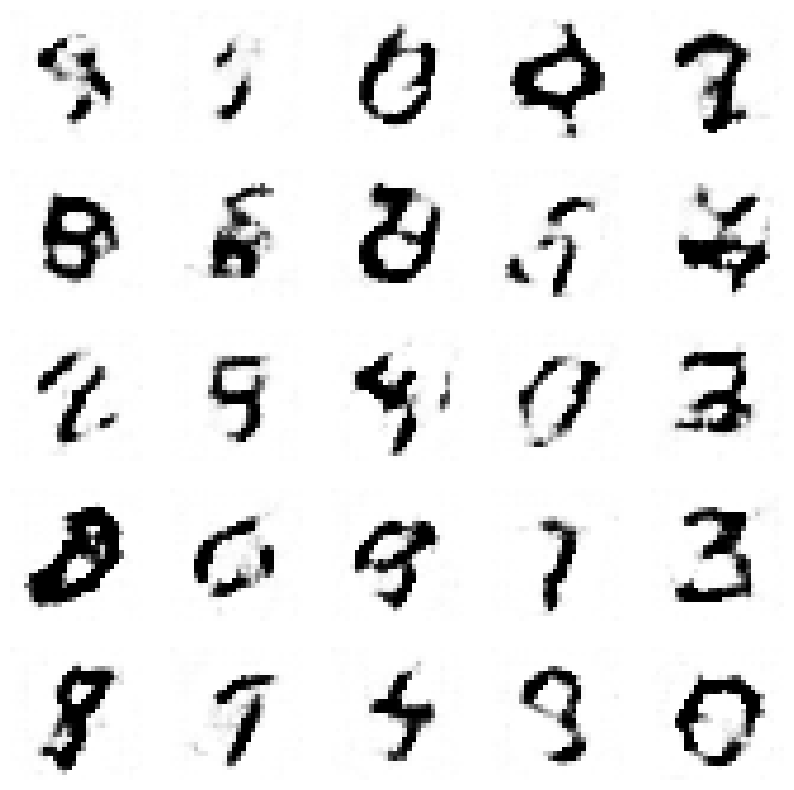

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.41814809846572387, Generator Loss 1.1591487852936118
1/1 [==============================] - 0s 32ms/step


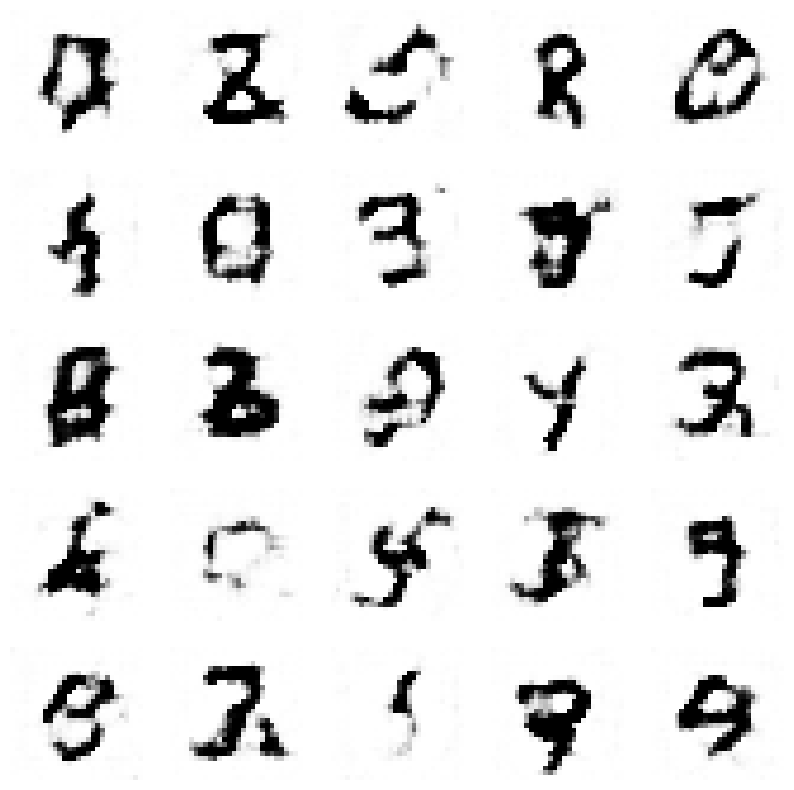

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.42086805798049665, Generator Loss 1.1656816922701323
1/1 [==============================] - 0s 38ms/step


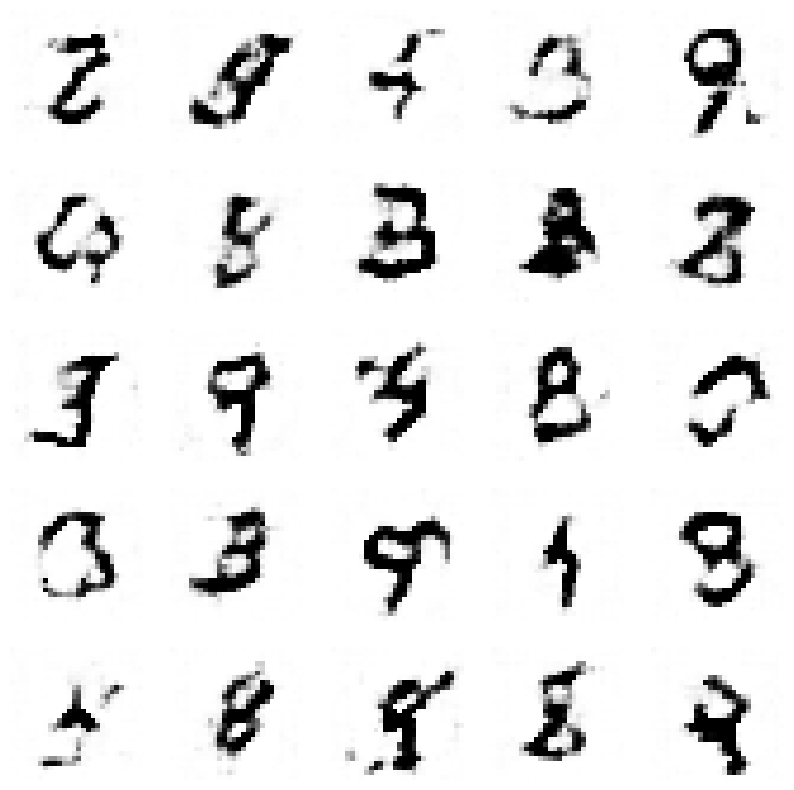

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.42342876623838377, Generator Loss 1.1727111706366906
1/1 [==============================] - 0s 37ms/step


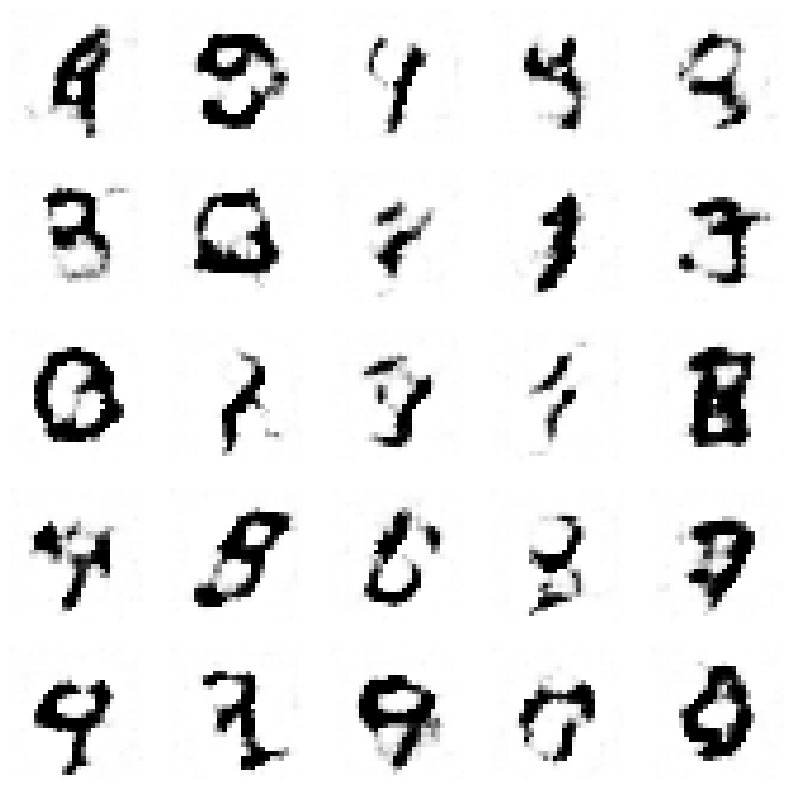

4/4 [==============================] - 0s 6ms/step
Epoch 5, Disc loss 0.42621266720896095, Generator Loss 1.1788550890409029
1/1 [==============================] - 0s 34ms/step


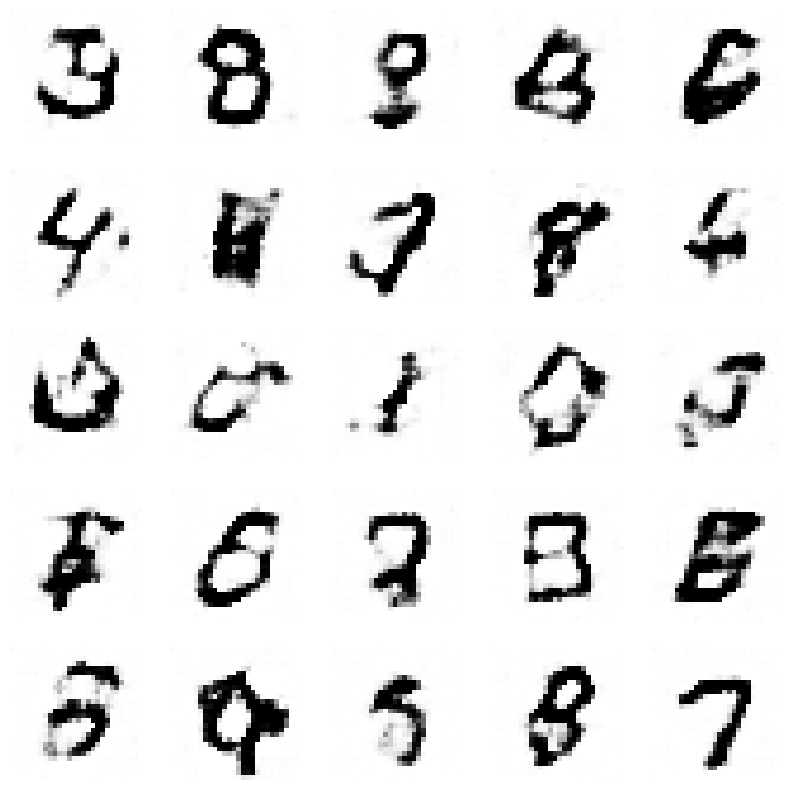

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4287117971186964, Generator Loss 1.1857739381301098
1/1 [==============================] - 0s 58ms/step


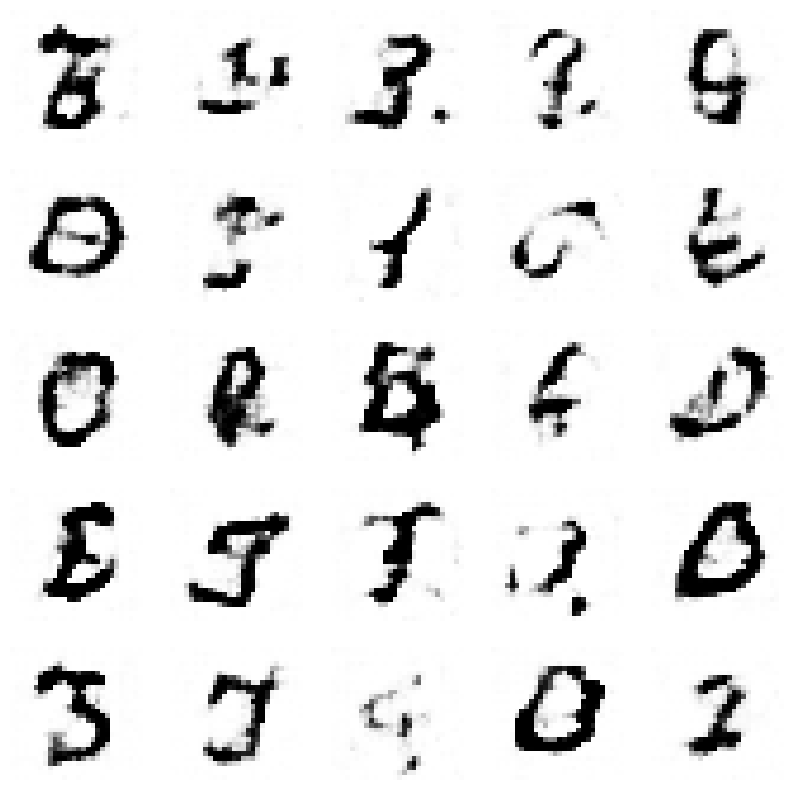

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.43142087942259943, Generator Loss 1.1924097573655283
1/1 [==============================] - 0s 32ms/step


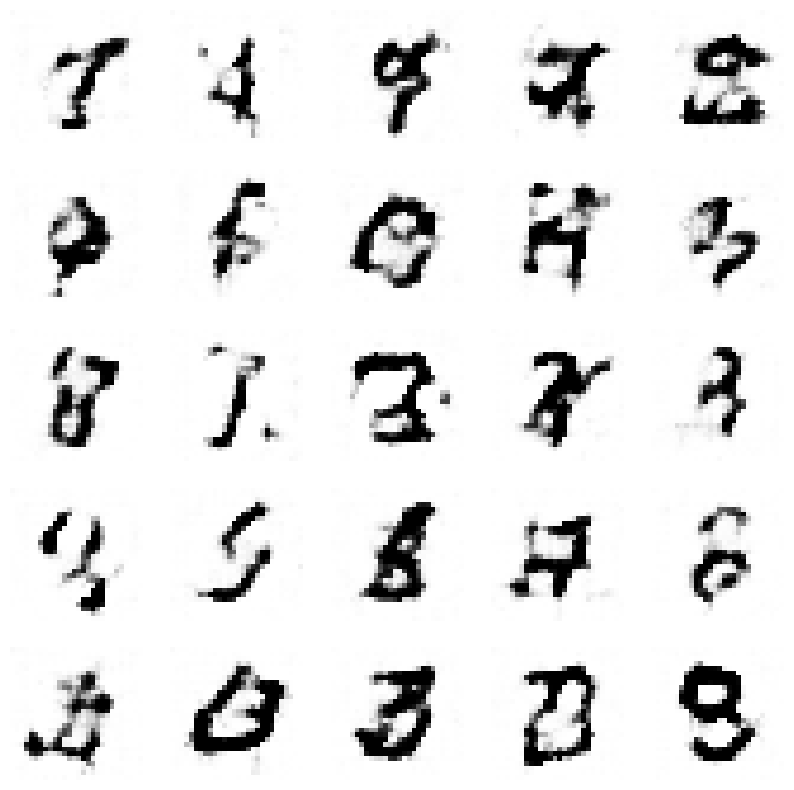

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4340048681339647, Generator Loss 1.1989173909537814
1/1 [==============================] - 0s 30ms/step


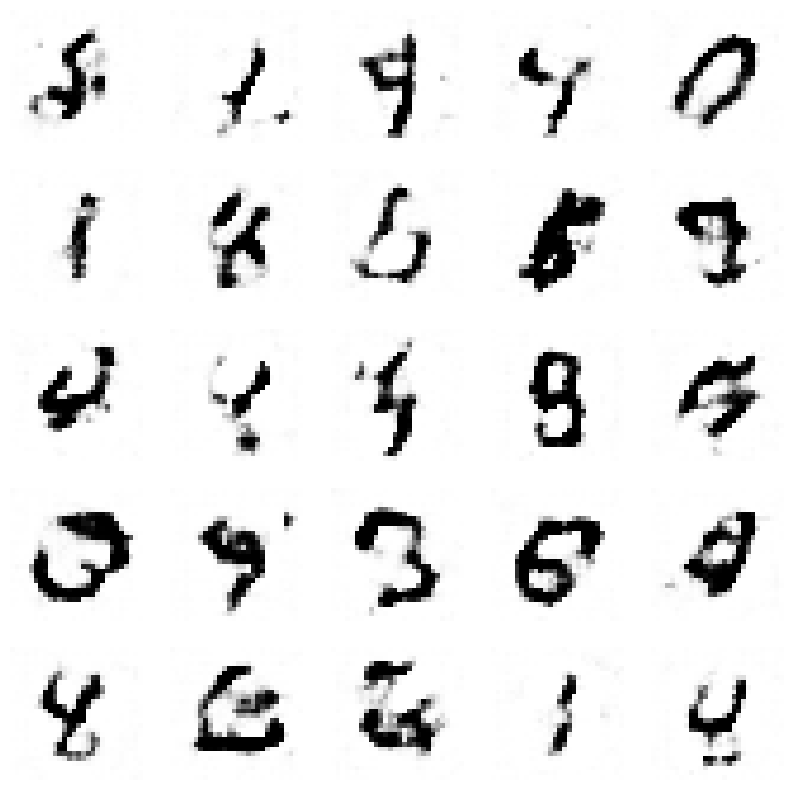

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.4365690209799343, Generator Loss 1.2054987009773908
1/1 [==============================] - 0s 26ms/step


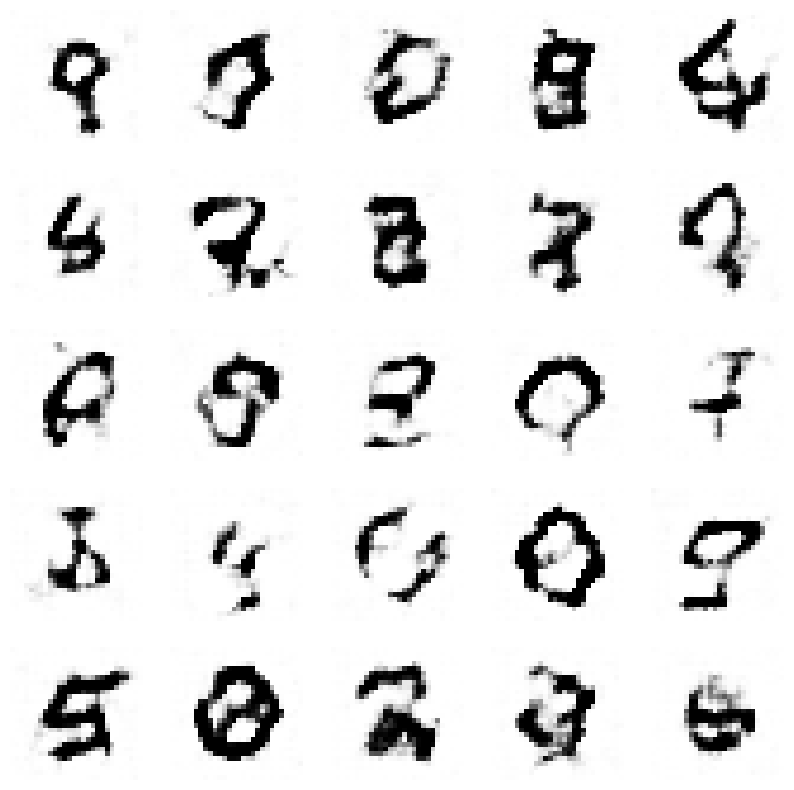

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4391823994298267, Generator Loss 1.2122094677044795
1/1 [==============================] - 0s 27ms/step


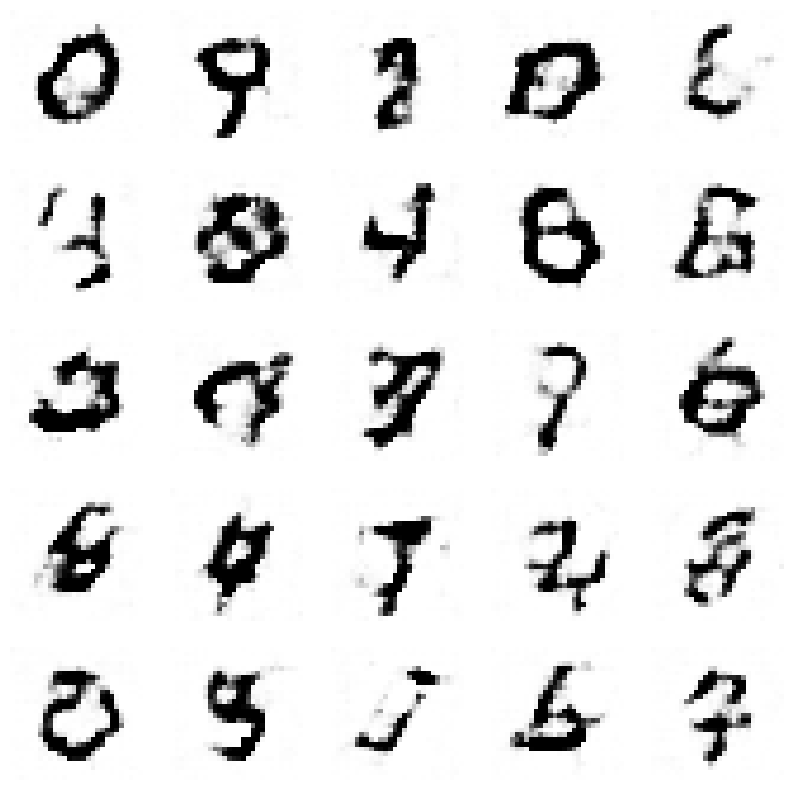

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.4416961513268642, Generator Loss 1.2189052471747766
1/1 [==============================] - 0s 30ms/step


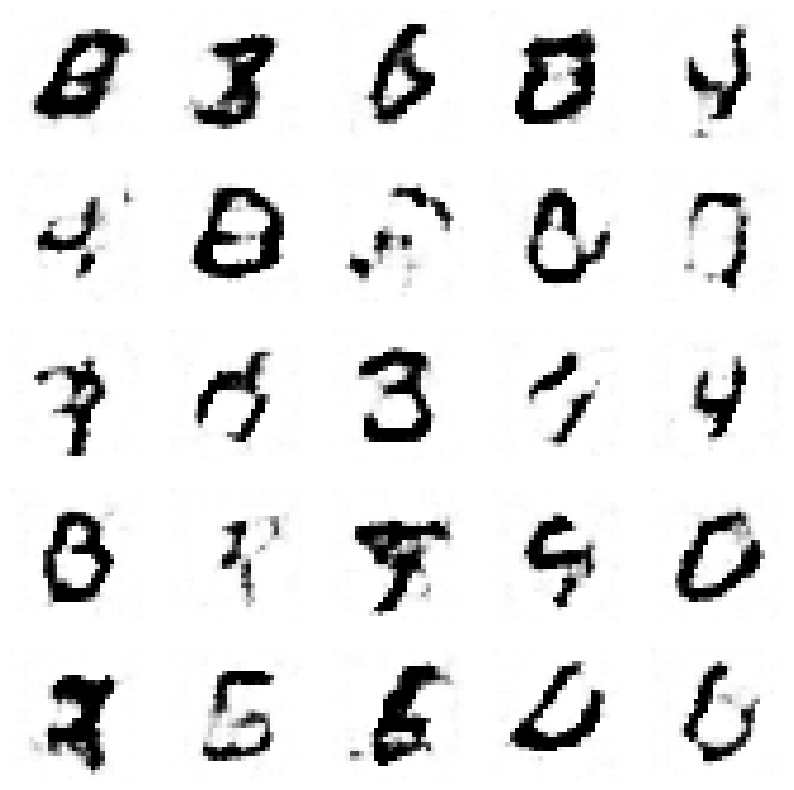

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4443496224971918, Generator Loss 1.2259167096553705
1/1 [==============================] - 0s 30ms/step


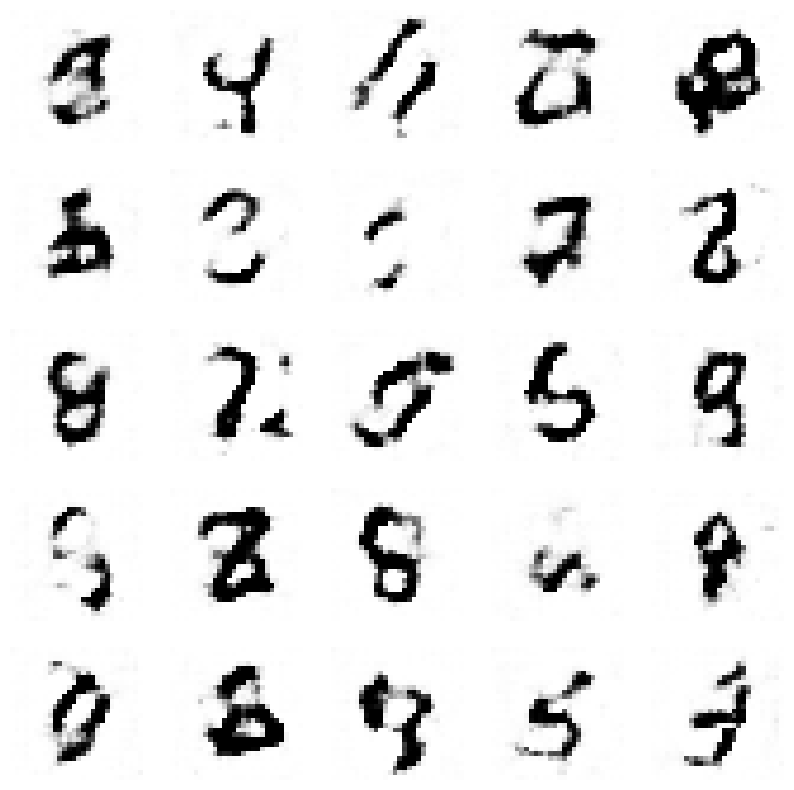

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.446953347669198, Generator Loss 1.2326635224187477
1/1 [==============================] - 0s 28ms/step


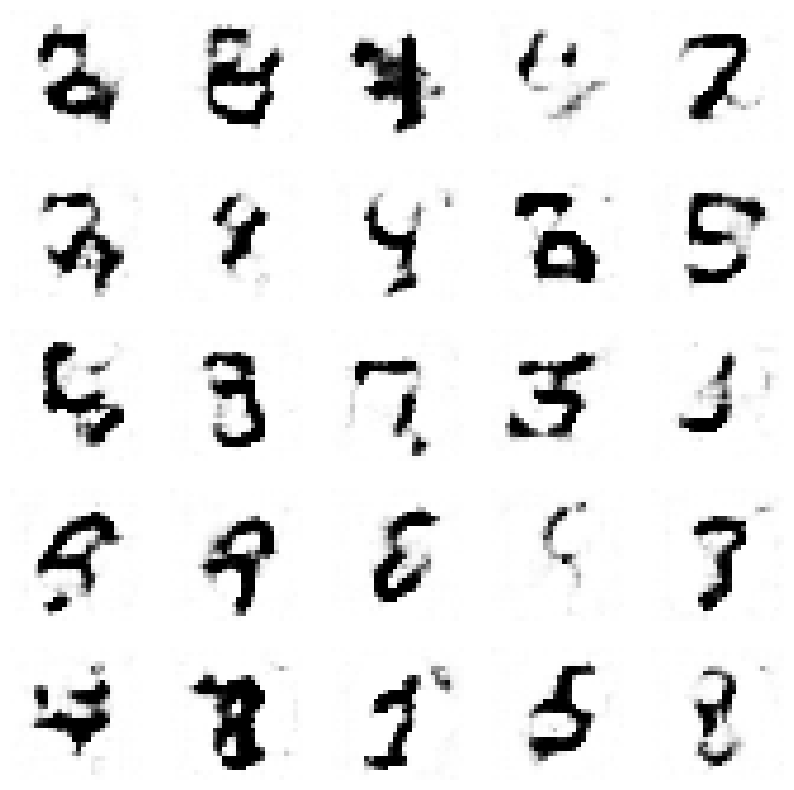

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4497317687695862, Generator Loss 1.238899833116776
1/1 [==============================] - 0s 29ms/step


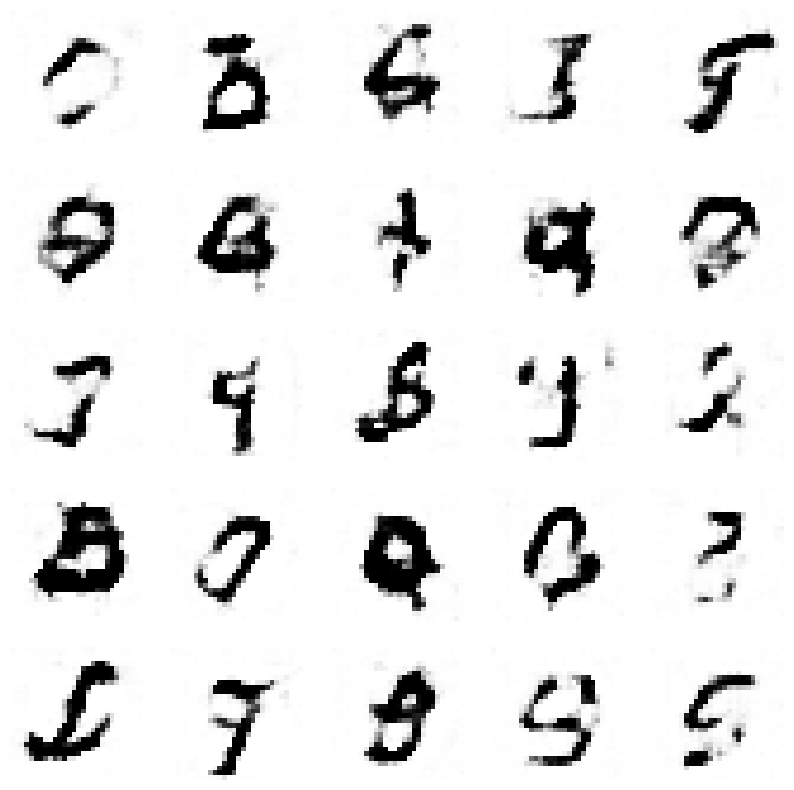

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.4521942283225875, Generator Loss 1.2456377632597573
1/1 [==============================] - 0s 32ms/step


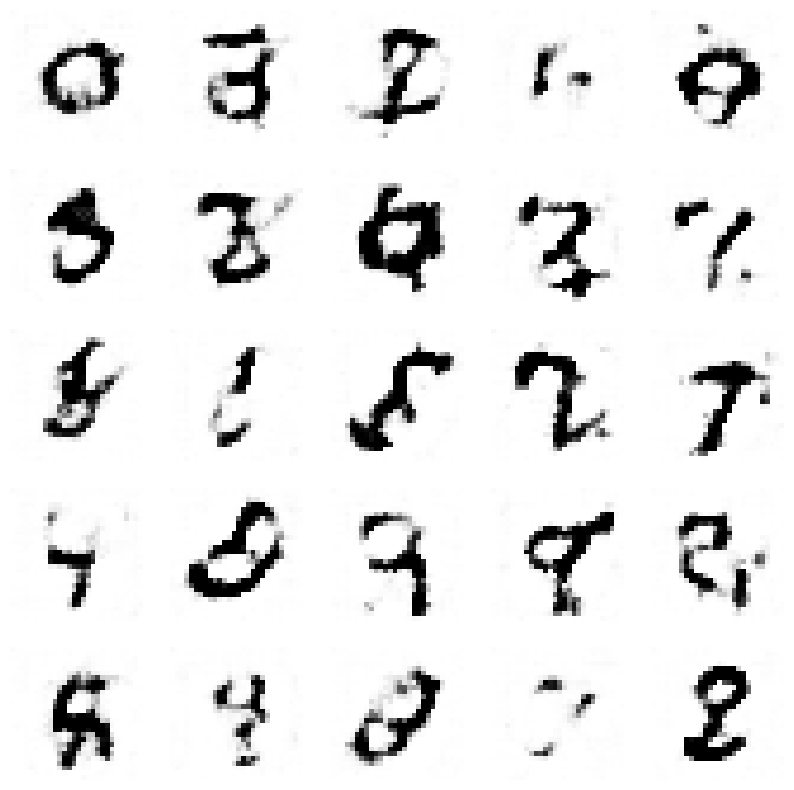

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.45498714736129486, Generator Loss 1.2522096796932383
1/1 [==============================] - 0s 36ms/step


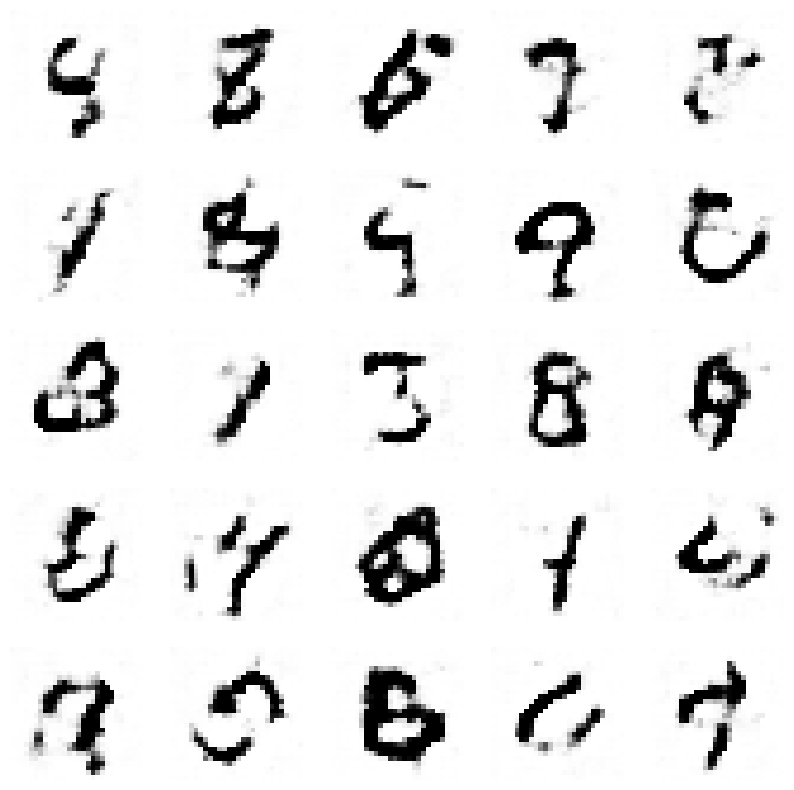

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4575469621863121, Generator Loss 1.2589567858948667
1/1 [==============================] - 0s 32ms/step


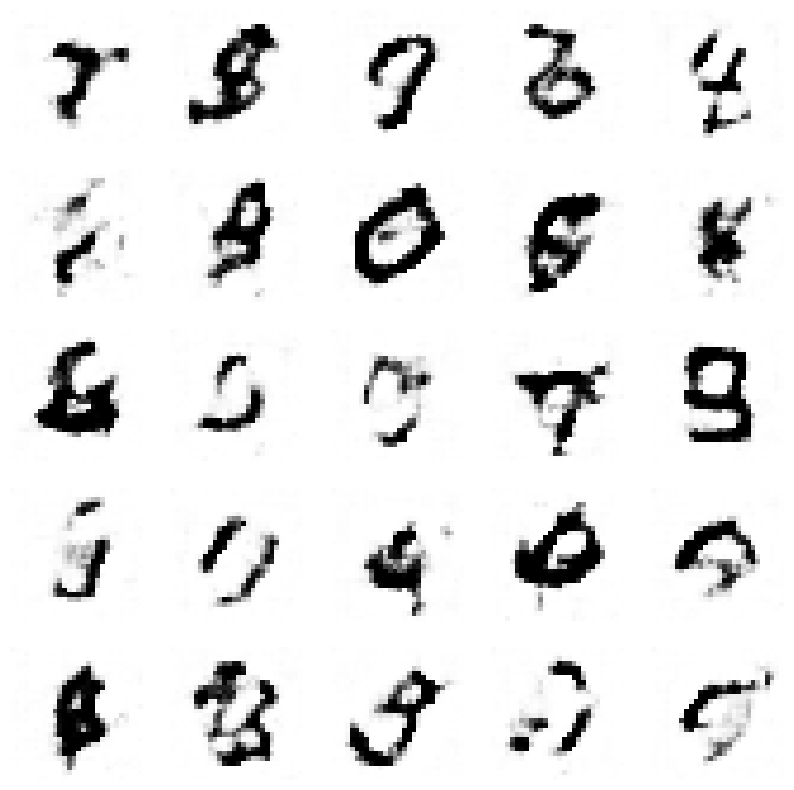

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.46024107952148485, Generator Loss 1.2658471133973863
1/1 [==============================] - 0s 40ms/step


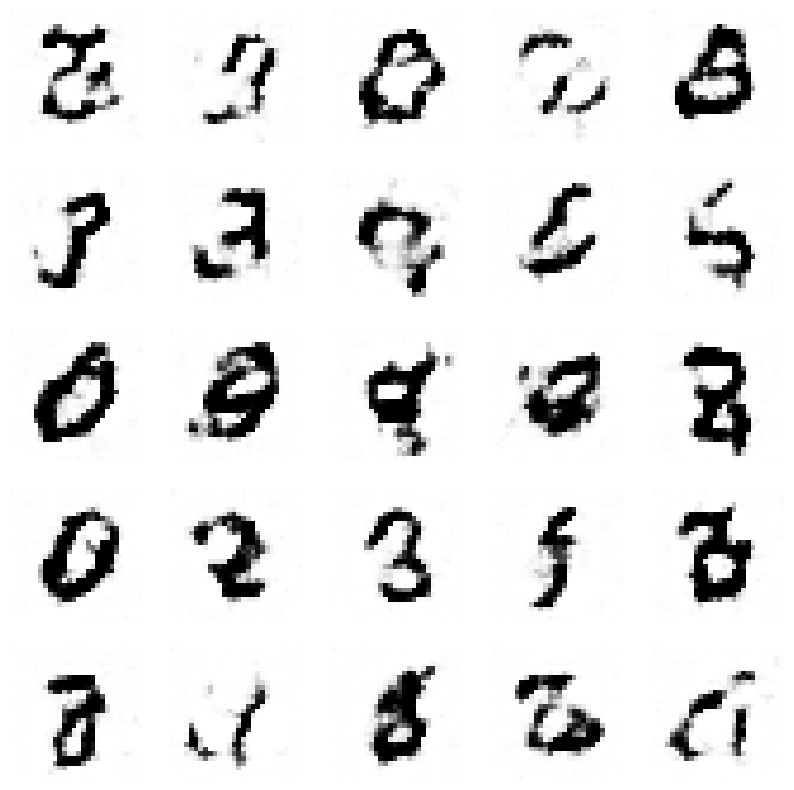

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4631209125758236, Generator Loss 1.2724633359501505
1/1 [==============================] - 0s 29ms/step


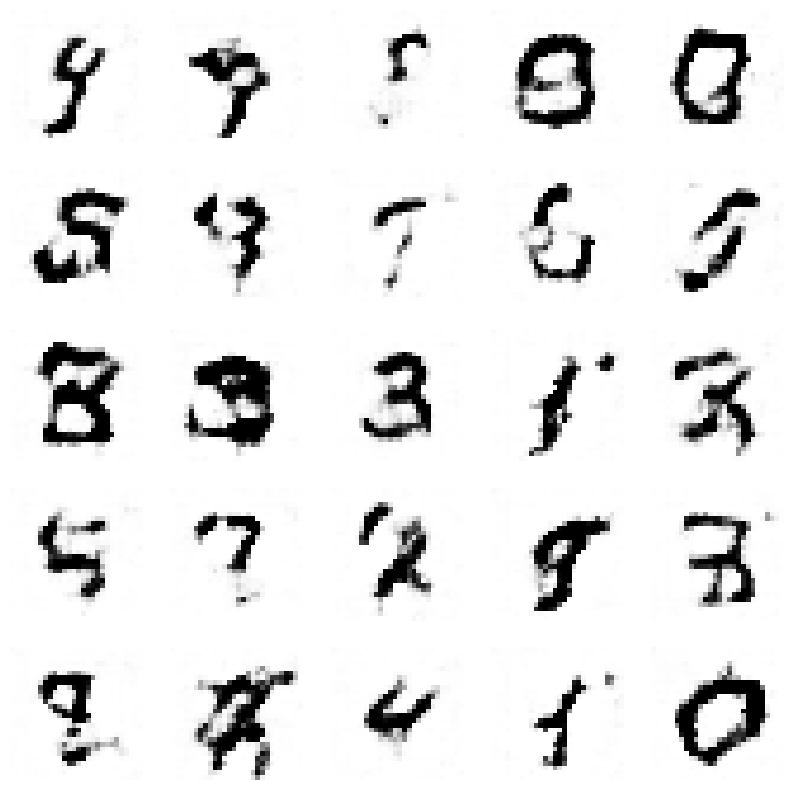

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.46565681625889915, Generator Loss 1.279225033063155
1/1 [==============================] - 0s 28ms/step


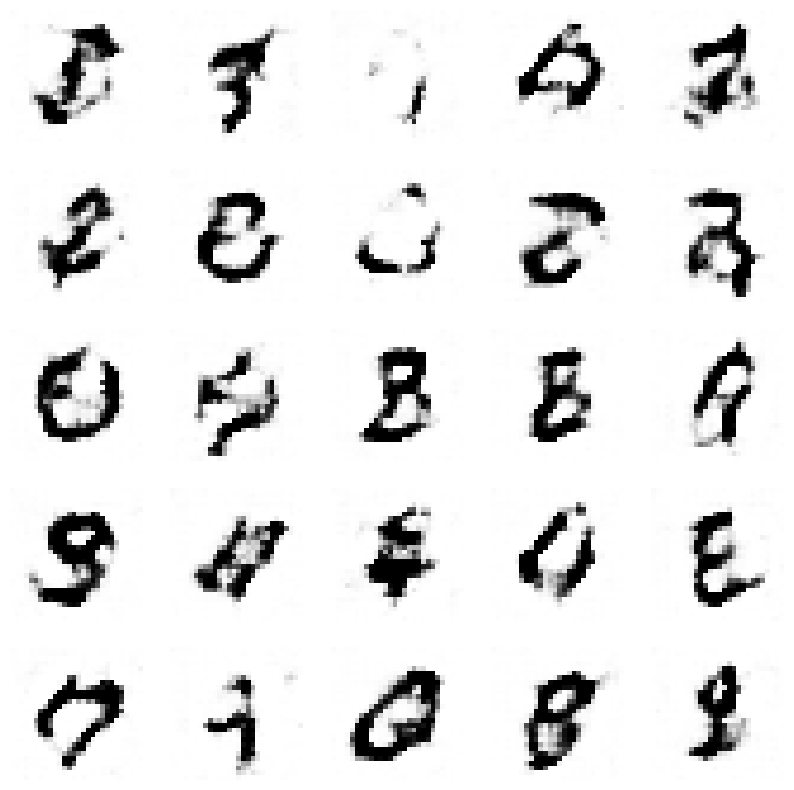

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4686144566816142, Generator Loss 1.2853378572015681
1/1 [==============================] - 0s 27ms/step


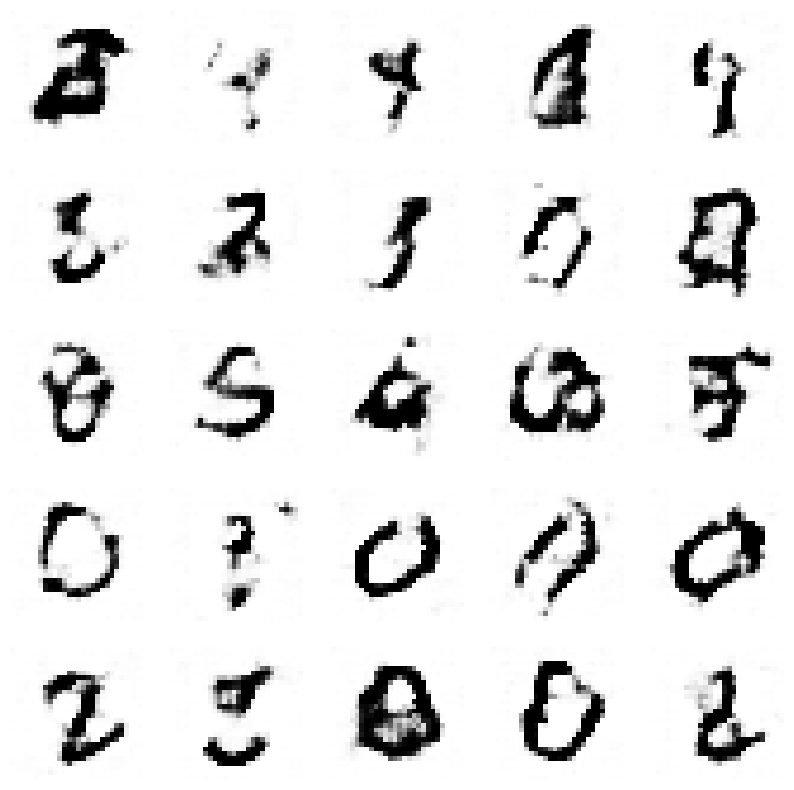

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4711591042896621, Generator Loss 1.2921131589473822
1/1 [==============================] - 0s 29ms/step


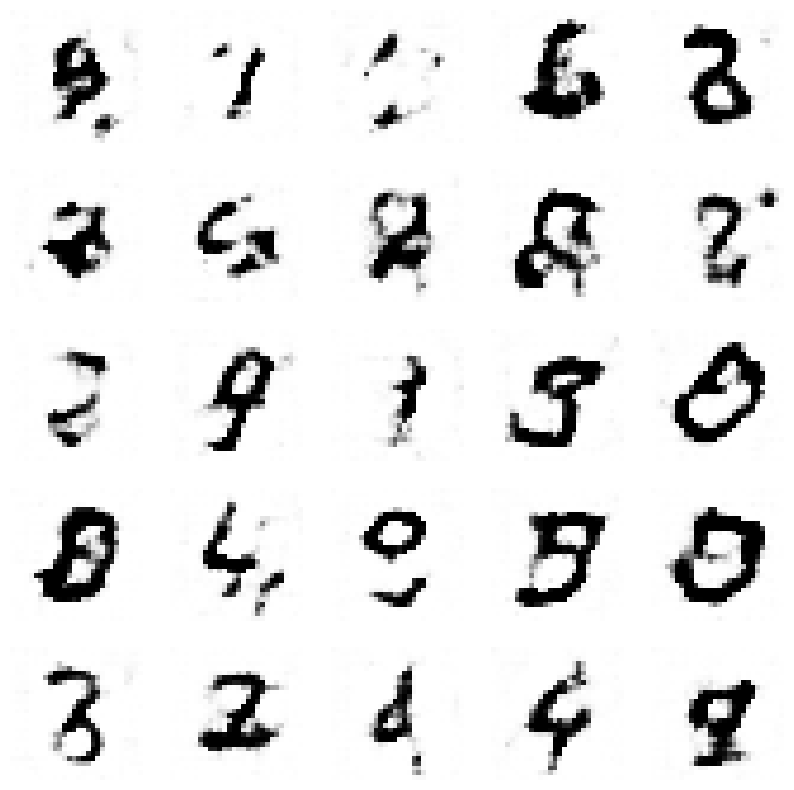

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.473910050578097, Generator Loss 1.2986137831312978
1/1 [==============================] - 0s 27ms/step


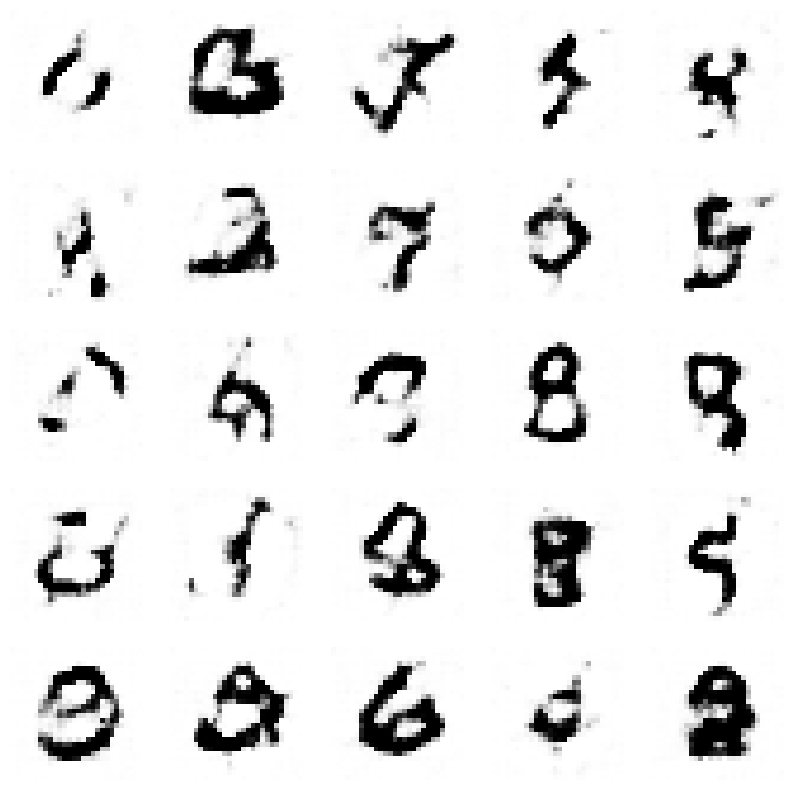

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.4766236138012674, Generator Loss 1.3050522676899903
1/1 [==============================] - 0s 26ms/step


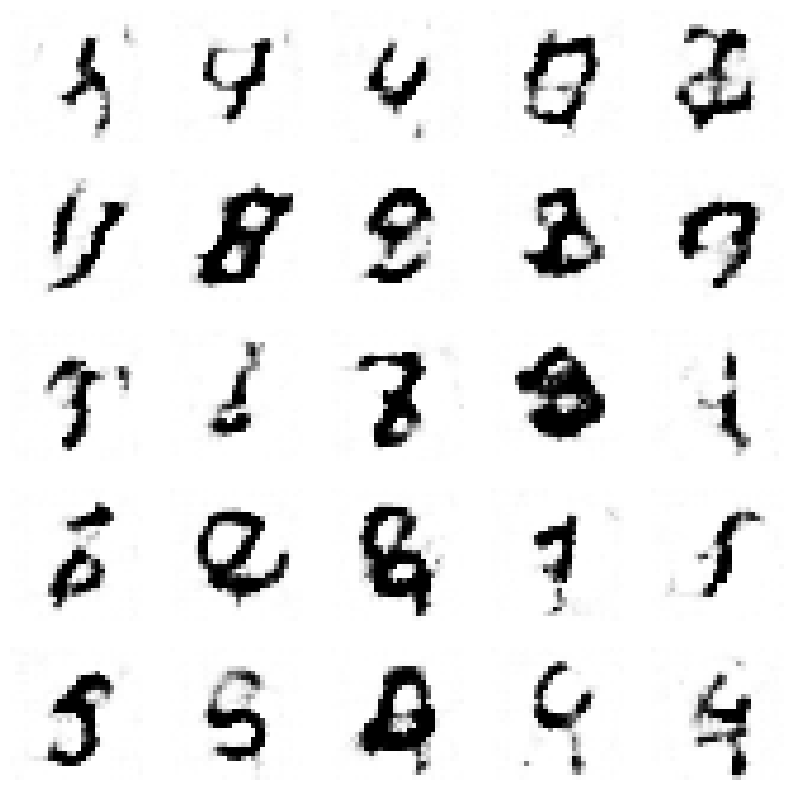

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.47914029027406985, Generator Loss 1.3116122122503753
1/1 [==============================] - 0s 28ms/step


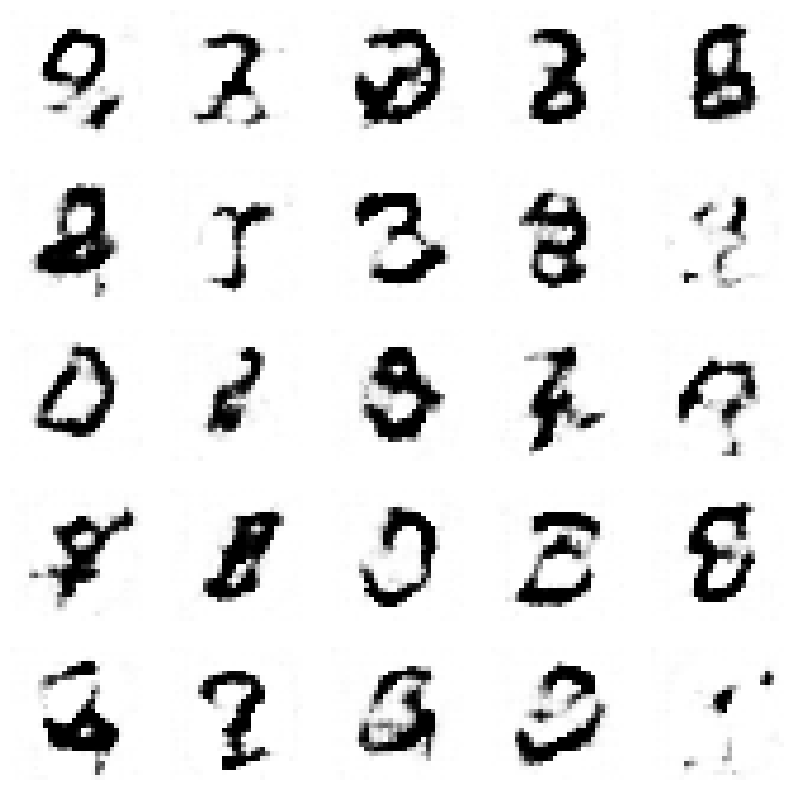

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.48180228006890696, Generator Loss 1.3181621737969227
1/1 [==============================] - 0s 28ms/step


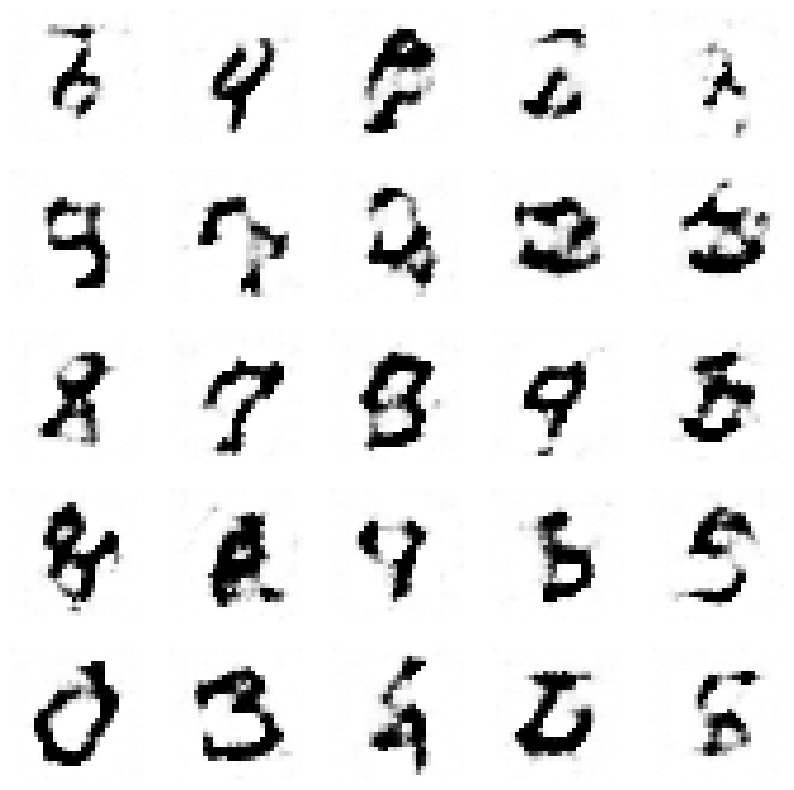

4/4 [==============================] - 0s 6ms/step
Epoch 5, Disc loss 0.48454143087833357, Generator Loss 1.3249395836112845
1/1 [==============================] - 0s 49ms/step


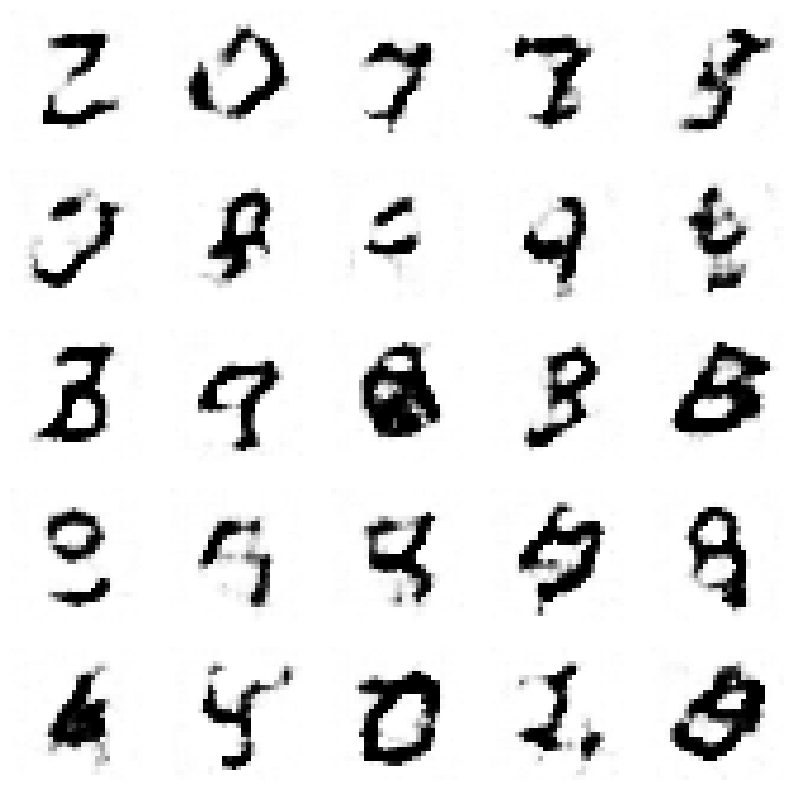

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4871795514327848, Generator Loss 1.3316699429454966
1/1 [==============================] - 0s 30ms/step


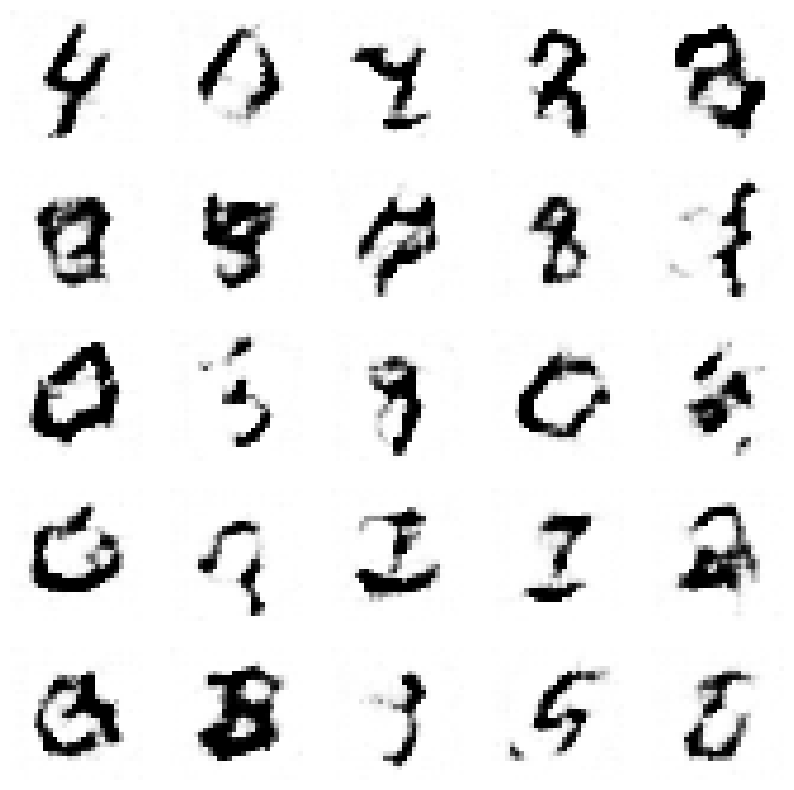

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.49004109070087093, Generator Loss 1.3383389415903988
1/1 [==============================] - 0s 35ms/step


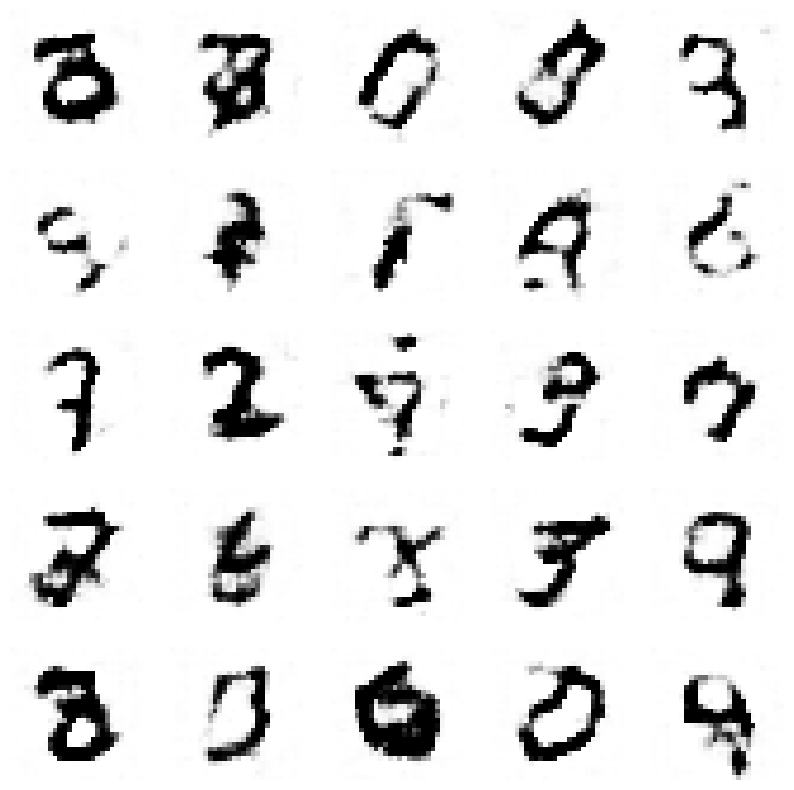

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4927102334988423, Generator Loss 1.3447187247439327
1/1 [==============================] - 0s 30ms/step


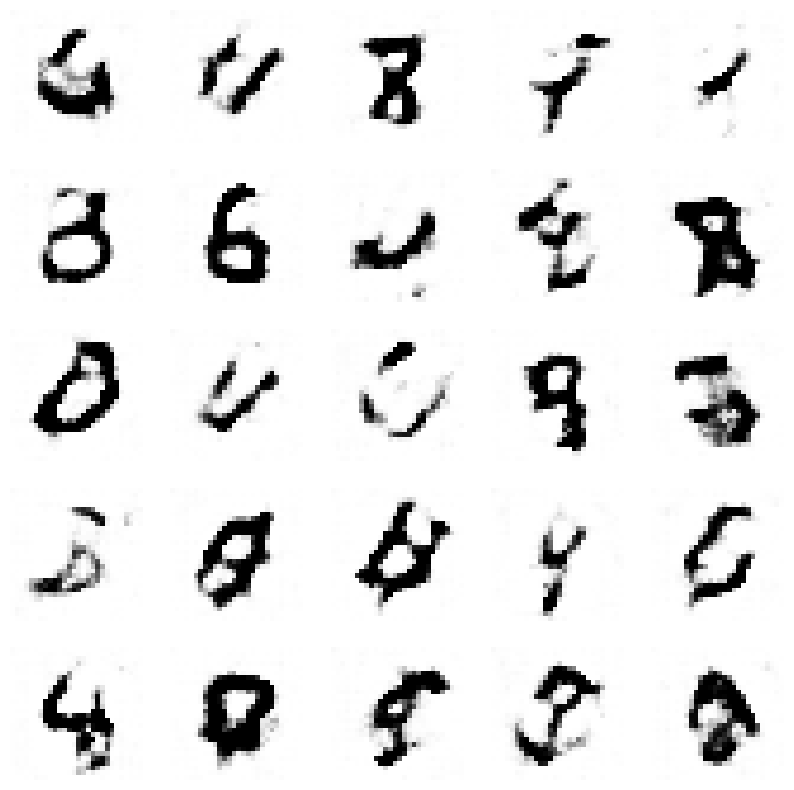

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.49543767326917404, Generator Loss 1.3512652012018056
1/1 [==============================] - 0s 29ms/step


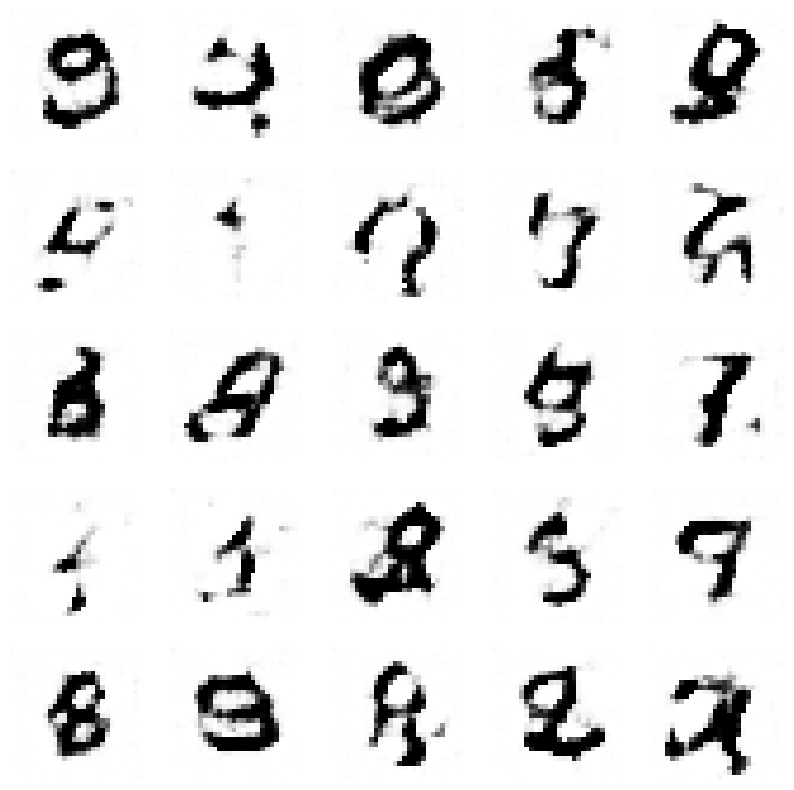

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.4980679171589705, Generator Loss 1.35771449865439
1/1 [==============================] - 0s 32ms/step


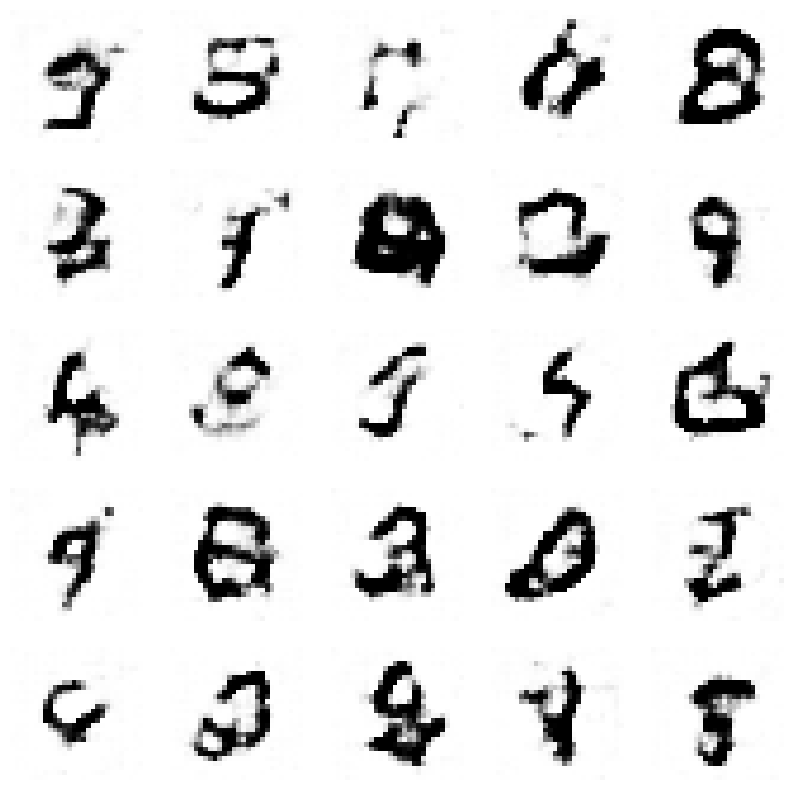

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5006811290852025, Generator Loss 1.3645141950020423
1/1 [==============================] - 0s 27ms/step


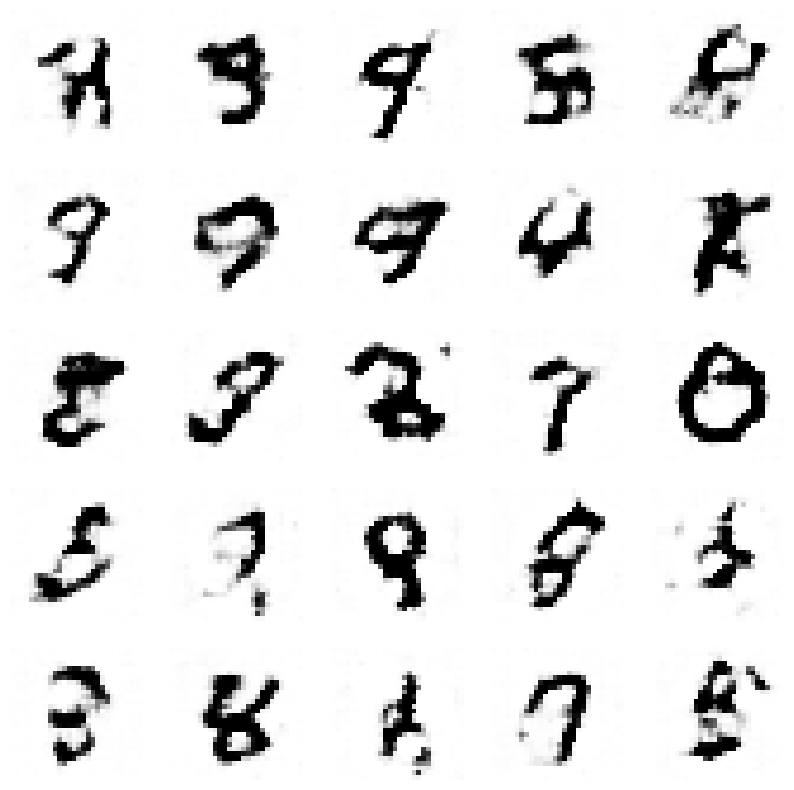

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5033446877048566, Generator Loss 1.370939044870882
1/1 [==============================] - 0s 29ms/step


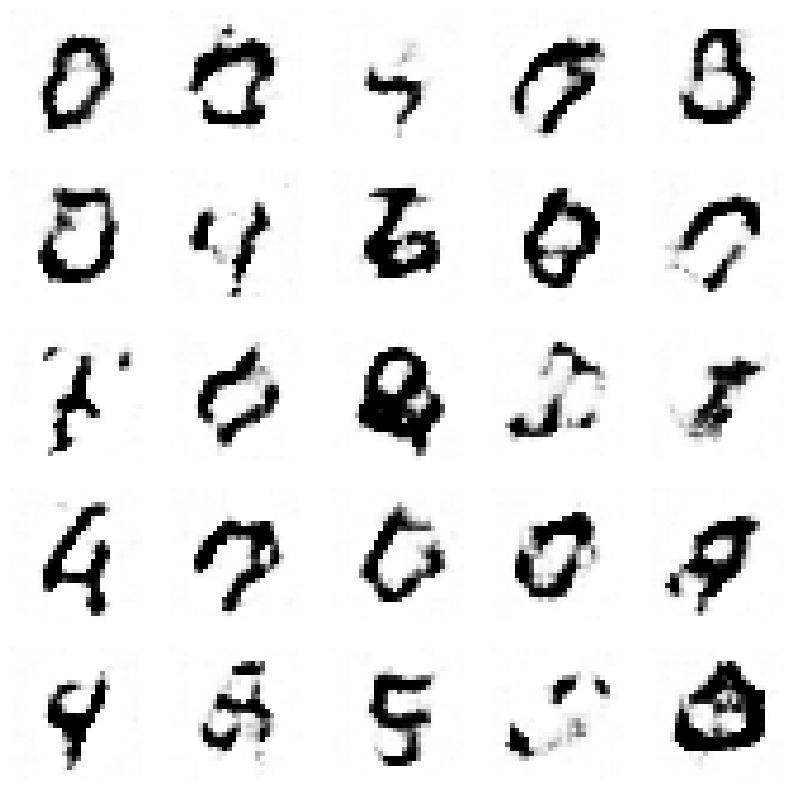

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5058226258072078, Generator Loss 1.3775022941776829
1/1 [==============================] - 0s 30ms/step


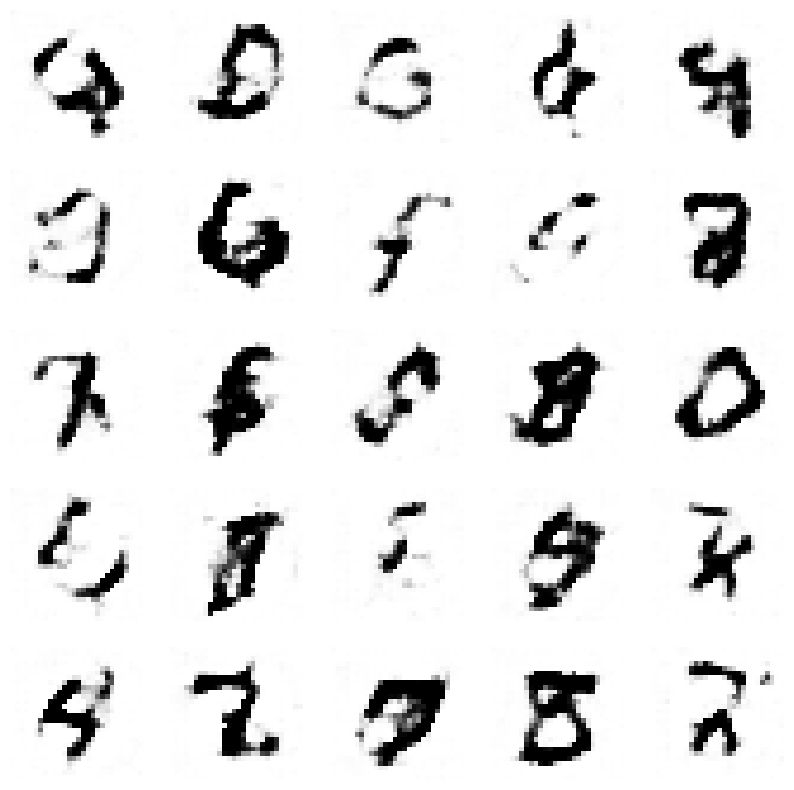

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.508481196486033, Generator Loss 1.3839273386531405
1/1 [==============================] - 0s 31ms/step


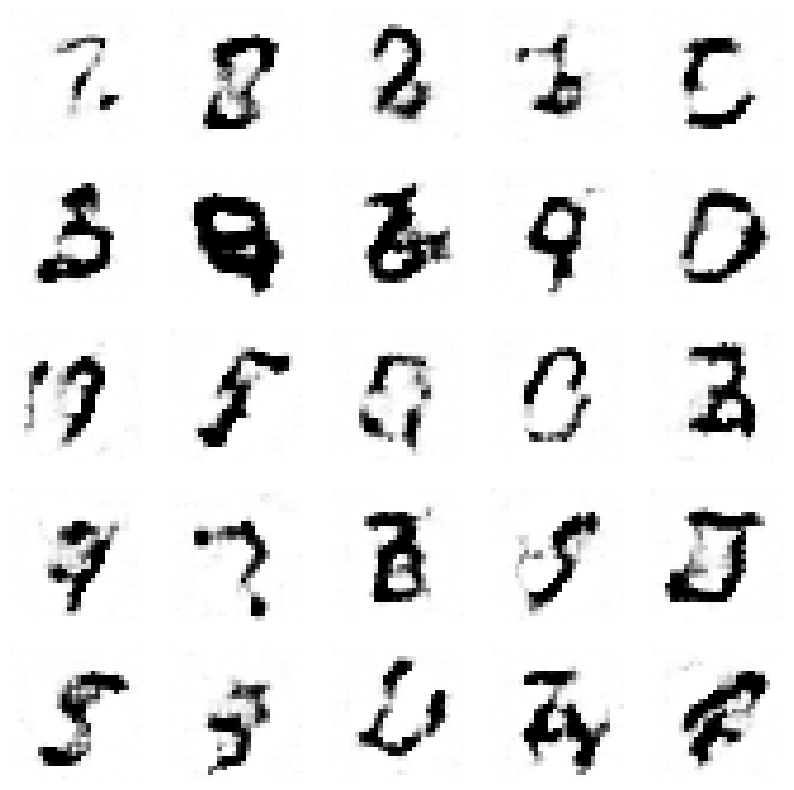

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5110058253392195, Generator Loss 1.3908840886548035
1/1 [==============================] - 0s 27ms/step


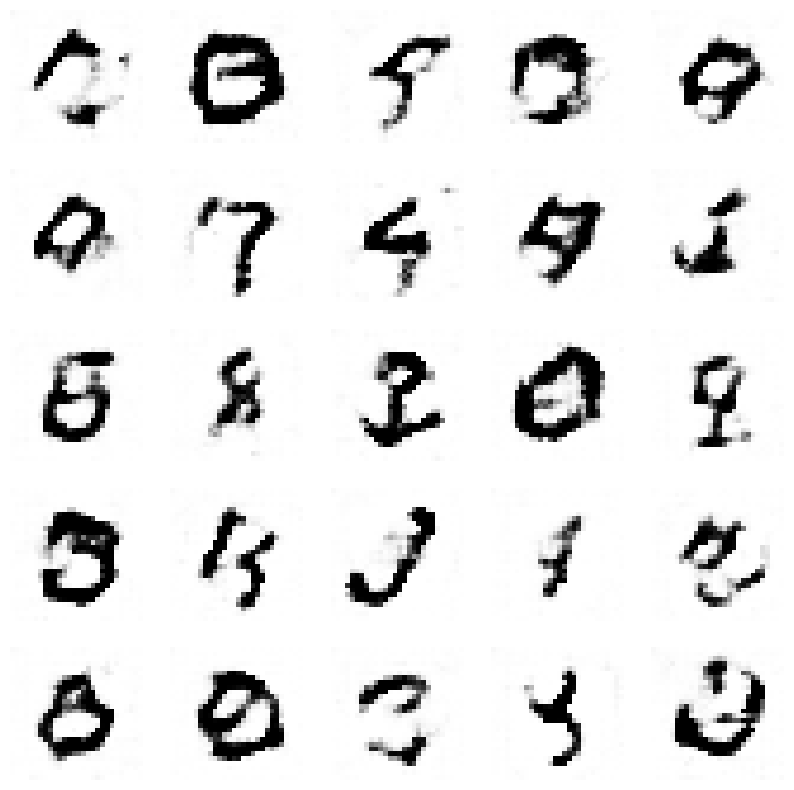

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.5136845962614076, Generator Loss 1.3975340586442213
1/1 [==============================] - 0s 36ms/step


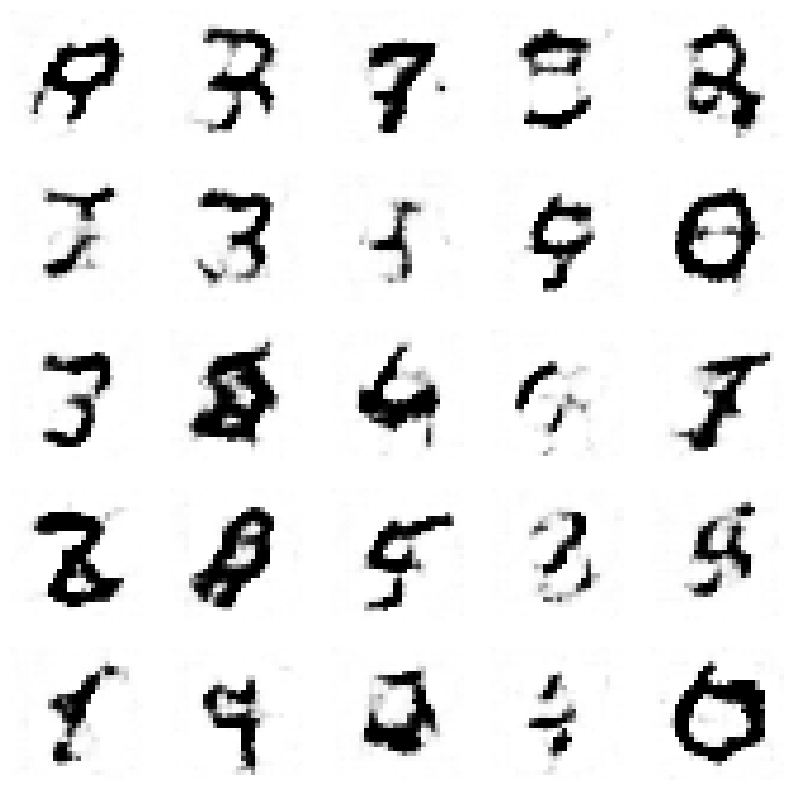

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.51625140164143, Generator Loss 1.4039788765785022
1/1 [==============================] - 0s 31ms/step


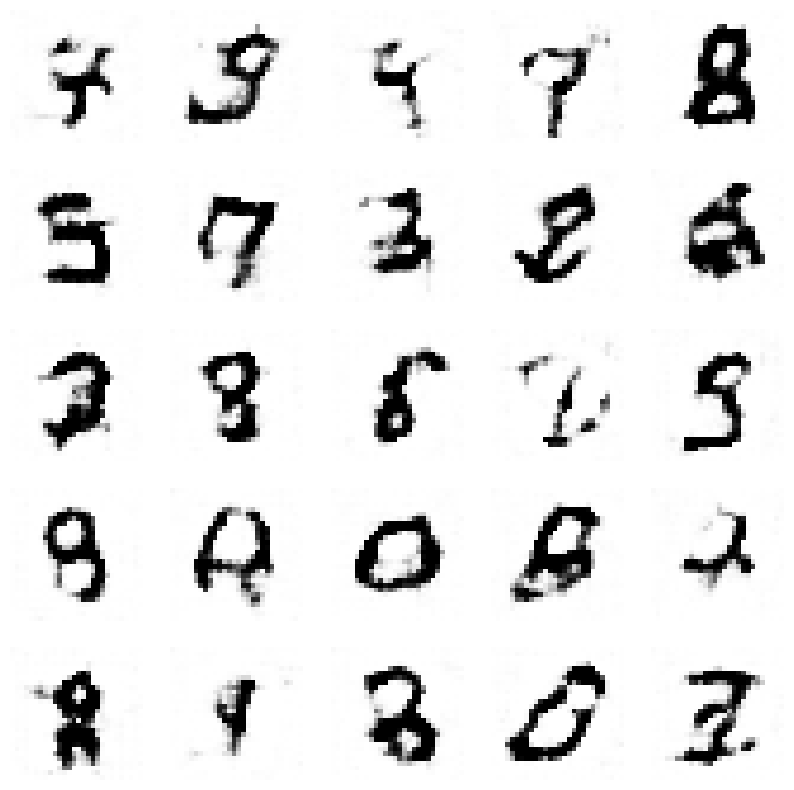

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5188469801448349, Generator Loss 1.4107353386715946
1/1 [==============================] - 0s 30ms/step


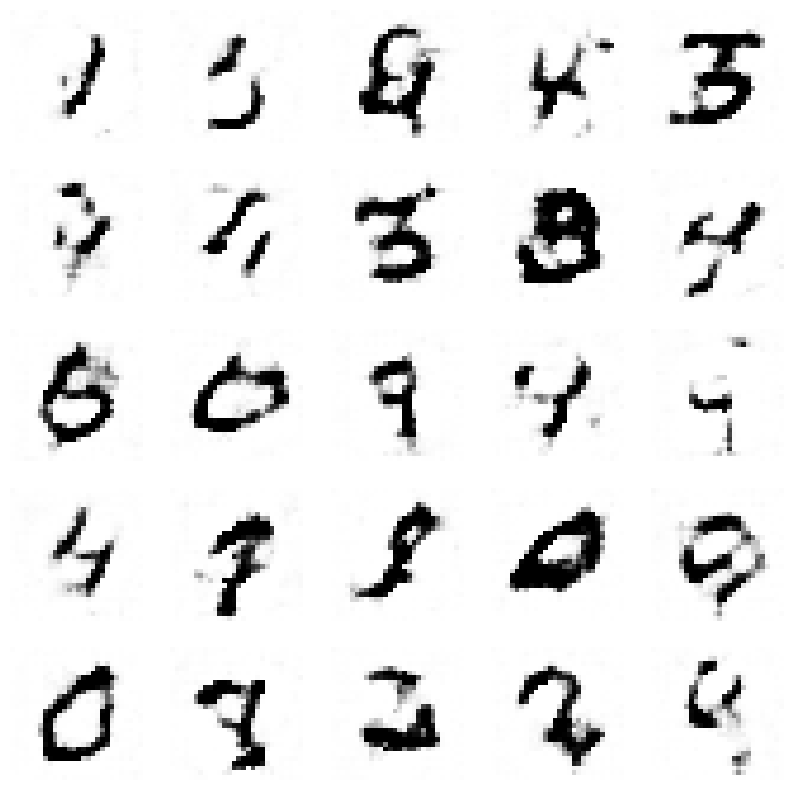

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5215714065692364, Generator Loss 1.417499644634051
1/1 [==============================] - 0s 27ms/step


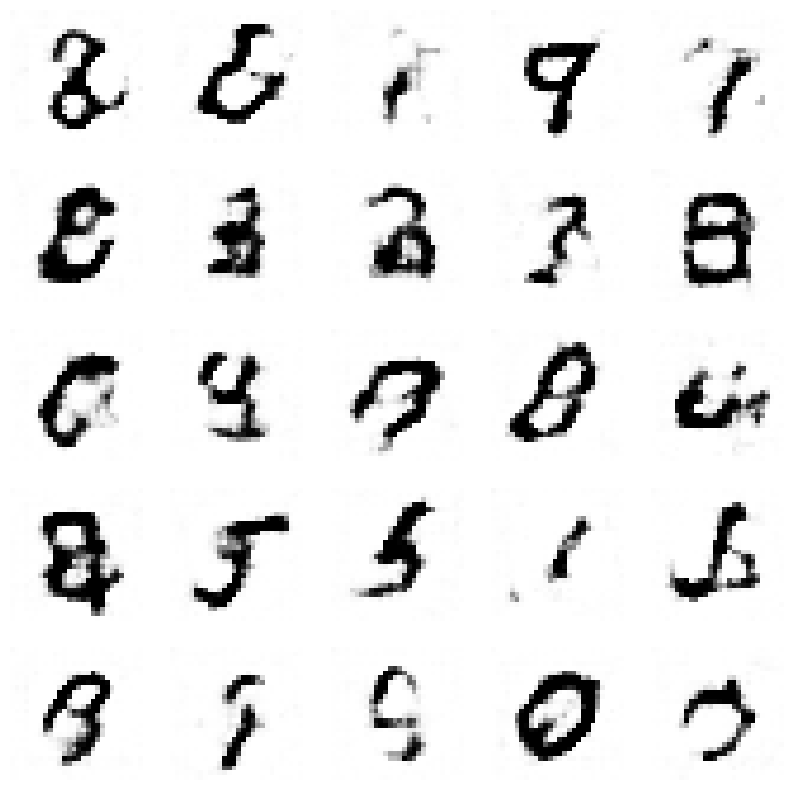

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.524217372903457, Generator Loss 1.4237463326535673
1/1 [==============================] - 0s 42ms/step


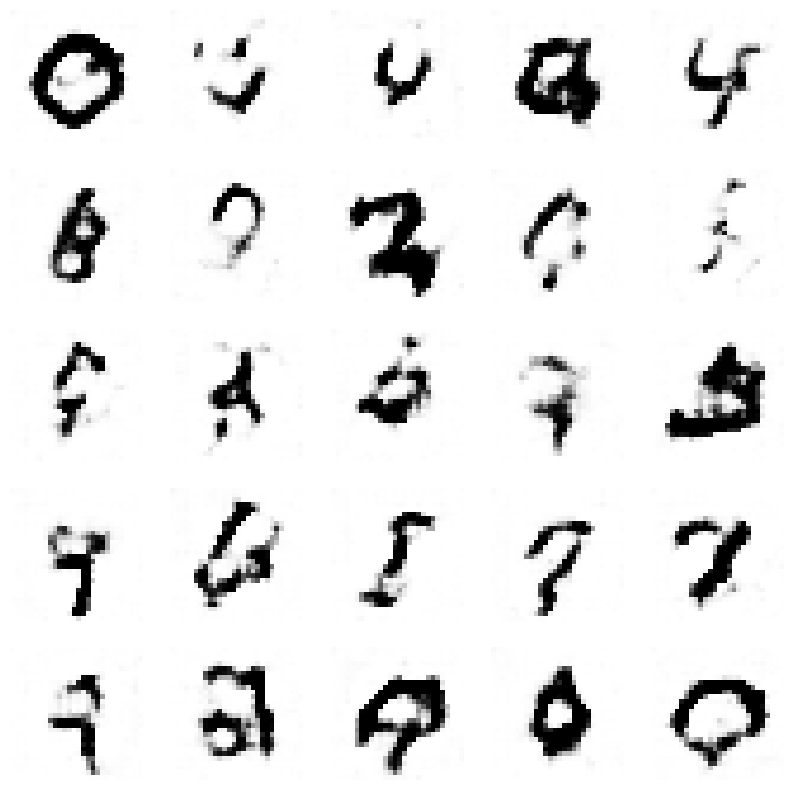

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5268032176372333, Generator Loss 1.430264881023994
1/1 [==============================] - 0s 27ms/step


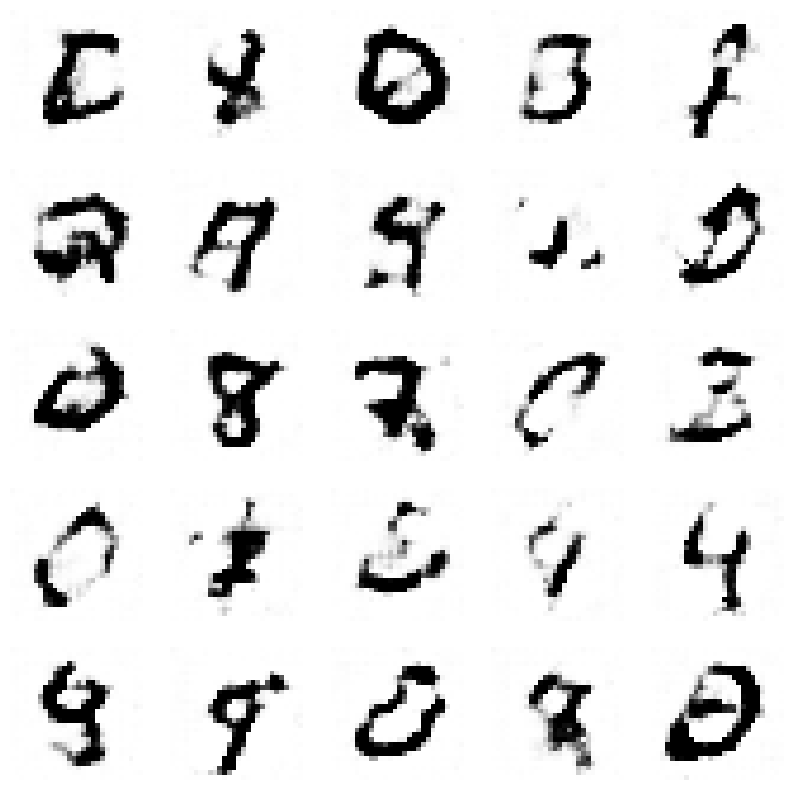

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.529646170954419, Generator Loss 1.4370880111669884
1/1 [==============================] - 0s 28ms/step


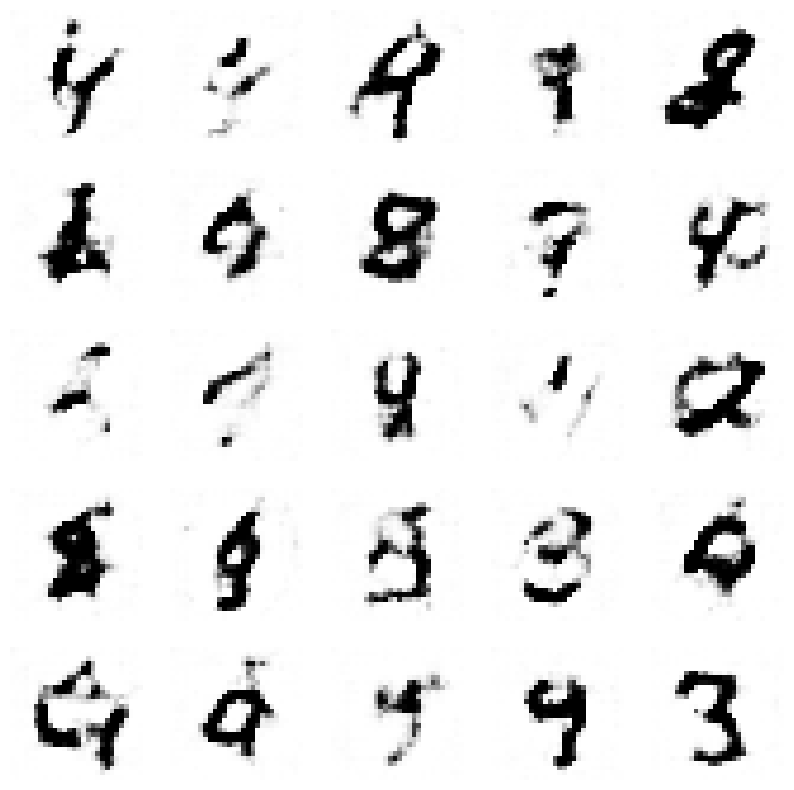

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5325726424781685, Generator Loss 1.443569055479816
1/1 [==============================] - 0s 27ms/step


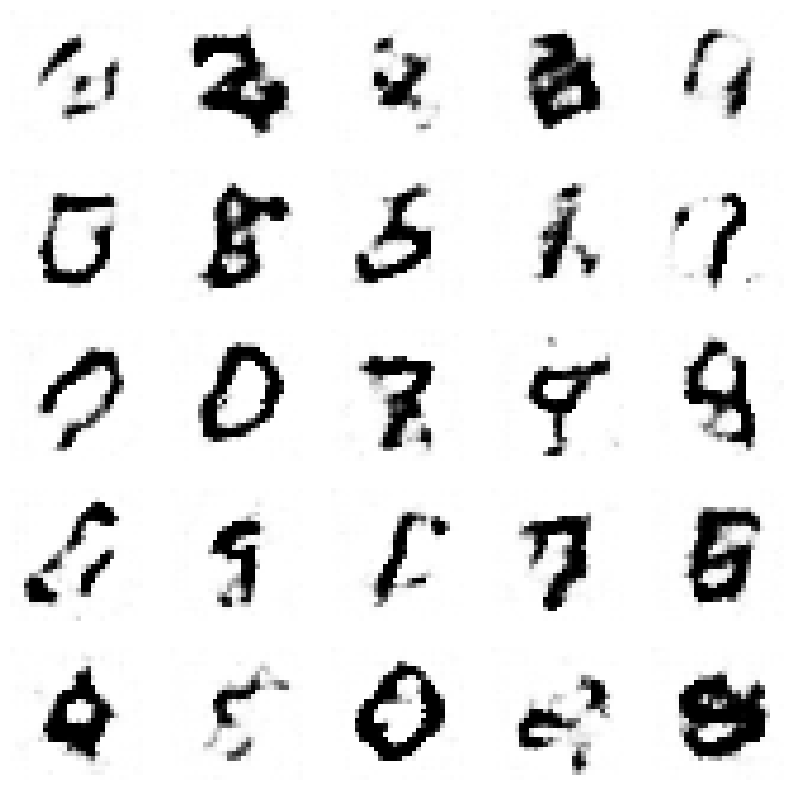

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5352223014984375, Generator Loss 1.4500921689547026
1/1 [==============================] - 0s 26ms/step


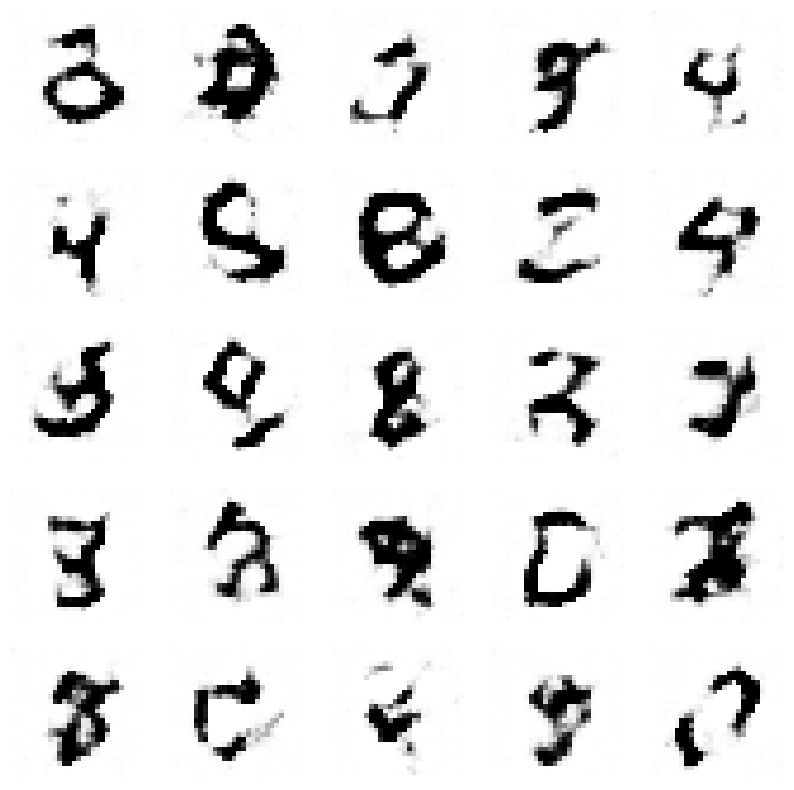

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5378236200055505, Generator Loss 1.456637836419619
1/1 [==============================] - 0s 34ms/step


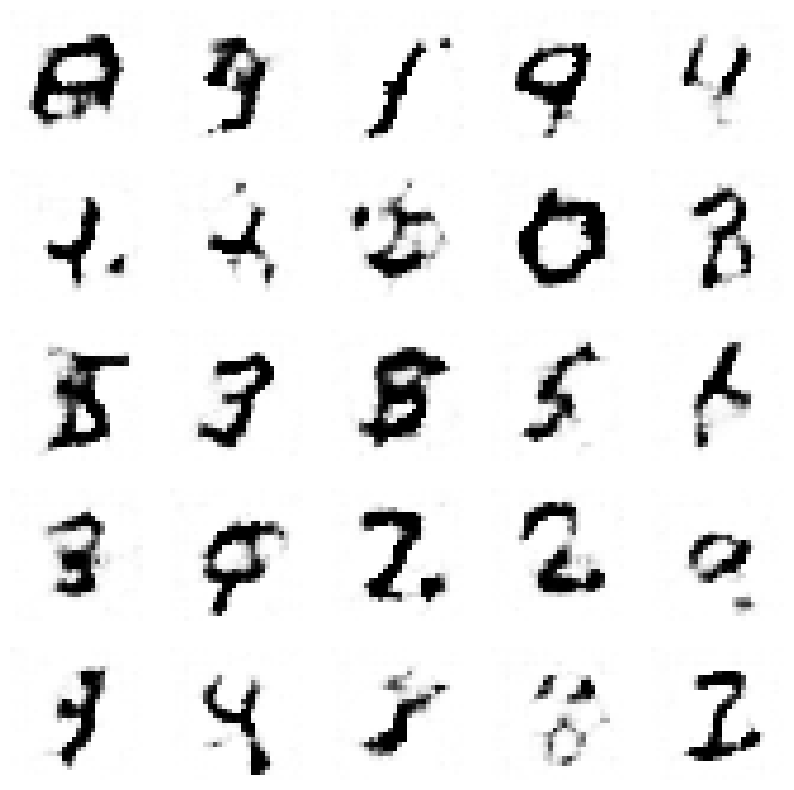

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5404546952400452, Generator Loss 1.4631495480863457
1/1 [==============================] - 0s 27ms/step


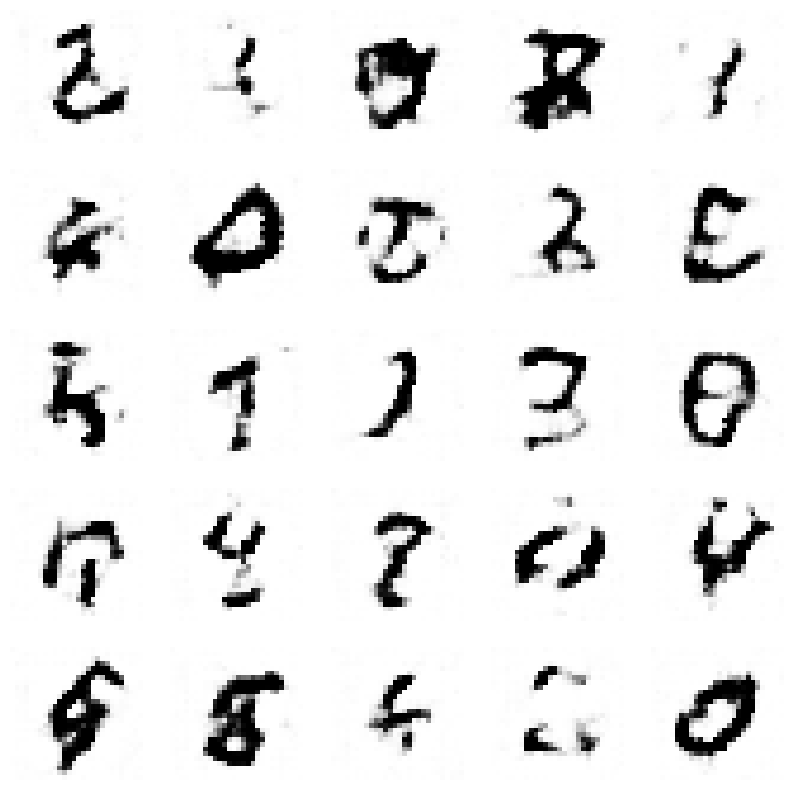

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.54302843227091, Generator Loss 1.4697856459862146
1/1 [==============================] - 0s 26ms/step


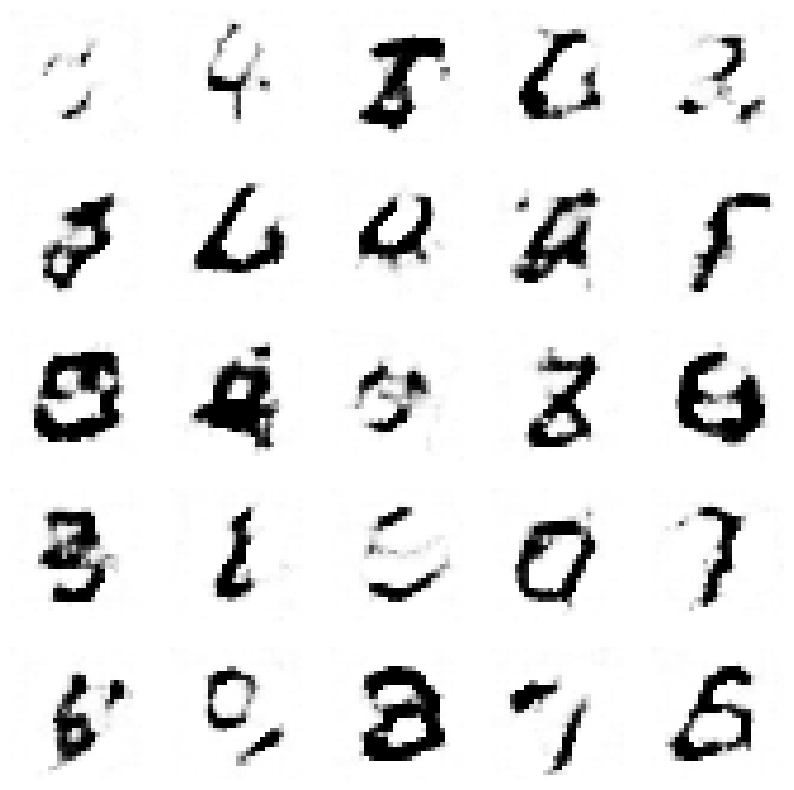

4/4 [==============================] - 0s 7ms/step
Epoch 5, Disc loss 0.545726545027688, Generator Loss 1.4759047734431732
1/1 [==============================] - 0s 36ms/step


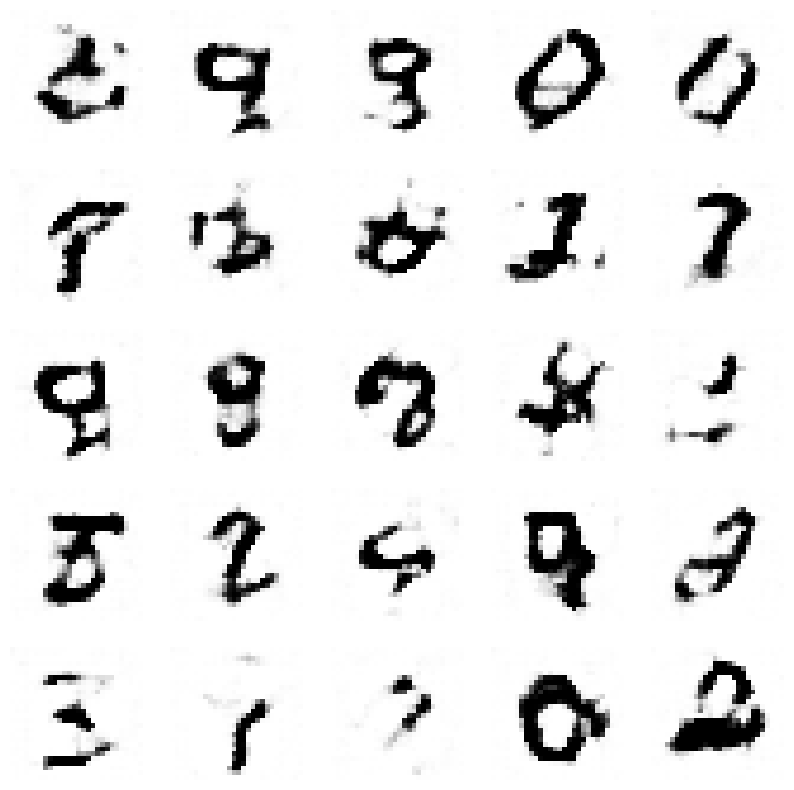

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5484484958215656, Generator Loss 1.4820221249873822
1/1 [==============================] - 0s 56ms/step


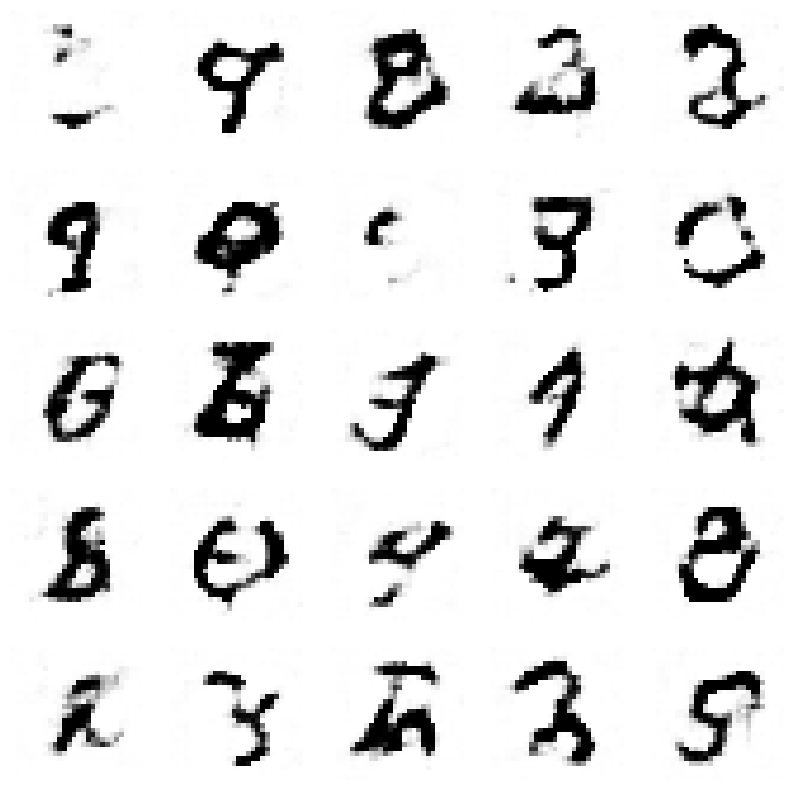

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5510322405104964, Generator Loss 1.4883957240316603
1/1 [==============================] - 0s 30ms/step


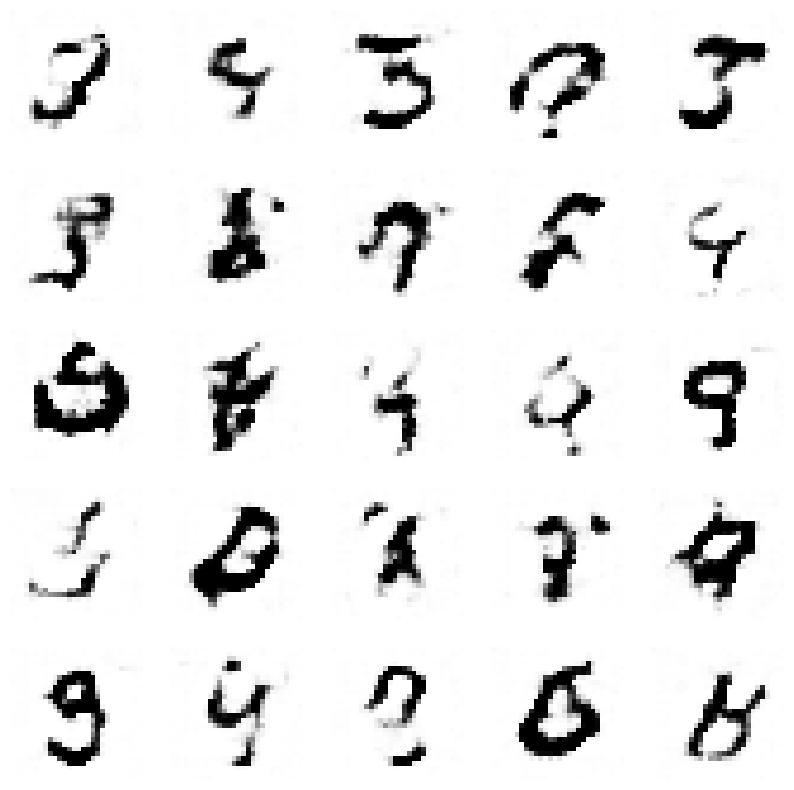

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.5536530237549391, Generator Loss 1.494749687675737
1/1 [==============================] - 0s 26ms/step


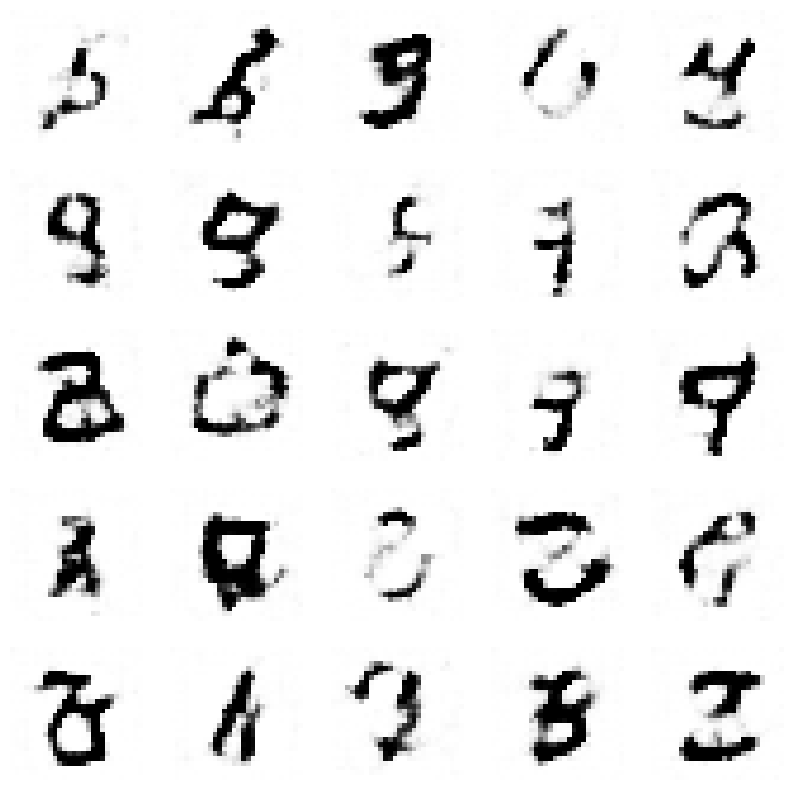

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5561609591046969, Generator Loss 1.50197725978672
1/1 [==============================] - 0s 31ms/step


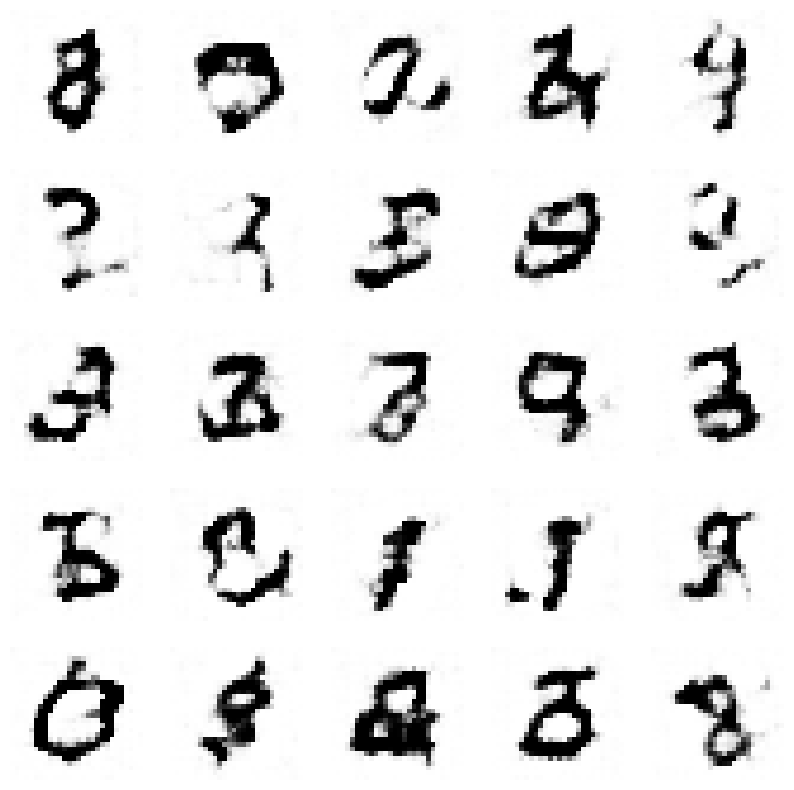

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.558898456267312, Generator Loss 1.50857837128843
1/1 [==============================] - 0s 30ms/step


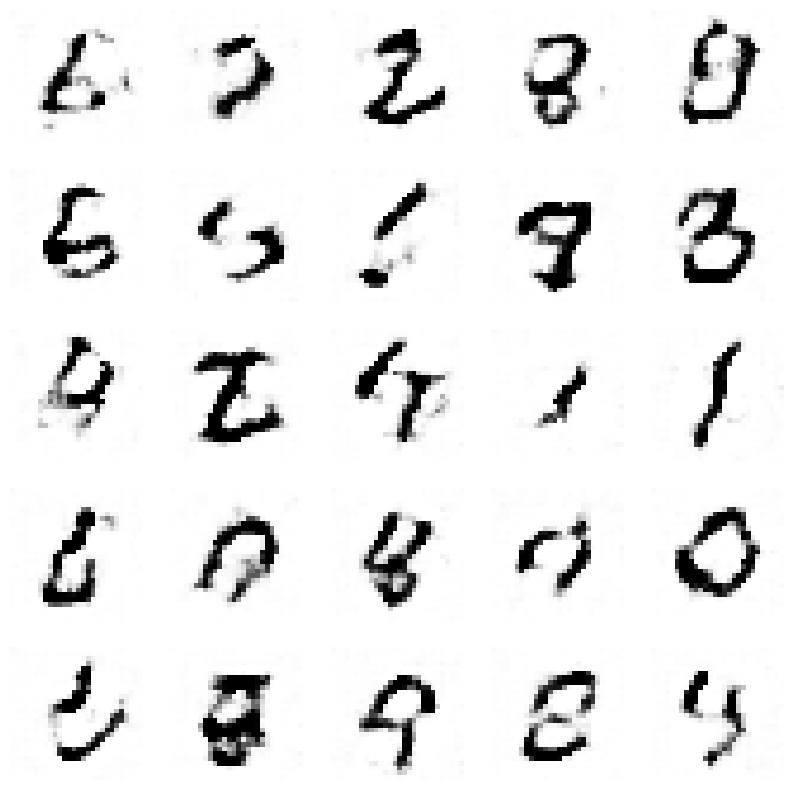

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5615704269108609, Generator Loss 1.5148921109672286
1/1 [==============================] - 0s 31ms/step


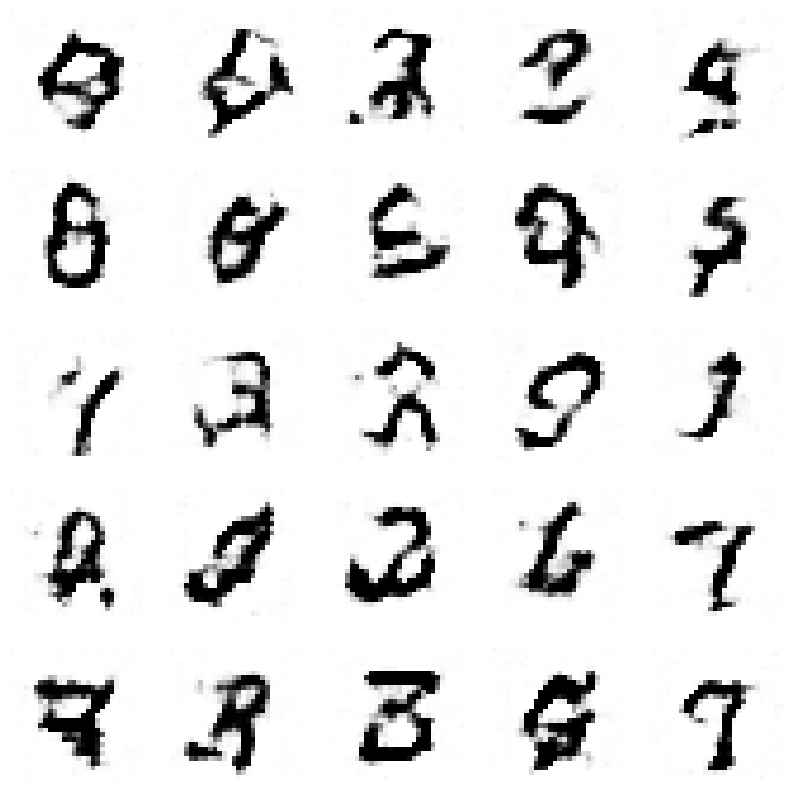

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5643153016765913, Generator Loss 1.5214360926905248
1/1 [==============================] - 0s 32ms/step


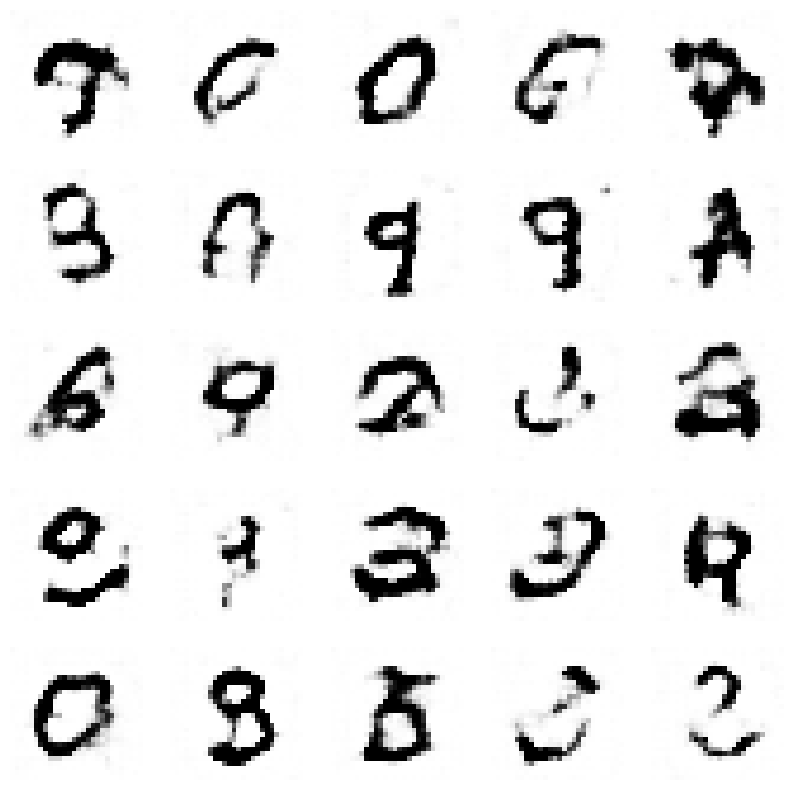

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5670388635789227, Generator Loss 1.5279376348878584
1/1 [==============================] - 0s 28ms/step


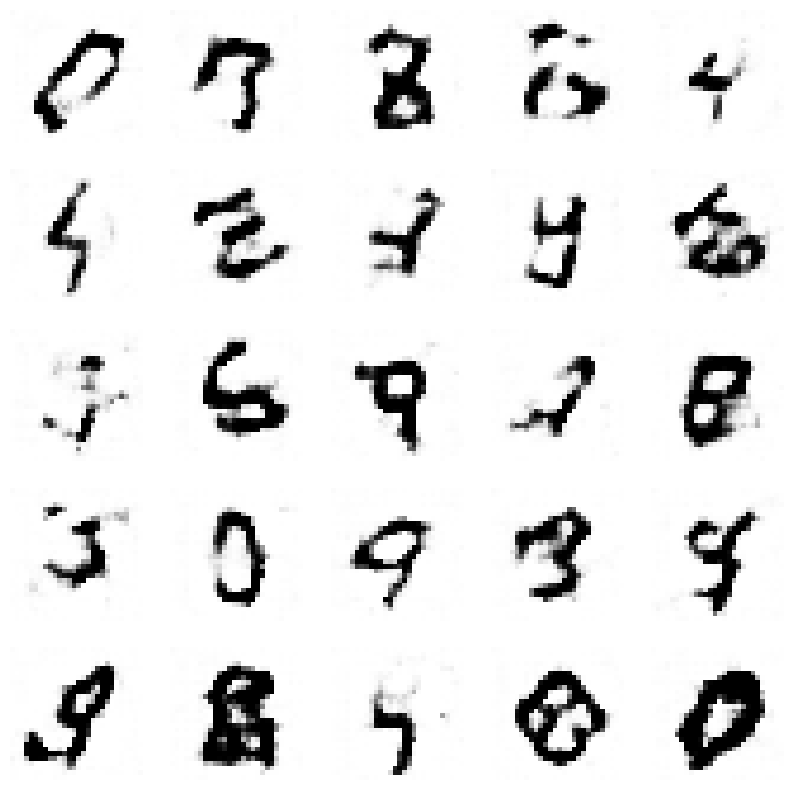

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.5696691628067921, Generator Loss 1.5343347354831858
1/1 [==============================] - 0s 27ms/step


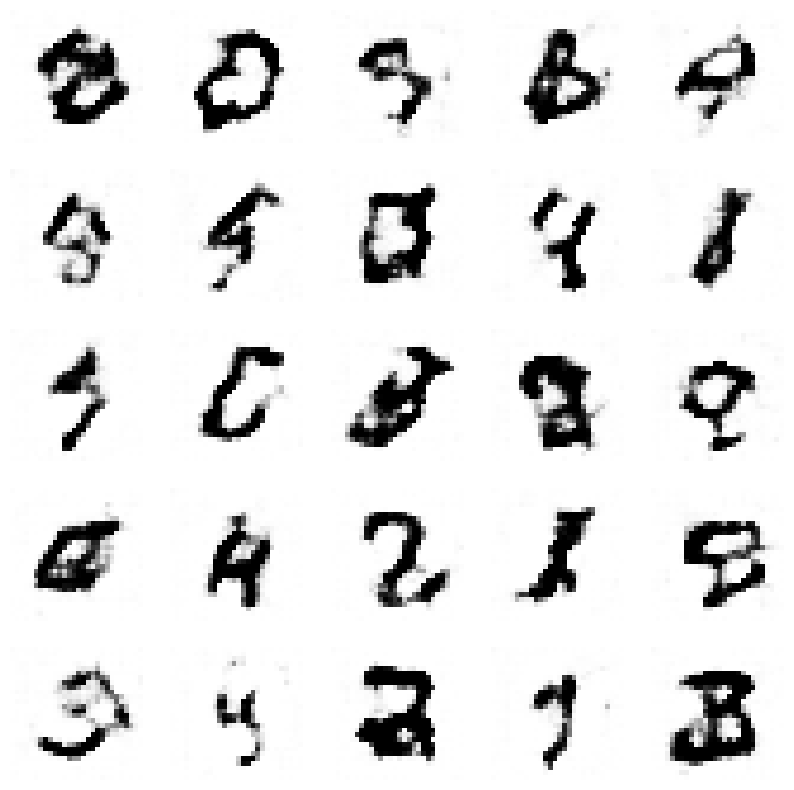

4/4 [==============================] - 0s 5ms/step
Epoch 5, Disc loss 0.5722339020198227, Generator Loss 1.5409768223762512
1/1 [==============================] - 0s 60ms/step


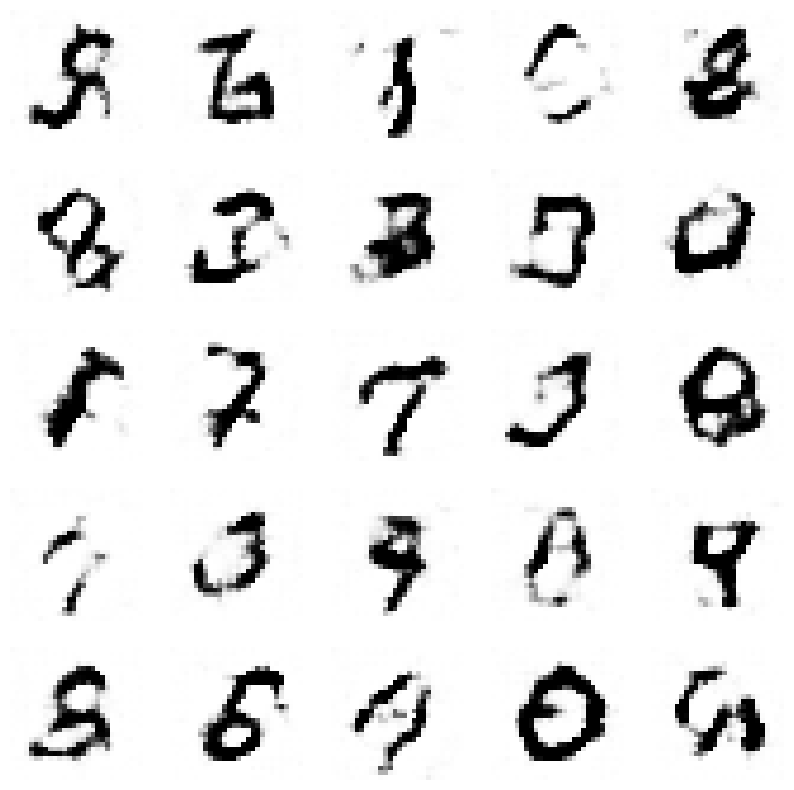

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.574834056198597, Generator Loss 1.547551455660763
1/1 [==============================] - 0s 38ms/step


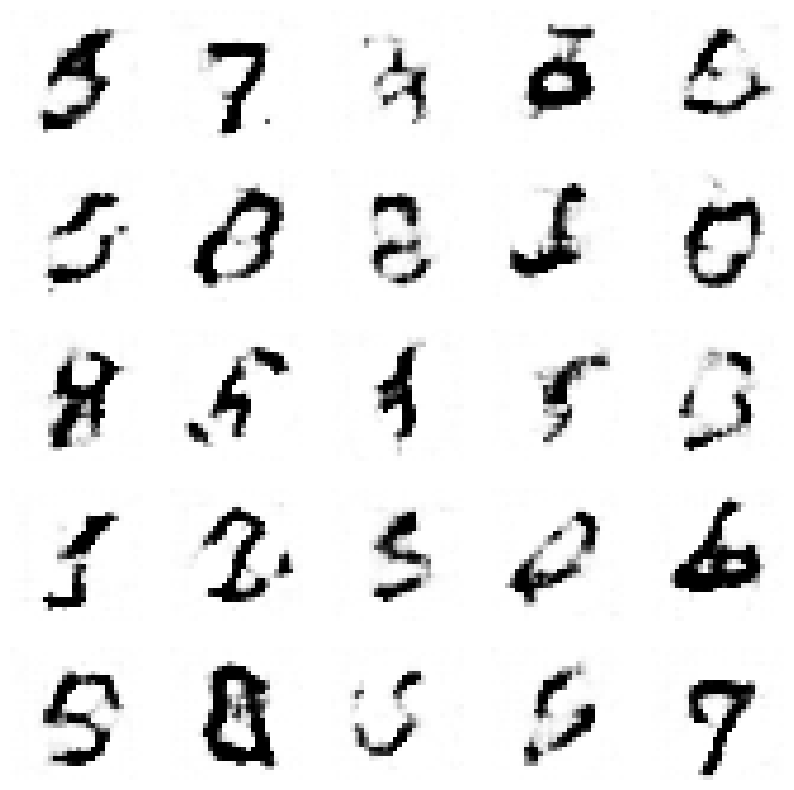

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5775378133114587, Generator Loss 1.5539230464870095
1/1 [==============================] - 0s 60ms/step


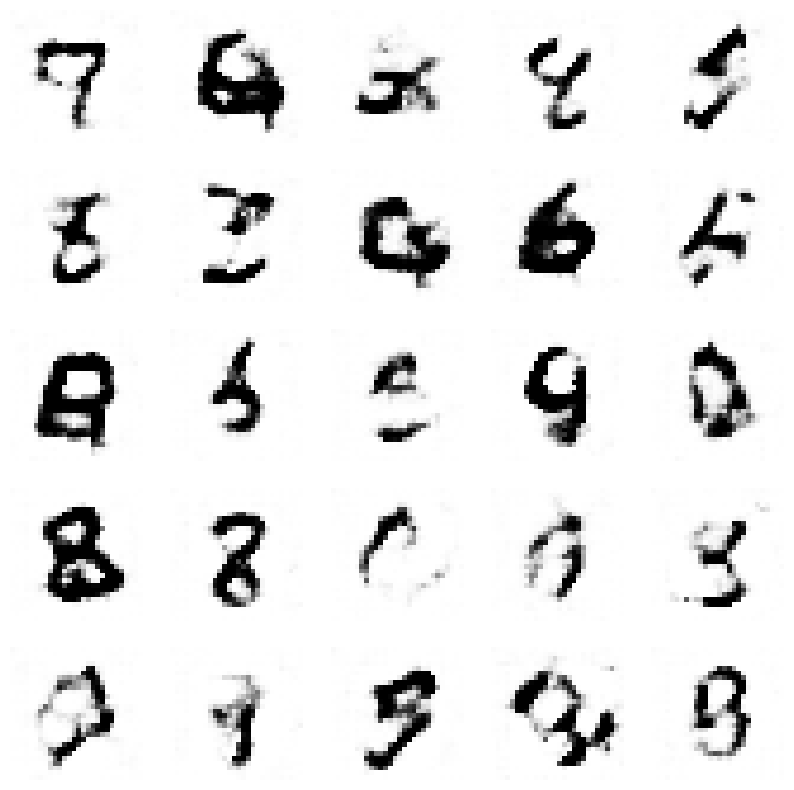

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5801595912402512, Generator Loss 1.5605236490567524
1/1 [==============================] - 0s 27ms/step


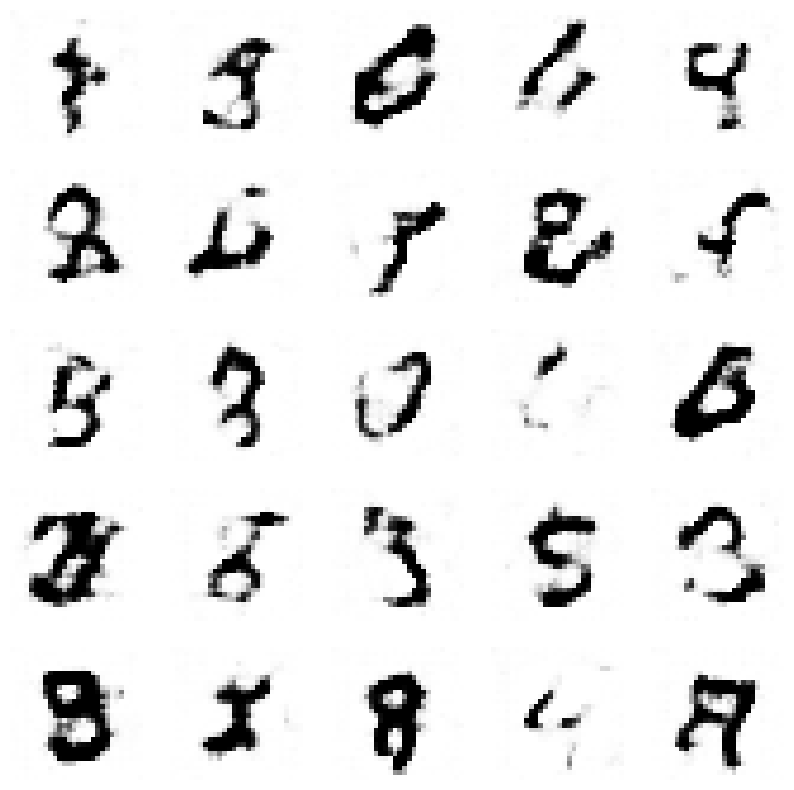

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5829086527228355, Generator Loss 1.5672747268636003
1/1 [==============================] - 0s 26ms/step


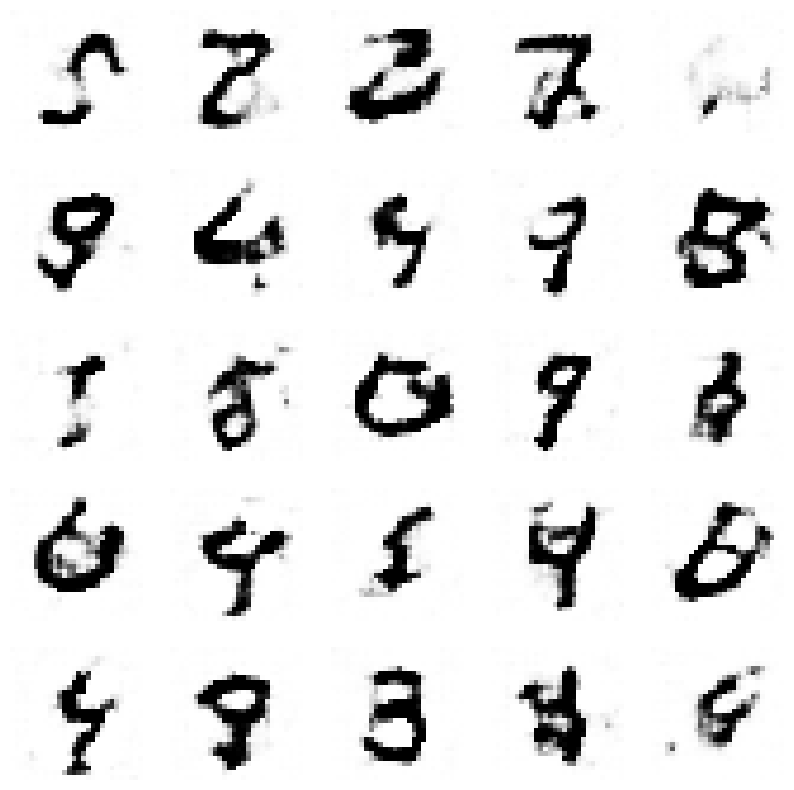

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5857230169523475, Generator Loss 1.5736287200552785
1/1 [==============================] - 0s 30ms/step


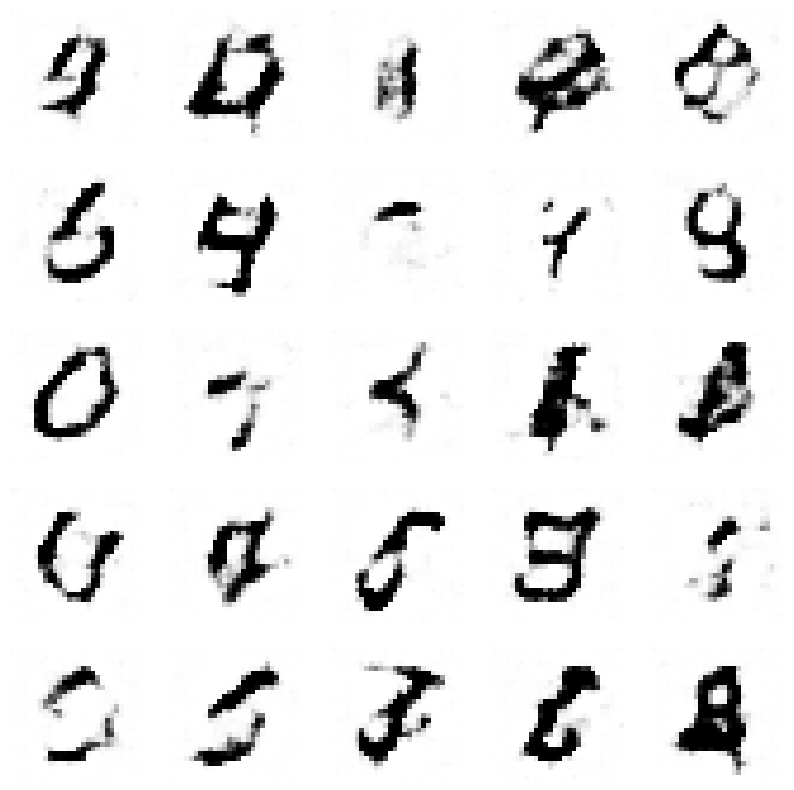

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5884680569044545, Generator Loss 1.579797042740716
1/1 [==============================] - 0s 28ms/step


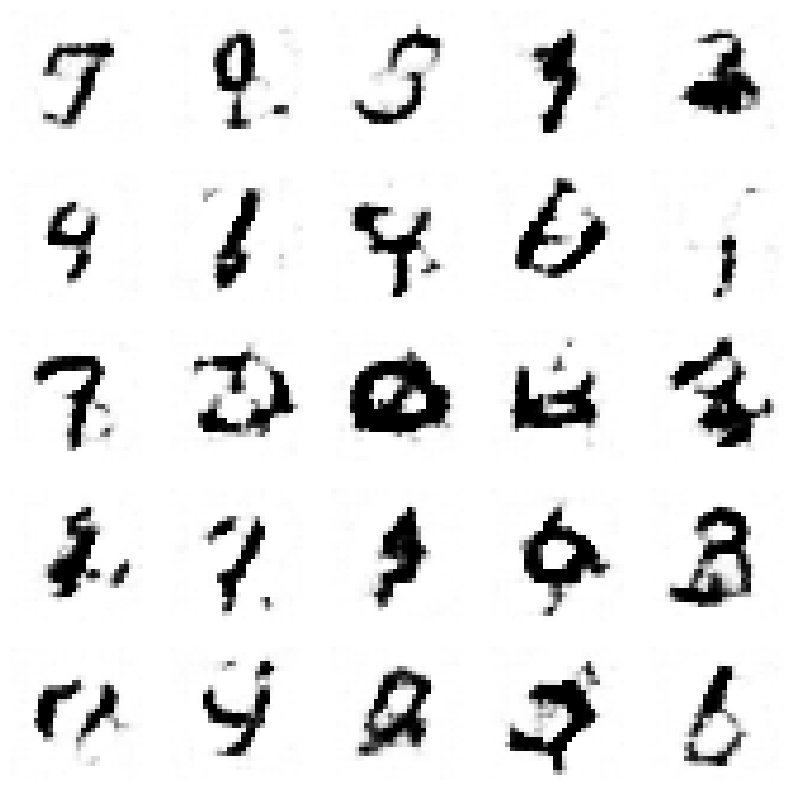

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5912173733624637, Generator Loss 1.5861422124072018
1/1 [==============================] - 0s 27ms/step


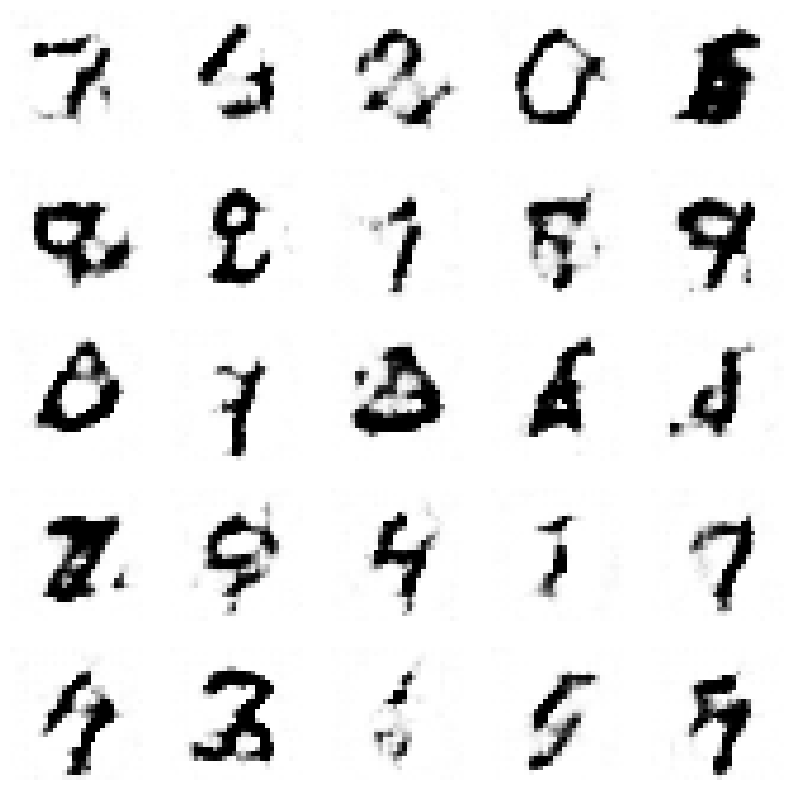

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5938411491930994, Generator Loss 1.5926457933890514
1/1 [==============================] - 0s 27ms/step


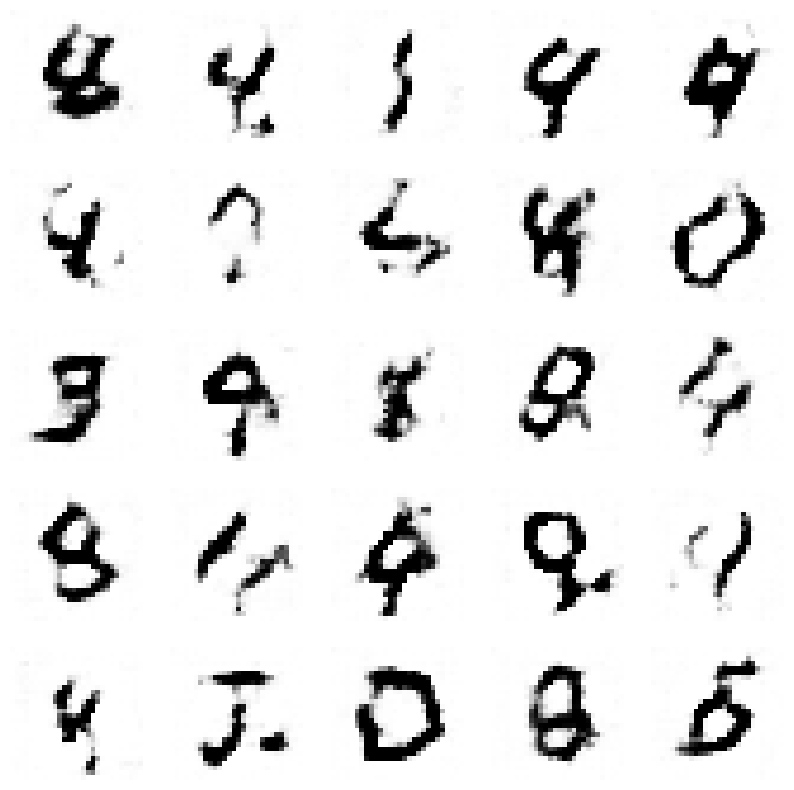

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5963936577367986, Generator Loss 1.5992997309081576
1/1 [==============================] - 0s 29ms/step


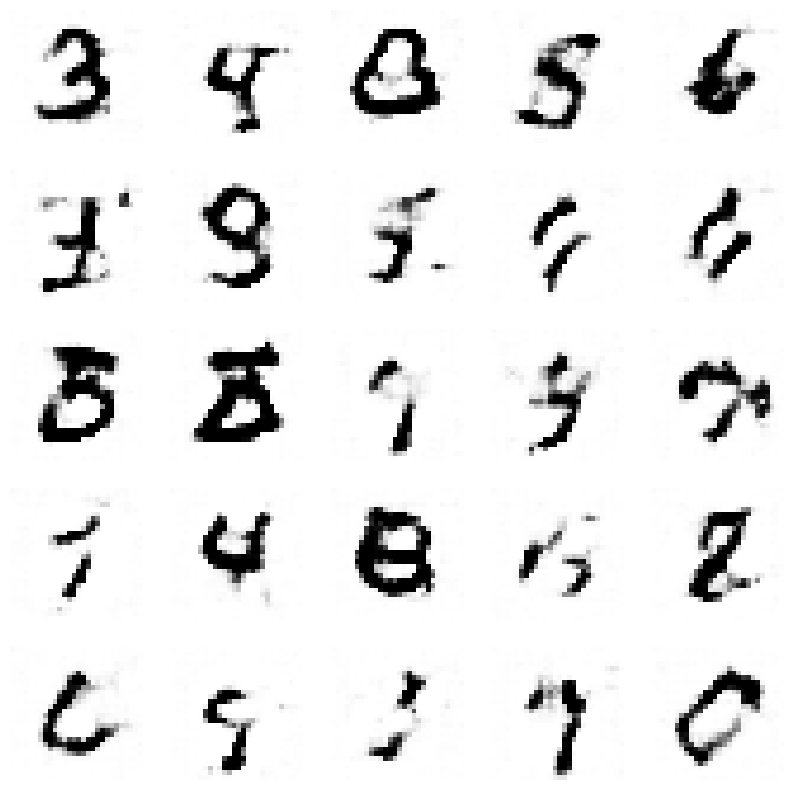

4/4 [==============================] - 0s 3ms/step
Epoch 5, Disc loss 0.5990852649267923, Generator Loss 1.6057387315309966
1/1 [==============================] - 0s 25ms/step


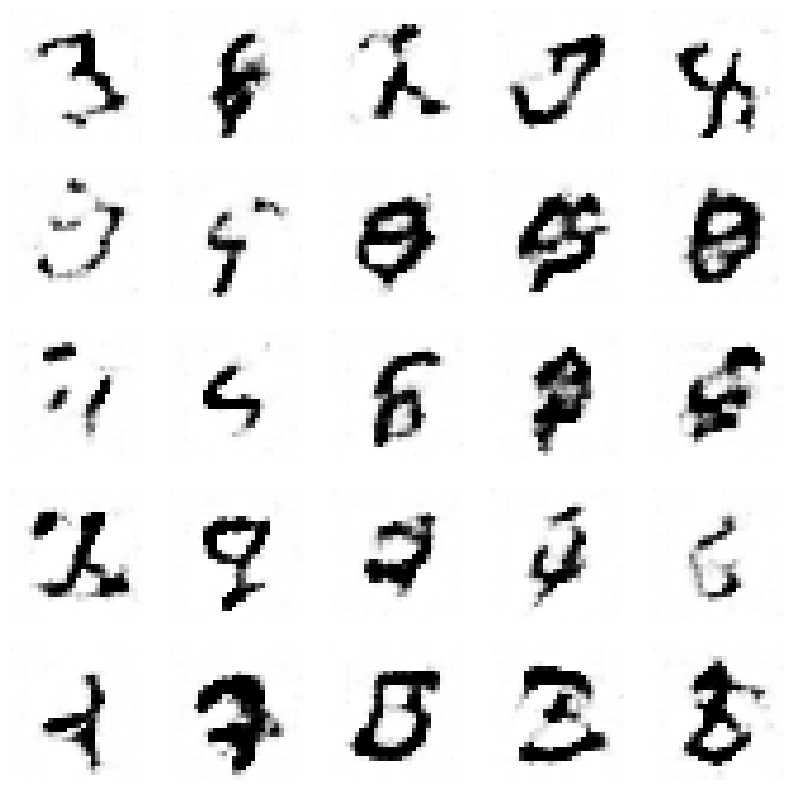

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.6016689887286252, Generator Loss 1.6121834883323083
1/1 [==============================] - 0s 57ms/step


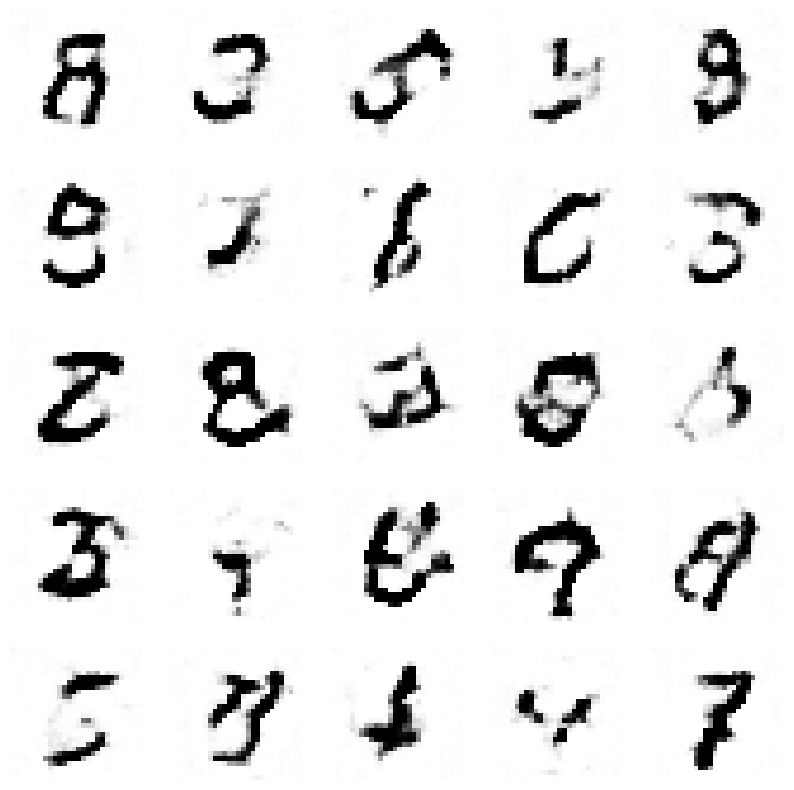

4/4 [==============================] - 0s 4ms/step
Epoch 5, Disc loss 0.6044581016032105, Generator Loss 1.6189616123835247
1/1 [==============================] - 0s 30ms/step


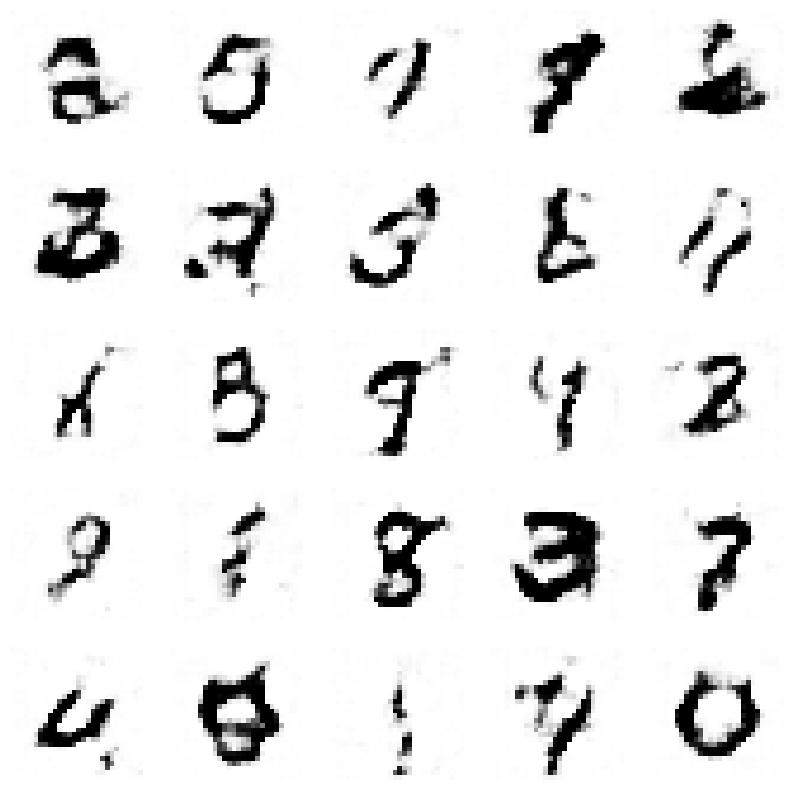

4/4 [==============================] - 0s 3ms/step
Epoch 6, Disc loss 0.0026153289100043792, Generator Loss 0.006579079689123692
4/4 [==============================] - 0s 4ms/step
Epoch 6, Disc loss 0.005438111913509858, Generator Loss 0.012409477152376093
4/4 [==============================] - 0s 4ms/step
Epoch 6, Disc loss 0.007846682754337277, Generator Loss 0.018660103663420066
4/4 [==============================] - 0s 4ms/step
Epoch 6, Disc loss 0.010409522132995801, Generator Loss 0.02522123471284524
4/4 [==============================] - 0s 3ms/step
Epoch 6, Disc loss 0.013234031888154836, Generator Loss 0.03126757980411888
4/4 [==============================] - 0s 3ms/step
Epoch 6, Disc loss 0.015967088632094555, Generator Loss 0.037431345536158636
4/4 [==============================] - 0s 3ms/step
Epoch 6, Disc loss 0.01858925895813184, Generator Loss 0.043790082136789955
4/4 [==============================] - 0s 3ms/step
Epoch 6, Disc loss 0.021183285002525035, Generator Loss

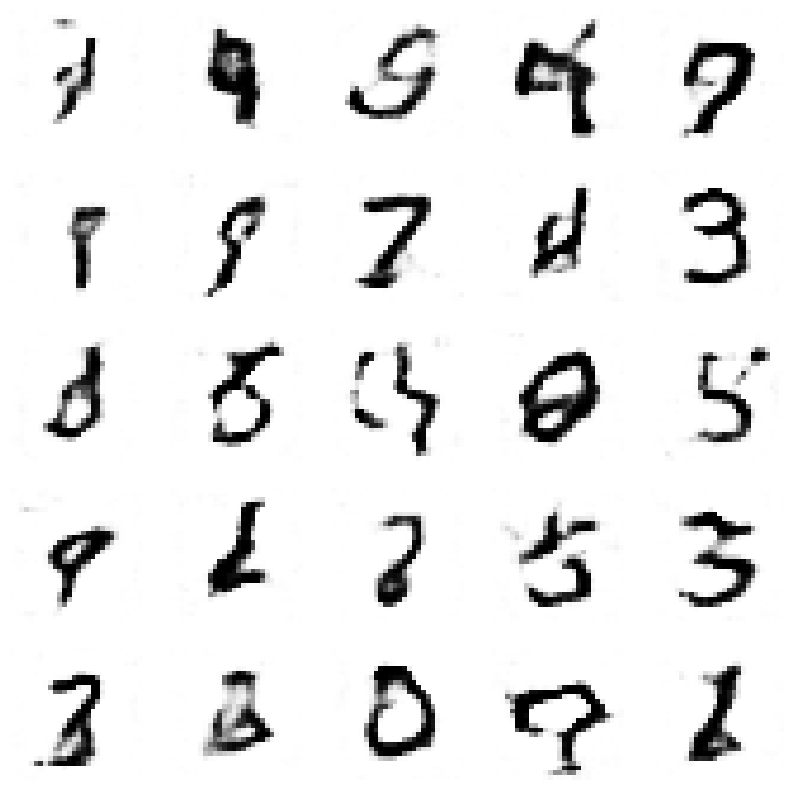

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.005725927714608673, Generator Loss 0.009354989752810225
1/1 [==============================] - 0s 33ms/step


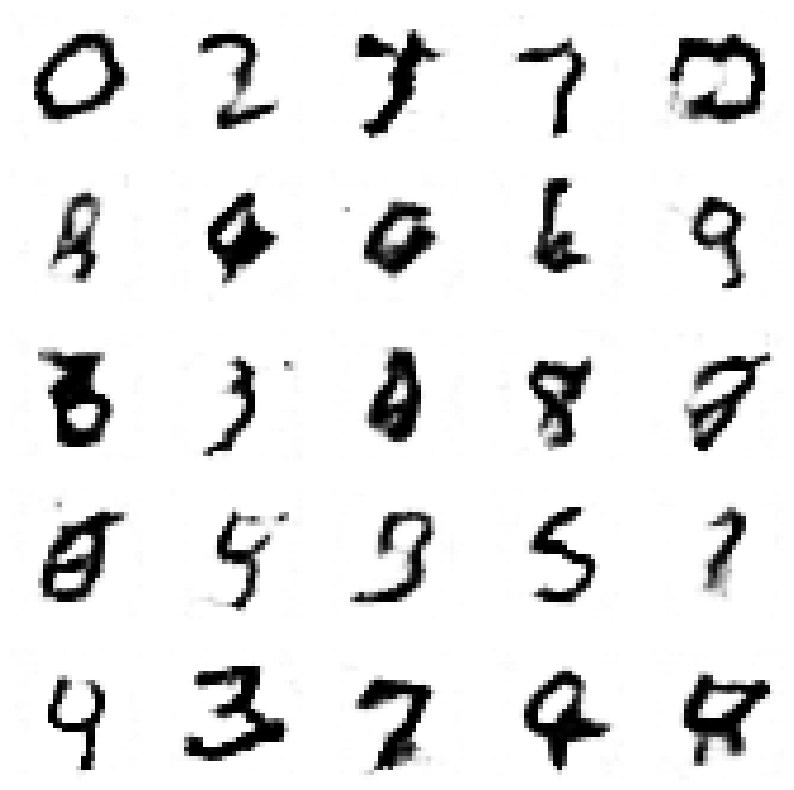

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.008556801921282059, Generator Loss 0.0142287994042421
1/1 [==============================] - 0s 40ms/step


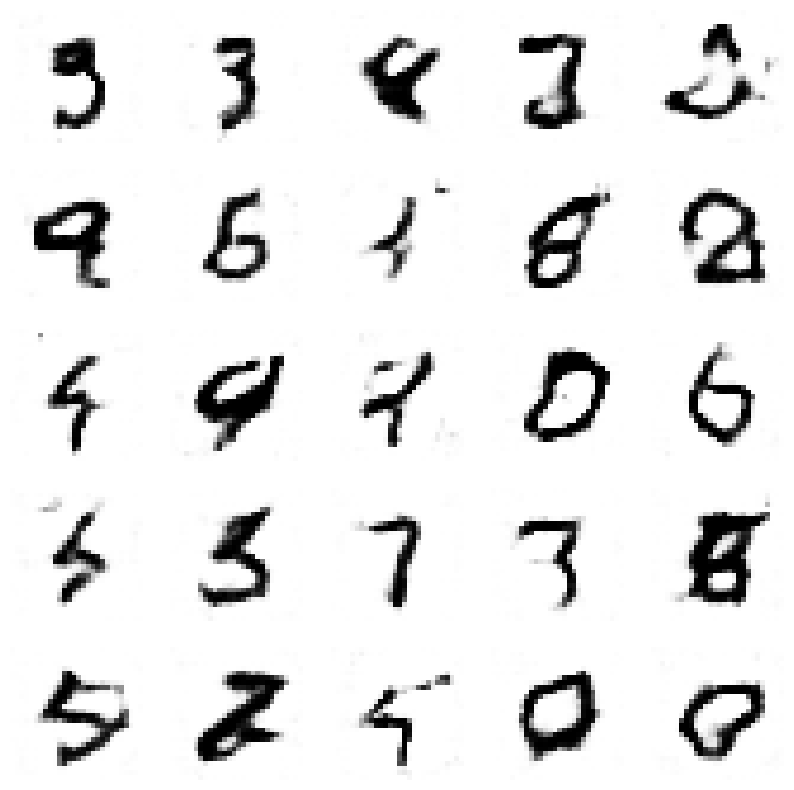

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.011408262145824922, Generator Loss 0.018925893001067333
1/1 [==============================] - 0s 30ms/step


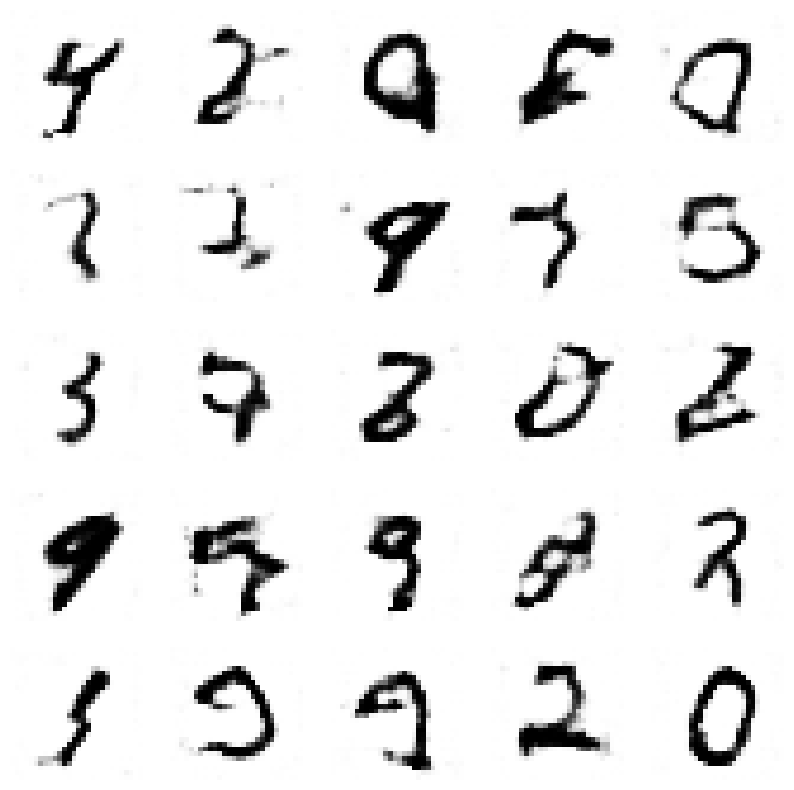

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.014339223504066467, Generator Loss 0.023826236398811013
1/1 [==============================] - 0s 27ms/step


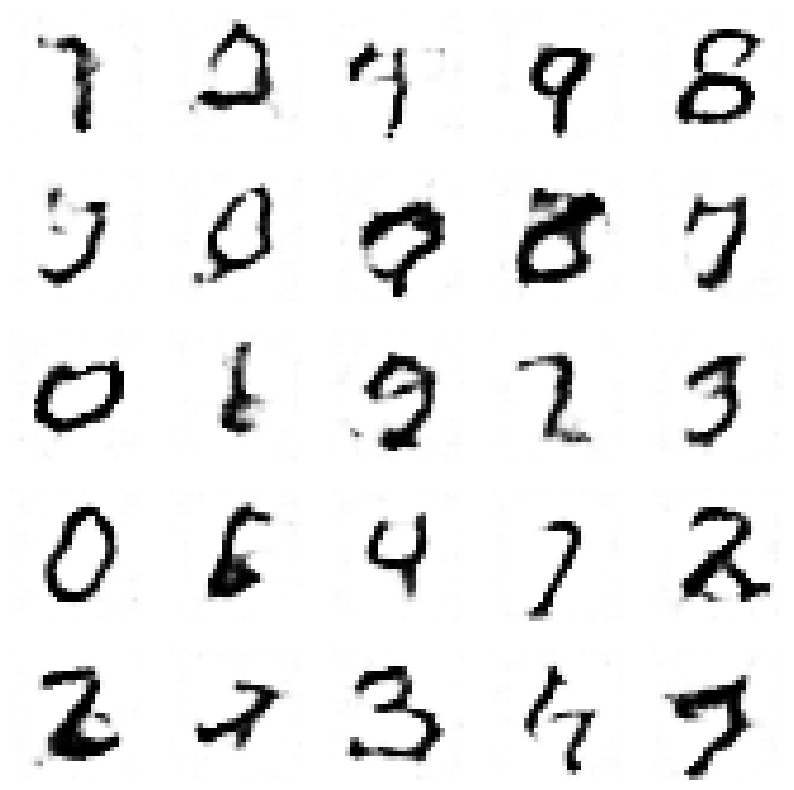

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.017227628419541906, Generator Loss 0.028817522729563918
1/1 [==============================] - 0s 31ms/step


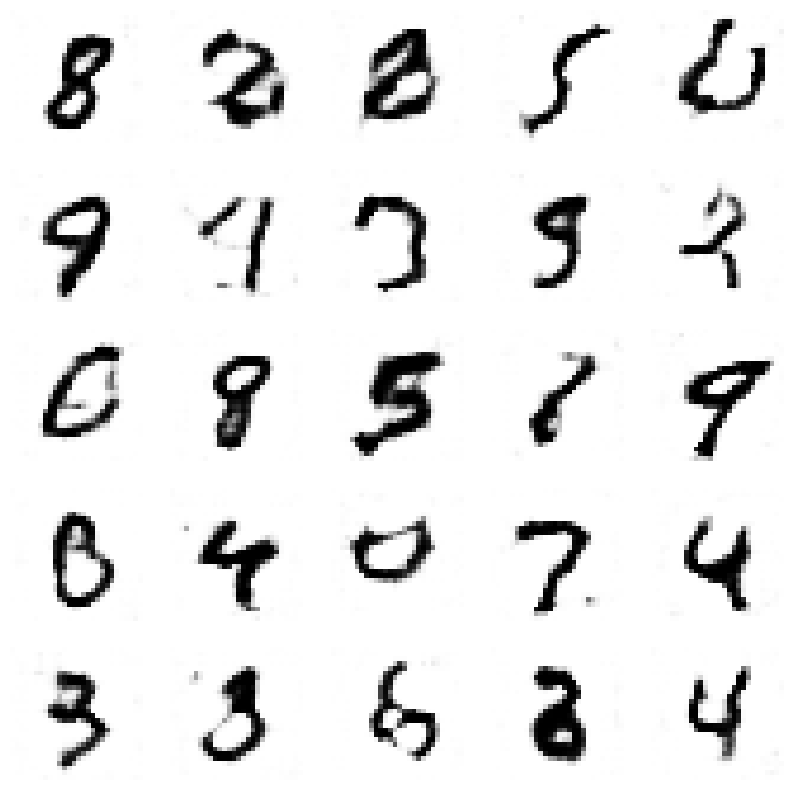

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.020160264566413358, Generator Loss 0.0338220988583361
1/1 [==============================] - 0s 30ms/step


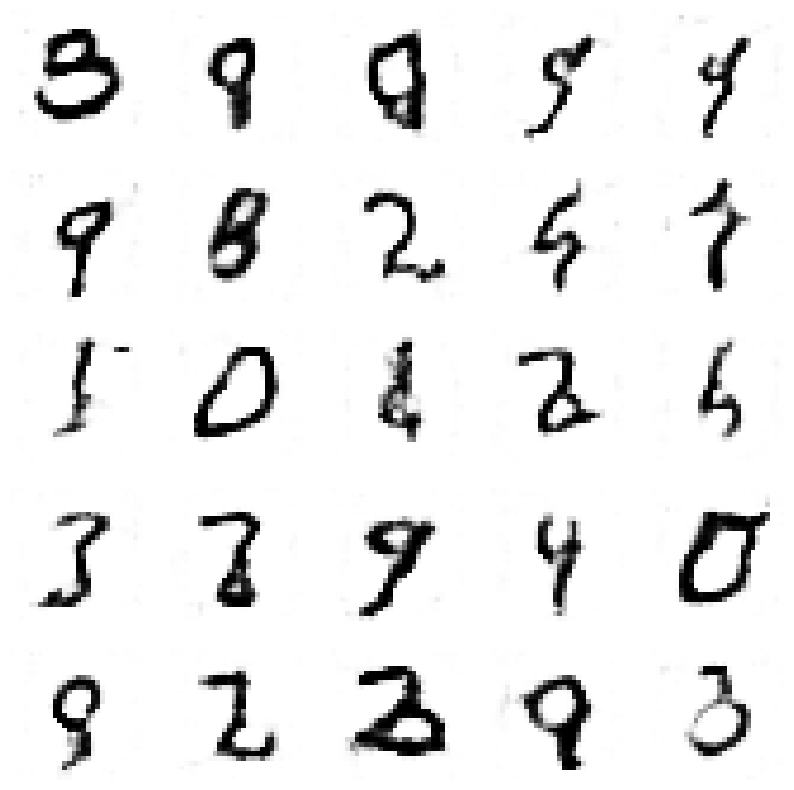

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.022895487582581676, Generator Loss 0.038685372752002165
1/1 [==============================] - 0s 30ms/step


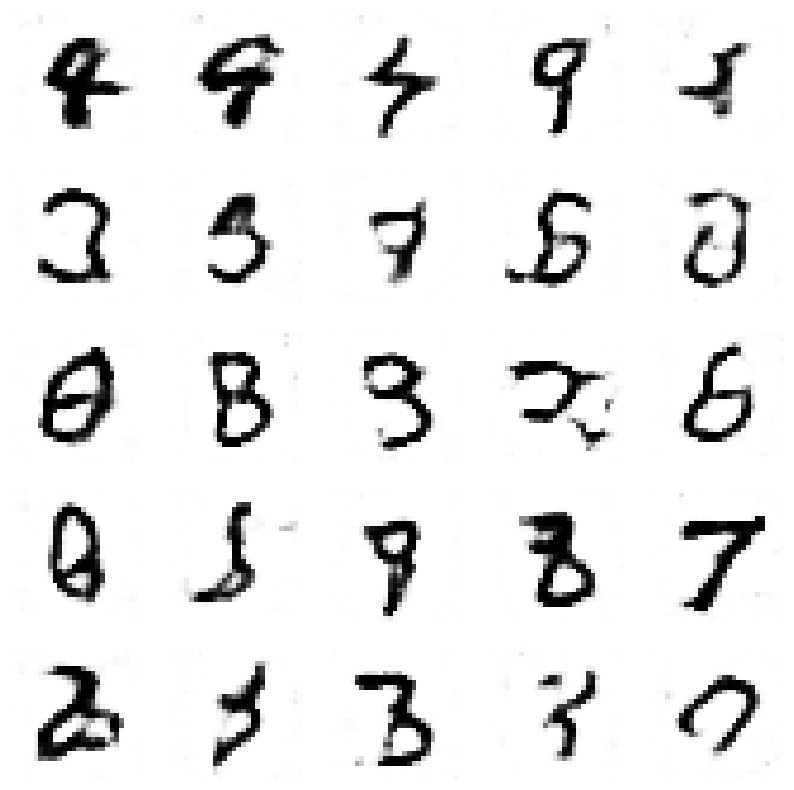

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.025914041405050162, Generator Loss 0.043396782671284474
1/1 [==============================] - 0s 30ms/step


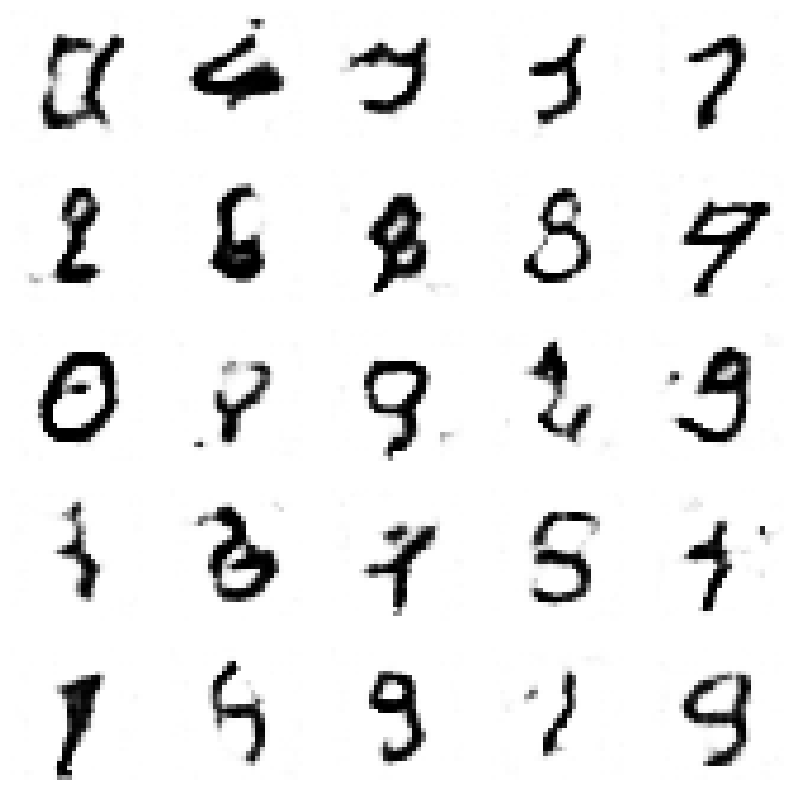

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.028770061257557992, Generator Loss 0.048169950134733804
1/1 [==============================] - 0s 27ms/step


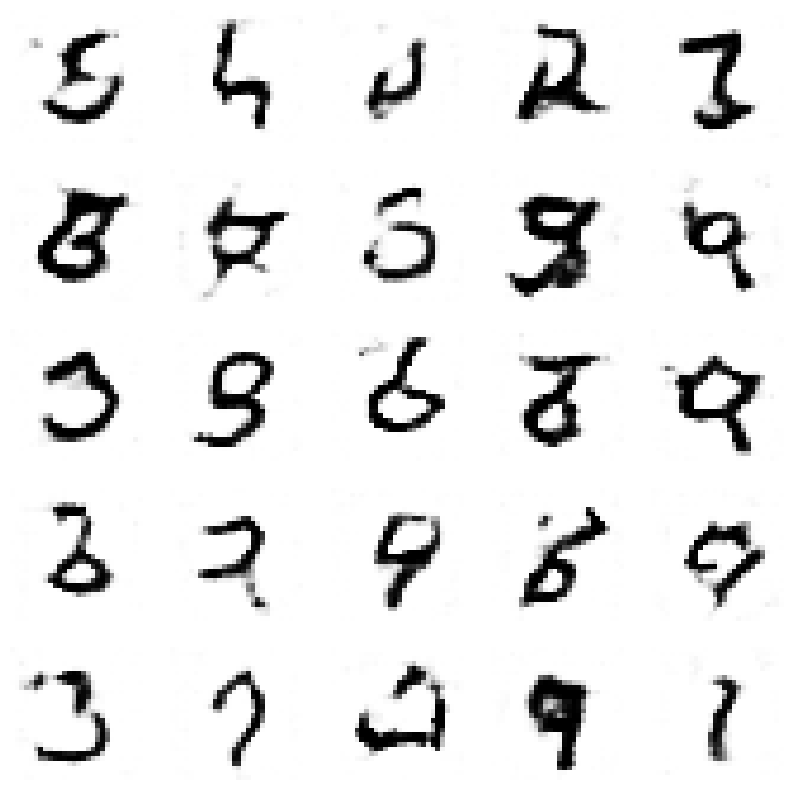

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.031417572218128756, Generator Loss 0.05300381142868955
1/1 [==============================] - 0s 28ms/step


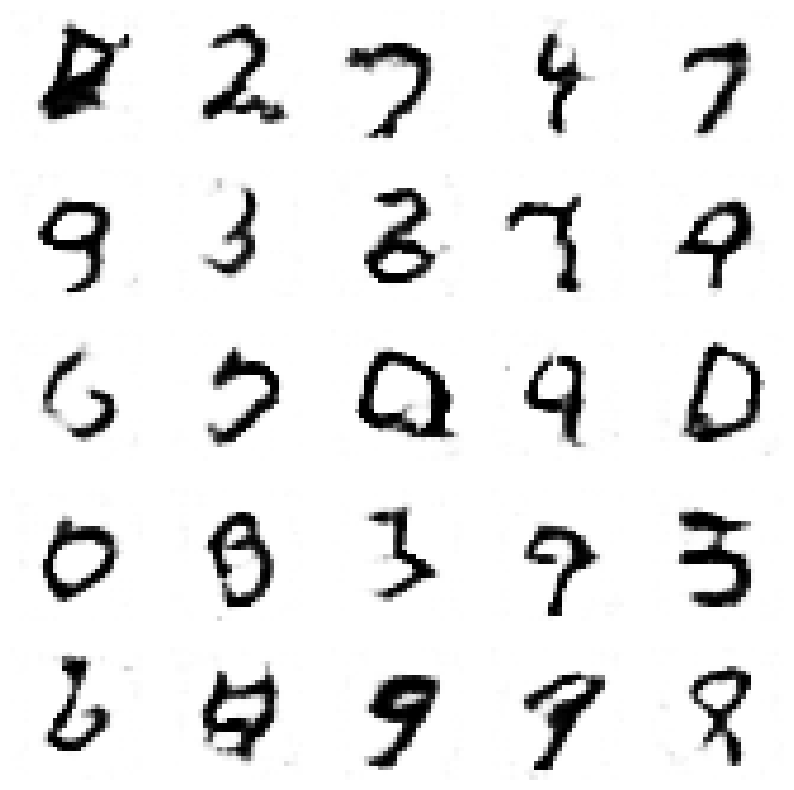

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.034278473792931974, Generator Loss 0.05785361263487074
1/1 [==============================] - 0s 43ms/step


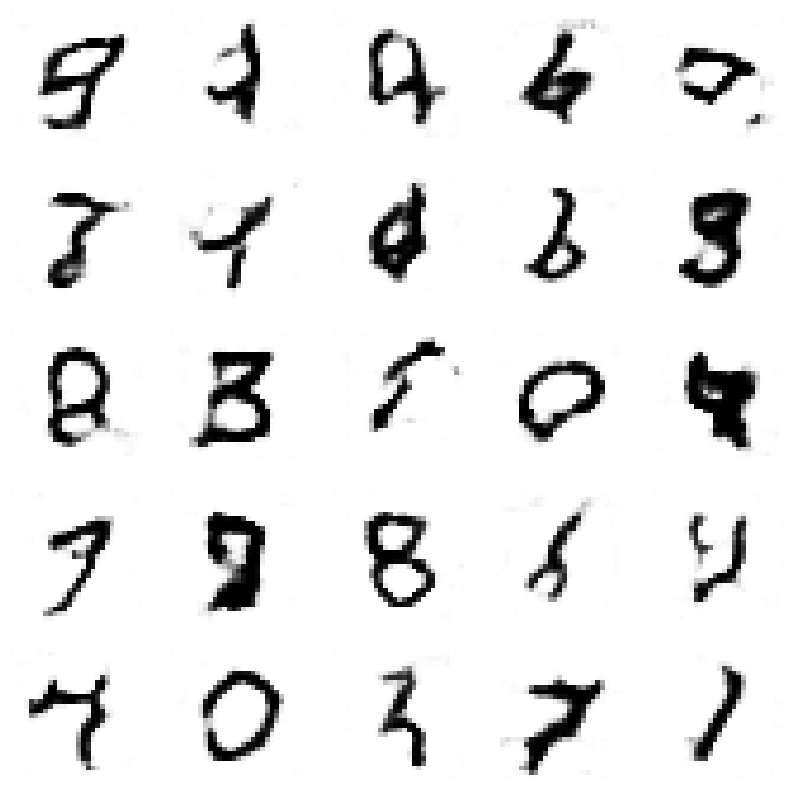

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.037153003307489246, Generator Loss 0.06270427836312188
1/1 [==============================] - 0s 29ms/step


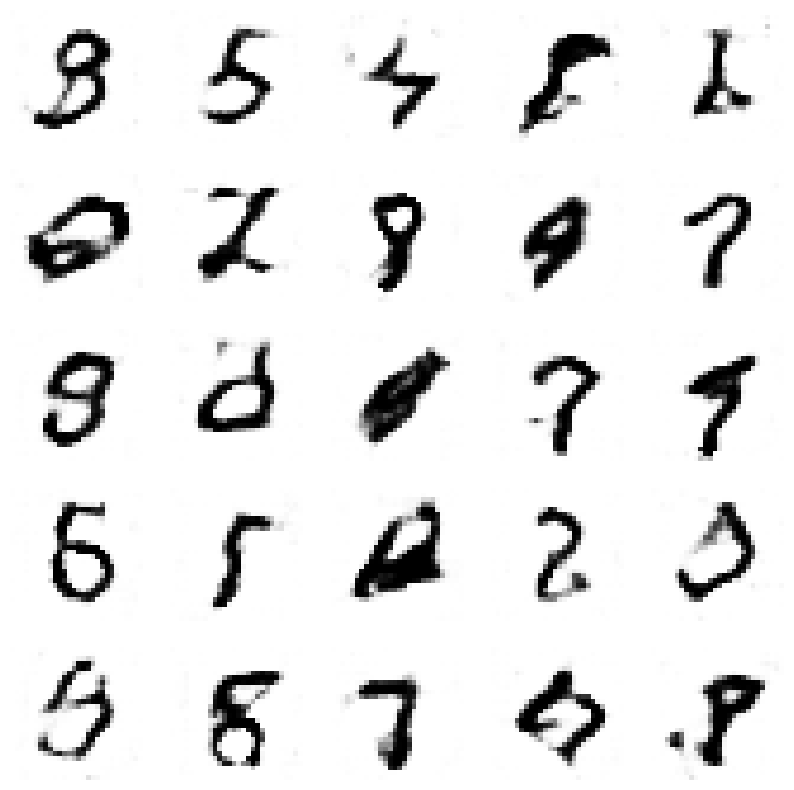

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.03997989890412388, Generator Loss 0.06758168110480675
1/1 [==============================] - 0s 39ms/step


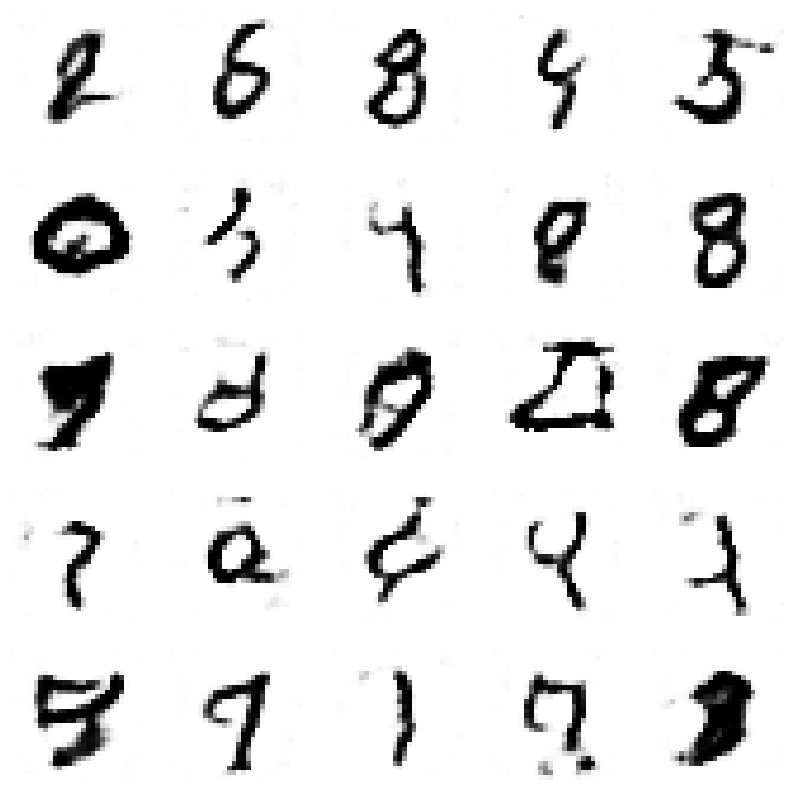

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.04285052418708801, Generator Loss 0.0725215474764506
1/1 [==============================] - 0s 27ms/step


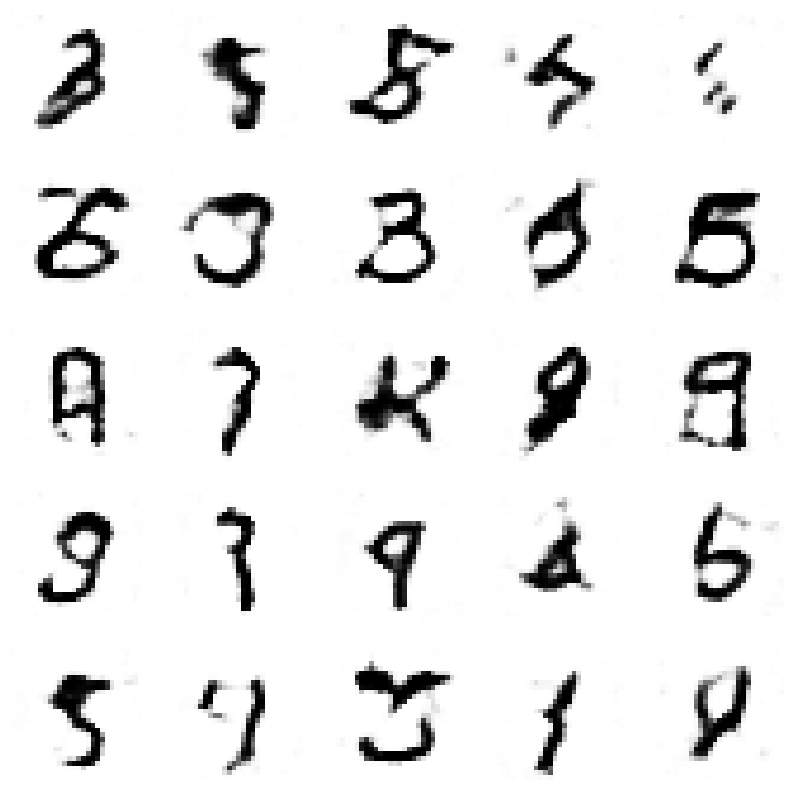

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.04560193788801503, Generator Loss 0.07745645851151556
1/1 [==============================] - 0s 32ms/step


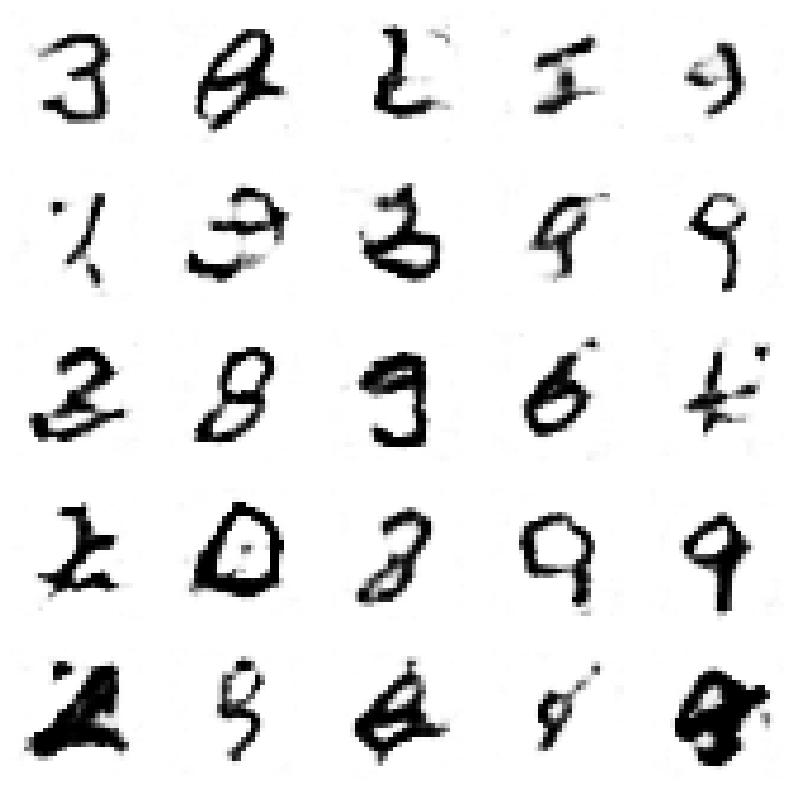

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.04842772914303674, Generator Loss 0.0821417957289606
1/1 [==============================] - 0s 31ms/step


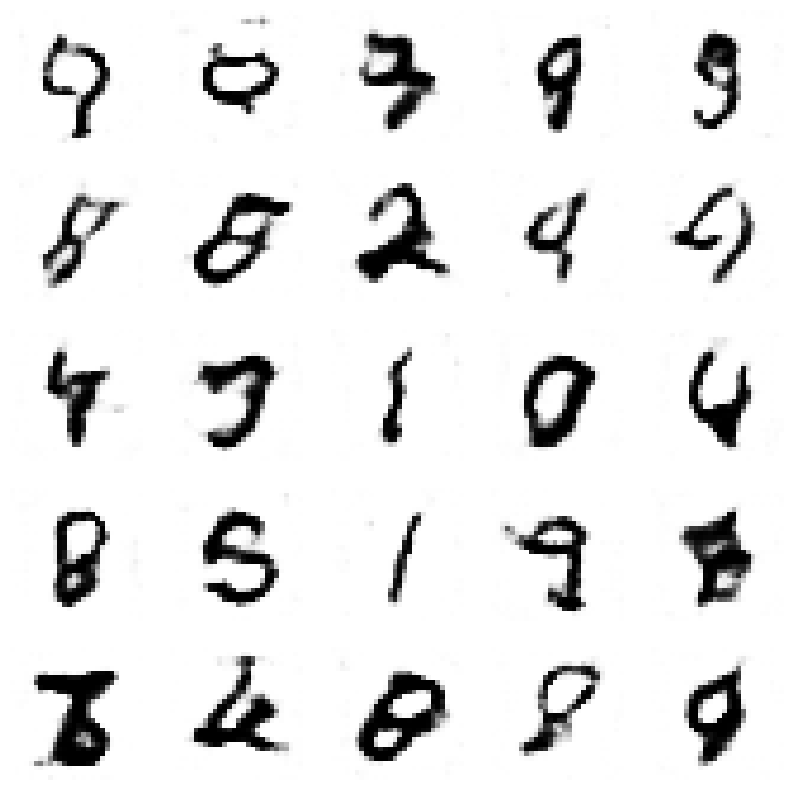

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.0512897001627164, Generator Loss 0.08693564447582278
1/1 [==============================] - 0s 26ms/step


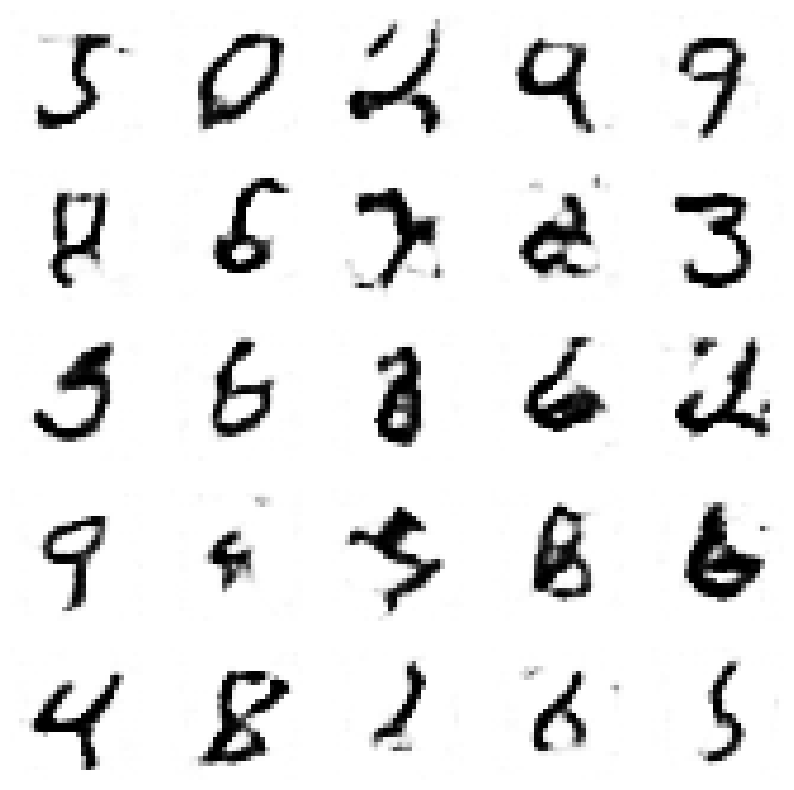

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.05415985739638663, Generator Loss 0.09177495984949617
1/1 [==============================] - 0s 29ms/step


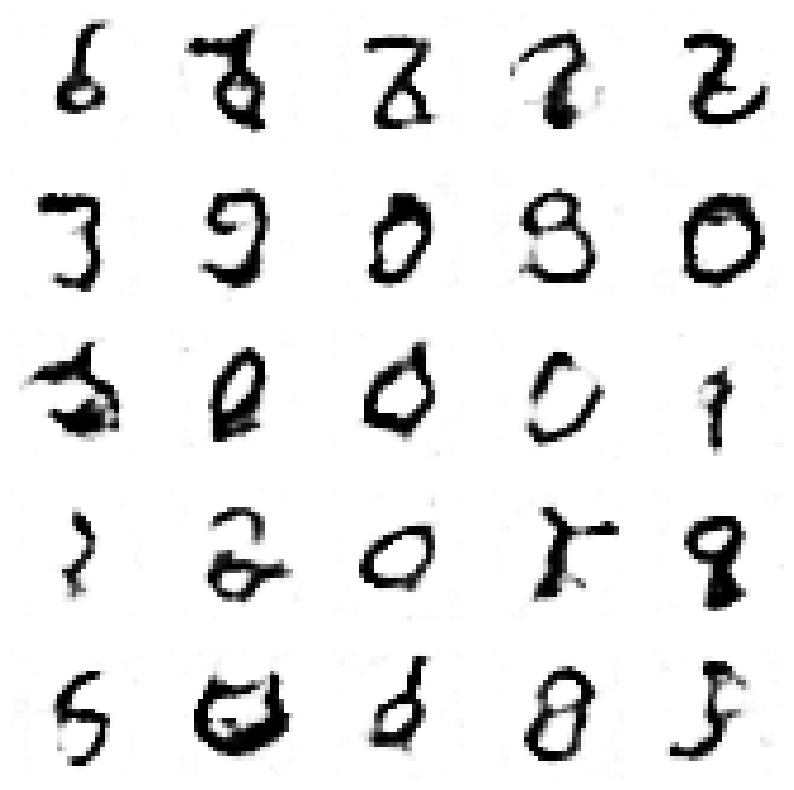

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.05700088438824711, Generator Loss 0.09650871845392081
1/1 [==============================] - 0s 28ms/step


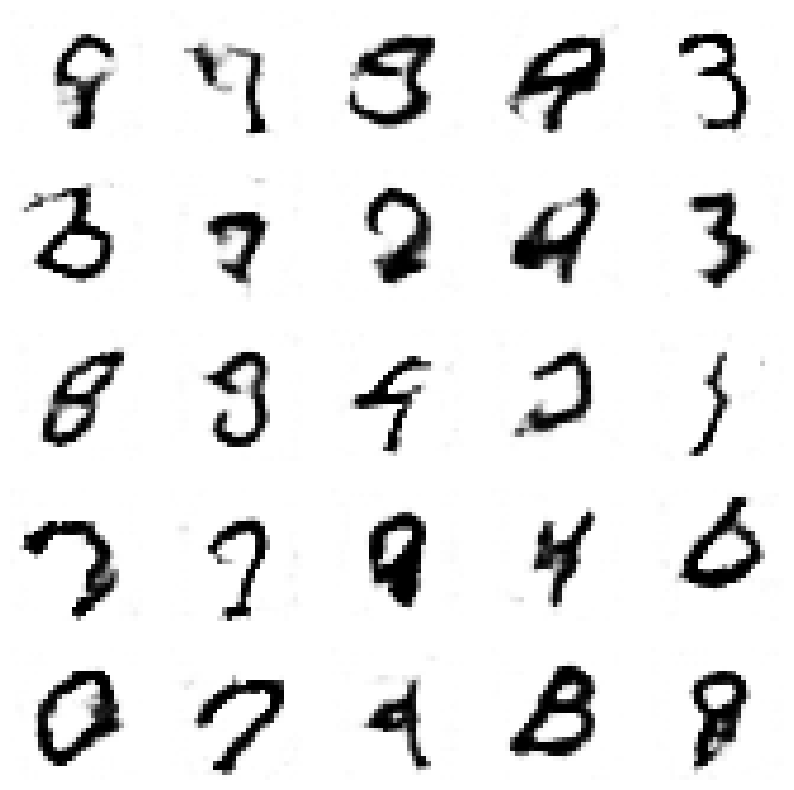

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.059818993648912154, Generator Loss 0.10129143896265927
1/1 [==============================] - 0s 31ms/step


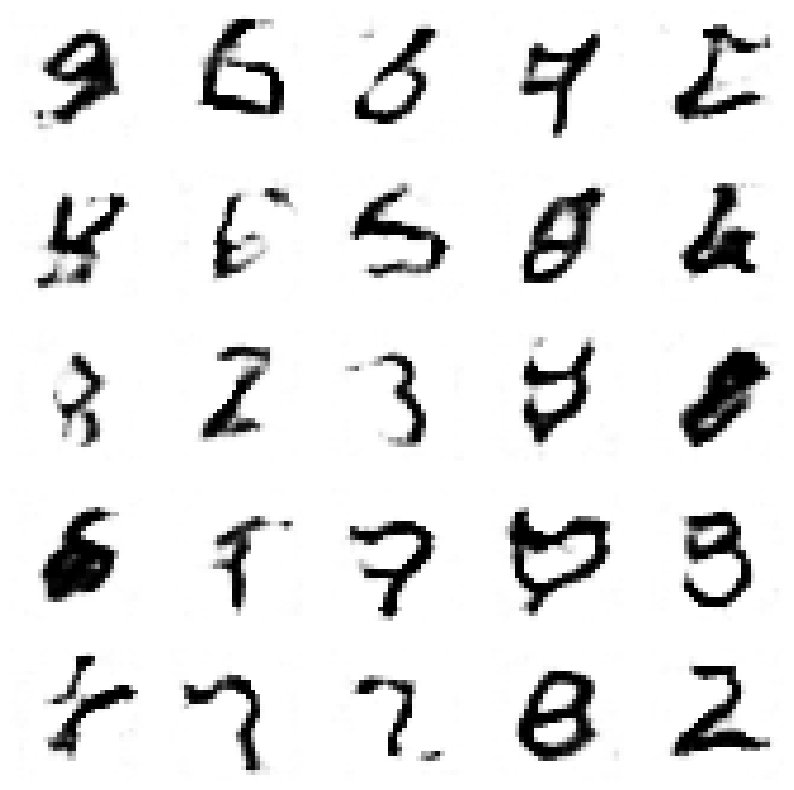

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.06259871662681939, Generator Loss 0.1061302122906742
1/1 [==============================] - 0s 46ms/step


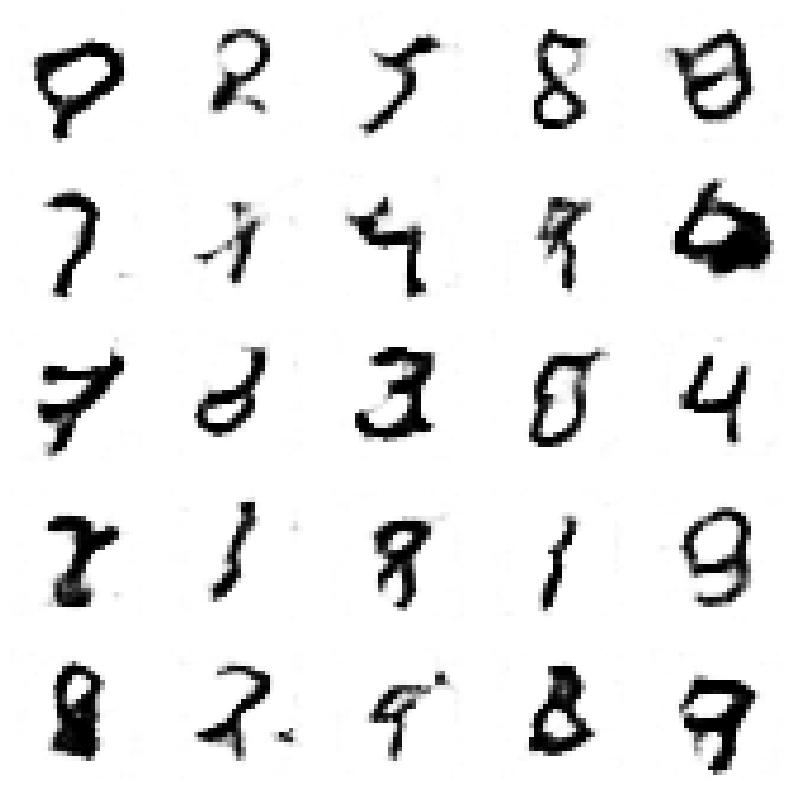

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.06552780234915578, Generator Loss 0.11085724524962597
1/1 [==============================] - 0s 66ms/step


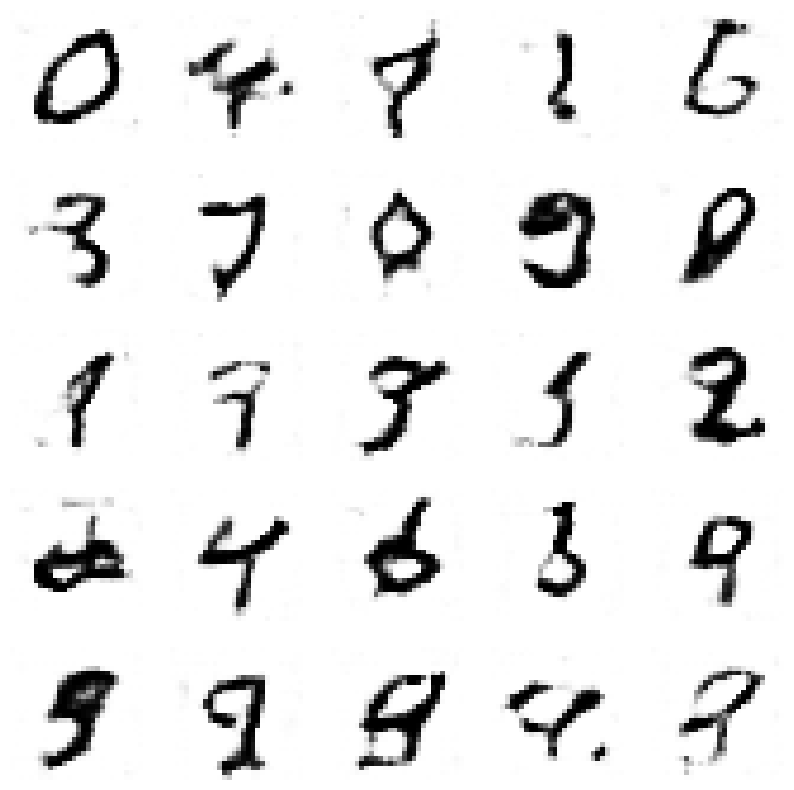

4/4 [==============================] - 0s 2ms/step
Epoch 10, Disc loss 0.06838962499402527, Generator Loss 0.11578139790102966
1/1 [==============================] - 0s 29ms/step


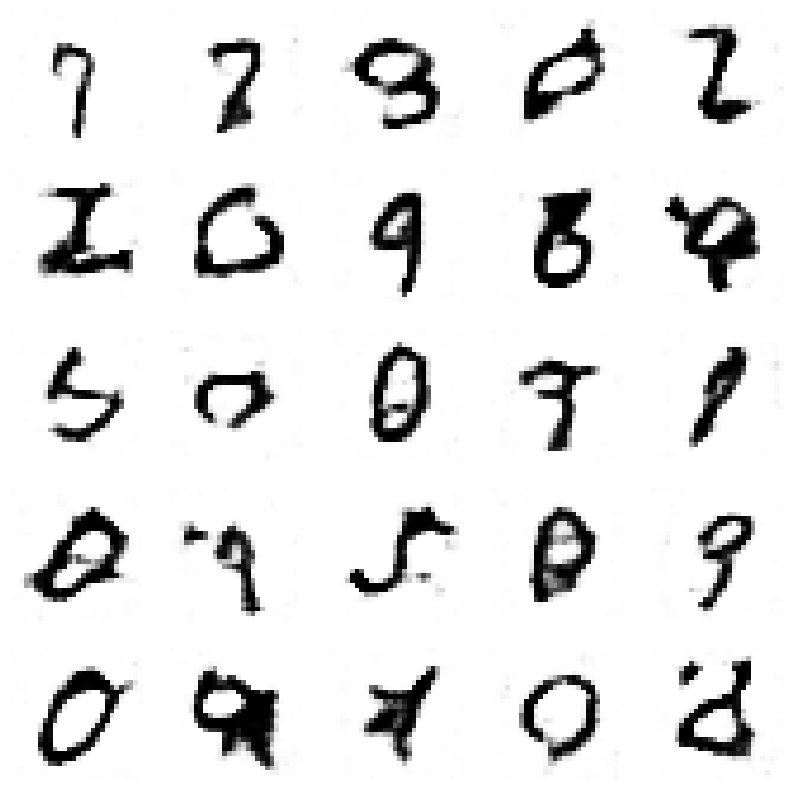

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.07130034548095149, Generator Loss 0.12063942811427972
1/1 [==============================] - 0s 44ms/step


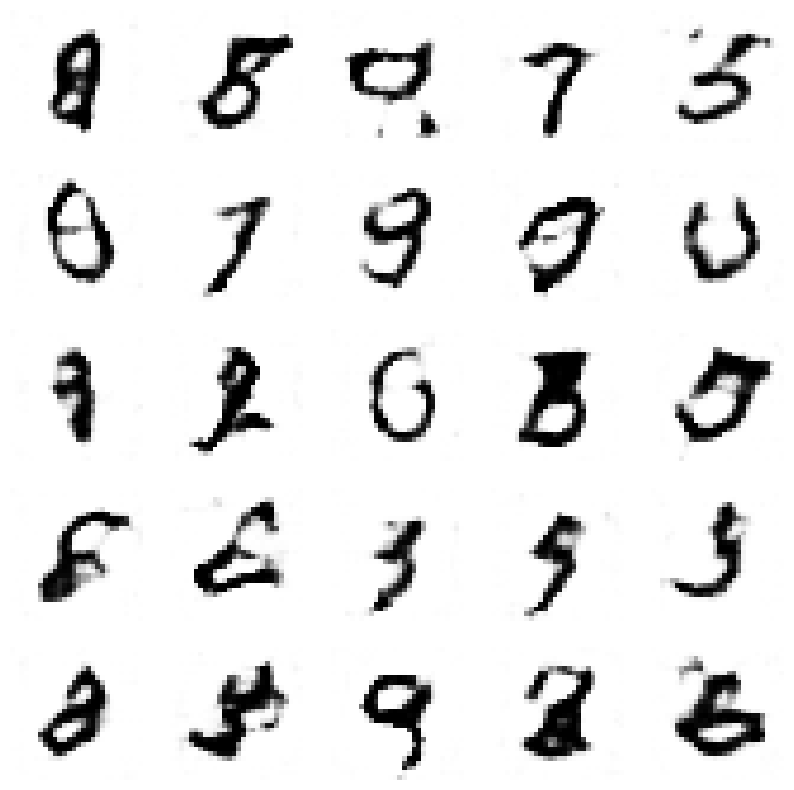

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.07410699129104614, Generator Loss 0.12534190548790825
1/1 [==============================] - 0s 27ms/step


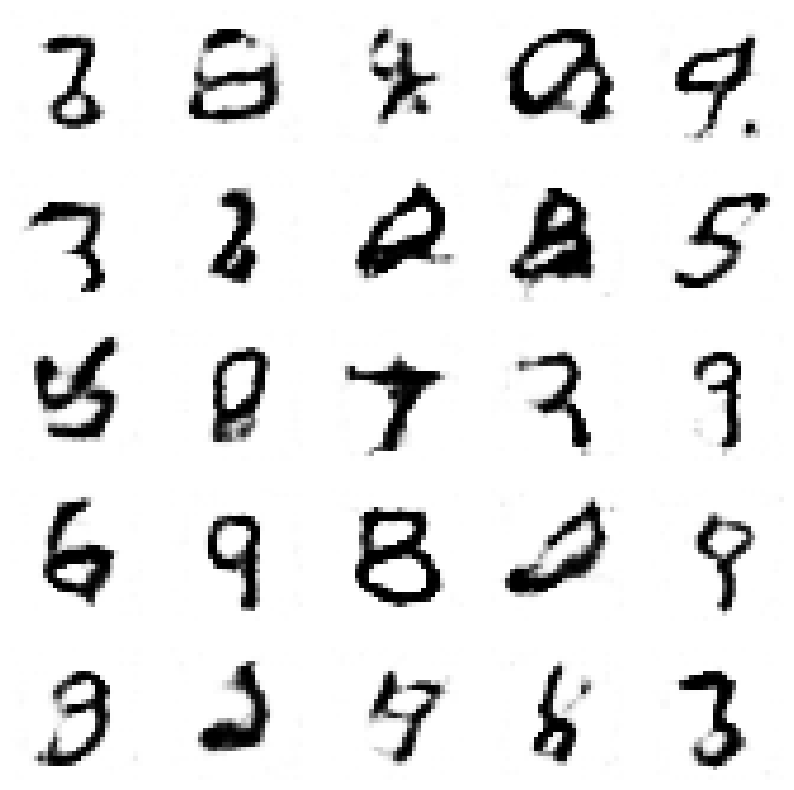

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.07692403339932108, Generator Loss 0.13010015854468712
1/1 [==============================] - 0s 34ms/step


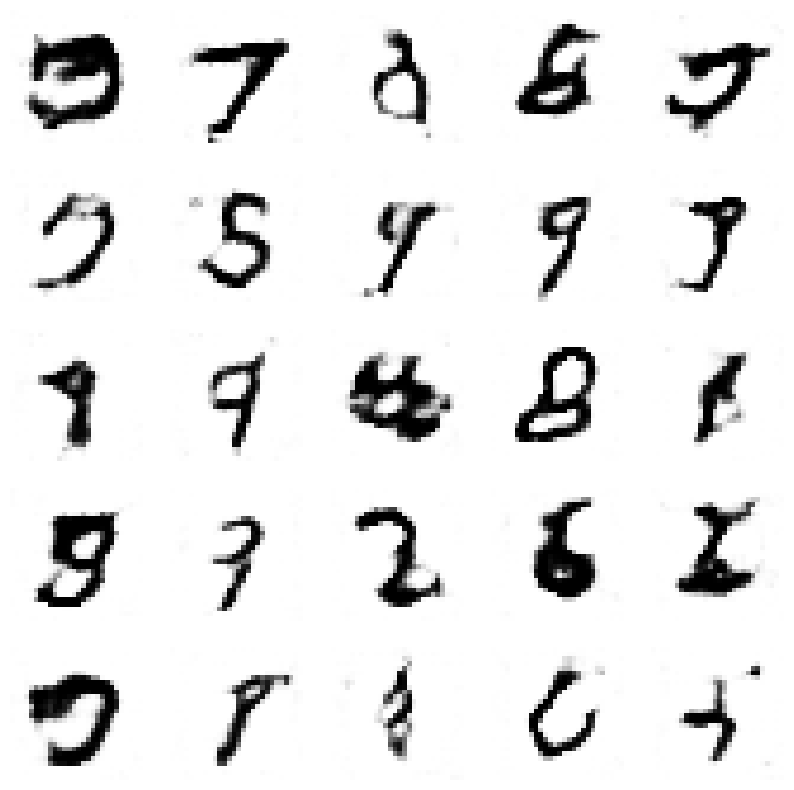

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.0797425113682054, Generator Loss 0.13499940460563725
1/1 [==============================] - 0s 28ms/step


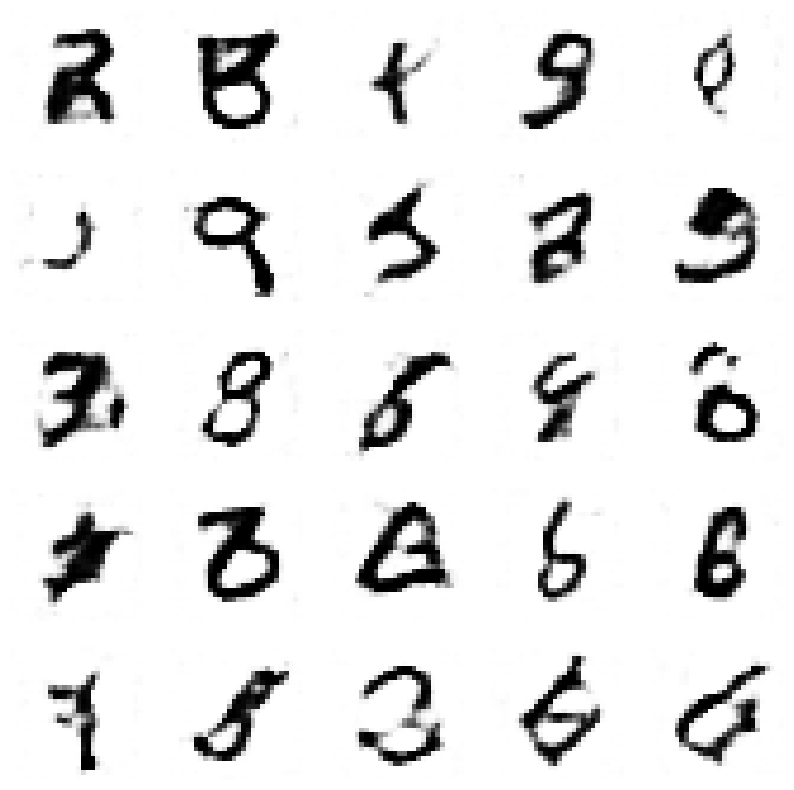

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.0826214664002769, Generator Loss 0.1398854882289202
1/1 [==============================] - 0s 28ms/step


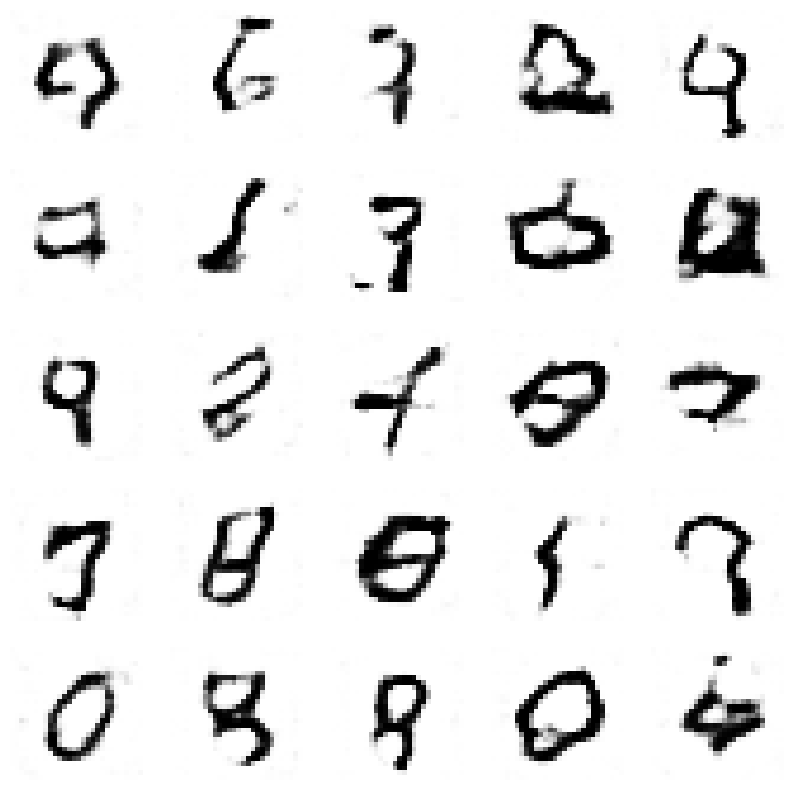

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.08540832894480127, Generator Loss 0.14473759669523972
1/1 [==============================] - 0s 35ms/step


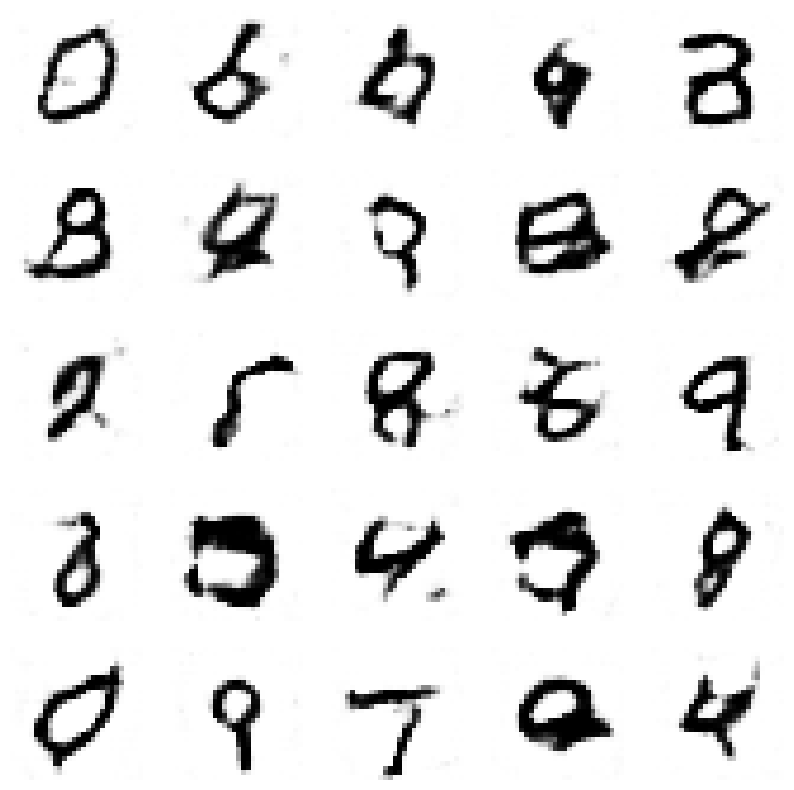

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.08830548275230277, Generator Loss 0.14949511360918355
1/1 [==============================] - 0s 30ms/step


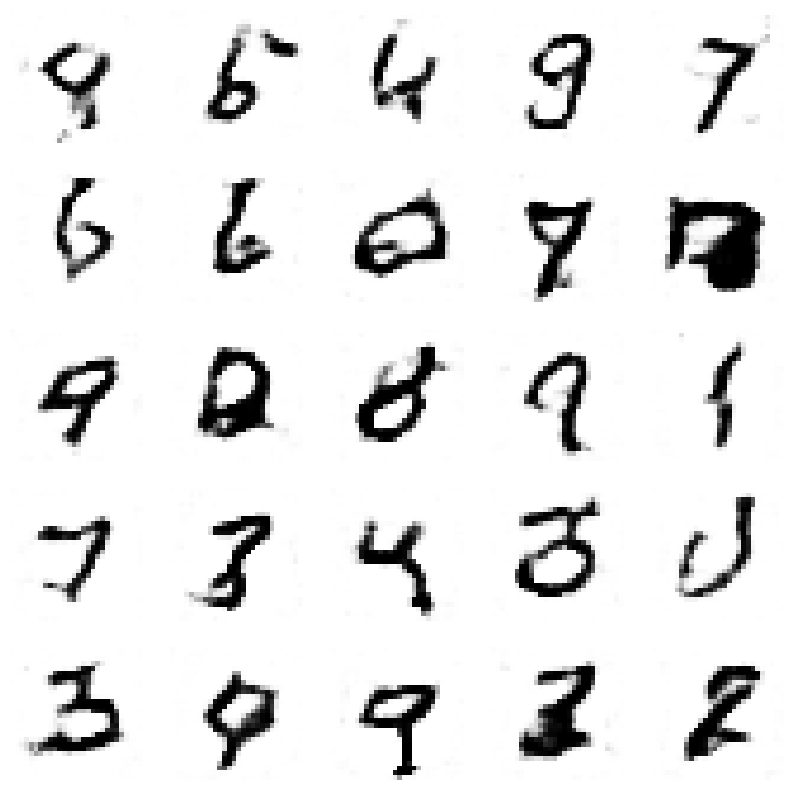

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.09122872123351464, Generator Loss 0.1543635573142614
1/1 [==============================] - 0s 30ms/step


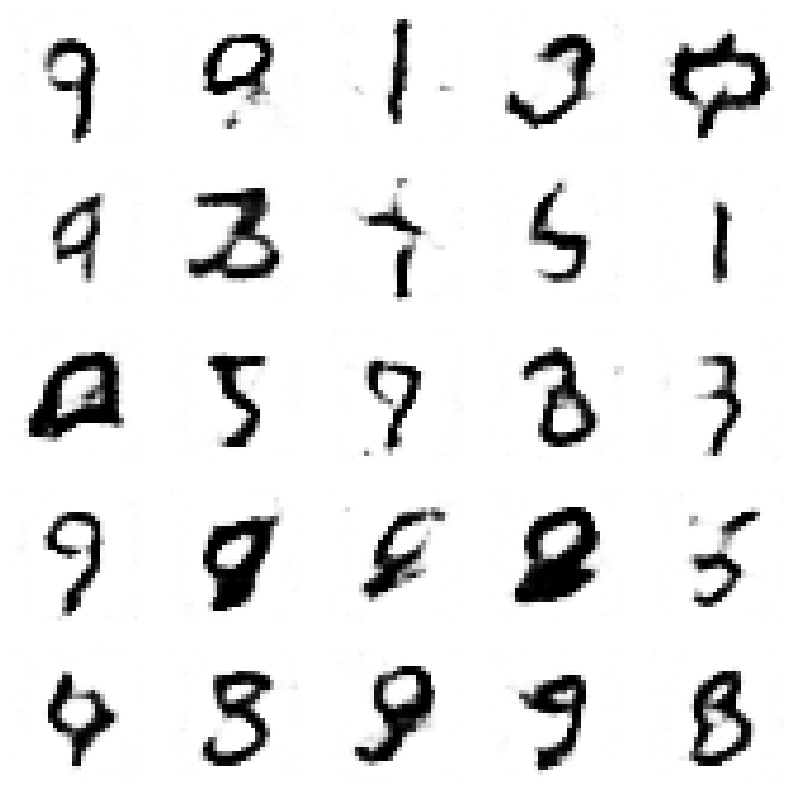

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.09414844928134201, Generator Loss 0.15913373333776099
1/1 [==============================] - 0s 58ms/step


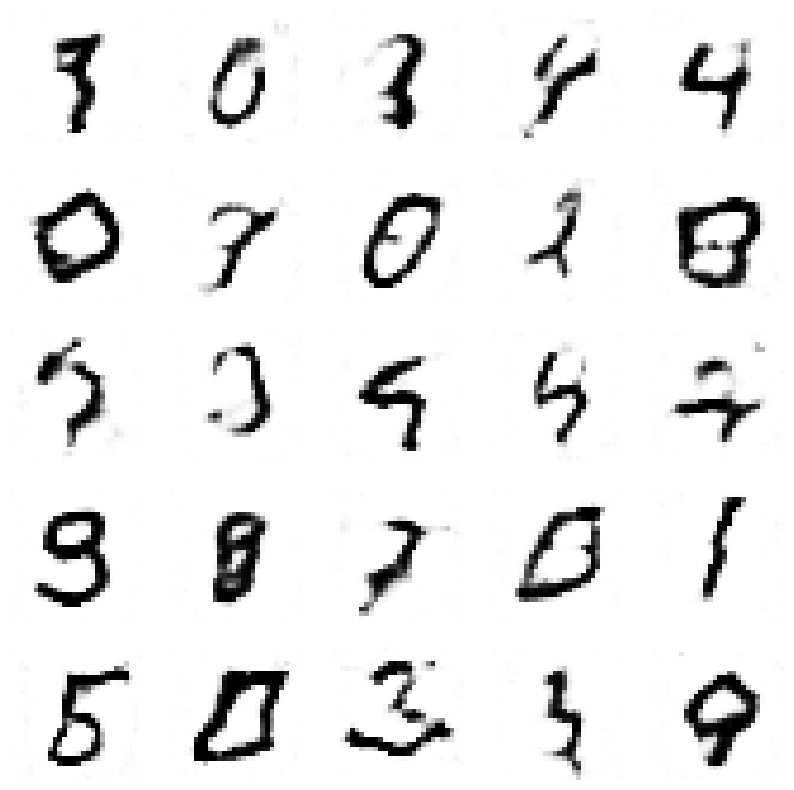

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.09700995046868284, Generator Loss 0.16391586696999705
1/1 [==============================] - 0s 43ms/step


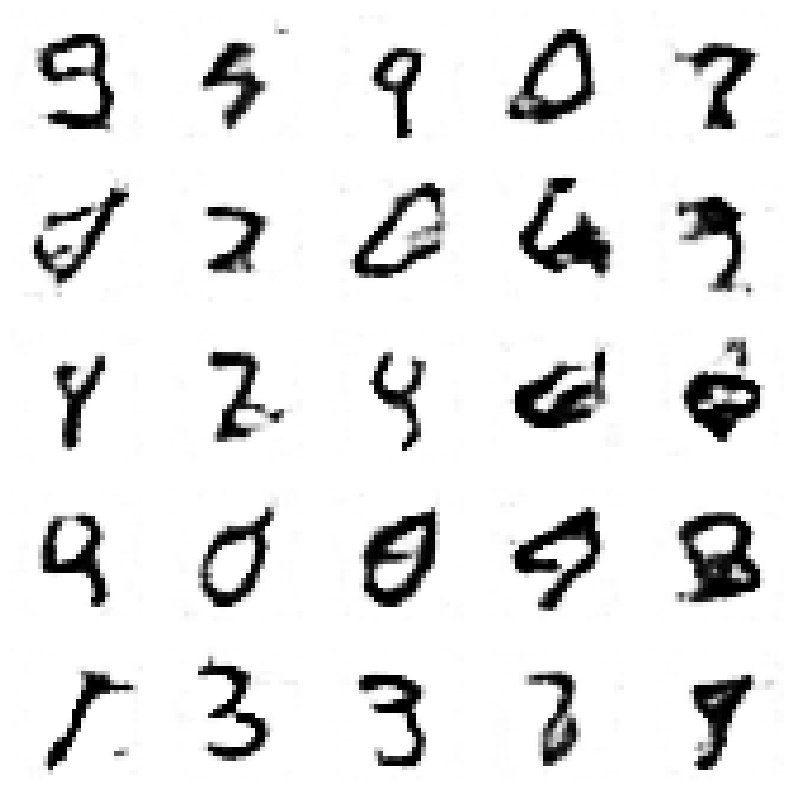

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.09974118595958775, Generator Loss 0.1687688501472147
1/1 [==============================] - 0s 30ms/step


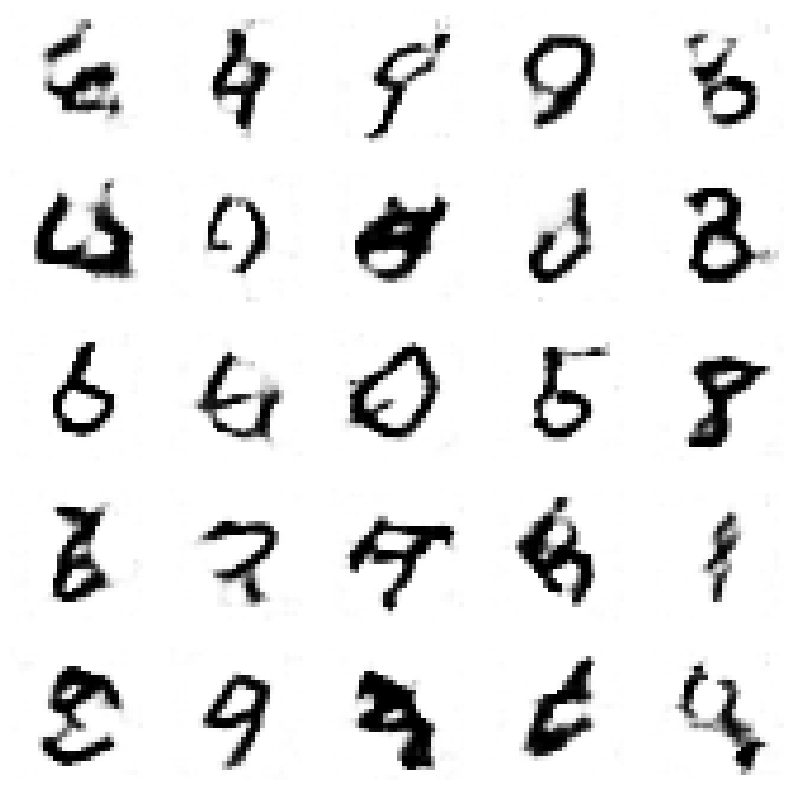

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.10256247833753243, Generator Loss 0.17360762551299527
1/1 [==============================] - 0s 35ms/step


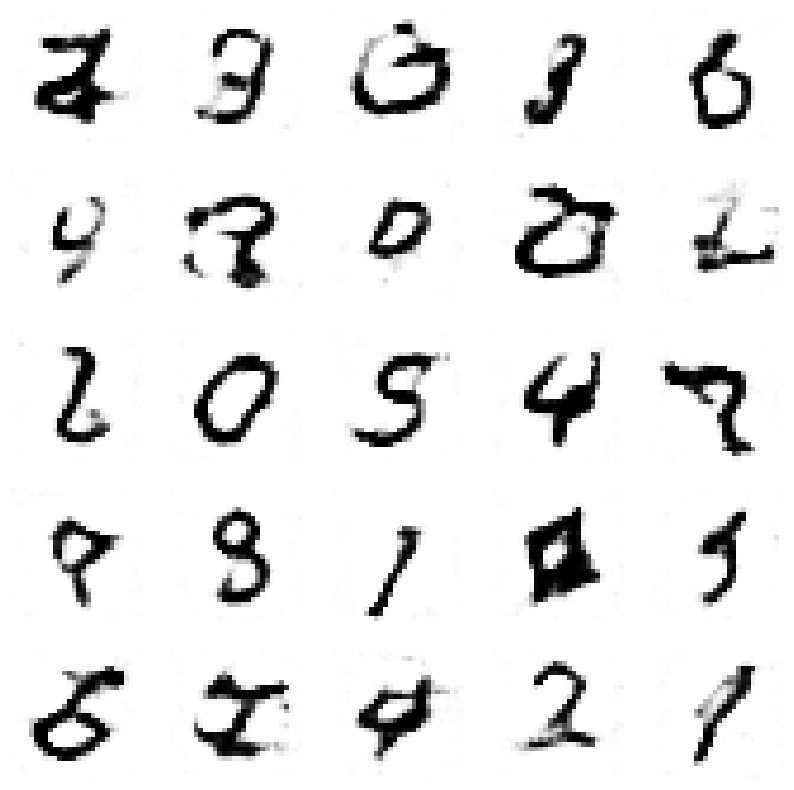

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.10538746174584088, Generator Loss 0.17840953362293732
1/1 [==============================] - 0s 27ms/step


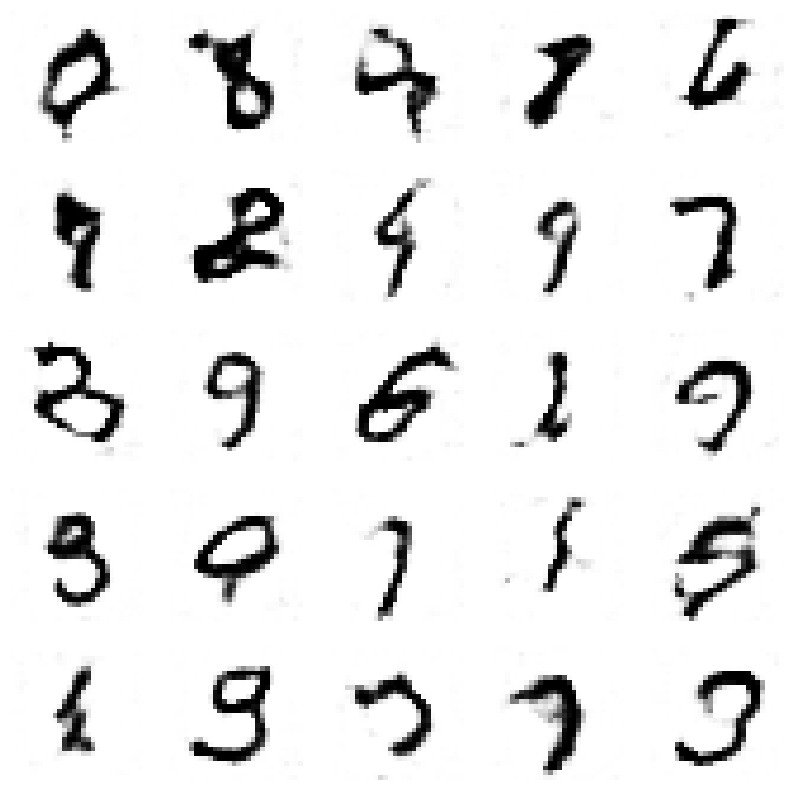

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.10812768671247694, Generator Loss 0.18315403634666377
1/1 [==============================] - 0s 29ms/step


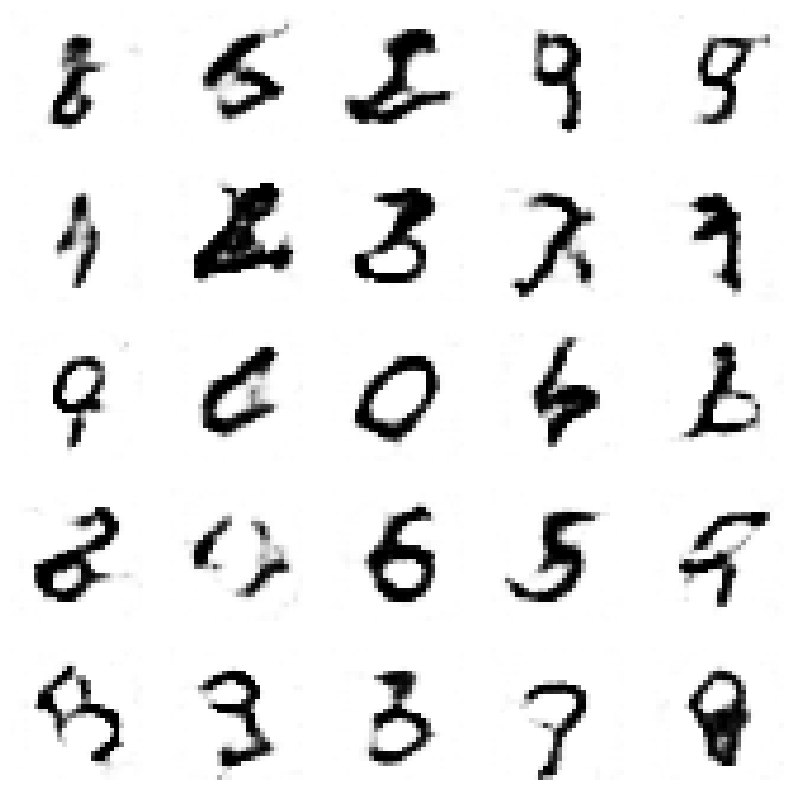

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.11092158655325572, Generator Loss 0.1878581317062052
1/1 [==============================] - 0s 27ms/step


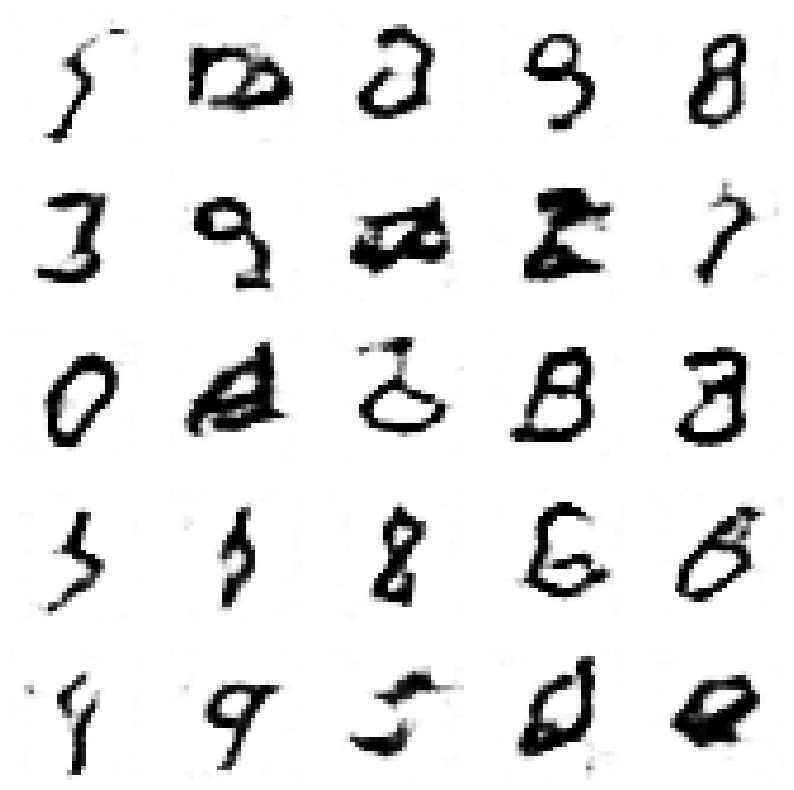

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.11373916268348694, Generator Loss 0.19247120720708472
1/1 [==============================] - 0s 36ms/step


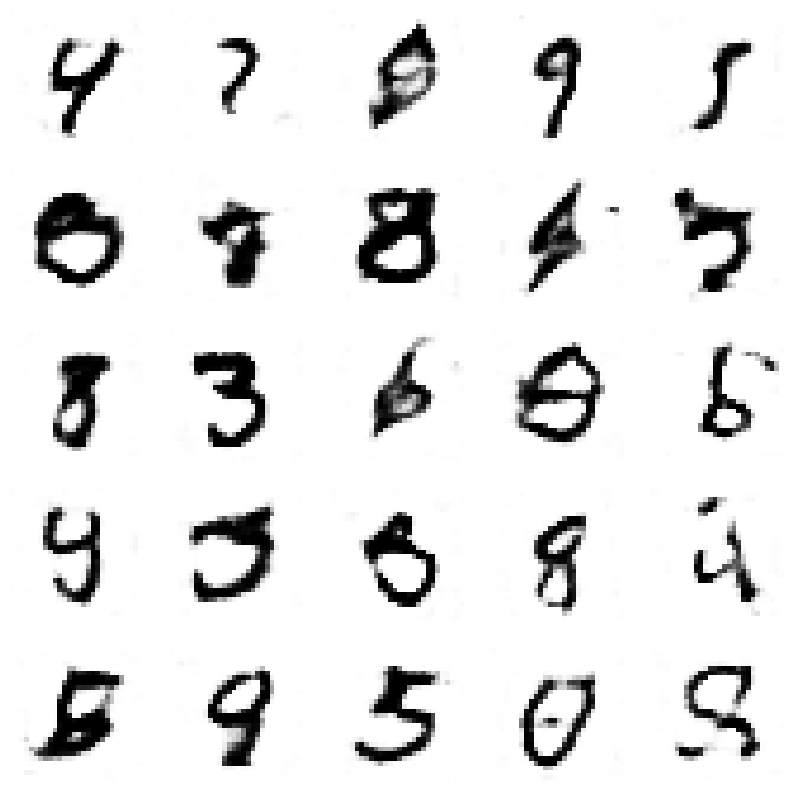

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.11655525493825603, Generator Loss 0.19740407843875069
1/1 [==============================] - 0s 27ms/step


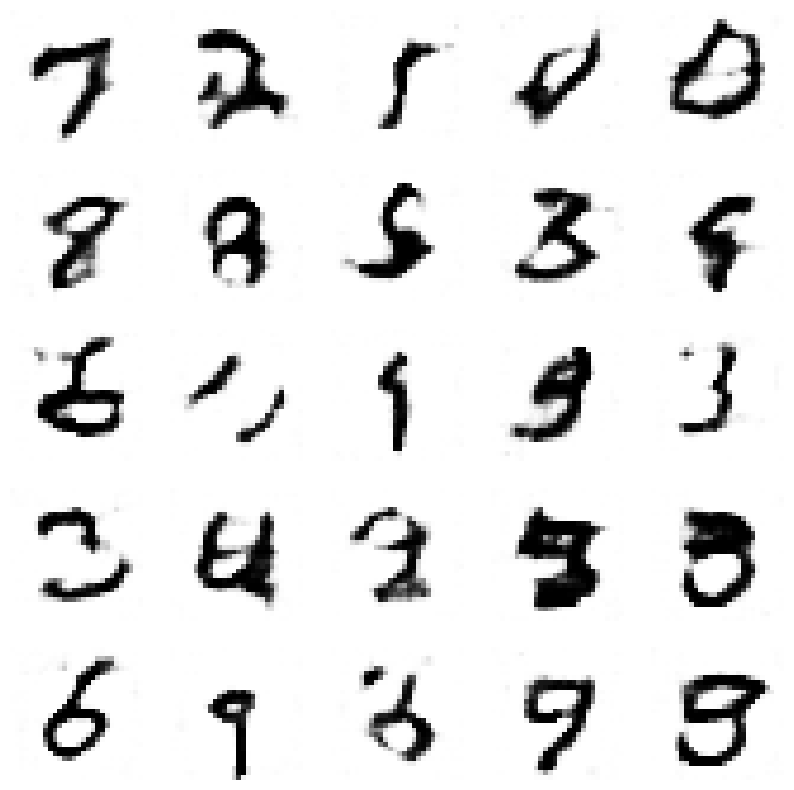

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.11944191361594404, Generator Loss 0.202281373178857
1/1 [==============================] - 0s 32ms/step


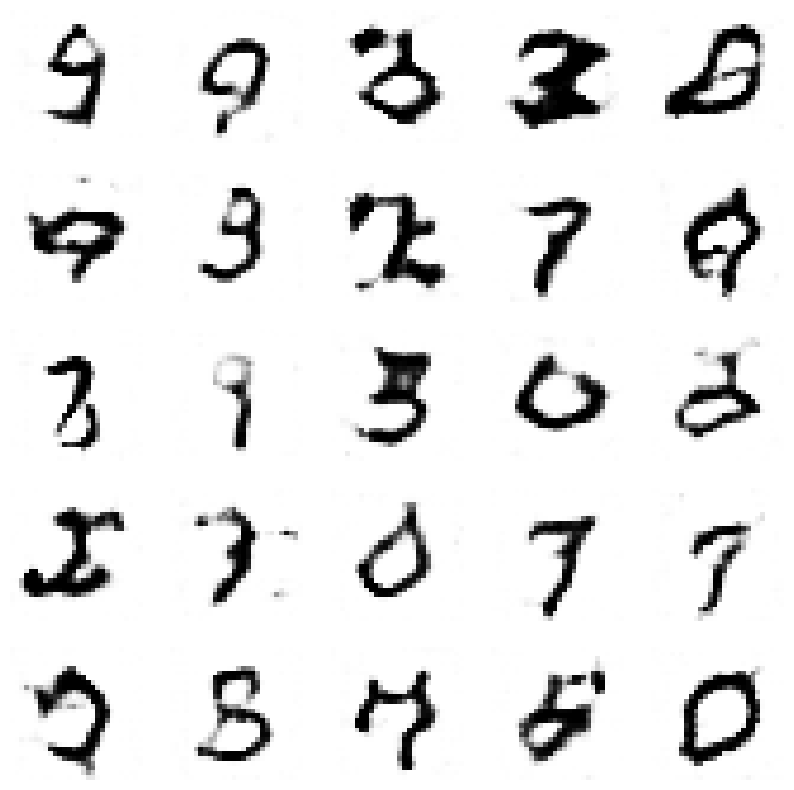

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.12243958658132797, Generator Loss 0.20696250546691763
1/1 [==============================] - 0s 35ms/step


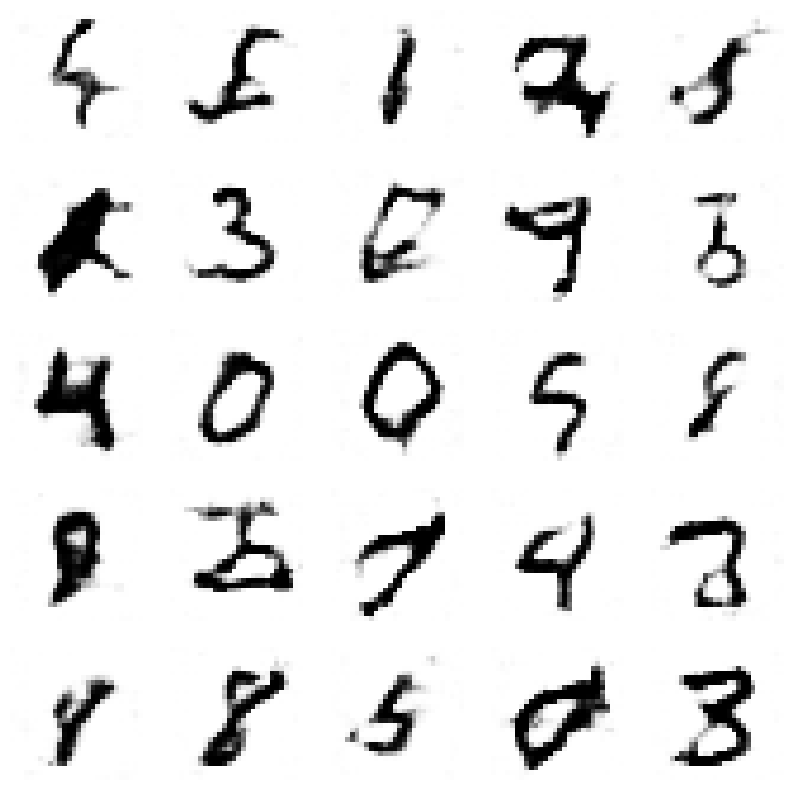

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.12521746958422864, Generator Loss 0.2117663387559418
1/1 [==============================] - 0s 43ms/step


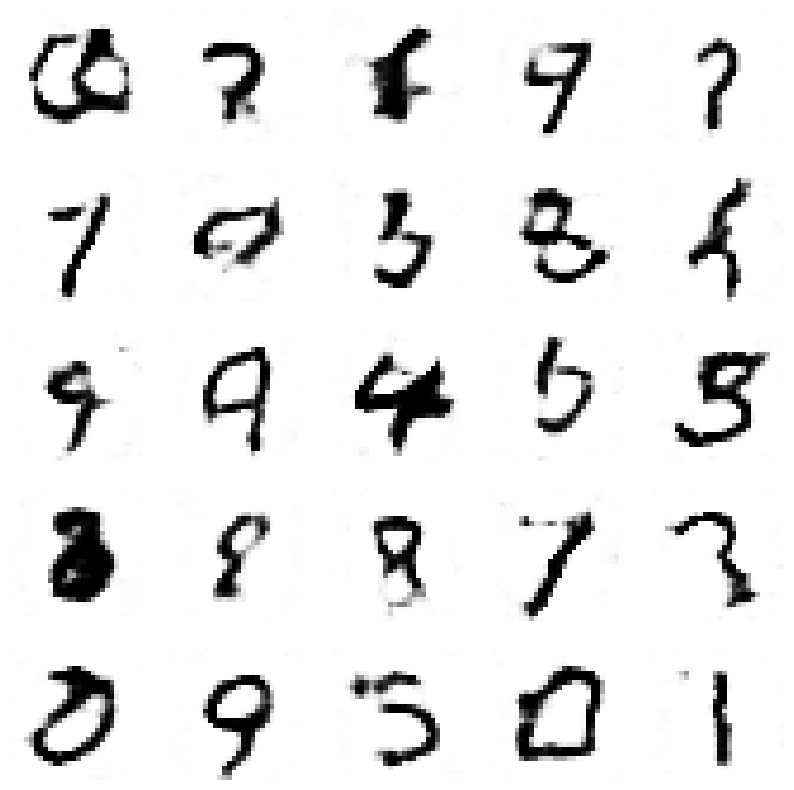

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.12801097728248334, Generator Loss 0.21650458350140825
1/1 [==============================] - 0s 29ms/step


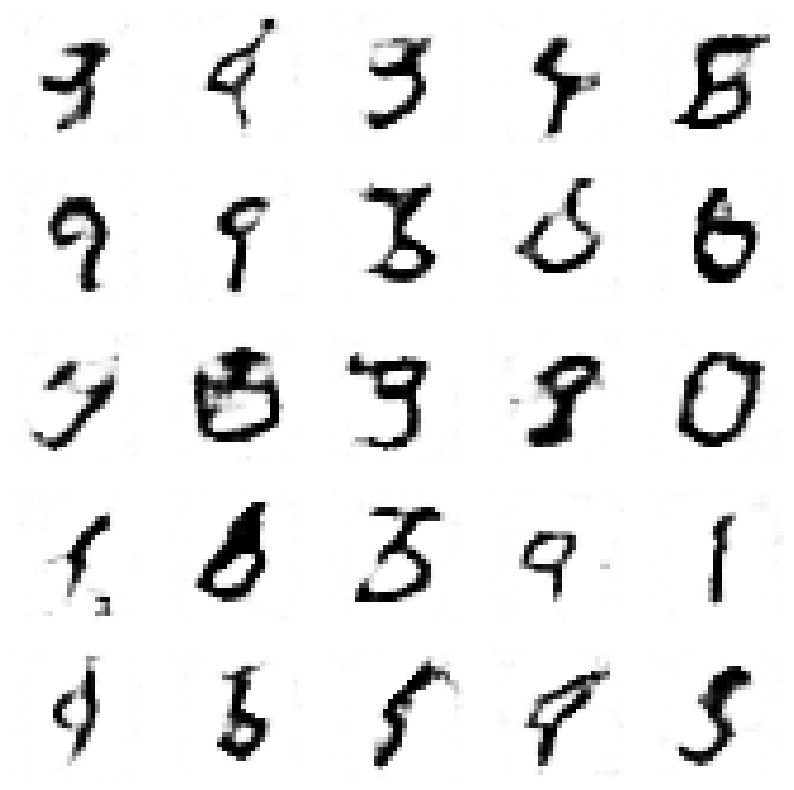

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.13090698421001434, Generator Loss 0.2213403506156726
1/1 [==============================] - 0s 28ms/step


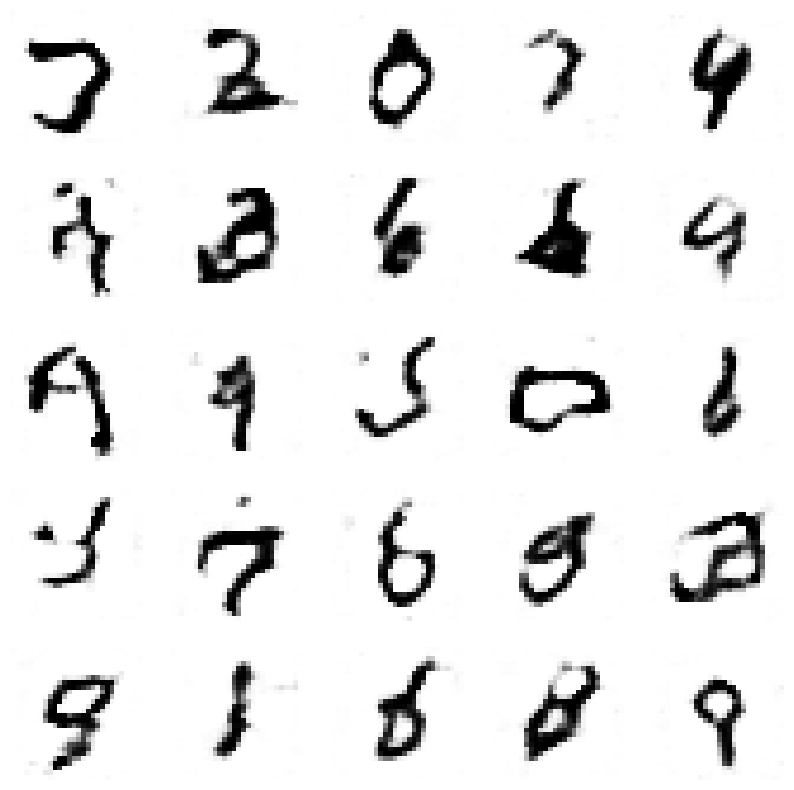

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.13373910285468793, Generator Loss 0.22624415413946167
1/1 [==============================] - 0s 33ms/step


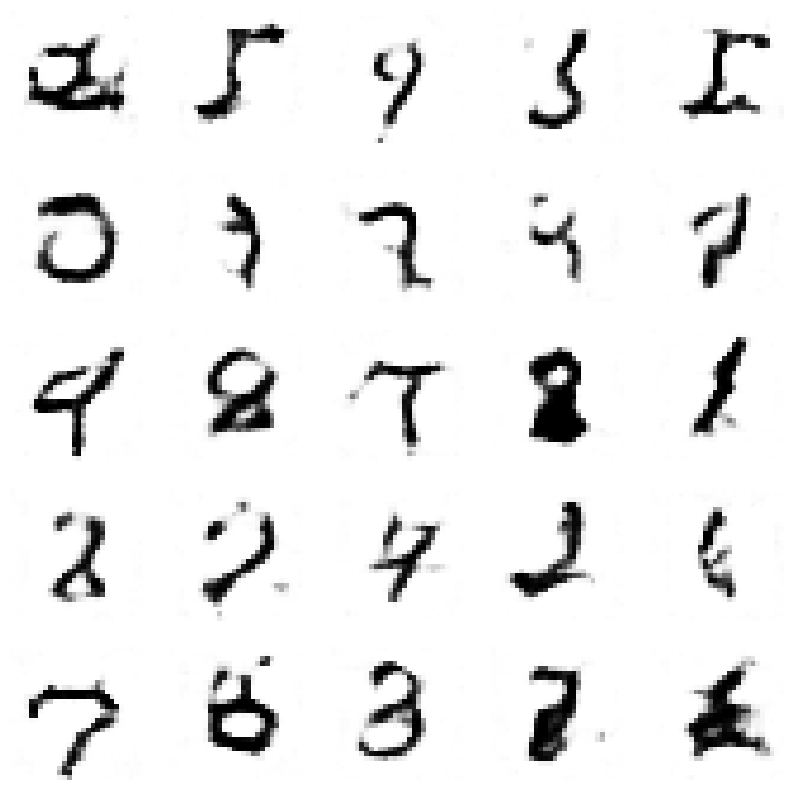

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.1365420883282637, Generator Loss 0.23110406062541863
1/1 [==============================] - 0s 27ms/step


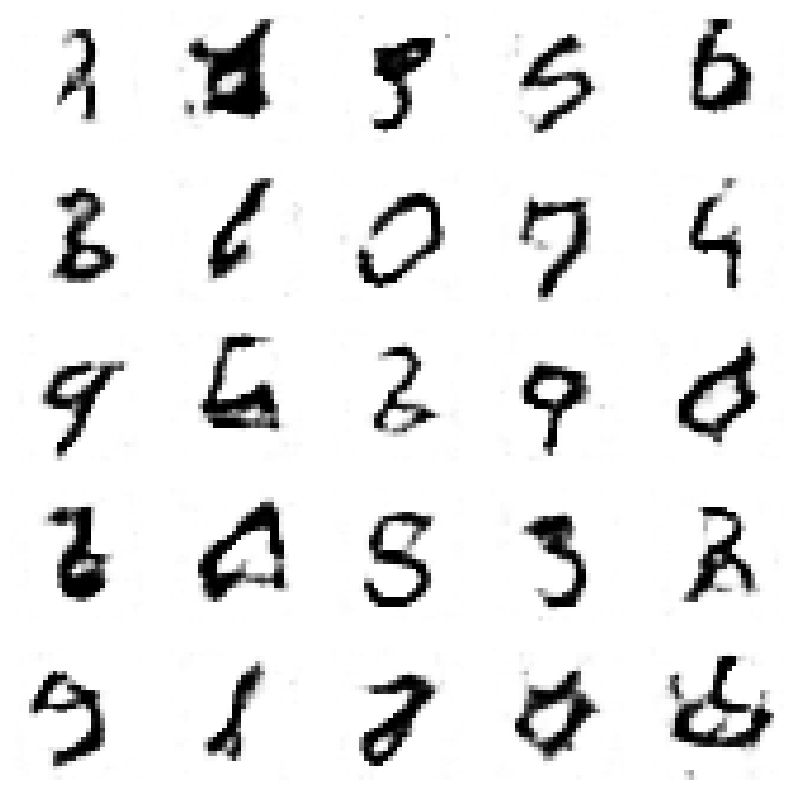

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.13931912527634546, Generator Loss 0.23585528695685232
1/1 [==============================] - 0s 31ms/step


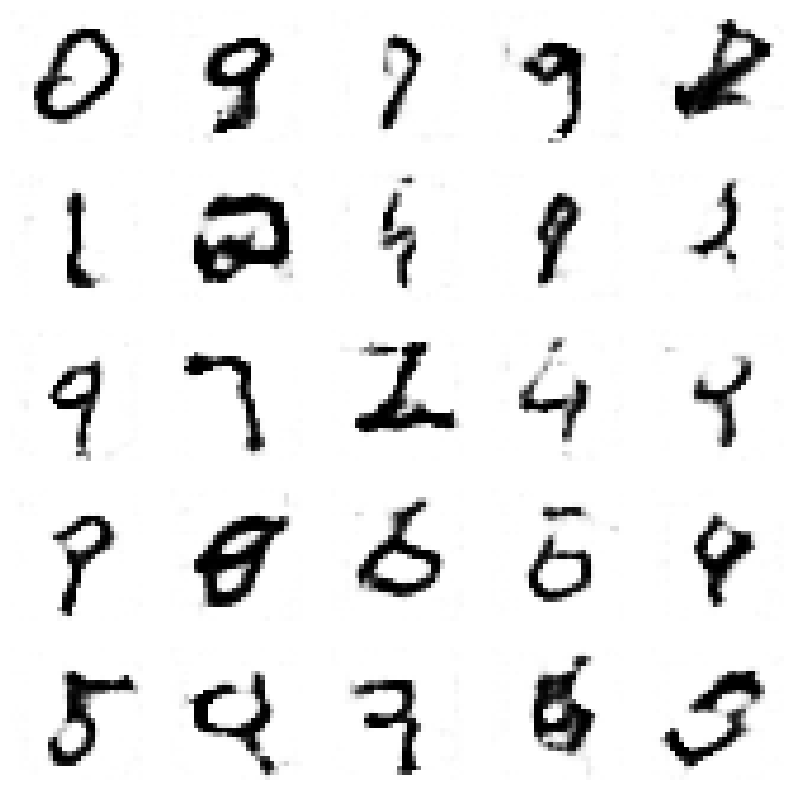

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.142149626953989, Generator Loss 0.24049502407383716
1/1 [==============================] - 0s 29ms/step


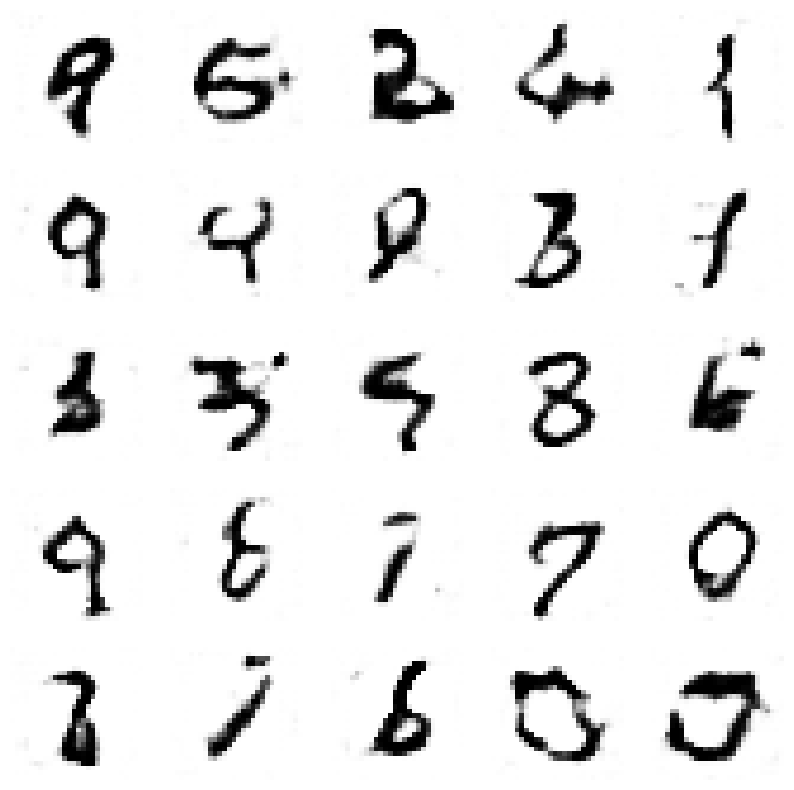

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.14501830960950282, Generator Loss 0.2451698566094423
1/1 [==============================] - 0s 31ms/step


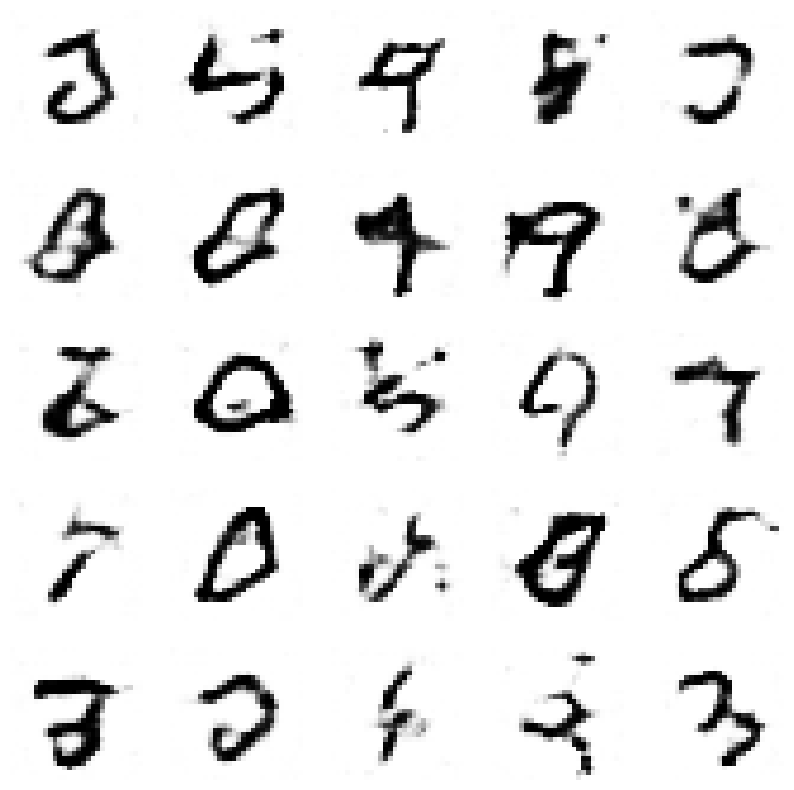

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.1479180720117357, Generator Loss 0.24973341236766586
1/1 [==============================] - 0s 27ms/step


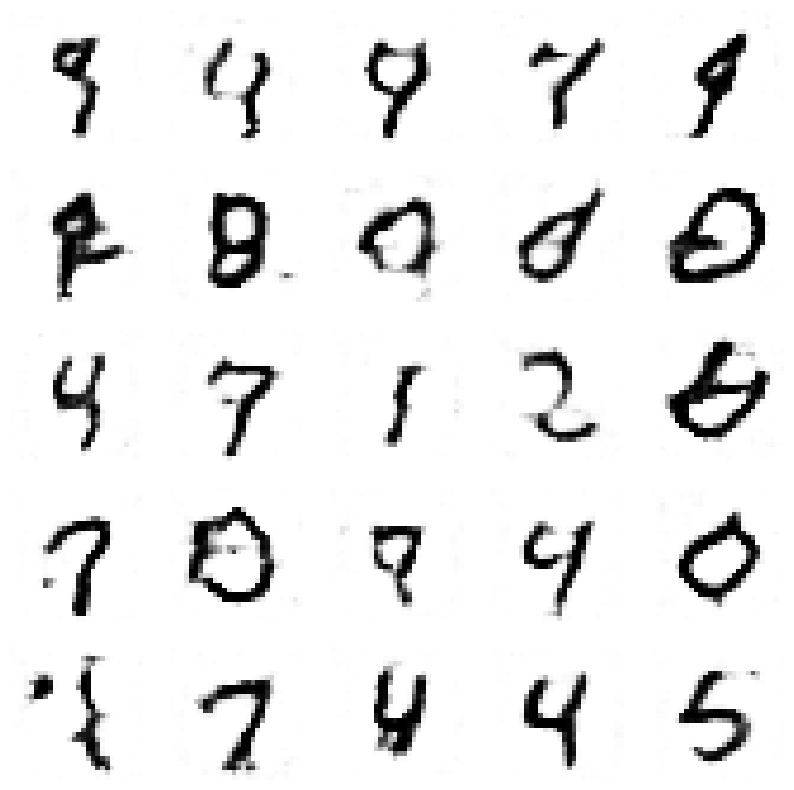

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.1507430868780511, Generator Loss 0.25451036549022055
1/1 [==============================] - 0s 43ms/step


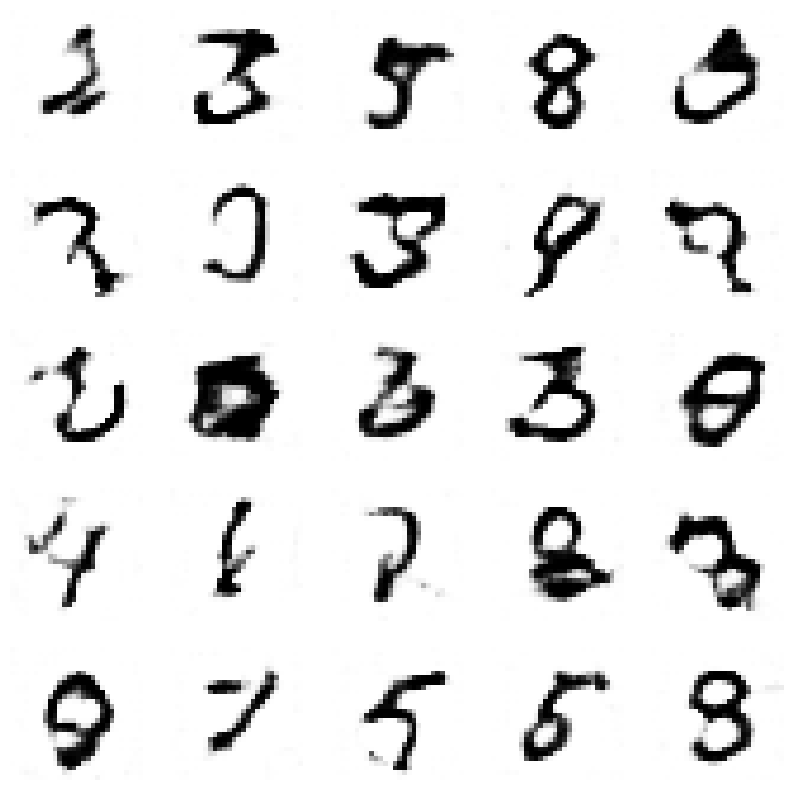

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.15353039620269057, Generator Loss 0.2591572093148517
1/1 [==============================] - 0s 35ms/step


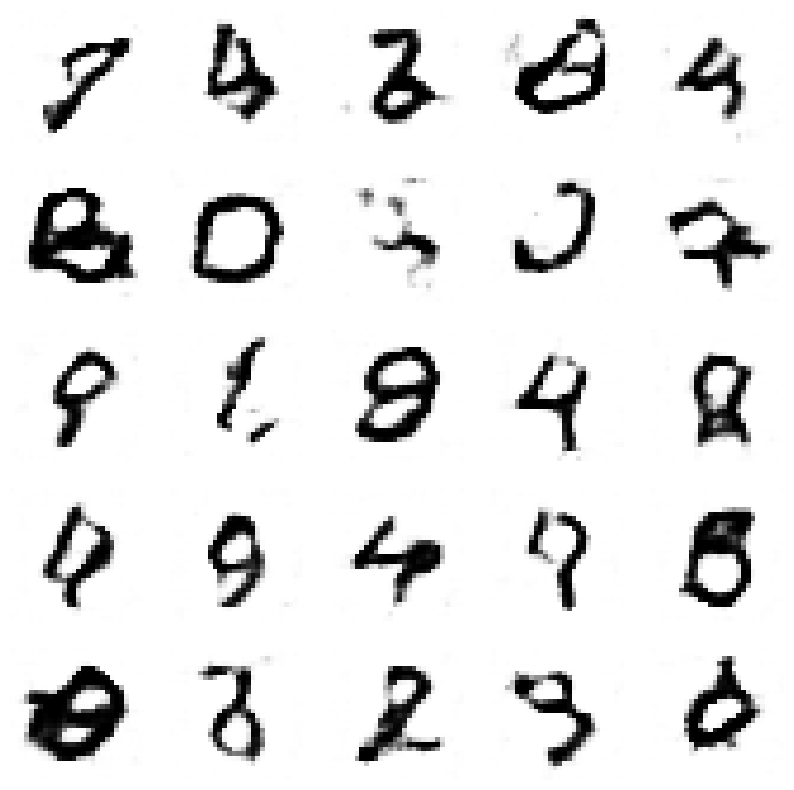

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.15633326144809398, Generator Loss 0.2637961537410051
1/1 [==============================] - 0s 34ms/step


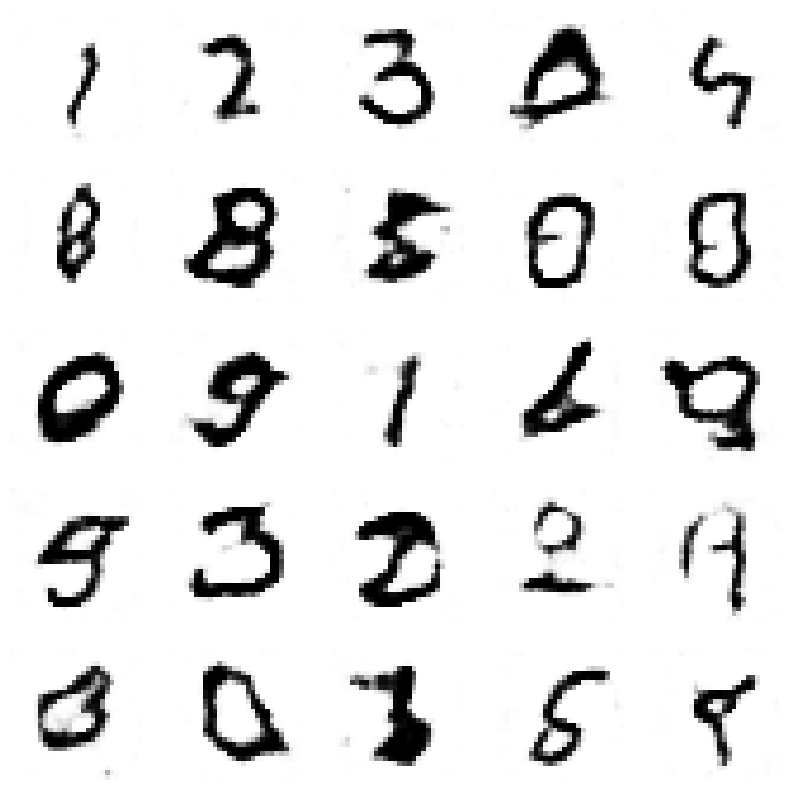

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.15912302386047494, Generator Loss 0.2683405998425606
1/1 [==============================] - 0s 32ms/step


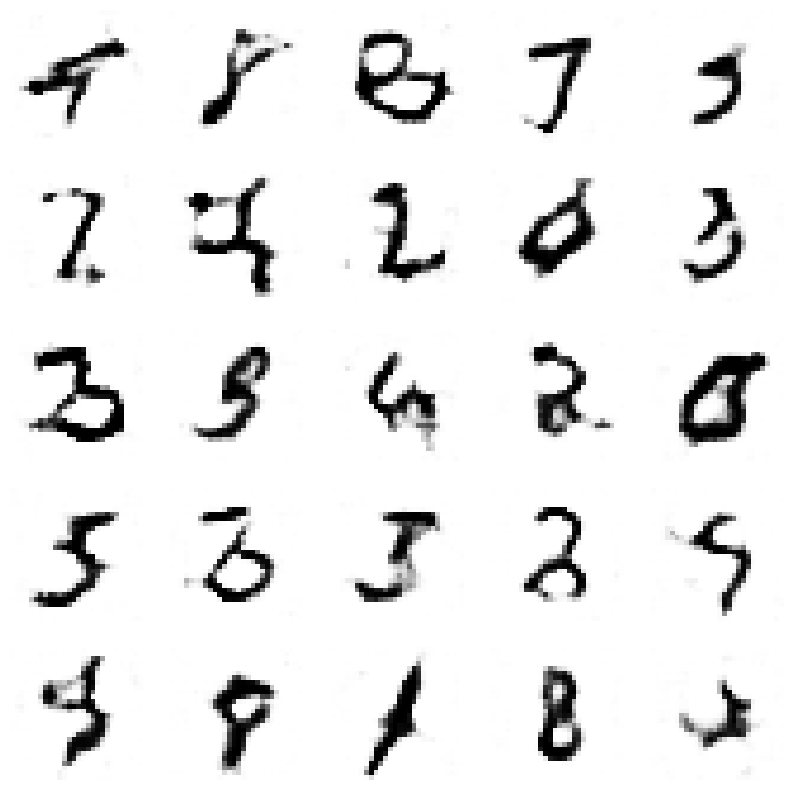

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.16192583803437713, Generator Loss 0.2730634930806282
1/1 [==============================] - 0s 30ms/step


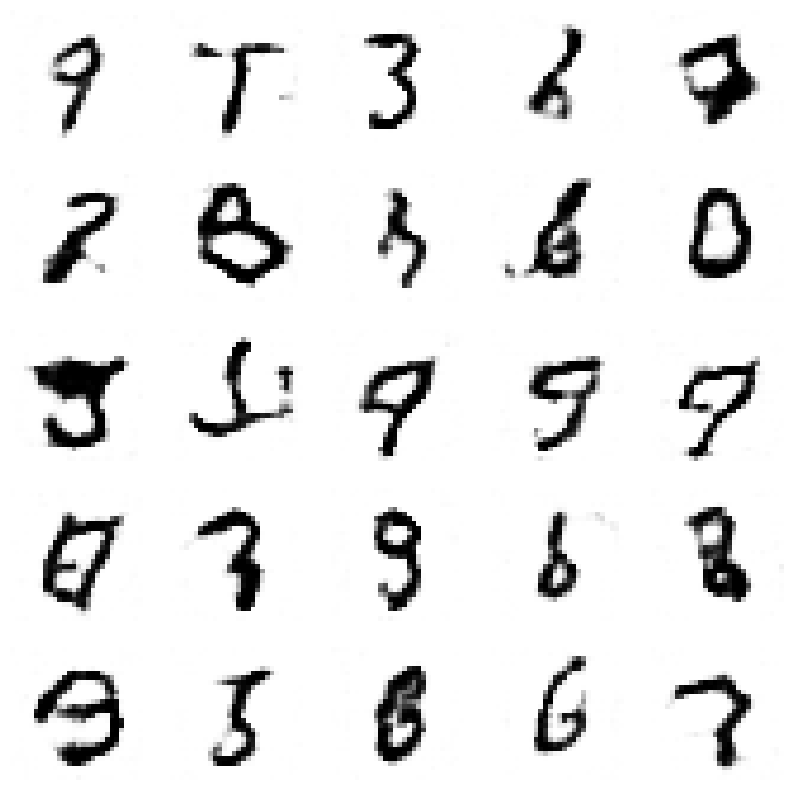

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.16466903470010838, Generator Loss 0.277718014187283
1/1 [==============================] - 0s 34ms/step


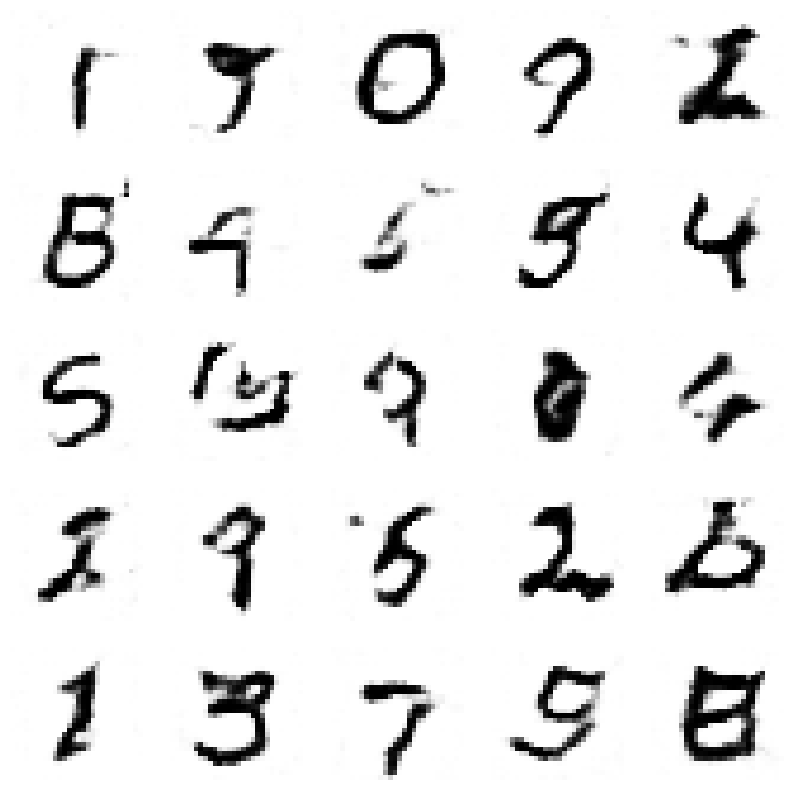

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.16749093229444617, Generator Loss 0.2824893415483654
1/1 [==============================] - 0s 31ms/step


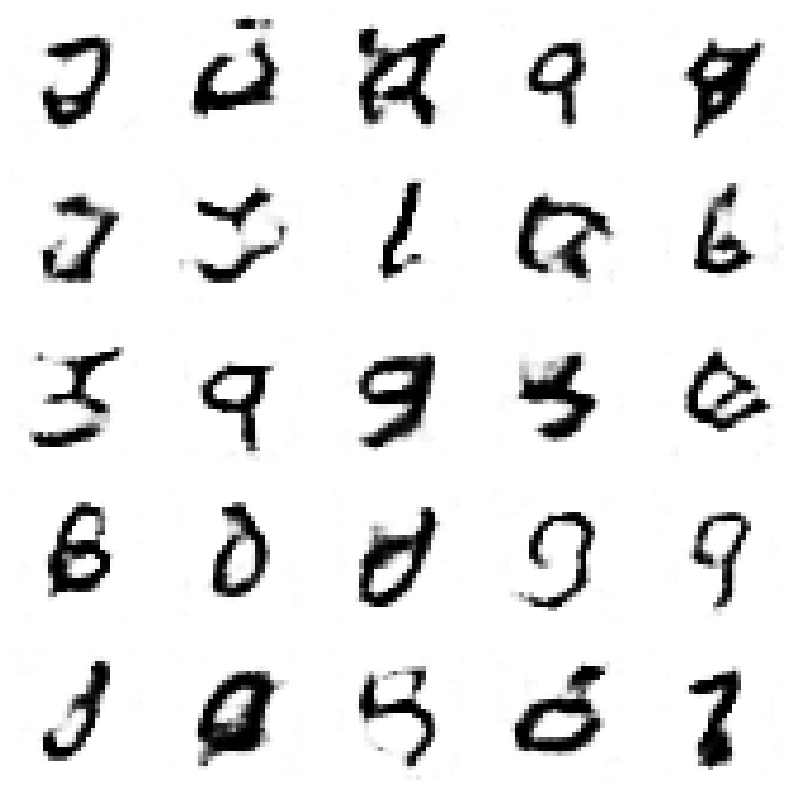

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.17021280820043677, Generator Loss 0.28740689693353116
1/1 [==============================] - 0s 26ms/step


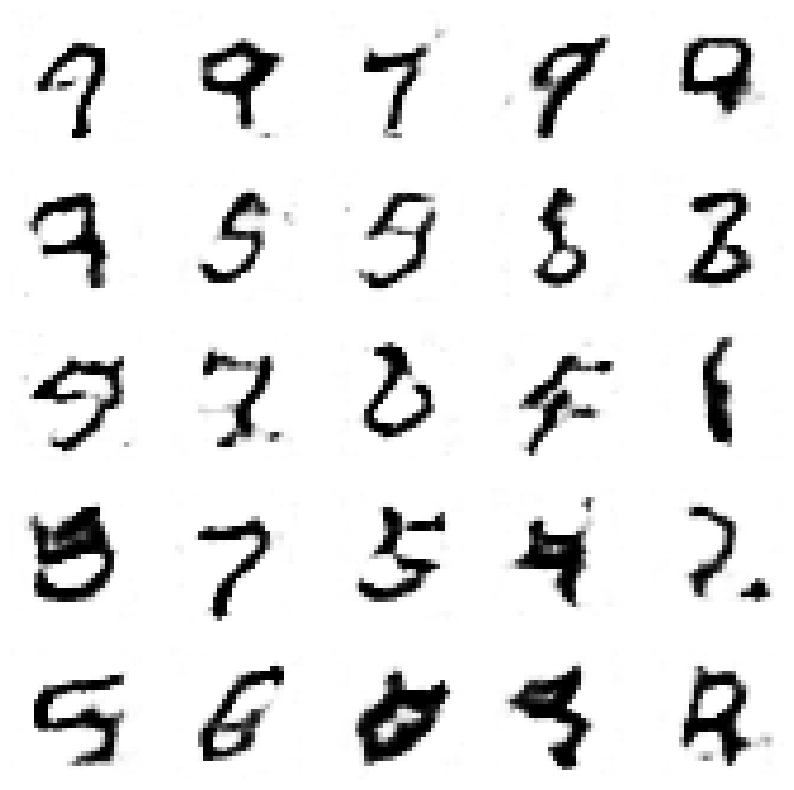

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.17314213628952319, Generator Loss 0.29222997437175524
1/1 [==============================] - 0s 29ms/step


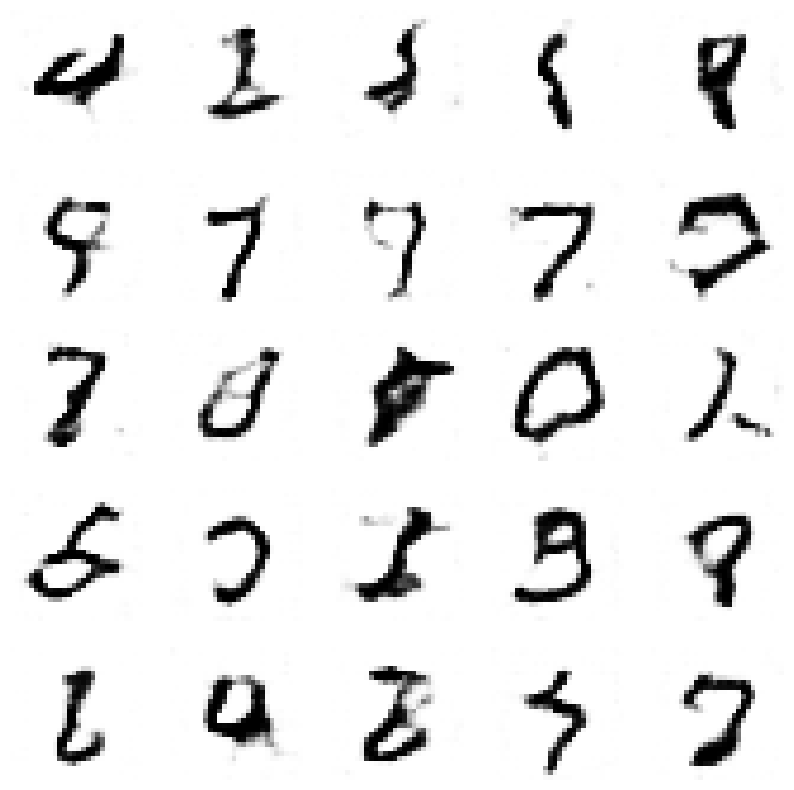

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.17604810228714576, Generator Loss 0.29710590075223875
1/1 [==============================] - 0s 28ms/step


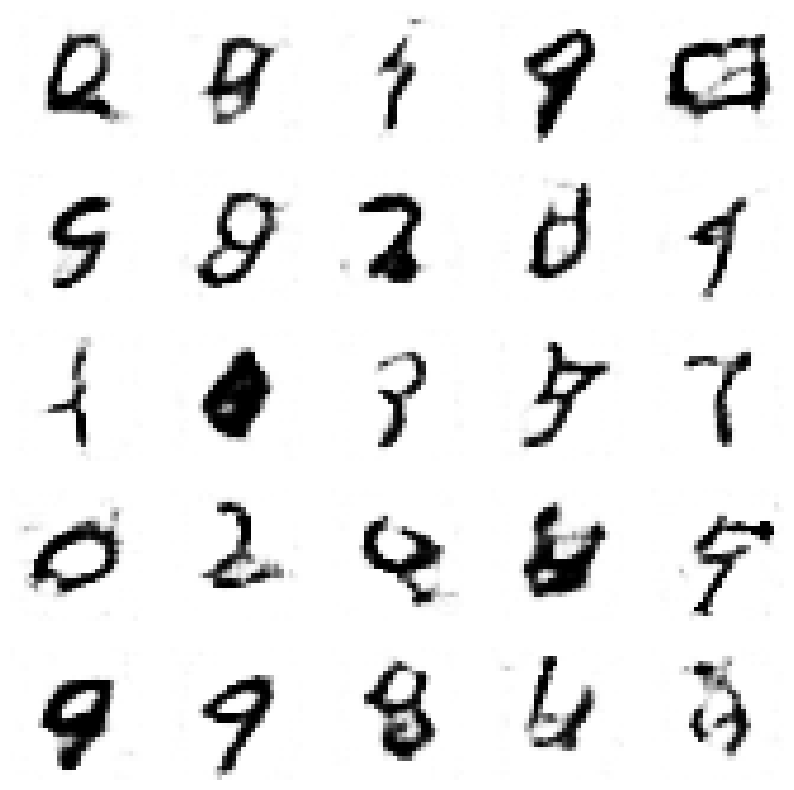

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.17888605416330516, Generator Loss 0.30187397074495625
1/1 [==============================] - 0s 36ms/step


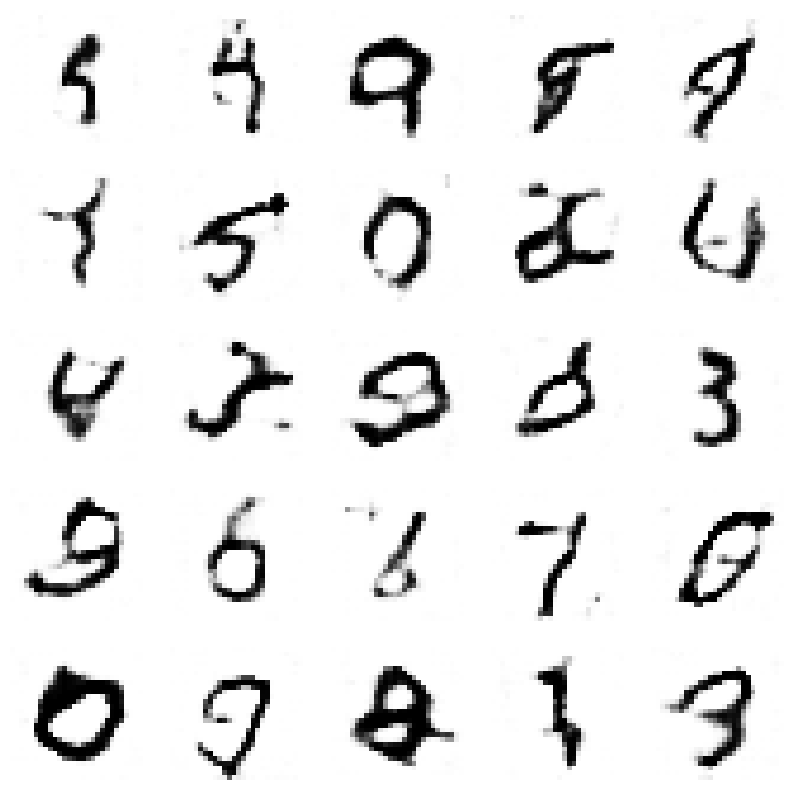

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.18173570981901935, Generator Loss 0.30670770162191147
1/1 [==============================] - 0s 28ms/step


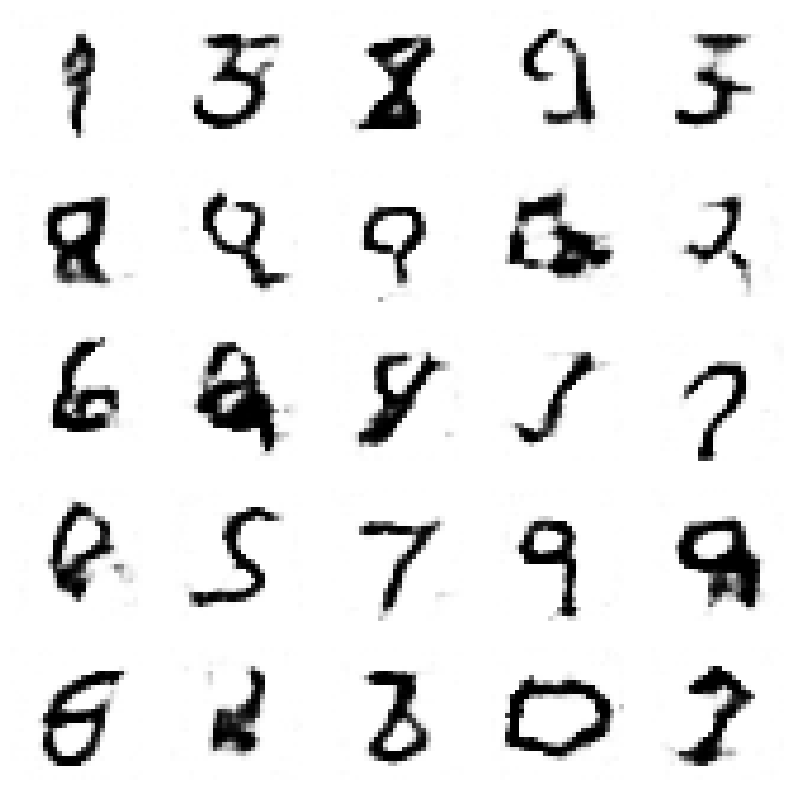

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.18455174310594544, Generator Loss 0.3115058098083887
1/1 [==============================] - 0s 38ms/step


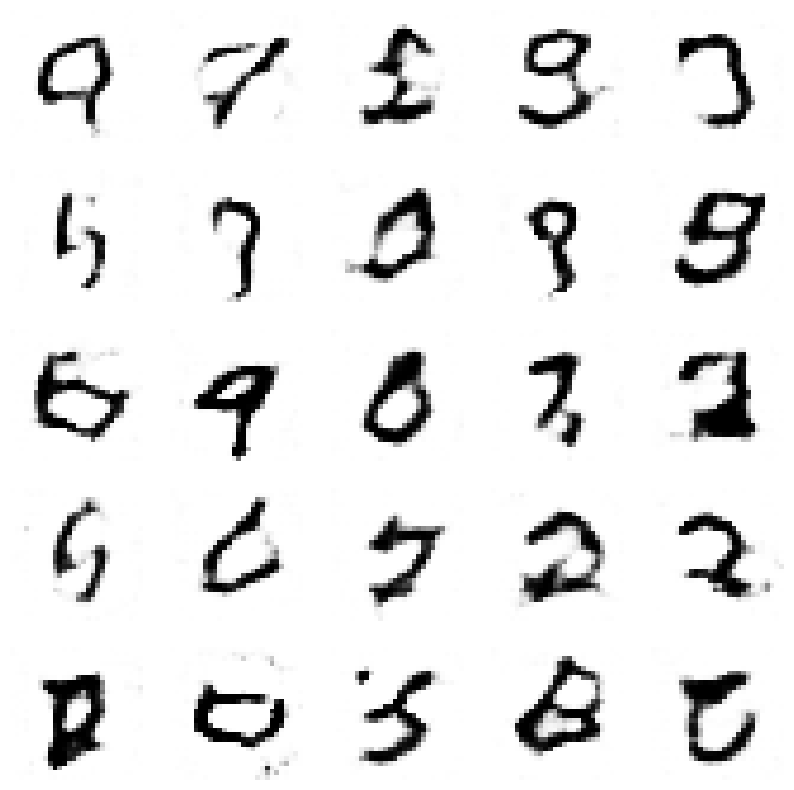

4/4 [==============================] - 0s 6ms/step
Epoch 10, Disc loss 0.1874294803183303, Generator Loss 0.31617421726895195
1/1 [==============================] - 0s 26ms/step


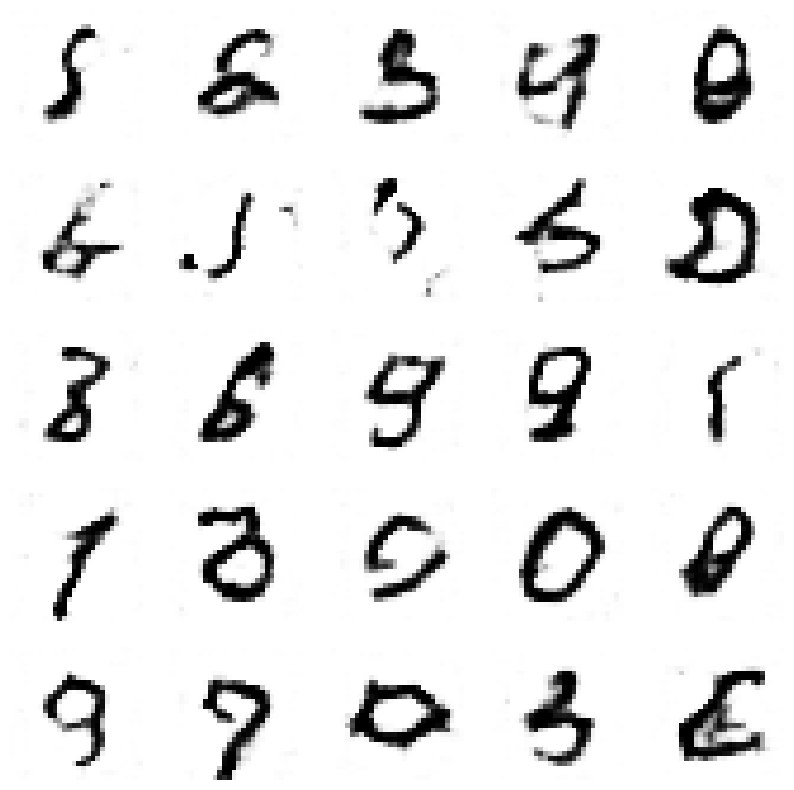

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.19028195267559117, Generator Loss 0.3209216462241279
1/1 [==============================] - 0s 28ms/step


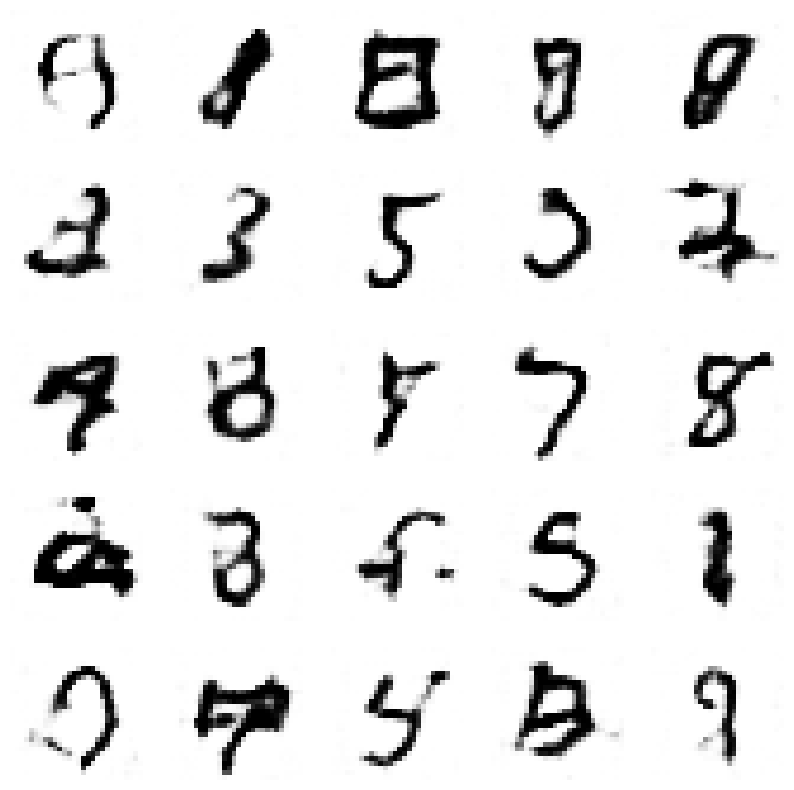

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.19313381077387395, Generator Loss 0.3255401885407603
1/1 [==============================] - 0s 30ms/step


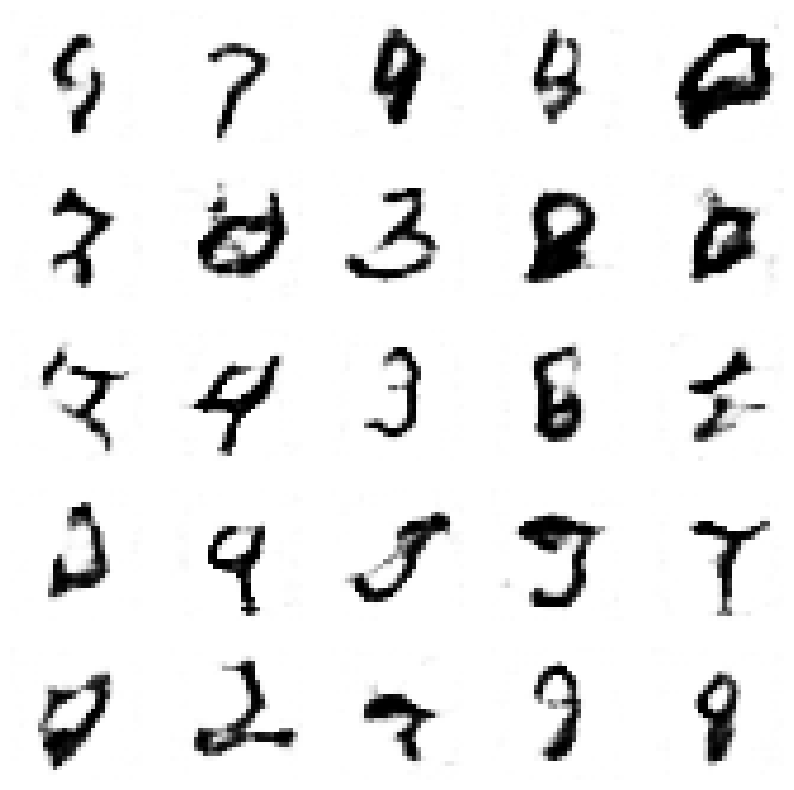

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.195933010460984, Generator Loss 0.33013442795500797
1/1 [==============================] - 0s 26ms/step


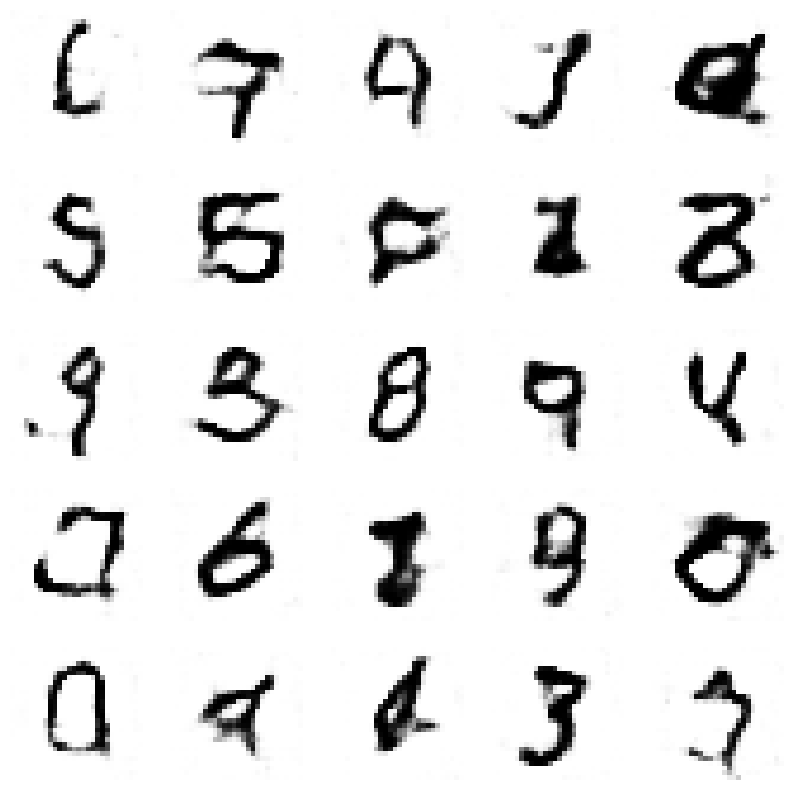

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.19884412232627216, Generator Loss 0.33483828285820466
1/1 [==============================] - 0s 28ms/step


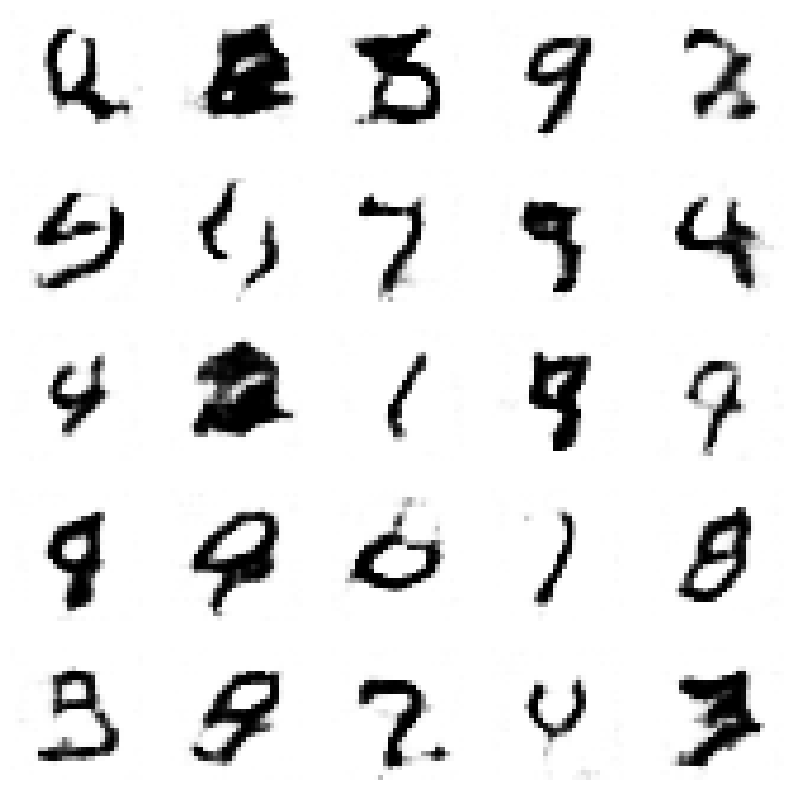

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.20173964082685292, Generator Loss 0.3395812348422841
1/1 [==============================] - 0s 31ms/step


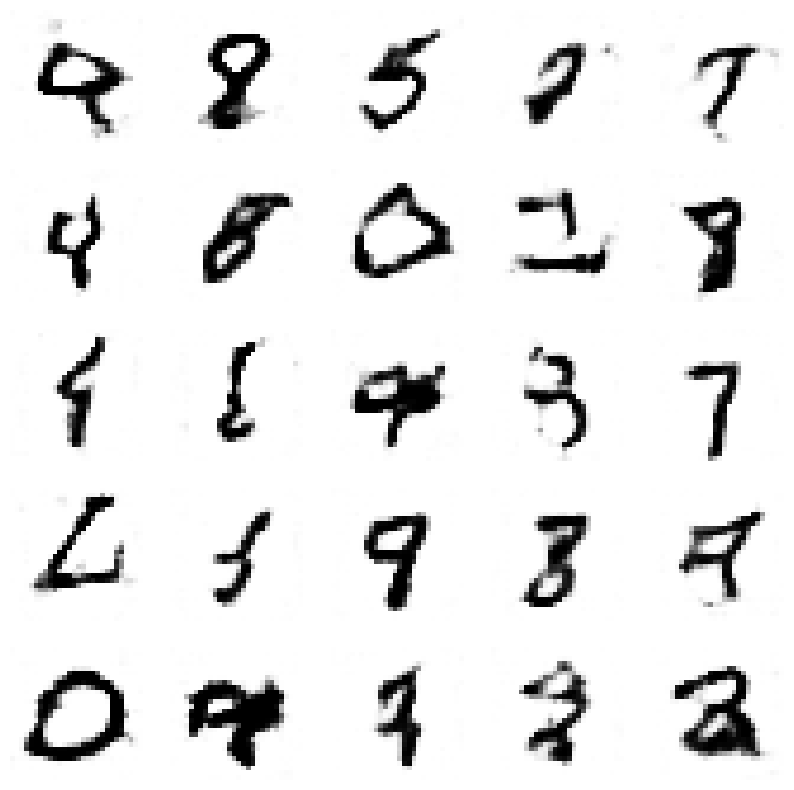

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2044880090870409, Generator Loss 0.34438488218519425
1/1 [==============================] - 0s 30ms/step


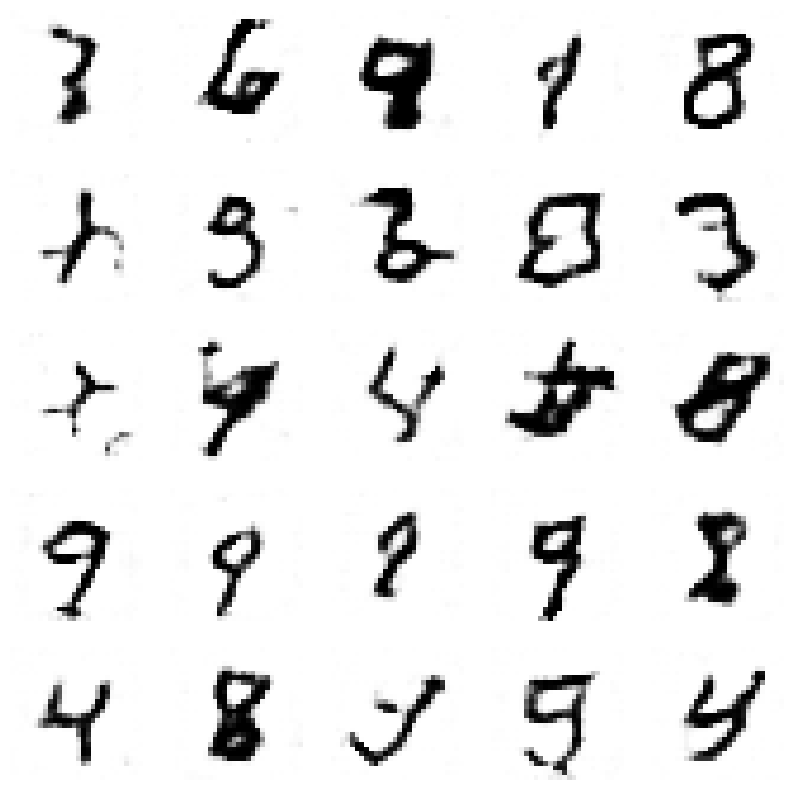

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.20730442967679766, Generator Loss 0.34908059519580287
1/1 [==============================] - 0s 28ms/step


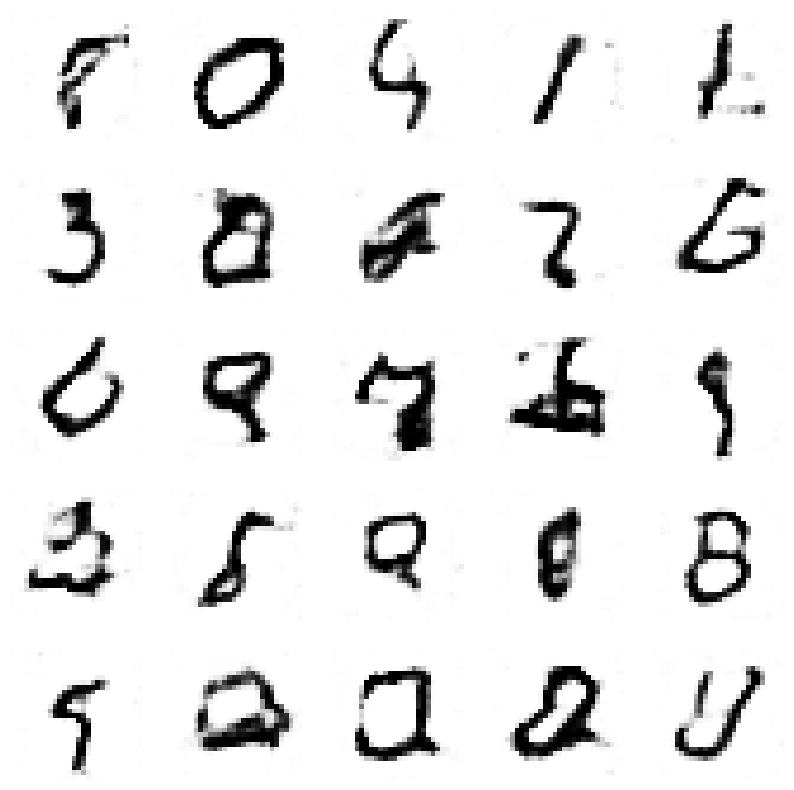

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2101541720649116, Generator Loss 0.35388488341600466
1/1 [==============================] - 0s 29ms/step


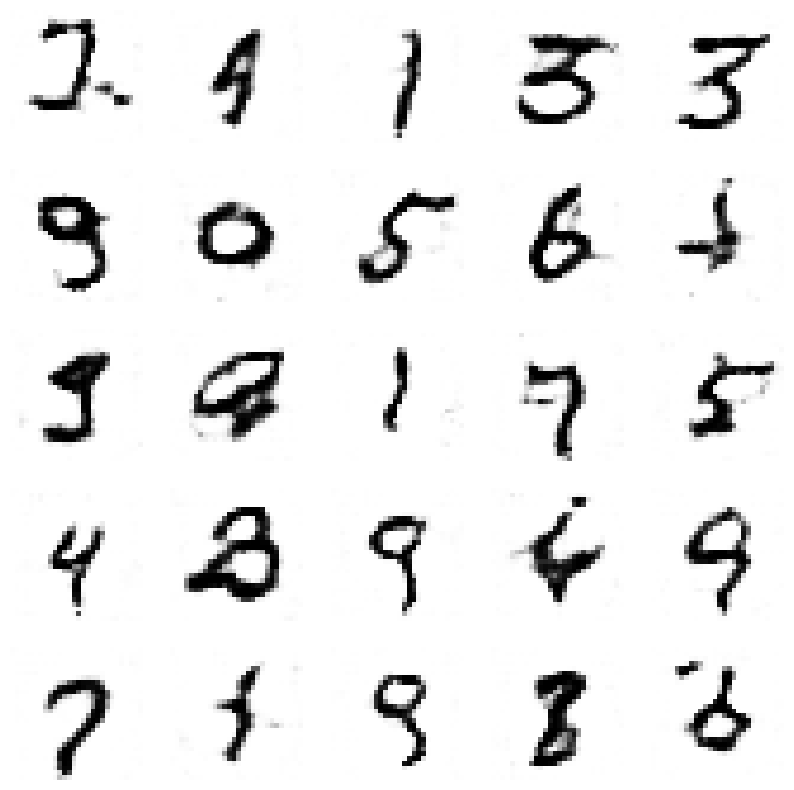

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.21301296315132043, Generator Loss 0.3585304684109158
1/1 [==============================] - 0s 53ms/step


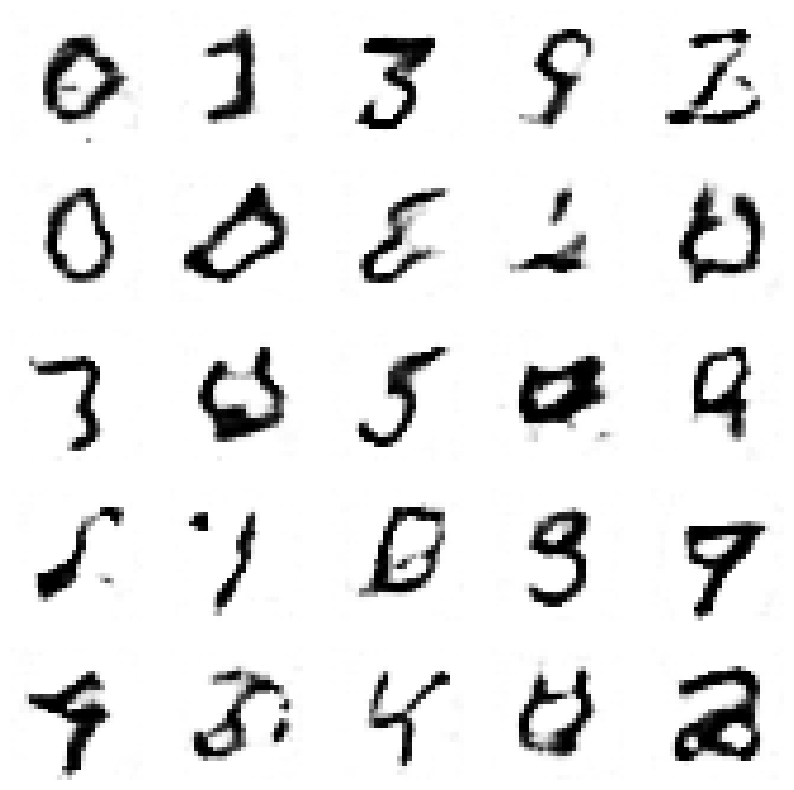

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.21580634119673672, Generator Loss 0.36312427734717345
1/1 [==============================] - 0s 43ms/step


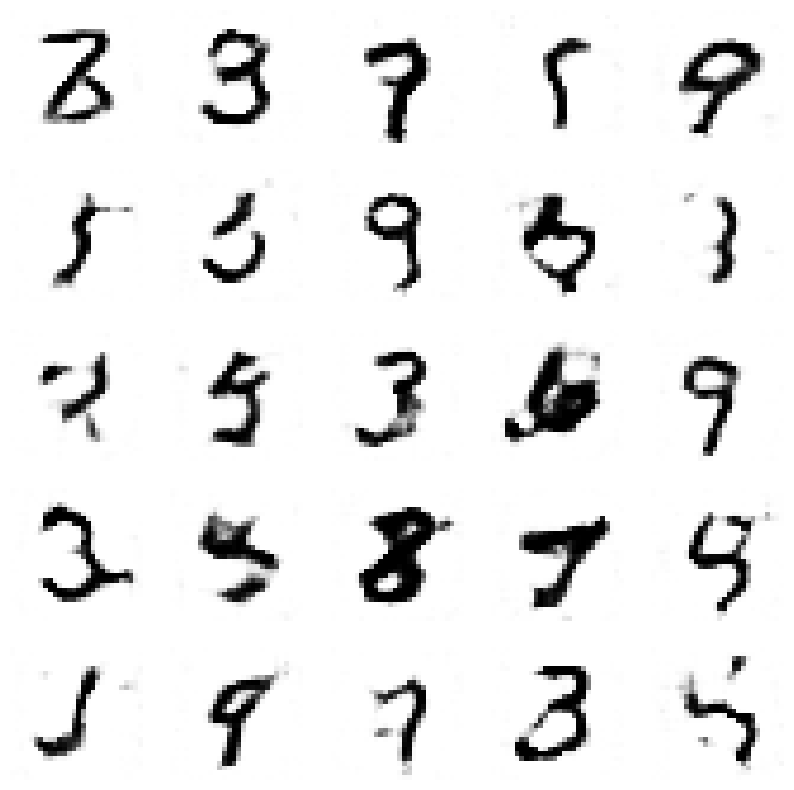

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.21863737282080528, Generator Loss 0.3677495137239114
1/1 [==============================] - 0s 49ms/step


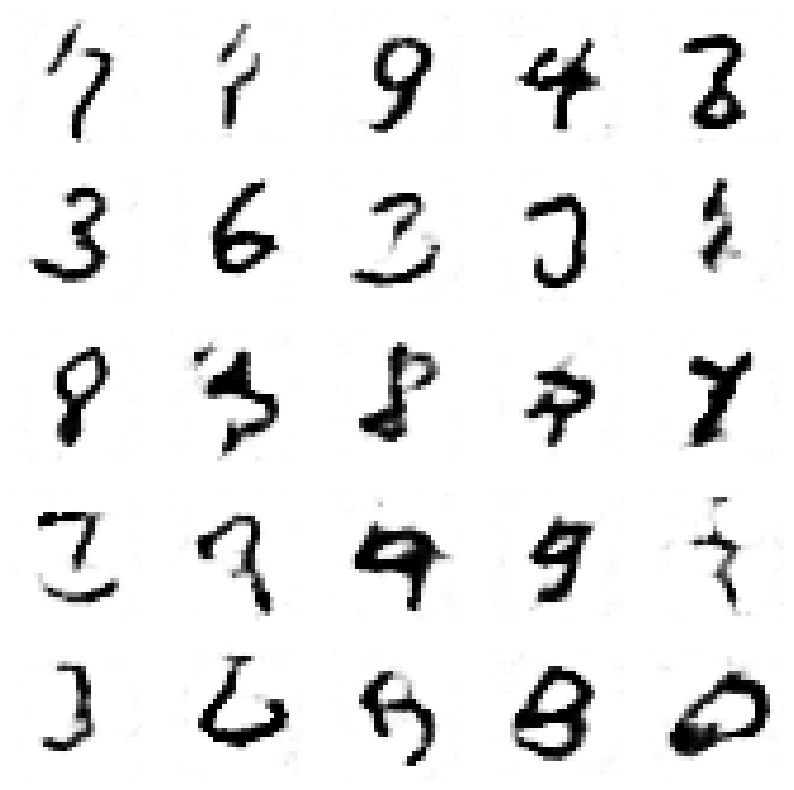

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2214595382539635, Generator Loss 0.3724227669911507
1/1 [==============================] - 0s 35ms/step


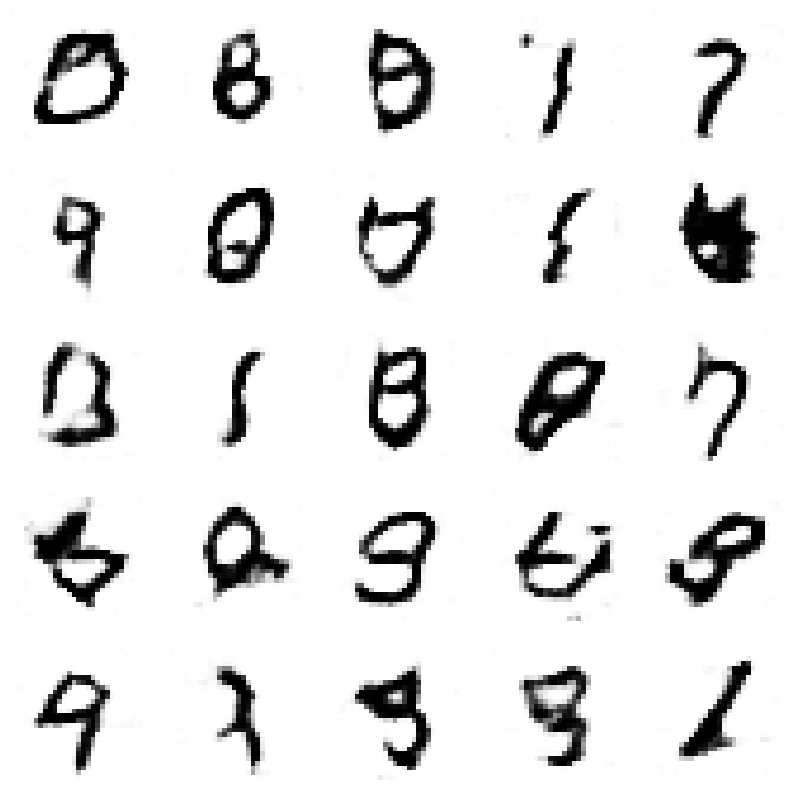

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.22427939018632612, Generator Loss 0.37724492132154286
1/1 [==============================] - 0s 30ms/step


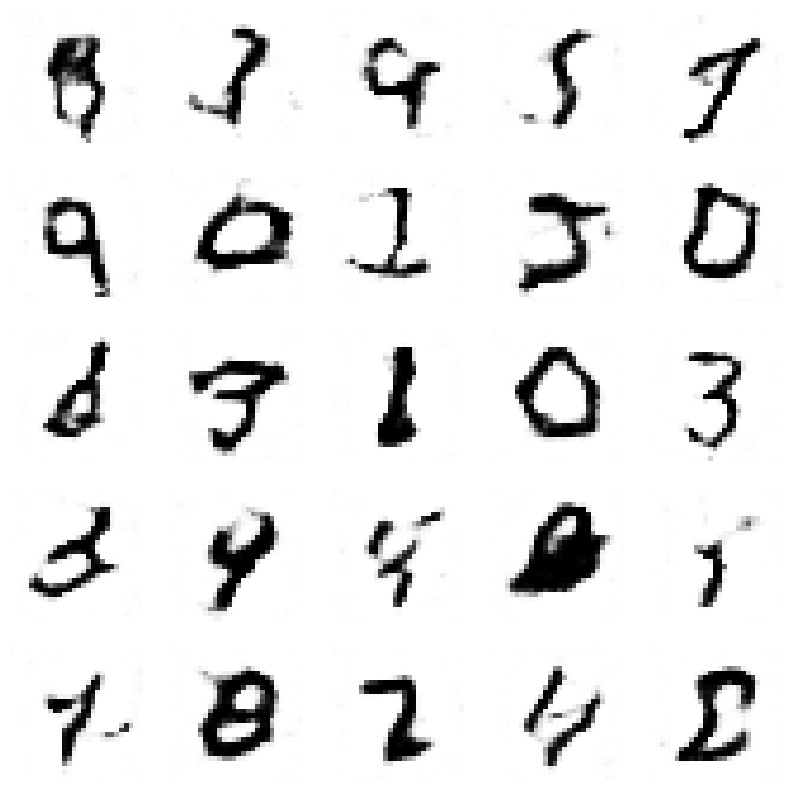

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.22714367508888245, Generator Loss 0.3819596395533309
1/1 [==============================] - 0s 33ms/step


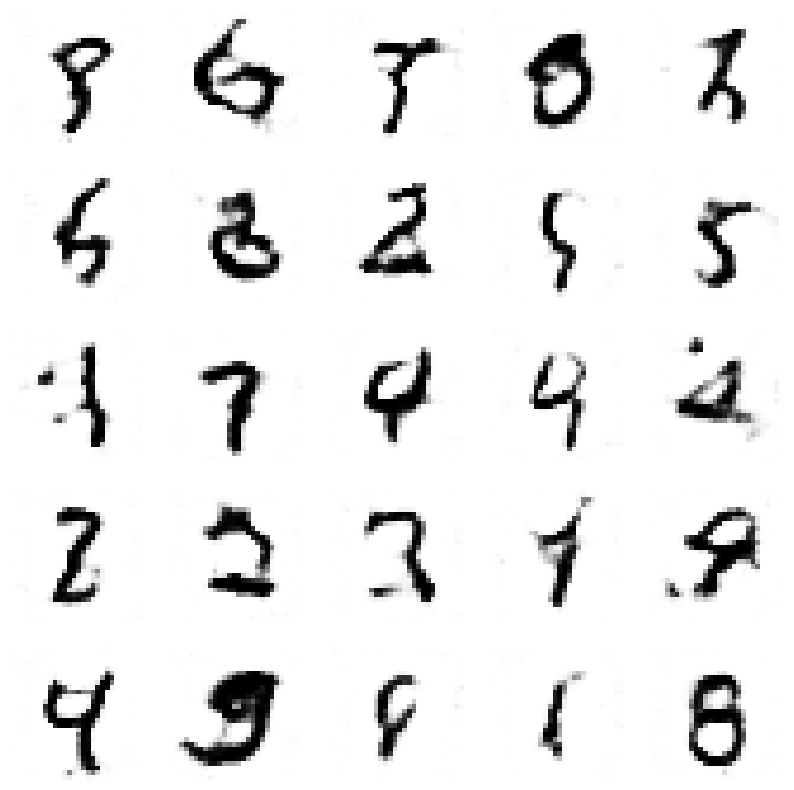

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.2300103085163312, Generator Loss 0.38677621397197753
1/1 [==============================] - 0s 30ms/step


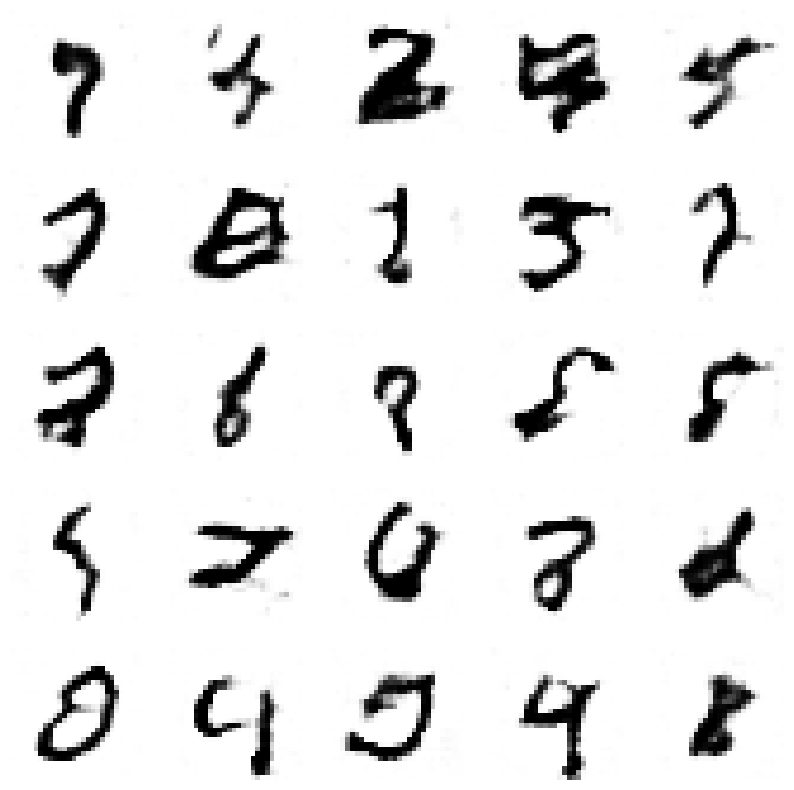

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2328860638742773, Generator Loss 0.3915897251194359
1/1 [==============================] - 0s 30ms/step


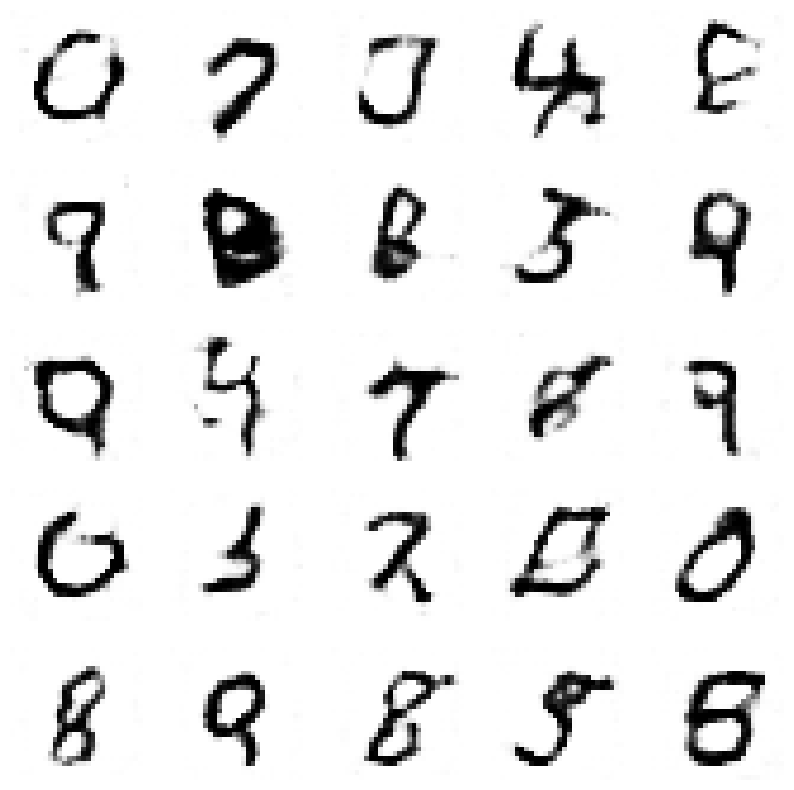

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.23571925756768283, Generator Loss 0.39614114241722304
1/1 [==============================] - 0s 34ms/step


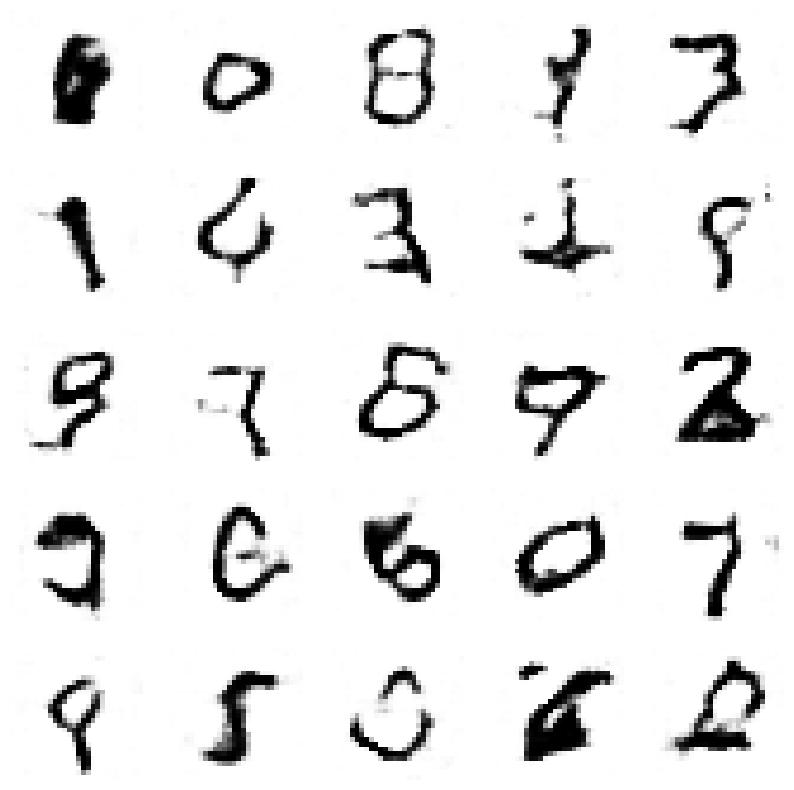

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2385421620729642, Generator Loss 0.4008417608391525
1/1 [==============================] - 0s 28ms/step


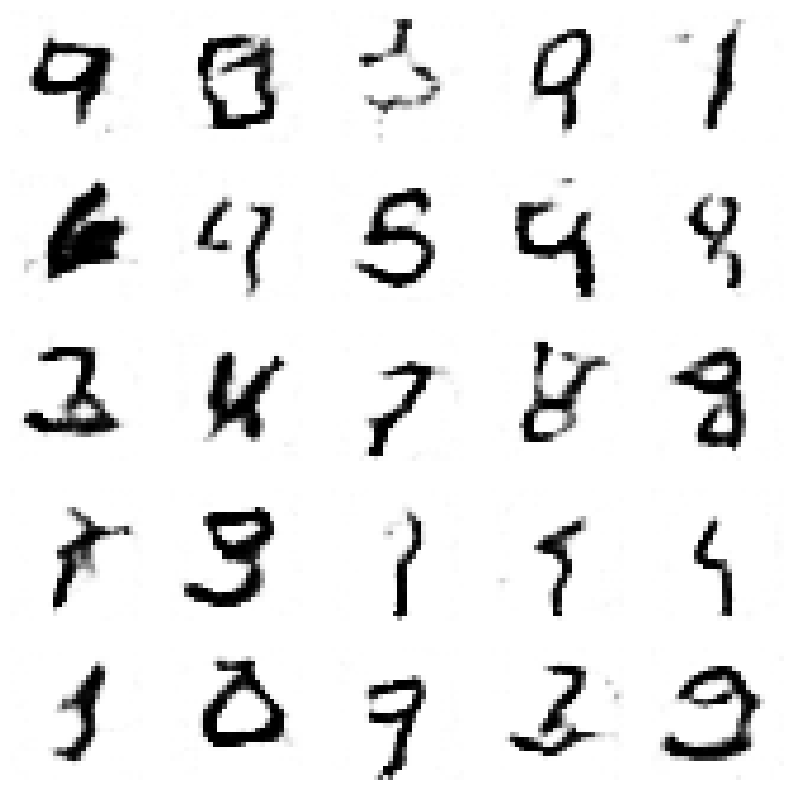

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.24139681063656115, Generator Loss 0.40564205096318173
1/1 [==============================] - 0s 44ms/step


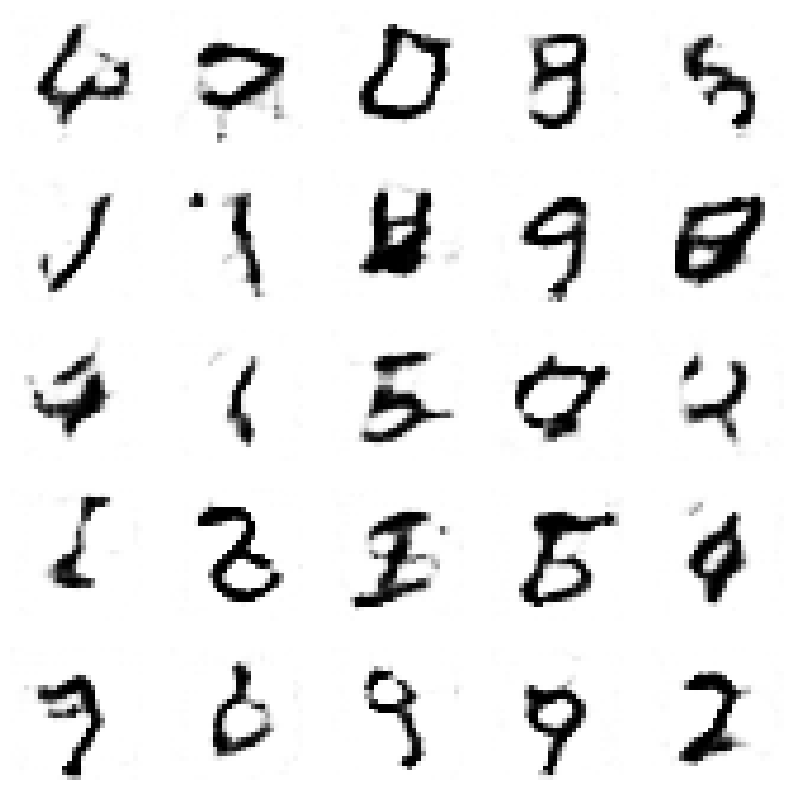

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.24425645732981527, Generator Loss 0.41037252825549525
1/1 [==============================] - 0s 43ms/step


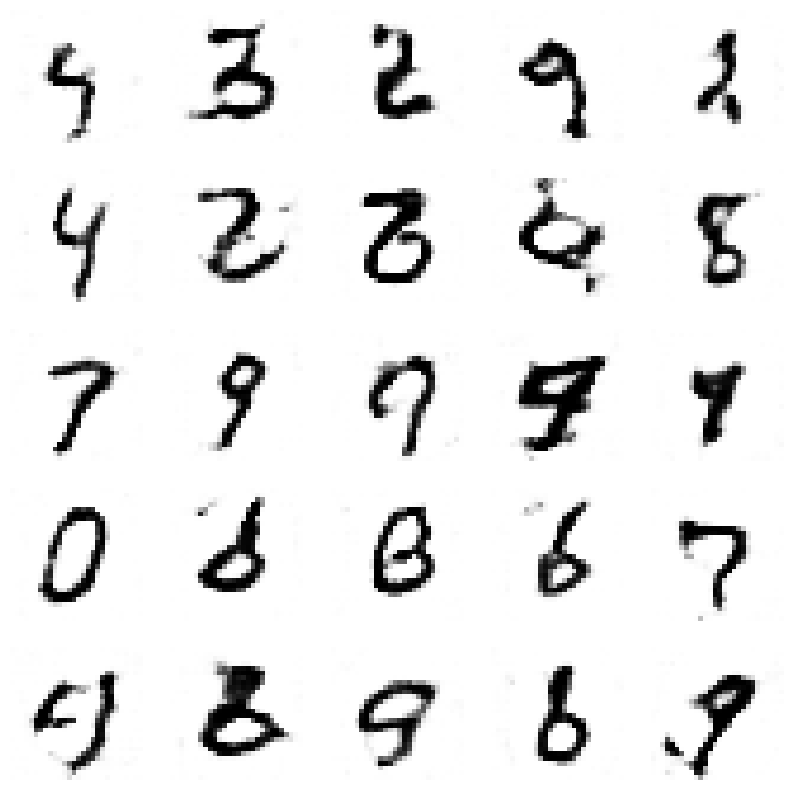

4/4 [==============================] - 0s 6ms/step
Epoch 10, Disc loss 0.24710307021935782, Generator Loss 0.415136823287377
1/1 [==============================] - 0s 34ms/step


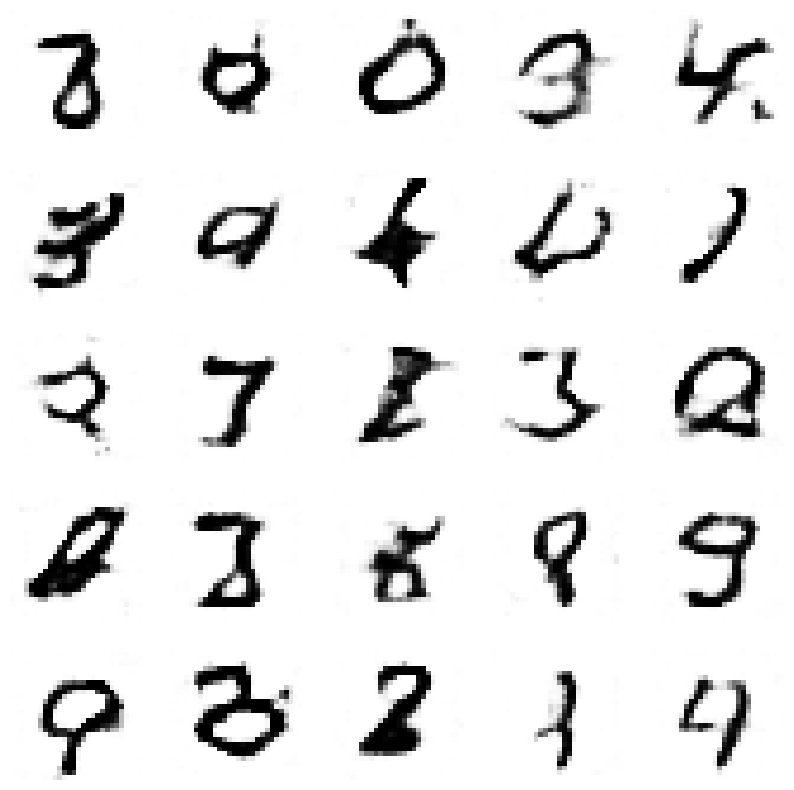

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.24990026996685907, Generator Loss 0.42004762144170255
1/1 [==============================] - 0s 27ms/step


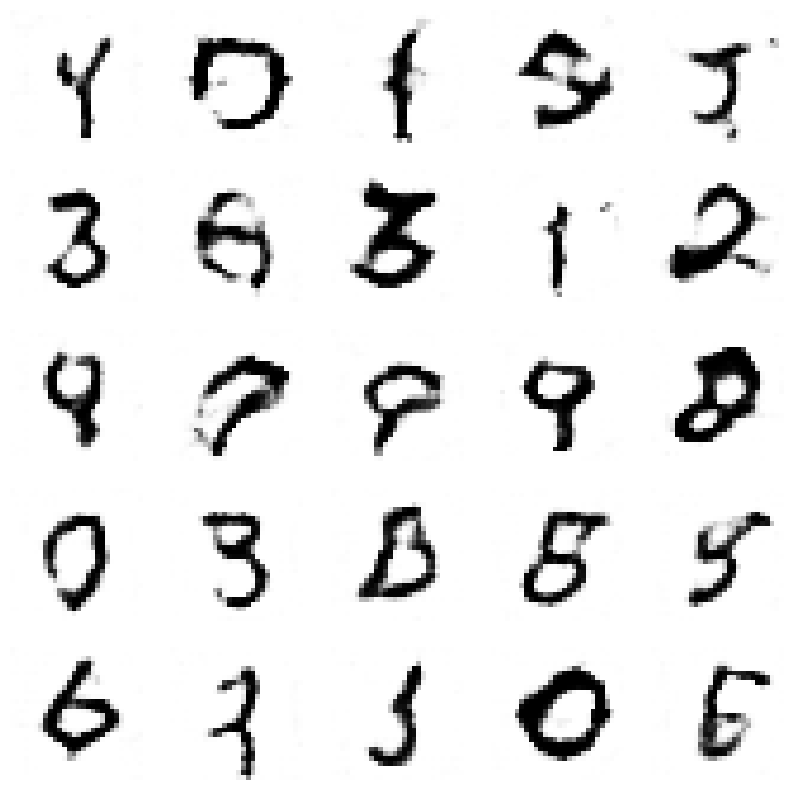

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.25275494094587797, Generator Loss 0.424656428842463
1/1 [==============================] - 0s 27ms/step


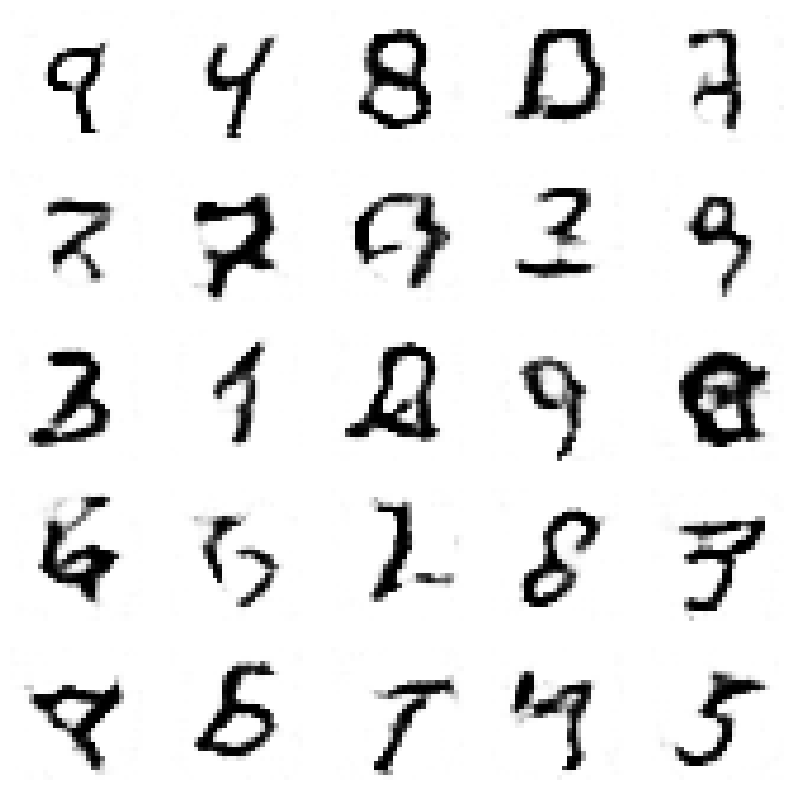

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.25562934271800214, Generator Loss 0.4294021251874092
1/1 [==============================] - 0s 27ms/step


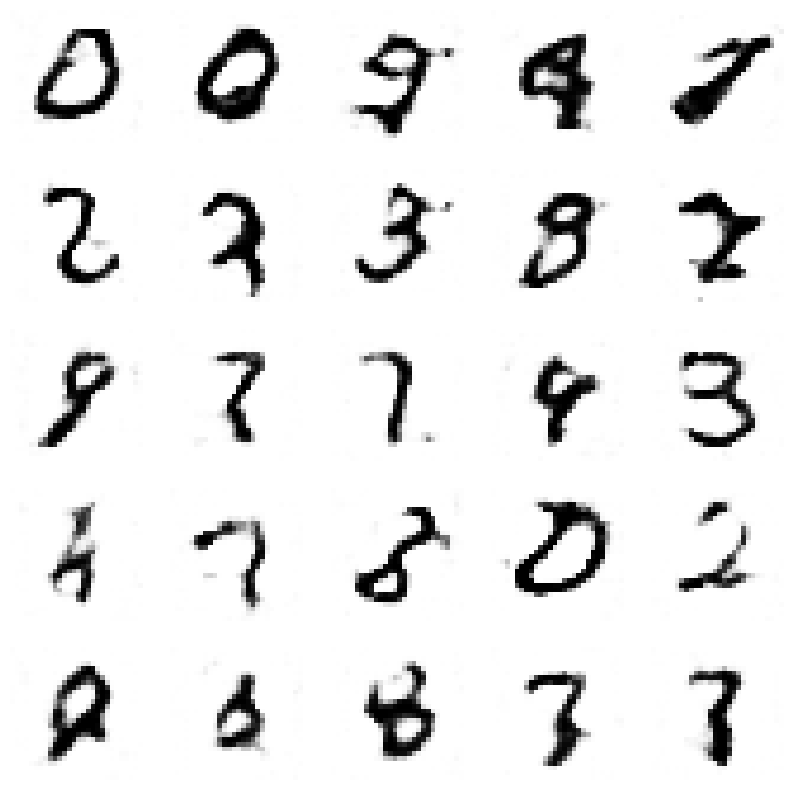

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.25844371802786476, Generator Loss 0.4341965506219456
1/1 [==============================] - 0s 39ms/step


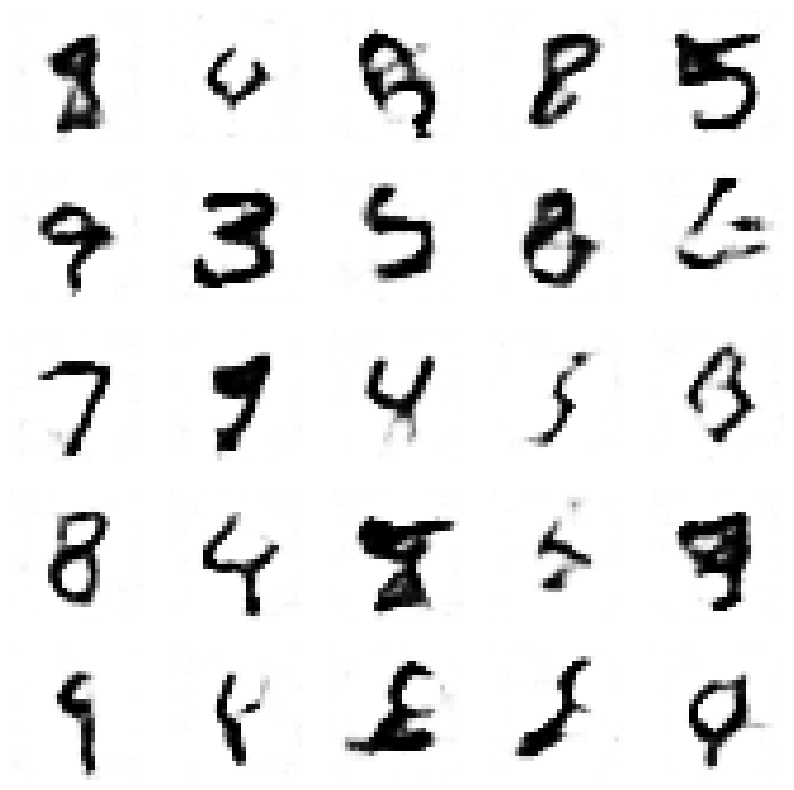

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2612956092398391, Generator Loss 0.43917625684004563
1/1 [==============================] - 0s 27ms/step


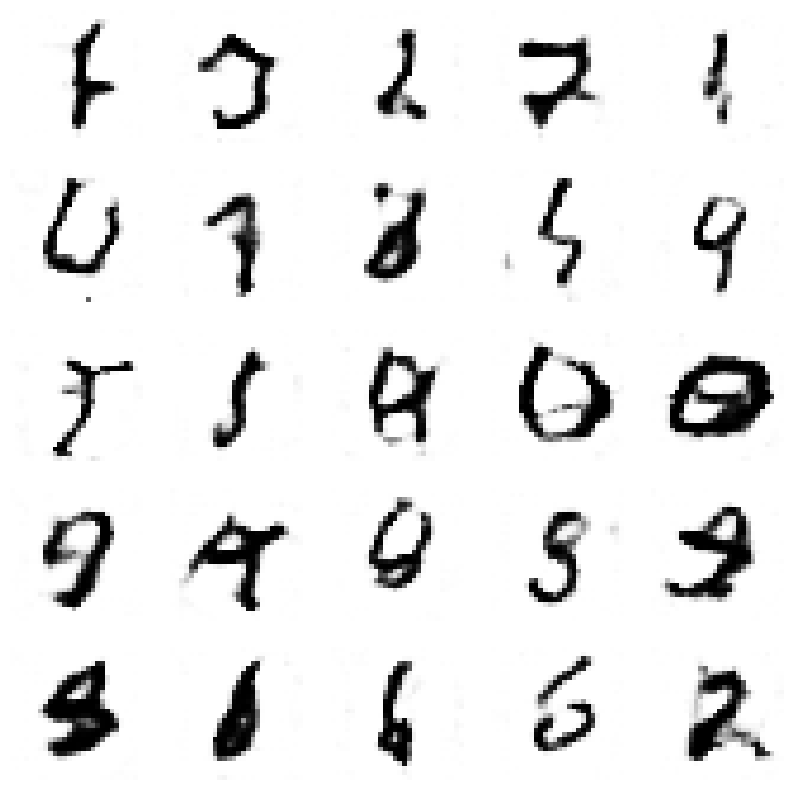

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.2641586471571882, Generator Loss 0.4439335536753011
1/1 [==============================] - 0s 25ms/step


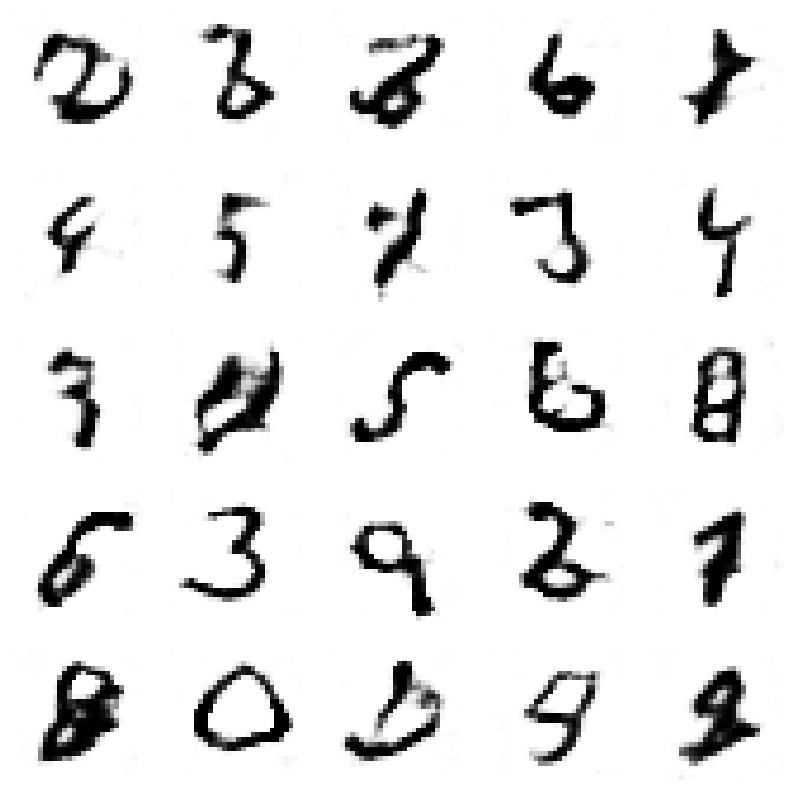

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.26703830381743926, Generator Loss 0.4486614149859828
1/1 [==============================] - 0s 31ms/step


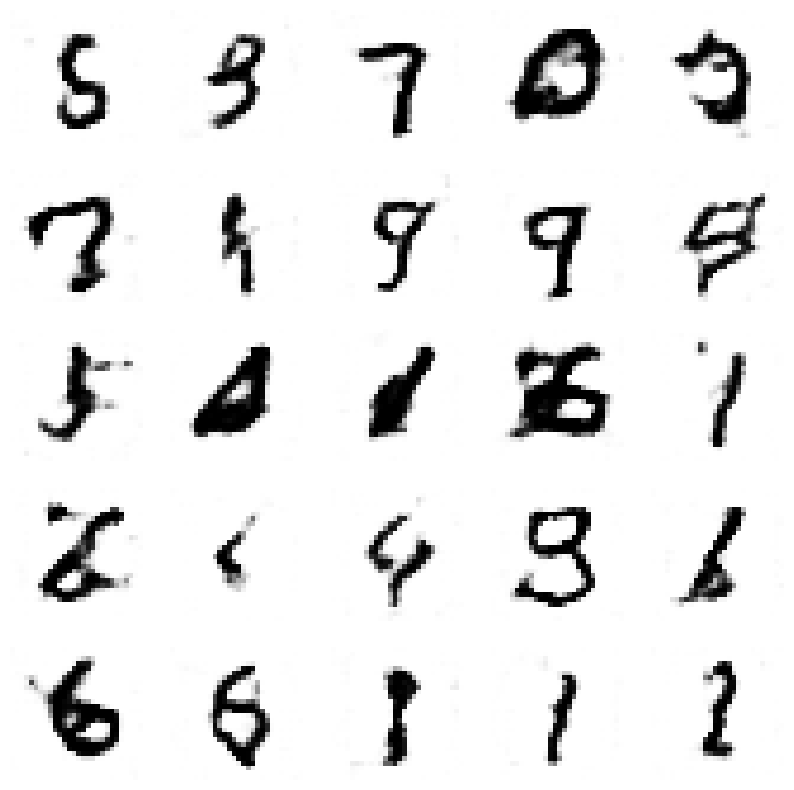

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.26992808600776214, Generator Loss 0.4534383044283614
1/1 [==============================] - 0s 31ms/step


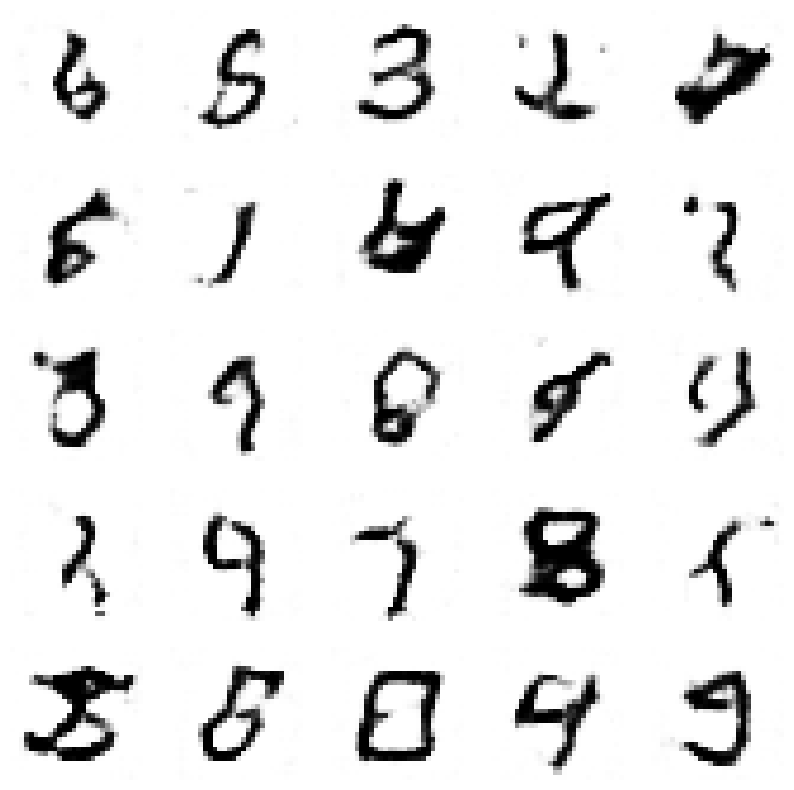

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.2727520612315235, Generator Loss 0.4582034685672858
1/1 [==============================] - 0s 32ms/step


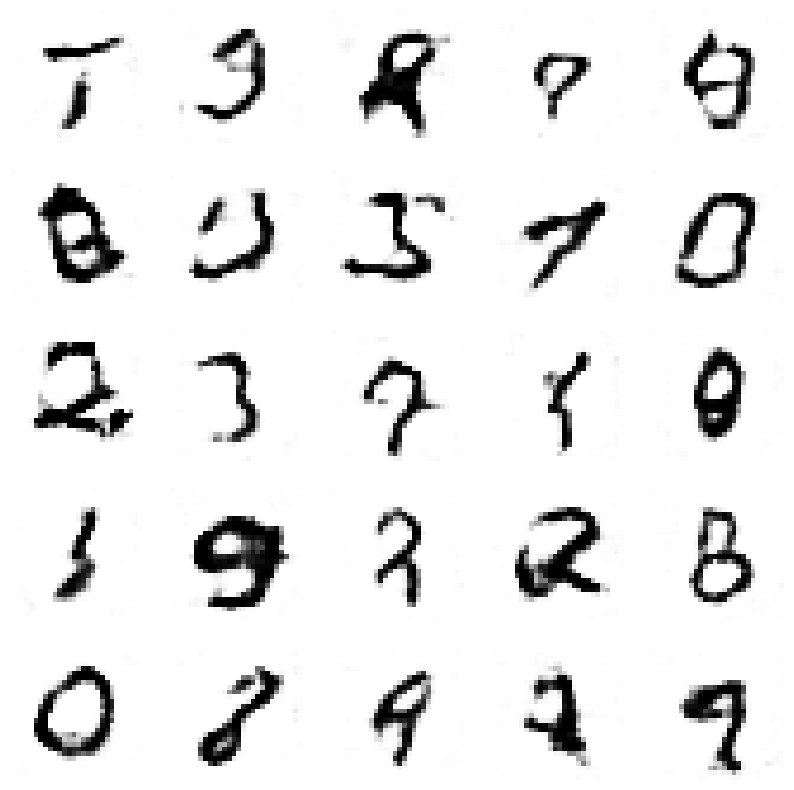

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.27557031491882783, Generator Loss 0.4629370621126941
1/1 [==============================] - 0s 57ms/step


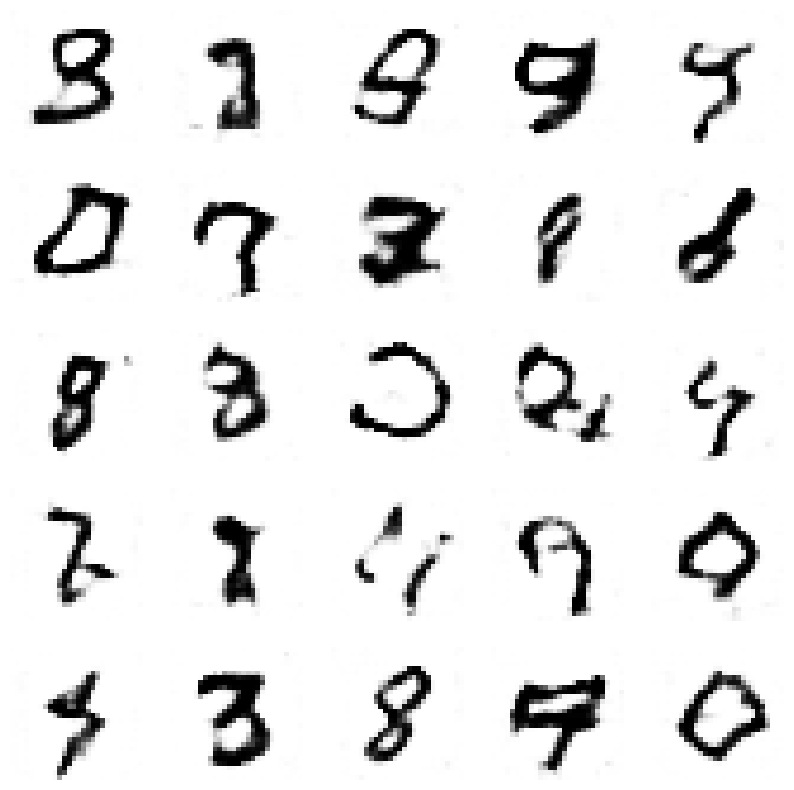

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.27849894074293285, Generator Loss 0.4674609155736418
1/1 [==============================] - 0s 57ms/step


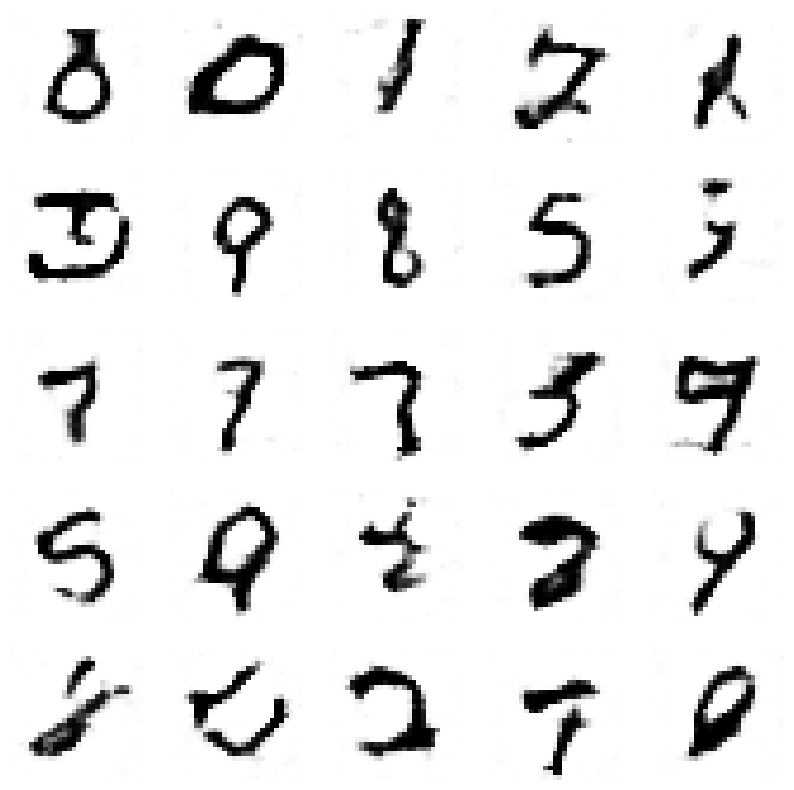

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.28121391346311975, Generator Loss 0.47212029012859374
1/1 [==============================] - 0s 26ms/step


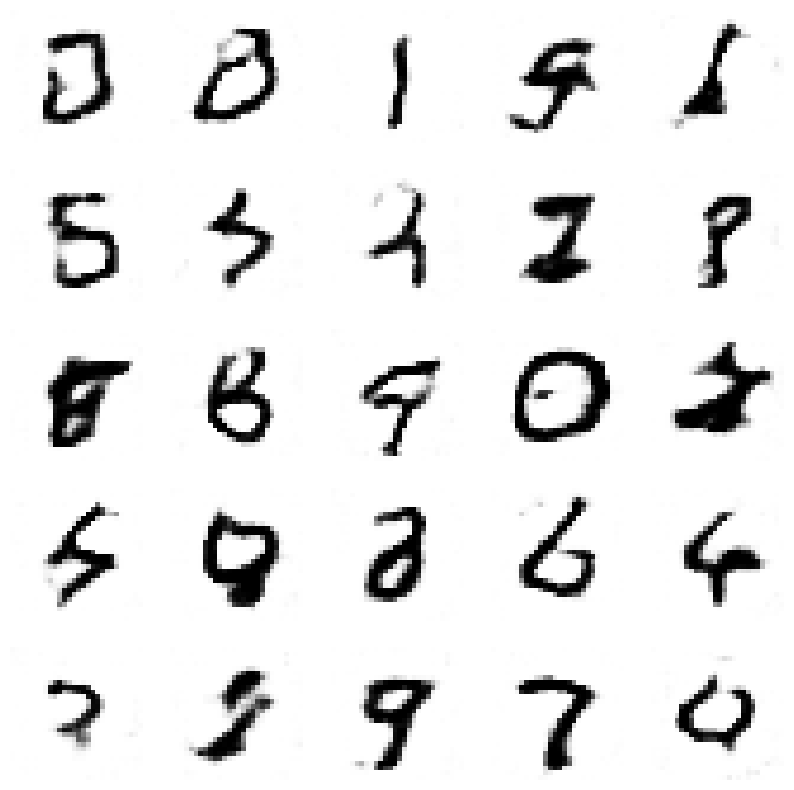

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.28406496078540117, Generator Loss 0.4769126864580008
1/1 [==============================] - 0s 29ms/step


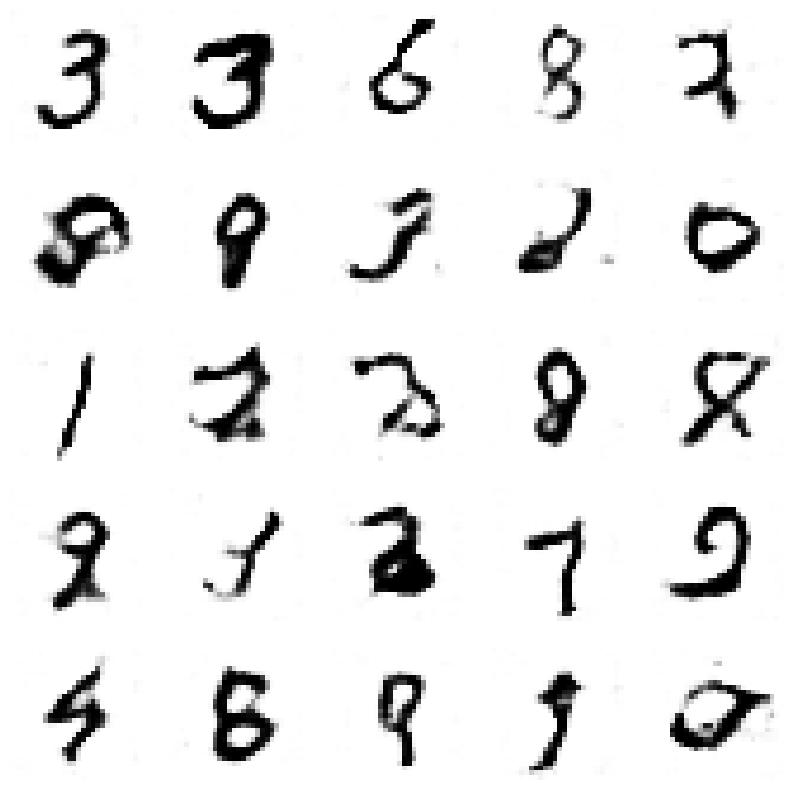

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.28690451842087966, Generator Loss 0.4817565195580833
1/1 [==============================] - 0s 28ms/step


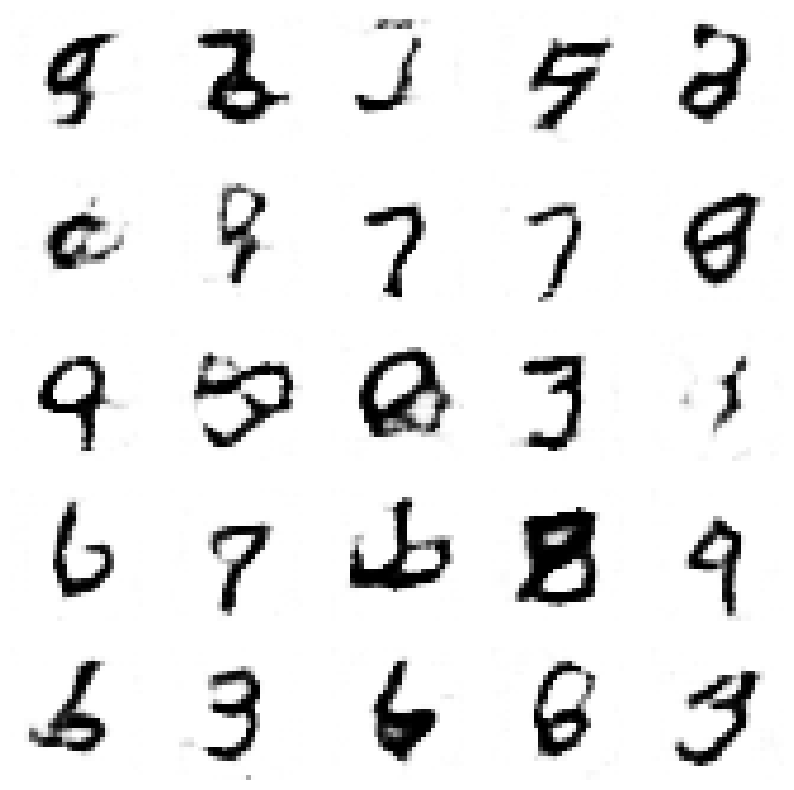

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.28992662699813515, Generator Loss 0.48660330589000994
1/1 [==============================] - 0s 29ms/step


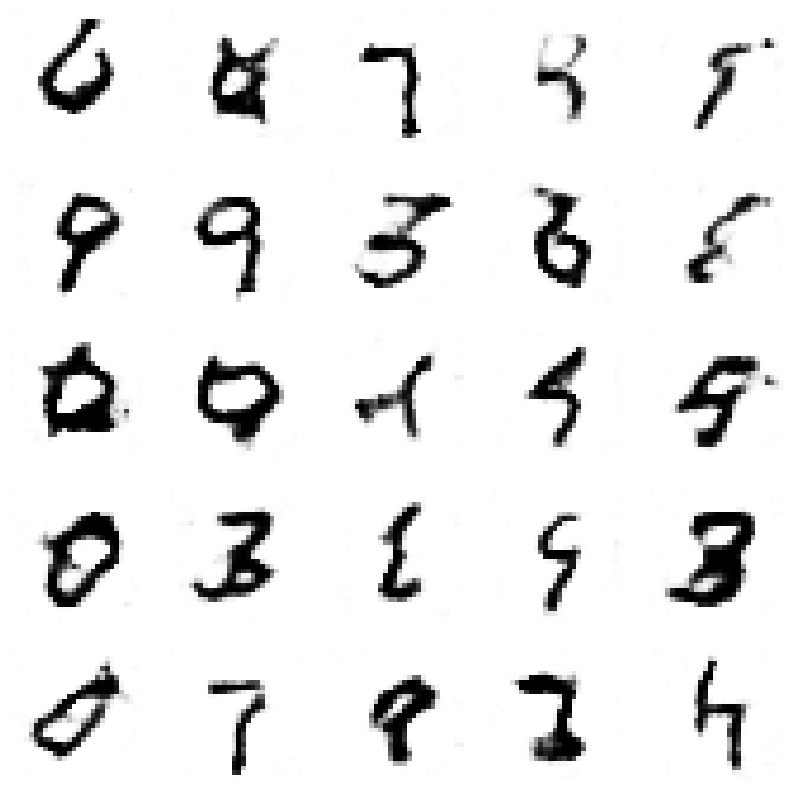

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.29280583420370376, Generator Loss 0.49124167210016495
1/1 [==============================] - 0s 39ms/step


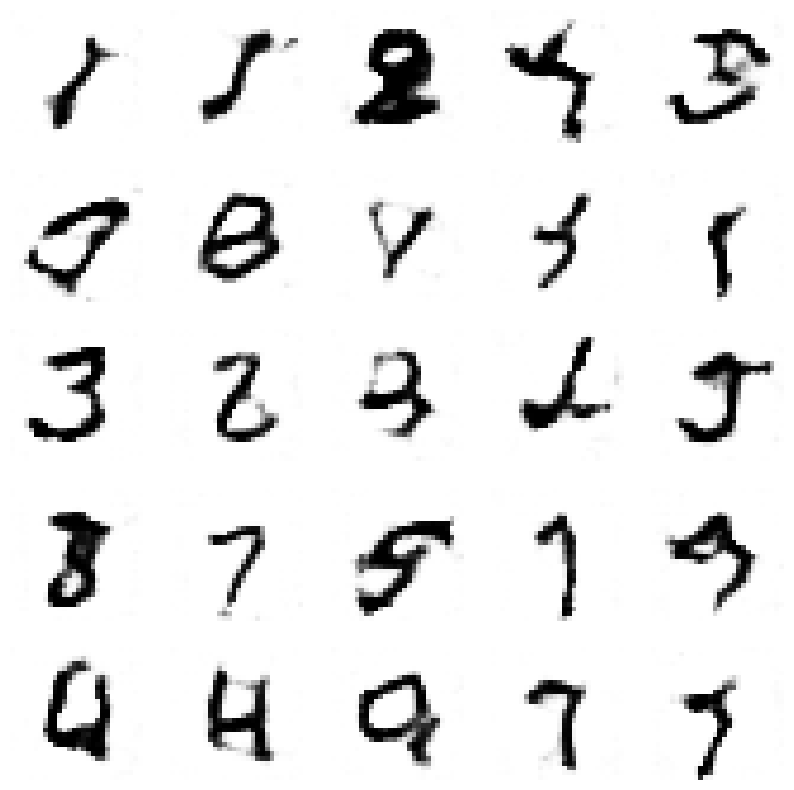

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.2955847080701437, Generator Loss 0.49588025737012553
1/1 [==============================] - 0s 27ms/step


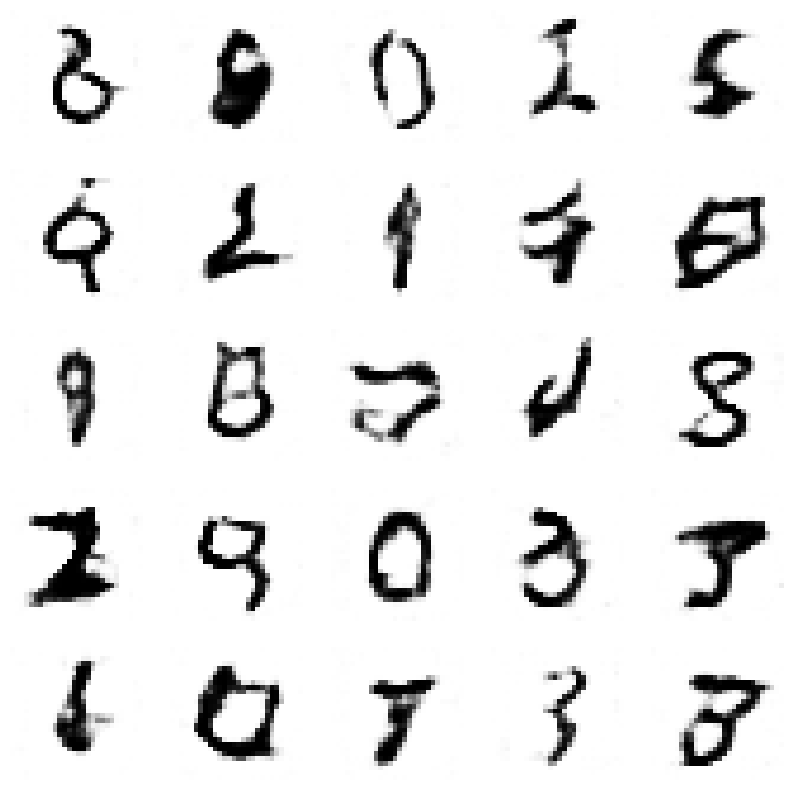

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.2984059343480656, Generator Loss 0.5004333109937162
1/1 [==============================] - 0s 26ms/step


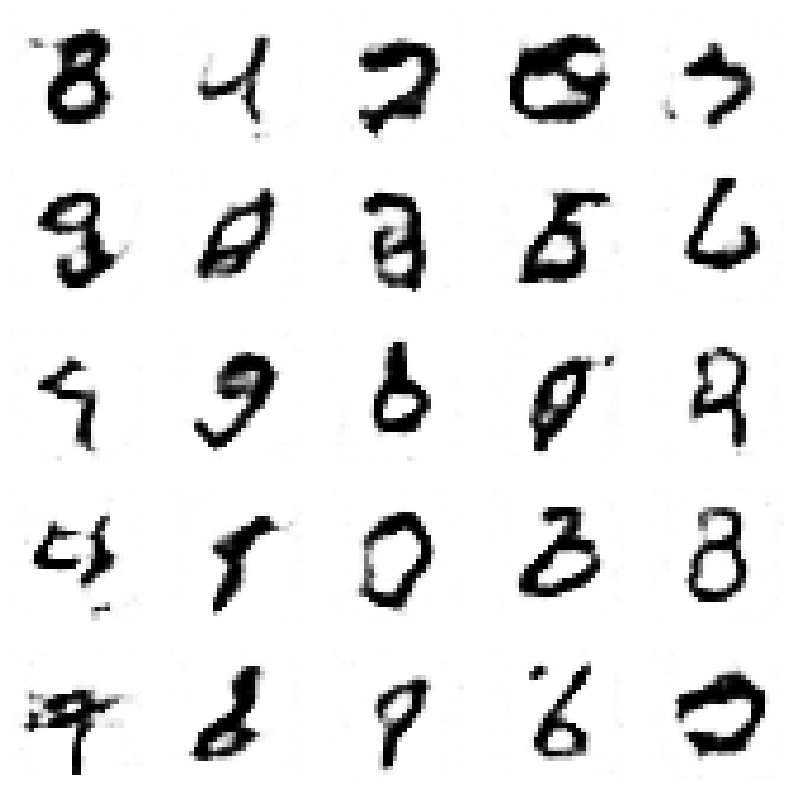

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3011902672612769, Generator Loss 0.5050917716107817
1/1 [==============================] - 0s 59ms/step


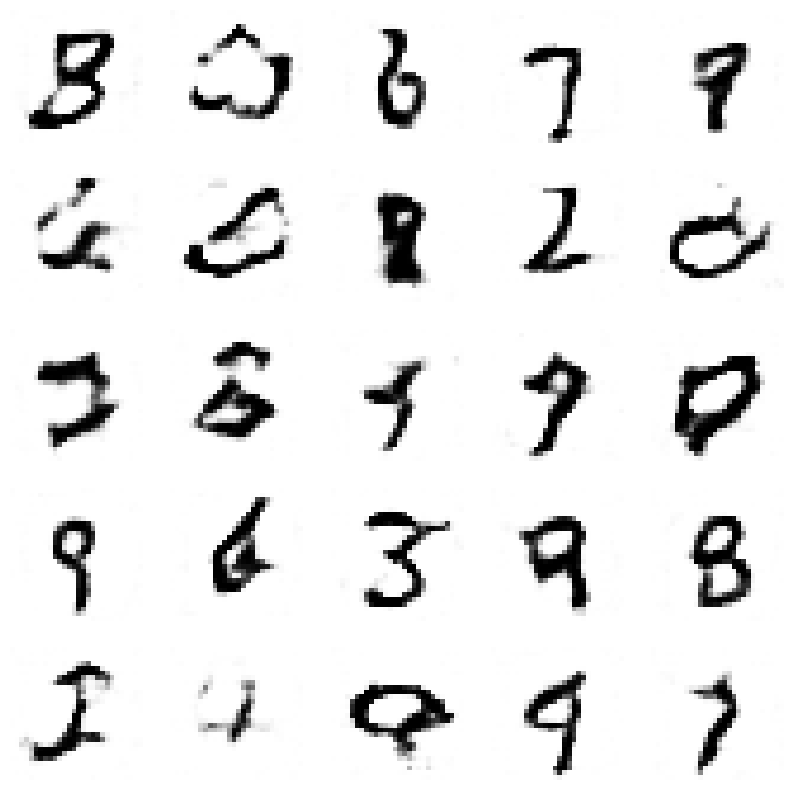

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.3039214892519845, Generator Loss 0.5098321544818389
1/1 [==============================] - 0s 30ms/step


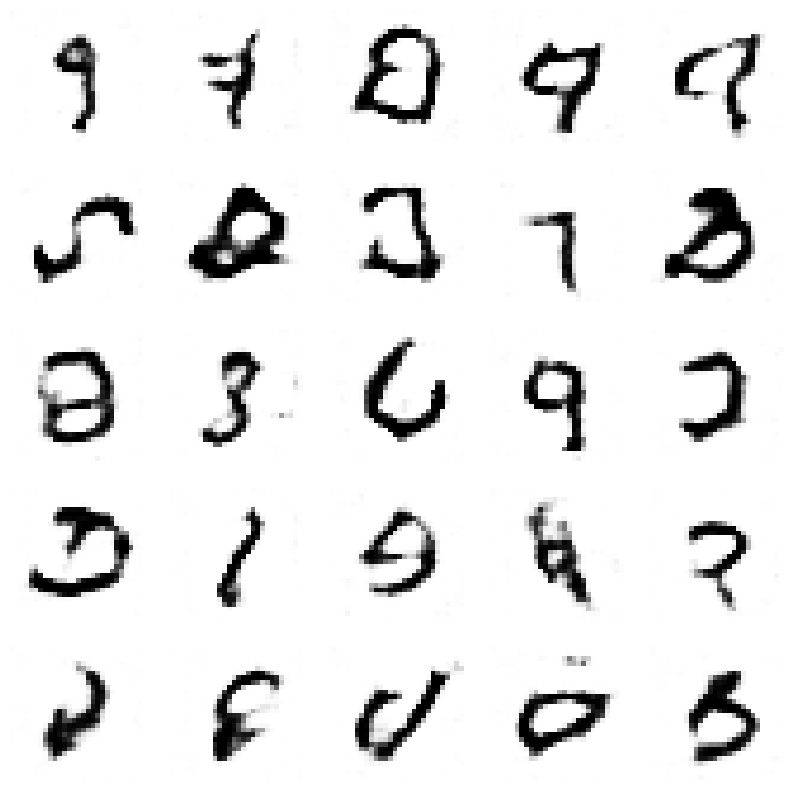

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3067320484636176, Generator Loss 0.5145165375155262
1/1 [==============================] - 0s 61ms/step


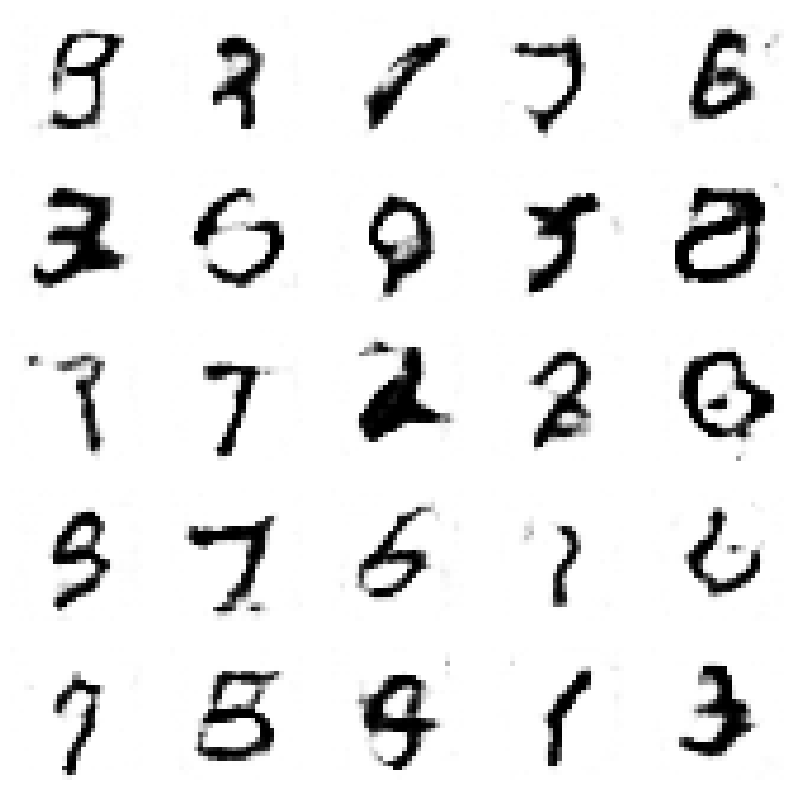

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.30977954912898886, Generator Loss 0.5191109547248254
1/1 [==============================] - 0s 27ms/step


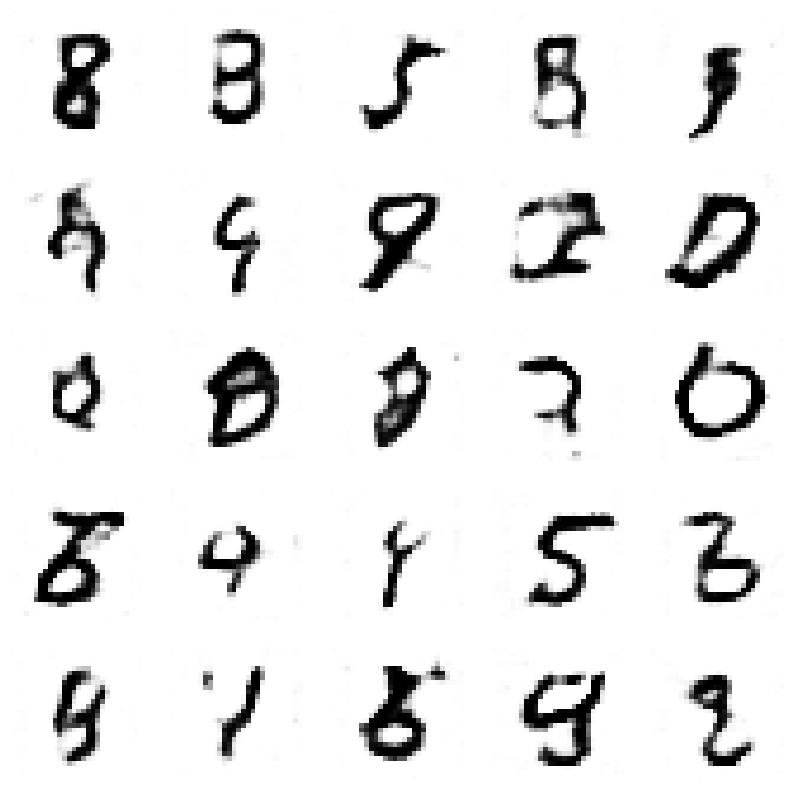

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.31256871001842695, Generator Loss 0.5237431291841034
1/1 [==============================] - 0s 38ms/step


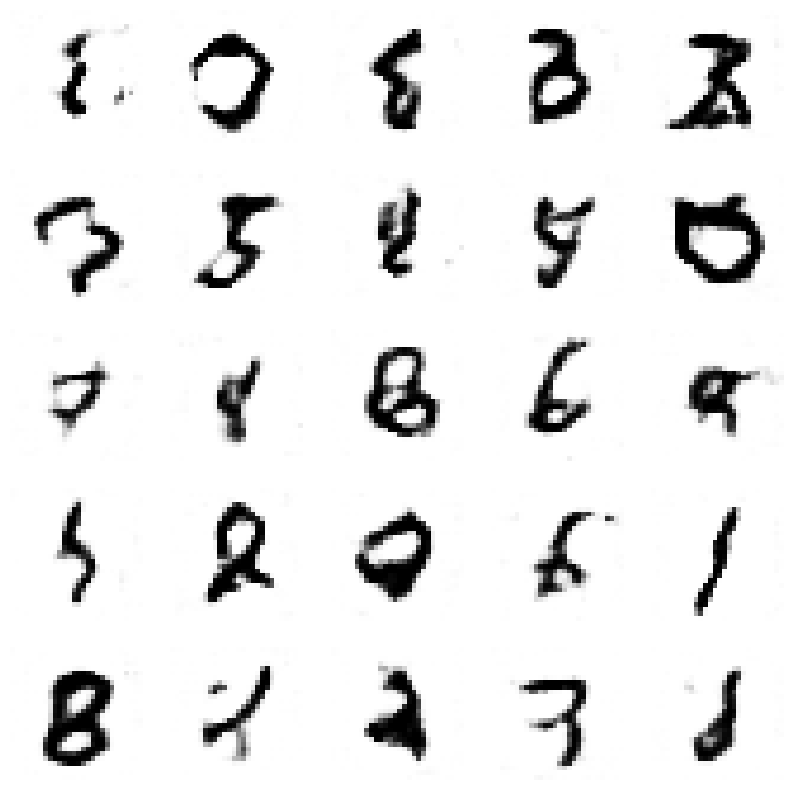

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.31540942943503714, Generator Loss 0.5285242632922963
1/1 [==============================] - 0s 26ms/step


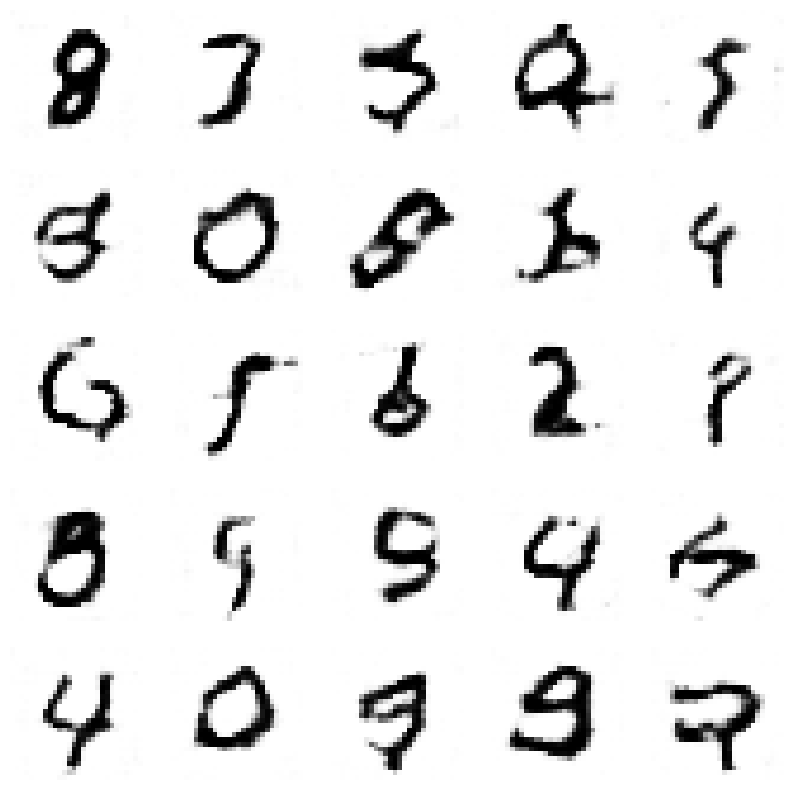

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3182529709023288, Generator Loss 0.5333176066732814
1/1 [==============================] - 0s 27ms/step


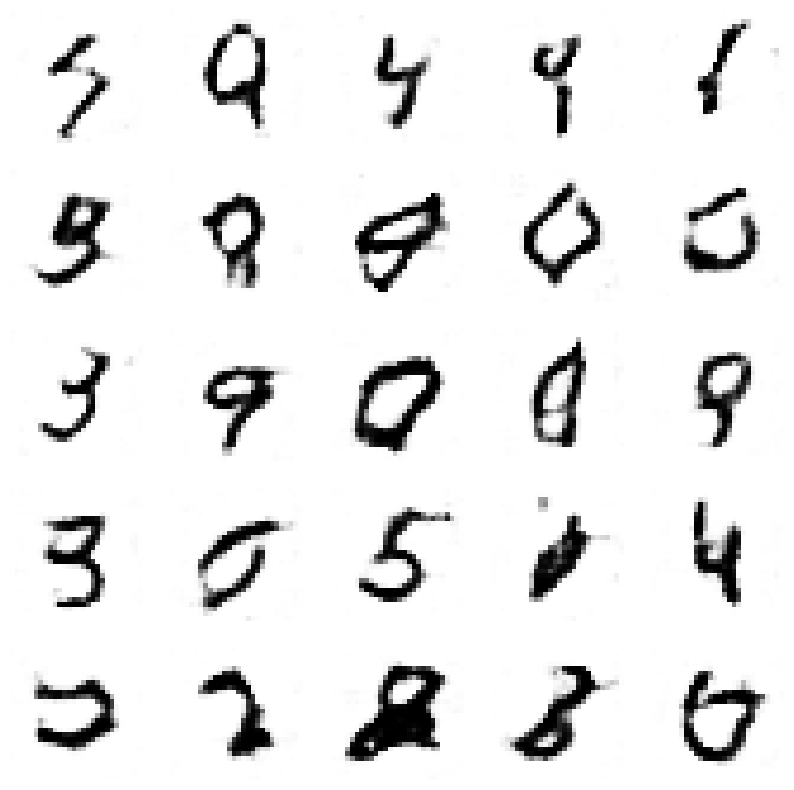

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.3210566916272172, Generator Loss 0.538067202282767
1/1 [==============================] - 0s 27ms/step


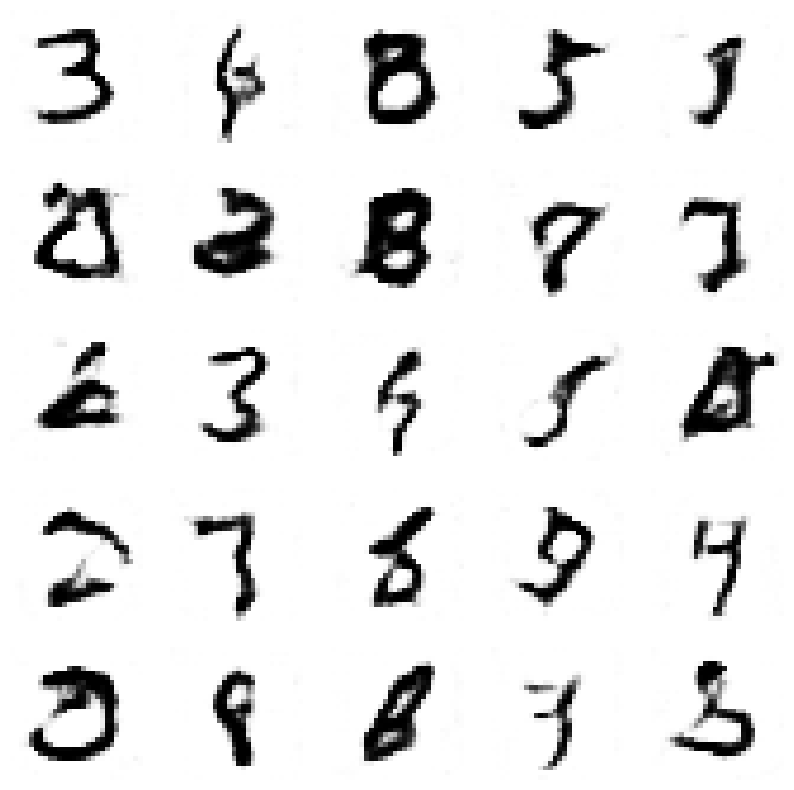

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.32379696499078703, Generator Loss 0.5429359883324713
1/1 [==============================] - 0s 28ms/step


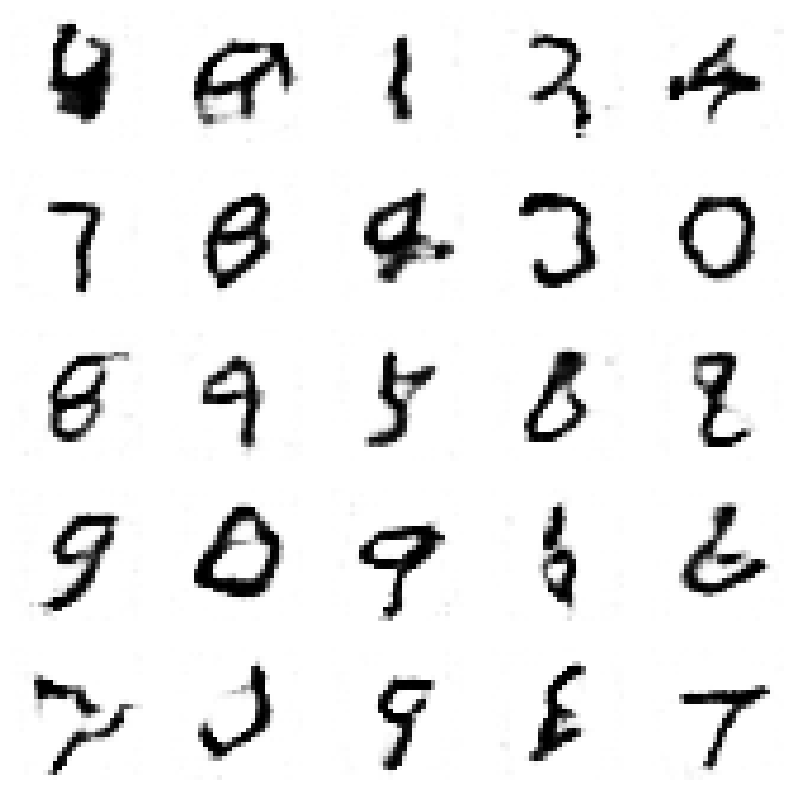

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.32668250264265597, Generator Loss 0.547532908936851
1/1 [==============================] - 0s 26ms/step


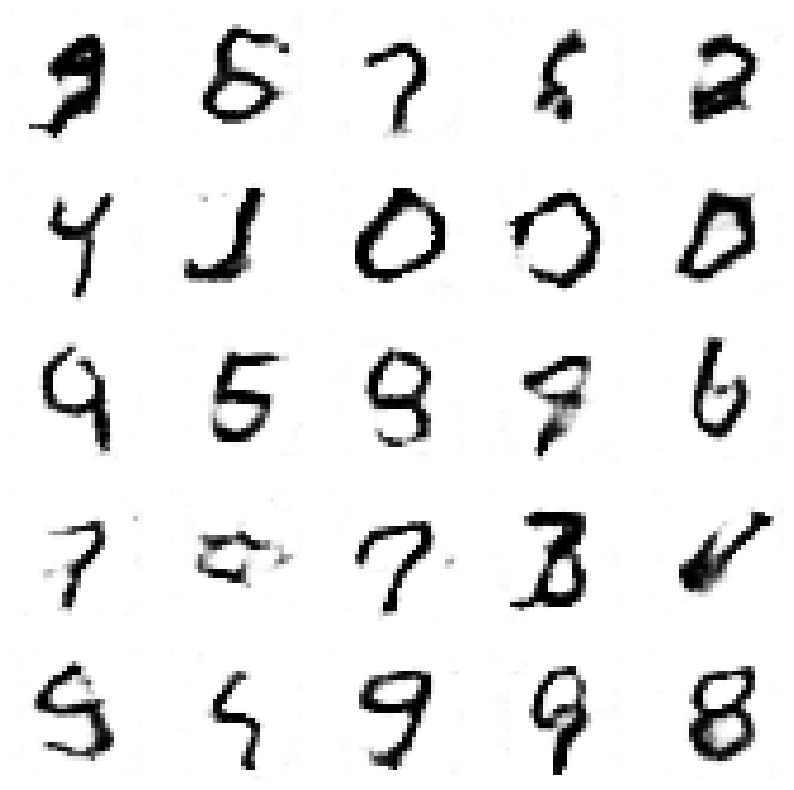

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3295248716305464, Generator Loss 0.552195731900696
1/1 [==============================] - 0s 51ms/step


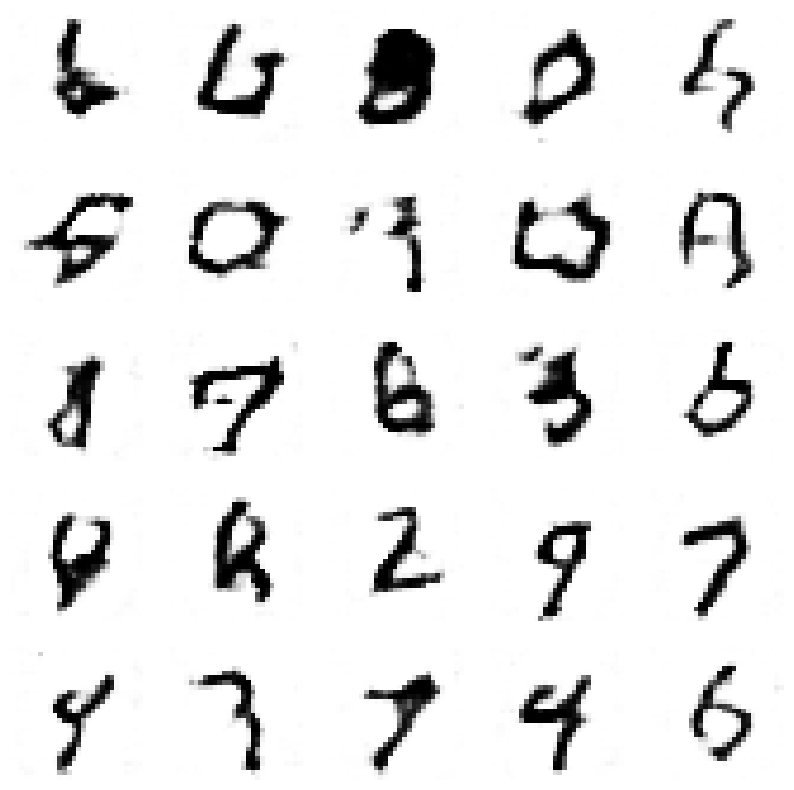

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.33231762981312907, Generator Loss 0.5570486880775191
1/1 [==============================] - 0s 36ms/step


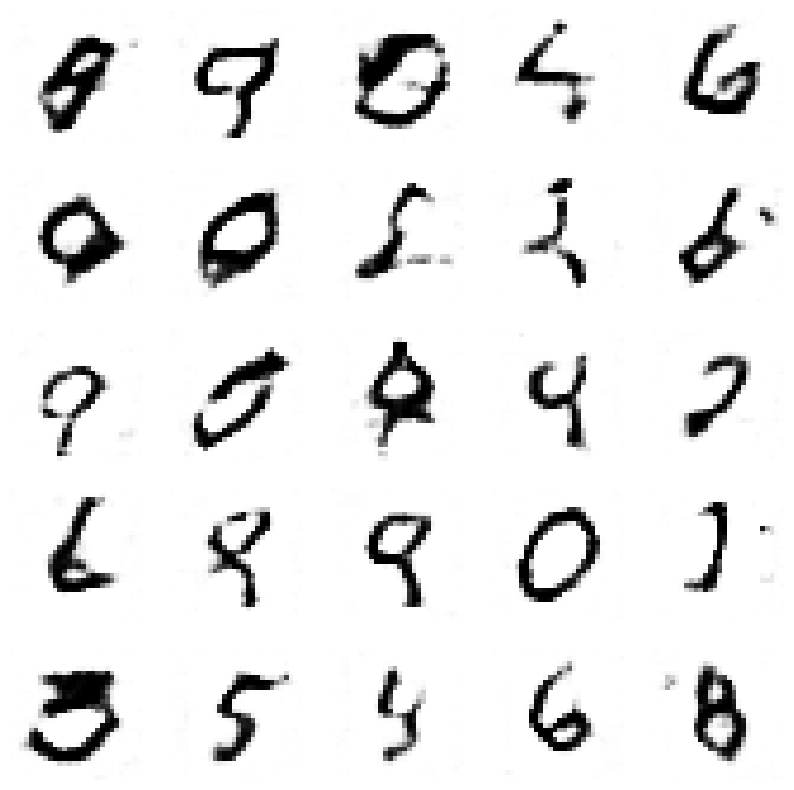

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.33501869580175125, Generator Loss 0.5619123939774994
1/1 [==============================] - 0s 45ms/step


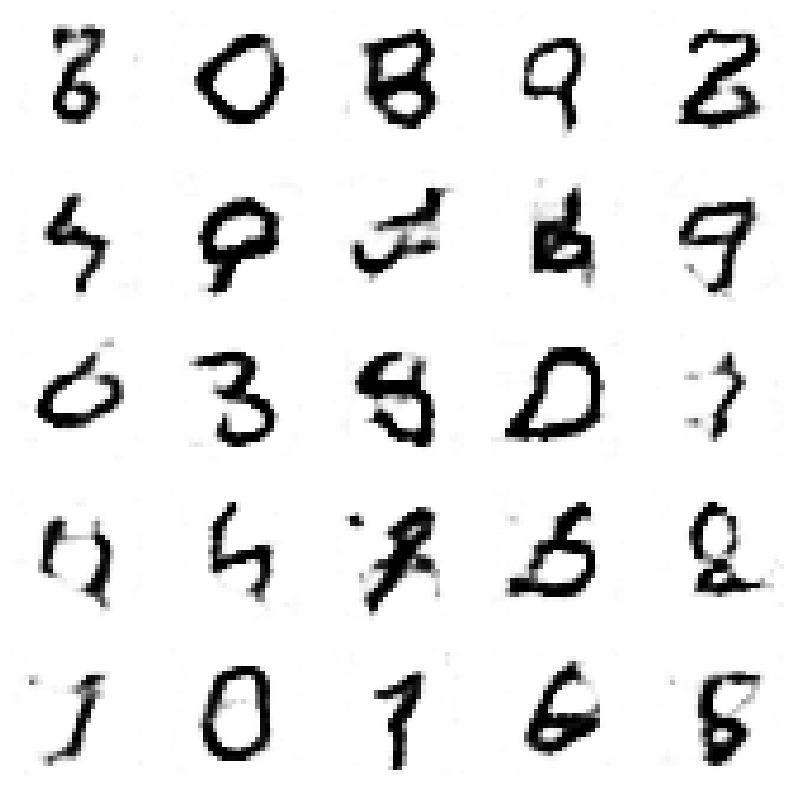

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.3379160600085544, Generator Loss 0.5665876681988056
1/1 [==============================] - 0s 27ms/step


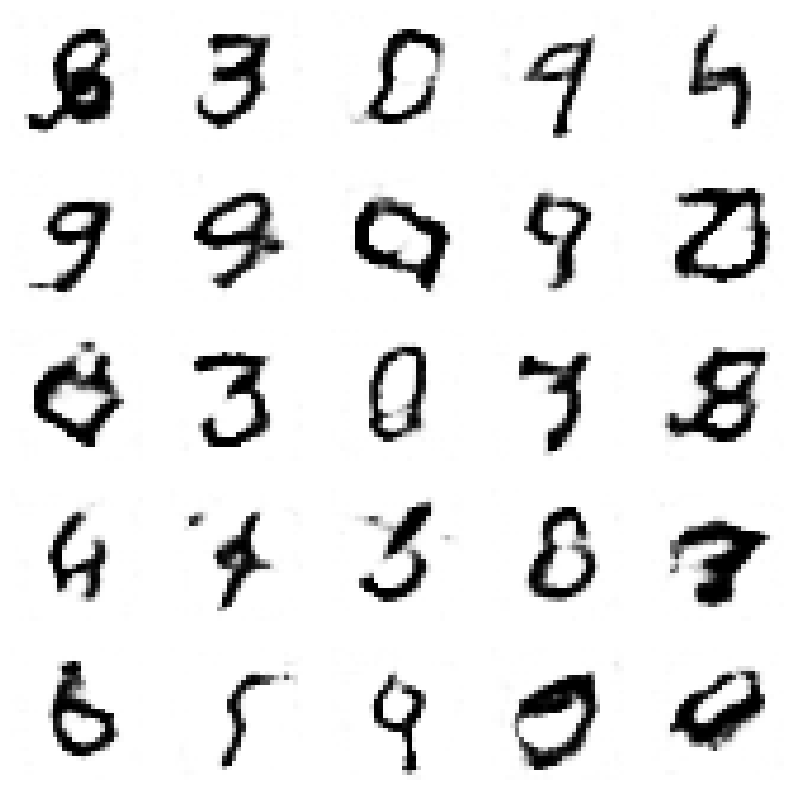

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3407379872778542, Generator Loss 0.5712188889837673
1/1 [==============================] - 0s 28ms/step


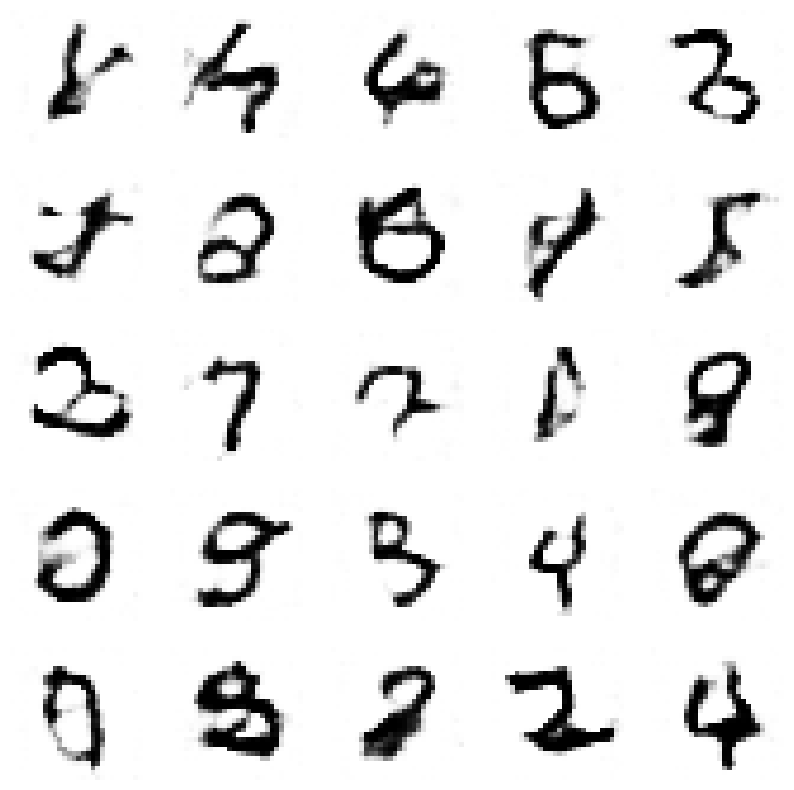

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3435567497697651, Generator Loss 0.5759350525008308
1/1 [==============================] - 0s 35ms/step


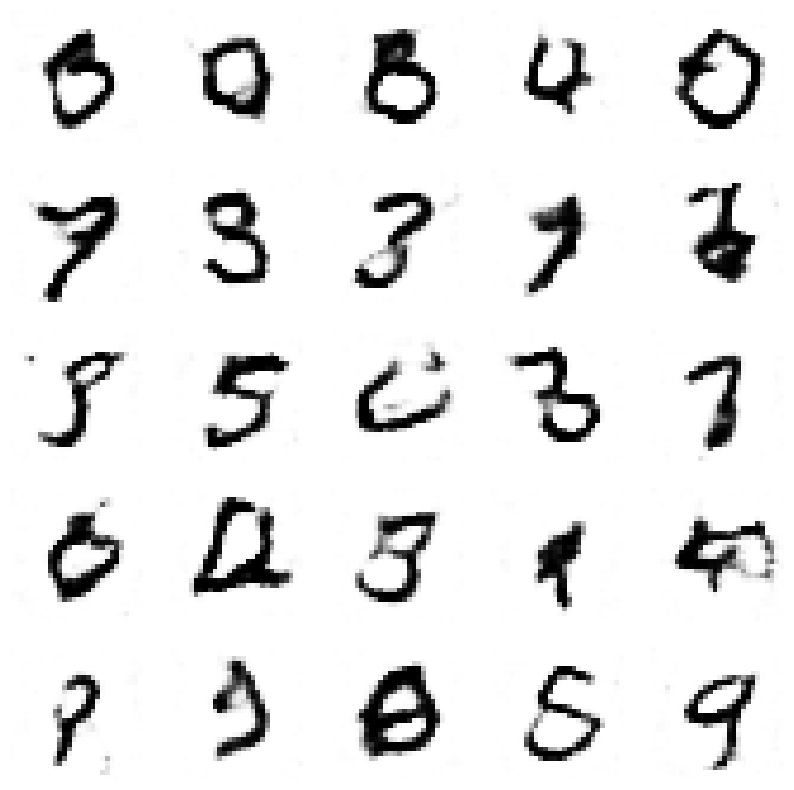

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.3463932764835847, Generator Loss 0.5807810624440511
1/1 [==============================] - 0s 31ms/step


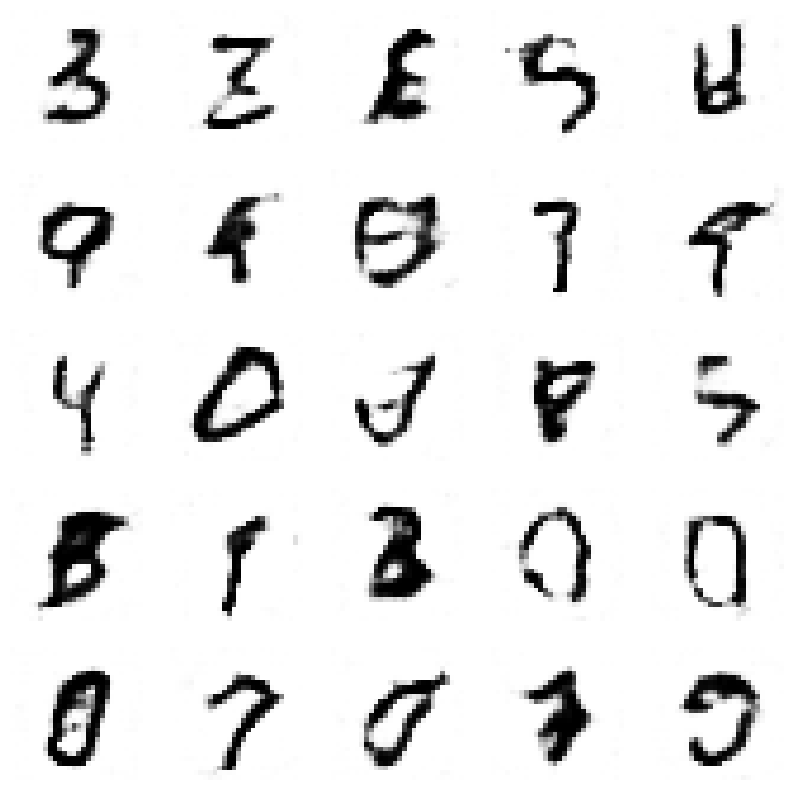

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.34920877269190603, Generator Loss 0.585572842349354
1/1 [==============================] - 0s 28ms/step


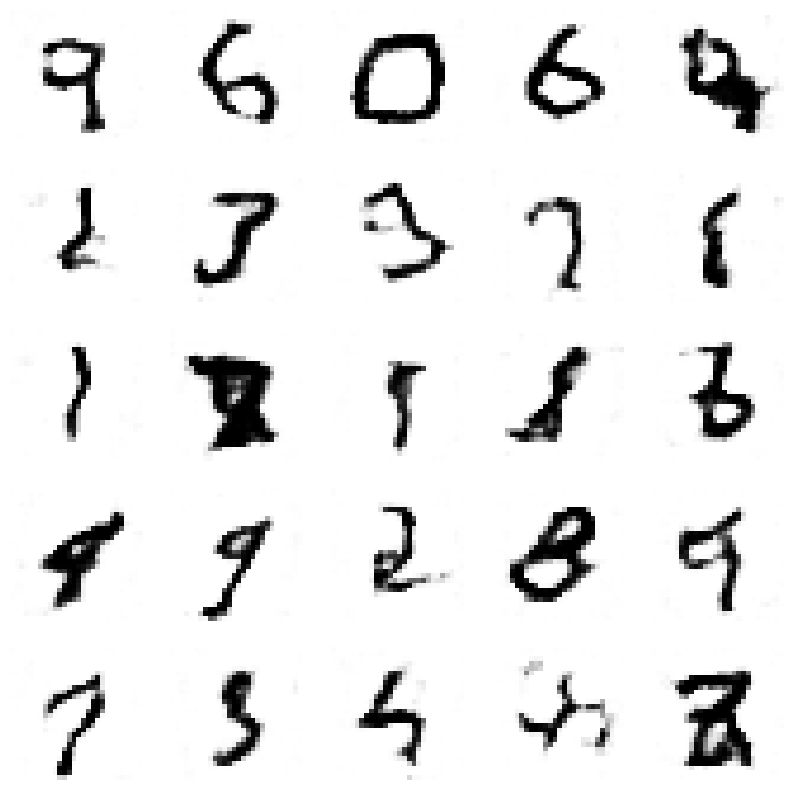

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3521423535978692, Generator Loss 0.5902008195208688
1/1 [==============================] - 0s 29ms/step


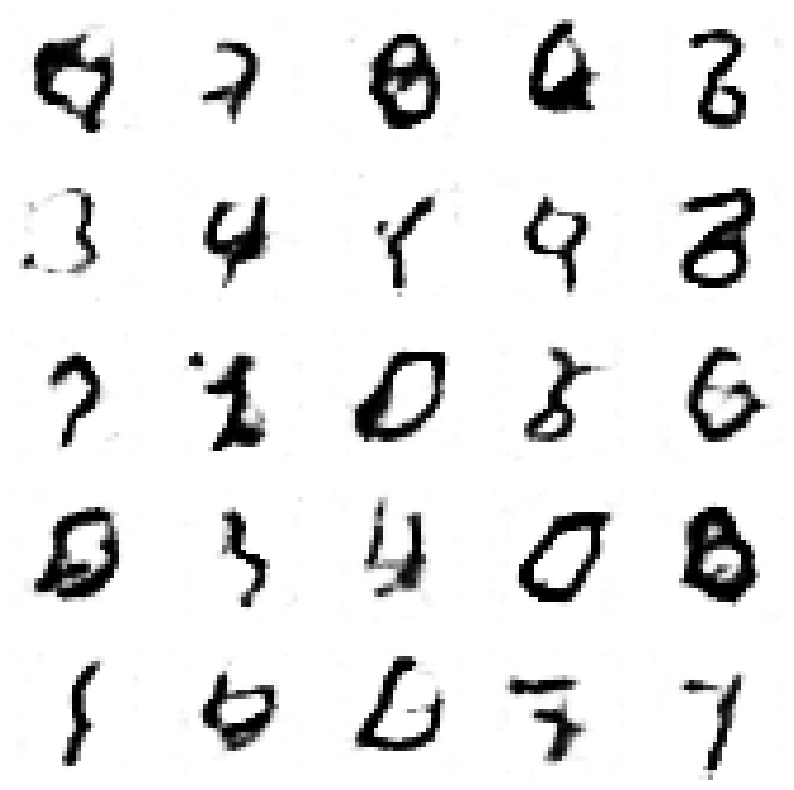

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3549749571034032, Generator Loss 0.5948904385933509
1/1 [==============================] - 0s 33ms/step


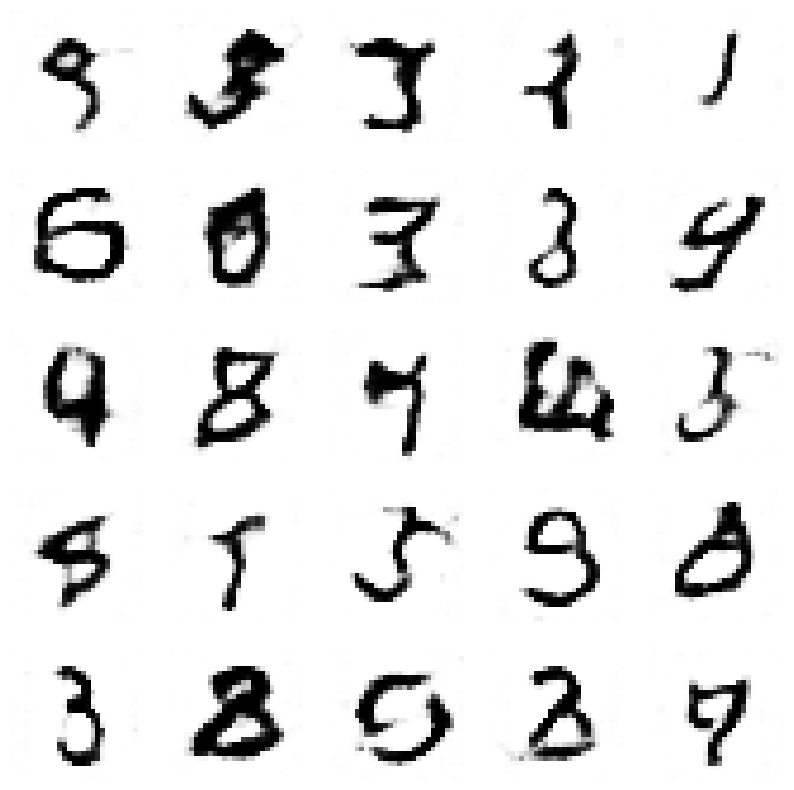

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.3578853204719022, Generator Loss 0.5996122492684258
1/1 [==============================] - 0s 26ms/step


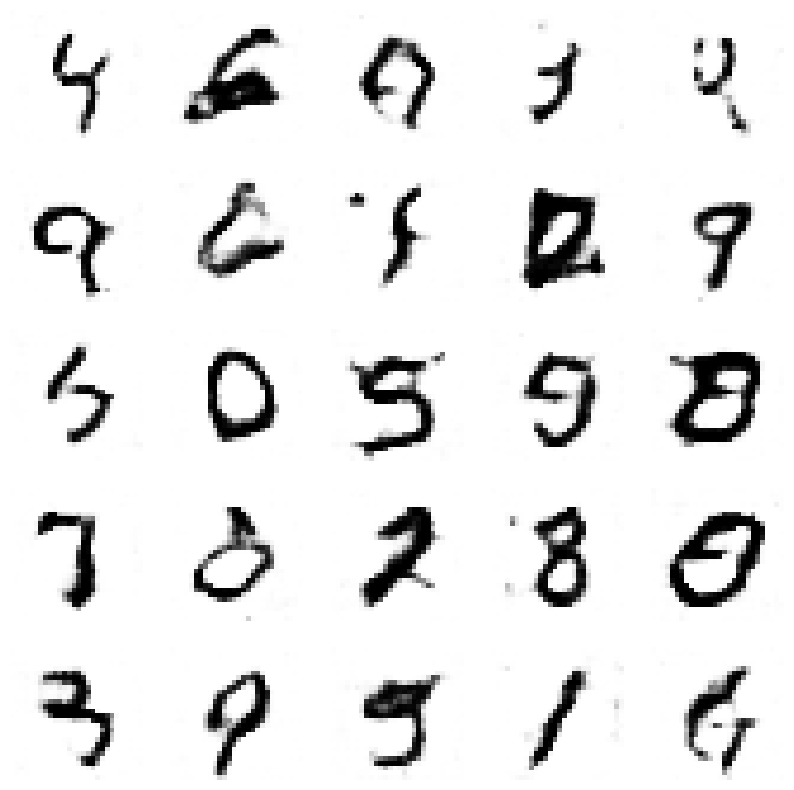

4/4 [==============================] - 0s 6ms/step
Epoch 10, Disc loss 0.3606447871678915, Generator Loss 0.6043712017882583
1/1 [==============================] - 0s 40ms/step


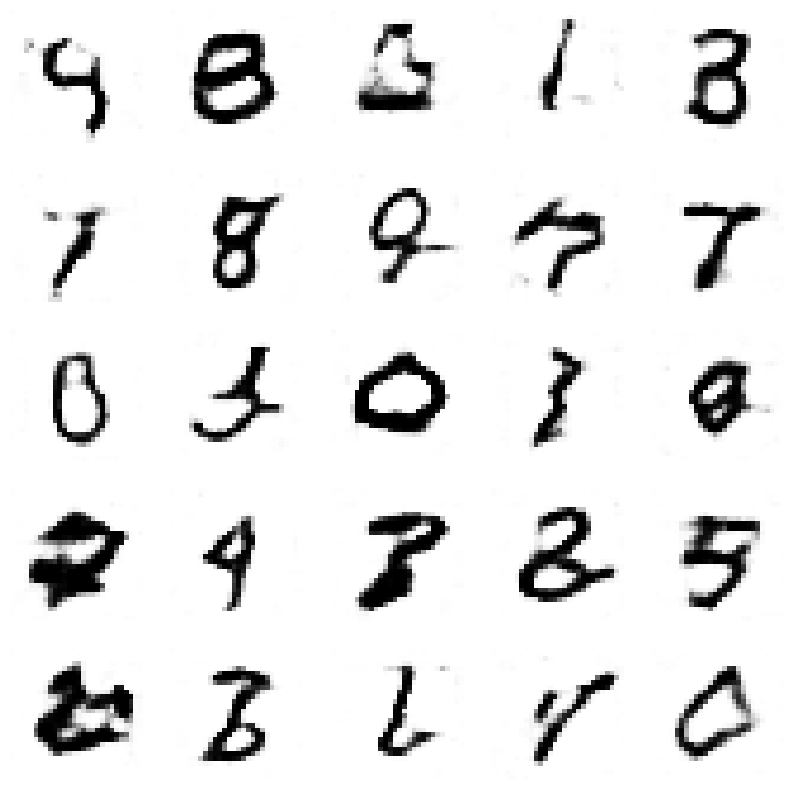

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.3634753377519102, Generator Loss 0.6089707022039299
1/1 [==============================] - 0s 54ms/step


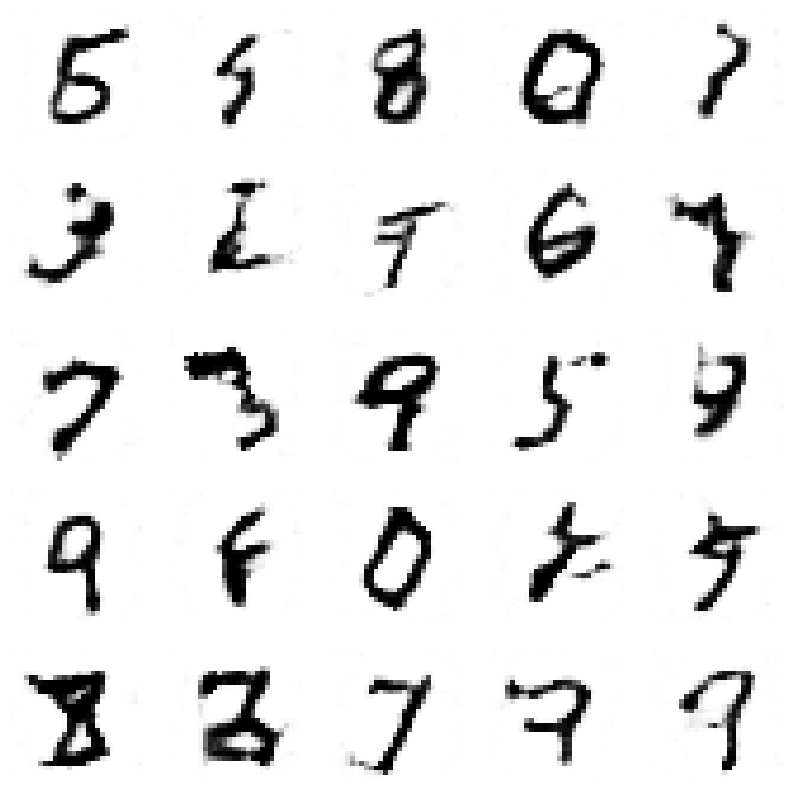

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.3662251077401332, Generator Loss 0.6137623654471503
1/1 [==============================] - 0s 70ms/step


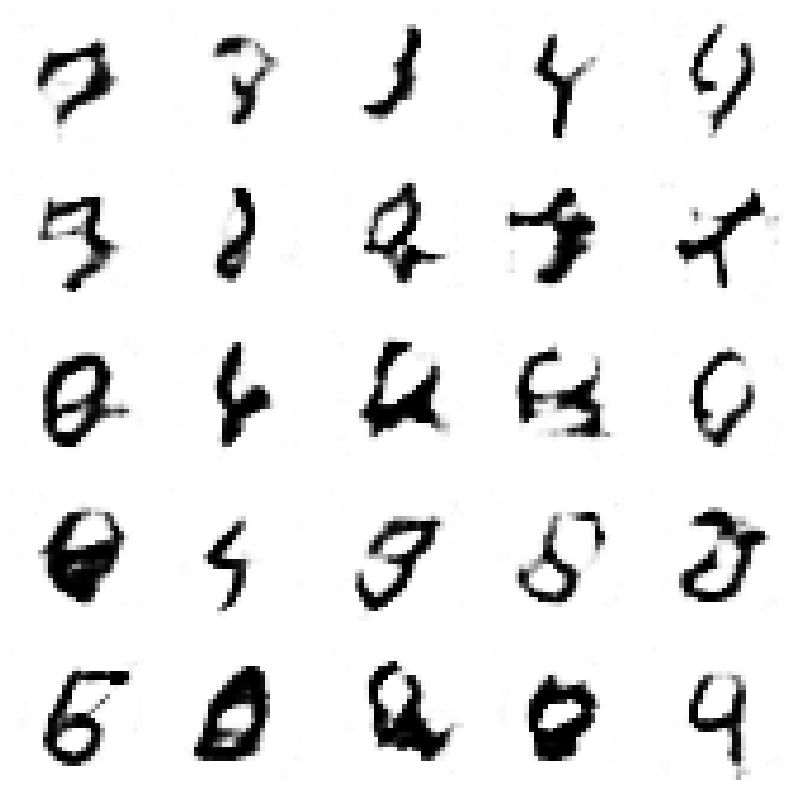

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.3690493373025177, Generator Loss 0.6186073661869408
1/1 [==============================] - 0s 26ms/step


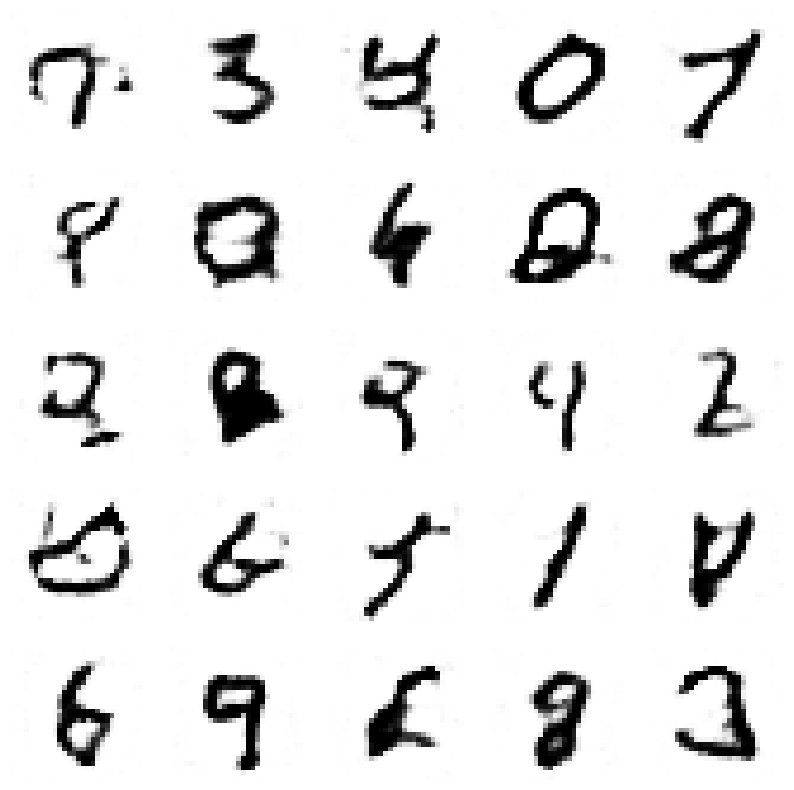

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.37175597607070565, Generator Loss 0.6235008239746094
1/1 [==============================] - 0s 29ms/step


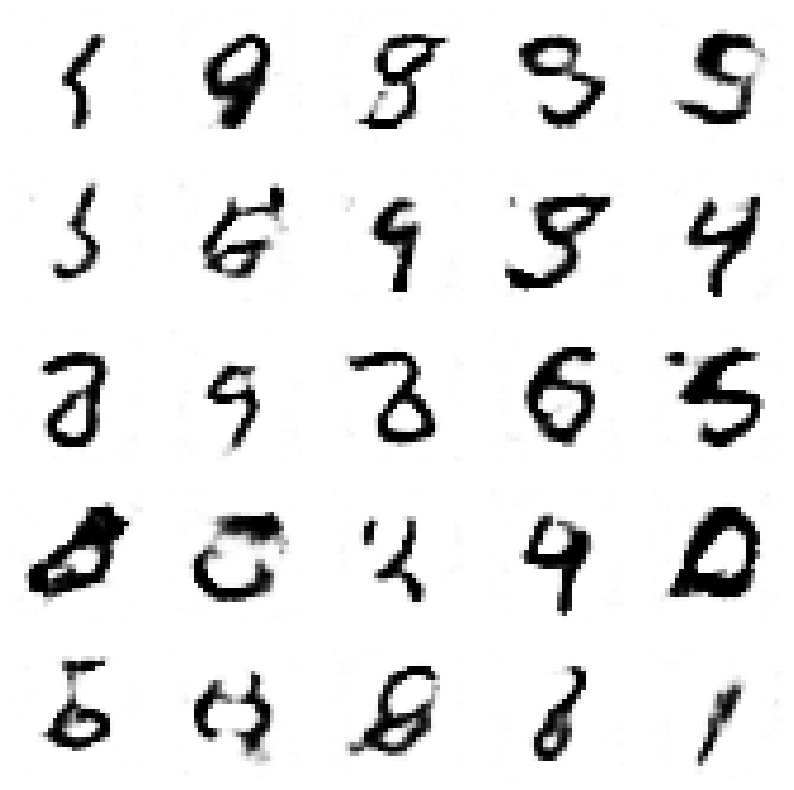

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3745801576182374, Generator Loss 0.6283570517841567
1/1 [==============================] - 0s 31ms/step


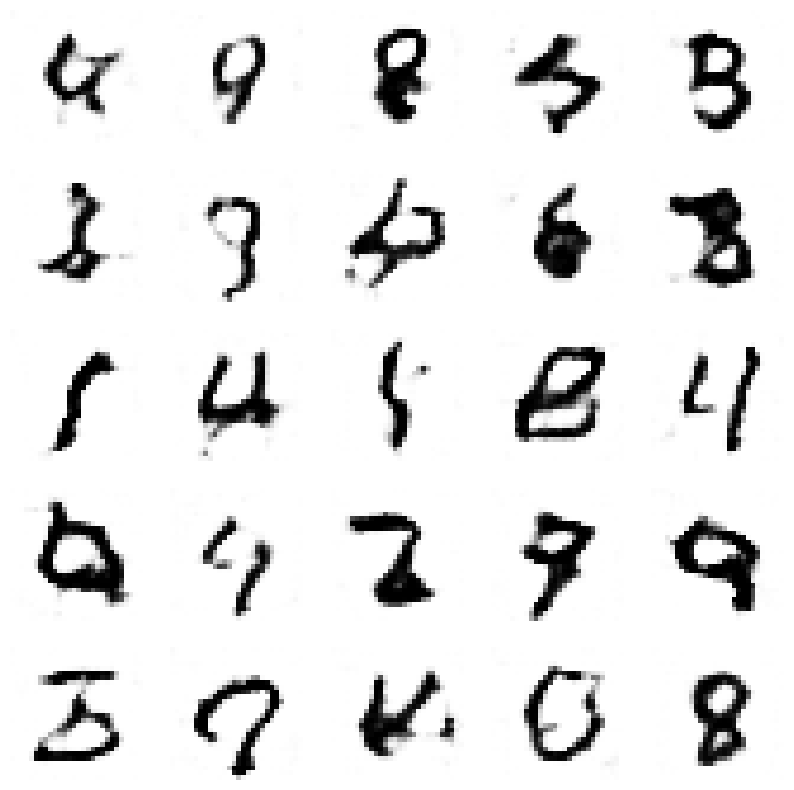

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.37749236885808474, Generator Loss 0.6330779016527355
1/1 [==============================] - 0s 30ms/step


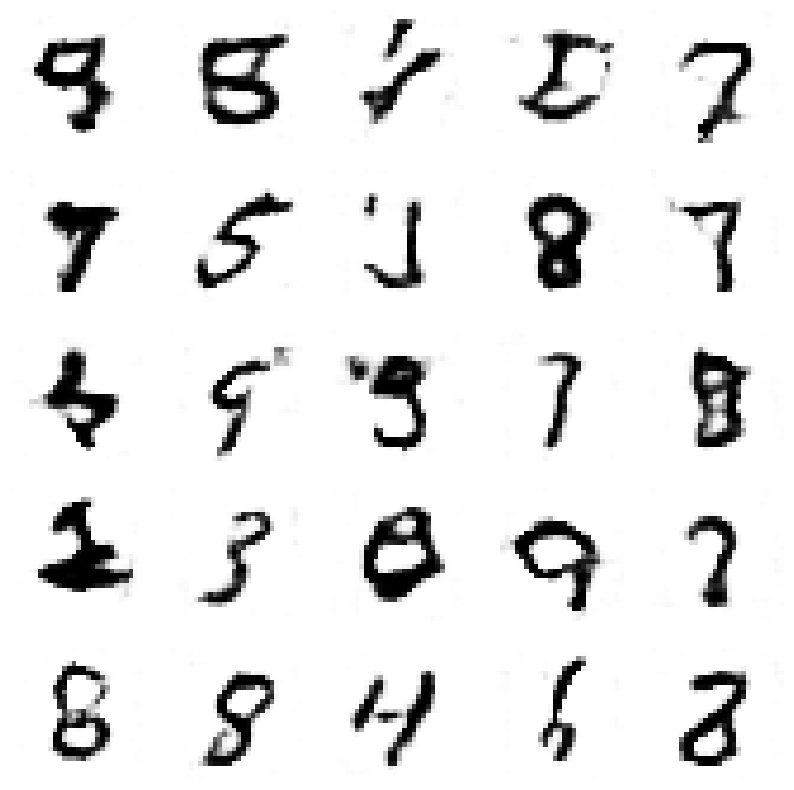

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.3803084723205648, Generator Loss 0.6377657718128629
1/1 [==============================] - 0s 29ms/step


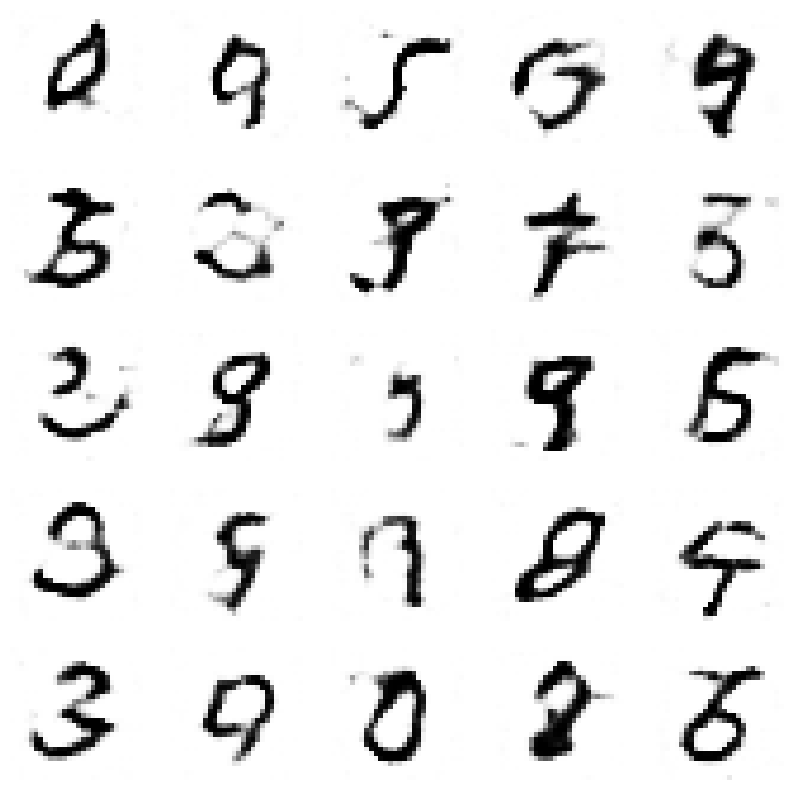

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.38300922996977455, Generator Loss 0.6424783259375483
1/1 [==============================] - 0s 28ms/step


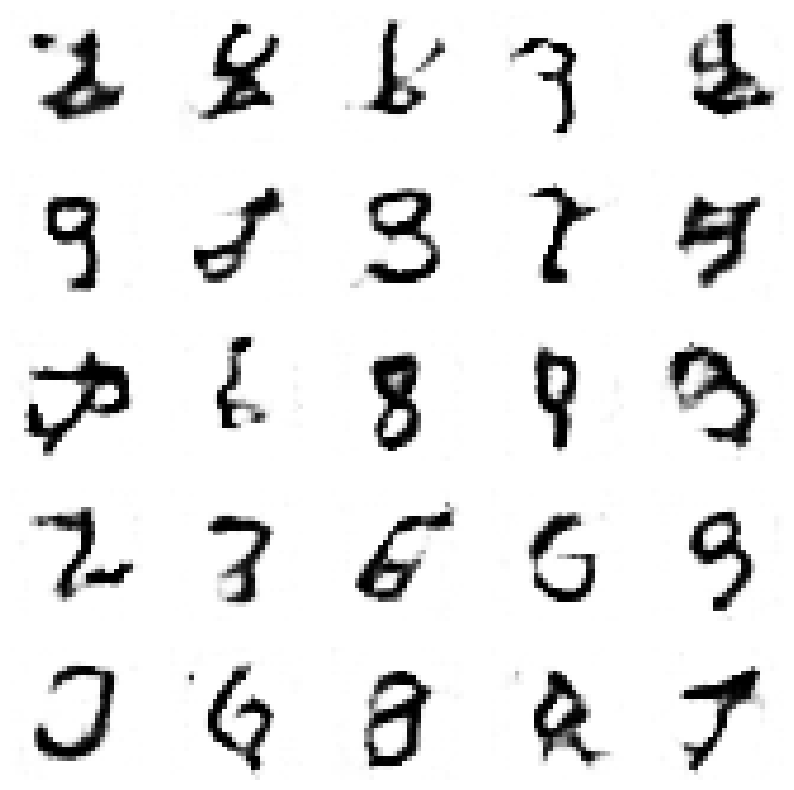

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.38584070404370624, Generator Loss 0.6473306809735094
1/1 [==============================] - 0s 30ms/step


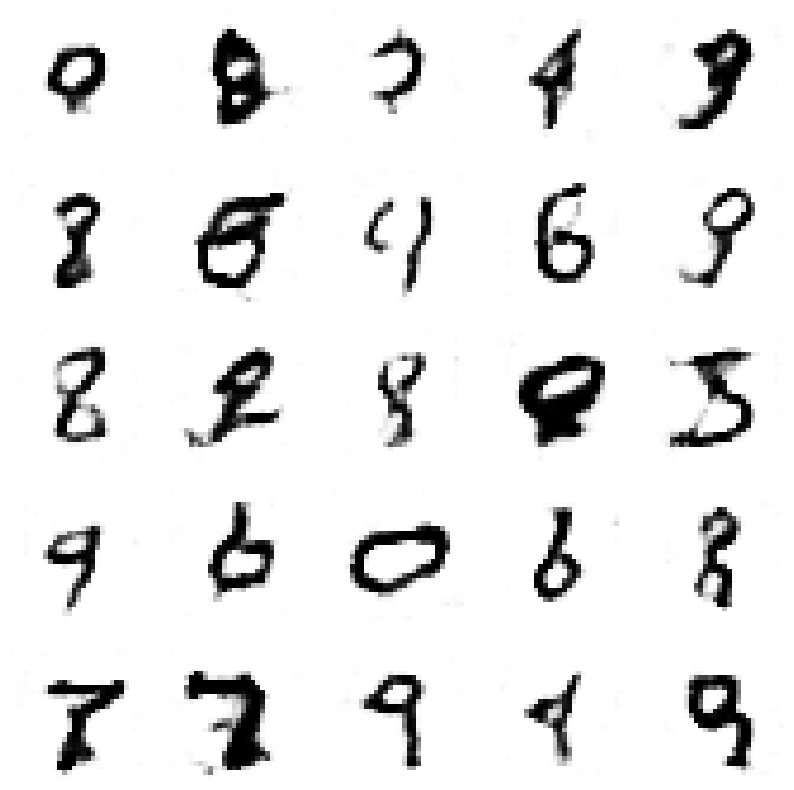

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.38866805164223045, Generator Loss 0.652177339945084
1/1 [==============================] - 0s 33ms/step


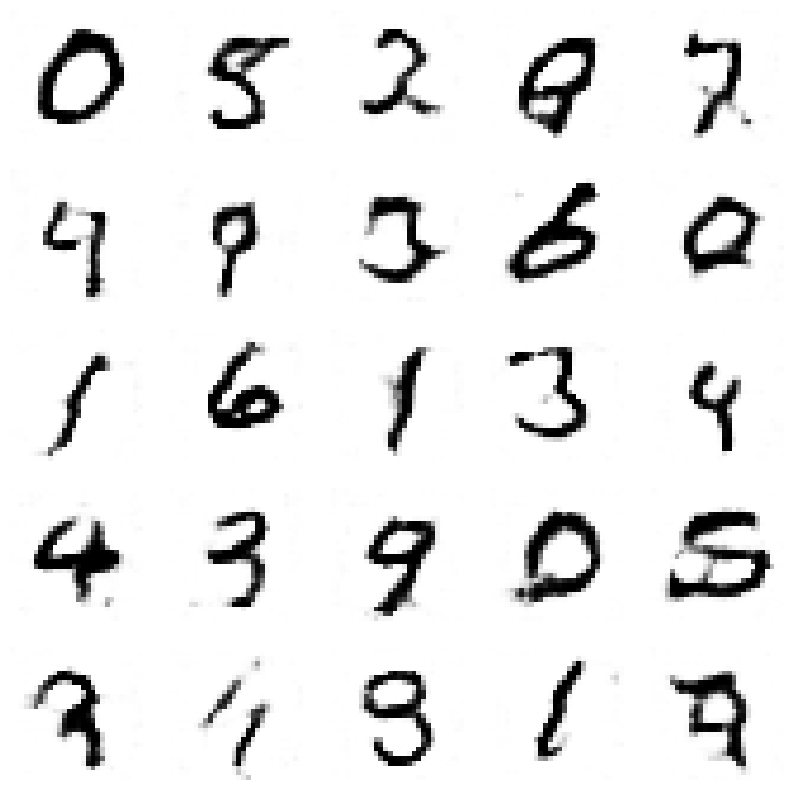

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.3914792420517685, Generator Loss 0.6569408545127282
1/1 [==============================] - 0s 41ms/step


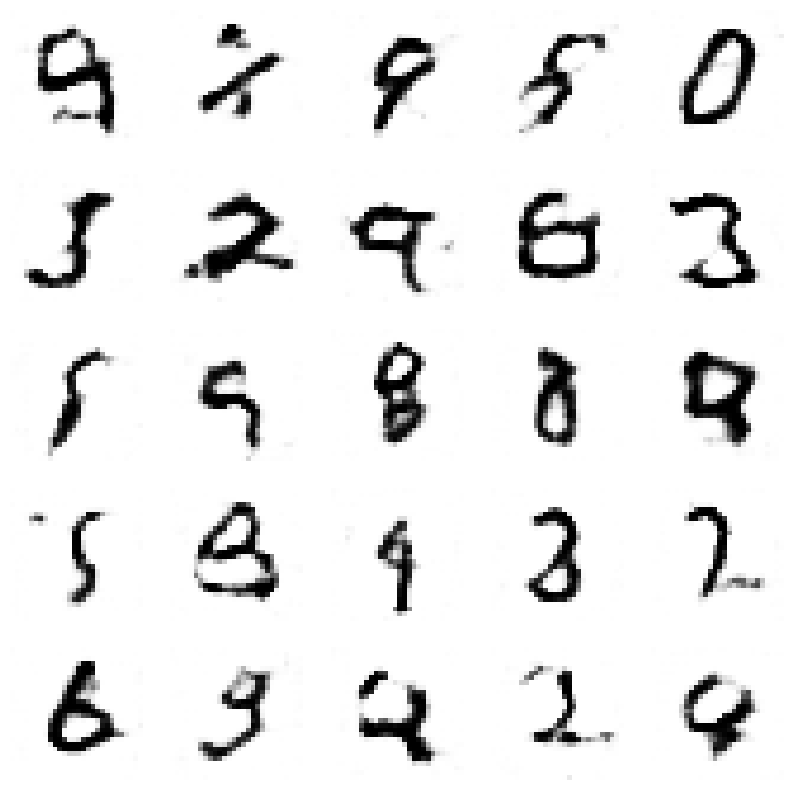

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.39428342891554546, Generator Loss 0.6615174621598333
1/1 [==============================] - 0s 31ms/step


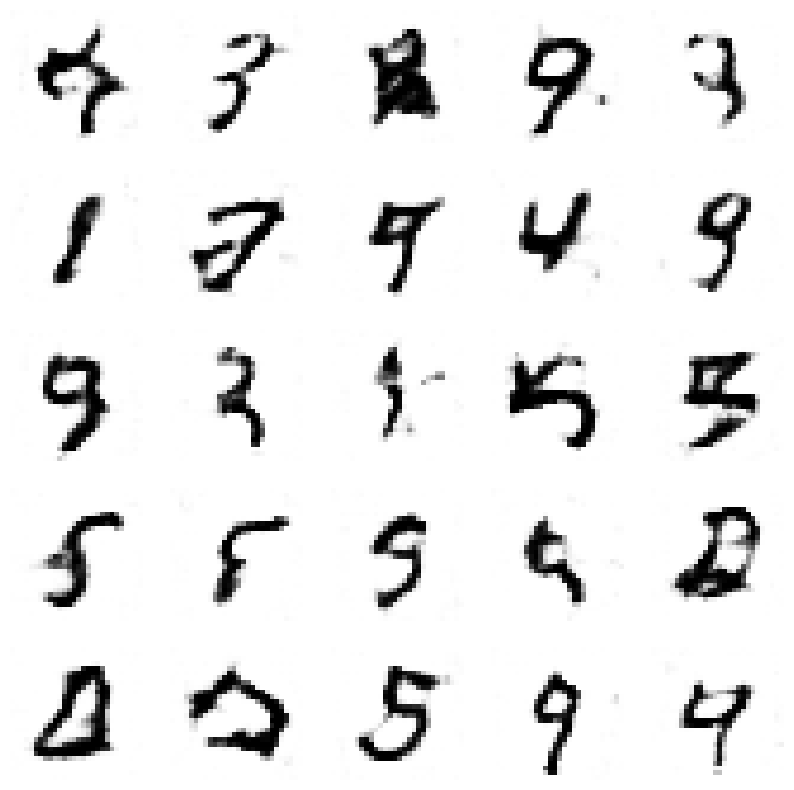

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.397052582894635, Generator Loss 0.6661686499913534
1/1 [==============================] - 0s 30ms/step


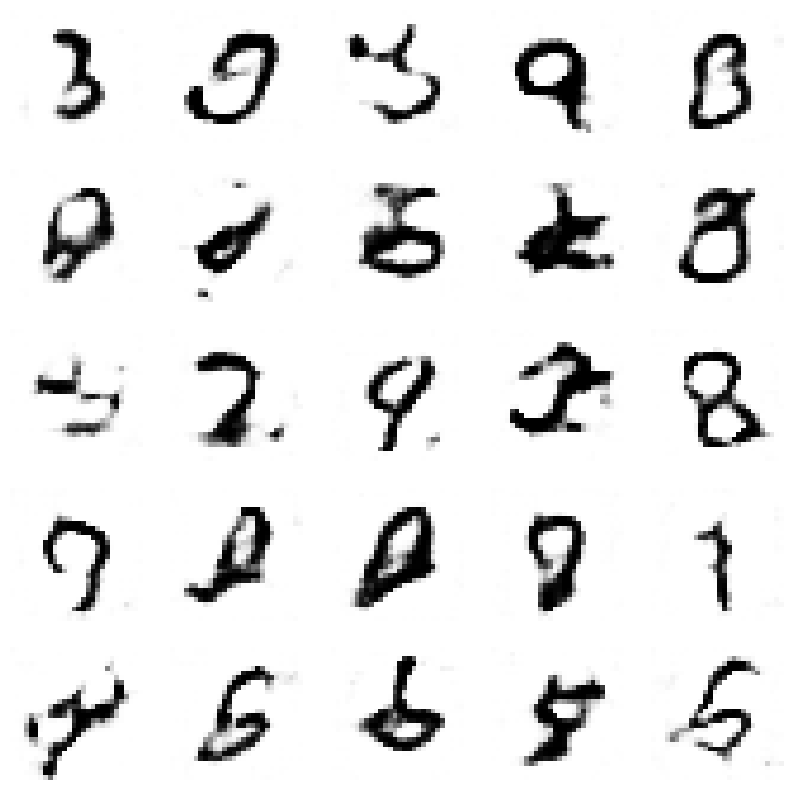

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.39991052499693686, Generator Loss 0.6708290480140947
1/1 [==============================] - 0s 27ms/step


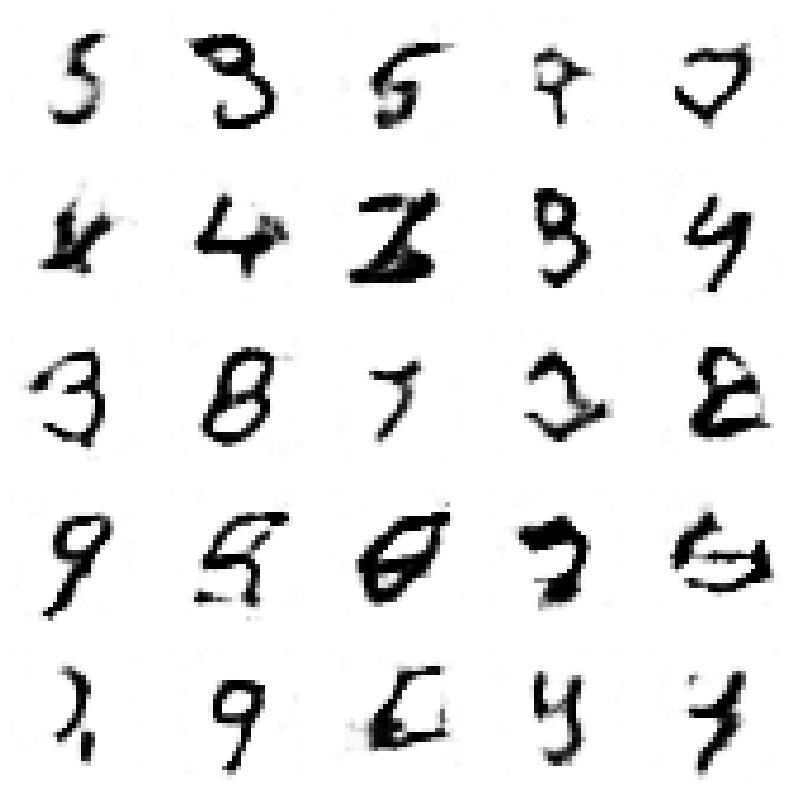

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.4028744622428193, Generator Loss 0.6755572521788442
1/1 [==============================] - 0s 27ms/step


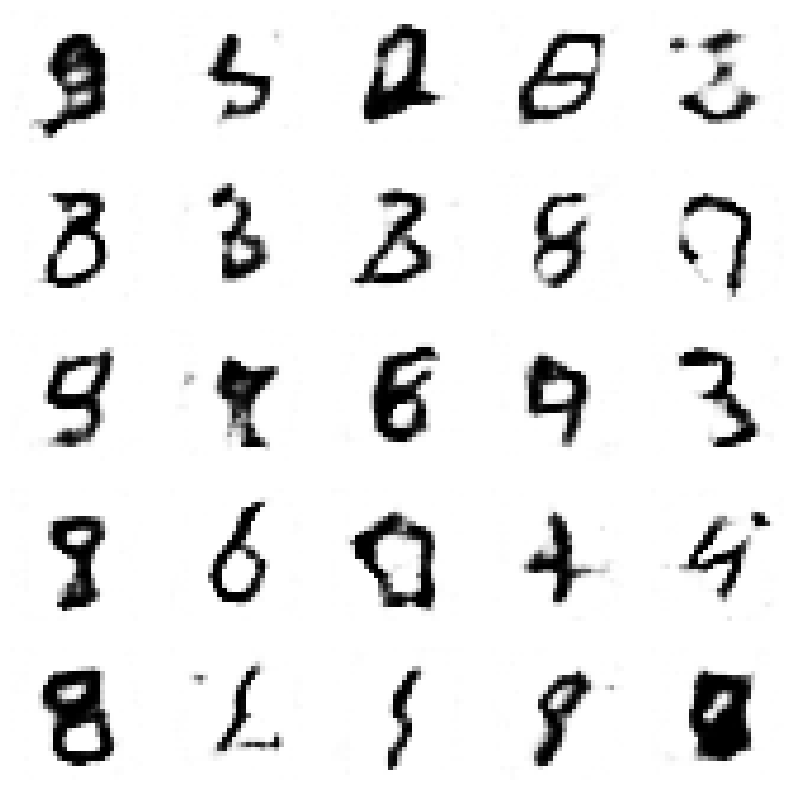

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4057066588320284, Generator Loss 0.6803030183172634
1/1 [==============================] - 0s 32ms/step


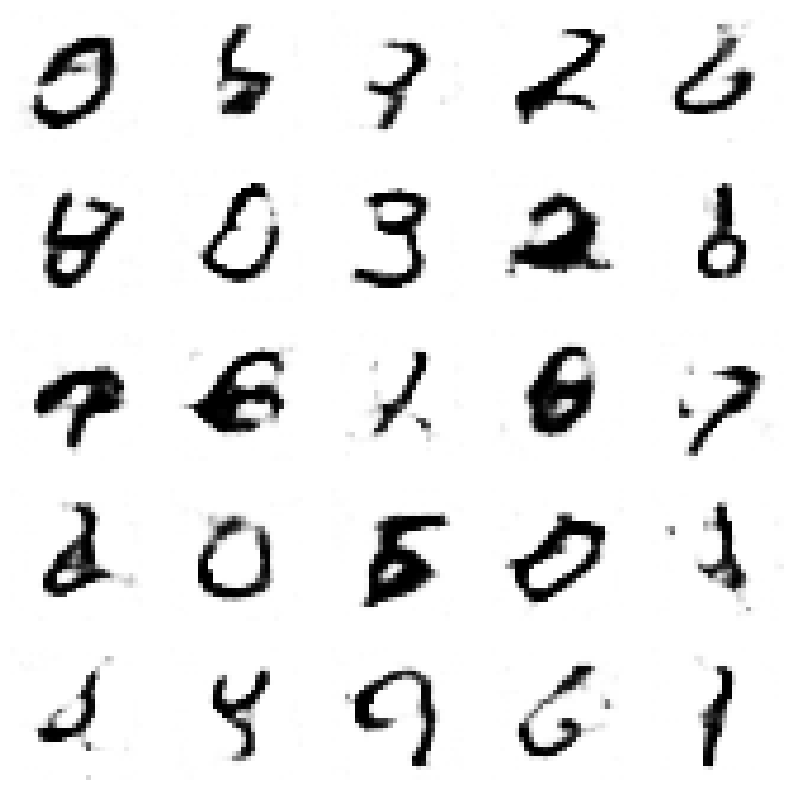

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.40850461102448976, Generator Loss 0.6852160941841255
1/1 [==============================] - 0s 27ms/step


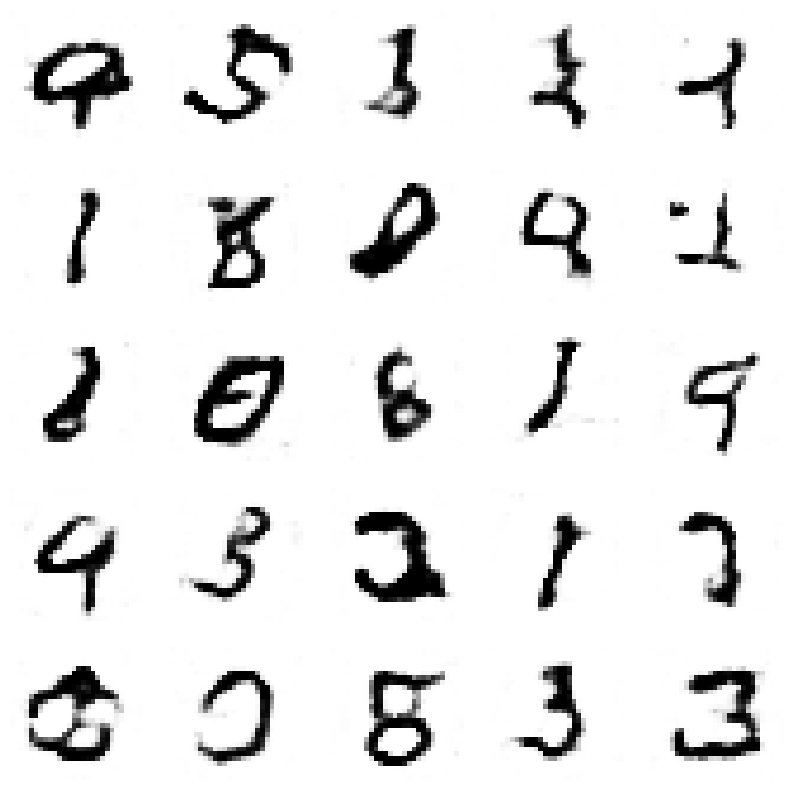

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.41136642730134165, Generator Loss 0.6899167869845008
1/1 [==============================] - 0s 30ms/step


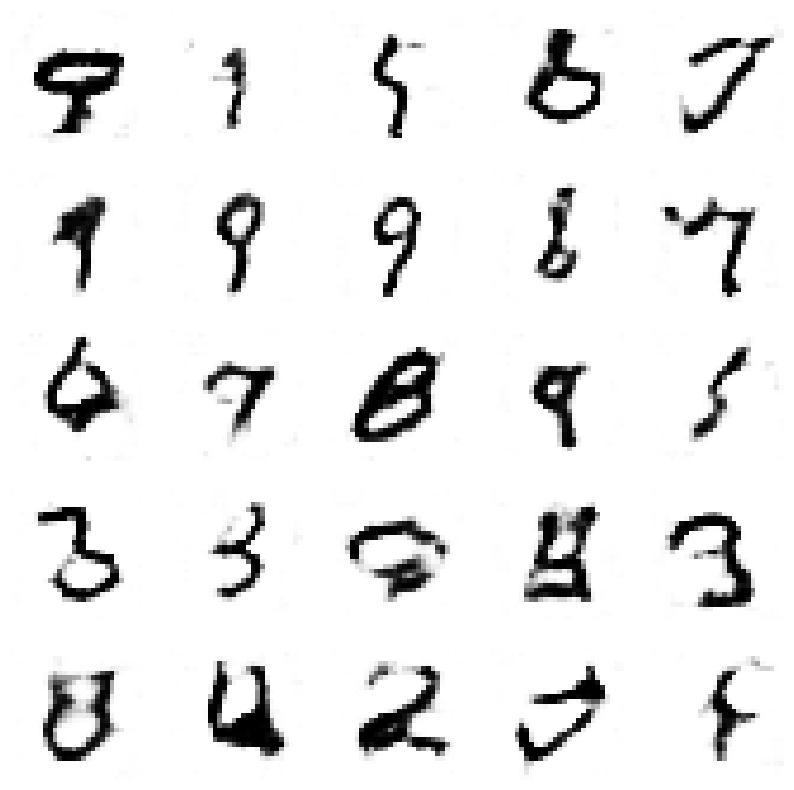

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.41421079329955274, Generator Loss 0.6945438609163985
1/1 [==============================] - 0s 26ms/step


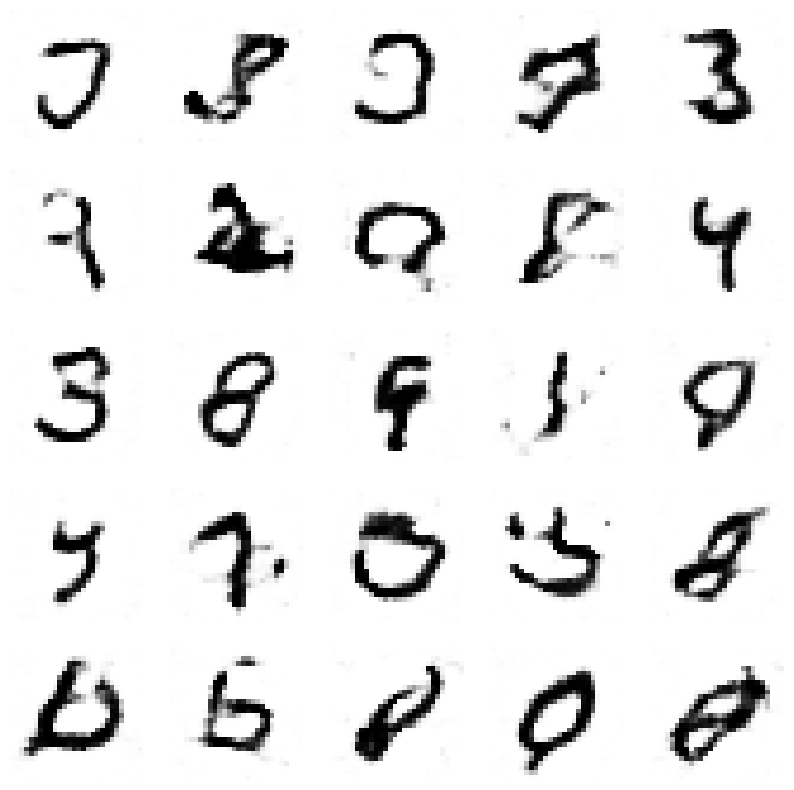

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.41724684401455087, Generator Loss 0.6990633612005119
1/1 [==============================] - 0s 37ms/step


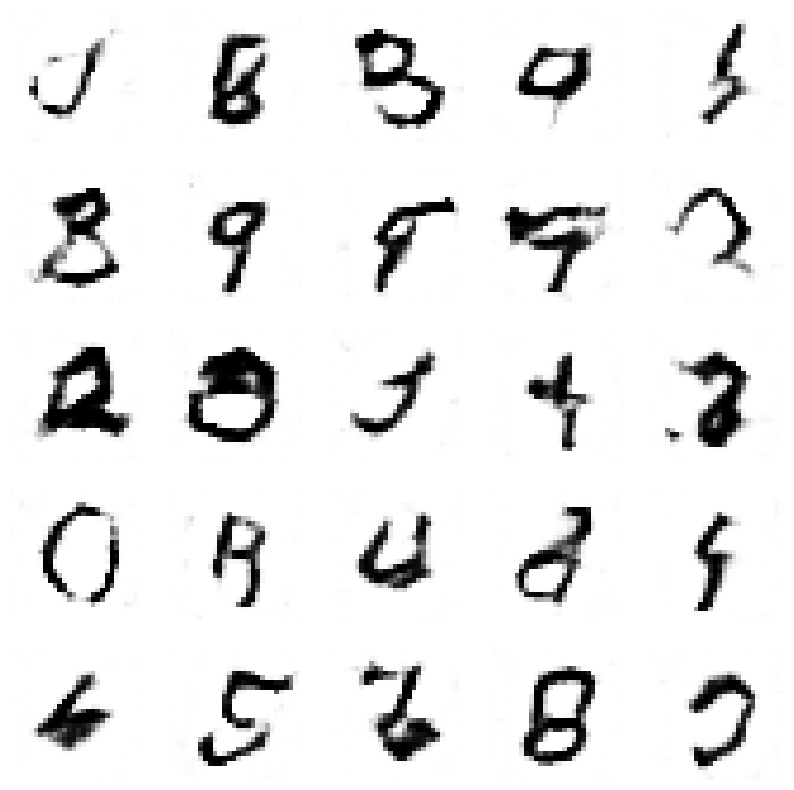

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.4200988480677971, Generator Loss 0.703619350734939
1/1 [==============================] - 0s 27ms/step


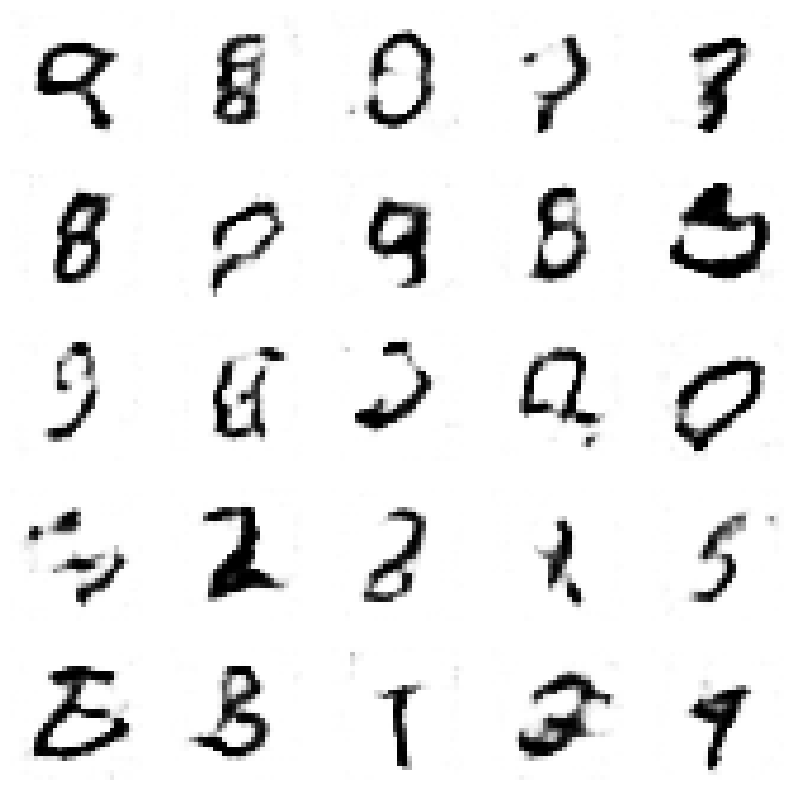

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.4229544011446146, Generator Loss 0.7082441759924604
1/1 [==============================] - 0s 61ms/step


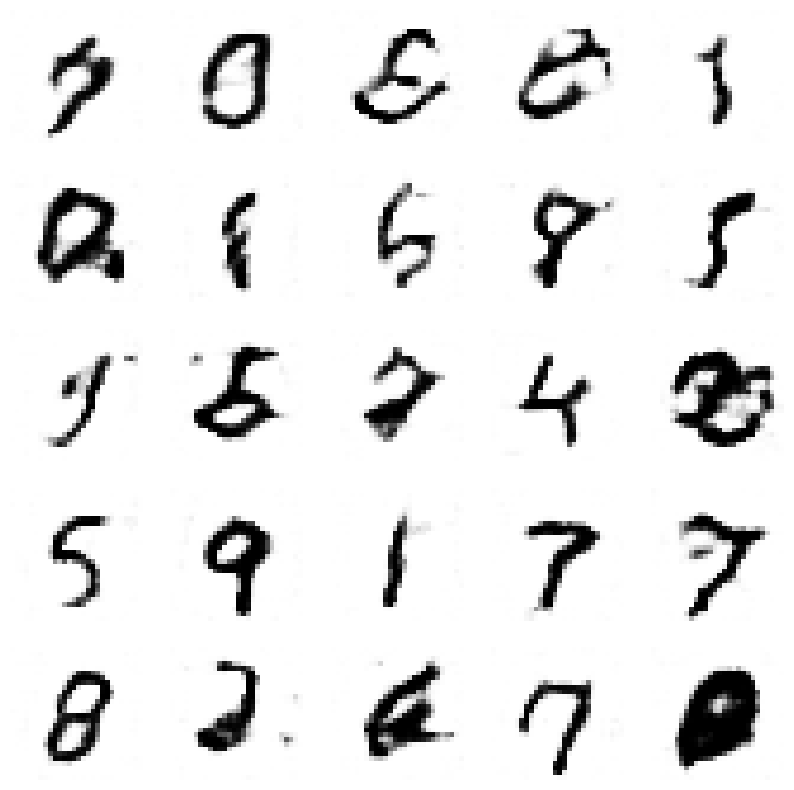

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.425771070469139, Generator Loss 0.7129386775514
1/1 [==============================] - 0s 42ms/step


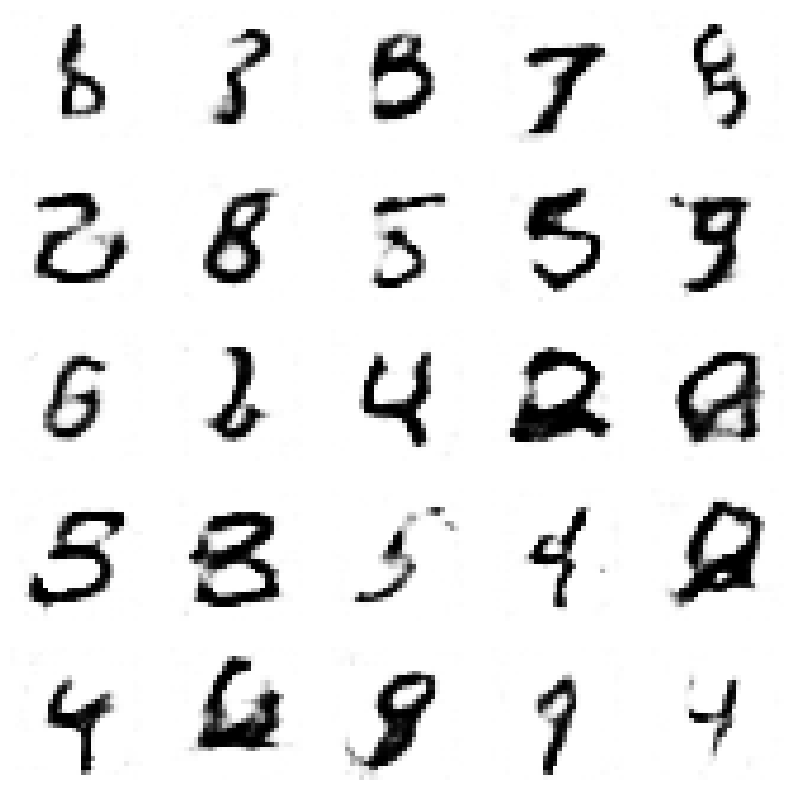

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4285690105623669, Generator Loss 0.7175463769170973
1/1 [==============================] - 0s 27ms/step


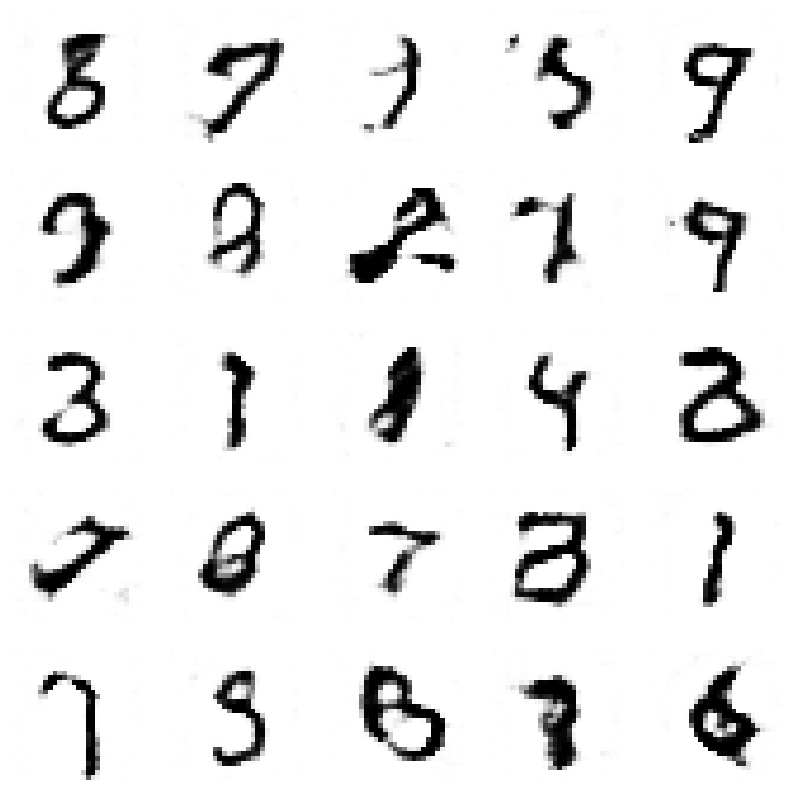

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.43142068589854443, Generator Loss 0.7221940562256381
1/1 [==============================] - 0s 26ms/step


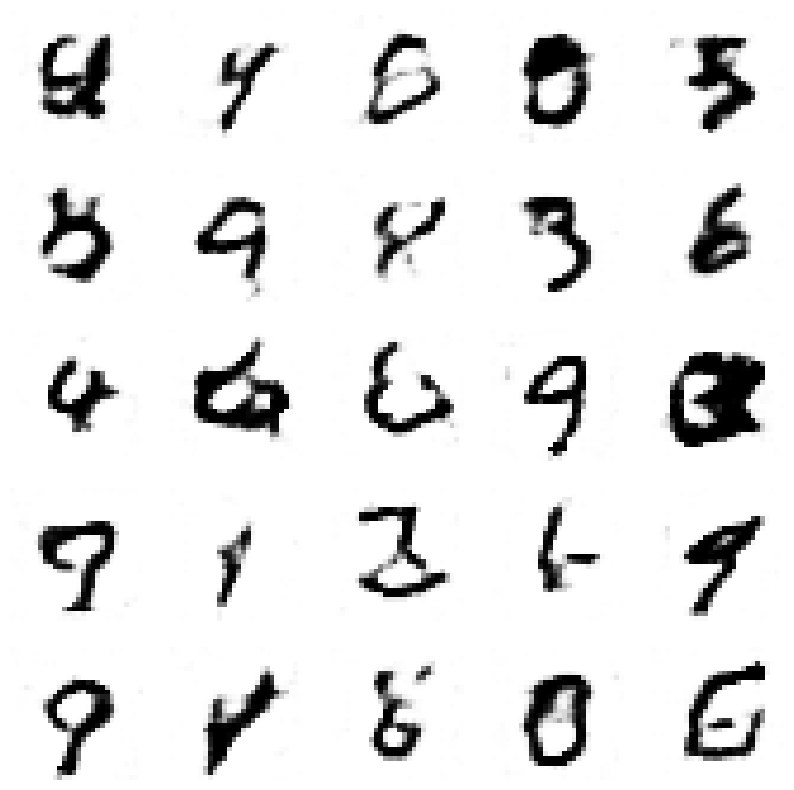

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.43415950760882127, Generator Loss 0.7270518098122034
1/1 [==============================] - 0s 34ms/step


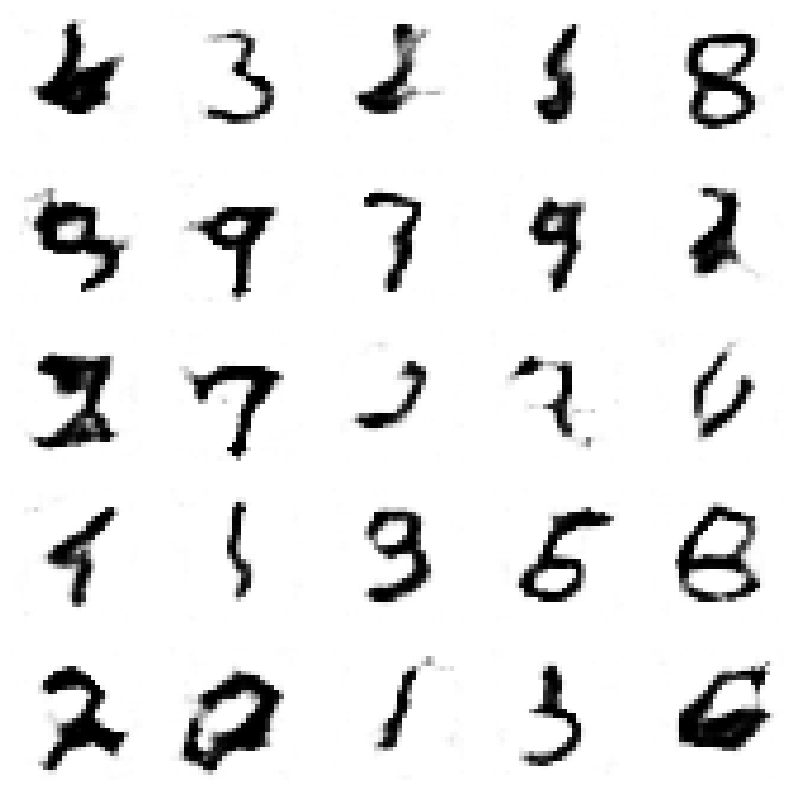

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4369467011629007, Generator Loss 0.7316403918796115
1/1 [==============================] - 0s 36ms/step


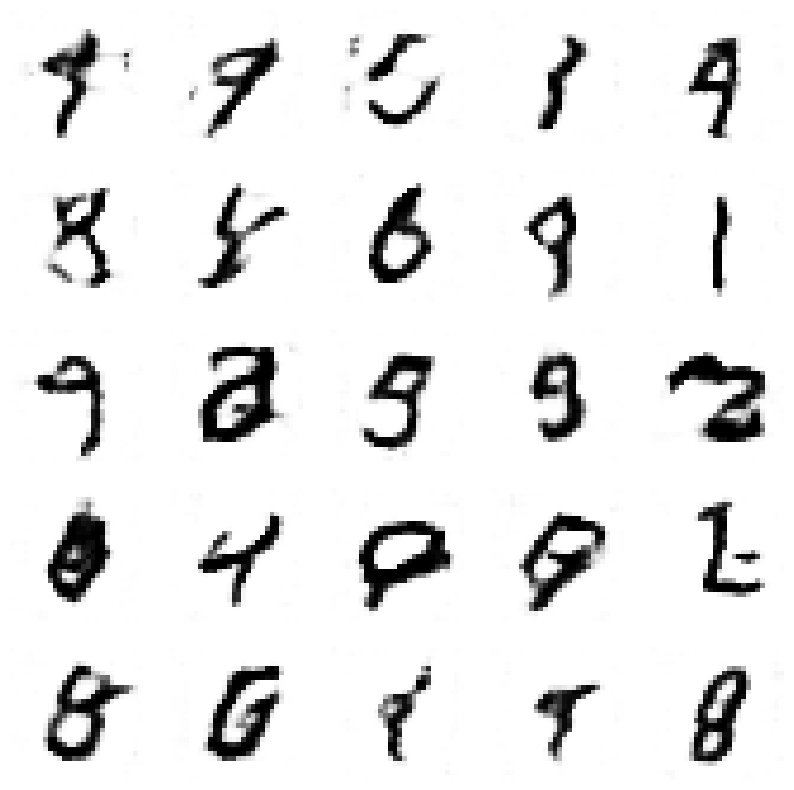

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.43984907483443236, Generator Loss 0.7363082756344069
1/1 [==============================] - 0s 25ms/step


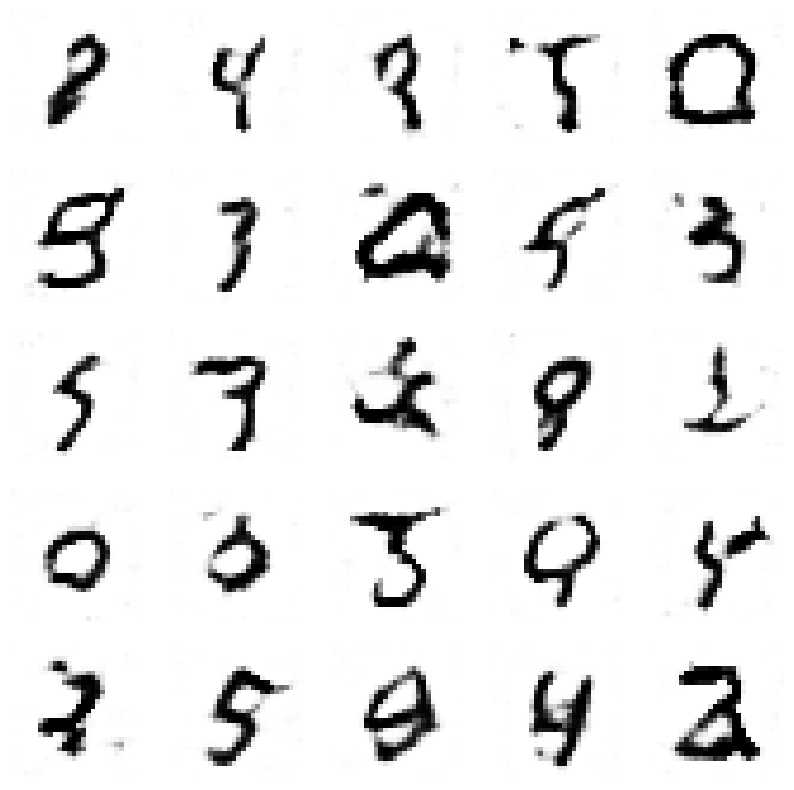

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4426348545612433, Generator Loss 0.7409354473790551
1/1 [==============================] - 0s 31ms/step


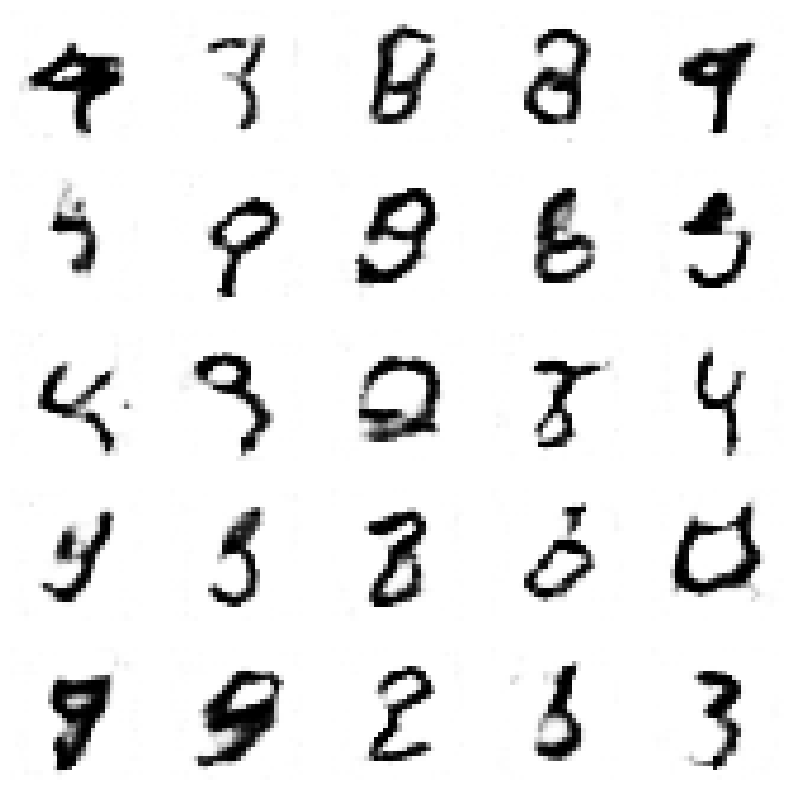

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.44542590433206314, Generator Loss 0.7456189867777702
1/1 [==============================] - 0s 28ms/step


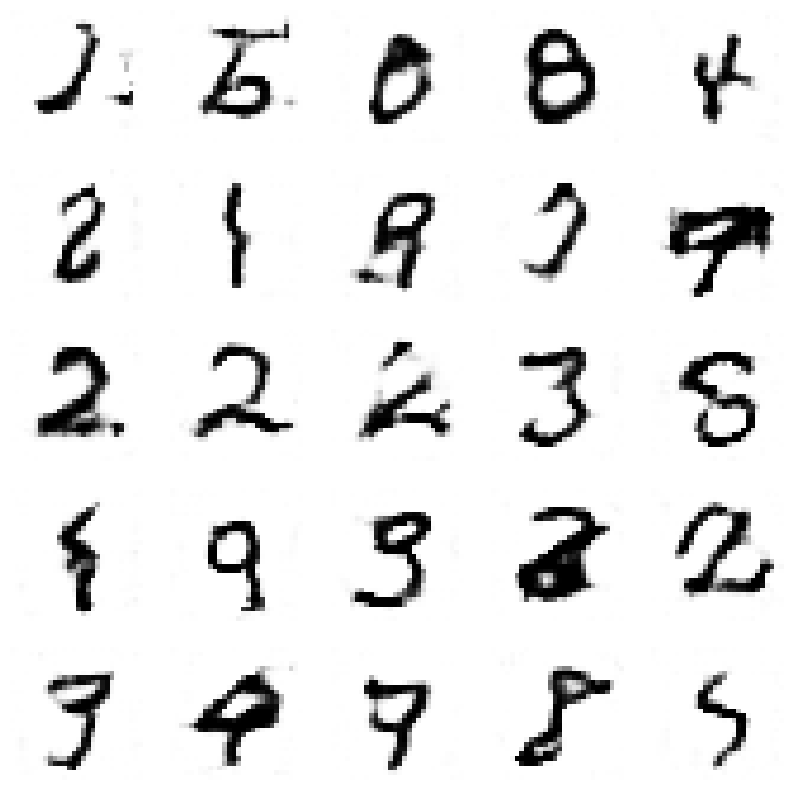

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.44826023433453, Generator Loss 0.7502944637567569
1/1 [==============================] - 0s 26ms/step


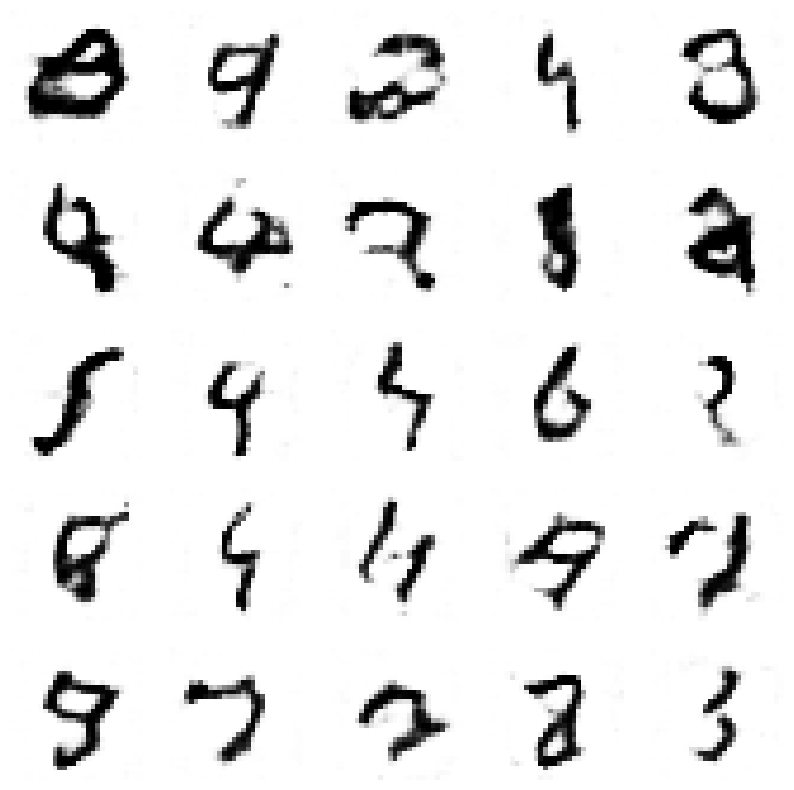

4/4 [==============================] - 0s 6ms/step
Epoch 10, Disc loss 0.4510281608145461, Generator Loss 0.7551066579981747
1/1 [==============================] - 0s 29ms/step


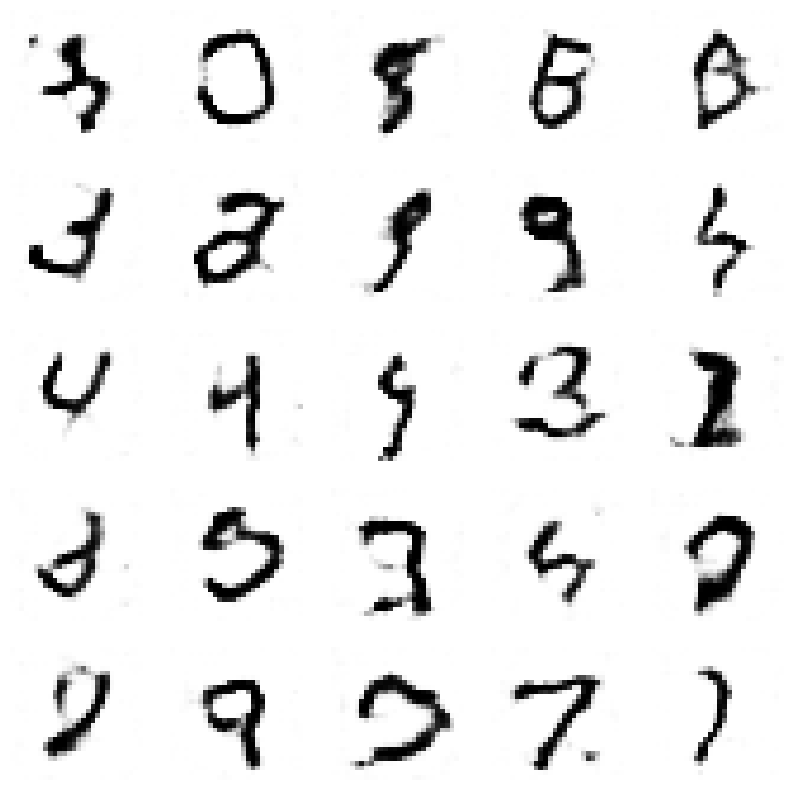

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.45383054514726, Generator Loss 0.759736402421935
1/1 [==============================] - 0s 34ms/step


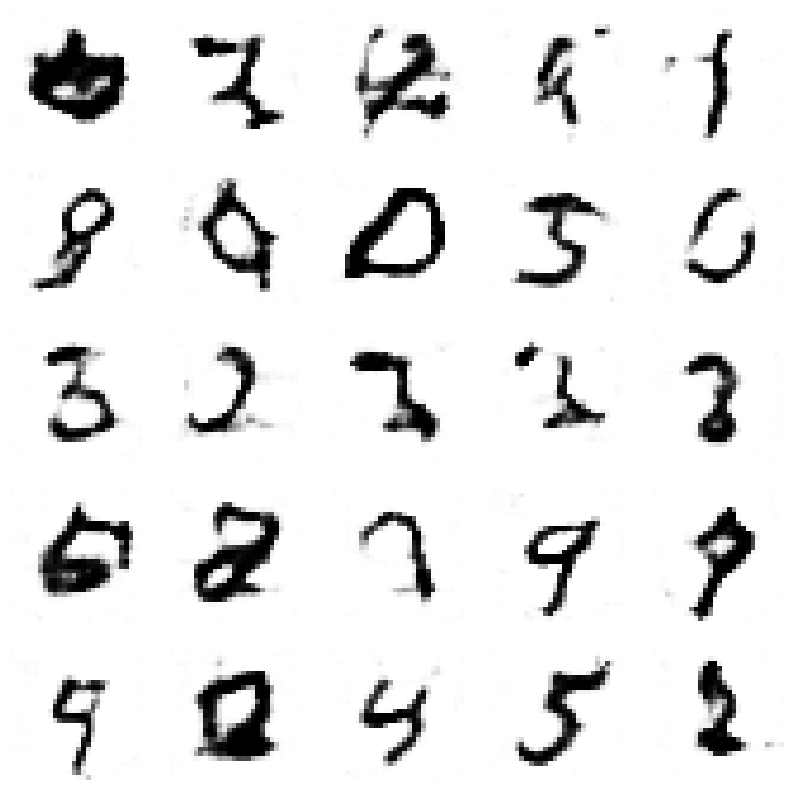

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.45658302625529784, Generator Loss 0.764281923444862
1/1 [==============================] - 0s 26ms/step


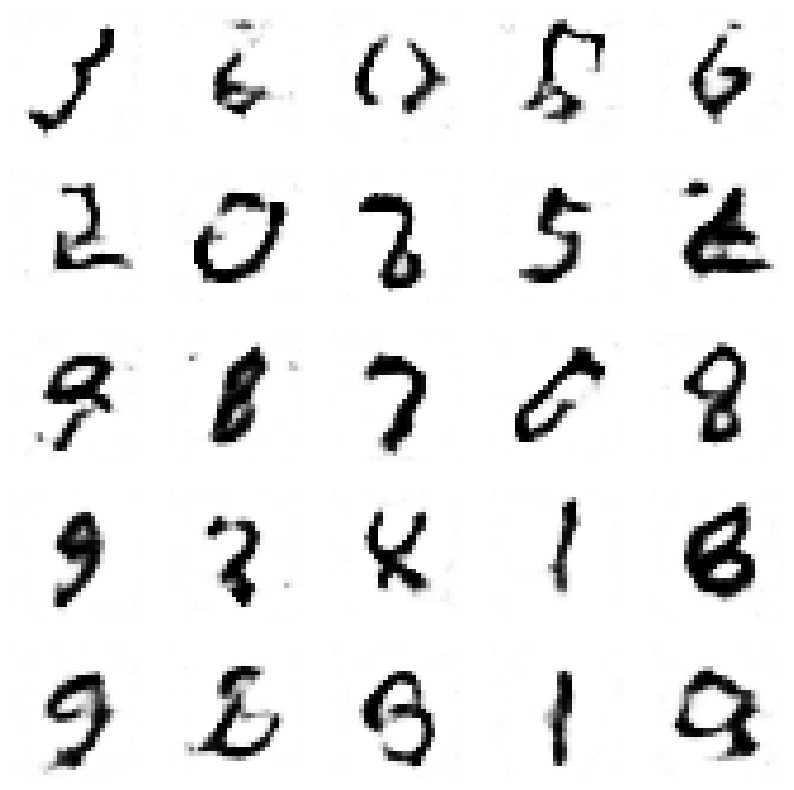

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.4593984300000036, Generator Loss 0.7689150836732652
1/1 [==============================] - 0s 27ms/step


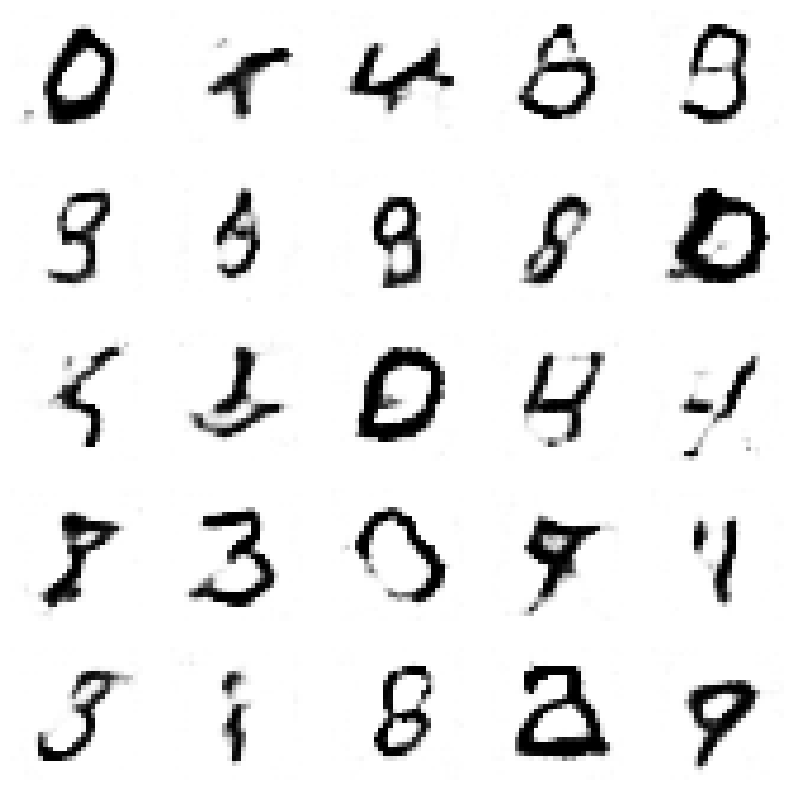

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4621744888205814, Generator Loss 0.7736527782220107
1/1 [==============================] - 0s 36ms/step


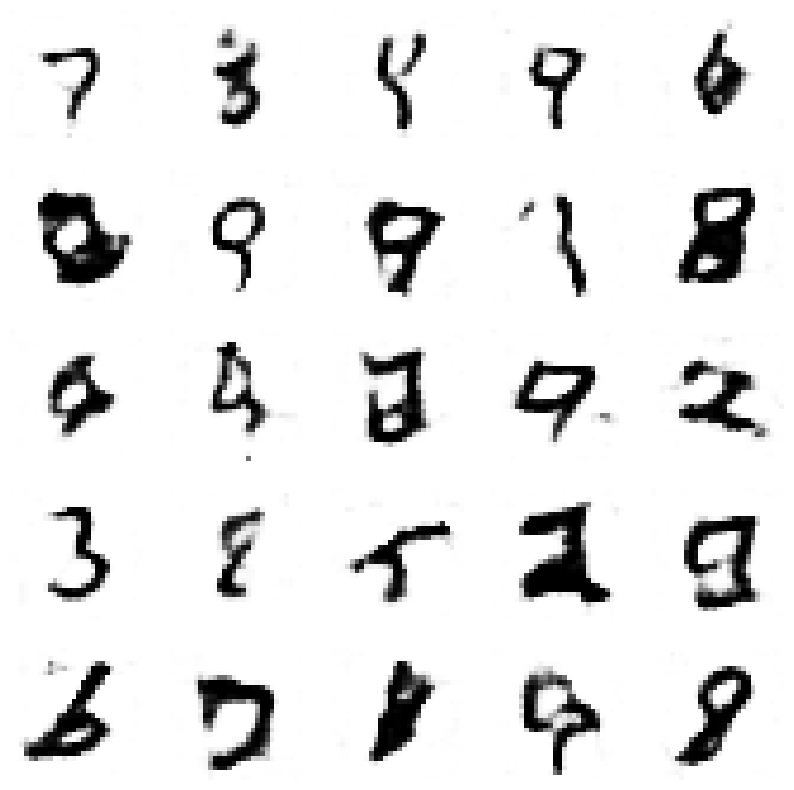

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4650430271768162, Generator Loss 0.7783011279554448
1/1 [==============================] - 0s 37ms/step


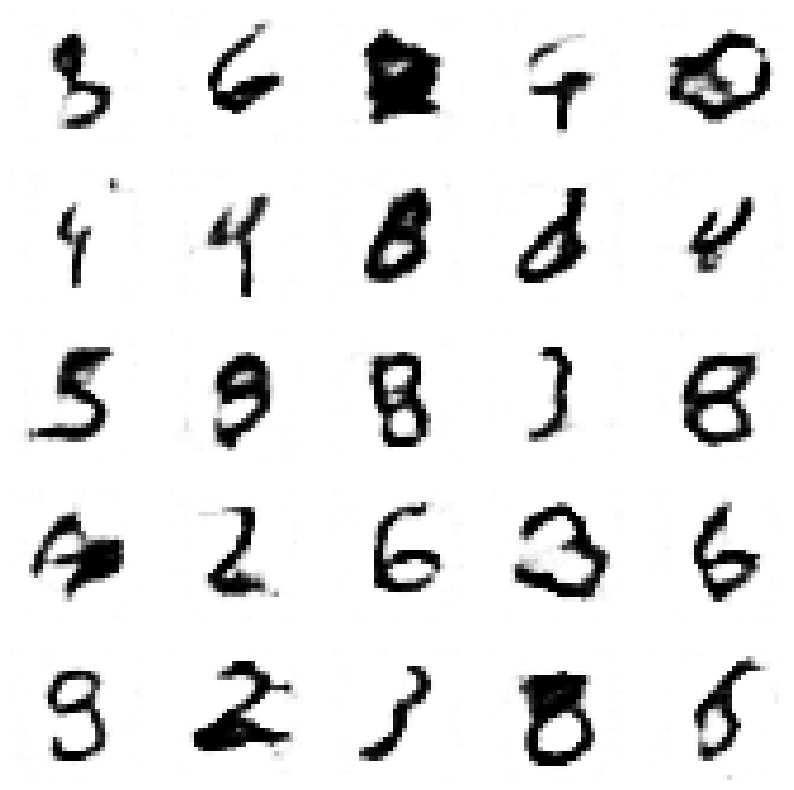

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.46795028702825564, Generator Loss 0.783025899503985
1/1 [==============================] - 0s 29ms/step


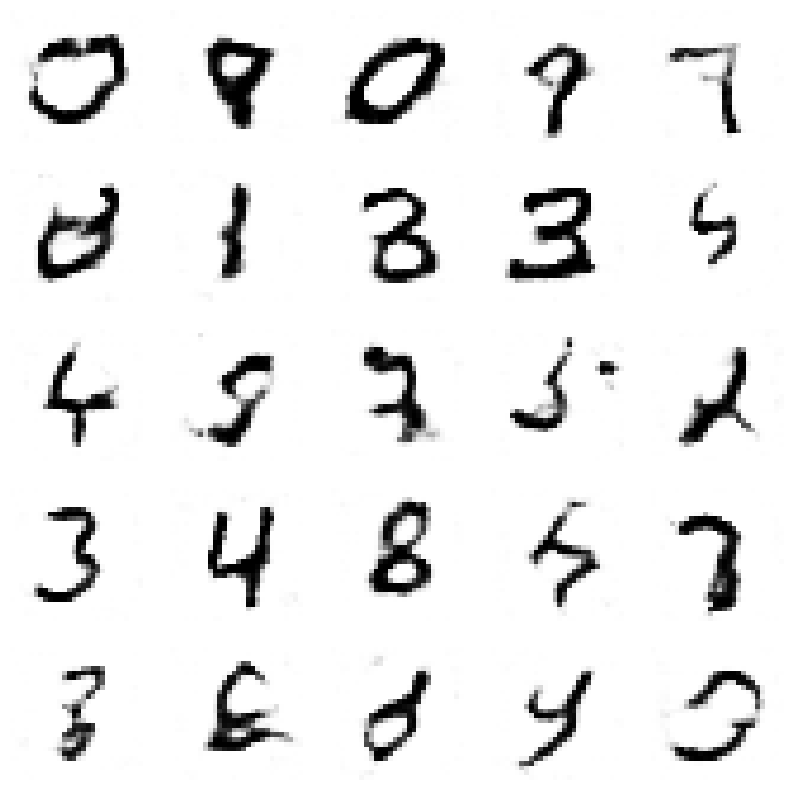

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4707175386257661, Generator Loss 0.7877569229174883
1/1 [==============================] - 0s 32ms/step


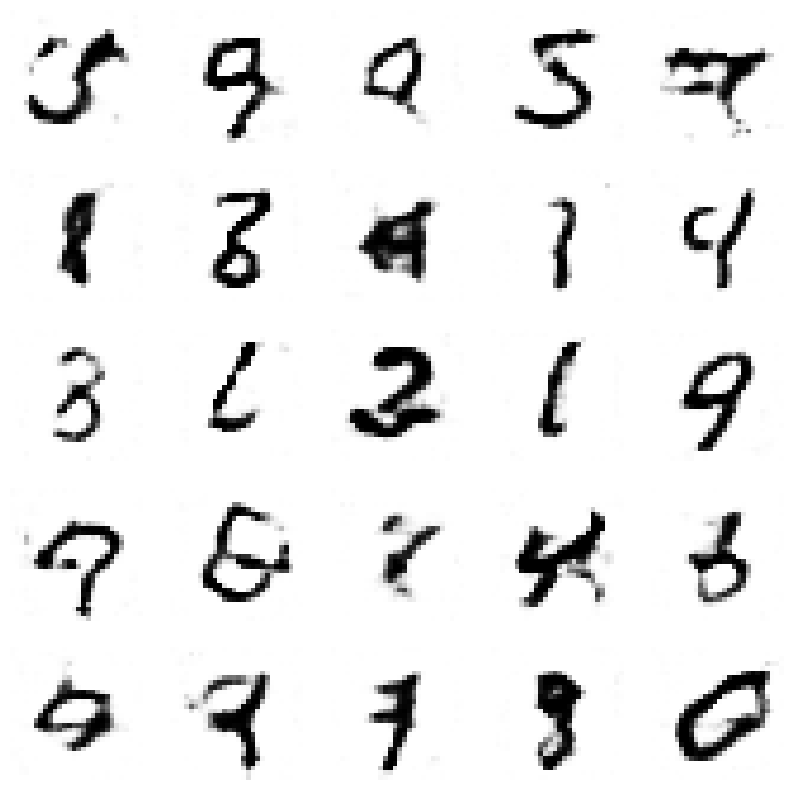

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4735508310234445, Generator Loss 0.7923915319972568
1/1 [==============================] - 0s 27ms/step


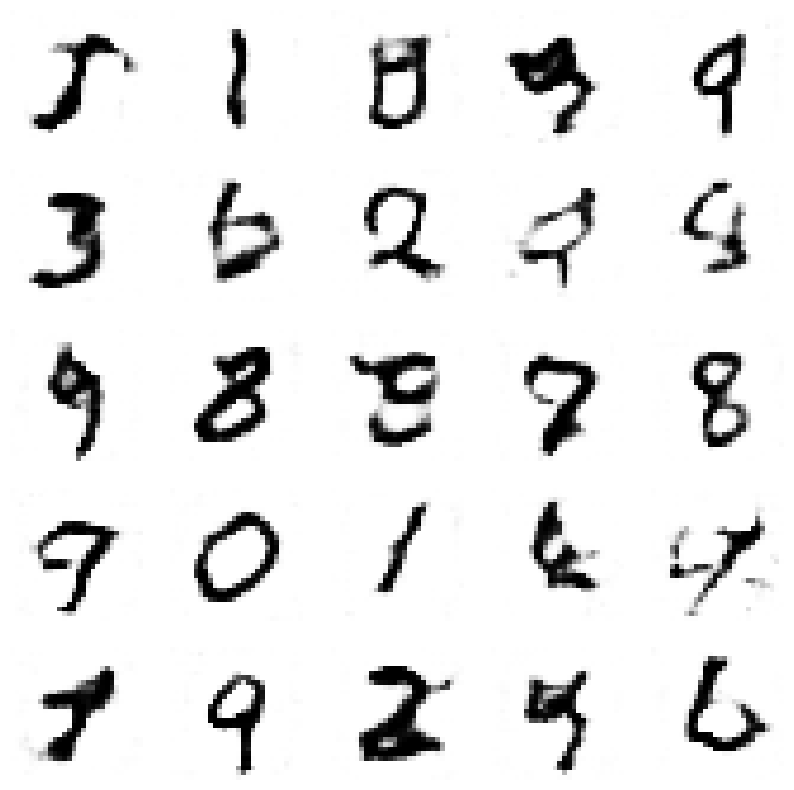

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.47635566245796335, Generator Loss 0.7971489842121418
1/1 [==============================] - 0s 42ms/step


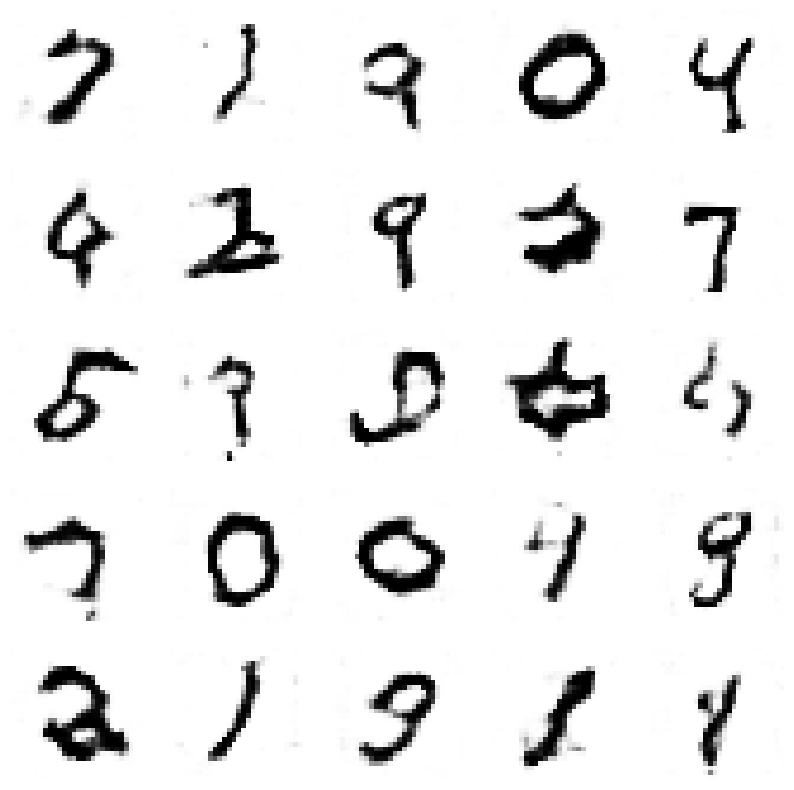

4/4 [==============================] - 0s 6ms/step
Epoch 10, Disc loss 0.4791275038678422, Generator Loss 0.8020299469303881
1/1 [==============================] - 0s 34ms/step


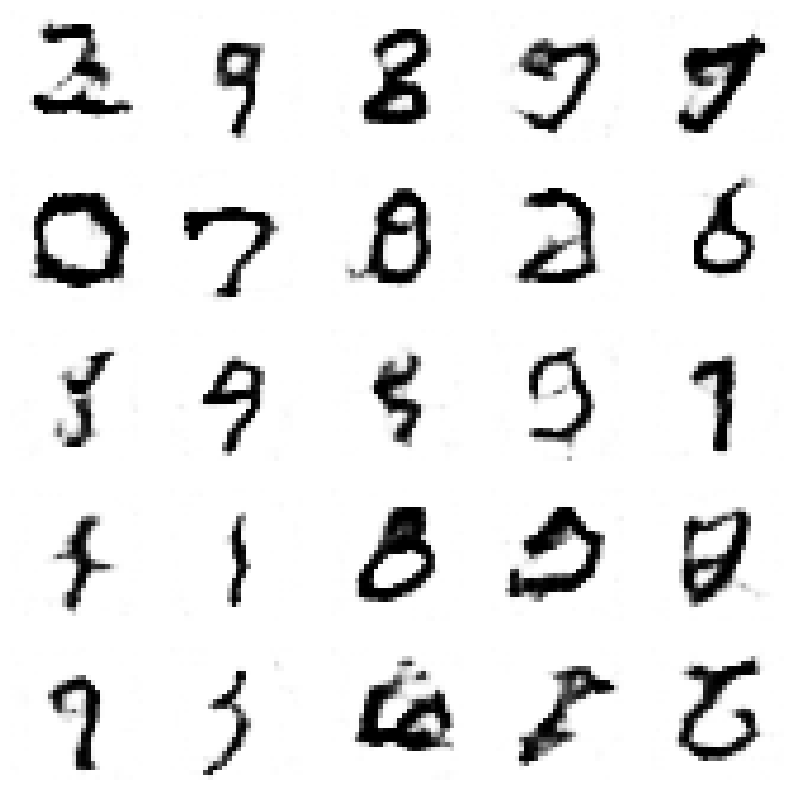

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.48192584234425145, Generator Loss 0.8066187093400548
1/1 [==============================] - 0s 42ms/step


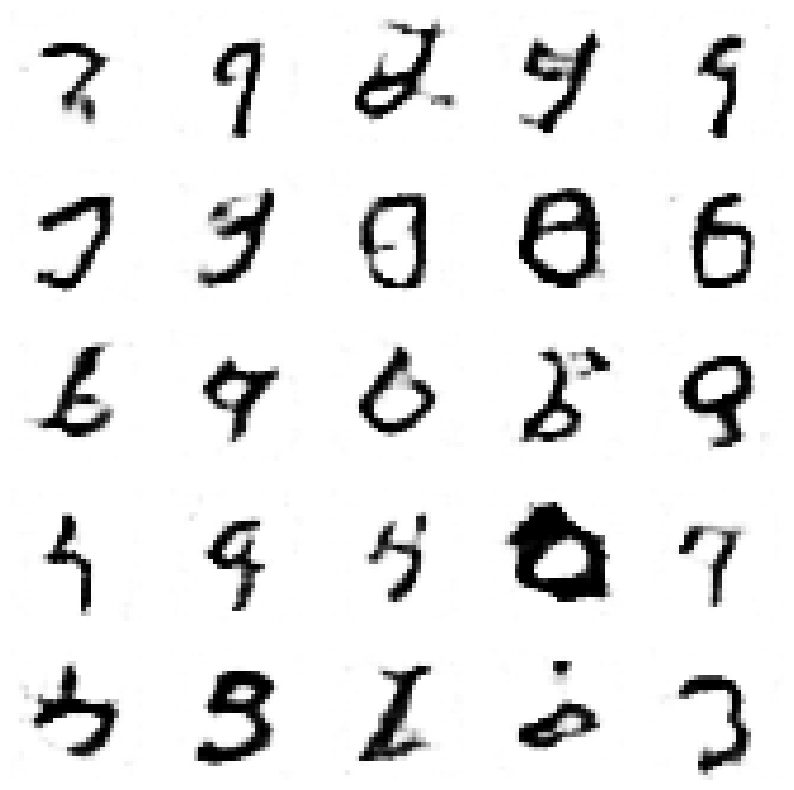

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.48483732062527257, Generator Loss 0.8111893840325184
1/1 [==============================] - 0s 26ms/step


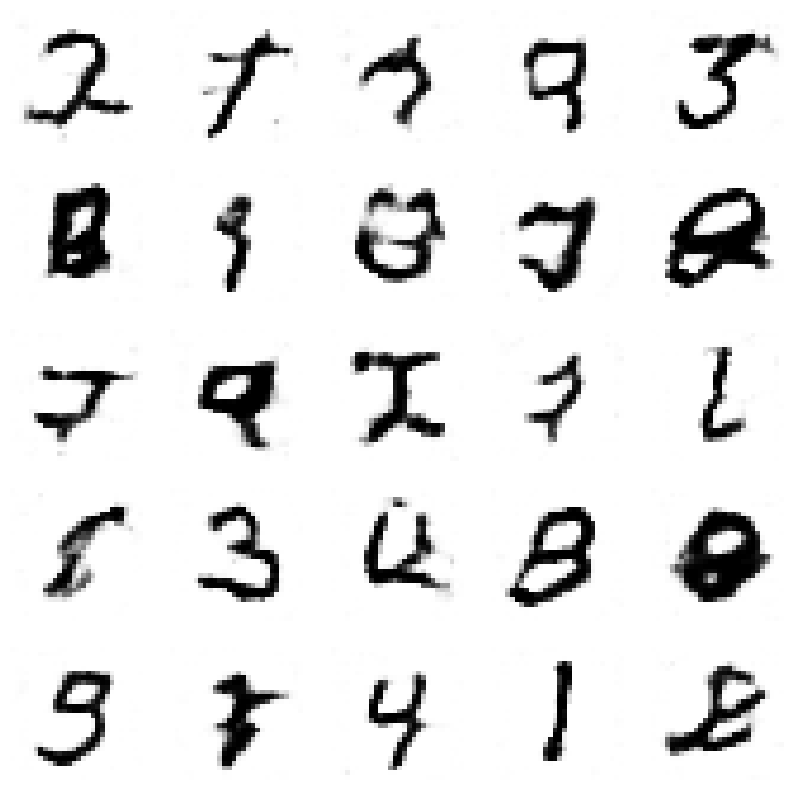

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.48761680429307824, Generator Loss 0.8159960355514135
1/1 [==============================] - 0s 27ms/step


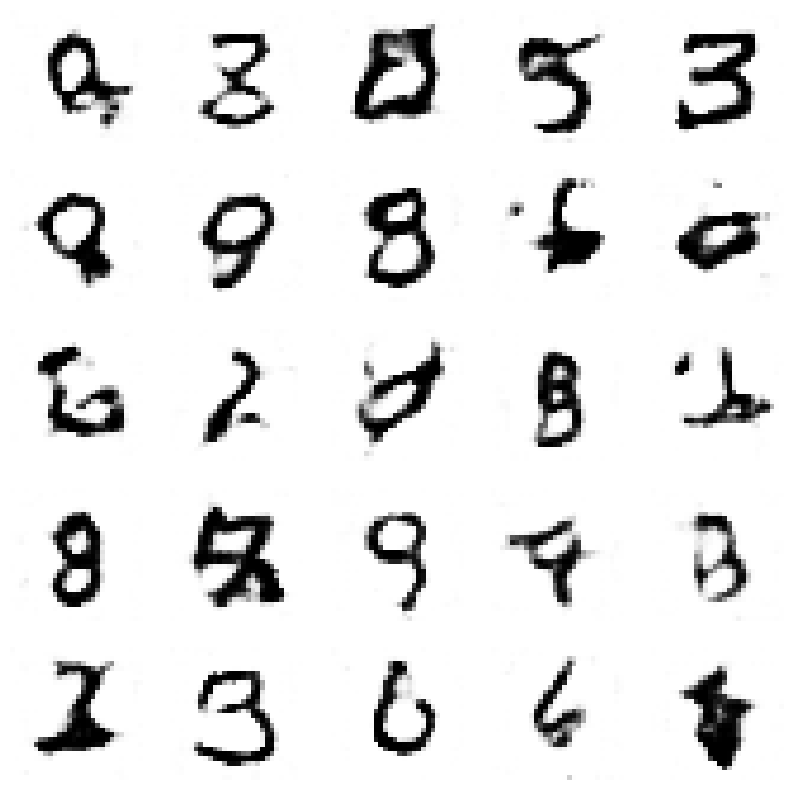

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.4903428567270947, Generator Loss 0.8208054543560387
1/1 [==============================] - 0s 30ms/step


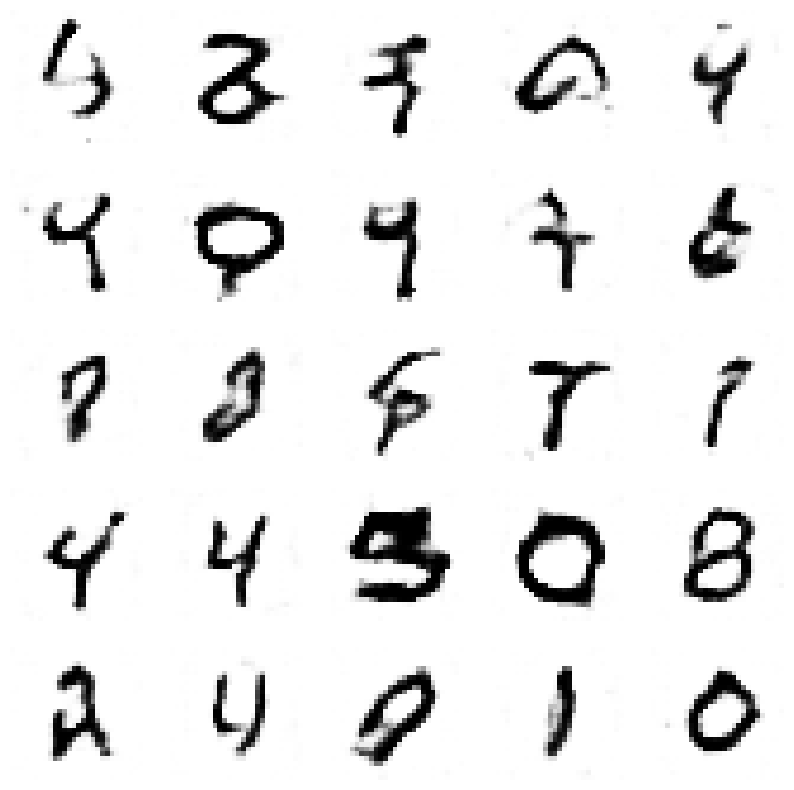

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.4931493041097608, Generator Loss 0.8256015115314059
1/1 [==============================] - 0s 34ms/step


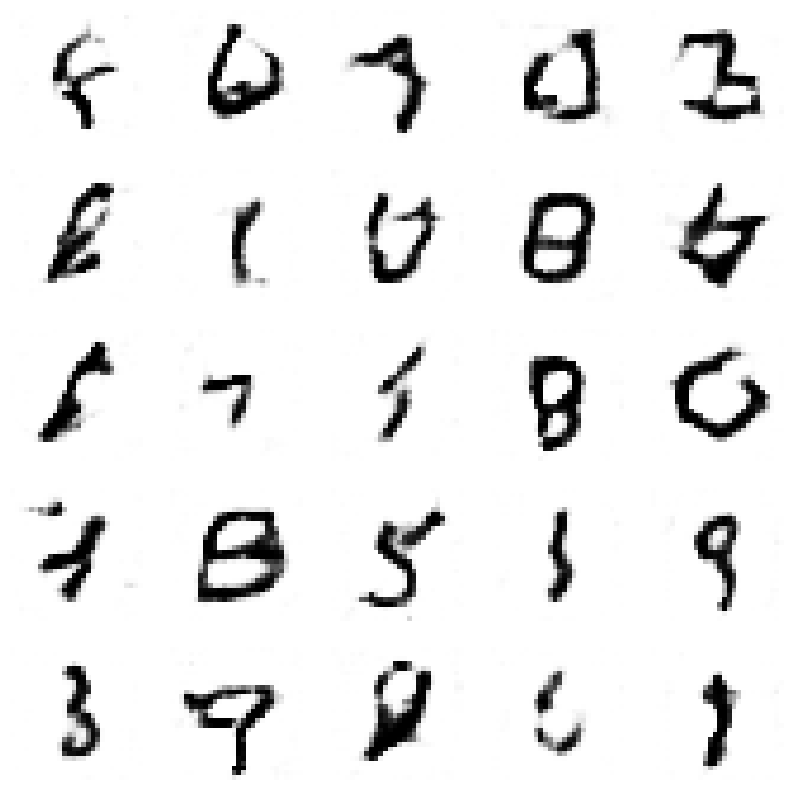

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.49590051798229545, Generator Loss 0.8303616872200599
1/1 [==============================] - 0s 26ms/step


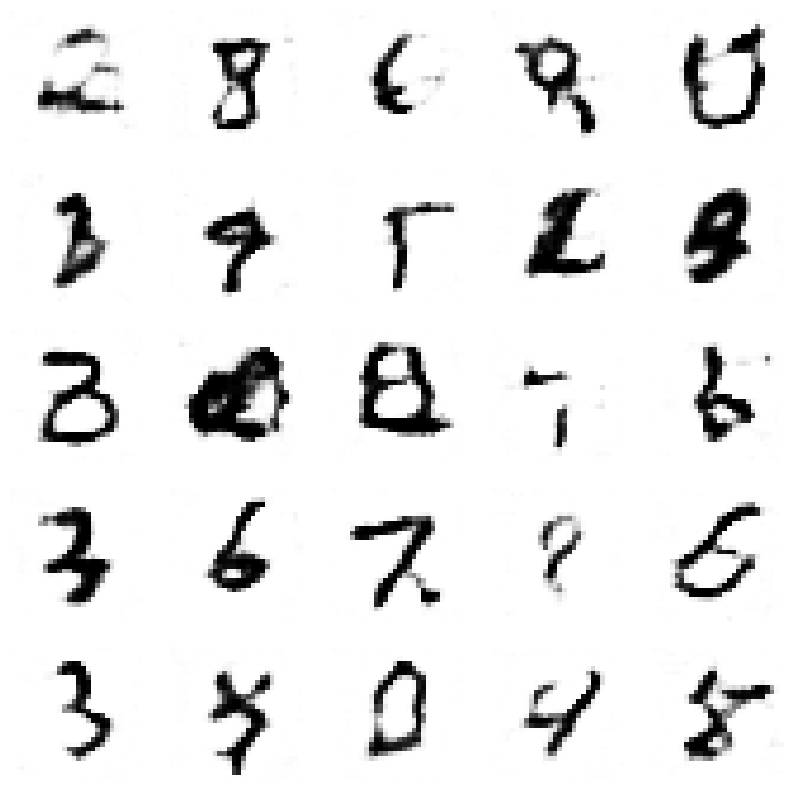

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.49872695291653657, Generator Loss 0.8350032506844937
1/1 [==============================] - 0s 26ms/step


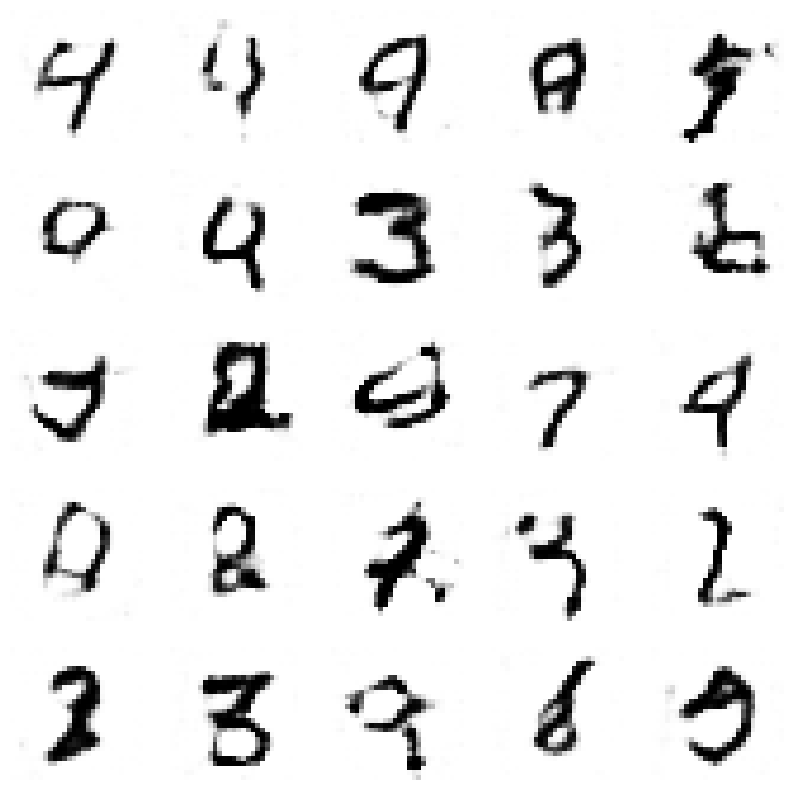

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5016204983505428, Generator Loss 0.8397521498875741
1/1 [==============================] - 0s 27ms/step


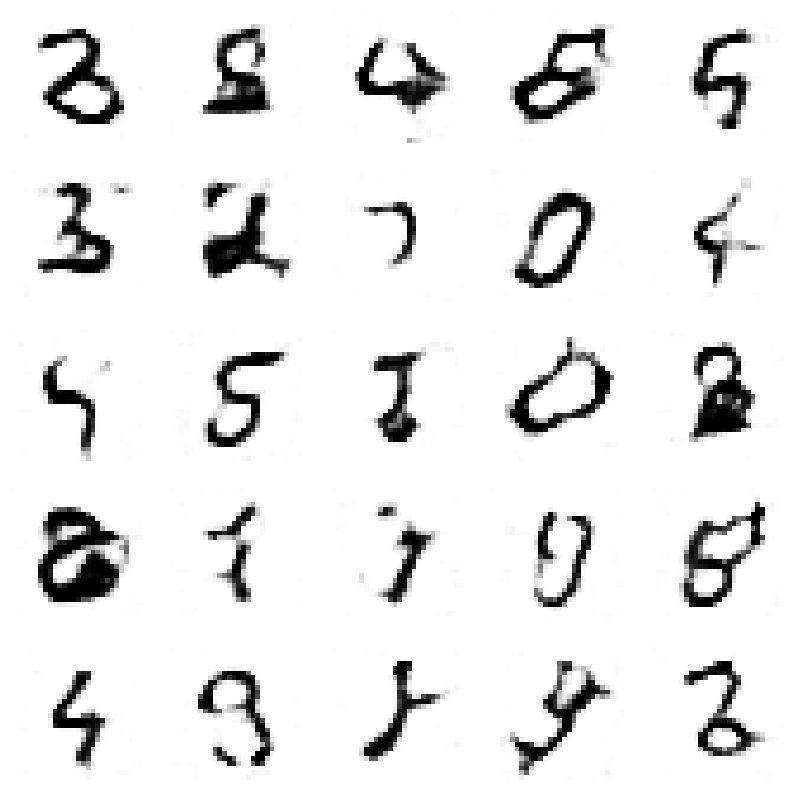

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5044310734822199, Generator Loss 0.8444413532558669
1/1 [==============================] - 0s 31ms/step


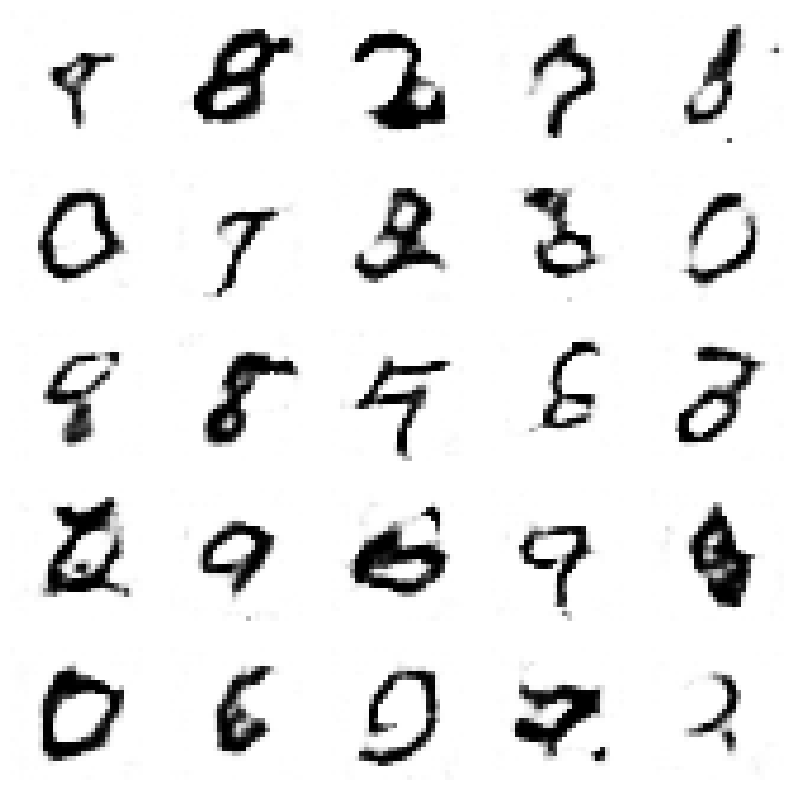

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5073081010427231, Generator Loss 0.8490873488605531
1/1 [==============================] - 0s 38ms/step


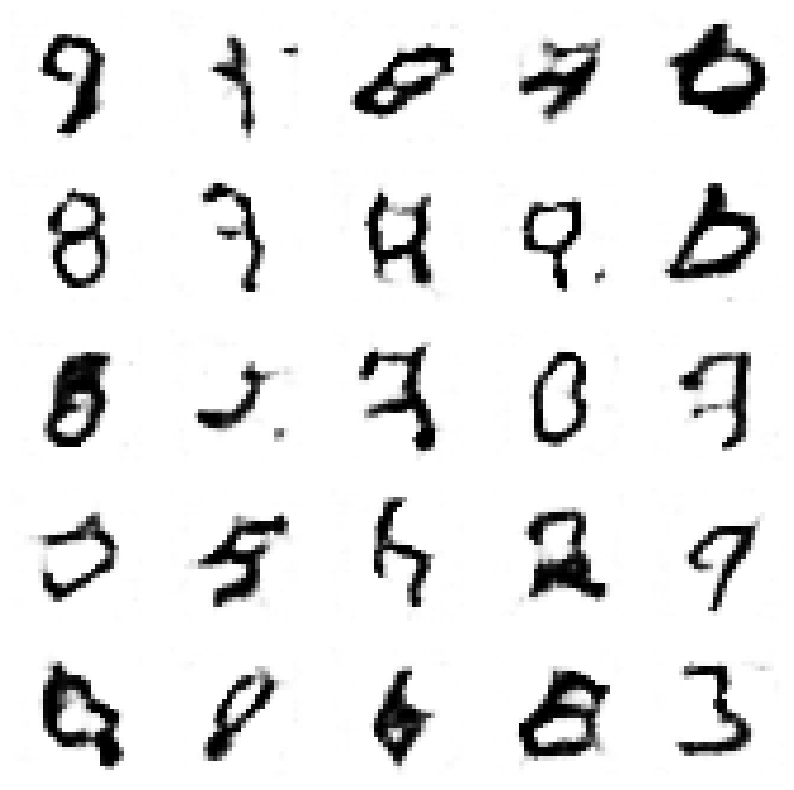

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.5100739735823411, Generator Loss 0.8536536087337722
1/1 [==============================] - 0s 31ms/step


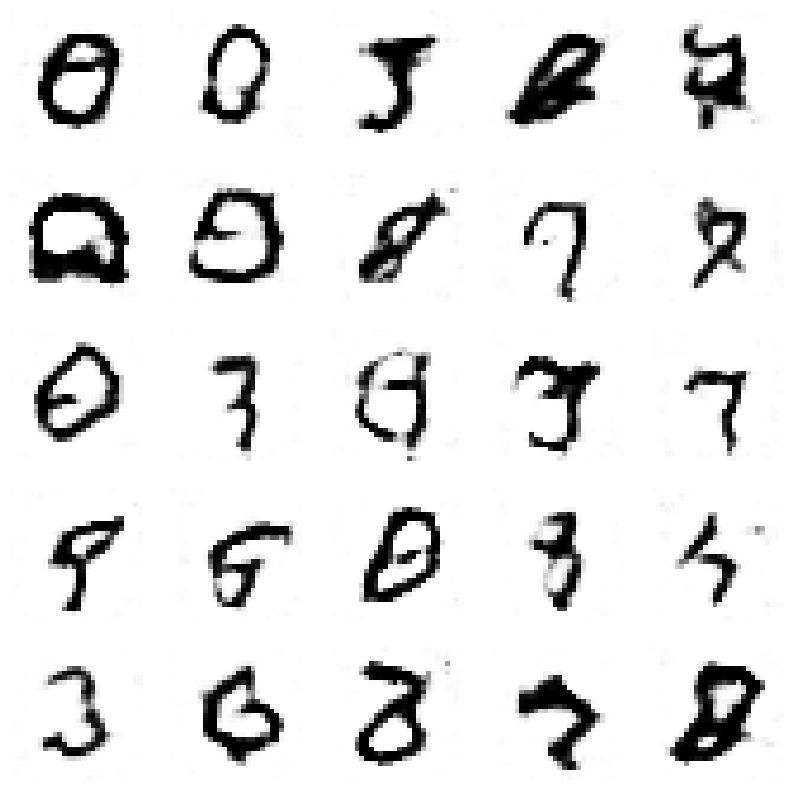

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5128306168266851, Generator Loss 0.8583587464104351
1/1 [==============================] - 0s 36ms/step


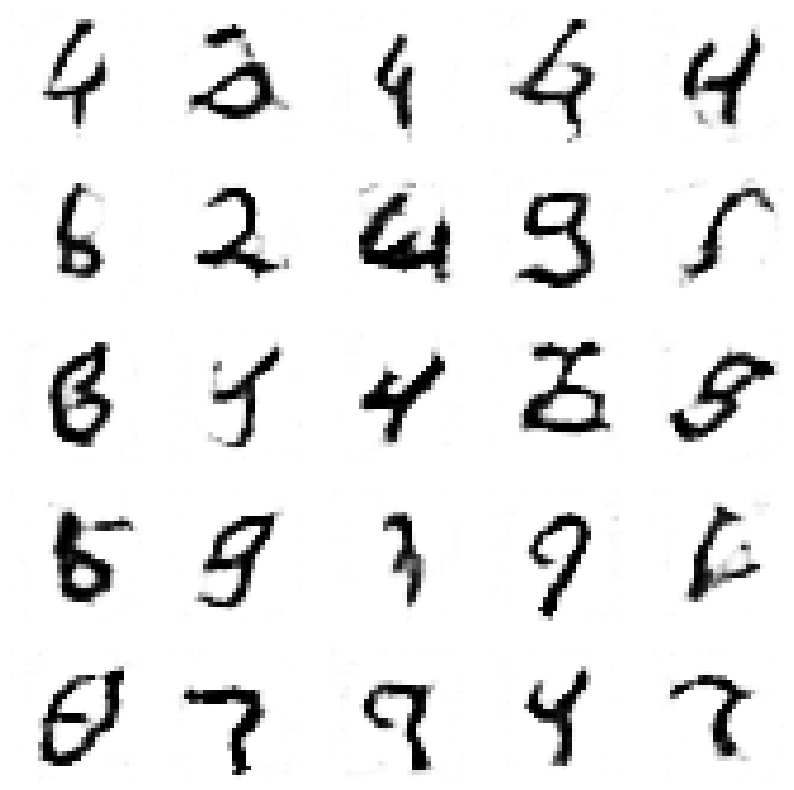

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5155993899983219, Generator Loss 0.8629819506253952
1/1 [==============================] - 0s 25ms/step


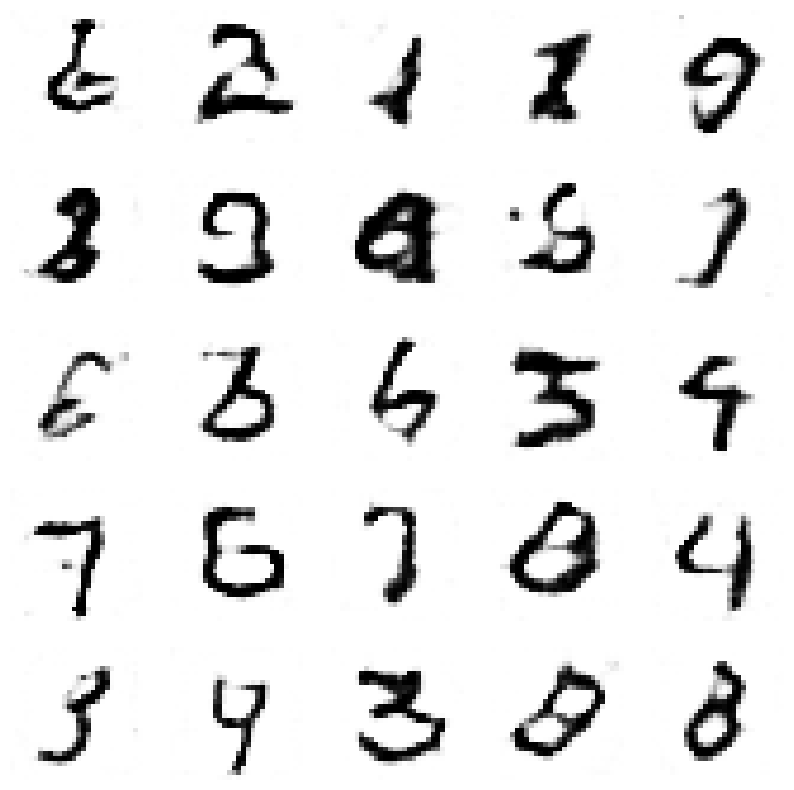

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5185389922470109, Generator Loss 0.8676496321319515
1/1 [==============================] - 0s 31ms/step


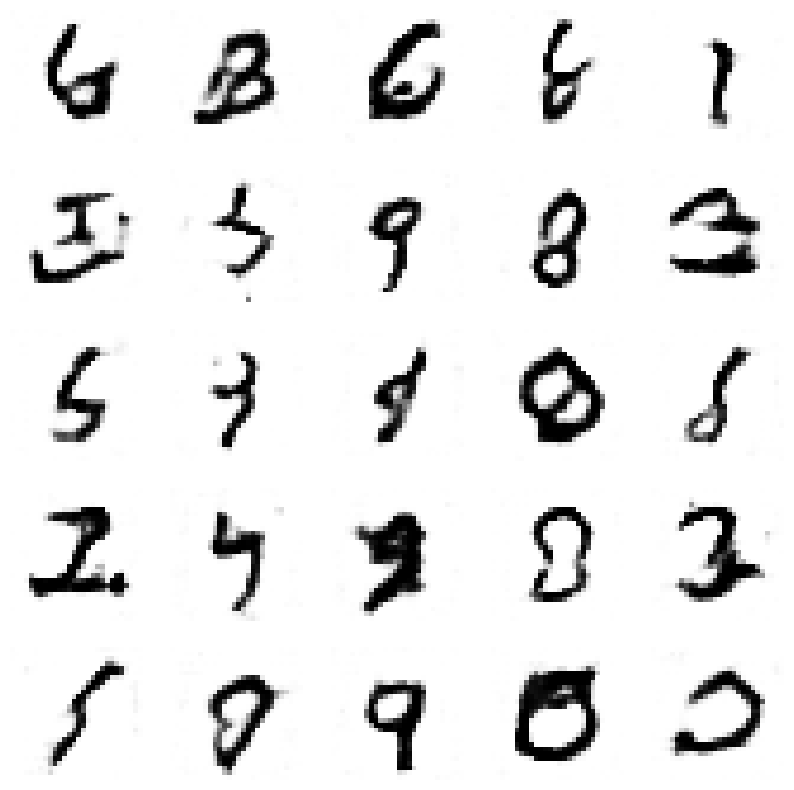

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.521341218907609, Generator Loss 0.8721973177714225
1/1 [==============================] - 0s 27ms/step


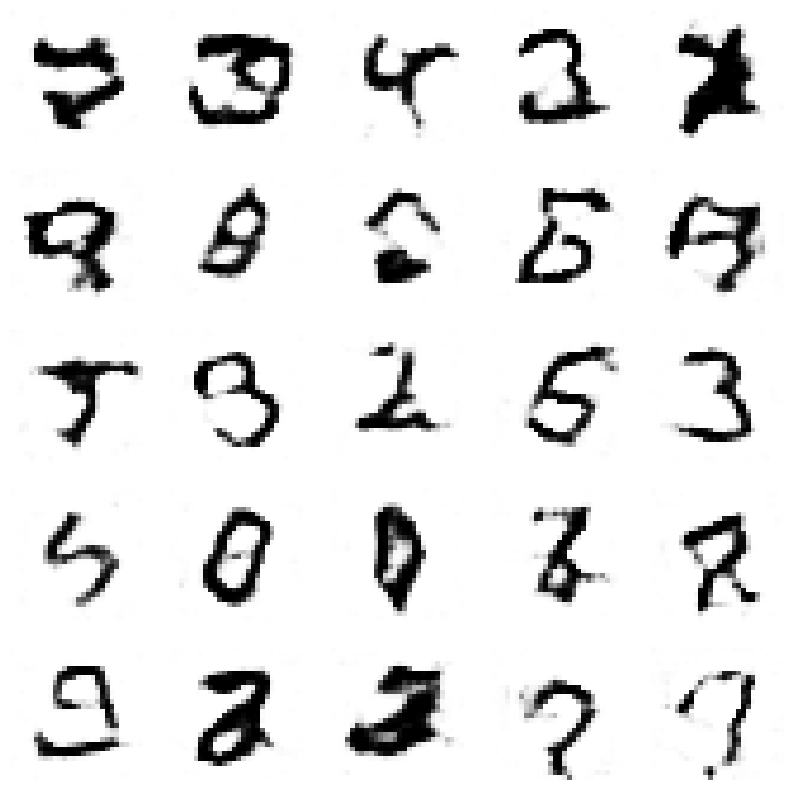

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5242101355240896, Generator Loss 0.8769713716629224
1/1 [==============================] - 0s 38ms/step


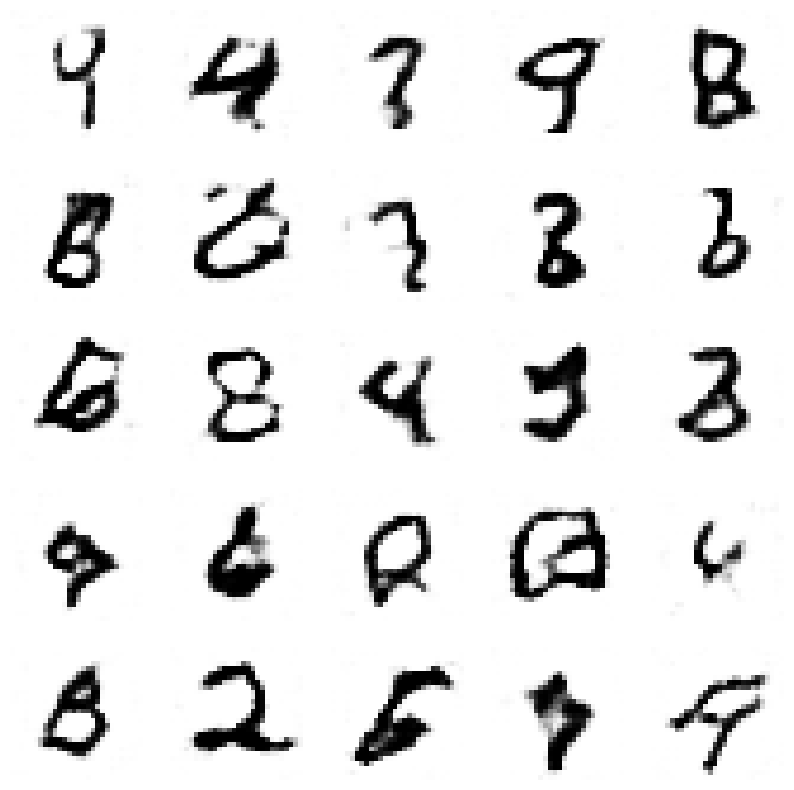

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5268900328212314, Generator Loss 0.8819211278206263
1/1 [==============================] - 0s 31ms/step


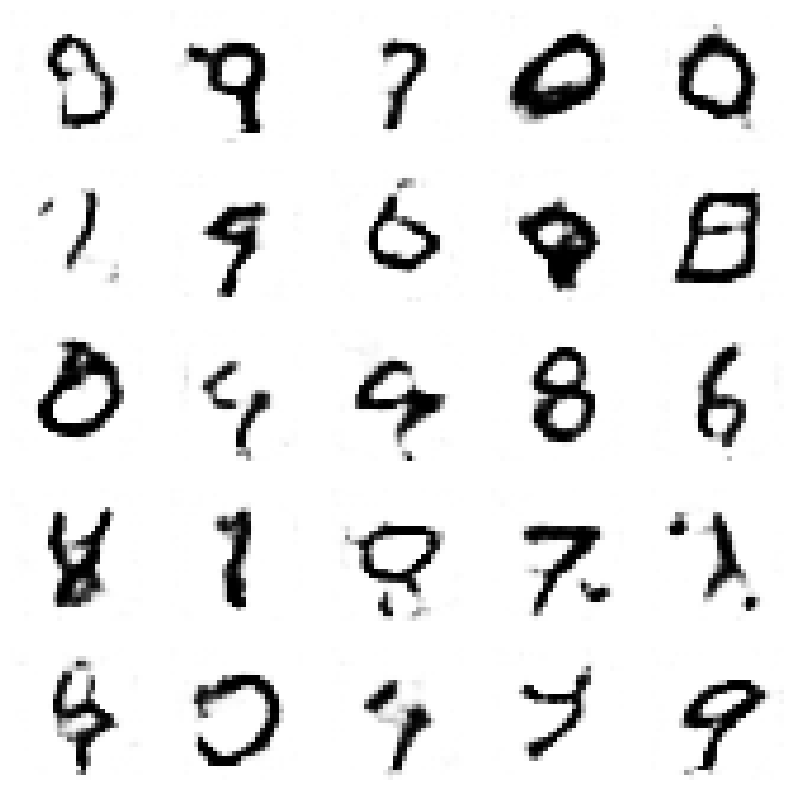

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5297988161572025, Generator Loss 0.886533982733376
1/1 [==============================] - 0s 34ms/step


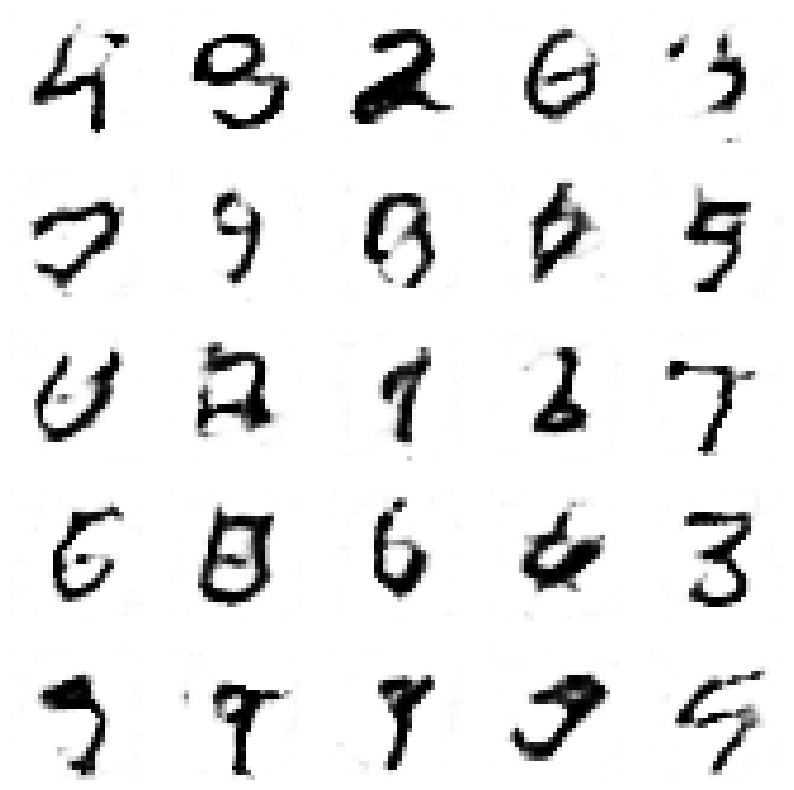

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5326294699031063, Generator Loss 0.8911407299530811
1/1 [==============================] - 0s 28ms/step


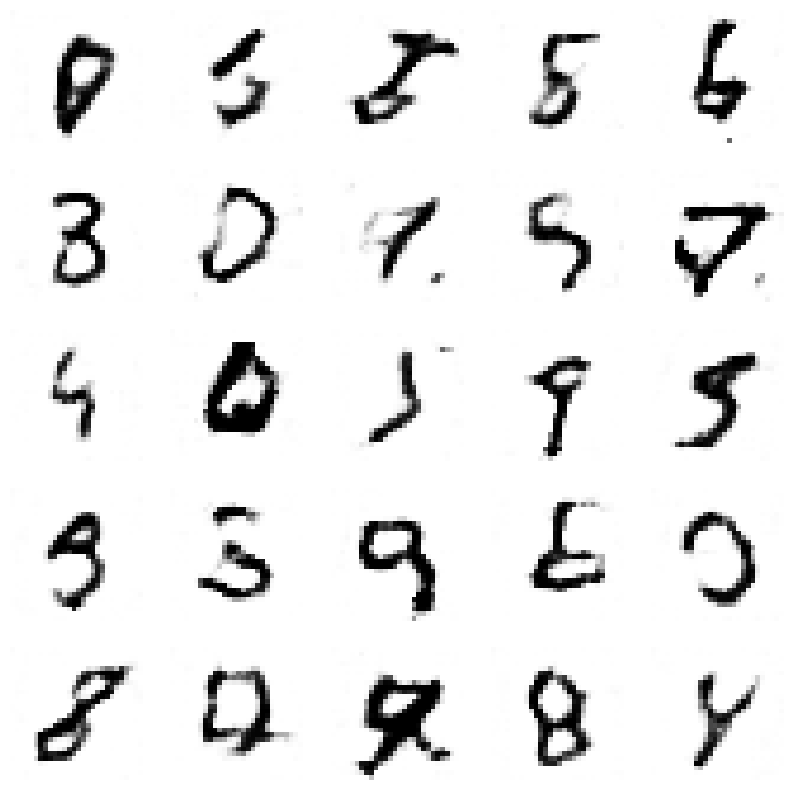

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5354769254087383, Generator Loss 0.8958176894065661
1/1 [==============================] - 0s 32ms/step


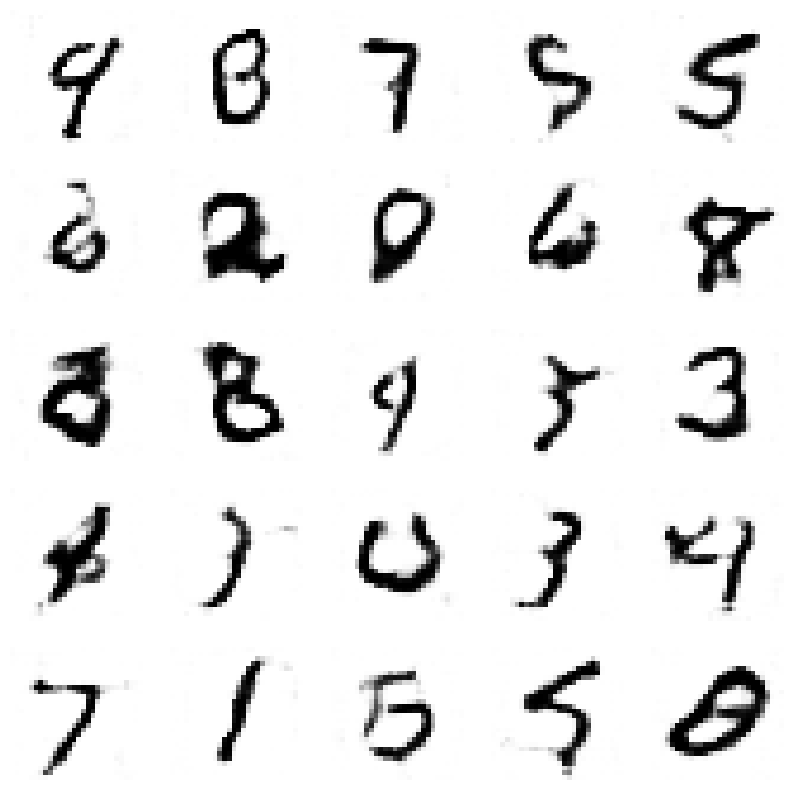

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5382163762791544, Generator Loss 0.9005607478639
1/1 [==============================] - 0s 66ms/step


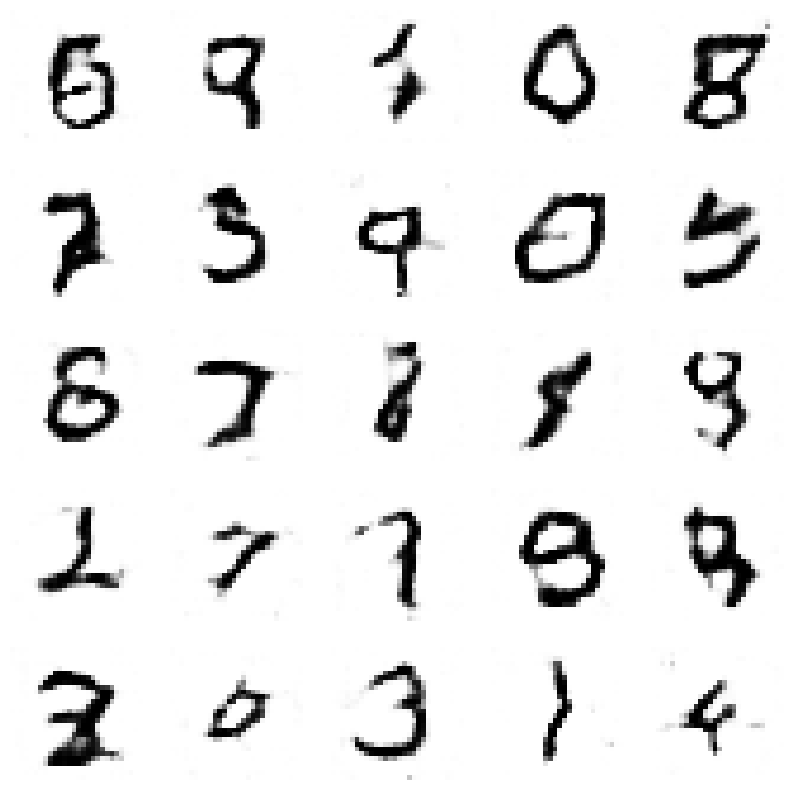

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5411485339331831, Generator Loss 0.9051844706902137
1/1 [==============================] - 0s 33ms/step


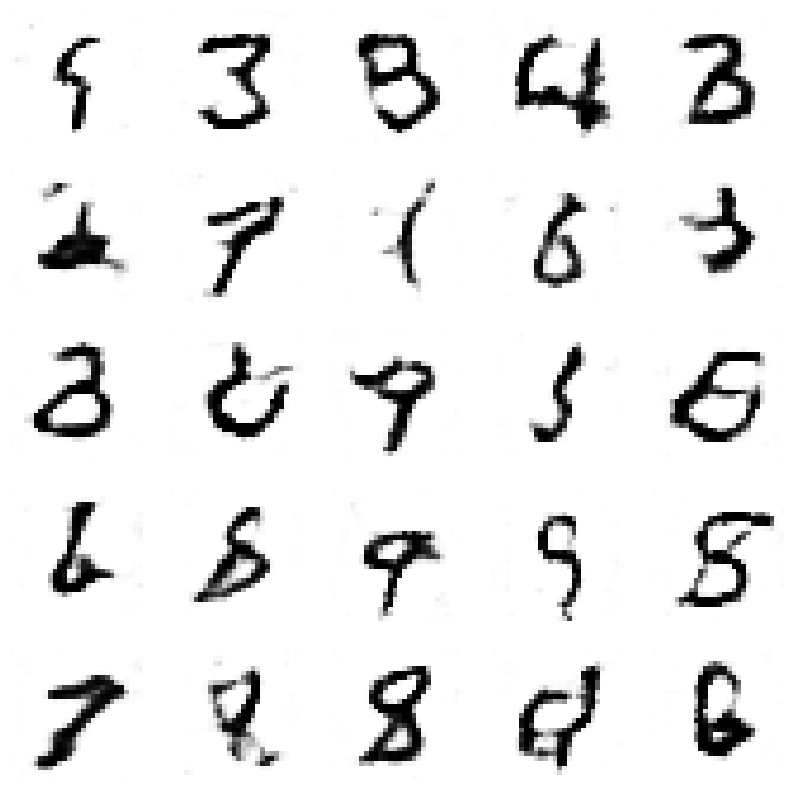

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.543960894147555, Generator Loss 0.9100500166925609
1/1 [==============================] - 0s 26ms/step


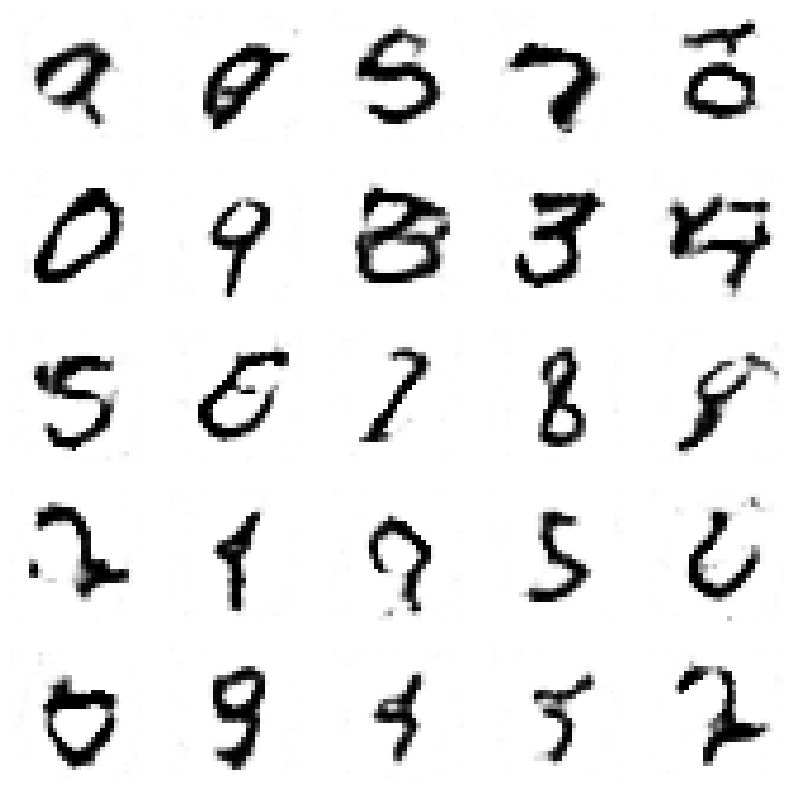

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5467898627886405, Generator Loss 0.914797706481738
1/1 [==============================] - 0s 31ms/step


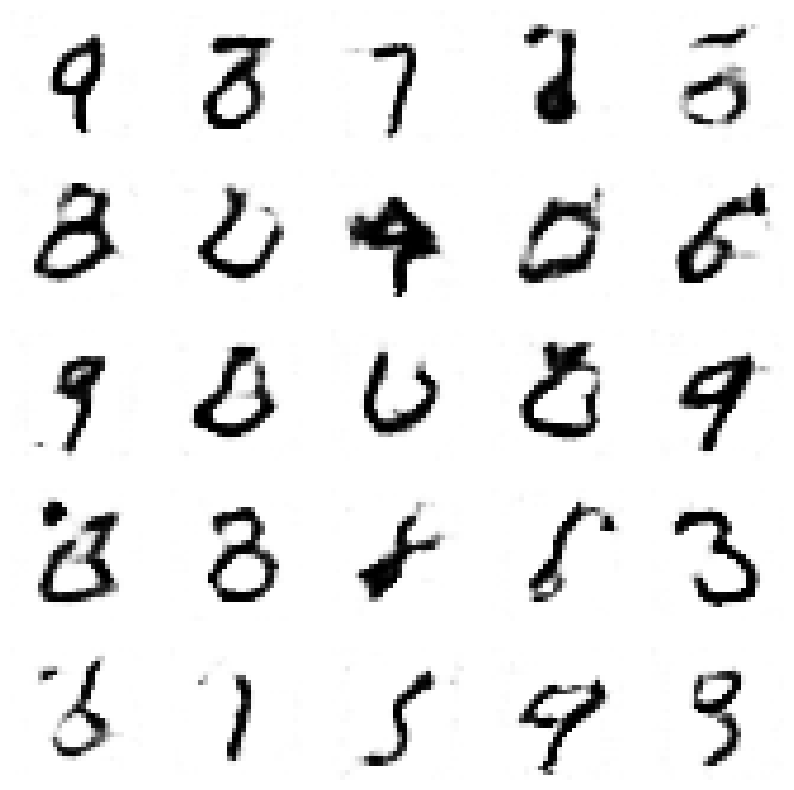

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5497214294906355, Generator Loss 0.9194930221280481
1/1 [==============================] - 0s 33ms/step


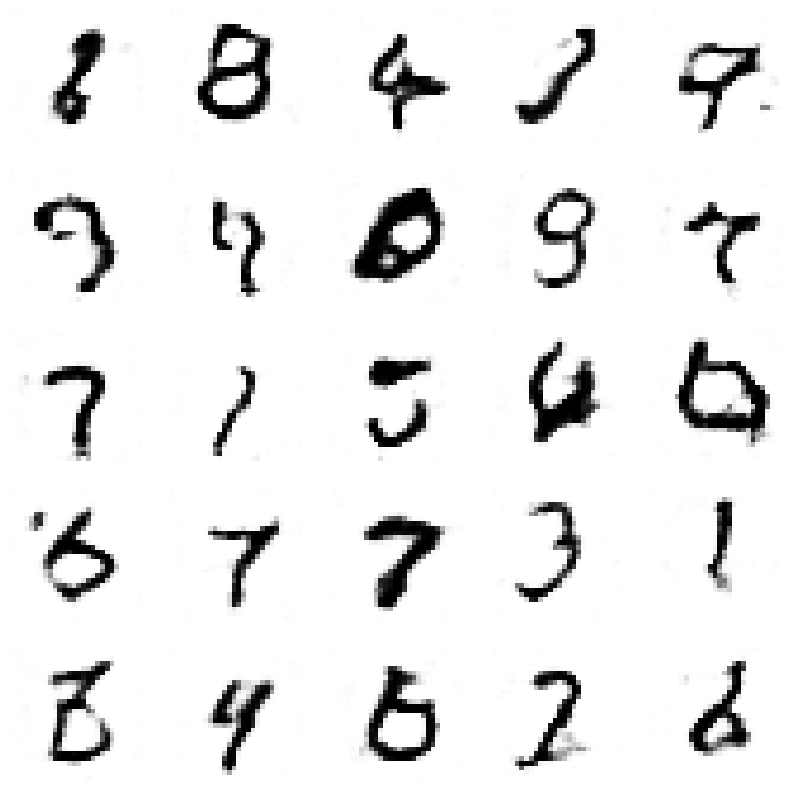

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5525761673338393, Generator Loss 0.9242740181776193
1/1 [==============================] - 0s 28ms/step


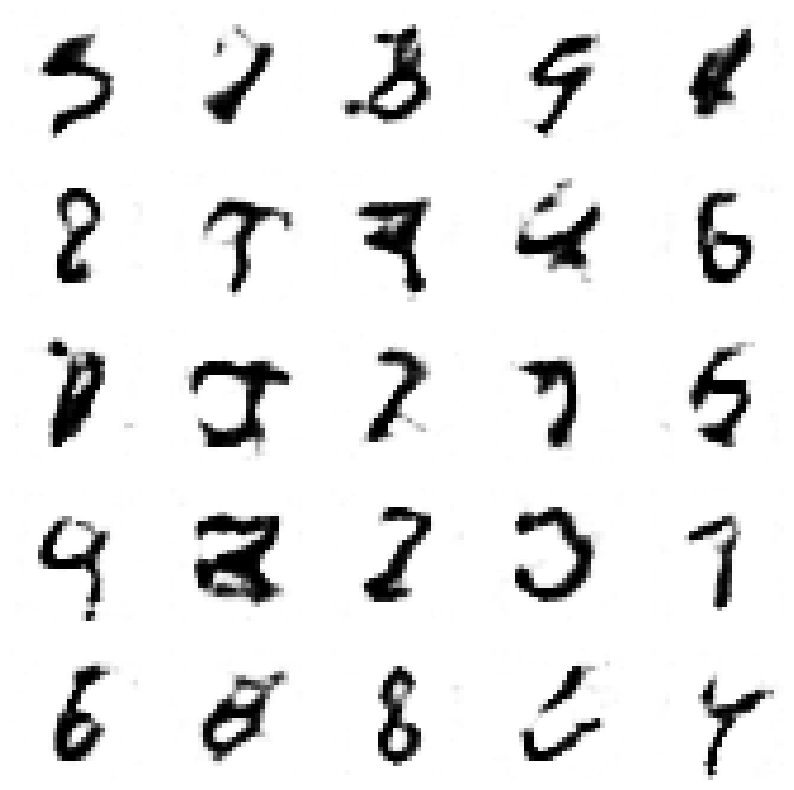

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5553941131911726, Generator Loss 0.9290829830699496
1/1 [==============================] - 0s 31ms/step


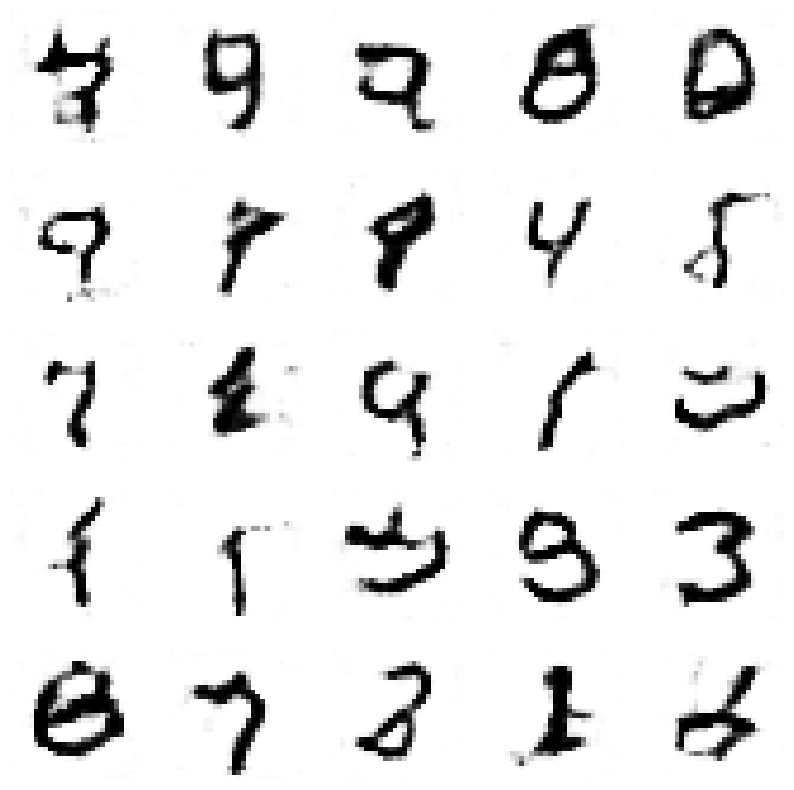

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5582565443638043, Generator Loss 0.9335899786052541
1/1 [==============================] - 0s 31ms/step


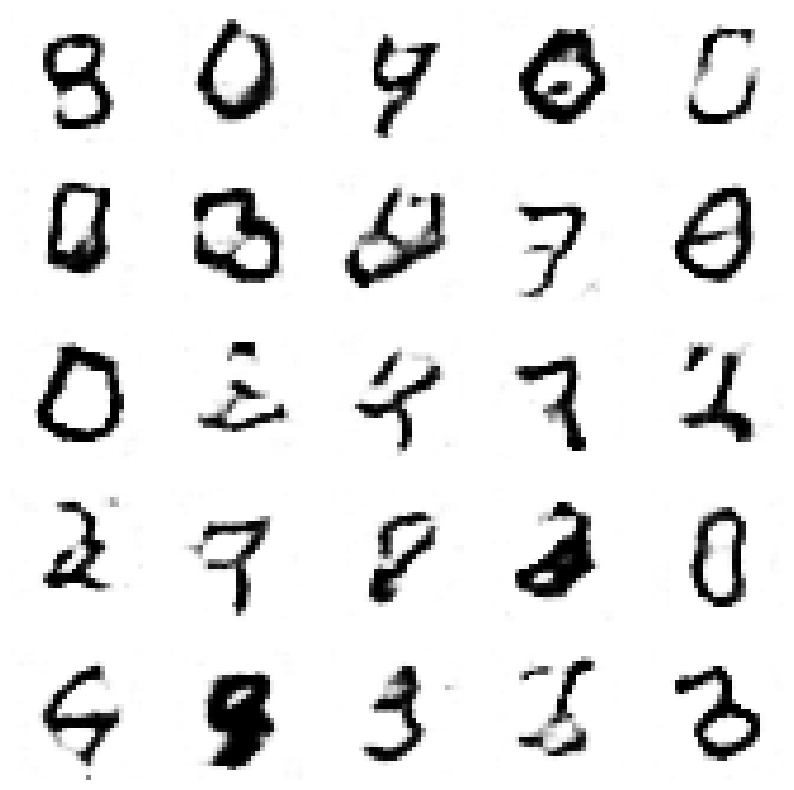

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.56110128824018, Generator Loss 0.9381053131869715
1/1 [==============================] - 0s 27ms/step


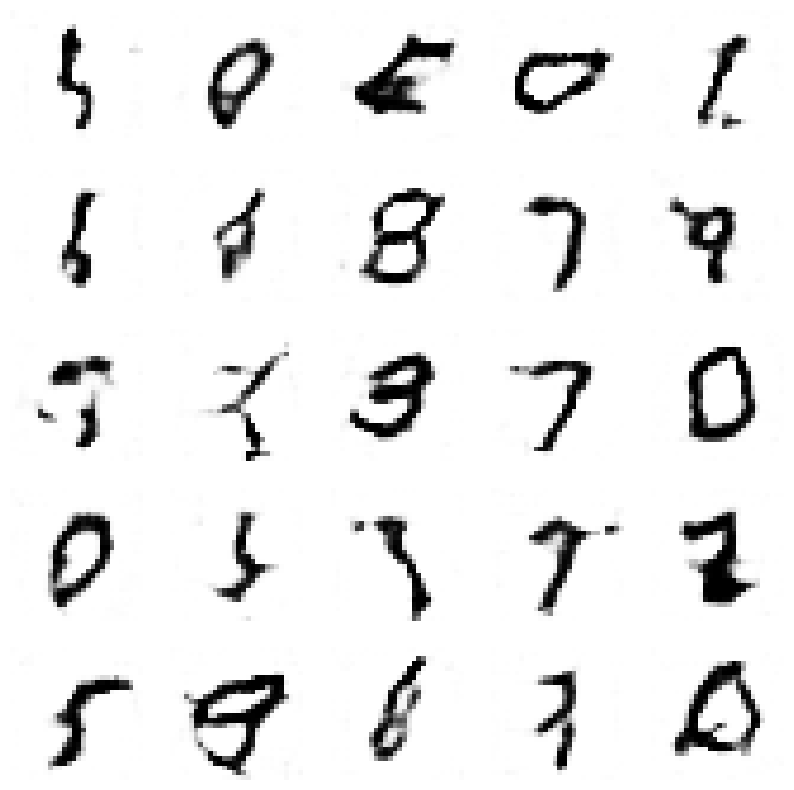

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.563952133568943, Generator Loss 0.9426987960807278
1/1 [==============================] - 0s 49ms/step


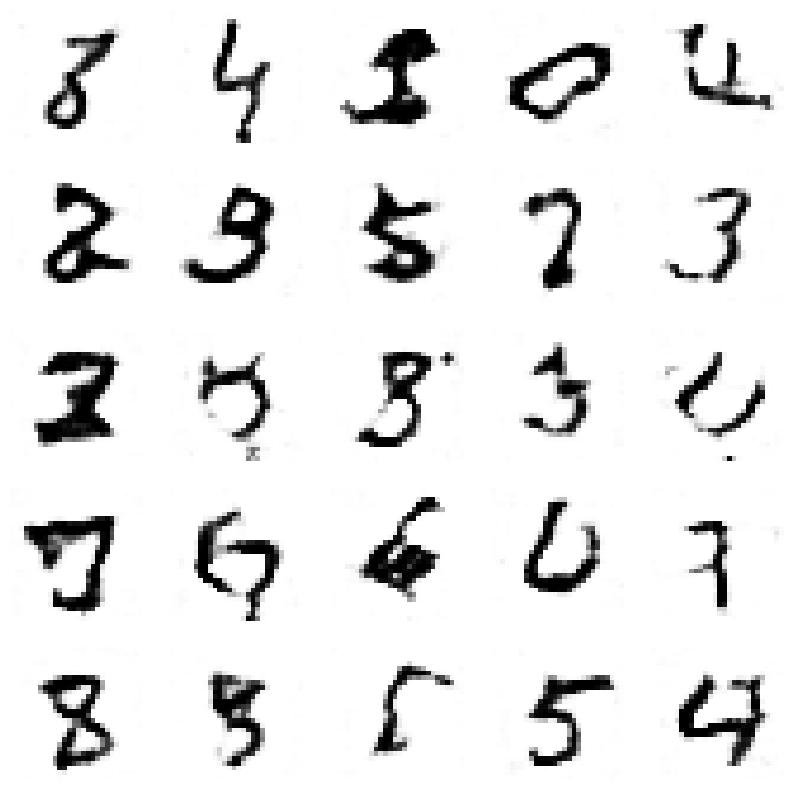

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.5668004165347825, Generator Loss 0.9475256245360415
1/1 [==============================] - 0s 45ms/step


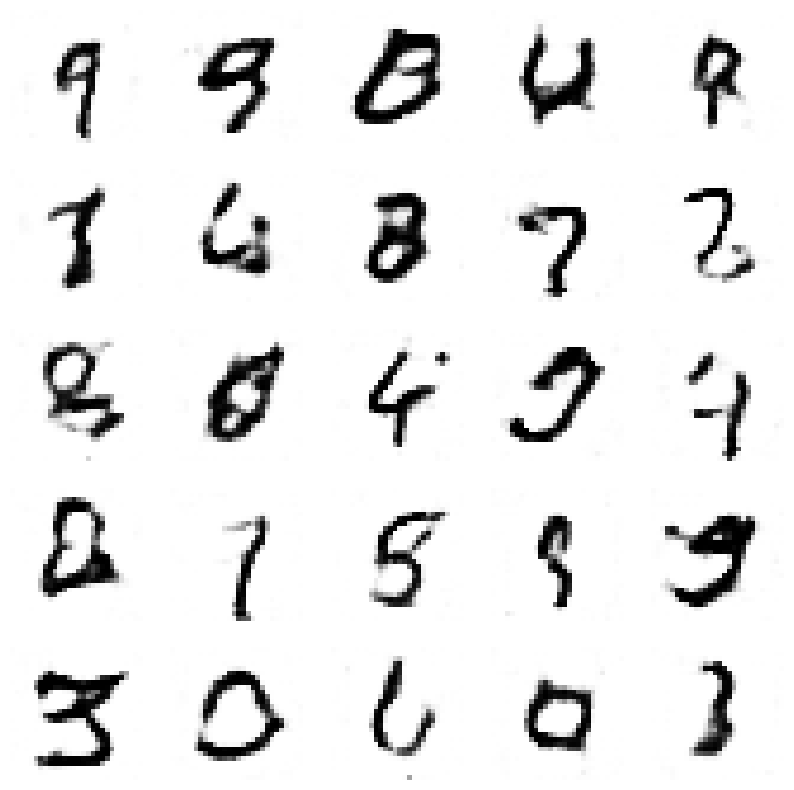

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.5696428867741528, Generator Loss 0.9522907952977042
1/1 [==============================] - 0s 36ms/step


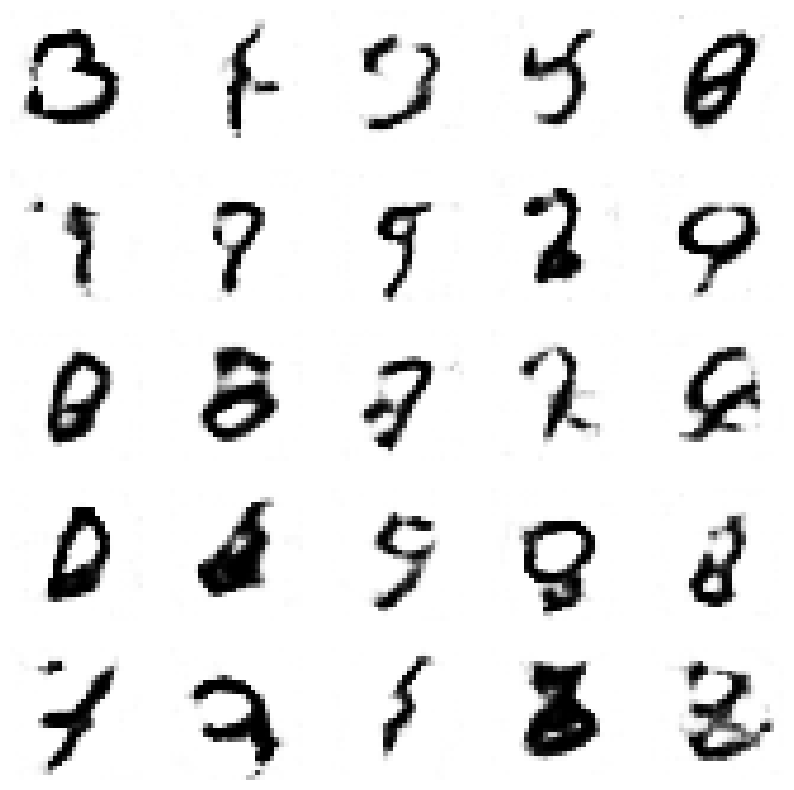

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5725051921147567, Generator Loss 0.9570202842736856
1/1 [==============================] - 0s 33ms/step


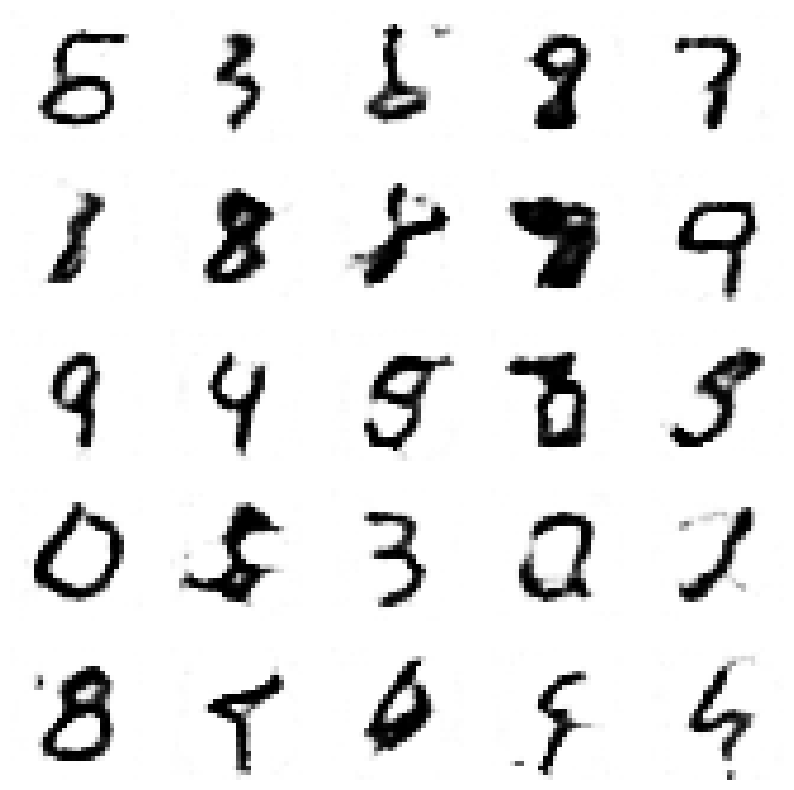

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5753481981591282, Generator Loss 0.9617220866374481
1/1 [==============================] - 0s 28ms/step


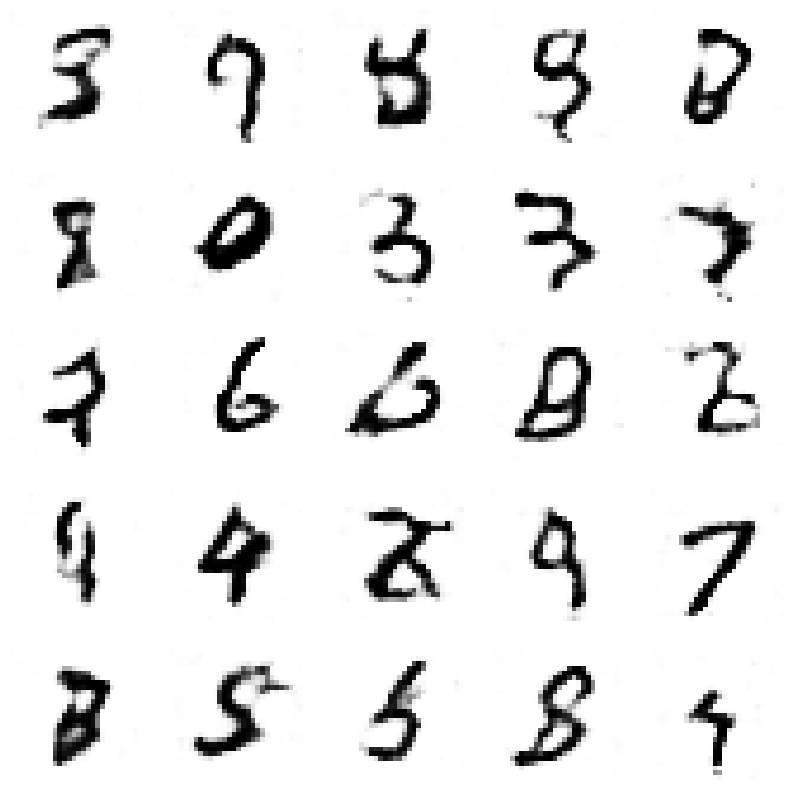

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5781982148814405, Generator Loss 0.966448679439023
1/1 [==============================] - 0s 26ms/step


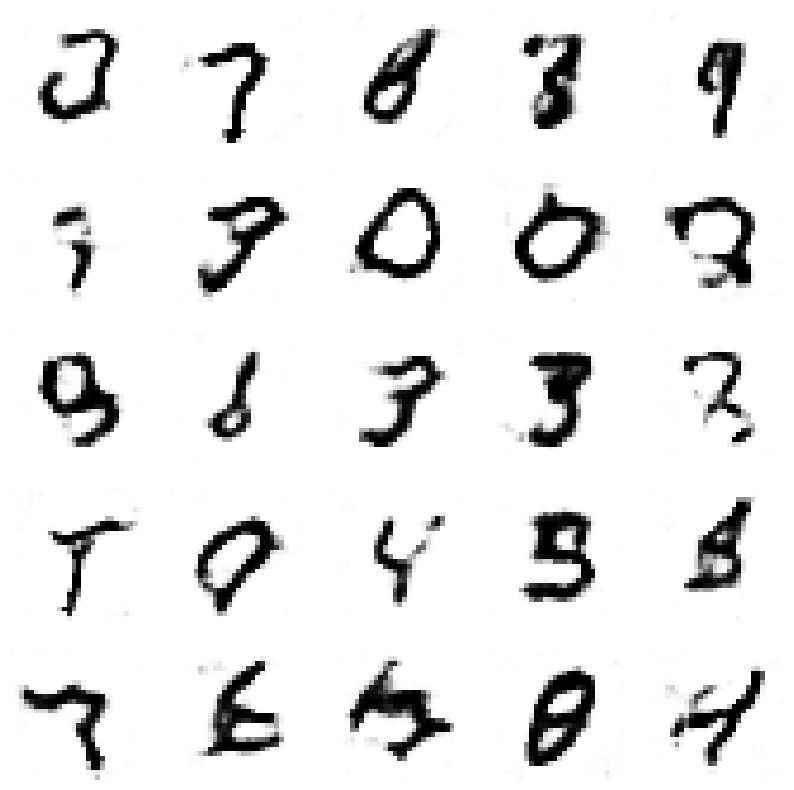

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.581048884580278, Generator Loss 0.9711459503214583
1/1 [==============================] - 0s 28ms/step


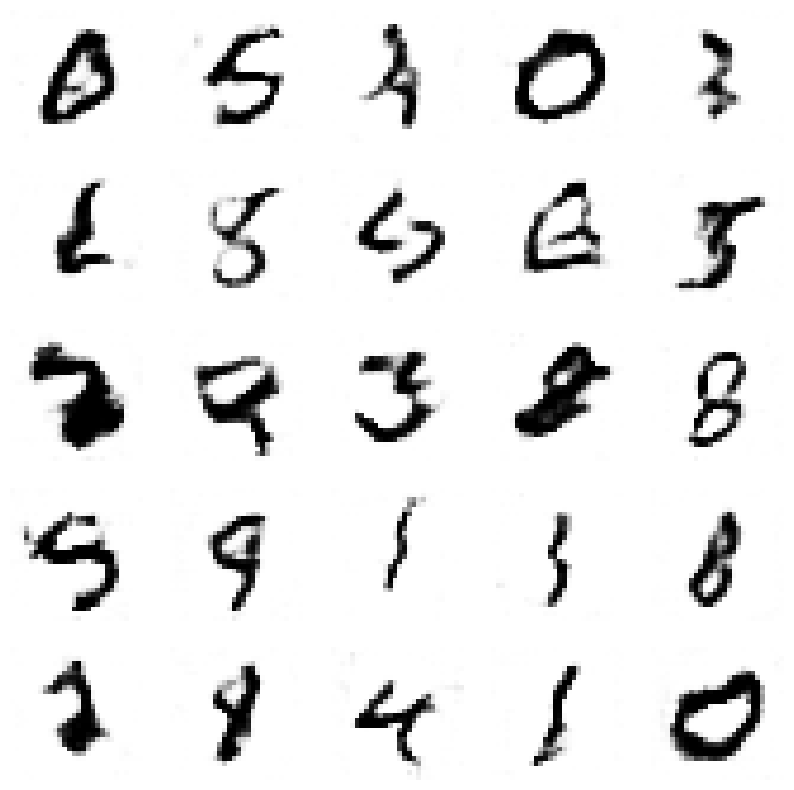

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5838871098991133, Generator Loss 0.9757617421639271
1/1 [==============================] - 0s 32ms/step


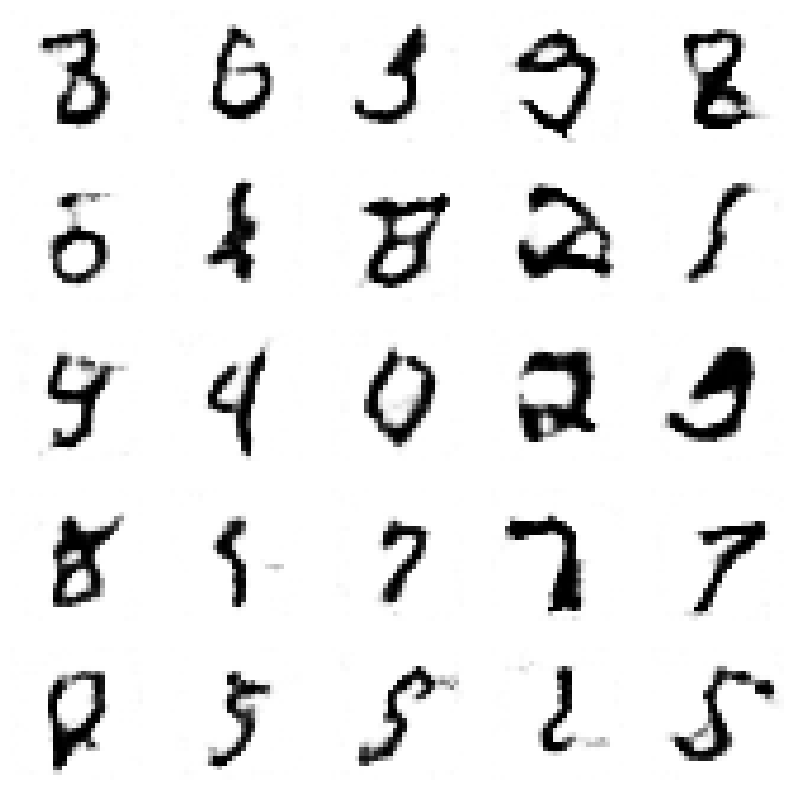

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5866497506697973, Generator Loss 0.9804573583806682
1/1 [==============================] - 0s 26ms/step


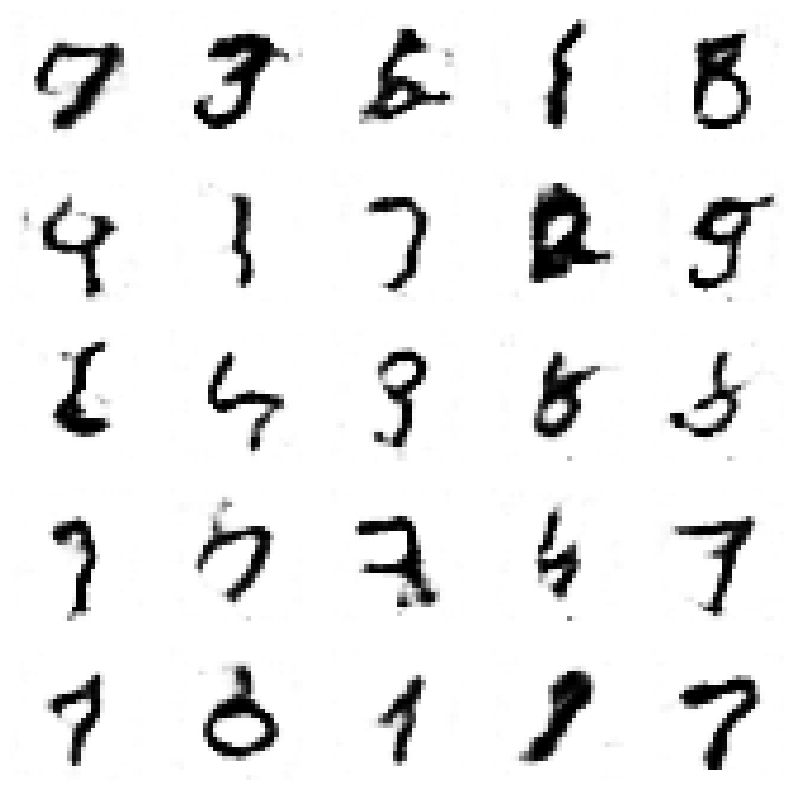

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.5894803458299392, Generator Loss 0.985088324954367
1/1 [==============================] - 0s 28ms/step


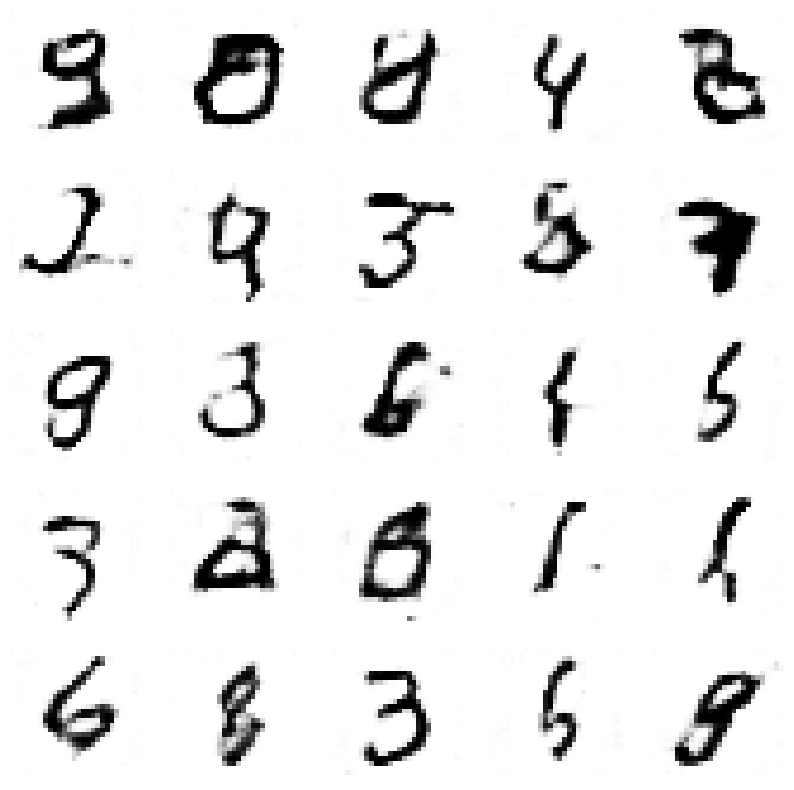

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5922862970166736, Generator Loss 0.9898988823605399
1/1 [==============================] - 0s 28ms/step


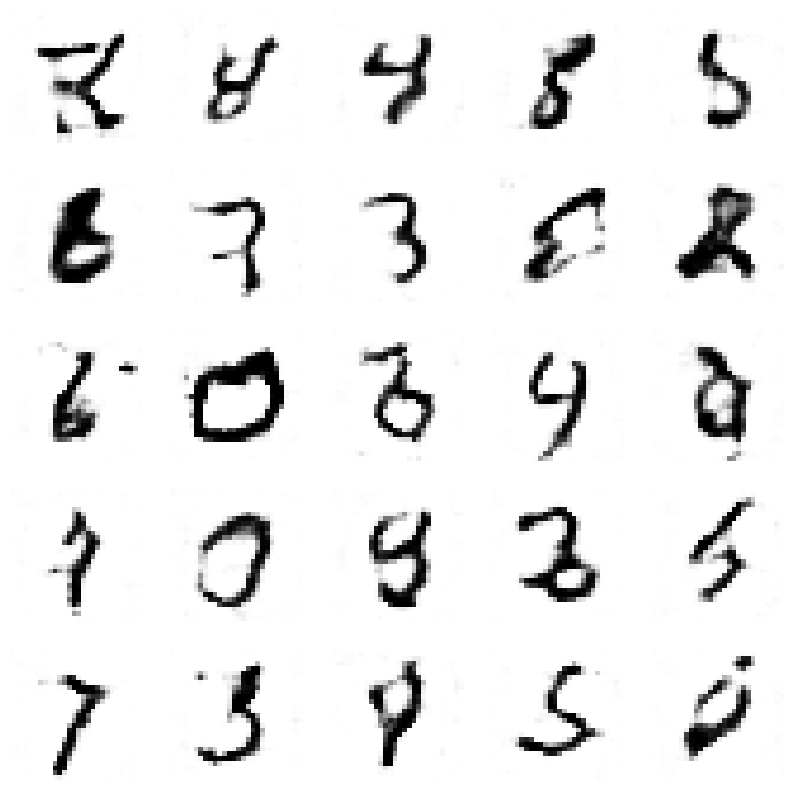

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.595092300293792, Generator Loss 0.9947053835942194
1/1 [==============================] - 0s 29ms/step


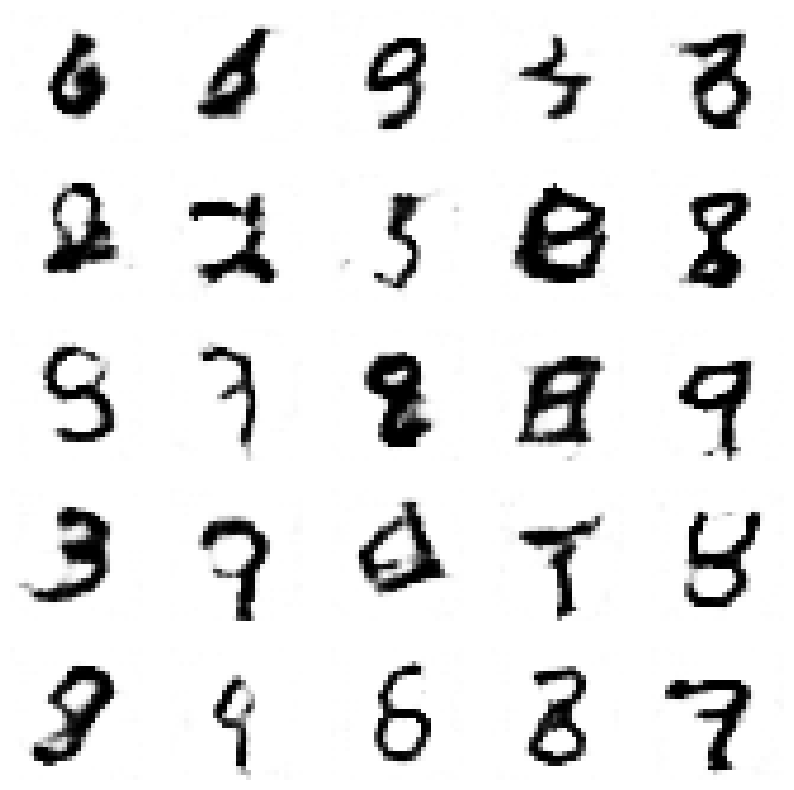

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.5979875454790572, Generator Loss 0.9993877910141252
1/1 [==============================] - 0s 26ms/step


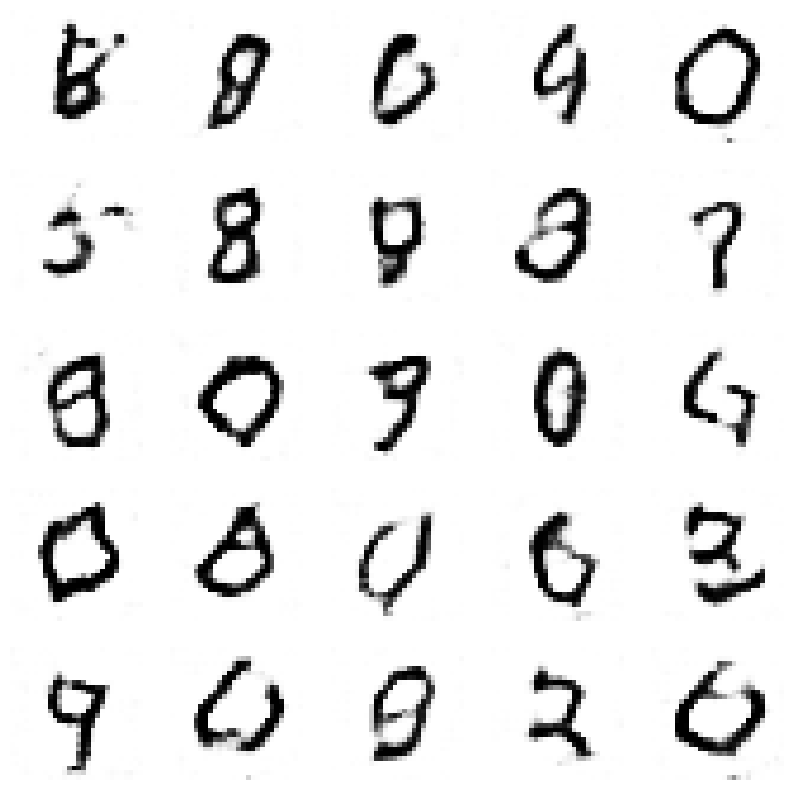

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.6007565196253296, Generator Loss 1.004224712522621
1/1 [==============================] - 0s 40ms/step


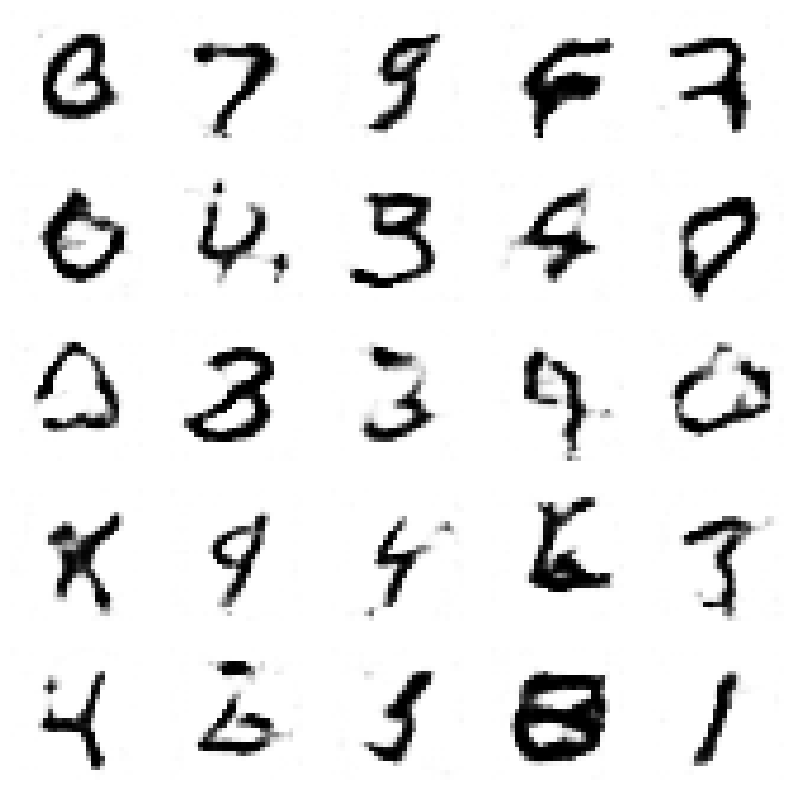

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6036182551557182, Generator Loss 1.0087918252007575
1/1 [==============================] - 0s 32ms/step


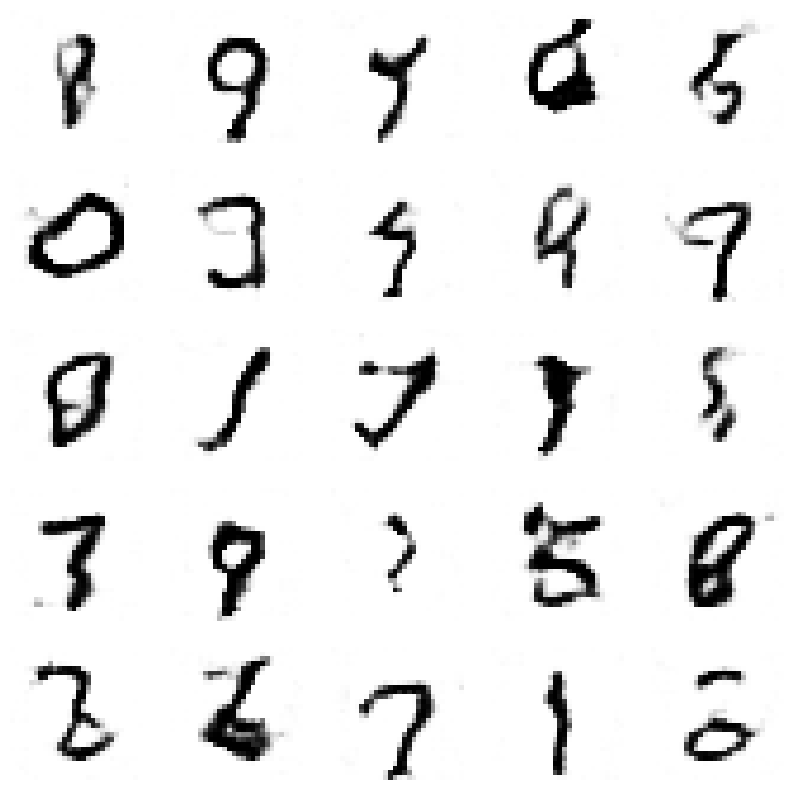

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6064032629514352, Generator Loss 1.0134515044016716
1/1 [==============================] - 0s 30ms/step


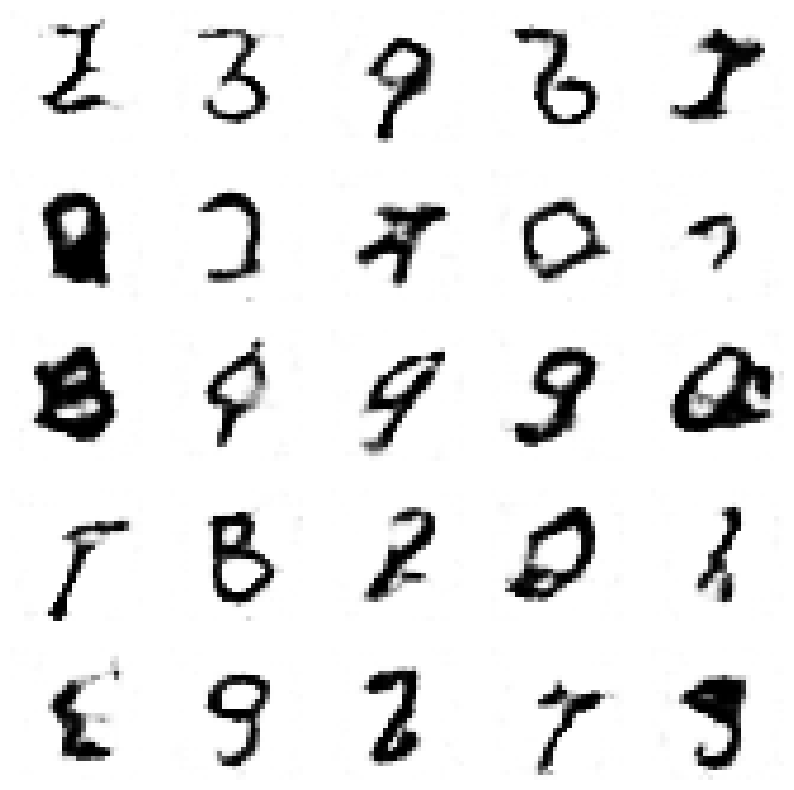

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6092436010511513, Generator Loss 1.0181220774976616
1/1 [==============================] - 0s 47ms/step


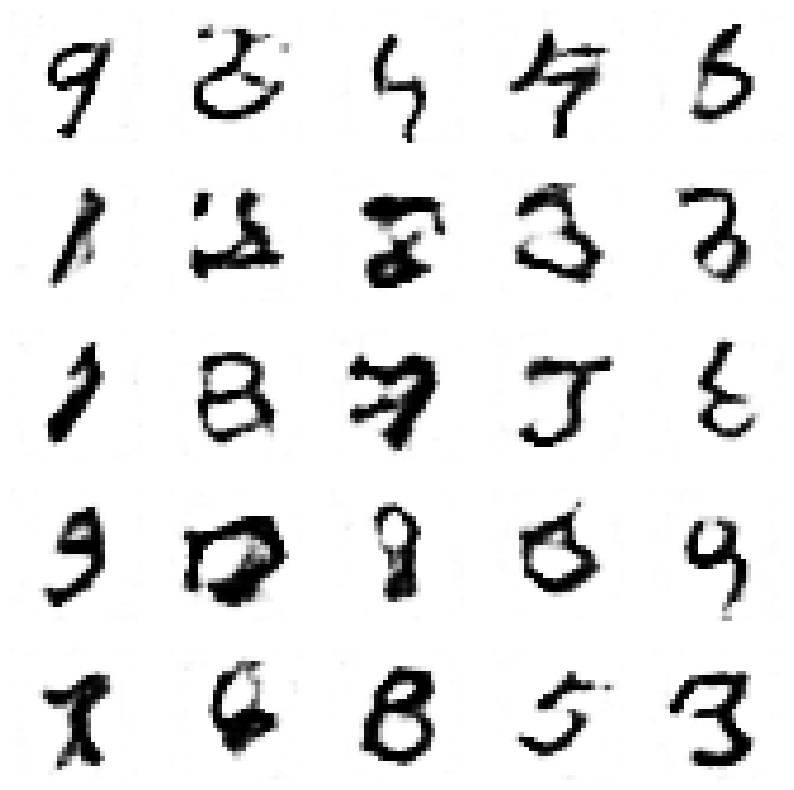

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6120507836851299, Generator Loss 1.022735556985578
1/1 [==============================] - 0s 30ms/step


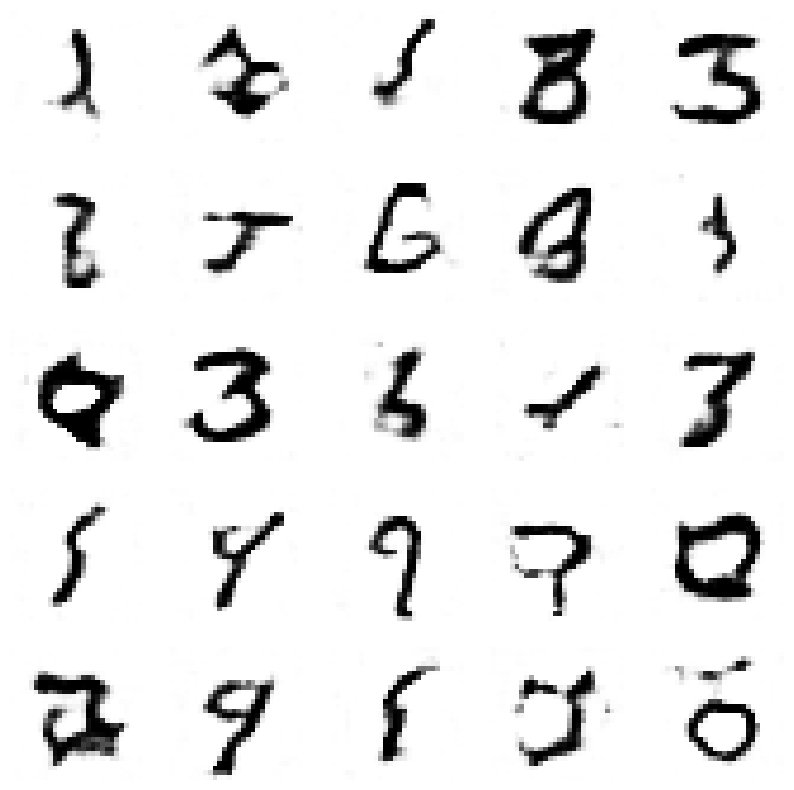

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6148146459689507, Generator Loss 1.0273316161245363
1/1 [==============================] - 0s 29ms/step


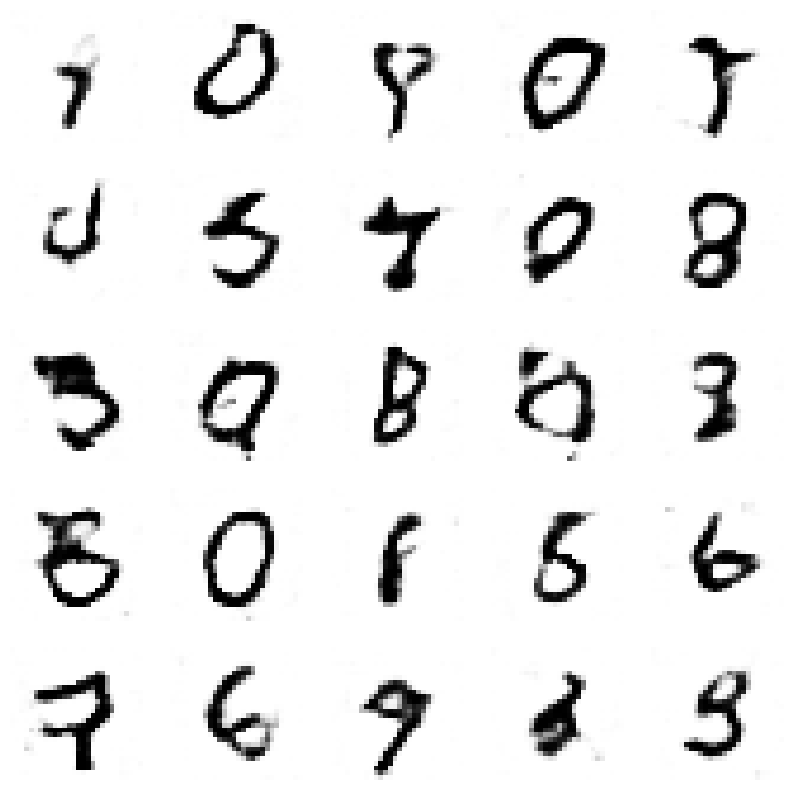

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6175597554598099, Generator Loss 1.0321555152917519
1/1 [==============================] - 0s 27ms/step


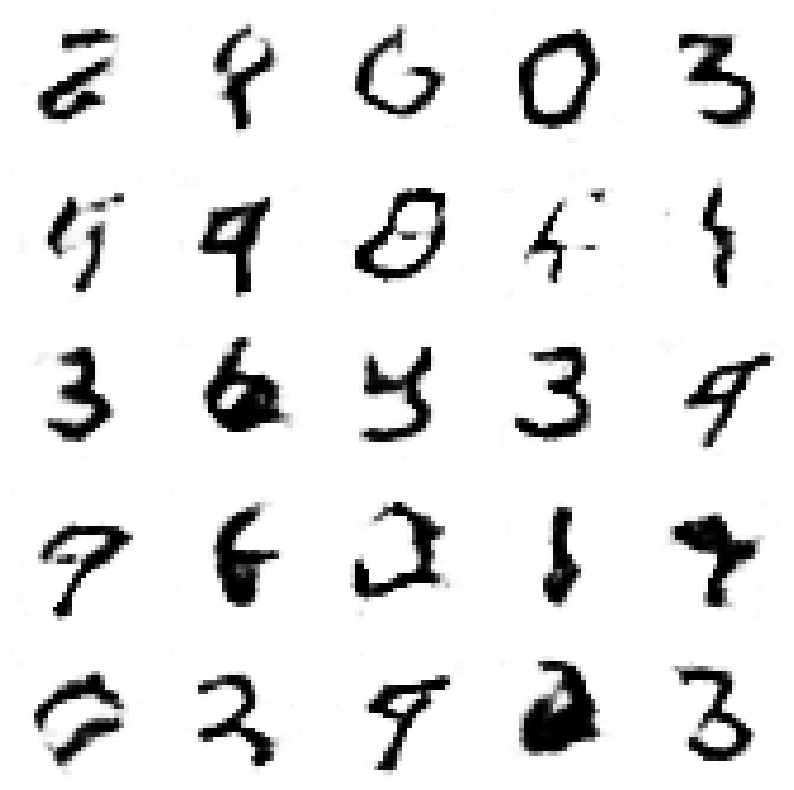

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.620370384464916, Generator Loss 1.0367816100772629
1/1 [==============================] - 0s 35ms/step


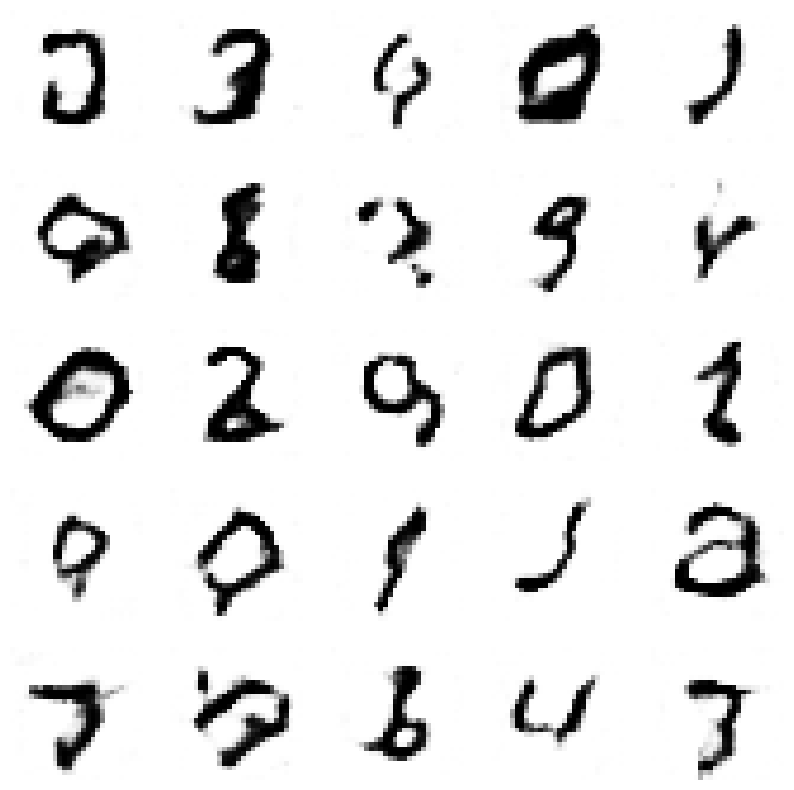

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6231360334871162, Generator Loss 1.041492292514214
1/1 [==============================] - 0s 28ms/step


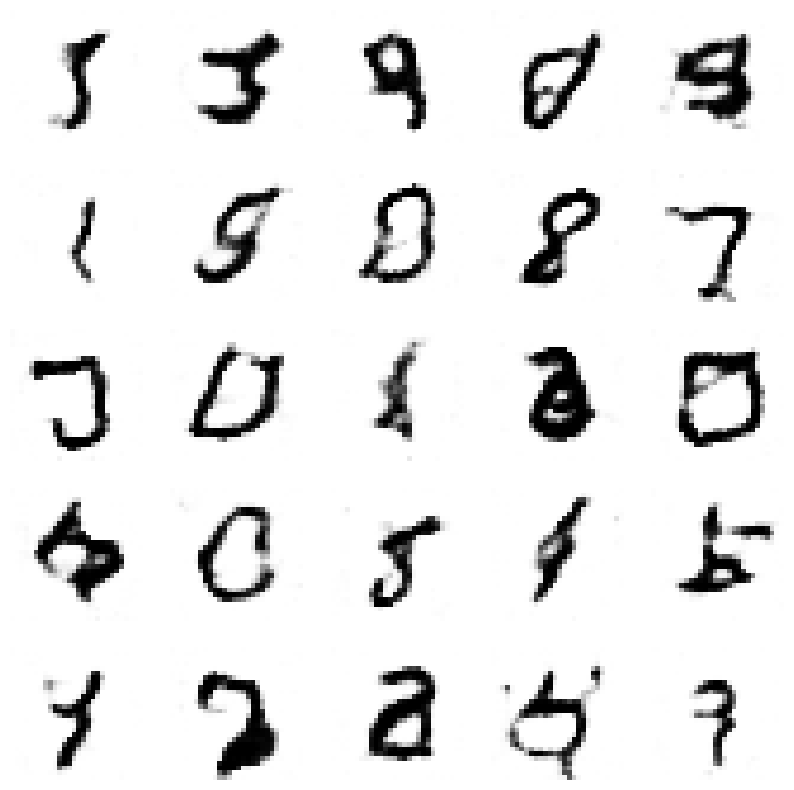

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.6259576294921402, Generator Loss 1.046177227782388
1/1 [==============================] - 0s 58ms/step


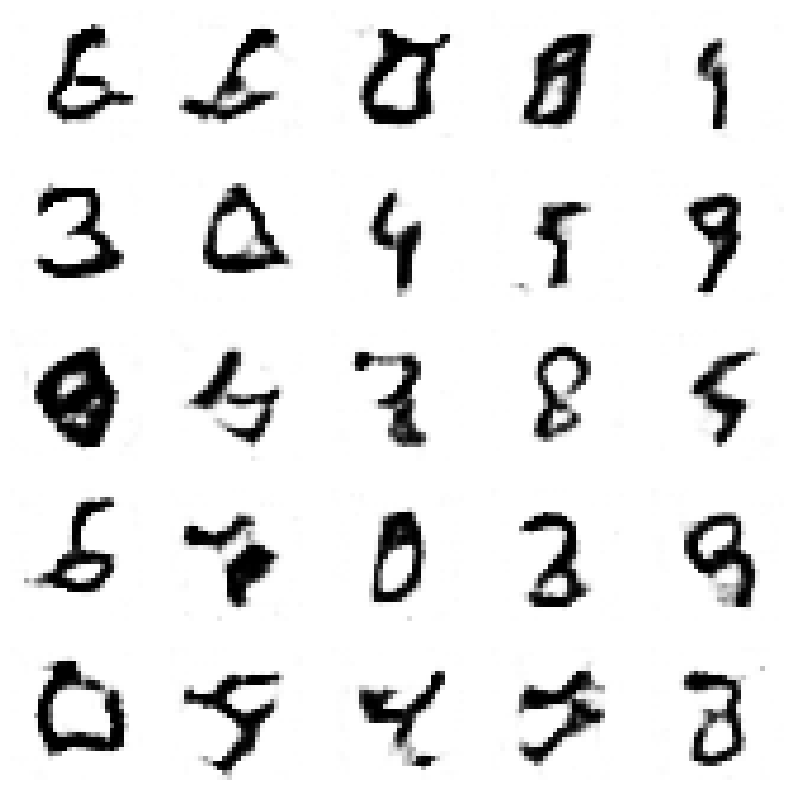

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6288127776903983, Generator Loss 1.0508948330186372
1/1 [==============================] - 0s 35ms/step


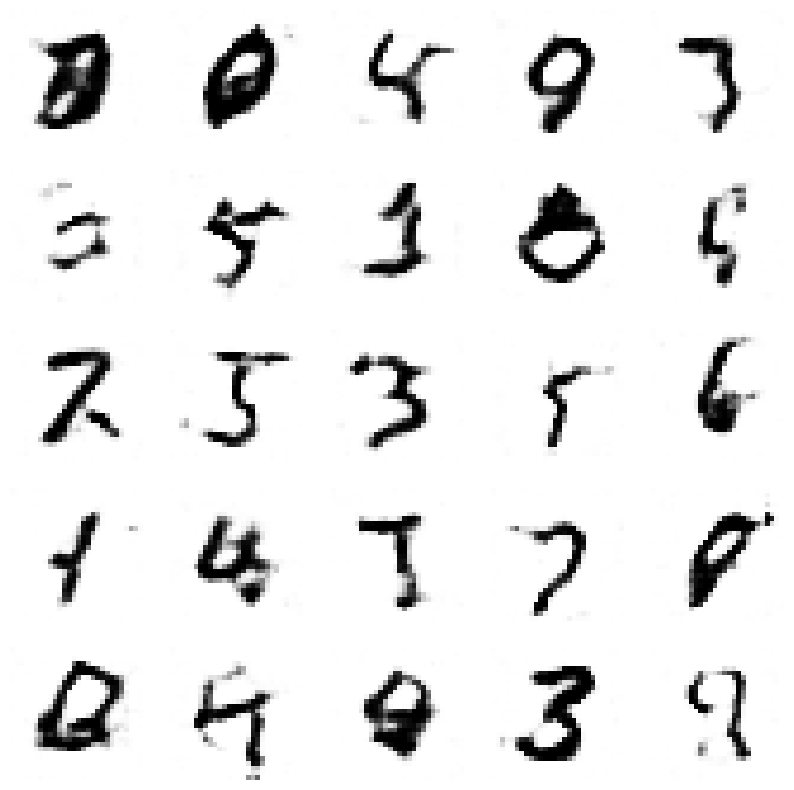

4/4 [==============================] - 0s 9ms/step
Epoch 10, Disc loss 0.6316937334262408, Generator Loss 1.0557075473997328
1/1 [==============================] - 0s 44ms/step


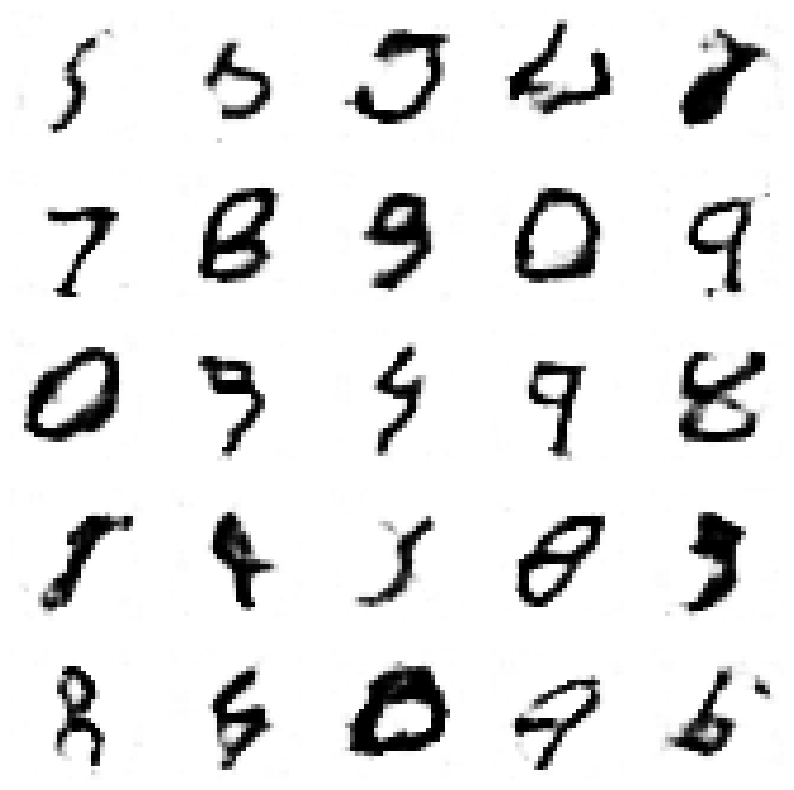

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.6345989878615762, Generator Loss 1.060419383721474
1/1 [==============================] - 0s 28ms/step


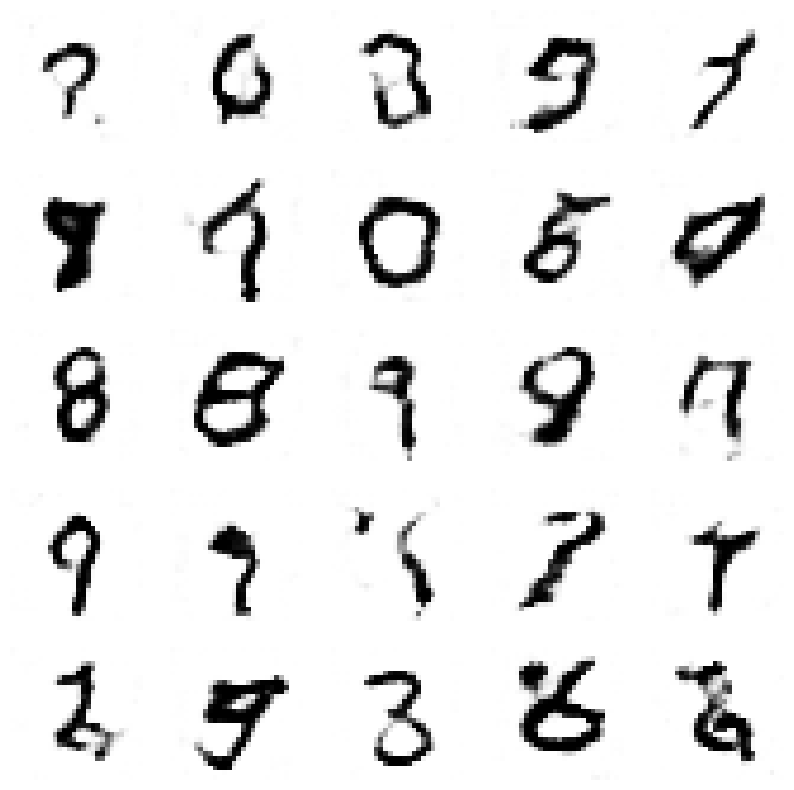

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6373978811196792, Generator Loss 1.065105463195051
1/1 [==============================] - 0s 40ms/step


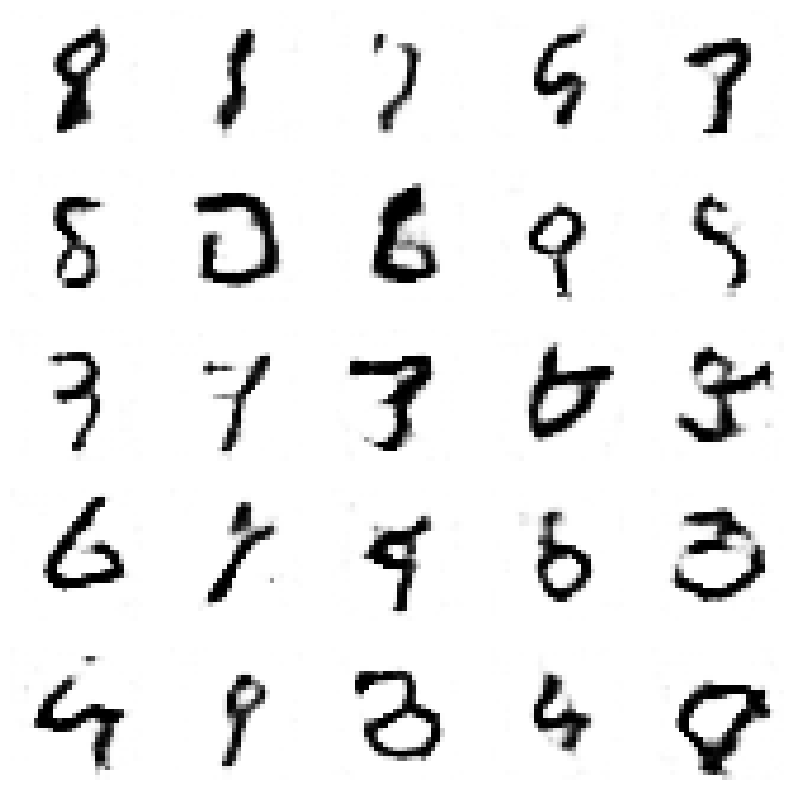

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6402551563631775, Generator Loss 1.069867752556108
1/1 [==============================] - 0s 34ms/step


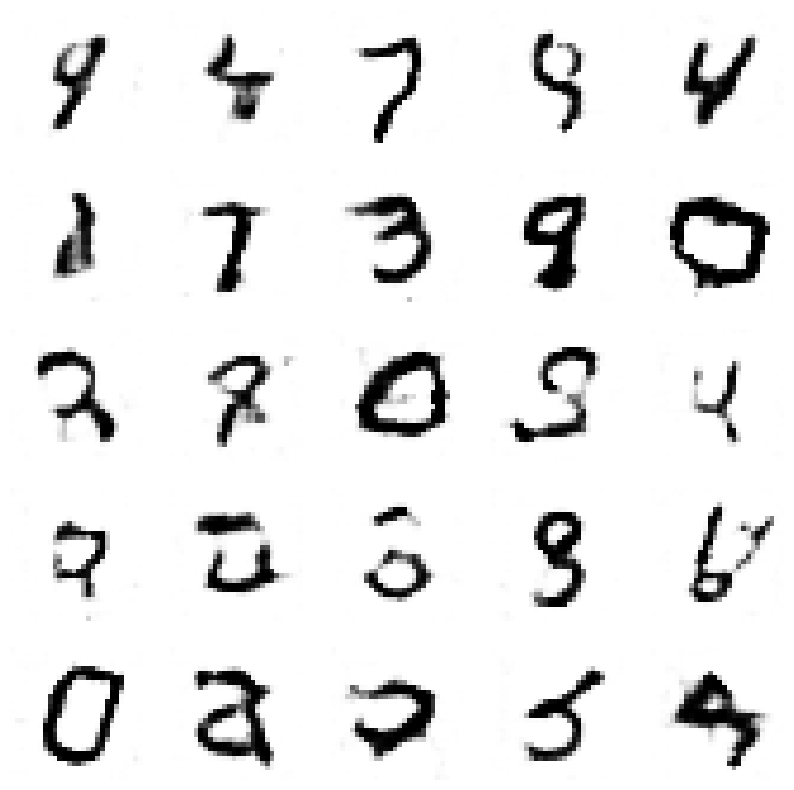

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6430503452180797, Generator Loss 1.0745152082198706
1/1 [==============================] - 0s 29ms/step


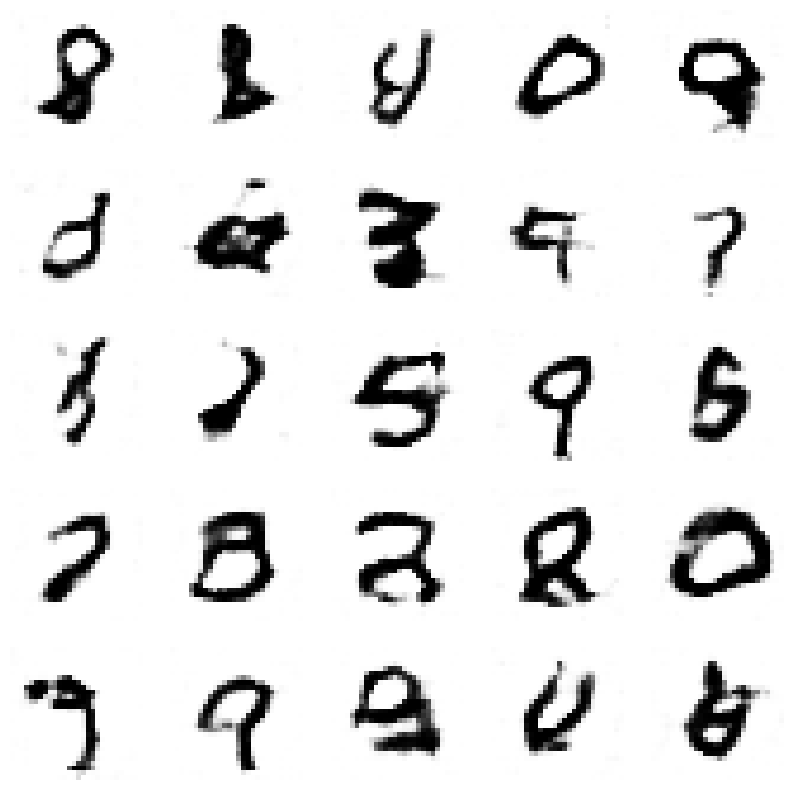

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6459039211527914, Generator Loss 1.0791682310593433
1/1 [==============================] - 0s 27ms/step


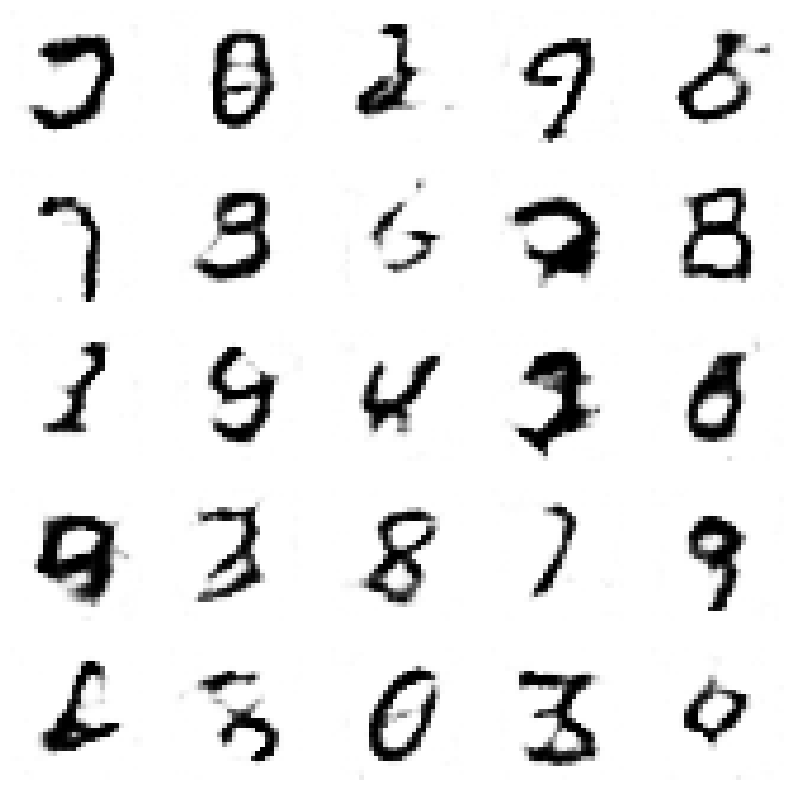

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.6487145123318729, Generator Loss 1.083988959972675
1/1 [==============================] - 0s 31ms/step


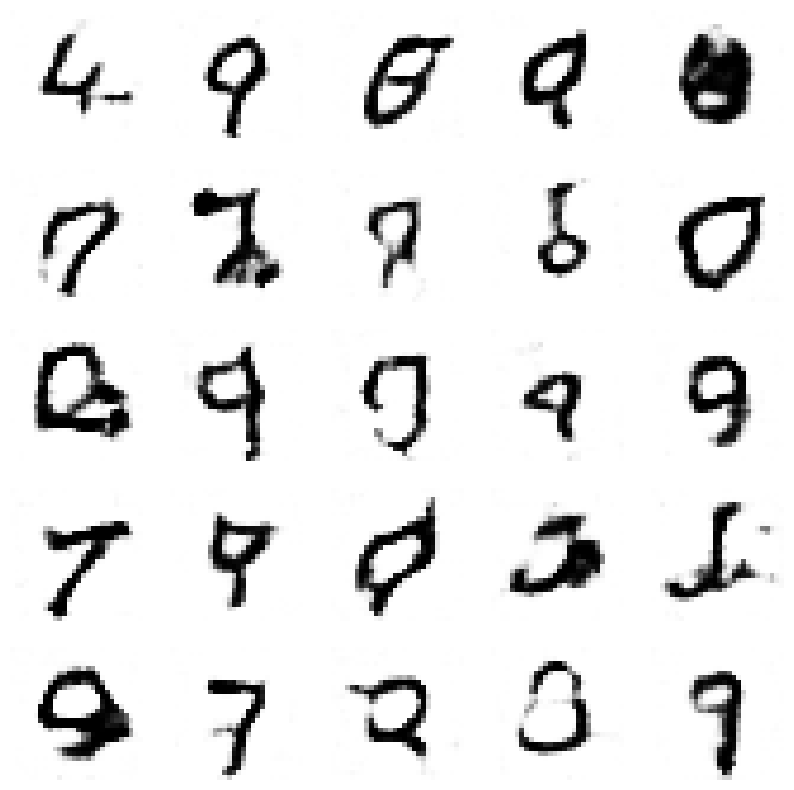

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6514747397512453, Generator Loss 1.0887628528806899
1/1 [==============================] - 0s 32ms/step


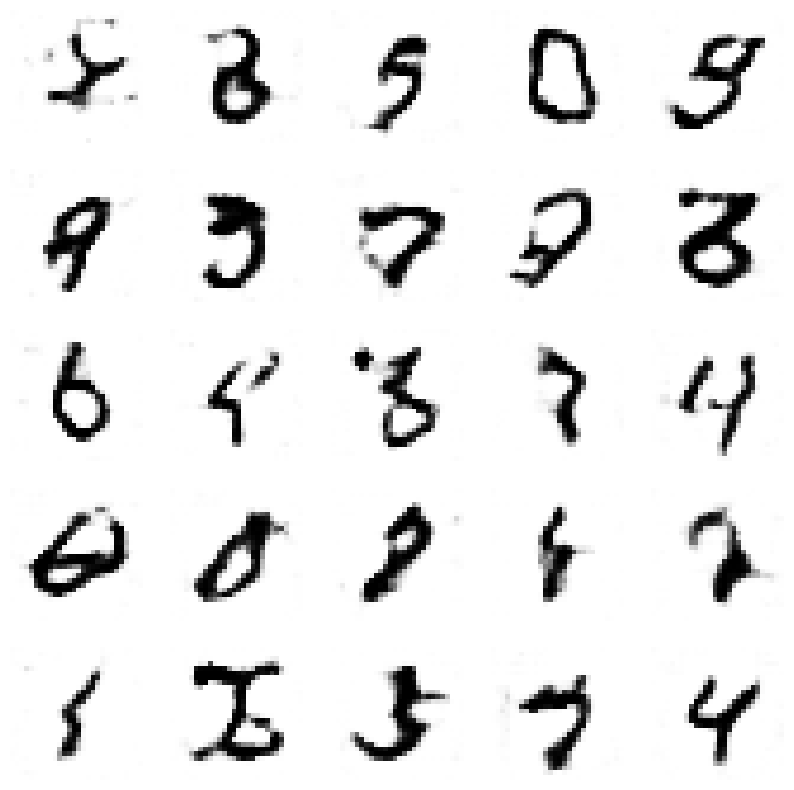

4/4 [==============================] - 0s 5ms/step
Epoch 10, Disc loss 0.6543625625025513, Generator Loss 1.0933183487663922
1/1 [==============================] - 0s 34ms/step


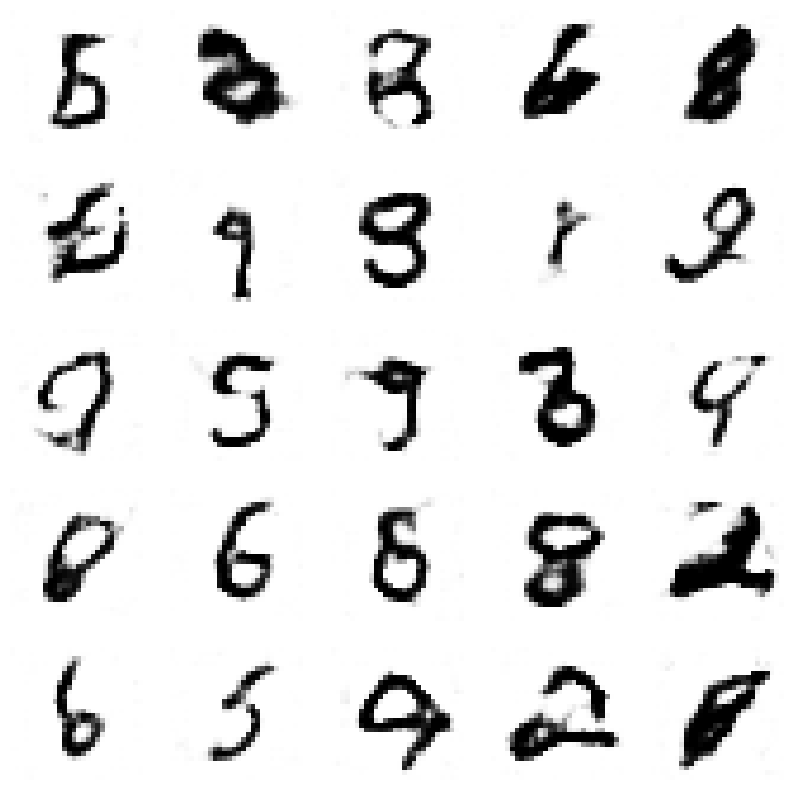

4/4 [==============================] - 0s 3ms/step
Epoch 10, Disc loss 0.6572252878775964, Generator Loss 1.0977554876580198
1/1 [==============================] - 0s 60ms/step


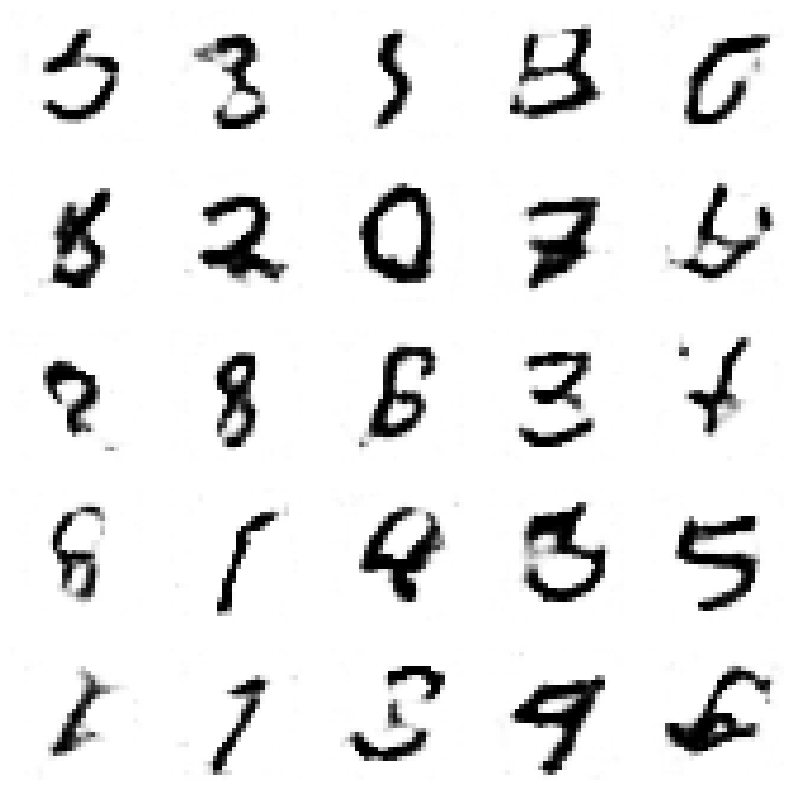

4/4 [==============================] - 0s 8ms/step
Epoch 10, Disc loss 0.6600953877991081, Generator Loss 1.1023900096233075
1/1 [==============================] - 0s 52ms/step


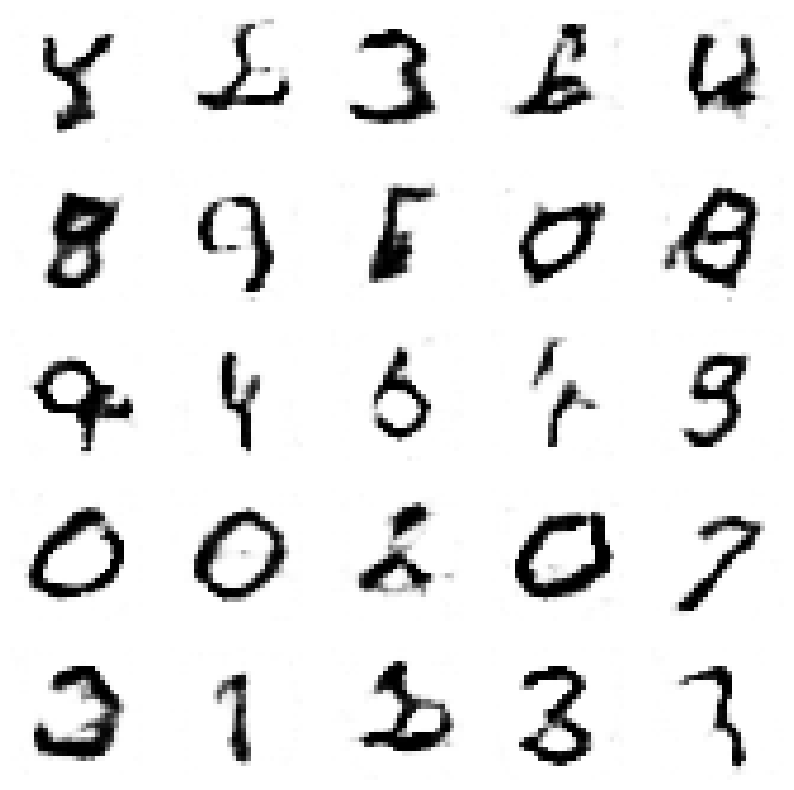

4/4 [==============================] - 0s 4ms/step
Epoch 10, Disc loss 0.6628778678739172, Generator Loss 1.1069820431562571
1/1 [==============================] - 0s 36ms/step


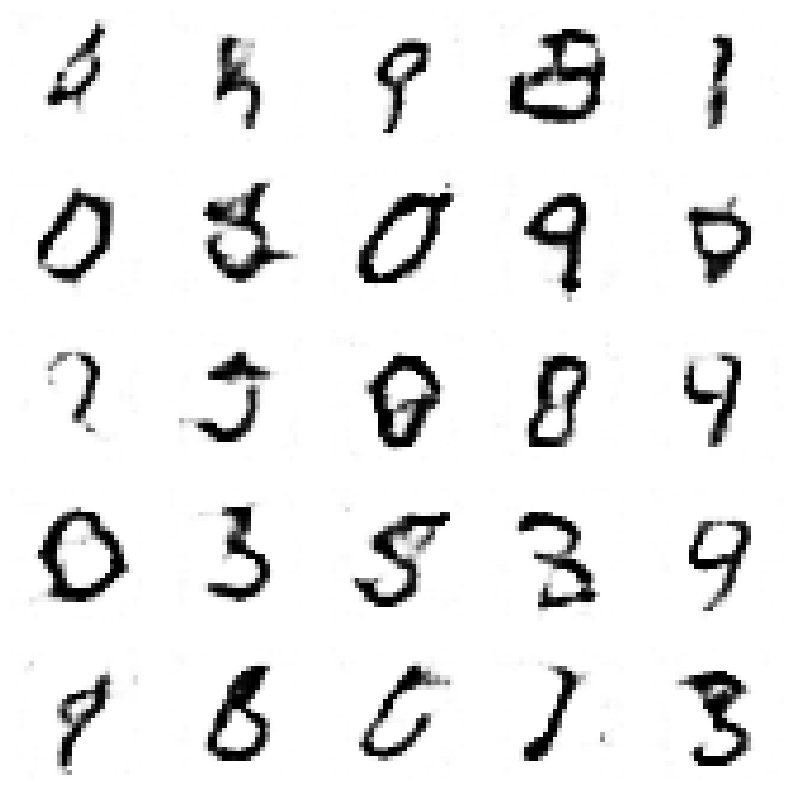

4/4 [==============================] - 0s 4ms/step
Epoch 11, Disc loss 0.002884598114551642, Generator Loss 0.004604977929694021
4/4 [==============================] - 0s 3ms/step
Epoch 11, Disc loss 0.005741042204392262, Generator Loss 0.009184338088728424
4/4 [==============================] - 0s 3ms/step
Epoch 11, Disc loss 0.008562886307382176, Generator Loss 0.013858206251747588
4/4 [==============================] - 0s 3ms/step
Epoch 11, Disc loss 0.011518567545801146, Generator Loss 0.01833717130188249
4/4 [==============================] - 0s 3ms/step
Epoch 11, Disc loss 0.014507321975170037, Generator Loss 0.02297569289166703
4/4 [==============================] - 0s 4ms/step
Epoch 11, Disc loss 0.017366860284764543, Generator Loss 0.02761215990425175
4/4 [==============================] - 0s 3ms/step
Epoch 11, Disc loss 0.020232649949880745, Generator Loss 0.03225677746992845
4/4 [==============================] - 0s 3ms/step
Epoch 11, Disc loss 0.02314471956501659, Generator

In [ ]:
# Training

d_losses=[]
g_losses=[]

for epoch in range(total_epochs):
  epoch_d_loss=0.0
  epoch_g_loss=0.0
  #mini batch gradient decent
  for step in range(no_of_batches):

    # Train Discriminator
    discriminator.trainable=True

    #Real Data
    idx=np.random.randint(0,xtrain.shape[0],half_batch)
    real_imgs=xtrain[idx]

    #Fake Data
    noise=np.random.normal(0,1,size=(half_batch,noise_dim))
    fake_imgs=generator.predict(noise)

    #Labels
    real_y=np.ones((half_batch,1))*0.9
    fake_y=np.zeros((half_batch,1))

    #Train
    d_loss_real=discriminator.train_on_batch(real_imgs,real_y)
    d_loss_fake=discriminator.train_on_batch(fake_imgs,fake_y)

    d_loss=0.5*np.add(d_loss_real,d_loss_fake)

    epoch_d_loss+=d_loss

    #Train Generator
    discriminator.trainable=False

    noise=np.random.normal(0,1,size=(batch_size,noise_dim))
    ground_truth_y=np.ones((batch_size,1))

    g_loss = gan.train_on_batch(noise, ground_truth_y)
    epoch_g_loss += g_loss


    print(f"Epoch {epoch+1}, Disc loss {epoch_d_loss/no_of_batches}, Generator Loss {epoch_g_loss/no_of_batches}")

    d_losses.append(epoch_d_loss/no_of_batches)
    g_losses.append(epoch_d_loss/no_of_batches)


    if(epoch+1)%5==0:
      generator.save(f'generator.h5')
      display_images()
